In [1]:
import pandas as pd
import numpy as np
from random import shuffle
from osgeo import ogr, osr
from sentinelhub import WmsRequest, WcsRequest, MimeType, CRS, BBox, constants
from s2cloudless import S2PixelCloudDetector, CloudMaskRequest
import logging
from collections import Counter
import datetime
import os
import yaml
from sentinelhub import DataSource
import scipy.sparse as sparse
import scipy
from scipy.sparse.linalg import splu
from skimage.transform import resize
from sentinelhub import CustomUrlParam
from time import time as timer
from time import sleep as sleep
import multiprocessing

/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/site-packages/sklearn/externals/joblib/__init__.py:15: DeprecationWarning: sklearn.externals.joblib is deprecated in 0.21 and will be removed in 0.23. Please import this functionality directly from joblib, which can be installed with: pip install joblib. If this warning is raised when loading pickled models, you may need to re-serialize those models with scikit-learn 0.21+.
  warnings.warn(msg, category=DeprecationWarning)


In [2]:
%run ../src/slope.py
%run ../src/utils-bilinear.py
%run ../src/dsen2/utils/DSen2Net.py
#!source ~/.bash_profile

Instructions for updating:
Colocations handled automatically by placer.


Using TensorFlow backend.


In [3]:
dates = ('2018-12-15', '2020-01-15')
SIZE = 9*5
IMSIZE = (SIZE * 14)+2

cloud_detector = S2PixelCloudDetector(threshold=0.4, average_over=4, dilation_size=2)

# Helper functions (to be moved to a utils file)

In [4]:
EPSG = CRS.WGS84
GRID_SIZE_X = 1
GRID_SIZE_Y = 1

IMAGE_X = 14*GRID_SIZE_X
IMAGE_Y = 14*GRID_SIZE_Y

TEST_X = 5
TEST_Y = 5

with open("../config.yaml", 'r') as stream:
    key = (yaml.safe_load(stream))
    API_KEY = key['key']

In [5]:
# These arrays are for smoothly overlapping the cloud and shadow interpolation
c_arr = np.array([[1, 1, 1, 1, 1,],
                  [1, 2, 2, 2, 1,],
                  [1, 2, 3, 2, 1,],
                  [1, 2, 2, 2, 1,],
                  [1, 1, 1, 1, 1,],])
                  
c_arr = c_arr / 3
o_arr = 1 - c_arr
c_arr = np.tile(c_arr[:, :, np.newaxis], (1, 1, 10))
o_arr = np.tile(o_arr[:, :, np.newaxis], (1, 1, 10))

def convertCoords(xy, src='', targ=''):

    srcproj = osr.SpatialReference()
    srcproj.ImportFromEPSG(src)
    targproj = osr.SpatialReference()
    if isinstance(targ, str):
        targproj.ImportFromProj4(targ)
    else:
        targproj.ImportFromEPSG(targ)
    transform = osr.CoordinateTransformation(srcproj, targproj)

    pt = ogr.Geometry(ogr.wkbPoint)
    pt.AddPoint(xy[0], xy[1])
    pt.Transform(transform)
    return([pt.GetX(), pt.GetY()])

In [6]:
def calculate_epsg(coord):
    ''' Returns a UTM EPSG for a lat, long coord'''
    ___xx = 10 + ((coord[0] - (-126)) // 6)
    __x__ = 6 if coord[1] > 0 else 7
    return int( str(32) + str(__x__) + str(___xx)[:-2] )
    
def offset_x(coord, offset):
    ''' Converts a WGS 84 to UTM, adds meters, and converts back'''
    epsg = calculate_epsg(coord)
    coord = convertCoords(coord, 4326, epsg)
    coord[0] += offset
    coord = convertCoords(coord, epsg, 4326)
    return coord
    
def offset_y(coord, offset):
    ''' Converts a WGS 84 to UTM, adds meters, and converts back'''
    epsg = calculate_epsg(coord)
    coord = convertCoords(coord, 4326, epsg)
    coord[1] += offset
    coord = convertCoords(coord, epsg, 4326)
    return coord

def calculate_bbx(coord, step_x, step_y, expansion):
    ''' Calculates the four corners of a bounding box of step_x * step_y offset from coord'''
    coord_bl = np.copy(coord)
    coord1 = offset_x(coord_bl, 6300*step_x - expansion)
    coord1 = offset_y(coord1 , 6300*step_y - expansion)
    
    coord_tr = np.copy(coord)
    coord2 = offset_x(coord_tr, 6300*(step_x + 1) + expansion)
    coord2 = offset_y(coord2, 6300*(step_y + 1) + expansion)
    bbx = (coord2, coord1)
    return bbx

In [7]:
dates

('2018-12-15', '2020-01-15')

# Data download

In [8]:
def try_function(func, n_tries = 5, *args, **kwargs):
    for try_ in range(0, n_tries):
        try:
            returns = func(*args, **kwargs)
        except Exception:
            print("Trying again in 20 seconds")
            time.sleep(20)
        else:
            continue

In [9]:
def identify_clouds(bbox, epsg = EPSG, dates = dates):
    '''
    - Download the CLOUD_DETECTION layer from sentinel-hub
    - Process cloud probabiiliity
    - Return cloud probability map
    '''
    for try_ in range(0, 5):
        try:
            box = BBox(bbox, crs = epsg)
            cloud_request = WmsRequest(
                layer='CLOUD_DETECTION',
                bbox=box,
                time=dates,
                width=(5*9*14)+2,
                height=(5*9*14)+2,
                image_format = MimeType.TIFF_d32f,
                maxcc=0.7,
                instance_id=API_KEY,
                custom_url_params = {constants.CustomUrlParam.UPSAMPLING: 'NEAREST'},
                time_difference=datetime.timedelta(hours=48),
            )

            cloud_img = cloud_request.get_data()
            cloud_probs = cloud_detector.get_cloud_probability_maps(np.array(cloud_img))
            print("Cloud probs: {}".format(cloud_probs.shape))
            return cloud_probs
        except Exception as e:
            #logging.fatal(e, exc_info=True)
            sleep(30)
    
    
def download_dem(bbox, epsg = EPSG):
    #@valid
    for try_ in range(0, 5):
        try:
            box = BBox(bbox, crs = epsg)
            dem_s = (630)+4
            dem_request = WmsRequest(data_source=DataSource.DEM,
                                 layer='DEM',
                                 bbox=box,
                                 width=dem_s,
                                 height=dem_s,
                                 instance_id=API_KEY,
                                 image_format=MimeType.TIFF_d32f,
                                 custom_url_params={CustomUrlParam.SHOWLOGO: False})
            dem_image = dem_request.get_data()[0]
            dem_image = calcSlope(dem_image.reshape((1, dem_s, dem_s)),
                          np.full((dem_s, dem_s), 10), np.full((dem_s, dem_s), 10), zScale = 1, minSlope = 0.02)
            dem_image = dem_image.reshape((dem_s,dem_s, 1))
            dem_image = dem_image[1:dem_s-1, 1:dem_s-1, :]
            return dem_image #/ np.max(dem_image)
        except Exception as e:
            #logging.fatal(e, exc_info=True)
            sleep((try_+1)*30)
            pass

def download_layer(bbox, epsg = EPSG, dates = dates, year = 2019):
    for try_ in range(5):
        try:
            box = BBox(bbox, crs = epsg)
            image_request = WcsRequest(
                    layer='L2A20',
                    bbox=box,
                    time=dates,
                    image_format = MimeType.TIFF_d32f,
                    maxcc=0.7,
                    resx='10m', resy='10m',
                    instance_id=API_KEY,
                    custom_url_params = {constants.CustomUrlParam.DOWNSAMPLING: 'NEAREST',
                                        constants.CustomUrlParam.UPSAMPLING: 'NEAREST'},
                    time_difference=datetime.timedelta(hours=48),
                )
            img_bands = image_request.get_data()
            img_20 = np.stack(img_bands)
            print("Original size: {}".format(img_20.shape))
            img_20 = resize(img_20, (img_20.shape[0], 632, 632, img_20.shape[-1]), order = 0)

            image_request = WcsRequest(
                    layer='L2A10',
                    bbox=box,
                    time=dates,
                    image_format = MimeType.TIFF_d32f,
                    maxcc=0.7,
                    resx='10m', resy='10m',
                    instance_id=API_KEY,
                    custom_url_params = {constants.CustomUrlParam.DOWNSAMPLING: 'BICUBIC',
                                        constants.CustomUrlParam.UPSAMPLING: 'BICUBIC'},
                    time_difference=datetime.timedelta(hours=48),
            )

            img_bands = image_request.get_data()
            img_10 = np.stack(img_bands)
            print("Original 10 size: {}".format(img_10.shape))
            img_10 = resize(img_10, (img_10.shape[0], 632, 632, img_10.shape[-1]), order = 0)
            #shadows = img_10[:, :, :, -1]
            #img_10 = img_10[:, :, :, :-1]

            #shadows[np.where(shadows != 3)] = 0
            #shadows[np.where(shadows == 3)] = 1
            #print("Data shape: {}".format(shadows.shape))
            #shadow_sum = np.sum(shadows, axis = (1, 2))
            #shadow_steps = np.argwhere(shadow_sum > (IMSIZE*IMSIZE) / 4)

            img = np.concatenate([img_10, img_20], axis = -1)

            image_dates = []
            for date in image_request.get_dates():
                if date.year == year - 1:
                    image_dates.append(-365 + starting_days[(date.month-1)] + date.day)
                if date.year == year:
                    image_dates.append(starting_days[(date.month-1)] + date.day)
                if date.year == year + 1:
                    image_dates.append(365 + starting_days[(date.month-1)]+date.day)
            image_dates = np.array(image_dates)

            return img, image_dates#, shadows, shadow_steps

        except Exception as e:
            #logging.fatal(e, exc_info=True)
            sleep((try_+1)*30)
        
        
        
def download_sentinel_1(bbox, epsg = EPSG, dates = dates, layer = "SENT", year = 2019):
    for try_ in range(5):
        try:
            box = BBox(bbox, crs = epsg)
            image_request = WcsRequest(
                    layer=layer,
                    bbox=box,
                    time=dates,
                    image_format = MimeType.TIFF_d32f,
                    maxcc=1.0,
                    resx='5m', resy='5m',
                    instance_id=API_KEY,
                    custom_url_params = {constants.CustomUrlParam.DOWNSAMPLING: 'NEAREST',
                                        constants.CustomUrlParam.UPSAMPLING: 'NEAREST'},
                    time_difference=datetime.timedelta(hours=48),
                )
            img_bands = image_request.get_data()
            s1 = np.stack(img_bands)
            s1 = resize(s1, (s1.shape[0], 632*2, 632*2, s1.shape[-1]), order = 0)
            s1 = np.reshape(s1, (s1.shape[0], s1.shape[1]//2, 2, s1.shape[2] // 2, 2, s1.shape[-1]))
            s1 = np.mean(s1, (2, 4))
            #s1 = s1[:, 8:24, 8:24, :]

            image_dates = []
            for date in image_request.get_dates():
                if date.year == year - 1:
                    image_dates.append(-365 + starting_days[(date.month-1)] + date.day)
                if date.year == year:
                    image_dates.append(starting_days[(date.month-1)] + date.day)
                if date.year == year + 1:
                    image_dates.append(365 + starting_days[(date.month-1)]+date.day)
            image_dates = np.array(image_dates)
            to_remove = np.argwhere(np.max(s1, (1, 2, 3)) == 1.).flatten()
            s1 = np.delete(s1, to_remove, 0)
            #print(np.max(s1, (1, 2, 3)))
            image_dates = np.delete(image_dates, to_remove)
            return s1, image_dates

        except Exception as e:
            #logging.fatal(e, exc_info=True)
            sleep((try_+1)*30)

# Cloud and shadow removal

In [83]:
def remove_cloud_and_shadows(tiles, c_probs, shadows, image_dates):
    '''
    - Iterate through a window size over each time step
    - Identify whether or not there are clouds and shadows there
    - If there are, interpolate the 5*5 window with clean imagery for all bands
    '''
    wsize = 5
    c_probs = c_probs - np.min(c_probs, axis = 0)
    c_probs[np.where(c_probs > 0.33)] = 1.
    c_probs[np.where(c_probs < 0.33)] = 0.
    c_probs = np.reshape(c_probs, (c_probs.shape[0], 632//8, 8, 632//8, 8))
    c_probs = np.sum(c_probs, (2, 4))
    c_probs = resize(c_probs, (c_probs.shape[0], 632, 632), 0)
    c_probs[np.where(c_probs < 16)] = 0
    c_probs[np.where(c_probs >= 16)] = 1
    secondary_c_probs = np.copy(c_probs)
    c_probs += shadows
    c_probs[np.where(c_probs >= 1.)] = 1.
    number_interpolated = 0
    for cval in tnrange(0, IMSIZE - 4, 2):
        for rval in range(0, IMSIZE - 4, 2):
            subs = c_probs[:, cval:cval + wsize, rval:rval+wsize]
            sums = np.sum(subs, axis = (1, 2))
            sums = sums - np.min(subs)
            satisfactory = [x for x in range(c_probs.shape[0]) if sums[x] < 10]
            if len(satisfactory) == 0:
                satisfactory = [x for x in range(c_probs.shape[0])]
            satisfactory = np.array(satisfactory)
            for date in range(0, tiles.shape[0]):
                if np.sum(subs[date, :, :]) > 12:
                    number_interpolated += 1
                    before, after = calculate_proximal_steps(date, satisfactory)
                    before = date + before
                    after = date + after
                    bef = tiles[before, cval:cval+wsize, rval:rval+wsize, : ]
                    aft = tiles[after, cval:cval+wsize, rval:rval+wsize, : ]
                    before = image_dates[before]
                    after = image_dates[after]
                    before_diff = abs(image_dates[date] - before)
                    after_diff = abs(image_dates[date] - after)
                    bef_wt = 1 - before_diff / (before_diff + after_diff)
                    aft_wt = 1 - bef_wt
                    candidate = bef_wt*bef + aft_wt*aft
                    candidate = candidate*c_arr + tiles[date, cval:cval+wsize, rval:rval+wsize, : ]*o_arr
                    tiles[date, cval:cval+wsize, rval:rval+wsize, : ] = candidate 
    print("A total of {} pixels were interpolated".format(number_interpolated))
    return tiles, c_probs, secondary_c_probs

def remove_missed_clouds(img):
    iqr = np.percentile(img[:, :, :, 3].flatten(), 75) - np.percentile(img[:, :, :, 3].flatten(), 25)
    thresh_t = np.percentile(img[:, :, :, 3].flatten(), 75) + iqr*2
    thresh_b = np.percentile(img[:, :, :, 3].flatten(), 25) - iqr*2
    diffs_fw = np.diff(img, 1, axis = 0)
    diffs_fw = np.mean(diffs_fw, axis = (1, 2, 3))
    diffs_fw = np.array([0] + list(diffs_fw))
    diffs_bw = np.diff(np.flip(img, 0), 1, axis = 0)
    diffs_bw = np.flip(np.mean(diffs_bw, axis = (1, 2, 3)))
    diffs_bw = np.array(list(diffs_bw) + [0])
    diffs = abs(diffs_fw - diffs_bw) * 100 # 3, -3 -> 6, -3, 3 -> 6, -3, -3
    #diffs = [int(x) for x in diffs]
    outlier_percs = []
    for step in range(img.shape[0]):
        bottom = len(np.argwhere(img[step, :, :, 3].flatten() > thresh_t))
        top = len(np.argwhere(img[step, :, :, 3].flatten() < thresh_b))
        p = 100* ((bottom + top) / (IMSIZE*IMSIZE))
        outlier_percs.append(p)
    to_remove = np.argwhere(np.array(outlier_percs) > 20)
    return to_remove

# Data interpolation

In [84]:
diagonals = np.zeros(2*2+1)
diagonals[2] = 1.
for i in range(2):
    diff = diagonals[:-1] - diagonals[1:]
    diagonals = diff
offsets = np.arange(2+1)
shape = (70, 72)

def smooth(y, lmbd = 800, diagonals = diagonals, offsets = offsets, shape = shape, d = 2):
    ''' 
    Apply whittaker smoothing to a 1-dimensional array, returning a 1-dimensional array
    '''
    E = sparse.eye(72, format = 'csc')
    D = scipy.sparse.diags(diagonals, offsets, shape)
    coefmat = E + lmbd * D.conj().T.dot(D)
    z = splu(coefmat).solve(y)
    return z

def calculate_and_save_best_images(img_bands, image_dates):
    '''
    
    '''

    biweekly_dates = [day for day in range(0, 360, 5)] # ideal imagery dates are every 15 days
    
    # Identify the dates where there is < 20% cloud cover
    #satisfactory_ids = list(np.argwhere(np.array(means) < 4.).reshape(-1, )) 
    satisfactory_ids = [x for x in range(0, img_bands.shape[0])]
    satisfactory_dates = [value for idx, value in enumerate(image_dates) if idx in satisfactory_ids]
    
    
    selected_images = {}
    for i in biweekly_dates:
        distances = [abs(date - i) for date in satisfactory_dates]
        closest = np.min(distances)
        closest_id = np.argmin(distances)
        # If there is imagery within 8 days, select it
        if closest < 8:
            date = satisfactory_dates[closest_id]
            image_idx = int(np.argwhere(np.array(image_dates) == date)[0])
            selected_images[i] = {'image_date': [date], 'image_ratio': [1], 'image_idx': [image_idx]}
        # If there is not imagery within 8 days, look for the closest above and below imagery
        else:
            distances = np.array([(date - i) for date in satisfactory_dates])
            # Number of days above and below the selected date of the nearest clean imagery
            above = distances[np.where(distances < 0, distances, -np.inf).argmax()]
            below = distances[np.where(distances > 0, distances, np.inf).argmin()]
            if abs(above) > 240: # If date is the last date, occassionally argmax would set above to - number
                above = below
            if abs(below) > 240:
                below = above
            if above != below:
                below_ratio = above / (above - below)
                above_ratio = 1 - below_ratio
            else:
                above_ratio = below_ratio = 0.5
                
            # Extract the image date and imagery index for the above and below values
            above_date = i + above
            above_image_idx = int(np.argwhere(np.array(image_dates) == above_date)[0])
            
            below_date = i + below
            below_image_idx = int(np.argwhere(np.array(image_dates) == below_date)[0])
            
            selected_images[i] = {'image_date': [above_date, below_date], 'image_ratio': [above_ratio, below_ratio],
                                 'image_idx': [above_image_idx, below_image_idx]}
                            
    max_distance = 0
    
    for i in selected_images.keys():
        #print(i, selected_images[i])
        if len(selected_images[i]['image_date']) == 2:
            dist = selected_images[i]['image_date'][1] - selected_images[i]['image_date'][0]
            if dist > max_distance:
                max_distance = dist
    
    print("Maximum time distance: {}".format(max_distance))
        
    keep_steps = []
    for i in selected_images.keys():
        info = selected_images[i]
        if len(info['image_idx']) == 1:
            step = img_bands[info['image_idx'][0]]
        if len(info['image_idx']) == 2:
            step1 = img_bands[info['image_idx'][0]] * 0.5#info['image_ratio'][0]
            step2 = img_bands[info['image_idx'][1]] * 0.5 #info['image_ratio'][1]
            step = step1 + step2
        keep_steps.append(step)
        
    keep_steps = np.stack(keep_steps)
    return keep_steps



# Tiling and coordinate selection functions

In [85]:
#coords = (13.540810, 38.177220) # tigray
#coords = (-1.817109, 37.477563) # makueni-2
#coords = (-2.575694, 37.949516) # makueni-3
#coords = (-2.561161, 38.096274) # makueni
#coords = (9.259359, -0.833750) # ghana
#coords = (-1.515869, 29.952997) # rwanda - useable
#coords = (-1.455224, 30.323259) # rwanda2
#coords = (13.316919, 2.581680) # niger
#coords = (13.18158333, 2.47805556) # niger - koure salima
#coords = (10.596, 14.2722) # cameroon
#coords = (18.232495, -92.134215) # campeche
#coords = (14.231732, -89.418679) # el salvador
#coords = (-11.044091, 33.818034) # malawi
#coords = (10.385811, -1.764760) # sisala east, ghana
#coords = (10.390084, -0.846330) # weest mamprusi, ghana
#coords = (7.702058, -0.709011) # brong ahafo, bono east
#coords = (10.097017, -2.439068)# close to wa, has been done
#coords = (24.070469, 81.606926) # sidhi, india
#coords = (7.398111, -1.269223) # cocoa
#coords = (44.865106, -123.093435) # salem, oregon
#coords = (-20.147326, -40.837780) # Esperito santo, BR
#coords = (-20.147320, -40.837770) BR 2
#coords = (-22.559943, -44.186629) # Vale do Paraiba, Brazil
#coords = (6.622101, -0.704616) # kwahu
#coords = (6.518909, -0.826008) # kwahu large
#coords = (-6.352580, 106.677072) # jakarta
#coords = (6.167177, -75.693226) # medellin, colombia
#coords = (4.179529, -74.889171) # colombia
#coords = (6.518909, -0.826008) # kwahu large
#coords = (5.765917, 14.791618) # baboua, CAF
#coords = (-18.960152, 47.469587) # madagascar
#coords = (9.909083, 76.253594) # Kochi, india
#coords = (16.032170, -90.144511) # Guatemala
#coords = (13.757749, -90.004949) # elsalvador imposible
#coords = (13.727334, -90.015579) # elsalvador imposible2
#coords = (-11.749636, 27.586622) # Kafubu, DRC
#coords = (-6.272258, 36.679824) # Tanzania
#coords = (-36.431237, -71.872030) # Chile
#coords = (12.398014, -86.963042) # Nicaragua
#coords = (13.933745, -84.690842) # Bonanza, Nicaragua
coords = (14.096664, -88.720304) # Honduras
coords = (14.064689, -60.967060) # St. Lucia
coords = (coords[1], coords[0])
OUTPUT_FOLDER = '../tile_data/stlucia/'
#13.567962754335872

#borders = bounding_box(coords, 10*(SIZE*14), 10*(SIZE*14), expansion = 0)
#print(borders)

In [86]:
MDL_PATH = "../src/dsen2/models/"

input_shape = ((4, None, None), (6, None, None))
model = s2model(input_shape, num_layers=6, feature_size=128)
predict_file = MDL_PATH+'s2_032_lr_1e-04.hdf5'
print('Symbolic Model Created.')

model.load_weights(predict_file)

def DSen2(d10, d20):
    test = [d10, d20]
    input_shape = ((4, None, None), (6, None, None))
    prediction = _predict(test, input_shape, deep=False)
    #prediction *= 5
    return prediction

def _predict(test, input_shape, model = model, deep=False, run_60=False):
    
    print("Predicting using file: {}".format(predict_file))
    prediction = model.predict(test, verbose=1)
    return prediction

Symbolic Model Created.


In [87]:
days_per_month = [0, 31, 28, 31, 30, 31, 30, 31, 31, 30, 31, 30]
starting_days = np.cumsum(days_per_month)

In [88]:
def calculate_proximal_steps(date, satisfactory):
    print(satisfactory, date)
    arg_before = None
    arg_after = None
    if date > 0:
        idx_before = satisfactory - date
        arg_before = idx_before[np.where(idx_before < 0, idx_before, -np.inf).argmax()]
    if date < np.max(satisfactory):
        idx_after = satisfactory - date
        arg_after = idx_after[np.where(idx_after > 0, idx_after, np.inf).argmin()]
    if not arg_after and not arg_before:
        arg_after = date
        arg_before = date
    if not arg_after:
        arg_after = arg_before
    if not arg_before:
        arg_before = arg_after
    #print(arg_before, date, arg_after)
    return arg_before, arg_after

In [89]:
def rank_array(arr):
    order = arr.argsort()
    ranks = order.argsort()
    return ranks

In [90]:
def mcm_shadow_mask(arr, c_probs):
    #' From "Cloud and cloud shadow masking for Sentinel-2 using multi-
    #         temporal images in global area. Candra et al. 2020."
    #'[B02,B03,B04, B08, B05,B06,B07, B8A,B11,B12]
    #'[ 0 , 1 , 2 , 3  , 4  , 5,  6   7  , 8  , 9]'
    mean_c_probs = np.mean(c_probs, axis = (1, 2))
    cloudy_steps = np.argwhere(mean_c_probs > 0.25)
    images_clean = np.delete(arr, cloudy_steps, 0)
    cloud_ranks = rank_array(mean_c_probs)
    diffs = abs(np.sum(arr - np.mean(images_clean, axis = 0), axis = (1, 2, 3)))
    diff_ranks = rank_array(diffs)
    overall_rank = diff_ranks + cloud_ranks
    reference_idx = np.argmin(overall_rank)
    ri = arr[reference_idx]
    print(reference_idx)
    
    nir_means = np.mean(arr[:, :, :, 3], axis = (0))
    
    shadows = np.zeros((arr.shape[0], 632, 632))    
    # Candra et al. 2020
    
    for time in tnrange(arr.shape[0]):
        for x in range(arr.shape[1]):
            for y in range(arr.shape[2]):
                ti_slice = arr[time, x, y]
                ri_slice = ri[x, y]
                deltab2 = ti_slice[0] - ri_slice[0]
                deltab3 = ti_slice[1] - ri_slice[1]
                deltab4 = ti_slice[2] - ri_slice[2]
                deltab8a = ti_slice[7] - ri_slice[7]
                deltab11 = ti_slice[8] - ri_slice[8]

                if deltab2 < 0.1:
                    if deltab3 < 0.08:
                        if deltab4 < 0.08:
                            if deltab8a < -0.04:
                                if deltab11 < -0.04:
                                    if ti_slice[0] < 0.0950:
                                        shadows[time, x, y] = 1.
                                        
    # Additional 3 time-window NIR thresholding
    '''
    for time in tnrange(shadows.shape[0]):
        for x in range(shadows.shape[1]):
            for y in range(shadows.shape[2]):
                if shadows[time, x, y] == 1:
                    time_adjusted = np.max([time, 1])
                    time_adjusted = np.min([time_adjusted, shadows.shape[0] - 2])
                    # check before and after
                    if shadows[time_adjusted + 1, x, y] == 1 or shadows[time_adjusted-1, x, y] == 1:
                        nir_mean = nir_means[x, y]
                        nir_before = arr[time_adjusted - 1, x, y, 3] - nir_mean
                        nir_now = arr[time, x, y, 3] - nir_mean
                        nir_next = arr[time_adjusted + 1, x, y, 3] - nir_mean
                        if nir_now > nir_mean * 0.75:
                            shadows[time, x, y] = 0
                        if nir_next or nir_before <= nir_now:
                            shadows[time, x, y] = 0
    '''                    
                            
    # Remove shadows if cannot coreference a cloud
    shadow_large = np.reshape(shadows, (shadows.shape[0], 79, 8, 79, 8))
    shadow_large = np.sum(shadow_large, axis = (2, 4))
    
    cloud_large = np.copy(c_probs)
    cloud_large[np.where(c_probs > 0.33)] = 1.
    cloud_large[np.where(c_probs < 0.33)] = 0.
    cloud_large = np.reshape(cloud_large, (shadows.shape[0], 79, 8, 79, 8))
    cloud_large = np.sum(cloud_large, axis = (2, 4))
    for time in tnrange(shadow_large.shape[0]):
        for x in range(shadow_large.shape[1]):
            x_low = np.max([x - 8, 0])
            x_high = np.min([x + 8, shadow_large.shape[1] - 1])
            for y in range(shadow_large.shape[2]):
                y_low = np.max([y - 8, 0])
                y_high = np.min([y + 8, shadow_large.shape[1] - 1])
                if shadow_large[time, x, y] < 8:
                    shadow_large[time, x, y] = 0.
                if shadow_large[time, x, y] >= 8:
                    shadow_large[time, x, y] = 1.
                c_prob_window = cloud_large[time, x_low:x_high, y_low:y_high]
                if np.max(c_prob_window) < 16:
                    shadow_large[time, x, y] = 0.
                    
    shadow_large = resize(shadow_large, (shadow_large.shape[0], 632, 632), order = 0)
    shadows *= shadow_large
    
    # Go through and aggregate the shadow map to an 80m grid, and extend it one grid size around
    # any positive ID
    
    shadows = np.reshape(shadows, (shadows.shape[0], 79, 8, 79, 8))
    shadows = np.sum(shadows, axis = (2, 4))
    shadows[np.where(shadows < 8)] = 0.
    shadows[np.where(shadows >= 8)] = 1.
    
    shadows_new = np.zeros_like(shadows)
    for time in range(shadows.shape[0]):
        for x in range(shadows.shape[1]):
            for y in range(shadows.shape[2]):
                if shadows[time, x, y] == 1:
                    min_x = np.max([x - 1, 0])
                    max_x = np.min([x + 2, 78])
                    min_y = np.max([y - 1, 0])
                    max_y = np.min([y + 2, 78])
                    for x_idx in range(min_x, max_x):
                        for y_idx in range(min_y, max_y):
                            shadows_new[time, x_idx, y_idx] = 1.
    shadows_new = resize(shadows_new, (shadows.shape[0], 632, 632), order = 0)
    return shadows_new
    
#c_probs = np.load(OUTPUT_FOLDER + "raw/clouds/clouds_0_0.npy")
#arr = x
#mask2 = mcm_shadow_mask(x, c_probs)

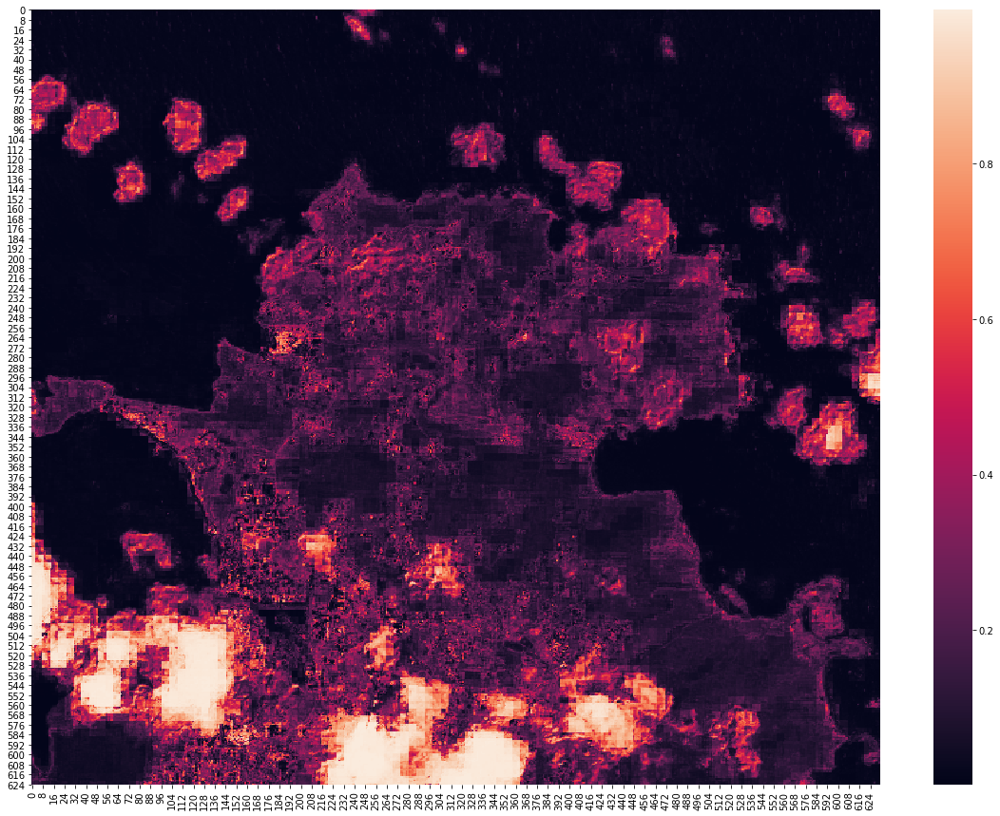

In [91]:
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline
plt.figure(figsize=(20, 15))


x = np.load(OUTPUT_FOLDER + "raw/clouds/clouds_0_0.npy")
sns.heatmap(x[28, :, :])

In [92]:
def find_and_make_dirs(dirs):
    if not os.path.exists(os.path.realpath(dirs)):
        os.makedirs(os.path.realpath(dirs))

def make_output_and_temp_folders(idx, output_folder = OUTPUT_FOLDER):
    find_and_make_dirs(output_folder + "raw/")
    find_and_make_dirs(output_folder + "raw/clouds/")
    find_and_make_dirs(output_folder + "raw/s1/")
    find_and_make_dirs(output_folder + "raw/s2/")
    find_and_make_dirs(output_folder + "raw/misc/")
    find_and_make_dirs(output_folder + "processed/")

def download_large_tile(coord, step_x, step_y, folder = OUTPUT_FOLDER, year = 2019):
    '''
    Ideally the folder structure should be as follows:
     - Raw
         - Cloud
              - Y*5, X*5
         - Sentinel 1
         - Sentinel 2
         - DEM
         - Dates
     - Processed
         - Y, X
         
    Methodological questions to address:
        - Should we download all images for a region first, and then process?     - Seems unnecessary
          This would allow for matching up the borders
        - Remove dirty steps for the whole tile or by subtiles 
        - Is this the proper time to address the interpolation of clouds (?)
        - Make sure that cloud shadows line up with clouds                        - X
        - Make sure that sentinel 1 is properly matched up and items are removed  - X
         
    The strategy is as follows:
        - Download 5*9 by 5*9 cloud, S1, S2, DEM, dates, save to folders          - X
        - Load each start:start+128 tile                                          - X
        - Remove dirty steps, missing images, missed clouds, ratios               - X
        - Superresolve                                                            - X
        - Indices                                                                 - X
        - Calculate_and_save_best_images                                          - X
        - Whittaker smooth                                                        - X
        - Fuse S1
        - Save to processed / y / x
        - Iterate for each of the large sub-tiles
    
    '''
    print(coord)
    bbx = calculate_bbx(coord, step_x, step_y, expansion = 10)
    print(bbx)
    dem_bbx = calculate_bbx(coord, step_x, step_y, expansion = 20)
    idx = str(step_y) + "_" + str(step_x)
    print(idx)
    if not os.path.exists(folder + "raw/clouds/clouds_{}.npy".format(idx)):
        idx = str(idx)

        print("Making raw folders")
        make_output_and_temp_folders(idx)

        print("Calculating cloud cover")
        cloud_probs = identify_clouds(bbx) # integrate cloud shadow here
        np.save(folder + "raw/clouds/clouds_{}.npy".format(idx), cloud_probs)

        print("Downloading S1")
        s1, s1_dates = download_sentinel_1(bbx, layer = "SENT")
        s1 = process_sentinel_1_tile(s1, s1_dates)
        np.save(folder + "raw/s1/{}.npy".format(idx), s1)
        np.save(folder + "raw/misc/s1_dates_{}".format(idx), np.array(s1_dates))

        print("Downloading S2")
        s2, s2_dates = download_layer(bbx)
        np.save(folder + "raw/s2/{}.npy".format(idx), s2)
        np.save(folder + "raw/misc/s2_dates_{}".format(idx), np.array(s2_dates))
        #np.save(folder + "raw/clouds/shadows_{}".format(idx), np.array(shadows))

        print("Downloading DEM")
        dem = download_dem(dem_bbx) # get the DEM BBOX
        np.save(folder + "raw/misc/dem_{}.npy".format(idx), dem)
    

In [93]:
def calculate_bad_steps(sentinel2, clouds):
    n_cloud_px = np.array([len(np.argwhere(clouds[x, :, :].reshape((632)*(632)) > 0.3)) for x in range(clouds.shape[0])])
    cloud_steps = np.argwhere(n_cloud_px > 632**2 / 5)
    missing_images = [np.argwhere(sentinel2[x, :, : :].flatten() == 0.0) for x in range(sentinel2.shape[0])]
    missing_images = np.array([len(x) for x in missing_images])
    missing_images_p = [np.argwhere(sentinel2[x, :, : :10].flatten() >= 1) for x in range(sentinel2.shape[0])]
    missing_images_p = np.array([len(x) for x in missing_images_p])
    missing_images += missing_images_p
    missing_images = np.argwhere(missing_images >= 100)
    print(cloud_steps)
    print(missing_images)
    #perc_shadow_px = np.sum(shadows, axis = (1, 2) / (79**2))
    #shadow_steps = np.argwhere(perc_shadow_px > 20)
    to_remove = np.unique(np.concatenate([cloud_steps.flatten(), missing_images.flatten()]))#, shadow_steps]))
    return to_remove

def superresolve(sentinel2):
    d10 = sentinel2[:, :, :, 0:4]
    d20 = sentinel2[:, :, :, 4:10]

    d10 = np.swapaxes(d10, 1, -1)
    d10 = np.swapaxes(d10, 2, 3)
    d20 = np.swapaxes(d20, 1, -1)
    d20 = np.swapaxes(d20, 2, 3)
    superresolved = DSen2(d10, d20)
    superresolved = np.swapaxes(superresolved, 1, -1)
    superresolved = np.swapaxes(superresolved, 1, 2)

    # returns band IDXs 3, 4, 5, 7, 8, 9
    return superresolved

def process_sentinel_1_tile(sentinel1, dates):
    s1 = calculate_and_save_best_images(sentinel1, dates)
    # Retain only iamgery every 15 days
    biweekly_dates = np.array([day for day in range(0, 360, 5)])
    to_remove = np.argwhere(biweekly_dates % 15 != 0)
    s1 = np.delete(s1, to_remove, 0)
    return s1


def interpolate_array(x):
    no_dem = np.delete(x, 10, -1)
    no_dem = np.reshape(no_dem, (72, 128*128*14))
    no_dem = np.swapaxes(no_dem, 0, 1)

    pool = multiprocessing.Pool(6)
    no_dem = pool.map(smooth, no_dem)
    pool.close()
    pool.join()

    no_dem = np.swapaxes(no_dem, 0, 1)
    no_dem = np.reshape(no_dem, (72, 128, 128, 14))
    x[:, :, :, :10] = no_dem[:, :, :, :10]
    x[:, :, :, 11:] = no_dem[:, :, :, 10:]

    biweekly_dates = np.array([day for day in range(0, 360, 5)])
    to_remove = np.argwhere(biweekly_dates % 15 != 0)
    x = np.delete(x, to_remove, 0)
    return x

def process_large_tile(step_x, step_y, folder = OUTPUT_FOLDER):
    idx = str(step_y) + "_" + str(step_x)
    x_vals = []
    y_vals = []
    # save to disk
    for i in range(25):
        y_val = (24 - i) // 5
        x_val = 5 - ((25 - i) % 5)
        x_val = 0 if x_val == 5 else x_val
        x_vals.append(x_val)
        y_vals.append(y_val)
        
    y_vals = [i + (5*step_y) for i in y_vals]
    x_vals = [i + (5*step_x) for i in x_vals]
    print(y_vals, x_vals)
    
    
    processed = True
    for x, y in zip(x_vals, y_vals):
        if not os.path.exists(folder + "processed/{}/{}.npy".format(str(y), str(x))):
            processed = False
    if not processed:
        
        clouds = np.load(folder + "raw/clouds/clouds_{}.npy".format(idx))
        sentinel1 = np.load(folder + "raw/s1/{}.npy".format(idx))
        radar_dates = np.load(folder + "raw/misc/s1_dates_{}.npy".format(idx))
        sentinel2 = np.load(folder + "raw/s2/{}.npy".format(idx))
        dem = np.load(folder + "raw/misc/dem_{}.npy".format(idx))
        print(dem.shape)
        image_dates = np.load(folder + "raw/misc/s2_dates_{}.npy".format(idx))
        print("The files have been loaded")

        #sentinel1 = process_sentinel_1_tile(sentinel1, radar_dates)
        to_remove = calculate_bad_steps(sentinel2, clouds)
        sentinel2 = np.delete(sentinel2, to_remove, axis = 0)
        clouds = np.delete(clouds, to_remove, axis = 0)
        image_dates = np.delete(image_dates, to_remove)
        print("Cloudy and missing images removed, radar processed")

        to_remove = remove_missed_clouds(sentinel2)
        sentinel2 = np.delete(sentinel2, to_remove, axis = 0)
        clouds = np.delete(clouds, to_remove, axis = 0)
        image_dates = np.delete(image_dates, to_remove)
        print("Missed cloudy images removed")

        new_shadows = mcm_shadow_mask(sentinel2, clouds)
        print(new_shadows.shape)
        x, _, _ = remove_cloud_and_shadows(sentinel2, clouds, new_shadows, image_dates)
        print("Clouds and shadows interpolated")


        index = 0
        for start_x, end_x in zip(range(0, 633, 126), range(128, 633, 126)):
            for start_y, end_y in zip(range(0, 633, 126), range(128, 633, 126)):
                print(index)
                if not os.path.exists(folder + "processed/{}/{}.npy".format(str(y_vals[index]), str(x_vals[index]))):
                    subtile = x[:, start_x:end_x, start_y:end_y, :]
                    resolved = superresolve(subtile)
                    subtile[:, :, :, 4:10] = resolved
                    dem_i = np.tile(dem[np.newaxis, start_x:end_x, start_y:end_y, :], (x.shape[0], 1, 1, 1))
                    subtile = np.concatenate([subtile, dem_i / 90], axis = -1)
                    subtile, amin = evi(subtile, verbose = True)
                    subtile = bi(subtile, verbose = True)
                    subtile = msavi2(subtile, verbose = True)
                    subtile = si(subtile, verbose = True)

                    subtile = calculate_and_save_best_images(subtile, image_dates)
                    subtile = interpolate_array(subtile)
                    subtile = np.concatenate([subtile, sentinel1[:, start_x:end_x,
                                                                start_y:end_y, :]], axis = -1)


                    out_y_folder = folder + "processed/{}/".format(str(y_vals[index]))
                    if not os.path.exists(os.path.realpath(out_y_folder)):
                        os.makedirs(os.path.realpath(out_y_folder))
                    np.save(folder + "processed/{}/{}.npy".format(str(y_vals[index]), str(x_vals[index])), subtile)
                index += 1
            
def clean_up_folders():
    pass

In [94]:
from tqdm import tnrange, tqdm_notebook

#sleep(3600*8)
for x_tile in range(0, 1):
    for y_tile in range(0, 1):
        print(x_tile, y_tile)
        download_large_tile(coords, x_tile, y_tile)
        process_large_tile(x_tile, y_tile)
        time.sleep(20)
        #clean_up_folders(x_tile, y_tile)

0 0
(-60.96706, 14.064689)
([-60.90813136696454, 14.121206412323417], [-60.967153366302384, 14.064599417229374])
0_0
[4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0] [0, 1, 2, 3, 4, 0, 1, 2, 3, 4, 0, 1, 2, 3, 4, 0, 1, 2, 3, 4, 0, 1, 2, 3, 4]
(632, 632, 1)
The files have been loaded
[[ 0]
 [ 3]
 [ 4]
 [12]
 [14]
 [15]
 [16]
 [17]
 [19]
 [24]
 [25]
 [26]
 [30]
 [31]
 [32]
 [33]
 [34]
 [35]
 [36]
 [37]
 [38]
 [39]
 [40]
 [42]
 [44]
 [47]
 [52]
 [53]
 [54]
 [55]
 [56]
 [57]
 [58]
 [59]
 [60]
 [61]
 [62]
 [64]
 [65]]
[[ 4]
 [12]
 [14]
 [15]
 [26]
 [30]
 [33]
 [36]
 [39]
 [44]
 [47]
 [52]
 [53]
 [54]
 [56]
 [57]
 [59]
 [60]
 [62]
 [65]]
Cloudy and missing images removed, radar processed
Missed cloudy images removed
20



(28, 632, 632)


[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 11
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 11
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 

 25 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 

 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13

[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 

 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 1

[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 11
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 11
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 11
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 11
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 11
[ 0  2  3  4  5  6  7  8  9 10 12 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5

 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 1

 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18

 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[

 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26] 14
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26] 19
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26] 27
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26] 14
[ 0  2  3  4  5  6  7  

 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 2

 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 

 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 12
[ 0  1  

 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27] 14
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 

 25 26] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 2

 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 2

 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6 

 27] 14
[ 0  1  2  3  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  2  3  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  2  3  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3 

[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 1

[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3 

 25] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25] 2
[ 0  1  3  4  5  6  7  8 

 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 1

[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 

[ 0  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27] 14
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 

[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 

 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 2

 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19

 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23

 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 

 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27]

 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20

 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21

 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26
 27] 12
[ 0  2  3  4  5  6  7  8

[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 12
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 12
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 12
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 12
[ 0  

[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0 

 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 2

 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 2

 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 1

 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 2

[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 

 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 1

 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 2

[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 26
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 26
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17

 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 1

[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 

 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13

 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  

 27] 16
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 1
[ 0  2  4  5  6  

[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 22
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 14
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 22
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 14
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 19
[ 0  2  

[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 22
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 14
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 22
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 14
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 13 15 17 18 20 21 23 24 25 26 27] 22
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 1
[ 0  2  3  4

[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 18 19 

 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 13
[ 0  1  2  3  

[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 

 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 19 20 21 2

[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 22
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 13
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 14
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 22
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 12
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 13
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 14
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 23 24 25 26 27] 16
[ 0  2  3  4  5  6  7  8  9 10 11 15 17 18 20 21 2

 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  3  4  5  

 25 26 27] 13
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 

 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1 

[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 22
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 1
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 9
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 14
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 16
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 22
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 1
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 9
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 14
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 16
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 19
[ 0  2  3  4  5  6  7  8 10 11 12 13 15 17 18 20 21 23 24 25 26 27] 22
[ 0  2  3 

[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 18 19 20 21 23 24 25 27] 22

 25 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 

 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20

[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13

 26 27] 13
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26
 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 

 27] 25
[ 0  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 1

 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20

 26 27] 13
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 13
[ 0  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24 25 26
 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23

[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 1

 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 23 24 25 26
 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 23 24 25 26
 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 23 24 25 26
 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 21 23 24 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 21 23 24 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 21 23 24 25 26 27] 20
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 21 23 24 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 21 23 24 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 21 23 24 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 21 23 24 25 26 27] 20
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16

[ 0  1  2  3  5  6  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 1

 25] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 2

 26 27] 25
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 26 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 26 27] 25
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 26 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 26 27] 25
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26
 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26
 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26
 27] 14
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26
 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26
 27] 14
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26
 27] 25
[ 0  1  2 

 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 1

[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 27] 16
[ 0  1  2  4  5 

[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  3  4  5  6  7  8  9 10 1

[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 19
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 22
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 19
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 22
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 19
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 22
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 1

[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18

[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 26 27] 15
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 26 27] 15
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 16 17 18 19 20 21 22 23 24 25
 26 27] 15
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 

[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 12
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  1  3  5  6  7  8  9 1

[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 26 27] 16
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 26 27] 25
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  4  5  

[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 

 24 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 22 23 24 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 22 23 24 26
 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 22 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 22 23 24 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 22 23 24 26
 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 22 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 22 23 24 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 22 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24
 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24
 26 27] 13

 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 27] 26
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 3
[ 0  2  3  4  5  6  7  

[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 18
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 18
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 17 20 2

[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 23
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 24
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 26
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 27
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 2
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 4
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 7
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 8
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 19
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 21
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 23
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 24
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 26
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 27
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 2
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 4
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 20 22 25] 7
[ 0 

[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 12
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 22
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 12
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 22
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 2

[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 6
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 7
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 9
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 19
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 23
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 24
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 26
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 27
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 2
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 6
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 7
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 9
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 19
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 23
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 24
[ 0  1  3  4  5  8 10 11 12 13 14 15 16 17 18 20 21 22 25] 26
[ 0  1  3  4  5

 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27] 4
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27] 4
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1

 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 2

[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 7
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 9
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 16
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 26
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 7
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 9
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 16
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 26
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 7
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 9
[ 0  1  2  3  5  6  8 10 11 12 13 14 15 17 18 1

 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24
 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 1

[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 3
[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 5
[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 14
[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 18
[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 24
[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 26
[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 27
[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 3
[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 5
[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 18
[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 24
[ 0  1  2  4  6  7  8  9 10 11 12 13 15 16 17 19 20 21 22 23 25] 26
[ 0  1  2  4  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 3
[ 0  1  2  4  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 5
[ 0  1  2  4  6  7  8  9 10 11 12 13 14 15

[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26 27] 12
[ 0  1  4  5  6  7  8  9 10 11 13 14 15 16 17 18

[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 23 25] 24
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 23 25] 26
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 23 25] 27
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 2
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 4
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 5
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 6
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 7
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 8
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 9
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 19
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 22
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 23
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 24
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 26
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 27
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 2
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 4
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21 25] 5
[ 0  1  3 10 11 12 13 14 15 16 17 18 20 21

[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 2
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 3
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 4
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 7
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 9
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 18
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 24
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 26
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 2
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 4
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 18
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 24
[ 0  1  5  6  8 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 26
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 4
[ 0  1  3  5  6 

 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 20
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 20
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6 

[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 8
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 9
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 18
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 19
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 22
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 23
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 24
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 26
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 27
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 2
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 4
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 5
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 6
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 7
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 8
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 9
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 18
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 19
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 22
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 23
[ 0  1  3 10 11 12 13 14 15 16 17 20 21 25] 24
[ 0  1  3 10 11 12 13 

[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 2
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 4
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 6
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 7
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 26
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 27
[ 0  1  3  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 2
[ 0  1  3  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 4
[ 0  1  3  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 6
[ 0  1  3  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 7
[ 0  1  3  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 26
[ 0  1  3  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 27
[ 0  1  3  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 2
[ 0  1  3  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25] 4
[ 0  1  3  5  8  9 10 11 12 13 14 15 16 17 18 19 20 

[ 0  1  2  3  4  5  6  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 7
[ 0  1  2  3  4  5  6  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 9
[ 0  1  2  3  4  5  6  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 14
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 14
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 15 16 17 18 19 20

[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 1
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 2
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 4
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 6
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 7
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 8
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 18
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 19
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 23
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 26
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 27
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 1
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 2
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 4
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 6
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 7
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 8
[ 0  3  5  9 10 11 12 13 14 15 16 17 20 21 22 24 25] 18
[ 0 

 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10

[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2 

[ 0  5 11 12 13 14 15 16 17 20 22 25] 19
[ 0  5 11 12 13 14 15 16 17 20 22 25] 23
[ 0  5 11 12 13 14 15 16 17 20 22 25] 24
[ 0  5 11 12 13 14 15 16 17 20 22 25] 26
[ 0  5 11 12 13 14 15 16 17 20 22 25] 27
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 1
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 2
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 4
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 6
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 7
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 8
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 9
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 18
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 19
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 23
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 24
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 26
[ 0  5 11 12 13 14 15 16 17 20 21 22 25] 27
[ 0  3  5 10 11 12 13 14 15 16 17 20 21 22 25] 1
[ 0  3  5 10 11 12 13 14 15 16 17 20 21 22 25] 2
[ 0  3  5 10 11 12 13 14 15 16 17 20 21 22 25] 4
[ 0  3  5 10 11 12 13 14 15 16 17 20 21 22 25] 6
[ 0  3  5 10 11 12 13 14 15 16 17 

[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25 27] 22
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25 27] 24
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25 27] 26
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 2
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 4
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 5
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 7
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 8
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 9
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 18
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 19
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 22
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 24
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 26
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 27
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 2
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 4
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 5
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 7
[ 0  1  6 10 11 12 13 14 15 16 17 20 21 23 25] 8
[ 

[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 5
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 22
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 26
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 27
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 2
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 4
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 5
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 22
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 26
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 27
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 2
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 20 21 23 24 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 20 21 23 24 25 26 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 20 21 23 24 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 20 21 23 24 25 26 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 20 21 23 24 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 20 21 23 24 26 27] 14
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 20 21 23 24 26 27] 18
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 20 21 23 24 26 27] 19
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 20 21 23 24 26 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 20 21 23 24 26 27] 25
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 20 21 23 24 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 20 21 23 24 26 27] 14
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 20 21 23 24 26 27] 18
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 20 21 

[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 2
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 4
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 5
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 6
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 7
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 8
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 9
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 22
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 23
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 24
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 26
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 27
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 2
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 4
[ 0  1  3 10 11 12 13 14 15 16 17 18 19 20 21 25] 5
[ 0  1  3 10 11 12 13 14 15 16 17 18 1

[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 7
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 8
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 9
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 18
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 24
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 26
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 1
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 2
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 5
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 6
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 7
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 8
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 9
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 18
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 24
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 26
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 27
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 

[ 0  6 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 5
[ 0  6 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 7
[ 0  6 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 8
[ 0  6 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 9
[ 0  6 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 19
[ 0  6 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 24
[ 0  6 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 27
[ 0  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26] 1
[ 0  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26] 2
[ 0  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26] 3
[ 0  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26] 4
[ 0  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26] 5
[ 0  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26] 7
[ 0  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26] 8
[ 0  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26] 9
[ 0  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26] 19
[ 0  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26] 24
[ 0  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 26] 27
[ 0  6 10 11 12 13 14 15 

 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 

[ 0  1  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 27] 3
[ 0  1  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24
 25 26 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24
 25 26 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24
 25 26 27] 18
[ 0  1 

[ 3 10 11 12 13 14 15 16 17 20 21 25] 8
[ 3 10 11 12 13 14 15 16 17 20 21 25] 9
[ 3 10 11 12 13 14 15 16 17 20 21 25] 18
[ 3 10 11 12 13 14 15 16 17 20 21 25] 19
[ 3 10 11 12 13 14 15 16 17 20 21 25] 22
[ 3 10 11 12 13 14 15 16 17 20 21 25] 23
[ 3 10 11 12 13 14 15 16 17 20 21 25] 24
[ 3 10 11 12 13 14 15 16 17 20 21 25] 26
[ 3 10 11 12 13 14 15 16 17 20 21 25] 27
[ 3 10 11 12 13 14 15 16 17 20 21 25] 1
[ 3 10 11 12 13 14 15 16 17 20 21 25] 2
[ 3 10 11 12 13 14 15 16 17 20 21 25] 5
[ 3 10 11 12 13 14 15 16 17 20 21 25] 6
[ 3 10 11 12 13 14 15 16 17 20 21 25] 7
[ 3 10 11 12 13 14 15 16 17 20 21 25] 8
[ 3 10 11 12 13 14 15 16 17 20 21 25] 9
[ 3 10 11 12 13 14 15 16 17 20 21 25] 18
[ 3 10 11 12 13 14 15 16 17 20 21 25] 24
[ 3 10 11 12 13 14 15 16 17 20 21 25] 26
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 1
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 2
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 5
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 

[ 0  1  3  5  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 9
[ 0  1  3  5  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  1  3  5  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  1  3  5  6 10 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 27] 1
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 27] 2
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 27] 4
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 27] 7
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 27] 8
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 27] 9
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 27] 19
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 27] 21
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 27] 23
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 27] 24
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 1
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 2
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 4
[ 0  3  5  6 

[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0 

[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 27] 18
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 27] 26
[ 0  1  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24 25
 26 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24
 25 26 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 22 23 24
 25 26 27] 18
[ 0  1  2  3  4  5  6

[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 18
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 24
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 26
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 1
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 2
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 5
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 6
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 7
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 8
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 9
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 18
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 24
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 26
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 1
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 2
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 5
[ 0  3  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 6
[ 0  3  

[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 1
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 2
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 4
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 7
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 8
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 9
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 19
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 21
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 23
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 24
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 1
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 2
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 4
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 7
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 8
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 9
[ 0  3  5  6 10 11 12 13 14 15 16 17 18 20 22 25 26 27] 19
[ 0  3  5

 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 

[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 10
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 10
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 10
[ 0  1  3  5  6  7  9 11 12 13 14 15 16 17 18 

[ 0 11 12 14 15 16 17 20 21 25] 24
[ 0 11 12 14 15 16 17 20 21 25] 26
[ 0 11 12 14 15 16 17 20 21 25] 27
[ 0 11 12 13 14 15 16 17 20 21 25] 1
[ 0 11 12 13 14 15 16 17 20 21 25] 2
[ 0 11 12 13 14 15 16 17 20 21 25] 3
[ 0 11 12 13 14 15 16 17 20 21 25] 5
[ 0 11 12 13 14 15 16 17 20 21 25] 6
[ 0 11 12 13 14 15 16 17 20 21 25] 7
[ 0 11 12 13 14 15 16 17 20 21 25] 8
[ 0 11 12 13 14 15 16 17 20 21 25] 9
[ 0 11 12 13 14 15 16 17 20 21 25] 10
[ 0 11 12 13 14 15 16 17 20 21 25] 18
[ 0 11 12 13 14 15 16 17 20 21 25] 19
[ 0 11 12 13 14 15 16 17 20 21 25] 22
[ 0 11 12 13 14 15 16 17 20 21 25] 23
[ 0 11 12 13 14 15 16 17 20 21 25] 24
[ 0 11 12 13 14 15 16 17 20 21 25] 26
[ 0 11 12 13 14 15 16 17 20 21 25] 27
[ 0 11 12 13 14 15 16 17 20 21 25] 1
[ 0 11 12 13 14 15 16 17 20 21 25] 2
[ 0 11 12 13 14 15 16 17 20 21 25] 3
[ 0 11 12 13 14 15 16 17 20 21 25] 5
[ 0 11 12 13 14 15 16 17 20 21 25] 6
[ 0 11 12 13 14 15 16 17 20 21 25] 7
[ 0 11 12 13 14 15 16 17 20 21 25] 8
[ 0 11 12 13 14 15 16 17 20 21 25] 9

[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 5
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 6
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 7
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 8
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 9
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 18
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 19
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 24
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 26
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 1
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 2
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 3
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 4
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 5
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 6
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 7
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 8
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 9
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 18
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 19
[ 0 10 11 12 1

[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 9
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 19
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 23
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 26
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 1
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 2
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 3
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 4
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 5
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 6
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 7
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 8
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 9
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 19
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 23
[ 0 10 11 13 14 15 16 17 18 20 21 24 25] 26
[ 0 10 11 12 13 14 15 16 17 18 20 21 24 25] 1
[ 0 10 11 12 13 14 15 16 17 18 20 21 24 25] 2
[ 0 10 11 12 13 14 15 16 17 18 20 21 24 25] 3
[ 0 10 11 12 13 14 15 16 17 18 20 21 24 25] 4
[ 0 10 11 12 13 14 15 16 17 18 20 21 24 25] 5
[ 0 10 11 12 13 14 15 16 17 18 20 21 24 25] 6
[ 0 10 11 12 13 14 15 16 17 18

[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 23 24 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 23 24 26 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 23 24 26 27] 25
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26
 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26
 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26
 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26
 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26
 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26
 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 1

[ 0  3 10 12 14 15 16 17 19 20 21 25] 6
[ 0  3 10 12 14 15 16 17 19 20 21 25] 7
[ 0  3 10 12 14 15 16 17 19 20 21 25] 8
[ 0  3 10 12 14 15 16 17 19 20 21 25] 9
[ 0  3 10 12 14 15 16 17 19 20 21 25] 11
[ 0  3 10 12 14 15 16 17 19 20 21 25] 13
[ 0  3 10 12 14 15 16 17 19 20 21 25] 18
[ 0  3 10 12 14 15 16 17 19 20 21 25] 22
[ 0  3 10 12 14 15 16 17 19 20 21 25] 23
[ 0  3 10 12 14 15 16 17 19 20 21 25] 24
[ 0  3 10 12 14 15 16 17 19 20 21 25] 26
[ 0  3 10 12 14 15 16 17 19 20 21 25] 27
[ 0  3 10 12 14 15 16 17 19 20 21 25] 1
[ 0  3 10 12 14 15 16 17 19 20 21 25] 2
[ 0  3 10 12 14 15 16 17 19 20 21 25] 4
[ 0  3 10 12 14 15 16 17 19 20 21 25] 5
[ 0  3 10 12 14 15 16 17 19 20 21 25] 6
[ 0  3 10 12 14 15 16 17 19 20 21 25] 7
[ 0  3 10 12 14 15 16 17 19 20 21 25] 8
[ 0  3 10 12 14 15 16 17 19 20 21 25] 9
[ 0  3 10 12 14 15 16 17 19 20 21 25] 11
[ 0  3 10 12 14 15 16 17 19 20 21 25] 13
[ 0  3 10 12 14 15 16 17 19 20 21 25] 18
[ 0  3 10 12 14 15 16 17 19 20 21 25] 22
[ 0  3 10 12 14 15 16 17 19 

[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 8
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 9
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 18
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 24
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 26
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 27
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 1
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 2
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 3
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 8
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 9
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 18
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 24
[ 0  4

[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 2
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 5
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 6
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 7
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 8
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 9
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 10
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 2
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 5
[ 0  1  3 11 12 13 14 15 16 17 18 20 21 22 23 25 27] 6
[ 0

[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 26
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 27
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 0
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 1
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 2
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 4
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 5
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 6
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 7
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 8
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 19
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 22
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 23
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 24
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 26
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 27
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 1
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 2
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 4
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 5
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 8
[ 3  9 10 11 12 13 14 15 1

[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 22 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 22 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 22 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 22 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 22 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 22 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 22 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2

[ 0  3 10 12 14 15 16 17 19 20 21 25] 9
[ 0  3 10 12 14 15 16 17 19 20 21 25] 11
[ 0  3 10 12 14 15 16 17 19 20 21 25] 13
[ 0  3 10 12 14 15 16 17 19 20 21 25] 18
[ 0  3 10 12 14 15 16 17 19 20 21 25] 22
[ 0  3 10 12 14 15 16 17 19 20 21 25] 23
[ 0  3 10 12 14 15 16 17 19 20 21 25] 24
[ 0  3 10 12 14 15 16 17 19 20 21 25] 26
[ 0  3 10 12 14 15 16 17 19 20 21 25] 27
[ 0  3 12 14 15 16 17 19 20 21 25] 1
[ 0  3 12 14 15 16 17 19 20 21 25] 2
[ 0  3 12 14 15 16 17 19 20 21 25] 4
[ 0  3 12 14 15 16 17 19 20 21 25] 5
[ 0  3 12 14 15 16 17 19 20 21 25] 6
[ 0  3 12 14 15 16 17 19 20 21 25] 7
[ 0  3 12 14 15 16 17 19 20 21 25] 8
[ 0  3 12 14 15 16 17 19 20 21 25] 9
[ 0  3 12 14 15 16 17 19 20 21 25] 10
[ 0  3 12 14 15 16 17 19 20 21 25] 11
[ 0  3 12 14 15 16 17 19 20 21 25] 13
[ 0  3 12 14 15 16 17 19 20 21 25] 18
[ 0  3 12 14 15 16 17 19 20 21 25] 22
[ 0  3 12 14 15 16 17 19 20 21 25] 23
[ 0  3 12 14 15 16 17 19 20 21 25] 24
[ 0  3 12 14 15 16 17 19 20 21 25] 26
[ 0  3 12 14 15 16 17 19 20 21 2

[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 18
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 19
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 24
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 26
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 27
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 1
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 2
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 3
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 5
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 6
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 7
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 8
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 9
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 18
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 19
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 24
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 26
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 27
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 1
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 2
[ 0  4 10 

[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 5
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 6
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 7
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 8
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 9
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 19
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 21
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 24
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 26] 27
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 1
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 2
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 3
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 4
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 5
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 6
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 7
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 8
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 9
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 19
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 23
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 26] 24


[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25
 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25
 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 19 20 21 23 24 25
 27] 26
[ 0  3  4  8 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 1
[ 0  3  4  8 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 2
[ 0  3  4  8 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 5
[ 0  3  4  8 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 6
[ 0  3  4  8 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 7
[ 0  3  4  8 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 9
[ 0  3  4  8 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 18
[ 0  3  4  8 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 22
[ 0  3  4  8 10 11 12 13 14 15 16 17 19 20 21 23

[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 1
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 2
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 3
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 8
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 9
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 18
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 24
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 26
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 27
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 1
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 2
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 3
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 8
[ 0  4 1

[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 7
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 8
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 9
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 10
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 19
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 24
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 26
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 1
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 2
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 4
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 5
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 6
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 7
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 8
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 9
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 10
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 19
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 22
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 24
[ 0  3 11 12 13 14 15 16 17 18 20 21 23 25 27] 26
[ 0  3 11 1

[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 7
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 8
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 19
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 22
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 23
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 24
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 26
[ 3  9 10 11 12 13 14 15 16 17 18 20 21 25] 27
[ 0  3  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 1
[ 0  3  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 2
[ 0  3  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 4
[ 0  3  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 5
[ 0  3  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 6
[ 0  3  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 8
[ 0  3  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 19
[ 0  3  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 22
[ 0  3  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 26
[ 0  3  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 27
[ 0  3  6  7  9 10 11 12 13 14 15 16 17 18 20 21 23 24 25] 1
[ 0  3  6  

[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27]

[ 0  3 10 12 14 15 17 19 20 21 25] 9
[ 0  3 10 12 14 15 17 19 20 21 25] 11
[ 0  3 10 12 14 15 17 19 20 21 25] 13
[ 0  3 10 12 14 15 17 19 20 21 25] 16
[ 0  3 10 12 14 15 17 19 20 21 25] 18
[ 0  3 10 12 14 15 17 19 20 21 25] 22
[ 0  3 10 12 14 15 17 19 20 21 25] 23
[ 0  3 10 12 14 15 17 19 20 21 25] 24
[ 0  3 10 12 14 15 17 19 20 21 25] 26
[ 0  3 10 12 14 15 17 19 20 21 25] 1
[ 0  3 10 12 14 15 17 19 20 21 25] 2
[ 0  3 10 12 14 15 17 19 20 21 25] 4
[ 0  3 10 12 14 15 17 19 20 21 25] 5
[ 0  3 10 12 14 15 17 19 20 21 25] 6
[ 0  3 10 12 14 15 17 19 20 21 25] 7
[ 0  3 10 12 14 15 17 19 20 21 25] 8
[ 0  3 10 12 14 15 17 19 20 21 25] 9
[ 0  3 10 12 14 15 17 19 20 21 25] 11
[ 0  3 10 12 14 15 17 19 20 21 25] 13
[ 0  3 10 12 14 15 17 19 20 21 25] 18
[ 0  3 10 12 14 15 17 19 20 21 25] 22
[ 0  3 10 12 14 15 17 19 20 21 25] 23
[ 0  3 10 12 14 15 17 19 20 21 25] 24
[ 0  3 10 12 14 15 17 19 20 21 25] 26
[ 0  3 10 12 14 15 16 17 19 20 21 25] 1
[ 0  3 10 12 14 15 16 17 19 20 21 25] 2
[ 0  3 10 12 14 1

[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 1
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 2
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 3
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 8
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 9
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 18
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 24
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 26
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 1
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 2
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 3
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 8
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25] 9
[ 0  4 10

[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 9
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 19
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 23
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 24
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 26
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 1
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 2
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 3
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 4
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 5
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 6
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 7
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 8
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 9
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 19
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 24
[ 0 10 11 12 13 14 15 16 17 18 20 22 25 27] 26
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 27] 1
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 27] 2
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 27] 3
[ 0 10 11 12 13 14 15 16 17 18 20 22 23 25 27] 4
[ 0 10 11 12 13

[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 3
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 5
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 8
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 12
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 16
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 18
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 22
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 27
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 3
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 5
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 8
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 12
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 16
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 18
[ 0  1  2  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26] 22
[ 0  1  2  4  6  7  9 10 11 13 

[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  7 10 1

[ 0  3 10 12 14 15 17 19 20 21 25 27] 9
[ 0  3 10 12 14 15 17 19 20 21 25 27] 11
[ 0  3 10 12 14 15 17 19 20 21 25 27] 13
[ 0  3 10 12 14 15 17 19 20 21 25 27] 16
[ 0  3 10 12 14 15 17 19 20 21 25 27] 18
[ 0  3 10 12 14 15 17 19 20 21 25 27] 22
[ 0  3 10 12 14 15 17 19 20 21 25 27] 23
[ 0  3 10 12 14 15 17 19 20 21 25 27] 24
[ 0  3 10 12 14 15 17 19 20 21 25 27] 26
[ 0  3 10 12 14 15 17 19 20 21 25 27] 1
[ 0  3 10 12 14 15 17 19 20 21 25 27] 2
[ 0  3 10 12 14 15 17 19 20 21 25 27] 4
[ 0  3 10 12 14 15 17 19 20 21 25 27] 5
[ 0  3 10 12 14 15 17 19 20 21 25 27] 6
[ 0  3 10 12 14 15 17 19 20 21 25 27] 7
[ 0  3 10 12 14 15 17 19 20 21 25 27] 8
[ 0  3 10 12 14 15 17 19 20 21 25 27] 9
[ 0  3 10 12 14 15 17 19 20 21 25 27] 11
[ 0  3 10 12 14 15 17 19 20 21 25 27] 13
[ 0  3 10 12 14 15 17 19 20 21 25 27] 18
[ 0  3 10 12 14 15 17 19 20 21 25 27] 22
[ 0  3 10 12 14 15 17 19 20 21 25 27] 23
[ 0  3 10 12 14 15 17 19 20 21 25 27] 24
[ 0  3 10 12 14 15 17 19 20 21 25 27] 26
[ 0  3 10 12 14 15 16 17 

[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 8
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 9
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 18
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 24
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 26
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 1
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 2
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 3
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 5
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 6
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 7
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 8
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 9
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 18
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 19
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 24
[ 0  4 10 11 12 13 14 15 16 17 20 21 22 23 25] 26
[ 0  4 10 11 12 13 1

[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 2
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 3
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 4
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 5
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 6
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 7
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 8
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 9
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 19
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 25
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 2
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 3
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 4
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 5
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 6
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 7
[ 0 10 11

[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 18
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 22
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 5
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 8
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 12
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 16
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 18
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 22
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 5
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 8
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 12
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 16
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 18
[ 0  1  2  3  4  6  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 22
[ 0  1  2 

[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 26
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15

[ 0  3 10 12 14 15 16 17 19 20 21 25 27] 6
[ 0  3 10 12 14 15 16 17 19 20 21 25 27] 7
[ 0  3 10 12 14 15 16 17 19 20 21 25 27] 8
[ 0  3 10 12 14 15 16 17 19 20 21 25 27] 9
[ 0  3 10 12 14 15 16 17 19 20 21 25 27] 11
[ 0  3 10 12 14 15 16 17 19 20 21 25 27] 13
[ 0  3 10 12 14 15 16 17 19 20 21 25 27] 18
[ 0  3 10 12 14 15 16 17 19 20 21 25 27] 22
[ 0  3 10 12 14 15 16 17 19 20 21 25 27] 23
[ 0  3 10 12 14 15 16 17 19 20 21 25 27] 24
[ 0  3 10 12 14 15 16 17 19 20 21 25 27] 26
[ 0  3 12 14 15 16 17 19 20 21 25] 1
[ 0  3 12 14 15 16 17 19 20 21 25] 2
[ 0  3 12 14 15 16 17 19 20 21 25] 4
[ 0  3 12 14 15 16 17 19 20 21 25] 5
[ 0  3 12 14 15 16 17 19 20 21 25] 6
[ 0  3 12 14 15 16 17 19 20 21 25] 7
[ 0  3 12 14 15 16 17 19 20 21 25] 8
[ 0  3 12 14 15 16 17 19 20 21 25] 9
[ 0  3 12 14 15 16 17 19 20 21 25] 10
[ 0  3 12 14 15 16 17 19 20 21 25] 11
[ 0  3 12 14 15 16 17 19 20 21 25] 13
[ 0  3 12 14 15 16 17 19 20 21 25] 18
[ 0  3 12 14 15 16 17 19 20 21 25] 22
[ 0  3 12 14 15 16 17 19 20 21 25]

[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 1
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 2
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 3
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 4
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 5
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 6
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 7
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 8
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 9
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 18
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 19
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 24
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25] 26
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 1
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 2
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 3
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 4
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 5
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 6
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 7
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 8
[ 0 10

[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 9
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 19
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 23
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 25
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 2
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 3
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 4
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 5
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 6
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 7
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 8
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 9
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 19
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 23
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 25
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 2
[ 0 10 11 12

[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 2

[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 7
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 14
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 16
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 19
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 22
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 26
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 1
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 3
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 7
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 14
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 16
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 19
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 22
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 26
[ 0  2  4  5  6  8  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 1
[ 0  2  4  5  6  8  9 10 11 12

[ 0  3 12 14 15 16 17 19 20 21 25 27] 8
[ 0  3 12 14 15 16 17 19 20 21 25 27] 9
[ 0  3 12 14 15 16 17 19 20 21 25 27] 10
[ 0  3 12 14 15 16 17 19 20 21 25 27] 18
[ 0  3 12 14 15 16 17 19 20 21 25 27] 22
[ 0  3 12 14 15 16 17 19 20 21 25 27] 23
[ 0  3 12 14 15 16 17 19 20 21 25 27] 24
[ 0  3 12 14 15 16 17 19 20 21 25 27] 26
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 1
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 2
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 4
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 5
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 6
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 7
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 8
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 9
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 10
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 18
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 22
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 23
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 24
[ 0  3 11 12 13 14 15 16 17 19 20 21 25 27] 26
[ 0  3 11 12 13 14 15 16

[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 5
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 6
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 7
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 8
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 9
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 18
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 19
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 24
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 26
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 1
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 2
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 3
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 4
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 5
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 6
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 7
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 8
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 9
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 18
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 19
[ 0 10 11 12 1

[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 2
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 3
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 4
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 5
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 6
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 7
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 8
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 9
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 19
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 23
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 25
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 3
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 4
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 5
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 6
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 7
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 24 26 2

[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12

[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7 10

[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 10
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 12
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 18
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 10
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 20 21 23 24 25 27] 18
[ 0  1  2  3  4  5  6  8  9

[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 18
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 24
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 25
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 26
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 2
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 3
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 5
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 6
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 7
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 8
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 18
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 24
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 25
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 26
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 2
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 3
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 5
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 6
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 21 22 23] 7
[ 0 

[ 0 12 14 15 16 17 20 21 22 25 27] 19
[ 0 12 14 15 16 17 20 21 22 25 27] 23
[ 0 12 14 15 16 17 20 21 22 25 27] 24
[ 0 12 14 15 16 17 20 21 22 25 27] 26
[ 0 12 14 15 16 17 20 21 22 25 27] 1
[ 0 12 14 15 16 17 20 21 22 25 27] 2
[ 0 12 14 15 16 17 20 21 22 25 27] 3
[ 0 12 14 15 16 17 20 21 22 25 27] 4
[ 0 12 14 15 16 17 20 21 22 25 27] 5
[ 0 12 14 15 16 17 20 21 22 25 27] 6
[ 0 12 14 15 16 17 20 21 22 25 27] 7
[ 0 12 14 15 16 17 20 21 22 25 27] 8
[ 0 12 14 15 16 17 20 21 22 25 27] 9
[ 0 12 14 15 16 17 20 21 22 25 27] 10
[ 0 12 14 15 16 17 20 21 22 25 27] 11
[ 0 12 14 15 16 17 20 21 22 25 27] 13
[ 0 12 14 15 16 17 20 21 22 25 27] 18
[ 0 12 14 15 16 17 20 21 22 25 27] 19
[ 0 12 14 15 16 17 20 21 22 25 27] 23
[ 0 12 14 15 16 17 20 21 22 25 27] 24
[ 0 12 14 15 16 17 20 21 22 25 27] 26
[ 0 12 14 15 16 17 20 21 22 25 27] 1
[ 0 12 14 15 16 17 20 21 22 25 27] 2
[ 0 12 14 15 16 17 20 21 22 25 27] 3
[ 0 12 14 15 16 17 20 21 22 25 27] 4
[ 0 12 14 15 16 17 20 21 22 25 27] 5
[ 0 12 14 15 16 17 20 21 2

[ 0  2  7  9 11 12 13 14 15 16 17 18 20 21 23 24 26 27] 22
[ 0  2  7  9 11 12 13 14 15 16 17 18 20 21 23 24 26 27] 25
[ 0  2  7  9 11 12 13 14 15 16 17 18 20 21 23 24 26 27] 1
[ 0  2  7  9 11 12 13 14 15 16 17 18 20 21 23 24 26 27] 3
[ 0  2  7  9 11 12 13 14 15 16 17 18 20 21 23 24 26 27] 4
[ 0  2  7  9 11 12 13 14 15 16 17 18 20 21 23 24 26 27] 6
[ 0  2  7  9 11 12 13 14 15 16 17 18 20 21 23 24 26 27] 8
[ 0  2  7  9 11 12 13 14 15 16 17 18 20 21 23 24 26 27] 10
[ 0  2  7  9 11 12 13 14 15 16 17 18 20 21 23 24 26 27] 22
[ 0  2  7  9 11 12 13 14 15 16 17 18 20 21 23 24 26 27] 25
[ 0  2  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 1
[ 0  2  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 3
[ 0  2  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 4
[ 0  2  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 6
[ 0  2  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 8
[ 0  2  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 10
[ 0  2  7  9 11 12 13 14 15 16 17 18 19 20 21 23

[ 0  1  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 12
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 16
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 12
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 16
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 12
[ 0  1  3  5  6  7  8  9 10 11 13 14 15 17 18 19 20 21 22 23 24 25 26 27] 16
[

[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 22
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 25
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 26
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 14
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 16
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 17
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 19
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 22
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 25
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 26
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 14
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 16
[ 0  2  3  4

[ 0  3 12 15 17 19 20 21 25 27] 4
[ 0  3 12 15 17 19 20 21 25 27] 5
[ 0  3 12 15 17 19 20 21 25 27] 6
[ 0  3 12 15 17 19 20 21 25 27] 7
[ 0  3 12 15 17 19 20 21 25 27] 8
[ 0  3 12 15 17 19 20 21 25 27] 9
[ 0  3 12 15 17 19 20 21 25 27] 10
[ 0  3 12 15 17 19 20 21 25 27] 11
[ 0  3 12 15 17 19 20 21 25 27] 13
[ 0  3 12 15 17 19 20 21 25 27] 14
[ 0  3 12 15 17 19 20 21 25 27] 18
[ 0  3 12 15 17 19 20 21 25 27] 22
[ 0  3 12 15 17 19 20 21 25 27] 23
[ 0  3 12 15 17 19 20 21 25 27] 24
[ 0  3 12 15 17 19 20 21 25 27] 26
[ 0  3 12 15 16 17 19 20 21 25 27] 1
[ 0  3 12 15 16 17 19 20 21 25 27] 2
[ 0  3 12 15 16 17 19 20 21 25 27] 4
[ 0  3 12 15 16 17 19 20 21 25 27] 5
[ 0  3 12 15 16 17 19 20 21 25 27] 6
[ 0  3 12 15 16 17 19 20 21 25 27] 7
[ 0  3 12 15 16 17 19 20 21 25 27] 8
[ 0  3 12 15 16 17 19 20 21 25 27] 9
[ 0  3 12 15 16 17 19 20 21 25 27] 10
[ 0  3 12 15 16 17 19 20 21 25 27] 11
[ 0  3 12 15 16 17 19 20 21 25 27] 13
[ 0  3 12 15 16 17 19 20 21 25 27] 14
[ 0  3 12 15 16 17 19 20 21 25 27

[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 8
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 9
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 18
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 24
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 26
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 1
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 2
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 3
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 8
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 9
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 18
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 25 27] 24
[ 0  

[ 0  9 12 14 15 16 17 18 20 21 22 25 27] 13
[ 0  9 12 14 15 16 17 18 20 21 22 25 27] 19
[ 0  9 12 14 15 16 17 18 20 21 22 25 27] 23
[ 0  9 12 14 15 16 17 18 20 21 22 25 27] 24
[ 0  9 12 14 15 16 17 18 20 21 22 25 27] 26
[ 0 12 14 15 16 17 18 20 21 22 27] 1
[ 0 12 14 15 16 17 18 20 21 22 27] 2
[ 0 12 14 15 16 17 18 20 21 22 27] 3
[ 0 12 14 15 16 17 18 20 21 22 27] 4
[ 0 12 14 15 16 17 18 20 21 22 27] 5
[ 0 12 14 15 16 17 18 20 21 22 27] 6
[ 0 12 14 15 16 17 18 20 21 22 27] 7
[ 0 12 14 15 16 17 18 20 21 22 27] 8
[ 0 12 14 15 16 17 18 20 21 22 27] 9
[ 0 12 14 15 16 17 18 20 21 22 27] 19
[ 0 12 14 15 16 17 18 20 21 22 27] 23
[ 0 12 14 15 16 17 18 20 21 22 27] 24
[ 0 12 14 15 16 17 18 20 21 22 27] 25
[ 0 12 14 15 16 17 18 20 21 22 27] 26
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 27] 1
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 27] 2
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 27] 3
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 27] 4
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 27] 5
[ 0 10 11 12 13 14 15 16 17

[ 0  2  7  9 10 11 12 13 14 15 17 19 20 21 23 24 25 26 27] 4
[ 0  2  7  9 10 11 12 13 14 15 17 19 20 21 23 24 25 26 27] 5
[ 0  2  7  9 10 11 12 13 14 15 17 19 20 21 23 24 25 26 27] 6
[ 0  2  7  9 10 11 12 13 14 15 17 19 20 21 23 24 25 26 27] 8
[ 0  2  7  9 10 11 12 13 14 15 17 19 20 21 23 24 25 26 27] 16
[ 0  2  7  9 10 11 12 13 14 15 17 19 20 21 23 24 25 26 27] 18
[ 0  2  7  9 10 11 12 13 14 15 17 19 20 21 23 24 25 26 27] 22
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 1
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 3
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 4
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 5
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 6
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 8
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 12
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 16
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 23 24 25 26 27] 18
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 23 24

[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 20 2

[ 0  3 12 15 17 19 20 21 25 27] 5
[ 0  3 12 15 17 19 20 21 25 27] 6
[ 0  3 12 15 17 19 20 21 25 27] 7
[ 0  3 12 15 17 19 20 21 25 27] 8
[ 0  3 12 15 17 19 20 21 25 27] 9
[ 0  3 12 15 17 19 20 21 25 27] 10
[ 0  3 12 15 17 19 20 21 25 27] 11
[ 0  3 12 15 17 19 20 21 25 27] 13
[ 0  3 12 15 17 19 20 21 25 27] 14
[ 0  3 12 15 17 19 20 21 25 27] 18
[ 0  3 12 15 17 19 20 21 25 27] 22
[ 0  3 12 15 17 19 20 21 25 27] 23
[ 0  3 12 15 17 19 20 21 25 27] 24
[ 0  3 12 15 17 19 20 21 25 27] 26
[ 0  3 12 15 16 17 19 20 21 25 27] 1
[ 0  3 12 15 16 17 19 20 21 25 27] 2
[ 0  3 12 15 16 17 19 20 21 25 27] 4
[ 0  3 12 15 16 17 19 20 21 25 27] 5
[ 0  3 12 15 16 17 19 20 21 25 27] 6
[ 0  3 12 15 16 17 19 20 21 25 27] 7
[ 0  3 12 15 16 17 19 20 21 25 27] 8
[ 0  3 12 15 16 17 19 20 21 25 27] 9
[ 0  3 12 15 16 17 19 20 21 25 27] 10
[ 0  3 12 15 16 17 19 20 21 25 27] 11
[ 0  3 12 15 16 17 19 20 21 25 27] 13
[ 0  3 12 15 16 17 19 20 21 25 27] 14
[ 0  3 12 15 16 17 19 20 21 25 27] 18
[ 0  3 12 15 16 17 19 20 21 2

[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 4
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 5
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 6
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 7
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 8
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 9
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 18
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 19
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 24
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 26
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 1
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 2
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 3
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 4
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 5
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 6
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 7
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 8
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 9
[ 0 10 11 12 13 14 15 16 17 20 21 22 23 25 27] 18
[ 0 10 11 12 13

[ 0  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 8
[ 0  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 10
[ 0  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 22
[ 0  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 25
[ 0  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 4
[ 0  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 6
[ 0  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 8
[ 0  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 10
[ 0  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 22
[ 0  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 25
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 4
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 6
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 8
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 10
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 22
[ 

 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 1
[ 0  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 26


[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 22
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 10
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 12
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 14
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 22
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 10
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 12
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 14
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 22
[ 0  1  2  3  4  5  6  8  9 11 13 15 16 17 18 20 21 23 24 25 26 27] 7
[ 0  1  2

[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 1
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 2
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 3
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 5
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 6
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 7
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 8
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 18
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 24
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 25
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 26
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 1
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 2
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 3
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 5
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 6
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 7
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 8
[ 0  4

[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 19
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 23
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 25
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 2
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 3
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 4
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 5
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 6
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 7
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 8
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 9
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 19
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 23
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 25
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 2
[ 0 10 11 12 13 14 15 16 17 18 20 21 22 26 27] 3
[ 0 10 11 12

[ 0  2  4  5  6  7  8  9 10 11 13 14 15 19 20 21 23 24 25 26] 16
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 19 20 21 23 24 25 26] 17
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 19 20 21 23 24 25 26] 18
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 19 20 21 23 24 25 26] 22
[ 0  2  4  5  6  7  8  9 10 11 13 14 15 19 20 21 23 24 25 26] 27
[ 0  2  4  5  6  7  8  9 10 11 13 14 19 20 21 22 23 24 25 26] 1
[ 0  2  4  5  6  7  8  9 10 11 13 14 19 20 21 22 23 24 25 26] 3
[ 0  2  4  5  6  7  8  9 10 11 13 14 19 20 21 22 23 24 25 26] 12
[ 0  2  4  5  6  7  8  9 10 11 13 14 19 20 21 22 23 24 25 26] 15
[ 0  2  4  5  6  7  8  9 10 11 13 14 19 20 21 22 23 24 25 26] 16
[ 0  2  4  5  6  7  8  9 10 11 13 14 19 20 21 22 23 24 25 26] 18
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 17 19 20 21 22 23 24 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 17 19 20 21 22 23 24 25 26 27] 15
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 17 19 20 21 22 23 24 25 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 17 19 20 21 22

[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 18
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 19
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 22
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 25
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 26
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 14
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 16
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 17
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 19
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 22
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 25
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 26
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 18 20 21 23 24

[ 0  3 11 12 13 15 16 17 19 20 21 27] 5
[ 0  3 11 12 13 15 16 17 19 20 21 27] 6
[ 0  3 11 12 13 15 16 17 19 20 21 27] 7
[ 0  3 11 12 13 15 16 17 19 20 21 27] 8
[ 0  3 11 12 13 15 16 17 19 20 21 27] 9
[ 0  3 11 12 13 15 16 17 19 20 21 27] 10
[ 0  3 11 12 13 15 16 17 19 20 21 27] 14
[ 0  3 11 12 13 15 16 17 19 20 21 27] 18
[ 0  3 11 12 13 15 16 17 19 20 21 27] 22
[ 0  3 11 12 13 15 16 17 19 20 21 27] 23
[ 0  3 11 12 13 15 16 17 19 20 21 27] 24
[ 0  3 11 12 13 15 16 17 19 20 21 27] 25
[ 0  3 11 12 13 15 16 17 19 20 21 27] 26
[ 0  3 11 12 13 15 17 19 20 21 27] 1
[ 0  3 11 12 13 15 17 19 20 21 27] 2
[ 0  3 11 12 13 15 17 19 20 21 27] 4
[ 0  3 11 12 13 15 17 19 20 21 27] 5
[ 0  3 11 12 13 15 17 19 20 21 27] 6
[ 0  3 11 12 13 15 17 19 20 21 27] 7
[ 0  3 11 12 13 15 17 19 20 21 27] 8
[ 0  3 11 12 13 15 17 19 20 21 27] 9
[ 0  3 11 12 13 15 17 19 20 21 27] 10
[ 0  3 11 12 13 15 17 19 20 21 27] 14
[ 0  3 11 12 13 15 17 19 20 21 27] 16
[ 0  3 11 12 13 15 17 19 20 21 27] 18
[ 0  3 11 12 13 15 17 19

[ 0 12 14 15 16 17 20 21 22 25 27] 3
[ 0 12 14 15 16 17 20 21 22 25 27] 4
[ 0 12 14 15 16 17 20 21 22 25 27] 5
[ 0 12 14 15 16 17 20 21 22 25 27] 6
[ 0 12 14 15 16 17 20 21 22 25 27] 7
[ 0 12 14 15 16 17 20 21 22 25 27] 8
[ 0 12 14 15 16 17 20 21 22 25 27] 9
[ 0 12 14 15 16 17 20 21 22 25 27] 11
[ 0 12 14 15 16 17 20 21 22 25 27] 13
[ 0 12 14 15 16 17 20 21 22 25 27] 18
[ 0 12 14 15 16 17 20 21 22 25 27] 19
[ 0 12 14 15 16 17 20 21 22 25 27] 23
[ 0 12 14 15 16 17 20 21 22 25 27] 24
[ 0 12 14 15 16 17 20 21 22 25 27] 26
[ 0 12 14 15 16 17 20 21 22 25 27] 1
[ 0 12 14 15 16 17 20 21 22 25 27] 2
[ 0 12 14 15 16 17 20 21 22 25 27] 3
[ 0 12 14 15 16 17 20 21 22 25 27] 4
[ 0 12 14 15 16 17 20 21 22 25 27] 5
[ 0 12 14 15 16 17 20 21 22 25 27] 6
[ 0 12 14 15 16 17 20 21 22 25 27] 7
[ 0 12 14 15 16 17 20 21 22 25 27] 8
[ 0 12 14 15 16 17 20 21 22 25 27] 11
[ 0 12 14 15 16 17 20 21 22 25 27] 13
[ 0 12 14 15 16 17 20 21 22 25 27] 19
[ 0 12 14 15 16 17 20 21 22 25 27] 23
[ 0 12 14 15 16 17 20 21 22

[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 12
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 16
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 18
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 22
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 24
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 25
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 0
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 1
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 2
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 3
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 4
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 5
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 6
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 8
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 12
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 16
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 18
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 22
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 24
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 25
[ 7  9 10 11 13 14 15 17 19 20 21 23 26 27] 1
[ 7  9 10 11 13 14 15 

[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 27] 14
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 27] 16
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 27] 19
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 26 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 26 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 26 27] 14
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 26 27] 16
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 26 27] 19
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 26 27] 22
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 26 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 26 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 26 27] 8
[ 0

[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 15
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 17
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 10
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 12
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 15
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 17
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  8  9 11 13 16 18 20 21 23 24 25 27] 7
[ 0  1  2 

[ 0  4  9 11 12 13 14 15 16 17 19 20 21 22 23 27] 24
[ 0  4  9 11 12 13 14 15 16 17 19 20 21 22 23 27] 25
[ 0  4  9 11 12 13 14 15 16 17 19 20 21 22 23 27] 26
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 1
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 2
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 3
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 5
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 6
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 7
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 8
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 9
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 18
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 24
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 25
[ 0  4 11 12 13 14 15 16 17 19 20 21 22 23 27] 26
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 1
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 2
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 3
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 2

[ 0  2  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 6
[ 0  2  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 7
[ 0  2  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 8
[ 0  2  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 25
[ 0  2  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 1
[ 0  2  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 3
[ 0  2  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 4
[ 0  2  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 5
[ 0  2  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 6
[ 0  2  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 22
[ 0  2  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 25
[ 0  2  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 1
[ 0  2  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 3
[ 0  2  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 4
[ 0  2  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 5
[ 0  2  7  8  9 10 11 12 13 14 15 16 17 18 19 

[ 0  2  4  8  9 10 11 13 14 19 20 21 22 24 25 27] 23
[ 0  2  4  8  9 10 11 13 14 19 20 21 22 24 25 27] 26
[ 0  2  4  8  9 10 11 13 14 19 20 21 22 24 25] 1
[ 0  2  4  8  9 10 11 13 14 19 20 21 22 24 25] 3
[ 0  2  4  8  9 10 11 13 14 19 20 21 22 24 25] 6
[ 0  2  4  8  9 10 11 13 14 19 20 21 22 24 25] 7
[ 0  2  4  8  9 10 11 13 14 19 20 21 22 24 25] 12
[ 0  2  4  8  9 10 11 13 14 19 20 21 22 24 25] 15
[ 0  2  4  8  9 10 11 13 14 19 20 21 22 24 25] 16
[ 0  2  4  8  9 10 11 13 14 19 20 21 22 24 25] 18
[ 0  2  4  8  9 10 11 13 14 19 20 21 22 24 25] 27
[ 0  2  4  5  8  9 10 11 13 14 17 19 20 21 22 23 24 25 26] 1
[ 0  2  4  5  8  9 10 11 13 14 17 19 20 21 22 23 24 25 26] 3
[ 0  2  4  5  8  9 10 11 13 14 17 19 20 21 22 23 24 25 26] 6
[ 0  2  4  5  8  9 10 11 13 14 17 19 20 21 22 23 24 25 26] 7
[ 0  2  4  5  8  9 10 11 13 14 17 19 20 21 22 23 24 25 26] 12
[ 0  2  4  5  8  9 10 11 13 14 17 19 20 21 22 23 24 25 26] 15
[ 0  2  4  5  8  9 10 11 13 14 17 19 20 21 22 23 24 25 26] 16
[ 0  2  4  5  8  9

[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 14
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 16
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 17
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 18
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 19
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 22
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 25
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 26
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 14
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 16
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 17
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 18
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 19
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 22
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 20 21 23 24 27] 25

[ 0  3 11 12 13 15 17 19 20 21 27] 10
[ 0  3 11 12 13 15 17 19 20 21 27] 14
[ 0  3 11 12 13 15 17 19 20 21 27] 16
[ 0  3 11 12 13 15 17 19 20 21 27] 18
[ 0  3 11 12 13 15 17 19 20 21 27] 22
[ 0  3 11 12 13 15 17 19 20 21 27] 23
[ 0  3 11 12 13 15 17 19 20 21 27] 24
[ 0  3 11 12 13 15 17 19 20 21 27] 25
[ 0  3 11 12 13 15 17 19 20 21 27] 26
[ 0  3 11 12 13 15 17 19 20 21 27] 1
[ 0  3 11 12 13 15 17 19 20 21 27] 2
[ 0  3 11 12 13 15 17 19 20 21 27] 4
[ 0  3 11 12 13 15 17 19 20 21 27] 5
[ 0  3 11 12 13 15 17 19 20 21 27] 6
[ 0  3 11 12 13 15 17 19 20 21 27] 7
[ 0  3 11 12 13 15 17 19 20 21 27] 8
[ 0  3 11 12 13 15 17 19 20 21 27] 9
[ 0  3 11 12 13 15 17 19 20 21 27] 10
[ 0  3 11 12 13 15 17 19 20 21 27] 14
[ 0  3 11 12 13 15 17 19 20 21 27] 16
[ 0  3 11 12 13 15 17 19 20 21 27] 18
[ 0  3 11 12 13 15 17 19 20 21 27] 22
[ 0  3 11 12 13 15 17 19 20 21 27] 23
[ 0  3 11 12 13 15 17 19 20 21 27] 24
[ 0  3 11 12 13 15 17 19 20 21 27] 25
[ 0  3 11 12 13 15 17 19 20 21 27] 26
[ 0  3 11 12 13 15 1

[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 2
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 3
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 4
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 5
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 6
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 7
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 8
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 11
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 13
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 19
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 23
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 24
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 26
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 2
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 3
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 4
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 5
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 6
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 7
[ 0  1  9 10 12 14 15 16 17 18 20 21 22 25 27] 8
[ 0  1  9 10 1

[ 7  9 10 11 13 14 15 17 19 20 21 26 27] 22
[ 7  9 10 11 13 14 15 17 19 20 21 26 27] 23
[ 7  9 10 11 13 14 15 17 19 20 21 26 27] 25
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 1
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 3
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 4
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 5
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 6
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 8
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 12
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 16
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 18
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 22
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 23
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 25
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 1
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 3
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 4
[ 0  2  7  9 10 11 13 14 15 17 19 20 21 24 26 27] 5
[ 0  2  7  9 10 11 13 14 15 17

[ 0  1  2  3  4  5  6  9 10 11 12 15 17 18 21 23 24 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 15 17 18 21 23 24 27] 14
[ 0  1  2  3  4  5  6  9 10 11 12 15 17 18 21 23 24 27] 16
[ 0  1  2  3  4  5  6  9 10 11 12 15 17 18 21 23 24 27] 19
[ 0  1  2  3  4  5  6  9 10 11 12 15 17 18 21 23 24 27] 20
[ 0  1  2  3  4  5  6  9 10 11 12 15 17 18 21 23 24 27] 22
[ 0  1  2  3  4  5  6  9 10 11 12 15 17 18 21 23 24 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 15 17 18 21 23 24 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 21 23 24 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 21 23 24 27] 13
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 21 23 24 27] 14
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 21 23 24 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 21 23 24 27] 19
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 21 23 24 27] 20
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 21 23 24 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 15 17 18 21 23 24 27] 25
[ 0  1  2  3  4  5  6  7  9 10 11 

[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 22
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 24
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 26
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 2
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 4
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 6
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 7
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 9
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 10
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 14
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 15
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 18
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 19
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 22
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 24
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 26
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 2
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 4
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 6
[ 0  1  3  5  8 11 12 13 16 17 20 21 23 25 27] 7
[ 0  1  3

[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 2
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 3
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 8
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 9
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 18
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 24
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 25
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 26
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 1
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 2
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 3
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 8
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 9
[ 0  4 1

[ 0  1  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 6
[ 0  1  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 8
[ 0  1  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 10
[ 0  1  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 22
[ 0  1  2  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 25
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 4
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 6
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 8
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 10
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 22
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 25
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 4
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 6
[ 0  1  2  3  5  7  9 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 8
[ 0  1  2  3  5  7  9 11 12 1

[ 0  1  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 12
[ 0  1  3  4  5  6  7  8  9 10 11 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 1

[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 14
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 14
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 14
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  1  3  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 2
[ 0  1  3  5

[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 4
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 5
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 6
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 8
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 9
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 10
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 16
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 18
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 24
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 25
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 26
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 1
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 2
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 3
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 4
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 5
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 6
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 8
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 9
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 10
[ 0  7 11 12 13 14 15 17 19 20 21 22 23 27] 16
[ 0  7 11 12 13 14 15 17 1

[ 0  7  9 10 12 14 15 16 17 18 20 21 22 25 27] 11
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 25 27] 13
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 25 27] 19
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 25 27] 23
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 25 27] 24
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 25 27] 26
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 1
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 2
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 3
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 4
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 5
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 6
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 8
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 19
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 23
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 24
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 25
[ 0  7  9 10 12 14 15 16 17 18 20 21 22 27] 26
[ 0  7  9 10 11 12 13 14 15 16 17 18 20 21 22 27] 1
[ 0  7  9 10 11 12 13 14 15 16 17 18 20 21 22 27] 2
[ 0  7  9 10 11 12 13 14 15 16 17 18 20

[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 6
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 8
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 10
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 12
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 16
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 18
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 22
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 23
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 24
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 25
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 1
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 2
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 3
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 4
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 5
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 6
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 8
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 10
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 12
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 16
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 18
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 22
[ 0  7  9 11 13 14 15 17 19 20 21 26 27] 

[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 19
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 19
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 17 18 20 21 23 24 27] 8
[ 0  1  2  3  4  5  6  9

[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 10
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 12
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 13
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 14
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 15
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 17
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 19
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 22
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 26
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 2
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 7
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 10
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 12
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 13
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 14
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 15
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 27] 17
[ 0  1  3  4  5  6  8  9 11 16 18 20 21 23 24 25 2

[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 18
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 21
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 24
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 25
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 26
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 1
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 2
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 3
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 5
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 6
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 7
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 8
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 9
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 10
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 18
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 21
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 24
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 25
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 26
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 1
[ 0  4 11 12 13 14 15 16 17 19 20 22 23 27] 2
[ 0  4 11 12 13 14 15 1

[ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24] 27
[ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24] 3
[ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24] 4
[ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24] 22
[ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24] 25
[ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24] 26
[ 0  1  2  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24] 27
[ 0  1  2  5  6  7 10 11 12 13 14 15 17 18 19 20 21 23 24] 3
[ 0  1  2  5  6  7 10 11 12 13 14 15 17 18 19 20 21 23 24] 4
[ 0  1  2  5  6  7 10 11 12 13 14 15 17 18 19 20 21 23 24] 8
[ 0  1  2  5  6  7 10 11 12 13 14 15 17 18 19 20 21 23 24] 9
[ 0  1  2  5  6  7 10 11 12 13 14 15 17 18 19 20 21 23 24] 16
[ 0  1  2  5  6  7 10 11 12 13 14 15 17 18 19 20 21 23 24] 22
[ 0  1  2  5  6  7 10 11 12 13 14 15 17 18 19 20 21 23 24] 25
[ 0  1  2  5  6  7 10 11 12 13 14 15 17 18 19 20 21 23 24] 26
[ 0  1  2  5 

[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 6
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 7
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 12
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 15
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 17
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 18
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 22
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 23
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 26
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 27
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 1
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 3
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 6
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 7
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 12
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 15
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 17
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 18
[ 0  2  4  5  8  9 10 11 13 14 16 19 20 21 24 25] 22

[ 0  1  2  3  4  5  6 10 11 12 13 15 16 18 21 23 24 27] 20
[ 0  1  2  3  4  5  6 10 11 12 13 15 16 18 21 23 24 27] 22
[ 0  1  2  3  4  5  6 10 11 12 13 15 16 18 21 23 24 27] 25
[ 0  1  2  3  4  5  6 10 11 12 13 15 16 18 21 23 24 27] 26
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 14
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 17
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 19
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 20
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 22
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 26
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 21 23 24 27] 14
[ 0  1  2  3  4  5  6  9

[ 0  3  4 11 12 13 15 17 19 20 21 27] 2
[ 0  3  4 11 12 13 15 17 19 20 21 27] 5
[ 0  3  4 11 12 13 15 17 19 20 21 27] 6
[ 0  3  4 11 12 13 15 17 19 20 21 27] 7
[ 0  3  4 11 12 13 15 17 19 20 21 27] 8
[ 0  3  4 11 12 13 15 17 19 20 21 27] 9
[ 0  3  4 11 12 13 15 17 19 20 21 27] 10
[ 0  3  4 11 12 13 15 17 19 20 21 27] 14
[ 0  3  4 11 12 13 15 17 19 20 21 27] 16
[ 0  3  4 11 12 13 15 17 19 20 21 27] 18
[ 0  3  4 11 12 13 15 17 19 20 21 27] 22
[ 0  3  4 11 12 13 15 17 19 20 21 27] 23
[ 0  3  4 11 12 13 15 17 19 20 21 27] 24
[ 0  3  4 11 12 13 15 17 19 20 21 27] 25
[ 0  3  4 11 12 13 15 17 19 20 21 27] 26
[ 0  3  4 11 12 13 15 17 19 20 21 27] 1
[ 0  3  4 11 12 13 15 17 19 20 21 27] 2
[ 0  3  4 11 12 13 15 17 19 20 21 27] 5
[ 0  3  4 11 12 13 15 17 19 20 21 27] 6
[ 0  3  4 11 12 13 15 17 19 20 21 27] 7
[ 0  3  4 11 12 13 15 17 19 20 21 27] 8
[ 0  3  4 11 12 13 15 17 19 20 21 27] 9
[ 0  3  4 11 12 13 15 17 19 20 21 27] 14
[ 0  3  4 11 12 13 15 17 19 20 21 27] 16
[ 0  3  4 11 12 13 15 17 19 2

[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 8
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 9
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 11
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 13
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 18
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 19
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 23
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 24
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 26
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 1
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 2
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 3
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 5
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 6
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 7
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 8
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 9
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 11
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 13
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 18
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 19
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 23
[ 0  4 10 12 14 15 16 17 20 21 22 25 27] 2

[ 7  9 11 13 14 15 17 19 20 21 23 26 27] 12
[ 7  9 11 13 14 15 17 19 20 21 23 26 27] 16
[ 7  9 11 13 14 15 17 19 20 21 23 26 27] 18
[ 7  9 11 13 14 15 17 19 20 21 23 26 27] 22
[ 7  9 11 13 14 15 17 19 20 21 23 26 27] 24
[ 7  9 11 13 14 15 17 19 20 21 23 26 27] 25
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 1
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 2
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 3
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 4
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 5
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 6
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 8
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 10
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 12
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 16
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 18
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 22
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 24
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 25
[ 0  7  9 11 13 14 15 17 19 20 21 23 26 27] 1
[ 0  7  9 11 13 14 15 17 19 20 21 23 26

[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25
 26 27] 2

[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 26
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 7
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 8
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 10
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 12
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 14
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 15
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 17
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 19
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 22
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 24
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 26
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 7
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 8
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 10
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 12
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27] 14
[ 0  1  2  3  4  5  6  9 11 13 16 18 20 21 23 25 27]

[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 6
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 8
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 9
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 10
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 18
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 21
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 24
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 25
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 26
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 1
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 2
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 3
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 4
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 5
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 6
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 8
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 9
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 10
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 18
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 21
[ 0  7 11 12 13 14 15 16 17 19 20 22 23 27] 24
[ 0  7 11 12 13 14 15 16

[ 0  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 26
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 1
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 2
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 4
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 1
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 2
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 4
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 

[ 0  7  9 11 13 14 15 17 19 20 21 25 27] 18
[ 0  7  9 11 13 14 15 17 19 20 21 25 27] 22
[ 0  7  9 11 13 14 15 17 19 20 21 25 27] 23
[ 0  7  9 11 13 14 15 17 19 20 21 25 27] 24
[ 0  7  9 11 13 14 15 17 19 20 21 25 27] 26
[ 0  9 11 13 14 15 17 19 20 21 25 27] 1
[ 0  9 11 13 14 15 17 19 20 21 25 27] 2
[ 0  9 11 13 14 15 17 19 20 21 25 27] 3
[ 0  9 11 13 14 15 17 19 20 21 25 27] 4
[ 0  9 11 13 14 15 17 19 20 21 25 27] 5
[ 0  9 11 13 14 15 17 19 20 21 25 27] 6
[ 0  9 11 13 14 15 17 19 20 21 25 27] 7
[ 0  9 11 13 14 15 17 19 20 21 25 27] 8
[ 0  9 11 13 14 15 17 19 20 21 25 27] 12
[ 0  9 11 13 14 15 17 19 20 21 25 27] 16
[ 0  9 11 13 14 15 17 19 20 21 25 27] 18
[ 0  9 11 13 14 15 17 19 20 21 25 27] 22
[ 0  9 11 13 14 15 17 19 20 21 25 27] 23
[ 0  9 11 13 14 15 17 19 20 21 25 27] 26
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 1
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 2
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 3
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 4
[ 0  9 10 11 13 14 15 17 19 20

[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  7 10 11 12 13 15 17 18 21 23 24 25

[ 0  1  3  4  5  8 11 20 23 24 27] 19
[ 0  1  3  4  5  8 11 20 23 24 27] 21
[ 0  1  3  4  5  8 11 20 23 24 27] 22
[ 0  1  3  4  5  8 11 20 23 24 27] 25
[ 0  1  3  4  5  8 11 20 23 24 27] 26
[ 0  1  3  5 11 17 20 23 24 27] 2
[ 0  1  3  5 11 17 20 23 24 27] 6
[ 0  1  3  5 11 17 20 23 24 27] 7
[ 0  1  3  5 11 17 20 23 24 27] 8
[ 0  1  3  5 11 17 20 23 24 27] 9
[ 0  1  3  5 11 17 20 23 24 27] 10
[ 0  1  3  5 11 17 20 23 24 27] 12
[ 0  1  3  5 11 17 20 23 24 27] 13
[ 0  1  3  5 11 17 20 23 24 27] 14
[ 0  1  3  5 11 17 20 23 24 27] 15
[ 0  1  3  5 11 17 20 23 24 27] 16
[ 0  1  3  5 11 17 20 23 24 27] 18
[ 0  1  3  5 11 17 20 23 24 27] 19
[ 0  1  3  5 11 17 20 23 24 27] 21
[ 0  1  3  5 11 17 20 23 24 27] 22
[ 0  1  3  5 11 17 20 23 24 27] 25
[ 0  1  3  5 11 17 20 23 24 27] 26
[ 0  1  3  5 11 17 20 23 24 27] 2
[ 0  1  3  5 11 17 20 23 24 27] 6
[ 0  1  3  5 11 17 20 23 24 27] 7
[ 0  1  3  5 11 17 20 23 24 27] 8
[ 0  1  3  5 11 17 20 23 24 27] 9
[ 0  1  3  5 11 17 20 23 24 27] 10
[ 0  1  3  5 11

[ 0  4 12 14 15 16 17 19 20 22 27] 2
[ 0  4 12 14 15 16 17 19 20 22 27] 3
[ 0  4 12 14 15 16 17 19 20 22 27] 5
[ 0  4 12 14 15 16 17 19 20 22 27] 6
[ 0  4 12 14 15 16 17 19 20 22 27] 7
[ 0  4 12 14 15 16 17 19 20 22 27] 8
[ 0  4 12 14 15 16 17 19 20 22 27] 9
[ 0  4 12 14 15 16 17 19 20 22 27] 10
[ 0  4 12 14 15 16 17 19 20 22 27] 11
[ 0  4 12 14 15 16 17 19 20 22 27] 13
[ 0  4 12 14 15 16 17 19 20 22 27] 18
[ 0  4 12 14 15 16 17 19 20 22 27] 21
[ 0  4 12 14 15 16 17 19 20 22 27] 23
[ 0  4 12 14 15 16 17 19 20 22 27] 24
[ 0  4 12 14 15 16 17 19 20 22 27] 25
[ 0  4 12 14 15 16 17 19 20 22 27] 26
[ 0  4 12 14 15 16 17 19 20 22 27] 1
[ 0  4 12 14 15 16 17 19 20 22 27] 2
[ 0  4 12 14 15 16 17 19 20 22 27] 3
[ 0  4 12 14 15 16 17 19 20 22 27] 5
[ 0  4 12 14 15 16 17 19 20 22 27] 6
[ 0  4 12 14 15 16 17 19 20 22 27] 7
[ 0  4 12 14 15 16 17 19 20 22 27] 8
[ 0  4 12 14 15 16 17 19 20 22 27] 9
[ 0  4 12 14 15 16 17 19 20 22 27] 10
[ 0  4 12 14 15 16 17 19 20 22 27] 11
[ 0  4 12 14 15 16 17 19 20

[ 0  2  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 1
[ 0  2  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0  2  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 4
[ 0  2  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  2  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  2  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  2  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 1
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 4
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 27] 1
[ 0  2  5  7  9

[ 0  9 10 11 13 14 19 20 21 24] 3
[ 0  9 10 11 13 14 19 20 21 24] 4
[ 0  9 10 11 13 14 19 20 21 24] 5
[ 0  9 10 11 13 14 19 20 21 24] 6
[ 0  9 10 11 13 14 19 20 21 24] 7
[ 0  9 10 11 13 14 19 20 21 24] 8
[ 0  9 10 11 13 14 19 20 21 24] 12
[ 0  9 10 11 13 14 19 20 21 24] 15
[ 0  9 10 11 13 14 19 20 21 24] 16
[ 0  9 10 11 13 14 19 20 21 24] 18
[ 0  9 10 11 13 14 19 20 21 24] 22
[ 0  9 10 11 13 14 19 20 21 24] 23
[ 0  9 10 11 13 14 19 20 21 24] 25
[ 0  9 10 11 13 14 19 20 21 24] 26
[ 0  9 10 11 13 14 19 20 21 24] 27
[ 0  9 10 11 13 14 19 20 21 24] 1
[ 0  9 10 11 13 14 19 20 21 24] 2
[ 0  9 10 11 13 14 19 20 21 24] 3
[ 0  9 10 11 13 14 19 20 21 24] 4
[ 0  9 10 11 13 14 19 20 21 24] 5
[ 0  9 10 11 13 14 19 20 21 24] 6
[ 0  9 10 11 13 14 19 20 21 24] 7
[ 0  9 10 11 13 14 19 20 21 24] 8
[ 0  9 10 11 13 14 19 20 21 24] 12
[ 0  9 10 11 13 14 19 20 21 24] 15
[ 0  9 10 11 13 14 19 20 21 24] 16
[ 0  9 10 11 13 14 19 20 21 24] 18
[ 0  9 10 11 13 14 19 20 21 24] 22
[ 0  9 10 11 13 14 19 20 21 24] 23

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 20 21 23 24 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 20 21 23 24 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 20 21 23 24 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 23 24 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 23 24 27] 14
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 23 24 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 23 24 27] 19
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7  

[ 0  1  3  4  5  8 11 18 20 27] 24
[ 0  1  3  4  5  8 11 18 20 27] 25
[ 0  1  3  4  5  8 11 18 20 27] 26
[ 0  1  3  4  5  8 11 18 20 27] 2
[ 0  1  3  4  5  8 11 18 20 27] 6
[ 0  1  3  4  5  8 11 18 20 27] 7
[ 0  1  3  4  5  8 11 18 20 27] 9
[ 0  1  3  4  5  8 11 18 20 27] 10
[ 0  1  3  4  5  8 11 18 20 27] 12
[ 0  1  3  4  5  8 11 18 20 27] 13
[ 0  1  3  4  5  8 11 18 20 27] 14
[ 0  1  3  4  5  8 11 18 20 27] 15
[ 0  1  3  4  5  8 11 18 20 27] 16
[ 0  1  3  4  5  8 11 18 20 27] 17
[ 0  1  3  4  5  8 11 18 20 27] 19
[ 0  1  3  4  5  8 11 18 20 27] 21
[ 0  1  3  4  5  8 11 18 20 27] 22
[ 0  1  3  4  5  8 11 18 20 27] 23
[ 0  1  3  4  5  8 11 18 20 27] 24
[ 0  1  3  4  5  8 11 18 20 27] 25
[ 0  1  3  4  5  8 11 18 20 27] 26
[ 0  1  3  4  5 11 20 27] 2
[ 0  1  3  4  5 11 20 27] 6
[ 0  1  3  4  5 11 20 27] 7
[ 0  1  3  4  5 11 20 27] 8
[ 0  1  3  4  5 11 20 27] 9
[ 0  1  3  4  5 11 20 27] 10
[ 0  1  3  4  5 11 20 27] 12
[ 0  1  3  4  5 11 20 27] 13
[ 0  1  3  4  5 11 20 27] 14
[ 0  1  3  4 

[ 0 11 12 13 14 15 17 19 20 22 23 27] 21
[ 0 11 12 13 14 15 17 19 20 22 23 27] 24
[ 0 11 12 13 14 15 17 19 20 22 23 27] 25
[ 0 11 12 13 14 15 17 19 20 22 23 27] 26
[ 0 11 12 13 14 15 17 19 20 22 23 27] 1
[ 0 11 12 13 14 15 17 19 20 22 23 27] 2
[ 0 11 12 13 14 15 17 19 20 22 23 27] 3
[ 0 11 12 13 14 15 17 19 20 22 23 27] 4
[ 0 11 12 13 14 15 17 19 20 22 23 27] 5
[ 0 11 12 13 14 15 17 19 20 22 23 27] 6
[ 0 11 12 13 14 15 17 19 20 22 23 27] 7
[ 0 11 12 13 14 15 17 19 20 22 23 27] 8
[ 0 11 12 13 14 15 17 19 20 22 23 27] 9
[ 0 11 12 13 14 15 17 19 20 22 23 27] 10
[ 0 11 12 13 14 15 17 19 20 22 23 27] 16
[ 0 11 12 13 14 15 17 19 20 22 23 27] 18
[ 0 11 12 13 14 15 17 19 20 22 23 27] 21
[ 0 11 12 13 14 15 17 19 20 22 23 27] 24
[ 0 11 12 13 14 15 17 19 20 22 23 27] 25
[ 0 11 12 13 14 15 17 19 20 22 23 27] 26
[ 0 12 14 15 17 19 20 22 27] 1
[ 0 12 14 15 17 19 20 22 27] 2
[ 0 12 14 15 17 19 20 22 27] 3
[ 0 12 14 15 17 19 20 22 27] 5
[ 0 12 14 15 17 19 20 22 27] 6
[ 0 12 14 15 17 19 20 22 27] 7
[ 0

[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 9
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 1
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 2
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 4
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 9
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 1
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 2
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 3
[ 0  5  7 10

[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 12
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 16
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 18
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 22
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 23
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 26
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 1
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 2
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 3
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 4
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 5
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 6
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 7
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 8
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 12
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 16
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 18
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 22
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 23
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 26
[ 0  9 10 11 13 14 15 17 19 20 21 24 25 27] 1
[ 0  9 10 11 13 14 15 

[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 24
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 26
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 18
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 24
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 26
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 18
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 24
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 19 20 21 23 25 27] 26
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 

[ 0  1  3  4  5  9 11 12 13 14 18 20 21 23 25 27] 6
[ 0  1  3  4  5  9 11 12 13 14 18 20 21 23 25 27] 7
[ 0  1  3  4  5  9 11 12 13 14 18 20 21 23 25 27] 8
[ 0  1  3  4  5  9 11 12 13 14 18 20 21 23 25 27] 10
[ 0  1  3  4  5  9 11 12 13 14 18 20 21 23 25 27] 15
[ 0  1  3  4  5  9 11 12 13 14 18 20 21 23 25 27] 16
[ 0  1  3  4  5  9 11 12 13 14 18 20 21 23 25 27] 17
[ 0  1  3  4  5  9 11 12 13 14 18 20 21 23 25 27] 19
[ 0  1  3  4  5  9 11 12 13 14 18 20 21 23 25 27] 22
[ 0  1  3  4  5  9 11 12 13 14 18 20 21 23 25 27] 24
[ 0  1  3  4  5  9 11 12 13 14 18 20 21 23 25 27] 26
[ 0  1  3  4  5  9 11 14 18 20 23 27] 2
[ 0  1  3  4  5  9 11 14 18 20 23 27] 6
[ 0  1  3  4  5  9 11 14 18 20 23 27] 7
[ 0  1  3  4  5  9 11 14 18 20 23 27] 10
[ 0  1  3  4  5  9 11 14 18 20 23 27] 12
[ 0  1  3  4  5  9 11 14 18 20 23 27] 13
[ 0  1  3  4  5  9 11 14 18 20 23 27] 15
[ 0  1  3  4  5  9 11 14 18 20 23 27] 16
[ 0  1  3  4  5  9 11 14 18 20 23 27] 17
[ 0  1  3  4  5  9 11 14 18 20 23 27] 19
[ 0  1  3  4 

[ 0  3 10 11 12 13 14 15 17 19 20 27] 2
[ 0  3 10 11 12 13 14 15 17 19 20 27] 4
[ 0  3 10 11 12 13 14 15 17 19 20 27] 5
[ 0  3 10 11 12 13 14 15 17 19 20 27] 6
[ 0  3 10 11 12 13 14 15 17 19 20 27] 7
[ 0  3 10 11 12 13 14 15 17 19 20 27] 8
[ 0  3 10 11 12 13 14 15 17 19 20 27] 9
[ 0  3 10 11 12 13 14 15 17 19 20 27] 16
[ 0  3 10 11 12 13 14 15 17 19 20 27] 18
[ 0  3 10 11 12 13 14 15 17 19 20 27] 21
[ 0  3 10 11 12 13 14 15 17 19 20 27] 22
[ 0  3 10 11 12 13 14 15 17 19 20 27] 23
[ 0  3 10 11 12 13 14 15 17 19 20 27] 24
[ 0  3 10 11 12 13 14 15 17 19 20 27] 25
[ 0  3 10 11 12 13 14 15 17 19 20 27] 26
[ 0  3 10 11 12 13 14 15 17 19 20 27] 1
[ 0  3 10 11 12 13 14 15 17 19 20 27] 2
[ 0  3 10 11 12 13 14 15 17 19 20 27] 4
[ 0  3 10 11 12 13 14 15 17 19 20 27] 5
[ 0  3 10 11 12 13 14 15 17 19 20 27] 6
[ 0  3 10 11 12 13 14 15 17 19 20 27] 7
[ 0  3 10 11 12 13 14 15 17 19 20 27] 8
[ 0  3 10 11 12 13 14 15 17 19 20 27] 9
[ 0  3 10 11 12 13 14 15 17 19 20 27] 16
[ 0  3 10 11 12 13 14 15 17 19 

[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 18
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 23
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 24
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 26
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 1
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 2
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 3
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 5
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 6
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 7
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 8
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 9
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 10
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 13
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 18
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 23
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 24
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 26
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 1
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 2
[ 0  4 11 12 14 15 16 17 19 20 21 22 25 27] 3
[ 0  4 11 12 14 15 16 17

[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 16
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 22
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 23
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 25
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 1
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 2
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 3
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 4
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 5
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 6
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 8
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 16
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 22
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 23
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 25
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 1
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 2
[ 0  7  9 10 11 12 13 14 15 17 18 19 20 21 24 26 27] 3
[ 

[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 27] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 

[ 0  1  2  4  5  6  9 10 11 12 13 15 16 18 20 21 22 23 24 25 26 27] 3
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 18 20 21 22 23 24 25 26 27] 7
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 18 20 21 22 23 24 25 26 27] 8
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 18 20 21 22 23 24 25 26 27] 14
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 18 20 21 22 23 24 25 26 27] 17
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 18 20 21 22 23 24 25 26 27] 19
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 3
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 7
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 8
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 14
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 3
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 26 27] 7
[ 0  1  2  4  5  6  9 10 11 12 13 15 16 17 18 20 21 22 23 24 25 

[ 0  3  4 10 11 12 14 15 17 19 20 21] 26
[ 0  3  4 10 11 12 14 15 17 19 20 21] 27
[ 0  3  4 10 11 12 14 15 17 19 20 21] 1
[ 0  3  4 10 11 12 14 15 17 19 20 21] 2
[ 0  3  4 10 11 12 14 15 17 19 20 21] 5
[ 0  3  4 10 11 12 14 15 17 19 20 21] 6
[ 0  3  4 10 11 12 14 15 17 19 20 21] 7
[ 0  3  4 10 11 12 14 15 17 19 20 21] 8
[ 0  3  4 10 11 12 14 15 17 19 20 21] 9
[ 0  3  4 10 11 12 14 15 17 19 20 21] 13
[ 0  3  4 10 11 12 14 15 17 19 20 21] 16
[ 0  3  4 10 11 12 14 15 17 19 20 21] 18
[ 0  3  4 10 11 12 14 15 17 19 20 21] 22
[ 0  3  4 10 11 12 14 15 17 19 20 21] 23
[ 0  3  4 10 11 12 14 15 17 19 20 21] 24
[ 0  3  4 10 11 12 14 15 17 19 20 21] 25
[ 0  3  4 10 11 12 14 15 17 19 20 21] 26
[ 0  3  4 10 11 12 14 15 17 19 20 21] 27
[ 0  3 10 11 12 13 14 15 17 19 20 27] 1
[ 0  3 10 11 12 13 14 15 17 19 20 27] 2
[ 0  3 10 11 12 13 14 15 17 19 20 27] 4
[ 0  3 10 11 12 13 14 15 17 19 20 27] 5
[ 0  3 10 11 12 13 14 15 17 19 20 27] 6
[ 0  3 10 11 12 13 14 15 17 19 20 27] 7
[ 0  3 10 11 12 13 14 15 17 1

[ 0  4 12 14 15 16 17 19 20 21 22 27] 9
[ 0  4 12 14 15 16 17 19 20 21 22 27] 10
[ 0  4 12 14 15 16 17 19 20 21 22 27] 11
[ 0  4 12 14 15 16 17 19 20 21 22 27] 13
[ 0  4 12 14 15 16 17 19 20 21 22 27] 18
[ 0  4 12 14 15 16 17 19 20 21 22 27] 23
[ 0  4 12 14 15 16 17 19 20 21 22 27] 24
[ 0  4 12 14 15 16 17 19 20 21 22 27] 25
[ 0  4 12 14 15 16 17 19 20 21 22 27] 26
[ 0  4 12 14 15 16 17 19 20 21 22 27] 1
[ 0  4 12 14 15 16 17 19 20 21 22 27] 2
[ 0  4 12 14 15 16 17 19 20 21 22 27] 3
[ 0  4 12 14 15 16 17 19 20 21 22 27] 5
[ 0  4 12 14 15 16 17 19 20 21 22 27] 6
[ 0  4 12 14 15 16 17 19 20 21 22 27] 7
[ 0  4 12 14 15 16 17 19 20 21 22 27] 8
[ 0  4 12 14 15 16 17 19 20 21 22 27] 9
[ 0  4 12 14 15 16 17 19 20 21 22 27] 10
[ 0  4 12 14 15 16 17 19 20 21 22 27] 11
[ 0  4 12 14 15 16 17 19 20 21 22 27] 13
[ 0  4 12 14 15 16 17 19 20 21 22 27] 18
[ 0  4 12 14 15 16 17 19 20 21 22 27] 23
[ 0  4 12 14 15 16 17 19 20 21 22 27] 24
[ 0  4 12 14 15 16 17 19 20 21 22 27] 25
[ 0  4 12 14 15 16 17 19 

[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 8
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 9
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 16
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 22
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 26
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 27
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 2
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 3
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 4
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 5
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 6
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 8
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 9
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 16
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 22
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 26
[ 0  1  7 10 11 12 13 14 15 17 18 19 20 21 23 24 25] 27
[ 7 10 11 12 13 14 15 17 18 19 20 21 24 25] 1
[ 7 10 11 1

[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 25
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 26
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 1
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 2
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 3
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 5
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 6
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 7
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 12
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 15
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 18
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 25
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 26
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 1
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 2
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 3
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 5
[ 0  4  8  9 10 11 13 14 16 17 19 20 21 22 23 24 27] 6
[ 0

[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 14
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 19
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 14
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 19
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 18 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  9 10 1

[ 0  4 11 17 20 24 27] 22
[ 0  4 11 17 20 24 27] 23
[ 0  4 11 17 20 24 27] 25
[ 0  4 11 17 20 24 27] 26
[ 0  4 11 12 13 17 20 27] 1
[ 0  4 11 12 13 17 20 27] 2
[ 0  4 11 12 13 17 20 27] 3
[ 0  4 11 12 13 17 20 27] 5
[ 0  4 11 12 13 17 20 27] 6
[ 0  4 11 12 13 17 20 27] 7
[ 0  4 11 12 13 17 20 27] 8
[ 0  4 11 12 13 17 20 27] 9
[ 0  4 11 12 13 17 20 27] 10
[ 0  4 11 12 13 17 20 27] 15
[ 0  4 11 12 13 17 20 27] 18
[ 0  4 11 12 13 17 20 27] 19
[ 0  4 11 12 13 17 20 27] 21
[ 0  4 11 12 13 17 20 27] 22
[ 0  4 11 12 13 17 20 27] 23
[ 0  4 11 12 13 17 20 27] 25
[ 0  4 11 12 13 17 20 27] 26
[ 0  4 11 12 13 17 20 27] 1
[ 0  4 11 12 13 17 20 27] 2
[ 0  4 11 12 13 17 20 27] 3
[ 0  4 11 12 13 17 20 27] 5
[ 0  4 11 12 13 17 20 27] 6
[ 0  4 11 12 13 17 20 27] 7
[ 0  4 11 12 13 17 20 27] 8
[ 0  4 11 12 13 17 20 27] 9
[ 0  4 11 12 13 17 20 27] 10
[ 0  4 11 12 13 17 20 27] 15
[ 0  4 11 12 13 17 20 27] 18
[ 0  4 11 12 13 17 20 27] 19
[ 0  4 11 12 13 17 20 27] 21
[ 0  4 11 12 13 17 20 27] 22
[ 0  4 11 12 

[ 0  4 12 14 15 17 19 20 22 27] 2
[ 0  4 12 14 15 17 19 20 22 27] 3
[ 0  4 12 14 15 17 19 20 22 27] 5
[ 0  4 12 14 15 17 19 20 22 27] 6
[ 0  4 12 14 15 17 19 20 22 27] 7
[ 0  4 12 14 15 17 19 20 22 27] 8
[ 0  4 12 14 15 17 19 20 22 27] 9
[ 0  4 12 14 15 17 19 20 22 27] 10
[ 0  4 12 14 15 17 19 20 22 27] 11
[ 0  4 12 14 15 17 19 20 22 27] 13
[ 0  4 12 14 15 17 19 20 22 27] 16
[ 0  4 12 14 15 17 19 20 22 27] 18
[ 0  4 12 14 15 17 19 20 22 27] 23
[ 0  4 12 14 15 17 19 20 22 27] 24
[ 0  4 12 14 15 17 19 20 22 27] 25
[ 0  4 12 14 15 17 19 20 22 27] 26
[ 0  4 12 14 15 17 19 20 21 22 27] 1
[ 0  4 12 14 15 17 19 20 21 22 27] 2
[ 0  4 12 14 15 17 19 20 21 22 27] 3
[ 0  4 12 14 15 17 19 20 21 22 27] 5
[ 0  4 12 14 15 17 19 20 21 22 27] 6
[ 0  4 12 14 15 17 19 20 21 22 27] 7
[ 0  4 12 14 15 17 19 20 21 22 27] 8
[ 0  4 12 14 15 17 19 20 21 22 27] 9
[ 0  4 12 14 15 17 19 20 21 22 27] 10
[ 0  4 12 14 15 17 19 20 21 22 27] 11
[ 0  4 12 14 15 17 19 20 21 22 27] 13
[ 0  4 12 14 15 17 19 20 21 22 27] 16

[ 0  2  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 9
[ 0  2  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 10
[ 0  2  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 1
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 3
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 4
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 6
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 8
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 9
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 10
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 16
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 26
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 1
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 3
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 4
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 6
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 27] 8


[ 0 11 13 14 15 17 19 20 21 24 25 27] 18
[ 0 11 13 14 15 17 19 20 21 24 25 27] 22
[ 0 11 13 14 15 17 19 20 21 24 25 27] 23
[ 0 11 13 14 15 17 19 20 21 24 25 27] 26
[ 0 11 13 14 15 17 19 20 21 24 25 27] 1
[ 0 11 13 14 15 17 19 20 21 24 25 27] 2
[ 0 11 13 14 15 17 19 20 21 24 25 27] 3
[ 0 11 13 14 15 17 19 20 21 24 25 27] 4
[ 0 11 13 14 15 17 19 20 21 24 25 27] 5
[ 0 11 13 14 15 17 19 20 21 24 25 27] 6
[ 0 11 13 14 15 17 19 20 21 24 25 27] 7
[ 0 11 13 14 15 17 19 20 21 24 25 27] 8
[ 0 11 13 14 15 17 19 20 21 24 25 27] 9
[ 0 11 13 14 15 17 19 20 21 24 25 27] 10
[ 0 11 13 14 15 17 19 20 21 24 25 27] 12
[ 0 11 13 14 15 17 19 20 21 24 25 27] 16
[ 0 11 13 14 15 17 19 20 21 24 25 27] 18
[ 0 11 13 14 15 17 19 20 21 24 25 27] 22
[ 0 11 13 14 15 17 19 20 21 24 25 27] 23
[ 0 11 13 14 15 17 19 20 21 24 25 27] 26
[ 0 11 13 14 15 17 19 20 21 24 27] 1
[ 0 11 13 14 15 17 19 20 21 24 27] 2
[ 0 11 13 14 15 17 19 20 21 24 27] 3
[ 0 11 13 14 15 17 19 20 21 24 27] 4
[ 0 11 13 14 15 17 19 20 21 24 27] 5
[ 0 

[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  

[ 0  1  4  5 18 23 27] 2
[ 0  1  4  5 18 23 27] 3
[ 0  1  4  5 18 23 27] 6
[ 0  1  4  5 18 23 27] 7
[ 0  1  4  5 18 23 27] 8
[ 0  1  4  5 18 23 27] 9
[ 0  1  4  5 18 23 27] 10
[ 0  1  4  5 18 23 27] 11
[ 0  1  4  5 18 23 27] 12
[ 0  1  4  5 18 23 27] 13
[ 0  1  4  5 18 23 27] 14
[ 0  1  4  5 18 23 27] 15
[ 0  1  4  5 18 23 27] 16
[ 0  1  4  5 18 23 27] 17
[ 0  1  4  5 18 23 27] 19
[ 0  1  4  5 18 23 27] 20
[ 0  1  4  5 18 23 27] 21
[ 0  1  4  5 18 23 27] 22
[ 0  1  4  5 18 23 27] 24
[ 0  1  4  5 18 23 27] 25
[ 0  1  4  5 18 23 27] 26
[ 0  1  4 18 27] 2
[ 0  1  4 18 27] 3
[ 0  1  4 18 27] 5
[ 0  1  4 18 27] 6
[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9
[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 11
[ 0  1  4 18 27] 12
[ 0  1  4 18 27] 13
[ 0  1  4 18 27] 14
[ 0  1  4 18 27] 15
[ 0  1  4 18 27] 16
[ 0  1  4 18 27] 17
[ 0  1  4 18 27] 19
[ 0  1  4 18 27] 20
[ 0  1  4 18 27] 21
[ 0  1  4 18 27] 22
[ 0  1  4 18 27] 23
[ 0  1  4 18 27] 24
[ 0  1  4 18 27] 25
[ 0  1  4 18 27] 26
[ 0  1 

[ 0  3  7 10 11 12 13 15 17 18 19 20 27] 24
[ 0  3  7 10 11 12 13 15 17 18 19 20 27] 25
[ 0  3  7 10 11 12 13 15 17 18 19 20 27] 26
[ 0 10 11 12 13 15 17 18 19 20 27] 1
[ 0 10 11 12 13 15 17 18 19 20 27] 2
[ 0 10 11 12 13 15 17 18 19 20 27] 3
[ 0 10 11 12 13 15 17 18 19 20 27] 4
[ 0 10 11 12 13 15 17 18 19 20 27] 5
[ 0 10 11 12 13 15 17 18 19 20 27] 6
[ 0 10 11 12 13 15 17 18 19 20 27] 7
[ 0 10 11 12 13 15 17 18 19 20 27] 8
[ 0 10 11 12 13 15 17 18 19 20 27] 9
[ 0 10 11 12 13 15 17 18 19 20 27] 16
[ 0 10 11 12 13 15 17 18 19 20 27] 23
[ 0 10 11 12 13 15 17 18 19 20 27] 24
[ 0 10 11 12 13 15 17 18 19 20 27] 25
[ 0 10 11 12 13 15 17 18 19 20 27] 26
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 27] 1
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 27] 2
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 27] 3
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 27] 4
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 27] 5
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 27] 6
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 27] 7
[ 0 10 11 12 13 14 15 1

[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  9 11 12 13 14 15 

[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 1
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 2
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 3
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 4
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 5
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 6
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 7
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 8
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 9
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 16
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 18
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 22
[ 0 10 11 12 13 14 15 17 19 20 21 24 26 27] 25
[ 0 10 11 12 13 14 15 17 19 20 21 23 24 26 27] 1
[ 0 10 11 12 13 14 15 17 19 20 21 23 24 26 27] 2
[ 0 10 11 12 13 14 15 17 19 20 21 23 24 26 27] 3
[ 0 10 11 12 13 14 15 17 19 20 21 23 24 26 27] 4
[ 0 10 11 12 13 14 15 17 19 20 21 23 24 26 27] 5
[ 0 10 11 12 13 14 15 17 19 20 21 23 24 26 27] 6
[ 0 10 11 12 13 14 15 17 19 20 21 23 24 26 27] 7
[ 0 10 11 12 13 14 15 17 19 20 21 23 24 26 27] 8
[ 0 10

[ 0  4  6  7  9 10 11 13 14 16 17 18 19 20 21 22 23 27] 24
[ 0  4  6  7  9 10 11 13 14 16 17 18 19 20 21 22 23 27] 25
[ 0  4  6  7  9 10 11 13 14 16 17 18 19 20 21 22 23 27] 26
[ 0  4  6  7  9 10 11 13 14 17 18 19 20 21 22 23] 1
[ 0  4  6  7  9 10 11 13 14 17 18 19 20 21 22 23] 2
[ 0  4  6  7  9 10 11 13 14 17 18 19 20 21 22 23] 3
[ 0  4  6  7  9 10 11 13 14 17 18 19 20 21 22 23] 5
[ 0  4  6  7  9 10 11 13 14 17 18 19 20 21 22 23] 8
[ 0  4  6  7  9 10 11 13 14 17 18 19 20 21 22 23] 12
[ 0  4  6  7  9 10 11 13 14 17 18 19 20 21 22 23] 16
[ 0  4  6  7  9 10 11 13 14 17 18 19 20 21 22 23] 24
[ 0  4  6  7  9 10 11 13 14 17 18 19 20 21 22 23] 25
[ 0  4  6  7  9 10 11 13 14 17 18 19 20 21 22 23] 26
[ 0  4  6  7  9 10 11 13 14 17 18 19 20 21 22 23] 27
[ 0  4  6  7  9 10 11 13 14 15 17 18 19 20 21 22 23] 1
[ 0  4  6  7  9 10 11 13 14 15 17 18 19 20 21 22 23] 2
[ 0  4  6  7  9 10 11 13 14 15 17 18 19 20 21 22 23] 3
[ 0  4  6  7  9 10 11 13 14 15 17 18 19 20 21 22 23] 5
[ 0  4  6  7  9 10 11 13 

[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 14
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 19
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 14
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 19
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 15 16 17 18 20 21 23 24 27] 8
[ 0  1  2  3  4 

[ 0  4 11 12 13 14 16 17 20 24 27] 9
[ 0  4 11 12 13 14 16 17 20 24 27] 10
[ 0  4 11 12 13 14 16 17 20 24 27] 15
[ 0  4 11 12 13 14 16 17 20 24 27] 18
[ 0  4 11 12 13 14 16 17 20 24 27] 19
[ 0  4 11 12 13 14 16 17 20 24 27] 21
[ 0  4 11 12 13 14 16 17 20 24 27] 22
[ 0  4 11 12 13 14 16 17 20 24 27] 23
[ 0  4 11 12 13 14 16 17 20 24 27] 25
[ 0  4 11 12 13 14 16 17 20 24 27] 26
[ 0  4 11 12 13 14 16 17 20 24 27] 1
[ 0  4 11 12 13 14 16 17 20 24 27] 2
[ 0  4 11 12 13 14 16 17 20 24 27] 3
[ 0  4 11 12 13 14 16 17 20 24 27] 5
[ 0  4 11 12 13 14 16 17 20 24 27] 6
[ 0  4 11 12 13 14 16 17 20 24 27] 7
[ 0  4 11 12 13 14 16 17 20 24 27] 8
[ 0  4 11 12 13 14 16 17 20 24 27] 9
[ 0  4 11 12 13 14 16 17 20 24 27] 10
[ 0  4 11 12 13 14 16 17 20 24 27] 15
[ 0  4 11 12 13 14 16 17 20 24 27] 18
[ 0  4 11 12 13 14 16 17 20 24 27] 19
[ 0  4 11 12 13 14 16 17 20 24 27] 21
[ 0  4 11 12 13 14 16 17 20 24 27] 22
[ 0  4 11 12 13 14 16 17 20 24 27] 23
[ 0  4 11 12 13 14 16 17 20 24 27] 25
[ 0  4 11 12 13 14 16

[ 0  4 12 14 15 17 19 20 21 22 27] 18
[ 0  4 12 14 15 17 19 20 21 22 27] 23
[ 0  4 12 14 15 17 19 20 21 22 27] 24
[ 0  4 12 14 15 17 19 20 21 22 27] 25
[ 0  4 12 14 15 17 19 20 21 22 27] 26
[ 0  4 12 14 15 17 19 20 21 22 27] 1
[ 0  4 12 14 15 17 19 20 21 22 27] 2
[ 0  4 12 14 15 17 19 20 21 22 27] 3
[ 0  4 12 14 15 17 19 20 21 22 27] 5
[ 0  4 12 14 15 17 19 20 21 22 27] 6
[ 0  4 12 14 15 17 19 20 21 22 27] 7
[ 0  4 12 14 15 17 19 20 21 22 27] 8
[ 0  4 12 14 15 17 19 20 21 22 27] 9
[ 0  4 12 14 15 17 19 20 21 22 27] 10
[ 0  4 12 14 15 17 19 20 21 22 27] 11
[ 0  4 12 14 15 17 19 20 21 22 27] 13
[ 0  4 12 14 15 17 19 20 21 22 27] 16
[ 0  4 12 14 15 17 19 20 21 22 27] 18
[ 0  4 12 14 15 17 19 20 21 22 27] 23
[ 0  4 12 14 15 17 19 20 21 22 27] 24
[ 0  4 12 14 15 17 19 20 21 22 27] 25
[ 0  4 12 14 15 17 19 20 21 22 27] 26
[ 0  4 12 14 15 17 19 20 21 22 27] 1
[ 0  4 12 14 15 17 19 20 21 22 27] 2
[ 0  4 12 14 15 17 19 20 21 22 27] 3
[ 0  4 12 14 15 17 19 20 21 22 27] 5
[ 0  4 12 14 15 17 19 20

[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 3
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 4
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 6
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 8
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 9
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 10
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 16
[ 0  2  5  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 26
[ 0  2  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 1
[ 0  2  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 3
[ 0  2  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 4
[ 0  2  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 5
[ 0  2  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 6
[ 0  2  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 8
[ 0  2  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 9
[ 0  2  7 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 10
[ 0  2  7 11 12 13 14 15 17 18 19 20 21 22 2

[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 0
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 1
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 2
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 3
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 4
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 5
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 6
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 7
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 9
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 10
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 12
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 18
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 23
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 25
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 26
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 0
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 1
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 2
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 3
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 4
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 5
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 6
[ 8 11 13 14 15 16 17 19 20 21 22 24 27] 7
[ 8 1

[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 26 27] 24
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 26 27] 24
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25
 26 27] 24
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 24
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 26 27] 19
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 

[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9
[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 11
[ 0  1  4 18 27] 12
[ 0  1  4 18 27] 13
[ 0  1  4 18 27] 14
[ 0  1  4 18 27] 15
[ 0  1  4 18 27] 16
[ 0  1  4 18 27] 17
[ 0  1  4 18 27] 19
[ 0  1  4 18 27] 20
[ 0  1  4 18 27] 21
[ 0  1  4 18 27] 22
[ 0  1  4 18 27] 23
[ 0  1  4 18 27] 24
[ 0  1  4 18 27] 25
[ 0  1  4 18 27] 26
[ 0  1  4 18 27] 2
[ 0  1  4 18 27] 3
[ 0  1  4 18 27] 5
[ 0  1  4 18 27] 6
[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9
[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 11
[ 0  1  4 18 27] 12
[ 0  1  4 18 27] 13
[ 0  1  4 18 27] 14
[ 0  1  4 18 27] 15
[ 0  1  4 18 27] 16
[ 0  1  4 18 27] 17
[ 0  1  4 18 27] 19
[ 0  1  4 18 27] 20
[ 0  1  4 18 27] 21
[ 0  1  4 18 27] 22
[ 0  1  4 18 27] 23
[ 0  1  4 18 27] 24
[ 0  1  4 18 27] 25
[ 0  1  4 18 27] 26
[ 0  1  4 18 27] 2
[ 0  1  4 18 27] 3
[ 0  1  4 18 27] 5
[ 0  1  4 18 27] 6
[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9
[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 

[ 0 10 12 13 14 15 17 19 20 22 27] 9
[ 0 10 12 13 14 15 17 19 20 22 27] 11
[ 0 10 12 13 14 15 17 19 20 22 27] 16
[ 0 10 12 13 14 15 17 19 20 22 27] 18
[ 0 10 12 13 14 15 17 19 20 22 27] 21
[ 0 10 12 13 14 15 17 19 20 22 27] 23
[ 0 10 12 13 14 15 17 19 20 22 27] 24
[ 0 10 12 13 14 15 17 19 20 22 27] 25
[ 0 10 12 13 14 15 17 19 20 22 27] 26
[ 0 10 12 13 14 15 17 19 20 22 27] 1
[ 0 10 12 13 14 15 17 19 20 22 27] 2
[ 0 10 12 13 14 15 17 19 20 22 27] 3
[ 0 10 12 13 14 15 17 19 20 22 27] 4
[ 0 10 12 13 14 15 17 19 20 22 27] 5
[ 0 10 12 13 14 15 17 19 20 22 27] 6
[ 0 10 12 13 14 15 17 19 20 22 27] 7
[ 0 10 12 13 14 15 17 19 20 22 27] 8
[ 0 10 12 13 14 15 17 19 20 22 27] 9
[ 0 10 12 13 14 15 17 19 20 22 27] 11
[ 0 10 12 13 14 15 17 19 20 22 27] 16
[ 0 10 12 13 14 15 17 19 20 22 27] 18
[ 0 10 12 13 14 15 17 19 20 22 27] 21
[ 0 10 12 13 14 15 17 19 20 22 27] 23
[ 0 10 12 13 14 15 17 19 20 22 27] 24
[ 0 10 12 13 14 15 17 19 20 22 27] 25
[ 0 10 12 13 14 15 17 19 20 22 27] 26
[ 0 10 12 13 14 15 17 

[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 9
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 13
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  1 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  

[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 3
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 4
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 5
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 6
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 7
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 8
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 10
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 16
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 18
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 22
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 23
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 24
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 25
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 1
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 2
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 3
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 4
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 5
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 6
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 7
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 8
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 10
[ 0  9 11 12 13 14 15 17 19 20 21 26 27] 16
[ 

 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 

[ 0  1  4  5 18 27] 2
[ 0  1  4  5 18 27] 3
[ 0  1  4  5 18 27] 6
[ 0  1  4  5 18 27] 7
[ 0  1  4  5 18 27] 8
[ 0  1  4  5 18 27] 9
[ 0  1  4  5 18 27] 10
[ 0  1  4  5 18 27] 11
[ 0  1  4  5 18 27] 12
[ 0  1  4  5 18 27] 13
[ 0  1  4  5 18 27] 14
[ 0  1  4  5 18 27] 15
[ 0  1  4  5 18 27] 16
[ 0  1  4  5 18 27] 17
[ 0  1  4  5 18 27] 19
[ 0  1  4  5 18 27] 20
[ 0  1  4  5 18 27] 21
[ 0  1  4  5 18 27] 22
[ 0  1  4  5 18 27] 23
[ 0  1  4  5 18 27] 24
[ 0  1  4  5 18 27] 25
[ 0  1  4  5 18 27] 26
[ 0  1  4 18 27] 2
[ 0  1  4 18 27] 3
[ 0  1  4 18 27] 5
[ 0  1  4 18 27] 6
[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9
[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 11
[ 0  1  4 18 27] 12
[ 0  1  4 18 27] 13
[ 0  1  4 18 27] 14
[ 0  1  4 18 27] 15
[ 0  1  4 18 27] 16
[ 0  1  4 18 27] 17
[ 0  1  4 18 27] 19
[ 0  1  4 18 27] 20
[ 0  1  4 18 27] 21
[ 0  1  4 18 27] 22
[ 0  1  4 18 27] 23
[ 0  1  4 18 27] 24
[ 0  1  4 18 27] 25
[ 0  1  4 18 27] 26
[ 0  1  4 18 27] 2
[ 0  1  4 18 27] 3
[ 0  1  4

[ 0  3 10 12 13 15 17 18 19 20 27] 21
[ 0  3 10 12 13 15 17 18 19 20 27] 23
[ 0  3 10 12 13 15 17 18 19 20 27] 24
[ 0  3 10 12 13 15 17 18 19 20 27] 25
[ 0  3 10 12 13 15 17 18 19 20 27] 26
[ 0  3 10 12 13 15 17 18 19 20 22 27] 1
[ 0  3 10 12 13 15 17 18 19 20 22 27] 2
[ 0  3 10 12 13 15 17 18 19 20 22 27] 4
[ 0  3 10 12 13 15 17 18 19 20 22 27] 5
[ 0  3 10 12 13 15 17 18 19 20 22 27] 6
[ 0  3 10 12 13 15 17 18 19 20 22 27] 7
[ 0  3 10 12 13 15 17 18 19 20 22 27] 8
[ 0  3 10 12 13 15 17 18 19 20 22 27] 9
[ 0  3 10 12 13 15 17 18 19 20 22 27] 11
[ 0  3 10 12 13 15 17 18 19 20 22 27] 14
[ 0  3 10 12 13 15 17 18 19 20 22 27] 16
[ 0  3 10 12 13 15 17 18 19 20 22 27] 21
[ 0  3 10 12 13 15 17 18 19 20 22 27] 23
[ 0  3 10 12 13 15 17 18 19 20 22 27] 24
[ 0  3 10 12 13 15 17 18 19 20 22 27] 25
[ 0  3 10 12 13 15 17 18 19 20 22 27] 26
[ 0  3 10 12 13 15 17 18 19 20 22 27] 1
[ 0  3 10 12 13 15 17 18 19 20 22 27] 2
[ 0  3 10 12 13 15 17 18 19 20 22 27] 4
[ 0  3 10 12 13 15 17 18 19 20 22 27] 5
[ 

[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 10
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 23
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 25
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 26
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 1
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 2
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 3
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 5
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 6
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 7
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 8
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 9
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 10
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 23
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 25
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 26
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 1
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 2
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 3
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 5
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 27] 6
[ 0 11 12 13 14 15 16 17 1

[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 18
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 22
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 24
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 25
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 1
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 2
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 3
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 4
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 5
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 6
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 7
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 8
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 9
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 16
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 18
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 22
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 24
[ 0 10 11 12 13 14 15 17 19 20 21 23 26 27] 25
[ 0 11 12 13 14 15 17 19 20 21 26] 1
[ 0 11 12 13 14 15 17 19 20 21 26] 2
[ 0 11 12 13 14 15 17 19 20 21 26] 3
[ 0 11 12 13 14 15 17 19 20 21 26] 4
[ 0 11 12 13 14

 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 

[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9
[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 11
[ 0  1  4 18 27] 12
[ 0  1  4 18 27] 13
[ 0  1  4 18 27] 14
[ 0  1  4 18 27] 15
[ 0  1  4 18 27] 16
[ 0  1  4 18 27] 17
[ 0  1  4 18 27] 19
[ 0  1  4 18 27] 20
[ 0  1  4 18 27] 21
[ 0  1  4 18 27] 22
[ 0  1  4 18 27] 23
[ 0  1  4 18 27] 24
[ 0  1  4 18 27] 25
[ 0  1  4 18 27] 26
[ 0  1  4 18 27] 2
[ 0  1  4 18 27] 3
[ 0  1  4 18 27] 5
[ 0  1  4 18 27] 6
[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9
[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 11
[ 0  1  4 18 27] 12
[ 0  1  4 18 27] 13
[ 0  1  4 18 27] 14
[ 0  1  4 18 27] 15
[ 0  1  4 18 27] 16
[ 0  1  4 18 27] 17
[ 0  1  4 18 27] 19
[ 0  1  4 18 27] 20
[ 0  1  4 18 27] 21
[ 0  1  4 18 27] 22
[ 0  1  4 18 27] 23
[ 0  1  4 18 27] 24
[ 0  1  4 18 27] 25
[ 0  1  4 18 27] 26
[ 0  1  4 18 27] 2
[ 0  1  4 18 27] 3
[ 0  1  4 18 27] 5
[ 0  1  4 18 27] 6
[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9
[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 

[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 25
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 26
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 1
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 2
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 4
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 5
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 6
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 7
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 8
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 9
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 11
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 16
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 23
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 24
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 25
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 26
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 1
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 2
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 4
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 5
[ 0  3 10 12 13 14 15 17 18 19 20 21 22 27] 6
[ 0  3 10 12 13 14 15 17 1

[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 8
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 9
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 10
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 1
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 3
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 5
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 6
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 7
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 8
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 9
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 10
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 1
[ 0 

[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 24
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 25
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 1
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 2
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 3
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 4
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 5
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 6
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 7
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 8
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 9
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 18
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 22
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 24
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 25
[ 0 10 11 12 13 14 15 17 19 20 21 26] 1
[ 0 10 11 12 13 14 15 17 19 20 21 26] 2
[ 0 10 11 12 13 14 15 17 19 20 21 26] 3
[ 0 10 11 12 13 14 15 17 19 20 21 26] 4
[ 0 10 11 12 13 14 15 17 19 20 21 26] 5
[ 0 10 11 12 13 14 15 17 19 20 21 26] 6
[ 0 10 11 12 13 14 

[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25] 24
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25] 26
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25] 27
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25] 3
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25] 12
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25] 26
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25] 27
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25] 3
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25] 26
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25] 27
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25] 3
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25] 12
[ 0  1  2  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25] 26


[ 0  1  4  5 12 18 27] 9
[ 0  1  4  5 12 18 27] 10
[ 0  1  4  5 12 18 27] 11
[ 0  1  4  5 12 18 27] 13
[ 0  1  4  5 12 18 27] 14
[ 0  1  4  5 12 18 27] 15
[ 0  1  4  5 12 18 27] 16
[ 0  1  4  5 12 18 27] 17
[ 0  1  4  5 12 18 27] 19
[ 0  1  4  5 12 18 27] 20
[ 0  1  4  5 12 18 27] 21
[ 0  1  4  5 12 18 27] 22
[ 0  1  4  5 12 18 27] 23
[ 0  1  4  5 12 18 27] 24
[ 0  1  4  5 12 18 27] 25
[ 0  1  4  5 12 18 27] 26
[ 0  1  4 18 27] 2
[ 0  1  4 18 27] 3
[ 0  1  4 18 27] 5
[ 0  1  4 18 27] 6
[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9
[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 11
[ 0  1  4 18 27] 12
[ 0  1  4 18 27] 13
[ 0  1  4 18 27] 14
[ 0  1  4 18 27] 15
[ 0  1  4 18 27] 16
[ 0  1  4 18 27] 17
[ 0  1  4 18 27] 19
[ 0  1  4 18 27] 20
[ 0  1  4 18 27] 21
[ 0  1  4 18 27] 22
[ 0  1  4 18 27] 23
[ 0  1  4 18 27] 24
[ 0  1  4 18 27] 25
[ 0  1  4 18 27] 26
[ 0  1  4 18 27] 2
[ 0  1  4 18 27] 3
[ 0  1  4 18 27] 5
[ 0  1  4 18 27] 6
[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9

[ 0  3 10 12 13 15 17 18 19 20 22 27] 2
[ 0  3 10 12 13 15 17 18 19 20 22 27] 4
[ 0  3 10 12 13 15 17 18 19 20 22 27] 5
[ 0  3 10 12 13 15 17 18 19 20 22 27] 6
[ 0  3 10 12 13 15 17 18 19 20 22 27] 7
[ 0  3 10 12 13 15 17 18 19 20 22 27] 8
[ 0  3 10 12 13 15 17 18 19 20 22 27] 9
[ 0  3 10 12 13 15 17 18 19 20 22 27] 11
[ 0  3 10 12 13 15 17 18 19 20 22 27] 14
[ 0  3 10 12 13 15 17 18 19 20 22 27] 16
[ 0  3 10 12 13 15 17 18 19 20 22 27] 21
[ 0  3 10 12 13 15 17 18 19 20 22 27] 23
[ 0  3 10 12 13 15 17 18 19 20 22 27] 24
[ 0  3 10 12 13 15 17 18 19 20 22 27] 25
[ 0  3 10 12 13 15 17 18 19 20 22 27] 26
[ 0  3 10 12 13 15 17 18 19 20 22 27] 1
[ 0  3 10 12 13 15 17 18 19 20 22 27] 2
[ 0  3 10 12 13 15 17 18 19 20 22 27] 4
[ 0  3 10 12 13 15 17 18 19 20 22 27] 5
[ 0  3 10 12 13 15 17 18 19 20 22 27] 6
[ 0  3 10 12 13 15 17 18 19 20 22 27] 7
[ 0  3 10 12 13 15 17 18 19 20 22 27] 8
[ 0  3 10 12 13 15 17 18 19 20 22 27] 9
[ 0  3 10 12 13 15 17 18 19 20 22 27] 11
[ 0  3 10 12 13 15 17 18 19 20 

[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 1
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 3
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 5
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 6
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 7
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 8
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 9
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 10
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 1
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 3
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 6
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 7
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 8
[ 0  4 

[ 0 10 11 12 13 14 15 17 19 20 21 26] 16
[ 0 10 11 12 13 14 15 17 19 20 21 26] 18
[ 0 10 11 12 13 14 15 17 19 20 21 26] 22
[ 0 10 11 12 13 14 15 17 19 20 21 26] 23
[ 0 10 11 12 13 14 15 17 19 20 21 26] 24
[ 0 10 11 12 13 14 15 17 19 20 21 26] 25
[ 0 10 11 12 13 14 15 17 19 20 21 26] 27
[ 0 10 11 12 13 14 15 17 19 20 21 26] 1
[ 0 10 11 12 13 14 15 17 19 20 21 26] 2
[ 0 10 11 12 13 14 15 17 19 20 21 26] 3
[ 0 10 11 12 13 14 15 17 19 20 21 26] 4
[ 0 10 11 12 13 14 15 17 19 20 21 26] 5
[ 0 10 11 12 13 14 15 17 19 20 21 26] 6
[ 0 10 11 12 13 14 15 17 19 20 21 26] 7
[ 0 10 11 12 13 14 15 17 19 20 21 26] 8
[ 0 10 11 12 13 14 15 17 19 20 21 26] 9
[ 0 10 11 12 13 14 15 17 19 20 21 26] 16
[ 0 10 11 12 13 14 15 17 19 20 21 26] 18
[ 0 10 11 12 13 14 15 17 19 20 21 26] 22
[ 0 10 11 12 13 14 15 17 19 20 21 26] 23
[ 0 10 11 12 13 14 15 17 19 20 21 26] 24
[ 0 10 11 12 13 14 15 17 19 20 21 26] 25
[ 0 10 11 12 13 14 15 17 19 20 21 26] 27
[10 11 12 13 14 15 17 19 20 21 26] 0
[10 11 12 13 14 15 17 19 20 2

 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25 26
 27] 14
[ 0  1 

[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 11
[ 0  1  4 18 27] 12
[ 0  1  4 18 27] 13
[ 0  1  4 18 27] 14
[ 0  1  4 18 27] 15
[ 0  1  4 18 27] 16
[ 0  1  4 18 27] 17
[ 0  1  4 18 27] 19
[ 0  1  4 18 27] 20
[ 0  1  4 18 27] 21
[ 0  1  4 18 27] 22
[ 0  1  4 18 27] 23
[ 0  1  4 18 27] 24
[ 0  1  4 18 27] 25
[ 0  1  4 18 27] 26
[ 0  1  4 18 27] 2
[ 0  1  4 18 27] 3
[ 0  1  4 18 27] 5
[ 0  1  4 18 27] 6
[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9
[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 11
[ 0  1  4 18 27] 12
[ 0  1  4 18 27] 13
[ 0  1  4 18 27] 14
[ 0  1  4 18 27] 15
[ 0  1  4 18 27] 16
[ 0  1  4 18 27] 17
[ 0  1  4 18 27] 19
[ 0  1  4 18 27] 20
[ 0  1  4 18 27] 21
[ 0  1  4 18 27] 22
[ 0  1  4 18 27] 23
[ 0  1  4 18 27] 24
[ 0  1  4 18 27] 25
[ 0  1  4 18 27] 26
[ 0  1  4 18 27] 2
[ 0  1  4 18 27] 3
[ 0  1  4 18 27] 5
[ 0  1  4 18 27] 6
[ 0  1  4 18 27] 7
[ 0  1  4 18 27] 8
[ 0  1  4 18 27] 9
[ 0  1  4 18 27] 10
[ 0  1  4 18 27] 11
[ 0  1  4 18 27] 12
[ 0  1  4 18 27] 13
[ 0  1  4 18 2

[ 0 10 12 13 14 15 17 19 20 21 22 27] 16
[ 0 10 12 13 14 15 17 19 20 21 22 27] 18
[ 0 10 12 13 14 15 17 19 20 21 22 27] 23
[ 0 10 12 13 14 15 17 19 20 21 22 27] 24
[ 0 10 12 13 14 15 17 19 20 21 22 27] 25
[ 0 10 12 13 14 15 17 19 20 21 22 27] 26
[ 0 10 12 13 14 15 17 19 20 21 22 27] 1
[ 0 10 12 13 14 15 17 19 20 21 22 27] 2
[ 0 10 12 13 14 15 17 19 20 21 22 27] 3
[ 0 10 12 13 14 15 17 19 20 21 22 27] 4
[ 0 10 12 13 14 15 17 19 20 21 22 27] 5
[ 0 10 12 13 14 15 17 19 20 21 22 27] 6
[ 0 10 12 13 14 15 17 19 20 21 22 27] 7
[ 0 10 12 13 14 15 17 19 20 21 22 27] 8
[ 0 10 12 13 14 15 17 19 20 21 22 27] 9
[ 0 10 12 13 14 15 17 19 20 21 22 27] 11
[ 0 10 12 13 14 15 17 19 20 21 22 27] 16
[ 0 10 12 13 14 15 17 19 20 21 22 27] 18
[ 0 10 12 13 14 15 17 19 20 21 22 27] 23
[ 0 10 12 13 14 15 17 19 20 21 22 27] 24
[ 0 10 12 13 14 15 17 19 20 21 22 27] 25
[ 0 10 12 13 14 15 17 19 20 21 22 27] 26
[ 0 10 12 13 14 15 17 19 20 21 22 27] 1
[ 0 10 12 13 14 15 17 19 20 21 22 27] 2
[ 0 10 12 13 14 15 17 19 20

[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 3
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 5
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 7
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 9
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 10
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 3
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 5
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 7
[ 0  1  2 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  1  2 11 12 13 14

[ 0 10 11 12 13 14 15 17 19 20 21 25 27] 5
[ 0 10 11 12 13 14 15 17 19 20 21 25 27] 6
[ 0 10 11 12 13 14 15 17 19 20 21 25 27] 7
[ 0 10 11 12 13 14 15 17 19 20 21 25 27] 8
[ 0 10 11 12 13 14 15 17 19 20 21 25 27] 9
[ 0 10 11 12 13 14 15 17 19 20 21 25 27] 16
[ 0 10 11 12 13 14 15 17 19 20 21 25 27] 18
[ 0 10 11 12 13 14 15 17 19 20 21 25 27] 22
[ 0 10 11 12 13 14 15 17 19 20 21 25 27] 23
[ 0 10 11 12 13 14 15 17 19 20 21 25 27] 24
[ 0 10 11 12 13 14 15 17 19 20 21 25 27] 26
[ 0 11 12 13 14 15 17 19 20 21 25] 1
[ 0 11 12 13 14 15 17 19 20 21 25] 2
[ 0 11 12 13 14 15 17 19 20 21 25] 3
[ 0 11 12 13 14 15 17 19 20 21 25] 4
[ 0 11 12 13 14 15 17 19 20 21 25] 5
[ 0 11 12 13 14 15 17 19 20 21 25] 6
[ 0 11 12 13 14 15 17 19 20 21 25] 7
[ 0 11 12 13 14 15 17 19 20 21 25] 8
[ 0 11 12 13 14 15 17 19 20 21 25] 9
[ 0 11 12 13 14 15 17 19 20 21 25] 10
[ 0 11 12 13 14 15 17 19 20 21 25] 16
[ 0 11 12 13 14 15 17 19 20 21 25] 18
[ 0 11 12 13 14 15 17 19 20 21 25] 22
[ 0 11 12 13 14 15 17 19 20 21 25] 2

[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 27] 14
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 27] 25
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 27] 14
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 27] 25
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 26 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 26 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 26 27] 14
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 2

[ 0 10 18 20 27] 2
[ 0 10 18 20 27] 3
[ 0 10 18 20 27] 4
[ 0 10 18 20 27] 5
[ 0 10 18 20 27] 6
[ 0 10 18 20 27] 7
[ 0 10 18 20 27] 8
[ 0 10 18 20 27] 9
[ 0 10 18 20 27] 11
[ 0 10 18 20 27] 12
[ 0 10 18 20 27] 14
[ 0 10 18 20 27] 15
[ 0 10 18 20 27] 17
[ 0 10 18 20 27] 19
[ 0 10 18 20 27] 21
[ 0 10 18 20 27] 22
[ 0 10 18 20 27] 23
[ 0 10 18 20 27] 24
[ 0 10 18 20 27] 25
[ 0 10 18 20 27] 26
[ 0 10 13 18 20 27] 1
[ 0 10 13 18 20 27] 2
[ 0 10 13 18 20 27] 3
[ 0 10 13 18 20 27] 4
[ 0 10 13 18 20 27] 5
[ 0 10 13 18 20 27] 6
[ 0 10 13 18 20 27] 7
[ 0 10 13 18 20 27] 8
[ 0 10 13 18 20 27] 9
[ 0 10 13 18 20 27] 11
[ 0 10 13 18 20 27] 12
[ 0 10 13 18 20 27] 14
[ 0 10 13 18 20 27] 15
[ 0 10 13 18 20 27] 16
[ 0 10 13 18 20 27] 17
[ 0 10 13 18 20 27] 19
[ 0 10 13 18 20 27] 21
[ 0 10 13 18 20 27] 22
[ 0 10 13 18 20 27] 23
[ 0 10 13 18 20 27] 24
[ 0 10 13 18 20 27] 25
[ 0 10 13 18 20 27] 26
[ 0 13 18 20 27] 1
[ 0 13 18 20 27] 2
[ 0 13 18 20 27] 3
[ 0 13 18 20 27] 4
[ 0 13 18 20 27] 5
[ 0 13 18 20 27]

[ 0  4 12 14 15 17 19 20 21 22 27] 25
[ 0  4 12 14 15 17 19 20 21 22 27] 26
[ 0  4 12 14 15 17 19 20 21 22 27] 1
[ 0  4 12 14 15 17 19 20 21 22 27] 2
[ 0  4 12 14 15 17 19 20 21 22 27] 3
[ 0  4 12 14 15 17 19 20 21 22 27] 5
[ 0  4 12 14 15 17 19 20 21 22 27] 6
[ 0  4 12 14 15 17 19 20 21 22 27] 7
[ 0  4 12 14 15 17 19 20 21 22 27] 8
[ 0  4 12 14 15 17 19 20 21 22 27] 9
[ 0  4 12 14 15 17 19 20 21 22 27] 10
[ 0  4 12 14 15 17 19 20 21 22 27] 11
[ 0  4 12 14 15 17 19 20 21 22 27] 16
[ 0  4 12 14 15 17 19 20 21 22 27] 18
[ 0  4 12 14 15 17 19 20 21 22 27] 23
[ 0  4 12 14 15 17 19 20 21 22 27] 24
[ 0  4 12 14 15 17 19 20 21 22 27] 25
[ 0  4 12 14 15 17 19 20 21 22 27] 26
[ 0  4 12 14 15 17 19 20 21 22 27] 1
[ 0  4 12 14 15 17 19 20 21 22 27] 2
[ 0  4 12 14 15 17 19 20 21 22 27] 3
[ 0  4 12 14 15 17 19 20 21 22 27] 5
[ 0  4 12 14 15 17 19 20 21 22 27] 6
[ 0  4 12 14 15 17 19 20 21 22 27] 7
[ 0  4 12 14 15 17 19 20 21 22 27] 8
[ 0  4 12 14 15 17 19 20 21 22 27] 9
[ 0  4 12 14 15 17 19 20 21 

[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 9
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 10
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 3
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 5
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 7
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 9
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 10
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 1
[ 0 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 2
[ 0 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 3
[ 0 11 12 13 14

[ 0 11 12 13 14 15 17 19 20 21 23 27] 10
[ 0 11 12 13 14 15 17 19 20 21 23 27] 16
[ 0 11 12 13 14 15 17 19 20 21 23 27] 18
[ 0 11 12 13 14 15 17 19 20 21 23 27] 22
[ 0 11 12 13 14 15 17 19 20 21 23 27] 24
[ 0 11 12 13 14 15 17 19 20 21 23 27] 25
[ 0 11 12 13 14 15 17 19 20 21 23 27] 26
[ 0 11 12 13 14 15 17 19 20 21 23 27] 1
[ 0 11 12 13 14 15 17 19 20 21 23 27] 2
[ 0 11 12 13 14 15 17 19 20 21 23 27] 3
[ 0 11 12 13 14 15 17 19 20 21 23 27] 5
[ 0 11 12 13 14 15 17 19 20 21 23 27] 6
[ 0 11 12 13 14 15 17 19 20 21 23 27] 7
[ 0 11 12 13 14 15 17 19 20 21 23 27] 8
[ 0 11 12 13 14 15 17 19 20 21 23 27] 9
[ 0 11 12 13 14 15 17 19 20 21 23 27] 10
[ 0 11 12 13 14 15 17 19 20 21 23 27] 16
[ 0 11 12 13 14 15 17 19 20 21 23 27] 18
[ 0 11 12 13 14 15 17 19 20 21 23 27] 22
[ 0 11 12 13 14 15 17 19 20 21 23 27] 24
[ 0 11 12 13 14 15 17 19 20 21 23 27] 25
[ 0 11 12 13 14 15 17 19 20 21 23 27] 26
[ 0 11 12 13 14 15 17 19 20 21 23 27] 1
[ 0 11 12 13 14 15 17 19 20 21 23 27] 2
[ 0 11 12 13 14 15 17 19 2

 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 26 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 8
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 25
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 7
[ 0  1  2  3  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26
 27] 8
[ 0  1  2  3  4  5  6  

[ 0 12 13 14 15 17 18 19 20 22 27] 9
[ 0 12 13 14 15 17 18 19 20 22 27] 10
[ 0 12 13 14 15 17 18 19 20 22 27] 11
[ 0 12 13 14 15 17 18 19 20 22 27] 16
[ 0 12 13 14 15 17 18 19 20 22 27] 21
[ 0 12 13 14 15 17 18 19 20 22 27] 23
[ 0 12 13 14 15 17 18 19 20 22 27] 24
[ 0 12 13 14 15 17 18 19 20 22 27] 25
[ 0 12 13 14 15 17 18 19 20 22 27] 26
[ 0 12 13 14 15 17 18 19 20 22 27] 1
[ 0 12 13 14 15 17 18 19 20 22 27] 2
[ 0 12 13 14 15 17 18 19 20 22 27] 3
[ 0 12 13 14 15 17 18 19 20 22 27] 4
[ 0 12 13 14 15 17 18 19 20 22 27] 5
[ 0 12 13 14 15 17 18 19 20 22 27] 6
[ 0 12 13 14 15 17 18 19 20 22 27] 7
[ 0 12 13 14 15 17 18 19 20 22 27] 8
[ 0 12 13 14 15 17 18 19 20 22 27] 9
[ 0 12 13 14 15 17 18 19 20 22 27] 10
[ 0 12 13 14 15 17 18 19 20 22 27] 11
[ 0 12 13 14 15 17 18 19 20 22 27] 16
[ 0 12 13 14 15 17 18 19 20 22 27] 21
[ 0 12 13 14 15 17 18 19 20 22 27] 23
[ 0 12 13 14 15 17 18 19 20 22 27] 24
[ 0 12 13 14 15 17 18 19 20 22 27] 25
[ 0 12 13 14 15 17 18 19 20 22 27] 26
[ 0 12 13 14 15 17 18 

[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 10 11

[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 2
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 3
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 4
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 5
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 6
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 7
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 8
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 9
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 10
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 24
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 25
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 26
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 2
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 3
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 4
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 5
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 6
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 7
[ 0  1 11 12 13 14 15 16 17 18 19 20 21 22 23 27] 8
[ 0  1 1

[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 16
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 18
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 23
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 25
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 26
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 1
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 2
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 3
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 6
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 16
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 18
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 23
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 25
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 26
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 1
[ 0  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24 27] 2
[ 0  4  5  7  

[ 0  1  4  5  9 10 12 18 20 21 26 27] 14
[ 0  1  4  5  9 10 12 18 20 21 26 27] 15
[ 0  1  4  5  9 10 12 18 20 21 26 27] 16
[ 0  1  4  5  9 10 12 18 20 21 26 27] 17
[ 0  1  4  5  9 10 12 18 20 21 26 27] 19
[ 0  1  4  5  9 10 12 18 20 21 26 27] 22
[ 0  1  4  5  9 10 12 18 20 21 26 27] 23
[ 0  1  4  5  9 10 12 18 20 21 26 27] 24
[ 0  1  4  5  9 10 12 18 20 21 26 27] 25
[ 0  1  4  5 12 18 20 27] 2
[ 0  1  4  5 12 18 20 27] 3
[ 0  1  4  5 12 18 20 27] 6
[ 0  1  4  5 12 18 20 27] 7
[ 0  1  4  5 12 18 20 27] 8
[ 0  1  4  5 12 18 20 27] 9
[ 0  1  4  5 12 18 20 27] 10
[ 0  1  4  5 12 18 20 27] 11
[ 0  1  4  5 12 18 20 27] 13
[ 0  1  4  5 12 18 20 27] 14
[ 0  1  4  5 12 18 20 27] 15
[ 0  1  4  5 12 18 20 27] 16
[ 0  1  4  5 12 18 20 27] 17
[ 0  1  4  5 12 18 20 27] 19
[ 0  1  4  5 12 18 20 27] 21
[ 0  1  4  5 12 18 20 27] 22
[ 0  1  4  5 12 18 20 27] 23
[ 0  1  4  5 12 18 20 27] 24
[ 0  1  4  5 12 18 20 27] 25
[ 0  1  4  5 12 18 20 27] 26
[ 0  1  4  5 12 18 20 27] 2
[ 0  1  4  5 12 18 20 27] 3
[

[ 0  3  4 10 12 13 15 17 18 19 20 21 23 27] 25
[ 0  3  4 10 12 13 15 17 18 19 20 21 23 27] 26
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 1
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 2
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 4
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 5
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 6
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 7
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 8
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 9
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 11
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 14
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 16
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 22
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 24
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 25
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 26
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 1
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 2
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 4
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 5
[ 0  3 10 12 13 15 17 18 19 20 21 23 27] 6
[ 0  3 10 12 13 15 17 18 19 20 21 23 27

[ 0  9 11 12 13 14 15 16 17 18 19 20 22 27] 3
[ 0  9 11 12 13 14 15 16 17 18 19 20 22 27] 6
[ 0  9 11 12 13 14 15 16 17 18 19 20 22 27] 7
[ 0  9 11 12 13 14 15 16 17 18 19 20 22 27] 8
[ 0  9 11 12 13 14 15 16 17 18 19 20 22 27] 10
[ 0  9 11 12 13 14 15 16 17 18 19 20 22 27] 21
[ 0  9 11 12 13 14 15 16 17 18 19 20 22 27] 23
[ 0  9 11 12 13 14 15 16 17 18 19 20 22 27] 24
[ 0  9 11 12 13 14 15 16 17 18 19 20 22 27] 25
[ 0  9 11 12 13 14 15 16 17 18 19 20 22 27] 26
[ 0  4  5  9 11 12 13 14 15 16 17 18 19 20 22 27] 1
[ 0  4  5  9 11 12 13 14 15 16 17 18 19 20 22 27] 2
[ 0  4  5  9 11 12 13 14 15 16 17 18 19 20 22 27] 3
[ 0  4  5  9 11 12 13 14 15 16 17 18 19 20 22 27] 6
[ 0  4  5  9 11 12 13 14 15 16 17 18 19 20 22 27] 7
[ 0  4  5  9 11 12 13 14 15 16 17 18 19 20 22 27] 8
[ 0  4  5  9 11 12 13 14 15 16 17 18 19 20 22 27] 10
[ 0  4  5  9 11 12 13 14 15 16 17 18 19 20 22 27] 21
[ 0  4  5  9 11 12 13 14 15 16 17 18 19 20 22 27] 23
[ 0  4  5  9 11 12 13 14 15 16 17 18 19 20 22 27] 24
[ 0  4  5 

[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 6
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 7
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 8
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 9
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 18
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 22
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 24
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 25
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 1
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 2
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 3
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 4
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 5
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 6
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 7
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 8
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 9
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 18
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 22
[ 0 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 24
[ 0 10 11 12 

[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 2

[ 0  1  4 16 18 20 27] 8
[ 0  1  4 16 18 20 27] 9
[ 0  1  4 16 18 20 27] 10
[ 0  1  4 16 18 20 27] 11
[ 0  1  4 16 18 20 27] 12
[ 0  1  4 16 18 20 27] 13
[ 0  1  4 16 18 20 27] 14
[ 0  1  4 16 18 20 27] 15
[ 0  1  4 16 18 20 27] 17
[ 0  1  4 16 18 20 27] 19
[ 0  1  4 16 18 20 27] 21
[ 0  1  4 16 18 20 27] 22
[ 0  1  4 16 18 20 27] 23
[ 0  1  4 16 18 20 27] 24
[ 0  1  4 16 18 20 27] 25
[ 0  1  4 16 18 20 27] 26
[ 0  1  4 16 18 20 27] 2
[ 0  1  4 16 18 20 27] 3
[ 0  1  4 16 18 20 27] 5
[ 0  1  4 16 18 20 27] 6
[ 0  1  4 16 18 20 27] 7
[ 0  1  4 16 18 20 27] 8
[ 0  1  4 16 18 20 27] 9
[ 0  1  4 16 18 20 27] 10
[ 0  1  4 16 18 20 27] 11
[ 0  1  4 16 18 20 27] 12
[ 0  1  4 16 18 20 27] 13
[ 0  1  4 16 18 20 27] 14
[ 0  1  4 16 18 20 27] 15
[ 0  1  4 16 18 20 27] 17
[ 0  1  4 16 18 20 27] 19
[ 0  1  4 16 18 20 27] 21
[ 0  1  4 16 18 20 27] 22
[ 0  1  4 16 18 20 27] 23
[ 0  1  4 16 18 20 27] 24
[ 0  1  4 16 18 20 27] 25
[ 0  1  4 16 18 20 27] 26
[ 0  1 13 16 18 20 27] 2
[ 0  1 13 16 18 20 27]

[ 0  7 10 12 13 14 15 17 19 20 22 27] 1
[ 0  7 10 12 13 14 15 17 19 20 22 27] 2
[ 0  7 10 12 13 14 15 17 19 20 22 27] 3
[ 0  7 10 12 13 14 15 17 19 20 22 27] 4
[ 0  7 10 12 13 14 15 17 19 20 22 27] 5
[ 0  7 10 12 13 14 15 17 19 20 22 27] 6
[ 0  7 10 12 13 14 15 17 19 20 22 27] 8
[ 0  7 10 12 13 14 15 17 19 20 22 27] 9
[ 0  7 10 12 13 14 15 17 19 20 22 27] 11
[ 0  7 10 12 13 14 15 17 19 20 22 27] 16
[ 0  7 10 12 13 14 15 17 19 20 22 27] 18
[ 0  7 10 12 13 14 15 17 19 20 22 27] 21
[ 0  7 10 12 13 14 15 17 19 20 22 27] 23
[ 0  7 10 12 13 14 15 17 19 20 22 27] 24
[ 0  7 10 12 13 14 15 17 19 20 22 27] 25
[ 0  7 10 12 13 14 15 17 19 20 22 27] 26
[ 0  7 10 12 13 14 15 17 19 20 22 27] 1
[ 0  7 10 12 13 14 15 17 19 20 22 27] 2
[ 0  7 10 12 13 14 15 17 19 20 22 27] 3
[ 0  7 10 12 13 14 15 17 19 20 22 27] 4
[ 0  7 10 12 13 14 15 17 19 20 22 27] 5
[ 0  7 10 12 13 14 15 17 19 20 22 27] 6
[ 0  7 10 12 13 14 15 17 19 20 22 27] 8
[ 0  7 10 12 13 14 15 17 19 20 22 27] 9
[ 0  7 10 12 13 14 15 17 19 20 2

[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 5
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 7
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 9
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 10
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 5
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 7
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 9
[ 0  1  2  4 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 10
[ 0  1  2  4 11 12 1

[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 24
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 1
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 2
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 3
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 4
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 5
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 6
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 7
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 8
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 18
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 22
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 23
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 24
[ 0 10 11 12 13 14 15 16 17 19 20 21 25 27] 1
[ 0 10 11 12 13 14 15 16 17 19 20 21 25 27] 2
[ 0 10 11 12 13 14 15 16 17 19 20 21 25 27] 3
[ 0 10 11 12 13 14 15 16 17 19 20 21 25 27] 4
[ 0 10 11 12 13 14 15 16 17 19 20 21 25 27] 5
[ 0 10 11 12 13 14 15 16 17 19 20 21 25 27] 6
[ 0 10 11 12 13 14 15 16 17 19 20 21 25 27]

[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 14
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 25
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 14
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 25
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 14
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 25
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 1
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 7
[ 0  2  3  4  5  6  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 26 27] 14
[ 0  

[ 0 12 13 14 15 17 18 19 20 22 27] 8
[ 0 12 13 14 15 17 18 19 20 22 27] 9
[ 0 12 13 14 15 17 18 19 20 22 27] 11
[ 0 12 13 14 15 17 18 19 20 22 27] 16
[ 0 12 13 14 15 17 18 19 20 22 27] 21
[ 0 12 13 14 15 17 18 19 20 22 27] 24
[ 0 12 13 14 15 17 18 19 20 22 27] 26
[ 0 12 13 14 15 17 18 19 20 22 27] 1
[ 0 12 13 14 15 17 18 19 20 22 27] 2
[ 0 12 13 14 15 17 18 19 20 22 27] 4
[ 0 12 13 14 15 17 18 19 20 22 27] 5
[ 0 12 13 14 15 17 18 19 20 22 27] 6
[ 0 12 13 14 15 17 18 19 20 22 27] 7
[ 0 12 13 14 15 17 18 19 20 22 27] 8
[ 0 12 13 14 15 17 18 19 20 22 27] 9
[ 0 12 13 14 15 17 18 19 20 22 27] 11
[ 0 12 13 14 15 17 18 19 20 22 27] 16
[ 0 12 13 14 15 17 18 19 20 22 27] 21
[ 0 12 13 14 15 17 18 19 20 22 27] 24
[ 0 12 13 14 15 17 18 19 20 22 27] 26
[ 0  3 12 13 15 17 18 19 20 27] 1
[ 0  3 12 13 15 17 18 19 20 27] 2
[ 0  3 12 13 15 17 18 19 20 27] 4
[ 0  3 12 13 15 17 18 19 20 27] 5
[ 0  3 12 13 15 17 18 19 20 27] 6
[ 0  3 12 13 15 17 18 19 20 27] 7
[ 0  3 12 13 15 17 18 19 20 27] 8
[ 0  3 12 13

[ 0  6 11 12 13 14 15 16 17 18 19 20 22 27] 7
[ 0  6 11 12 13 14 15 16 17 18 19 20 22 27] 8
[ 0  6 11 12 13 14 15 16 17 18 19 20 22 27] 10
[ 0  6 11 12 13 14 15 16 17 18 19 20 22 27] 21
[ 0  6 11 12 13 14 15 16 17 18 19 20 22 27] 23
[ 0  6 11 12 13 14 15 16 17 18 19 20 22 27] 24
[ 0  6 11 12 13 14 15 16 17 18 19 20 22 27] 25
[ 0  6 11 12 13 14 15 16 17 18 19 20 22 27] 26
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 1
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 2
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 3
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 4
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 7
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 8
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 10
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 21
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 23
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 24
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 25
[ 0  6  9 11 12 13 14 15 16 17 18 19 20 22 27] 26
[ 0  6  9 11 12 13 14 15 16 17 1

[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 1
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 2
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 3
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 5
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 6
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 7
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 8
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 9
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 18
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 24
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 25
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 26
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 1
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 2
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 3
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 5
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 6
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 7
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 23 27] 8
[ 0  4 10 11 12 13 14 15 16 17 19 20 21 22 2

 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 16 17 18 

[ 0  3 10 11 12 13 14 15 17 18 19 20 22 25 26 27] 21
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 25 26 27] 24
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 1
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 2
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 4
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 5
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 6
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 7
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 8
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 9
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 16
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 21
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 24
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 1
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 2
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 4
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 5
[ 0  3 10 11 12 13 14 15 17 18 19 20 22 23 25 26 27] 6
[ 0  3 10 1

[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 23
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 24
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 1
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 2
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 3
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 4
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 6
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 7
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 9
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 23
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 24
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 1
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 2
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 3
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 4
[ 0 

[ 0 11 12 13 14 15 17 18 19 20 21 22 25 27] 7
[ 0 11 12 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0 11 12 13 14 15 17 18 19 20 21 22 25 27] 9
[ 0 11 12 13 14 15 17 18 19 20 21 22 25 27] 10
[ 0 11 12 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0 11 12 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0 11 12 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 11 12 13 14 15 16 17 18 19 20

[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 23
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 25
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 1
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 3
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 4
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 8
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 21
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 23
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 25
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26] 1
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26] 3
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26] 4
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26] 8
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26] 21
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26] 22
[ 0  2  5  6  7  9 10 11 12 13 14 15 16 17

[ 0 10 11 12 13 16 17 18 20 25 26 27] 19
[ 0 10 11 12 13 16 17 18 20 25 26 27] 21
[ 0 10 11 12 13 16 17 18 20 25 26 27] 22
[ 0 10 11 12 13 16 17 18 20 25 26 27] 23
[ 0 10 11 12 13 16 17 18 20 25 26 27] 24
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 1
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 2
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 3
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 4
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 5
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 6
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 7
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 8
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 9
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 14
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 19
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 21
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 22
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 23
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 24
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 1
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 2
[ 0 10 11 12 13 15 16 17 18 20 25 26 27] 3
[ 0 10 11 12 13

[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 6
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 7
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 8
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 9
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 10
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 23
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 24
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 25
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 27
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 1
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 2
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 3
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 5
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 6
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 7
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 8
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 9
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 10
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 23
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 22 26] 24
[ 0  4 11 12

[ 0 12 13 14 15 17 18 19 20 21 22 24 25 27] 4
[ 0 12 13 14 15 17 18 19 20 21 22 24 25 27] 5
[ 0 12 13 14 15 17 18 19 20 21 22 24 25 27] 6
[ 0 12 13 14 15 17 18 19 20 21 22 24 25 27] 7
[ 0 12 13 14 15 17 18 19 20 21 22 24 25 27] 8
[ 0 12 13 14 15 17 18 19 20 21 22 24 25 27] 9
[ 0 12 13 14 15 17 18 19 20 21 22 24 25 27] 10
[ 0 12 13 14 15 17 18 19 20 21 22 24 25 27] 16
[ 0 12 13 14 15 17 18 19 20 21 22 24 25 27] 23
[ 0 12 13 14 15 17 18 19 20 21 22 24 25 27] 26
[ 0 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 1
[ 0 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 2
[ 0 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 3
[ 0 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 4
[ 0 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 5
[ 0 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 6
[ 0 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 7
[ 0 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 8
[ 0 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 9
[ 0 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 10
[ 0 11 12 13 14 15 17 18 19 20 21 22 24 25 27

[ 0  1  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 24] 27
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 2
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 3
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 6
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 23
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 25
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 26
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 27
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 2
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 3
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 6
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 23
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 25
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24] 26
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22

[ 0  4 10 11 12 13 17 18 20 25 26 27] 8
[ 0  4 10 11 12 13 17 18 20 25 26 27] 9
[ 0  4 10 11 12 13 17 18 20 25 26 27] 14
[ 0  4 10 11 12 13 17 18 20 25 26 27] 15
[ 0  4 10 11 12 13 17 18 20 25 26 27] 16
[ 0  4 10 11 12 13 17 18 20 25 26 27] 19
[ 0  4 10 11 12 13 17 18 20 25 26 27] 21
[ 0  4 10 11 12 13 17 18 20 25 26 27] 22
[ 0  4 10 11 12 13 17 18 20 25 26 27] 23
[ 0  4 10 11 12 13 17 18 20 25 26 27] 24
[ 0  4 10 11 12 13 17 18 20 25 26 27] 1
[ 0  4 10 11 12 13 17 18 20 25 26 27] 2
[ 0  4 10 11 12 13 17 18 20 25 26 27] 3
[ 0  4 10 11 12 13 17 18 20 25 26 27] 5
[ 0  4 10 11 12 13 17 18 20 25 26 27] 6
[ 0  4 10 11 12 13 17 18 20 25 26 27] 7
[ 0  4 10 11 12 13 17 18 20 25 26 27] 8
[ 0  4 10 11 12 13 17 18 20 25 26 27] 9
[ 0  4 10 11 12 13 17 18 20 25 26 27] 14
[ 0  4 10 11 12 13 17 18 20 25 26 27] 15
[ 0  4 10 11 12 13 17 18 20 25 26 27] 16
[ 0  4 10 11 12 13 17 18 20 25 26 27] 19
[ 0  4 10 11 12 13 17 18 20 25 26 27] 21
[ 0  4 10 11 12 13 17 18 20 25 26 27] 22
[ 0  4 10 11 12 13 17 18 2

[ 0  7 11 12 14 15 16 17 18 19 20 22 27] 10
[ 0  7 11 12 14 15 16 17 18 19 20 22 27] 13
[ 0  7 11 12 14 15 16 17 18 19 20 22 27] 21
[ 0  7 11 12 14 15 16 17 18 19 20 22 27] 23
[ 0  7 11 12 14 15 16 17 18 19 20 22 27] 24
[ 0  7 11 12 14 15 16 17 18 19 20 22 27] 25
[ 0  7 11 12 14 15 16 17 18 19 20 22 27] 26
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 1
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 2
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 3
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 5
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 6
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 8
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 9
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 10
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 13
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 21
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 23
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 24
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 25
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 27] 26
[ 0  4  7 11 12 14 15 16 17 18 19 20 22 2

[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 5
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 7
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 9
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 11
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 3
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 5
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 7
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 9
[ 0 10 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 11
[ 0 10 

[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 22
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 24
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 25
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 1
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 2
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 3
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 6
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 8
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 16
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 18
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 22
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 24
[ 0  4  5  7  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 25
[ 0  3  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 1
[ 0  3  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 2
[ 0  3  4  5  7  8  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 6
[ 0  3  4  5  7  8  9 10 11 12 13 14 15 17 19 

[ 0  1  4  5  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 7
[ 0  1  4  5  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 8
[ 0  1  4  5  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 23
[ 0  1  4  5  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 25
[ 0  4  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 1
[ 0  4  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 2
[ 0  4  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 3
[ 0  4  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 5
[ 0  4  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 6
[ 0  4  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 7
[ 0  4  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 8
[ 0  4  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 17
[ 0  4  9 10 11 12 13 14 15 16 18 19 20 21 22 24 26 27] 23
[ 0  9 10 11 12 13 14 16 18 20 21 26 27] 1
[ 0  9 10 11 12 13 14 16 18 20 21 26 27] 2
[ 0  9 10 11 12 13 14 16 18 20 21 26 27] 3
[ 0  9 10 11 12 13 14 16 18 20 21 26 27] 4
[ 0  9 10 11 12 13 14 16 18 20 21 26 27] 5
[ 0

[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 24
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 25
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 26
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 1
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 2
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 3
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 4
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 5
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 6
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 8
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 9
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 21
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 23
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 24
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 25
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 26
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 1
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 2
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 3
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 4
[ 0  7 10 11 12 14 15 16 17 18 19 20 22 27] 5
[ 0  7 10 11 12 14 15 16 1

[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 3
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 5
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 6
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 7
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 8
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 9
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 16
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 26
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 3
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 5
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 6
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 7
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 8
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 9
[ 0  1  2 10 11 12 13 

[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 22
[ 0  4  9 10 11 12 13 14 15 16 17 19 20 21 23 26 27] 24
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 1
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 2
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 3
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 6
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 8
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 18
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 22
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 24
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 1
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 2
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 3
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 6
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 8
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 18
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 22
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 24
[ 0  9 10 11 12 13 14 15 16 17 19 20 21 25 26 27] 

[ 0  2  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 24 26] 25
[ 0  2  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 24 26] 27
[ 0  2  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 24 26] 1
[ 0  2  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 24 26] 4
[ 0  2  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 24 26] 8
[ 0  2  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 24 26] 22
[ 0  2  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 24 26] 25
[ 0  2  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 24 26] 27
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26] 1
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26] 4
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26] 8
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26] 22
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26] 25
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26] 27
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20

[ 0  5 10 12 13 14 15 17 18 19 20 22 25 26 27] 16
[ 0  5 10 12 13 14 15 17 18 19 20 22 25 26 27] 23
[ 0  5 10 12 13 14 15 17 18 19 20 22 25 26 27] 24
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 4
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 6
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 7
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 8
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 9
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 11
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 16
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 23
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 24
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0  5 10 12 13 14 15 17 18 19 20 21 22 25 26 27] 4
[ 0  5 10 12 1

[ 0  5 11 12 13 14 15 16 17 18 19 20 22 26 27] 21
[ 0  5 11 12 13 14 15 16 17 18 19 20 22 26 27] 23
[ 0  5 11 12 13 14 15 16 17 18 19 20 22 26 27] 24
[ 0  5 11 12 13 14 15 16 17 18 19 20 22 26 27] 25
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 2
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 3
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 4
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 7
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 8
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 9
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 21
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 23
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 24
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 25
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 2
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 3
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19 20 22 26 27] 4
[ 0  1  5  6 10 11 12 13 14 15 16 17 18 19

[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 1
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 5
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 6
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 7
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 9
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 10
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 11
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0 12 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 12 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 12 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 12 13 14 15 16 17 18 19 20 21

[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 24
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 25
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 1
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 2
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 3
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 4
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 8
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 23
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 24
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 25
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 1
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 2
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 3
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 4
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 8
[ 0  5  6  7  9 10 11 12 13 14 15 1

[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 3
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 4
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 5
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 6
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 7
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 8
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 21
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 23
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 24
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 1
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 2
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 3
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 4
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 5
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 6
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 7
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 8
[ 0  9 10 11 12 13 14 15 16 17 18 19 20 22 25 26 27] 21
[ 0  9

[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 24
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 25
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 26
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 1
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 2
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 3
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 5
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 6
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 8
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 9
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 10
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 21
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 23
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 24
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 25
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 26
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 1
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 2
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 3
[ 0  4  7 11 12 13 14 15 16 17 18 19 20 22 27] 5
[ 0  4  7 1

[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 1
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 5
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 6
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 7
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 10
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 11
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 1
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  8  9 12 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0  8  9 1

[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 7
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 8
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 16
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 18
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 22
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 24
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 25
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 1
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 2
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 3
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 4
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 6
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 16
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 18
[ 0  5  9 10 11 12 13 14 15 17 19 20 21 23 26 27] 25
[ 0  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 26 27] 1
[ 0  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 26 27] 2
[ 0  5  7  8  9 10 11 12 13 14 15 17 19 20 21 22 23 24 26 27] 3
[ 0  5  7  8  9 10 1

[ 0  1  2  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 8
[ 0  1  2  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 25
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 7
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 7
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 1

[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 3
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 4
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 5
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 6
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 7
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 8
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 9
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 21
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 23
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 24
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 25
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 26
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 1
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 2
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 3
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 4
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 5
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 6
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 7
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 8
[ 0 10 11 12 13 14 15 16 17 18 19 20 22 27] 9
[ 0 10 11 12 13 14 15 16 17 1

[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 3
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 5
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 6
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 7
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 8
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 9
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 16
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 26
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 3
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 5
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 6
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 7
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 8
[ 0  1  2 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 9
[ 0  1  2 10 11 12 13 

[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 8
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 18
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 22
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 24
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 1
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 2
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 3
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 6
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 7
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 8
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 18
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 22
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 24
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 1
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 2
[ 0  4  5  9 10 11 12 13 14 15 16 17 19 20 21 23 25 26 27] 3
[ 0  4  5  9 10 11

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 

[ 0 10 12 14 15 17 18 19 20 22 25 27] 8
[ 0 10 12 14 15 17 18 19 20 22 25 27] 9
[ 0 10 12 14 15 17 18 19 20 22 25 27] 11
[ 0 10 12 14 15 17 18 19 20 22 25 27] 13
[ 0 10 12 14 15 17 18 19 20 22 25 27] 16
[ 0 10 12 14 15 17 18 19 20 22 25 27] 21
[ 0 10 12 14 15 17 18 19 20 22 25 27] 23
[ 0 10 12 14 15 17 18 19 20 22 25 27] 24
[ 0 10 12 14 15 17 18 19 20 22 25 27] 1
[ 0 10 12 14 15 17 18 19 20 22 25 27] 2
[ 0 10 12 14 15 17 18 19 20 22 25 27] 3
[ 0 10 12 14 15 17 18 19 20 22 25 27] 4
[ 0 10 12 14 15 17 18 19 20 22 25 27] 5
[ 0 10 12 14 15 17 18 19 20 22 25 27] 6
[ 0 10 12 14 15 17 18 19 20 22 25 27] 7
[ 0 10 12 14 15 17 18 19 20 22 25 27] 8
[ 0 10 12 14 15 17 18 19 20 22 25 27] 11
[ 0 10 12 14 15 17 18 19 20 22 25 27] 13
[ 0 10 12 14 15 17 18 19 20 22 25 27] 16
[ 0 10 12 14 15 17 18 19 20 22 25 27] 21
[ 0 10 12 14 15 17 18 19 20 22 25 27] 23
[ 0 10 12 14 15 17 18 19 20 22 25 27] 24
[ 0 10 12 14 15 17 18 19 20 22 25 27] 1
[ 0 10 12 14 15 17 18 19 20 22 25 27] 2
[ 0 10 12 14 15 17 18 19 20 

[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 9
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 10
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 1
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 2
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 4
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 7
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 9
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 10
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 1
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 2
[ 0 

[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 3
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 4
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 5
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 6
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 7
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 8
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 9
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 24
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 1
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 2
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 3
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 4
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 5
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 6
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 7
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 8
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 9
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 24
[ 0 10 11 12 13 14 15 16 17 19 20 21 22 23 26 27] 1
[ 0 10 11 

 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25
 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25
 26 27] 23
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 

[ 0 12 14 15 17 18 19 20 22 25 26 27] 16
[ 0 12 14 15 17 18 19 20 22 25 26 27] 21
[ 0 12 14 15 17 18 19 20 22 25 26 27] 23
[ 0 12 14 15 17 18 19 20 22 25 26 27] 24
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 1
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 2
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 3
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 4
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 5
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 6
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 7
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 8
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 9
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 11
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 13
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 16
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 21
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 23
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 24
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 1
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 2
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 3
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 4
[ 0 10 12 14 

[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 9
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 10
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 7
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 9
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 10
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0 

[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 7
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 9
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 3
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 4
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 7
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 9
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 0 10 11 12

[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18

[ 0 12 14 15 17 18 19 20 22 25 26 27] 3
[ 0 12 14 15 17 18 19 20 22 25 26 27] 4
[ 0 12 14 15 17 18 19 20 22 25 26 27] 5
[ 0 12 14 15 17 18 19 20 22 25 26 27] 6
[ 0 12 14 15 17 18 19 20 22 25 26 27] 7
[ 0 12 14 15 17 18 19 20 22 25 26 27] 8
[ 0 12 14 15 17 18 19 20 22 25 26 27] 9
[ 0 12 14 15 17 18 19 20 22 25 26 27] 11
[ 0 12 14 15 17 18 19 20 22 25 26 27] 13
[ 0 12 14 15 17 18 19 20 22 25 26 27] 16
[ 0 12 14 15 17 18 19 20 22 25 26 27] 21
[ 0 12 14 15 17 18 19 20 22 25 26 27] 23
[ 0 12 14 15 17 18 19 20 22 25 26 27] 24
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 1
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 2
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 3
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 4
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 5
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 6
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 7
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 8
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 9
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 11
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 13

[ 0  5 11 12 13 14 15 16 17 18 19 20 21 27] 10
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 27] 22
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 27] 23
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 27] 26
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 7
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 9
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 10
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  5 11 12 13 14 15 16 17 

[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 3
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 4
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 7
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 9
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 3
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 4
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0 10 11 12

 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 

[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 16
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 23
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 24
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 5
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 6
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 7
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 8
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 9
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 10
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 11
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 16
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 23
[ 0  4 12 13 14 15 17 18 19 20 21 22 25 26 27] 24
[ 0 12 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0 12 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0 12 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0 12 14 15 17 18 19 20 21 22 25 26 27] 4
[ 0 12 14 15 17 18 19 20 21 22 25 26

[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 5
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 7
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 9
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 1
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 5
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 7
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 9
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  4 11 12 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  4 11 12 

[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 5
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 6
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 7
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 10
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 11
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 1
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 5
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 6
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 7
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  9 12 13 14 15 17 18 19 

[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 21
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 22
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 23
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 24
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 25
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 1
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 2
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 4
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 8
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 21
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 22
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 23
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 24
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 26 27] 25
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 23 26 27] 1
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 23 26 27] 2
[ 0  3  

[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 5
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 6
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 7
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 8
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 10
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 16
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 23
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 24
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 4
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 5
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 6
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 7
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 8
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 9
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 10
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 11
[ 0 12 13 14 15 17 1

[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 22
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 23
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 24
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 25
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 1
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 2
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 3
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 5
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 6
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 7
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 8
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 9
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 10
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 13
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 22
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 23
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 24
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 25
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 1
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 2
[ 0  4 11 12 14 15 16 17 18 19 20 21 26 27] 3
[ 0  4 11 12 14 15 16 17

[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 6
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 7
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 10
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 11
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 5
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 6
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 7
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 10
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 11
[ 0  9 12 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  9 12 13 14 15 17 18 

[ 0  3  5  6  7  9 10 11 13 14 15 16 18 19 20 23 24 27] 12
[ 0  3  5  6  7  9 10 11 13 14 15 16 18 19 20 23 24 27] 17
[ 0  3  5  6  7  9 10 11 13 14 15 16 18 19 20 23 24 27] 22
[ 0  3  5  6  7  9 10 11 13 14 15 16 18 19 20 23 24 27] 26
[ 0  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 24 27] 1
[ 0  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 24 27] 2
[ 0  3  5  6  7  9 10 11 13 14 15 16 18 19 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 2

[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 16
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 23
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 24
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 4
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 5
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 6
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 7
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 8
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 9
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 10
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 11
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 16
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 23
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 24
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0 12 13 14 15 17 18 19 20 21 22 25 26 27] 4
[ 0 12 13 14 15 17 18 19 2

[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 26 27] 5
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 26 27] 7
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 26 27] 9
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0 11 12 13 14 15 16 17 18 19 20 21 27] 1
[ 0 11 12 13 14 15 16 17 18 19 20 21 27] 2
[ 0 11 12 13 14 15 16 17 18 19 20 21 27] 3
[ 0 11 12 13 14 15 16 17 18 19 20 21 27] 4
[ 0 11 12 13 14 15 16 17 18 19 20 21 27] 5
[ 0 11 12 13 14 15 16 17 18 19 20 21 27] 6
[ 0 11 12 13 14 15 16 17 18 19 20 21 27] 7
[ 0 11 12 13 14 15 16 17 18 19 20 21 27] 8
[ 0 11 12 13 14 15 16 17 18 19 20 21 27] 10
[ 0 11 12 13 14 15 16 17 18 19 20 21

[ 0  1  9 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 2
[ 0  1  9 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 3
[ 0  1  9 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 4
[ 0  1  9 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 5
[ 0  1  9 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 6
[ 0  1  9 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 7
[ 0  1  9 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 8
[ 0  1  9 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 10
[ 0  1  9 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 11
[ 0  1  9 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 23
[ 0 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 1
[ 0 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 2
[ 0 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 3
[ 0 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 4
[ 0 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 5
[ 0 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 6
[ 0 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 7
[ 0 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 8
[

 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 

[ 0 12 14 15 17 18 19 20 22 25 26 27] 1
[ 0 12 14 15 17 18 19 20 22 25 26 27] 2
[ 0 12 14 15 17 18 19 20 22 25 26 27] 3
[ 0 12 14 15 17 18 19 20 22 25 26 27] 4
[ 0 12 14 15 17 18 19 20 22 25 26 27] 5
[ 0 12 14 15 17 18 19 20 22 25 26 27] 6
[ 0 12 14 15 17 18 19 20 22 25 26 27] 7
[ 0 12 14 15 17 18 19 20 22 25 26 27] 8
[ 0 12 14 15 17 18 19 20 22 25 26 27] 9
[ 0 12 14 15 17 18 19 20 22 25 26 27] 11
[ 0 12 14 15 17 18 19 20 22 25 26 27] 13
[ 0 12 14 15 17 18 19 20 22 25 26 27] 16
[ 0 12 14 15 17 18 19 20 22 25 26 27] 21
[ 0 12 14 15 17 18 19 20 22 25 26 27] 23
[ 0 12 14 15 17 18 19 20 22 25 26 27] 24
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 1
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 2
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 3
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 4
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 5
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 6
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 7
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 8
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 9
[ 0 10 

[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 1
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 2
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 3
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 4
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 5
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 6
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 7
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 8
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 10
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 22
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 23
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 27] 26
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 5
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 7
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  9 11 12 13 14 15 16 17 

[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 9
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 25
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 2
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 3
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 4
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 5
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 6
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 7
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 8
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 9
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 24
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 25
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 1
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 2
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 3
[ 0 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 4
[ 0 10

 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25
 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25
 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25
 26 27] 23
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25
 26 27] 7
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25
 26 27] 23
[ 0  1  2  3  4  5  6  8  9 10 11 12 13 14 15 16 17 18

[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 2
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 3
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 4
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 5
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 6
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 7
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 8
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 11
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 13
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 16
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 21
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 23
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 24
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 1
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 2
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 3
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 4
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 5
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 6
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 7
[ 0  9 10 12 14 15 17 18 19 20 22 25 26 27] 8
[ 0  9 10 12 14 15 17 18 19 

[ 0 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 4
[ 0 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 5
[ 0 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 7
[ 0 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 9
[ 0 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 10
[ 0 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 11
[ 0 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 27] 1
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 27] 2
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 27] 3
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 27] 4
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 27] 5
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 27] 6
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 27] 7
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 27] 8
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 27] 9
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 27]

[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 2
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 3
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 6
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 8
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 22
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 24
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 25
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 1
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 2
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 3
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 6
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 8
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 22
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 24
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 25
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 

 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25
 26 27] 23
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27] 23
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27] 25
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27] 23
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27] 25
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27] 23
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27] 25
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26
 27] 23
[ 0  1  2  4  5  6 

[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 23
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 24
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 1
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 2
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 3
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 4
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 5
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 6
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 7
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 8
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 11
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 13
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 21
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 23
[ 0 10 12 14 15 17 18 19 20 22 25 26 27] 24
[ 0  9 10 12 14 15 17 18 19 20 25 26 27] 1
[ 0  9 10 12 14 15 17 18 19 20 25 26 27] 2
[ 0  9 10 12 14 15 17 18 19 20 25 26 27] 3
[ 0  9 10 12 14 15 17 18 19 20 25 26 27] 4
[ 0  9 10 12 14 15 17 18 19 20 25 26 27] 5
[ 0  9 10 12 14 15 17 18 19 20 25 26 27] 6
[ 0  9 10 12 14 15 17 18 19 20 25 26 27] 7
[ 0  9 10 12 14 15 17 18 19 20 25 26 27] 8
[ 0 

[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 5
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 6
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 7
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 8
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 9
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 10
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 11
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 21
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 25
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 26
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 1
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 2
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 3
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 4
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 5
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 6
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 7
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 8
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 9
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 10
[ 0 12 13 14 15 16 17 18 19 20 22 23 24 27] 11
[ 0 12 13 14 15 16 17 18 19

[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 6
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 16
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 24
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 25
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 1
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 2
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 3
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 4
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 6
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 16
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 24
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 25
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 1
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 2
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 3
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 4
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 6
[ 0  5 10 11 12 13 14 15 17 18 19 20 21 22 23 26 27] 16
[ 0

 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20

[ 0  4  9 11 12 14 15 17 18 19 20 22 25 26 27] 24
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 5
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 6
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 7
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 8
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 10
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 16
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 23
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 24
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 5
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 6
[ 0  4  9 11 12 13 14 15 17 18 19 20 21 22 25 26 27] 7
[ 0  4  9 1

[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 1
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 5
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 7
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 1
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 

[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 5
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 6
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 7
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 8
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 21
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 23
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 25
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 26
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 2
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 3
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 4
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 5
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 6
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 7
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 8
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 21
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 23
[ 0  1  9 10 11 12 13 14 15 16 17 18 19 20 22 24 27] 25
[ 0

[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 22
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 23
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 24
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 25
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 26
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 1
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 2
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 12
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 17
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 22
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 23
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 24
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 25
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 26
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 1
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 2
[ 0  3  4  5

[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 2
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 3
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 5
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 6
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 7
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 8
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 9
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 10
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 11
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 13
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 15
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 16
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 21
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 24
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 1
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 2
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 3
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 5
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 6
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 7
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 8
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 9
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 10
[ 0

[ 0  4  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 25 26 27] 22
[ 0  4  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 25 26 27] 24
[ 0  4 10 11 12 14 15 16 17 18 19 20 21 23 25 26 27] 1
[ 0  4 10 11 12 14 15 16 17 18 19 20 21 23 25 26 27] 2
[ 0  4 10 11 12 14 15 16 17 18 19 20 21 23 25 26 27] 3
[ 0  4 10 11 12 14 15 16 17 18 19 20 21 23 25 26 27] 5
[ 0  4 10 11 12 14 15 16 17 18 19 20 21 23 25 26 27] 6
[ 0  4 10 11 12 14 15 16 17 18 19 20 21 23 25 26 27] 7
[ 0  4 10 11 12 14 15 16 17 18 19 20 21 23 25 26 27] 8
[ 0  4 10 11 12 14 15 16 17 18 19 20 21 23 25 26 27] 13
[ 0  4 10 11 12 14 15 16 17 18 19 20 21 23 25 26 27] 22
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 1
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 2
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 3
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 5
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 6
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 7
[ 0  4 

[ 1 11 12 13 14 15 17 19 20 22 24 27] 9
[ 1 11 12 13 14 15 17 19 20 22 24 27] 10
[ 1 11 12 13 14 15 17 19 20 22 24 27] 16
[ 1 11 12 13 14 15 17 19 20 22 24 27] 18
[ 1 11 12 13 14 15 17 19 20 22 24 27] 21
[ 1 11 12 13 14 15 17 19 20 22 24 27] 23
[ 1 11 12 13 14 15 17 19 20 22 24 27] 25
[ 1 11 12 13 14 15 17 19 20 22 24 27] 26
[ 1 11 12 13 14 15 17 19 20 22 24 27] 2
[ 1 11 12 13 14 15 17 19 20 22 24 27] 3
[ 1 11 12 13 14 15 17 19 20 22 24 27] 4
[ 1 11 12 13 14 15 17 19 20 22 24 27] 5
[ 1 11 12 13 14 15 17 19 20 22 24 27] 6
[ 1 11 12 13 14 15 17 19 20 22 24 27] 7
[ 1 11 12 13 14 15 17 19 20 22 24 27] 8
[ 1 11 12 13 14 15 17 19 20 22 24 27] 10
[ 1 11 12 13 14 15 17 19 20 22 24 27] 16
[ 1 11 12 13 14 15 17 19 20 22 24 27] 21
[ 1 11 12 13 14 15 17 19 20 22 24 27] 23
[ 1 11 12 13 14 15 17 19 20 22 24 27] 25
[ 1 11 12 13 14 15 17 19 20 22 24 27] 26
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 4


[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 24
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 25
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 26
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 1
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 2
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 12
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 17
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 22
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 23
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 24
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 25
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 26
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 1
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 2
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 12
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 17
[ 0  3  4  5

[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 5
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 6
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 7
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 8
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 9
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 10
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 11
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 13
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 15
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 16
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 21
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 24
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 1
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 2
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 3
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 5
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 6
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 7
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 8
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 9
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 10
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 13
[ 0  4 12 14 17 18 19 20 22 23 25 26 27] 16
[

[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 7
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 8
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 13
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 22
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 1
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 2
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 3
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 5
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 6
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 7
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 8
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 13
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 26 27] 22
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 1
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 2

[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 5
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 6
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 7
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 8
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 10
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 21
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 5
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 6
[ 0  1  9 11 12 13 14 15 17 18 19 20 22 24 27] 7
[ 0  1  9 11 

[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 23 25 27] 2
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 23 25 27] 12
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 23 25 27] 17
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 23 25 27] 22
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 23 25 27] 24
[ 0  3  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 23 25 27] 26
[ 0  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0 

[ 0 12 14 17 18 19 20 22 23 25 26 27] 16
[ 0 12 14 17 18 19 20 22 23 25 26 27] 21
[ 0 12 14 17 18 19 20 22 23 25 26 27] 24
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 1
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 2
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 3
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 4
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 5
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 6
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 7
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 8
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 9
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 10
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 13
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 16
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 21
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 24
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 1
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 2
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 3
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 4
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 

[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 1
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 5
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 7
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 4
[ 0  9 11 12

[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 6
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 8
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 10
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 11
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 21
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 6
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 8
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 10
[ 0

[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 22
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 23
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 24
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 25
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 26
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 1
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 2
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 3
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 22
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 23
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 24
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 27] 26
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 25 27] 1
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 25 27] 2
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 25 27] 3
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 21 25 27] 23
[ 0  4  5  6  7  8  9 10 11 13 14 15 16 18 19 20 2

[ 0 12 14 20 23 25 26] 27
[ 0 12 14 20 23 25 26] 1
[ 0 12 14 20 23 25 26] 2
[ 0 12 14 20 23 25 26] 3
[ 0 12 14 20 23 25 26] 4
[ 0 12 14 20 23 25 26] 5
[ 0 12 14 20 23 25 26] 6
[ 0 12 14 20 23 25 26] 7
[ 0 12 14 20 23 25 26] 8
[ 0 12 14 20 23 25 26] 9
[ 0 12 14 20 23 25 26] 10
[ 0 12 14 20 23 25 26] 11
[ 0 12 14 20 23 25 26] 13
[ 0 12 14 20 23 25 26] 15
[ 0 12 14 20 23 25 26] 16
[ 0 12 14 20 23 25 26] 17
[ 0 12 14 20 23 25 26] 18
[ 0 12 14 20 23 25 26] 19
[ 0 12 14 20 23 25 26] 21
[ 0 12 14 20 23 25 26] 22
[ 0 12 14 20 23 25 26] 24
[ 0 12 14 20 23 25 26] 27
[ 0 12 14 20 23 25 26] 1
[ 0 12 14 20 23 25 26] 2
[ 0 12 14 20 23 25 26] 3
[ 0 12 14 20 23 25 26] 4
[ 0 12 14 20 23 25 26] 5
[ 0 12 14 20 23 25 26] 6
[ 0 12 14 20 23 25 26] 7
[ 0 12 14 20 23 25 26] 8
[ 0 12 14 20 23 25 26] 9
[ 0 12 14 20 23 25 26] 10
[ 0 12 14 20 23 25 26] 11
[ 0 12 14 20 23 25 26] 13
[ 0 12 14 20 23 25 26] 15
[ 0 12 14 20 23 25 26] 16
[ 0 12 14 20 23 25 26] 17
[ 0 12 14 20 23 25 26] 18
[ 0 12 14 20 23 25 26] 19
[ 0 

[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 24
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 26 27] 25
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 1
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 5
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 7
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 1
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 5
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  3  4  9 11 12 13 14 15 16 17 

[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 23
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 25
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 26
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 2
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 3
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 4
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 5
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 6
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 7
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 8
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 10
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 21
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 23
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 25
[ 0  1  9 11 12 13 14 15 16 17 18 19 20 22 24 27] 26
[ 0  1  9 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  1  9 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  1  9 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  1  9 12 13 14 15 17 18 19 20 22 24 27] 6
[ 0  1  9 12 13 14 15 17 18 

[ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 

[ 0 12 14 20 23 25 26] 6
[ 0 12 14 20 23 25 26] 7
[ 0 12 14 20 23 25 26] 8
[ 0 12 14 20 23 25 26] 9
[ 0 12 14 20 23 25 26] 10
[ 0 12 14 20 23 25 26] 11
[ 0 12 14 20 23 25 26] 13
[ 0 12 14 20 23 25 26] 15
[ 0 12 14 20 23 25 26] 16
[ 0 12 14 20 23 25 26] 17
[ 0 12 14 20 23 25 26] 18
[ 0 12 14 20 23 25 26] 19
[ 0 12 14 20 23 25 26] 21
[ 0 12 14 20 23 25 26] 22
[ 0 12 14 20 23 25 26] 24
[ 0 12 14 20 23 25 26] 27
[ 0 12 14 20 23 25 26] 1
[ 0 12 14 20 23 25 26] 2
[ 0 12 14 20 23 25 26] 3
[ 0 12 14 20 23 25 26] 4
[ 0 12 14 20 23 25 26] 5
[ 0 12 14 20 23 25 26] 6
[ 0 12 14 20 23 25 26] 7
[ 0 12 14 20 23 25 26] 8
[ 0 12 14 20 23 25 26] 9
[ 0 12 14 20 23 25 26] 10
[ 0 12 14 20 23 25 26] 13
[ 0 12 14 20 23 25 26] 16
[ 0 12 14 20 23 25 26] 21
[ 0 12 14 20 23 25 26] 24
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 1
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 2
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 3
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 4
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 5
[ 0

[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  3  4  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 4
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 7
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 4
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 7
[ 0  1  5  9 

[ 0  1  9 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  1  9 12 13 14 15 17 18 19 20 22 24 27] 21
[ 0  1  9 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  1  9 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  1  9 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 6
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 8
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 10
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 11
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 21
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  1  5  7  9 12 13 14 15 17

 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  9 1

[ 0 12 14 20 23 25 26] 21
[ 0 12 14 20 23 25 26] 22
[ 0 12 14 20 23 25 26] 24
[ 0 12 14 20 23 25 26] 27
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 1
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 2
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 3
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 4
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 5
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 6
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 7
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 8
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 9
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 10
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 13
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 16
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 17
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 21
[ 0 11 12 14 15 18 19 20 22 23 25 26 27] 24
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 1
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 2
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 3
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 4
[ 0 11 12 14 15 17 18 19 20 22 23 25 26 27] 5
[ 0 11 12 14 15

[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 4
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 7
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 4
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 7
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  1  5  9 11 12 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0

[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 8
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 10
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 11
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 21
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 6
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 8
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 10
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 11
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 21
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  1  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 25

[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 20
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 19
[ 0

[ 0 14 25 26] 11
[ 0 14 25 26] 12
[ 0 14 25 26] 13
[ 0 14 25 26] 15
[ 0 14 25 26] 16
[ 0 14 25 26] 17
[ 0 14 25 26] 18
[ 0 14 25 26] 19
[ 0 14 25 26] 21
[ 0 14 25 26] 24
[ 0 14 20 23 25 26] 1
[ 0 14 20 23 25 26] 2
[ 0 14 20 23 25 26] 3
[ 0 14 20 23 25 26] 4
[ 0 14 20 23 25 26] 5
[ 0 14 20 23 25 26] 6
[ 0 14 20 23 25 26] 7
[ 0 14 20 23 25 26] 8
[ 0 14 20 23 25 26] 9
[ 0 14 20 23 25 26] 10
[ 0 14 20 23 25 26] 12
[ 0 14 20 23 25 26] 17
[ 0 14 20 23 25 26] 21
[ 0 14 20 23 25 26] 24
[ 0 14 20 23 25 26] 1
[ 0 14 20 23 25 26] 2
[ 0 14 20 23 25 26] 3
[ 0 14 20 23 25 26] 4
[ 0 14 20 23 25 26] 5
[ 0 14 20 23 25 26] 6
[ 0 14 20 23 25 26] 7
[ 0 14 20 23 25 26] 8
[ 0 14 20 23 25 26] 9
[ 0 14 20 23 25 26] 10
[ 0 14 20 23 25 26] 12
[ 0 14 20 23 25 26] 17
[ 0 14 20 23 25 26] 21
[ 0 14 20 23 25 26] 24
[ 0 11 14 15 18 19 20 22 23 25 26 27] 1
[ 0 11 14 15 18 19 20 22 23 25 26 27] 2
[ 0 11 14 15 18 19 20 22 23 25 26 27] 3
[ 0 11 14 15 18 19 20 22 23 25 26 27] 4
[ 0 11 14 15 18 19 20 22 23 25 26 27] 5
[ 0 

[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 4
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 12
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 3
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 4
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 12
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0

[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 1
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 6
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 8
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 10
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 11
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 21
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 1
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 6
[ 0  5  7  

[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6 10 1

[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 21
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 24
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 1
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 2
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 3
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 4
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 5
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 6
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 7
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 8
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 9
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 10
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 12
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 17
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 21
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 24
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 1
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 2
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 3
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 4
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 5
[ 0 11 13 14 15 16 18 19 20

[ 0  1  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 4
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 5
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 12
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 4
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 5
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  

[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 11
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 21
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 1
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 8
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 10
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 11
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 21
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 1
[ 0  5  6  7  9 1

[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 14
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  8 10 11 12 15 17 18 20 21 23 24 25 27] 7
[ 0  1  2

[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 1
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 2
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 3
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 4
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 5
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 6
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 7
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 8
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 9
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 10
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 17
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 21
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 24
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 1
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 2
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 3
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 4
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 5
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 6
[ 0 11 12 13 14 15 16 18 19 20 22 23 25 26 27] 7
[ 0 11 12 13 14 

[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 4
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 5
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 12
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 22
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 23
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 24
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 25
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 2
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 4
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 5
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 6
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 8
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 10
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 12
[ 0  1  3  7  9 11 13 14 15 16 17 18 19 20 21 26 27] 22
[

[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  5  6  7  9 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  5  6  7  9 12 13 14 15 17 18 20 22 24 27] 2
[ 0  5  6  7  9 12 13 14 15 17 18 20 22 24 27] 3
[ 0  5  6  7  9 12 13 14 15 17 18 20 22 24 27] 16
[ 0  5  6  7  9 12 13 14 15 17 18 20 22 24 27] 19
[ 0  5  6  7  9 12 13 14 15 17 18 20 22 24 27] 25
[ 0  5  6  7  9 12 13 14 15 17 18 20 22 24 27] 26
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 27] 16
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 27] 19
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 27] 25
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 27] 26
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 

[ 0  1  2  3  4  5  6  8 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  8 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  8 10 11 12 15 17 18 20 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6  8 10 11 12 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6  8 10 11 12 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  8 10 11 12 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  4  5  6  8 10 11 12 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  8 10 11 12 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  8 10 11 12 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  4  5  6  8 10 11 12 14 15 16 17 18 20 21 23 24 25 27] 7
[ 0  1  2  3  4  5  6  8 10 11 12 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  4  5  6  8 10 11 12 14 15 16 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  4  5  6  8 10 11 12 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  4  5  6  8 10 11 12 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  8 10 11 12 14 15 16 17 18 20 21 23 24 25 

[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 6
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 7
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 8
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 9
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 10
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 12
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 17
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 21
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 23
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 24
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 1
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 2
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 3
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 4
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 5
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 6
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 7
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 8
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 9
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 10
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 12
[ 0 11 13 14 15 16 18 19 20 22 23 25 26 27] 17
[ 0 11 13

[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 7
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 8
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 9
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 22
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 25
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 1
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 2
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 6
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 7
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 8
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 9
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 22
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 25
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 1
[ 0  3  4  5 10 11 12 13 14 15 16 17 18 19 20 21 23 24 26 27] 2
[ 0  3  4  5 10 11 12 13 14 15 16 17

[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 7
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 8
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 10
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 1
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 5
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 6
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 7
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 8
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 10
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 21
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  9 11 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  9 11 12 13 14 15 1

[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 25
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 26
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 1
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 2
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 4
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 8
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 23
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 24
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 25
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 26
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 1
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 2
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 4
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 8
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 23
[ 0  3  5  6  7  9 10 11 12

[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 8
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 11
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 13
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 18
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 23
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 24
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 1
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 2
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 3
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 4
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 6
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 8
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 11
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 13
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 23
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 24
[ 0  5  9 10 12 14 15 16 17 18 19 20 21 22 25 26 27] 1
[ 0  5  9 10 12 14 15 16 17 18 19 20 21 22 25 26 27] 2
[

[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 5
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 6
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 7
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 8
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 22
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 1
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 2
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 3
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 4
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 5
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 6
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 7
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 8
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 22
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 1
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 2
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 3
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 4
[ 0  9 10 12 13 14 15 16 17 18 19 20 24 25 26 27] 5
[ 0  9 10 

[ 0  1  4  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 2
[ 0  1  4  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 3
[ 0  1  4  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 5
[ 0  1  4  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 6
[ 0  1  4  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 7
[ 0  1  4  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 8
[ 0  1  4  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 21
[ 0  1  4  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 23
[ 0  1  4  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 25
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 1
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 2
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 3
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 5
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 6
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 7
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 8
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 21
[ 0  4  9 

[ 0  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 1
[ 0  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 2
[ 0  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 3
[ 0  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 16
[ 0  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 19
[ 0  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 23
[ 0  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 25
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 1
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 2
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 3
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 8
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 16
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 19
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 23
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 25
[ 0  4  5  

[ 0  1  2  3  4  5  8 11 12 14 15 17 18 20 23 24 27] 9
[ 0  1  2  3  4  5  8 11 12 14 15 17 18 20 23 24 27] 10
[ 0  1  2  3  4  5  8 11 12 14 15 17 18 20 23 24 27] 13
[ 0  1  2  3  4  5  8 11 12 14 15 17 18 20 23 24 27] 16
[ 0  1  2  3  4  5  8 11 12 14 15 17 18 20 23 24 27] 19
[ 0  1  2  3  4  5  8 11 12 14 15 17 18 20 23 24 27] 21
[ 0  1  2  3  4  5  8 11 12 14 15 17 18 20 23 24 27] 22
[ 0  1  2  3  4  5  8 11 12 14 15 17 18 20 23 24 27] 25
[ 0  1  2  3  4  5  8 11 12 14 15 17 18 20 23 24 27] 26
[ 0  1  3  4  5  8 11 12 15 17 18 20 23 24 27] 2
[ 0  1  3  4  5  8 11 12 15 17 18 20 23 24 27] 6
[ 0  1  3  4  5  8 11 12 15 17 18 20 23 24 27] 7
[ 0  1  3  4  5  8 11 12 15 17 18 20 23 24 27] 10
[ 0  1  3  4  5  8 11 12 15 17 18 20 23 24 27] 13
[ 0  1  3  4  5  8 11 12 15 17 18 20 23 24 27] 14
[ 0  1  3  4  5  8 11 12 15 17 18 20 23 24 27] 16
[ 0  1  3  4  5  8 11 12 15 17 18 20 23 24 27] 19
[ 0  1  3  4  5  8 11 12 15 17 18 20 23 24 27] 21
[ 0  1  3  4  5  8 11 12 15 17 18 20 23 24 27] 22


[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 17
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 21
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 23
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 24
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 1
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 2
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 3
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 4
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 5
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 6
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 7
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 8
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 9
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 10
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 12
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 17
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 21
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 23
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 24
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 1
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 2
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 3
[ 0 11 13 14 15 16 18 19 20 22 25 26 27] 4
[

[ 0  7  9 13 14 15 16 18 19 20 26 27] 2
[ 0  7  9 13 14 15 16 18 19 20 26 27] 3
[ 0  7  9 13 14 15 16 18 19 20 26 27] 4
[ 0  7  9 13 14 15 16 18 19 20 26 27] 5
[ 0  7  9 13 14 15 16 18 19 20 26 27] 6
[ 0  7  9 13 14 15 16 18 19 20 26 27] 8
[ 0  7  9 13 14 15 16 18 19 20 26 27] 10
[ 0  7  9 13 14 15 16 18 19 20 26 27] 11
[ 0  7  9 13 14 15 16 18 19 20 26 27] 12
[ 0  7  9 13 14 15 16 18 19 20 26 27] 17
[ 0  7  9 13 14 15 16 18 19 20 26 27] 21
[ 0  7  9 13 14 15 16 18 19 20 26 27] 22
[ 0  7  9 13 14 15 16 18 19 20 26 27] 23
[ 0  7  9 13 14 15 16 18 19 20 26 27] 24
[ 0  7  9 13 14 15 16 18 19 20 26 27] 25
[ 0  7  9 13 14 15 16 18 19 20 26 27] 1
[ 0  7  9 13 14 15 16 18 19 20 26 27] 2
[ 0  7  9 13 14 15 16 18 19 20 26 27] 3
[ 0  7  9 13 14 15 16 18 19 20 26 27] 4
[ 0  7  9 13 14 15 16 18 19 20 26 27] 5
[ 0  7  9 13 14 15 16 18 19 20 26 27] 6
[ 0  7  9 13 14 15 16 18 19 20 26 27] 8
[ 0  7  9 13 14 15 16 18 19 20 26 27] 10
[ 0  7  9 13 14 15 16 18 19 20 26 27] 11
[ 0  7  9 13 14 15 16 18 19 2

[ 0  1  7  9 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 10
[ 0  1  7  9 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 21
[ 0  1  7  9 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 23
[ 0  1  7  9 11 12 13 14 15 16 17 18 19 20 22 24 26 27] 25
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 1
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 4
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 6
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 8
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 10
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 11
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 16
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 21
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 23
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 25
[ 0  7  9 12 13 14 15 17 18 19 20 22 24 27] 26
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 1
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 2
[ 0  5  7  9 12 13 14 15 17 18 19 20 22 24 27] 3
[ 0  5  7  9

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 2

[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 1
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 2
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 3
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 4
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 6
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 7
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 8
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 9
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 11
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 12
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 13
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 23
[ 0  5 10 14 15 16 17 18 19 20 21 22 25 26 27] 24
[ 0 10 14 15 16 17 18 19 20 21 22 25 26 27] 1
[ 0 10 14 15 16 17 18 19 20 21 22 25 26 27] 2
[ 0 10 14 15 16 17 18 19 20 21 22 25 26 27] 3
[ 0 10 14 15 16 17 18 19 20 21 22 25 26 27] 4
[ 0 10 14 15 16 17 18 19 20 21 22 25 26 27] 5
[ 0 10 14 15 16 17 18 19 20 21 22 25 26 27] 6
[ 0 10 14 15 16 17 18 19 20 21 22 25 26 27] 7
[ 0 10 14 15 16 17 18 19 20 21 22 25

[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 7
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 13
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 22
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 25
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 26
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 1
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 2
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 4
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 5
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 6
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 7
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 8
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 13
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 22
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 25
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 26
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 1
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 2
[ 0  3  9 10 11 12 14 15 16 17 18 1

[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 1
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 5
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 10
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 11
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 27] 1
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 27] 3
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 27] 4
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 27] 5
[ 0  7  9 12 13 14 15 16 17 18 19 20 21 22 24 27] 6
[ 0  7  9 12 13 14 15 1

[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  3  4  5  6  7  9 10 11 1

[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 3
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 4
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 1
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 2
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 3
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 4
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 6
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 8
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 11
[ 0  5  7  9 10 12 14 15 16 17 19 20 21 22 25 26 27] 13
[ 0  5  7  9 10 12 1

[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 3
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 7
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 1
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 3
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 6
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 7
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 8
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25 27] 2

[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 22
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 23
[ 0  1  4  5  9 10 11 12 13 14 15 16 17 18 19 20 24 26 27] 25
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 24 26 27] 2
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 24 26 27] 3
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 24 26 27] 5
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 24 26 27] 6
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 24 26 27] 7
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 24 26 27] 8
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 24 26 27] 12
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 24 26 27] 21
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 24 26 27] 23
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 24 26 27] 25
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 22 24 26 27] 1
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 22 24 26 27] 2
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 22 24 26 27] 3
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 22 24 26 27] 5
[ 0  4  9 10 11 13 14 15 16 17 18 19 20 22 24 26 27] 6
[ 0  4  9 10 11

[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 16
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 19
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 23
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 25
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 1
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 2
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 3
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 8
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 16
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 23
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 25
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 1
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 2
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 3
[ 0  4  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 8


[ 0  1  4  5  8 11 12 15 18 20 23 27] 13
[ 0  1  4  5  8 11 12 15 18 20 23 27] 14
[ 0  1  4  5  8 11 12 15 18 20 23 27] 16
[ 0  1  4  5  8 11 12 15 18 20 23 27] 17
[ 0  1  4  5  8 11 12 15 18 20 23 27] 19
[ 0  1  4  5  8 11 12 15 18 20 23 27] 21
[ 0  1  4  5  8 11 12 15 18 20 23 27] 22
[ 0  1  4  5  8 11 12 15 18 20 23 27] 24
[ 0  1  4  5  8 11 12 15 18 20 23 27] 25
[ 0  1  4  5  8 11 12 15 18 20 23 27] 26
[ 0  1  4  5  8 11 12 15 18 20 23 27] 2
[ 0  1  4  5  8 11 12 15 18 20 23 27] 3
[ 0  1  4  5  8 11 12 15 18 20 23 27] 6
[ 0  1  4  5  8 11 12 15 18 20 23 27] 7
[ 0  1  4  5  8 11 12 15 18 20 23 27] 9
[ 0  1  4  5  8 11 12 15 18 20 23 27] 10
[ 0  1  4  5  8 11 12 15 18 20 23 27] 13
[ 0  1  4  5  8 11 12 15 18 20 23 27] 14
[ 0  1  4  5  8 11 12 15 18 20 23 27] 16
[ 0  1  4  5  8 11 12 15 18 20 23 27] 17
[ 0  1  4  5  8 11 12 15 18 20 23 27] 19
[ 0  1  4  5  8 11 12 15 18 20 23 27] 21
[ 0  1  4  5  8 11 12 15 18 20 23 27] 22
[ 0  1  4  5  8 11 12 15 18 20 23 27] 24
[ 0  1  4  5  8 11 12

[ 0 10 13 14 15 16 17 18 19 20 21 22 25 26 27] 8
[ 0 10 13 14 15 16 17 18 19 20 21 22 25 26 27] 9
[ 0 10 13 14 15 16 17 18 19 20 21 22 25 26 27] 11
[ 0 10 13 14 15 16 17 18 19 20 21 22 25 26 27] 12
[ 0 10 13 14 15 16 17 18 19 20 21 22 25 26 27] 23
[ 0 10 13 14 15 16 17 18 19 20 21 22 25 26 27] 24
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 1
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 2
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 3
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 4
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 5
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 6
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 7
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 8
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 9
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 12
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 17
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 23
[ 0 10 13 14 15 16 18 19 20 21 22 25 26 27] 24
[ 0 10 11 14 15 16 18 19 20 21 22 25 27] 1
[ 0 10 11 14 15 16 18 19 20 21 22 25 27] 2
[ 0 10 11 14 1

[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 13
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 22
[ 0  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 26
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 1
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 2
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 4
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 5
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 6
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 7
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 13
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 22
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 26
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 1
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 2
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 4
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 5
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 6
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 27] 7
[ 0  8  9 10 

[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 10
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 11
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 12
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 13
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 21
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 23
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 25
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 1
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 2
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 3
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 4
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 5
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 6
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 8
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 10
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 11
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 12
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 21
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 23
[ 0  7  9 14 15 16 17 18 19 20 22 24 26 27] 25
[ 0  7  9 13 14 15 16 17 18 19 20 22 24 26 27] 1
[ 0  7  9 13 14 15

[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 13
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 23
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 24
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 25
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 26
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 1
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 2
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 3
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 13
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 23
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 24
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 25
[ 0  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 26
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 1
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 2
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 27] 3
[ 0  5  6  7  9 10 11 1

[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 14
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 19
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 22
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 24
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 26
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 2
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 4
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 6
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 7
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 9
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 14
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 19
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 22
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 24
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 26
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 2
[ 0  1  3  5  8 10 11 12 13 15 16 17 18 20 21 23 25 27] 4
[ 0 

[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 5
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 6
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 7
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 8
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 9
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 10
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 12
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 17
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 21
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 23
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 24
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 26
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 1
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 2
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 3
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 5
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 6
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 7
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 8
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 9
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 10
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 12
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 17
[

[ 0  3  4  9 10 11 12 13 14 15 16 18 19 20 21 23 24 26 27] 1
[ 0  3  4  9 10 11 12 13 14 15 16 18 19 20 21 23 24 26 27] 2
[ 0  3  4  9 10 11 12 13 14 15 16 18 19 20 21 23 24 26 27] 5
[ 0  3  4  9 10 11 12 13 14 15 16 18 19 20 21 23 24 26 27] 6
[ 0  3  4  9 10 11 12 13 14 15 16 18 19 20 21 23 24 26 27] 7
[ 0  3  4  9 10 11 12 13 14 15 16 18 19 20 21 23 24 26 27] 8
[ 0  3  4  9 10 11 12 13 14 15 16 18 19 20 21 23 24 26 27] 17
[ 0  3  4  9 10 11 12 13 14 15 16 18 19 20 21 23 24 26 27] 22
[ 0  3  4  9 10 11 12 13 14 15 16 18 19 20 21 23 24 26 27] 25
[ 0  3  4  9 13 14 15 16 18 19 20 24 26 27] 1
[ 0  3  4  9 13 14 15 16 18 19 20 24 26 27] 2
[ 0  3  4  9 13 14 15 16 18 19 20 24 26 27] 5
[ 0  3  4  9 13 14 15 16 18 19 20 24 26 27] 6
[ 0  3  4  9 13 14 15 16 18 19 20 24 26 27] 7
[ 0  3  4  9 13 14 15 16 18 19 20 24 26 27] 8
[ 0  3  4  9 13 14 15 16 18 19 20 24 26 27] 10
[ 0  3  4  9 13 14 15 16 18 19 20 24 26 27] 11
[ 0  3  4  9 13 14 15 16 18 19 20 24 26 27] 12
[ 0  3  4  9 13 14 15 16 18 19 

[ 0  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 3
[ 0  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 4
[ 0  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 6
[ 0  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 8
[ 0  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 10
[ 0  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  5  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 1
[ 0  5  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 0  5  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 3
[ 0  5  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 4
[ 0  5  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 6
[ 0  5  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 8
[ 0  5  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 10
[ 0  5  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  5  7  9 11 12 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  5  7  9 11 12 13 14 15 16 

[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 4
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 8
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 21
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 23
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 24
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 26
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 2
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 23
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 24
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 26
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  1  3  4  5 

[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 9
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27

[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 10 11 13 1

[ 0  4  9 14 15 16 18 19 20 24 26 27] 13
[ 0  4  9 14 15 16 18 19 20 24 26 27] 17
[ 0  4  9 14 15 16 18 19 20 24 26 27] 21
[ 0  4  9 14 15 16 18 19 20 24 26 27] 22
[ 0  4  9 14 15 16 18 19 20 24 26 27] 23
[ 0  4  9 14 15 16 18 19 20 24 26 27] 25
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 2
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 3
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 5
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 6
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 8
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 10
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 11
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 12
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 13
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 17
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 21
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 22
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 23
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 25
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 2
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 3
[ 0  1  4

[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 1
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 2
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 3
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 4
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 6
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 8
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 10
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 11
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 16
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 19
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 23
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 25
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 26
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 1
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 2
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 3
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 4
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 6
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 8
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 10
[ 0  5  7  9

[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 21
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 23
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 24
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 26
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 2
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 4
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 8
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 21
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 23
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 24
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 26
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 2
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 4
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 22 25 27] 8
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20

[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 

[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 10 11 13 14 

[ 0  4  9 14 15 16 18 19 20 24 26 27] 8
[ 0  4  9 14 15 16 18 19 20 24 26 27] 10
[ 0  4  9 14 15 16 18 19 20 24 26 27] 11
[ 0  4  9 14 15 16 18 19 20 24 26 27] 12
[ 0  4  9 14 15 16 18 19 20 24 26 27] 13
[ 0  4  9 14 15 16 18 19 20 24 26 27] 17
[ 0  4  9 14 15 16 18 19 20 24 26 27] 21
[ 0  4  9 14 15 16 18 19 20 24 26 27] 22
[ 0  4  9 14 15 16 18 19 20 24 26 27] 23
[ 0  4  9 14 15 16 18 19 20 24 26 27] 25
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 2
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 3
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 5
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 6
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 8
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 10
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 11
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 12
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 13
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 17
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 21
[ 0  1  4  7  9 14 15 16 18 19 20 24 26 27] 22
[ 0  1  4  7  9 14 15 16 18 19 2

[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 26
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 1
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 2
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 3
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 4
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 6
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 8
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 10
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 11
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 16
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 19
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 23
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 25
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 27] 26
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 1
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 2
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 3
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 4
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 6
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 

 27] 14
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 2
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 3
[ 0  1  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6 10 12 15 18 21 23 27] 7
[ 0  1  2  3  4  5  6 10 12 15 18 21 23 27] 8
[ 0  1  2  3  4  5  6 10 12 15 18 21 23 27] 9
[ 0  1  2  3  4  5  6 10 12 15 18 21 23 27] 11
[ 0

 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 27] 3
[ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 27] 6
[ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 27] 24
[ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 27] 3
[ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 27] 6
[ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 27] 24
[ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 27] 3
[ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 27] 6
[ 0  1  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26
 27] 24
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  5  7  9 10 11 12 13 14 15 16 17 18 1

[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 3
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 5
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 6
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 7
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 8
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 9
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 12
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 13
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 16
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 23
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 24
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 26
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 1
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 2
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 3
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 5
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 6
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 7
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 8
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 9
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 12
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 13
[ 0 10 11 14 15 17 18 19 20 21 22 25 27] 16
[ 

[ 0  4  9 14 15 16 19 20 24 26 27] 6
[ 0  4  9 14 15 16 19 20 24 26 27] 7
[ 0  4  9 14 15 16 19 20 24 26 27] 8
[ 0  4  9 14 15 16 19 20 24 26 27] 10
[ 0  4  9 14 15 16 19 20 24 26 27] 11
[ 0  4  9 14 15 16 19 20 24 26 27] 12
[ 0  4  9 14 15 16 19 20 24 26 27] 17
[ 0  4  9 14 15 16 19 20 24 26 27] 18
[ 0  4  9 14 15 16 19 20 24 26 27] 21
[ 0  4  9 14 15 16 19 20 24 26 27] 22
[ 0  4  9 14 15 16 19 20 24 26 27] 23
[ 0  4  9 14 15 16 19 20 24 26 27] 25
[ 0  4  9 14 15 16 19 20 24 26 27] 1
[ 0  4  9 14 15 16 19 20 24 26 27] 2
[ 0  4  9 14 15 16 19 20 24 26 27] 3
[ 0  4  9 14 15 16 19 20 24 26 27] 5
[ 0  4  9 14 15 16 19 20 24 26 27] 6
[ 0  4  9 14 15 16 19 20 24 26 27] 7
[ 0  4  9 14 15 16 19 20 24 26 27] 8
[ 0  4  9 14 15 16 19 20 24 26 27] 10
[ 0  4  9 14 15 16 19 20 24 26 27] 11
[ 0  4  9 14 15 16 19 20 24 26 27] 12
[ 0  4  9 14 15 16 19 20 24 26 27] 13
[ 0  4  9 14 15 16 19 20 24 26 27] 17
[ 0  4  9 14 15 16 19 20 24 26 27] 21
[ 0  4  9 14 15 16 19 20 24 26 27] 22
[ 0  4  9 14 15 16 19 

[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 19
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 23
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 25
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 1
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 2
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 3
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 4
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 6
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 8
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 10
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 11
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 16
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 19
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 23
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 25
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 1
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 2
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 3
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 6
[ 0

[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 17
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 19
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 20
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 22
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 24
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 25
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 26
[ 0  1  2  3  4  5  6 10 12 15 21 23] 7
[ 0  1  2  3  4  5  6 10 12 15 21 23] 8
[ 0  1  2  3  4  5  6 10 12 15 21 23] 9
[ 0  1  2  3  4  5  6 10 12 15 21 23] 11
[ 0  1  2  3  4  5  6 10 12 15 21 23] 13
[ 0  1  2  3  4  5  6 10 12 15 21 23] 14
[ 0  1  2  3  4  5  6 10 12 15 21 23] 16
[ 0  1  2  3  4  5  6 10 12 15 21 23] 17
[ 0  1  2  3  4  5  6 10 12 15 21 23] 18
[ 0  1  2  3  4  5  6 10 12 15 21 23] 19
[ 0  1  2  3  4  5  6 10 12 15 21 23] 20
[ 0  1  2  3  4  5  6 10 12 15 21 23] 22
[ 0  1  2  3  4  5  6 10 12 15 21 23] 24
[ 0  1  2  3  4  5  6 10 12 15 21 23] 25
[ 0  1  2  3  4  5  6 10 12 15 21 23] 26
[ 0  1  2  3  4  5  6 10 12 15 21 23] 

[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 13
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 13
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  4  5  7  9 10 11 12 14 15 16 

[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 3
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 5
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 6
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 7
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 8
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 9
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 12
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 13
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 16
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 23
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 24
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 26
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 1
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 2
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 3
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 5
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 6
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 7
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 8
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 9
[ 0  4 10 11 14 15 17 18 19 20 21 22 25 27] 12
[ 0  4 10 11 14 15 17 18 19

[ 0  4  9 13 14 15 16 19 20 24 26 27] 18
[ 0  4  9 13 14 15 16 19 20 24 26 27] 21
[ 0  4  9 13 14 15 16 19 20 24 26 27] 22
[ 0  4  9 13 14 15 16 19 20 24 26 27] 23
[ 0  4  9 13 14 15 16 19 20 24 26 27] 25
[ 0  4  9 13 14 15 16 19 20 24 26 27] 1
[ 0  4  9 13 14 15 16 19 20 24 26 27] 2
[ 0  4  9 13 14 15 16 19 20 24 26 27] 3
[ 0  4  9 13 14 15 16 19 20 24 26 27] 5
[ 0  4  9 13 14 15 16 19 20 24 26 27] 6
[ 0  4  9 13 14 15 16 19 20 24 26 27] 7
[ 0  4  9 13 14 15 16 19 20 24 26 27] 8
[ 0  4  9 13 14 15 16 19 20 24 26 27] 10
[ 0  4  9 13 14 15 16 19 20 24 26 27] 11
[ 0  4  9 13 14 15 16 19 20 24 26 27] 12
[ 0  4  9 13 14 15 16 19 20 24 26 27] 17
[ 0  4  9 13 14 15 16 19 20 24 26 27] 18
[ 0  4  9 13 14 15 16 19 20 24 26 27] 21
[ 0  4  9 13 14 15 16 19 20 24 26 27] 22
[ 0  4  9 13 14 15 16 19 20 24 26 27] 23
[ 0  4  9 13 14 15 16 19 20 24 26 27] 25
[ 0  4  9 14 15 16 19 20 24 26 27] 2
[ 0  4  9 14 15 16 19 20 24 26 27] 3
[ 0  4  9 14 15 16 19 20 24 26 27] 5
[ 0  4  9 14 15 16 19 20 24 26 27] 

[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 2
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 3
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 4
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 6
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 8
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 10
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 11
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 16
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 19
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 23
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 25
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 1
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 2
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 6
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 8
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 16
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 23
[ 0  5  7  9 12 13 14 15 17 18 20 21 22 24 26 27] 25
[ 0  3  4  5  7  9 10 11 12 13 14 15 17 18 19 20 21 22 

[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 24
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 25
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 26
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 7
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 8
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 9
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 11
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 14
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 16
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 17
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 19
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 20
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 22
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 24
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 25
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 26
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 7
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 8
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 9
[ 0  1  2  3  4  5  6 10 12 13 15 18 21 23 27] 11
[ 0  1

[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 22
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 24
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 26
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 2
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 3
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 4
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 6
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 7
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 8
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 9
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 10
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 14
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 19
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 21
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 22
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 24
[ 0  1  5 11 12 13 15 16 17 18 20 23 25 27] 26
[ 0  1  5 11 12 13 15 16 17 18 20 23 25] 3
[ 0  1  5 11 12 13 15 16 17 18 20 23 25] 4
[ 0  1  5 11 12 13 15 16 17 18 20 23 25] 6
[ 0  1  5 11 12 13 15 16 17 18 20 23 25] 7
[ 0  1  5 11 12 13 15 16 17 18 20 23

[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 17
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 21
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 23
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 24
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 26
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 1
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 2
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 3
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 5
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 6
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 7
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 8
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 9
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 10
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 12
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 17
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 21
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 23
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 24
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 26
[ 0  4 11 14 15 16 18 19 20 22 25 27] 1
[ 0  4 11 14 15 16 18 19 20 22 25 27] 2
[ 0  4 11 14 15 16 18 19 20 22 25 27] 3
[ 0  4 1

[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 5
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 10
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  3  4  7  9 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 1
[ 0  3  4  7  9 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 2
[ 0  3  4  7  9 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 5
[ 0  3  4  7  9 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 6
[ 0  3  4  7  9 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 8
[ 0  3  4  7  9 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 10
[ 0  3  4  7  9 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27

[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 5
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 5
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  7  9 10 11 12 13 14 15 16 17 

[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  5  6  7  9 10 11 12 13 14 15 

[ 0  1 11 12 13 15 16 17 18 20 25] 7
[ 0  1 11 12 13 15 16 17 18 20 25] 8
[ 0  1 11 12 13 15 16 17 18 20 25] 9
[ 0  1 11 12 13 15 16 17 18 20 25] 10
[ 0  1 11 12 13 15 16 17 18 20 25] 14
[ 0  1 11 12 13 15 16 17 18 20 25] 19
[ 0  1 11 12 13 15 16 17 18 20 25] 21
[ 0  1 11 12 13 15 16 17 18 20 25] 22
[ 0  1 11 12 13 15 16 17 18 20 25] 23
[ 0  1 11 12 13 15 16 17 18 20 25] 24
[ 0  1 11 12 13 15 16 17 18 20 25] 26
[ 0  1 11 12 13 15 16 17 18 20 25] 27
[ 0  1  5 11 12 13 15 16 17 18 20 25] 2
[ 0  1  5 11 12 13 15 16 17 18 20 25] 3
[ 0  1  5 11 12 13 15 16 17 18 20 25] 4
[ 0  1  5 11 12 13 15 16 17 18 20 25] 6
[ 0  1  5 11 12 13 15 16 17 18 20 25] 7
[ 0  1  5 11 12 13 15 16 17 18 20 25] 8
[ 0  1  5 11 12 13 15 16 17 18 20 25] 9
[ 0  1  5 11 12 13 15 16 17 18 20 25] 10
[ 0  1  5 11 12 13 15 16 17 18 20 25] 14
[ 0  1  5 11 12 13 15 16 17 18 20 25] 19
[ 0  1  5 11 12 13 15 16 17 18 20 25] 21
[ 0  1  5 11 12 13 15 16 17 18 20 25] 22
[ 0  1  5 11 12 13 15 16 17 18 20 25] 23
[ 0  1  5 11 12 13 15

[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 3
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 5
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 6
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 7
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 8
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 9
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 10
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 12
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 17
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 21
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 23
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 24
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 26
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 1
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 2
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 3
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 5
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 6
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 7
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 8
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 9
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 10
[ 0  4 11 13 14 15 16 18 19 20 22 25 27] 12
[ 

[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 10
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 13
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 5
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 7
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 10
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 13
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  3  4  9 11 12 14 15 16 17 18 19 20 21 24 25 27] 2


[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 5
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 5
[ 0  1  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  7  9 10 11 12 13 14 15 16 17

[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  3  5  6 

[ 0  5 11 12 13 15 16 17 18 20 25] 4
[ 0  5 11 12 13 15 16 17 18 20 25] 6
[ 0  5 11 12 13 15 16 17 18 20 25] 7
[ 0  5 11 12 13 15 16 17 18 20 25] 8
[ 0  5 11 12 13 15 16 17 18 20 25] 9
[ 0  5 11 12 13 15 16 17 18 20 25] 10
[ 0  5 11 12 13 15 16 17 18 20 25] 14
[ 0  5 11 12 13 15 16 17 18 20 25] 19
[ 0  5 11 12 13 15 16 17 18 20 25] 21
[ 0  5 11 12 13 15 16 17 18 20 25] 23
[ 0  5 11 12 13 15 16 17 18 20 25] 24
[ 0  5 11 12 13 15 16 17 18 20 25] 26
[ 0  5 11 12 13 15 16 17 18 20 25] 27
[ 0  5 11 12 13 15 16 17 18 20 25] 1
[ 0  5 11 12 13 15 16 17 18 20 25] 2
[ 0  5 11 12 13 15 16 17 18 20 25] 3
[ 0  5 11 12 13 15 16 17 18 20 25] 4
[ 0  5 11 12 13 15 16 17 18 20 25] 6
[ 0  5 11 12 13 15 16 17 18 20 25] 7
[ 0  5 11 12 13 15 16 17 18 20 25] 8
[ 0  5 11 12 13 15 16 17 18 20 25] 9
[ 0  5 11 12 13 15 16 17 18 20 25] 10
[ 0  5 11 12 13 15 16 17 18 20 25] 14
[ 0  5 11 12 13 15 16 17 18 20 25] 19
[ 0  5 11 12 13 15 16 17 18 20 25] 21
[ 0  5 11 12 13 15 16 17 18 20 25] 23
[ 0  5 11 12 13 15 16 17 

[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 26
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 1
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 2
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 3
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 4
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 5
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 6
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 7
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 8
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 9
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 10
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 12
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 23
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 24
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 26
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 1
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 2
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 3
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 4
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 5
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 6
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 7
[ 0 11 13 14 15 16 18 19 20 21 22 25 27] 8
[ 0 1

[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 5
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 7
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 12
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 13
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 5
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 7
[ 0  1  9 10 11 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  

[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 12
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 12
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  7  9 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0 

[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 2
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 3
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 4
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 7
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 13
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 16
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 23
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 24
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 25
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 26
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 1
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 2
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 3
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 4
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 7
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 13
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 16
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 23
[

[ 0  4 10 12 15 20 26 27] 18
[ 0  4 10 12 15 20 26 27] 19
[ 0  4 10 12 15 20 26 27] 21
[ 0  4 10 12 15 20 26 27] 23
[ 0  4 10 12 15 20 26 27] 24
[ 0  4 10 12 15 20 26 27] 25
[ 0  4 10 12 15 16 20 22 26 27] 1
[ 0  4 10 12 15 16 20 22 26 27] 2
[ 0  4 10 12 15 16 20 22 26 27] 3
[ 0  4 10 12 15 16 20 22 26 27] 5
[ 0  4 10 12 15 16 20 22 26 27] 6
[ 0  4 10 12 15 16 20 22 26 27] 7
[ 0  4 10 12 15 16 20 22 26 27] 8
[ 0  4 10 12 15 16 20 22 26 27] 9
[ 0  4 10 12 15 16 20 22 26 27] 11
[ 0  4 10 12 15 16 20 22 26 27] 13
[ 0  4 10 12 15 16 20 22 26 27] 14
[ 0  4 10 12 15 16 20 22 26 27] 17
[ 0  4 10 12 15 16 20 22 26 27] 18
[ 0  4 10 12 15 16 20 22 26 27] 19
[ 0  4 10 12 15 16 20 22 26 27] 21
[ 0  4 10 12 15 16 20 22 26 27] 23
[ 0  4 10 12 15 16 20 22 26 27] 24
[ 0  4 10 12 15 16 20 22 26 27] 25
[ 0  4 10 12 15 16 20 22 26 27] 1
[ 0  4 10 12 15 16 20 22 26 27] 2
[ 0  4 10 12 15 16 20 22 26 27] 3
[ 0  4 10 12 15 16 20 22 26 27] 5
[ 0  4 10 12 15 16 20 22 26 27] 6
[ 0  4 10 12 15 16 20 22 26 27] 7


[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 10
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 3
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 4
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 9
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 10
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 3
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 4
[ 0  7 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 0  7 11 

[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 24
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 1
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 2
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 3
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 4
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 5
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 6
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 7
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 8
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 12
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 18
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 19
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 22
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 23
[ 0  9 10 11 13 14 15 16 17 20 21 25 26 27] 24
[ 0 10 11 13 14 15 16 17 20 21 25 26 27] 1
[ 0 10 11 13 14 15 16 17 20 21 25 26 27] 2
[ 0 10 11 13 14 15 16 17 20 21 25 26 27] 3
[ 0 10 11 13 14 15 16 17 20 21 25 26 27] 4
[ 0 10 11 13 14 15 16 17 20 21 25 26 27] 5
[ 0 10 11 13 14 15 16 17 20 21 25 26 27] 6
[ 0 10 11 13 14 15 16 17 20 21 25 26 27] 7
[ 

[ 0  1  4  6  7  9 14 15 16 17 18 19 20 24 26 27] 5
[ 0  1  4  6  7  9 14 15 16 17 18 19 20 24 26 27] 11
[ 0  1  4  6  7  9 14 15 16 17 18 19 20 24 26 27] 12
[ 0  1  4  6  7  9 14 15 16 17 18 19 20 24 26 27] 13
[ 0  1  4  6  7  9 14 15 16 17 18 19 20 24 26 27] 21
[ 0  1  4  6  7  9 14 15 16 17 18 19 20 24 26 27] 22
[ 0  1  4  6  7  9 14 15 16 17 18 19 20 24 26 27] 23
[ 0  1  4  6  7  9 14 15 16 17 18 19 20 24 26 27] 25
[ 0  1  4  6  7  8  9 10 14 15 16 17 18 19 20 24 26 27] 2
[ 0  1  4  6  7  8  9 10 14 15 16 17 18 19 20 24 26 27] 3
[ 0  1  4  6  7  8  9 10 14 15 16 17 18 19 20 24 26 27] 5
[ 0  1  4  6  7  8  9 10 14 15 16 17 18 19 20 24 26 27] 11
[ 0  1  4  6  7  8  9 10 14 15 16 17 18 19 20 24 26 27] 12
[ 0  1  4  6  7  8  9 10 14 15 16 17 18 19 20 24 26 27] 13
[ 0  1  4  6  7  8  9 10 14 15 16 17 18 19 20 24 26 27] 21
[ 0  1  4  6  7  8  9 10 14 15 16 17 18 19 20 24 26 27] 22
[ 0  1  4  6  7  8  9 10 14 15 16 17 18 19 20 24 26 27] 23
[ 0  1  4  6  7  8  9 10 14 15 16 17 18 19 20 24 

[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 4
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 6
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 7
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 8
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 13
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 16
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 23
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 25
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 1
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 2
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 3
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 4
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 6
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 7
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 8
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 13
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 16
[ 0  5  9 10 11 12 14 15 17 18 19 20 21 22 24 26 27] 23
[ 0

[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 8
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 9
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 14
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 16
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 17
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 19
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 20
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 24
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 25
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 3
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 7
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 8
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 9
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 14
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 16
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 17
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 19
[ 0  1  2  4  5  6 10 11 12 13 15 18 21 22 23 26 27] 2

 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 1
[ 0  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 1
[ 0  2  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 26 27] 3
[ 0  

[ 0  4 10 11 13 14 15 17 18 19 20 22 25 27] 21
[ 0  4 10 11 13 14 15 17 18 19 20 22 25 27] 23
[ 0  4 10 11 13 14 15 17 18 19 20 22 25 27] 24
[ 0  4 10 11 13 14 15 17 18 19 20 22 25 27] 26
[ 0  4 10 11 13 14 15 17 20 22 25 27] 1
[ 0  4 10 11 13 14 15 17 20 22 25 27] 2
[ 0  4 10 11 13 14 15 17 20 22 25 27] 3
[ 0  4 10 11 13 14 15 17 20 22 25 27] 5
[ 0  4 10 11 13 14 15 17 20 22 25 27] 6
[ 0  4 10 11 13 14 15 17 20 22 25 27] 7
[ 0  4 10 11 13 14 15 17 20 22 25 27] 8
[ 0  4 10 11 13 14 15 17 20 22 25 27] 9
[ 0  4 10 11 13 14 15 17 20 22 25 27] 12
[ 0  4 10 11 13 14 15 17 20 22 25 27] 18
[ 0  4 10 11 13 14 15 17 20 22 25 27] 19
[ 0  4 10 11 13 14 15 17 20 22 25 27] 23
[ 0  4 10 11 13 14 15 17 20 22 25 27] 24
[ 0  4 10 11 13 14 15 17 20 22 25 27] 26
[ 0  4 10 11 13 14 15 16 17 20 21 22 25 27] 1
[ 0  4 10 11 13 14 15 16 17 20 21 22 25 27] 2
[ 0  4 10 11 13 14 15 16 17 20 21 22 25 27] 3
[ 0  4 10 11 13 14 15 16 17 20 21 22 25 27] 5
[ 0  4 10 11 13 14 15 16 17 20 21 22 25 27] 6
[ 0  4 10 11 13 

[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 22
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 25
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 1
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 2
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 3
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 5
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 7
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 8
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 10
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 11
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 13
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 17
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 18
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 22
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 25
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 1
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 2
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 3
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 5
[ 0  4  6  9 12 14 15 16 19 20 21 23 24 26 27] 7
[ 0  4  6  

[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 7
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 8
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 10
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 11
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 19
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 23
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 25
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 26
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 1
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 2
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 3
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 4
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 6
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 7
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 8
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 10
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 11
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 19
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 23
[ 0  5  9 12 13 14 15 16 17 18 20 21 22 24 27] 25
[ 0  5  9

[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 27] 2
[ 0  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 27] 4
[ 0  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 27] 8
[ 0  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 27] 16
[ 0  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 27] 23
[ 0  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 27] 24
[ 0 

[ 0  5 11 12 13 15 16 17 18 20 22 25] 4
[ 0  5 11 12 13 15 16 17 18 20 22 25] 6
[ 0  5 11 12 13 15 16 17 18 20 22 25] 7
[ 0  5 11 12 13 15 16 17 18 20 22 25] 8
[ 0  5 11 12 13 15 16 17 18 20 22 25] 9
[ 0  5 11 12 13 15 16 17 18 20 22 25] 10
[ 0  5 11 12 13 15 16 17 18 20 22 25] 14
[ 0  5 11 12 13 15 16 17 18 20 22 25] 19
[ 0  5 11 12 13 15 16 17 18 20 22 25] 21
[ 0  5 11 12 13 15 16 17 18 20 22 25] 23
[ 0  5 11 12 13 15 16 17 18 20 22 25] 24
[ 0  5 11 12 13 15 16 17 18 20 22 25] 26
[ 0  5 11 12 13 15 16 17 18 20 22 25] 27
[ 0  5 11 12 13 15 16 17 18 20 22 25] 1
[ 0  5 11 12 13 15 16 17 18 20 22 25] 2
[ 0  5 11 12 13 15 16 17 18 20 22 25] 3
[ 0  5 11 12 13 15 16 17 18 20 22 25] 4
[ 0  5 11 12 13 15 16 17 18 20 22 25] 6
[ 0  5 11 12 13 15 16 17 18 20 22 25] 7
[ 0  5 11 12 13 15 16 17 18 20 22 25] 8
[ 0  5 11 12 13 15 16 17 18 20 22 25] 9
[ 0  5 11 12 13 15 16 17 18 20 22 25] 10
[ 0  5 11 12 13 15 16 17 18 20 22 25] 14
[ 0  5 11 12 13 15 16 17 18 20 22 25] 19
[ 0  5 11 12 13 15 16 17 18 2

[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 11 13 14 15 16 17 18

[ 0  1  6  9 11 14 15 16 17 18 19 20 21 24 27] 5
[ 0  1  6  9 11 14 15 16 17 18 19 20 21 24 27] 7
[ 0  1  6  9 11 14 15 16 17 18 19 20 21 24 27] 8
[ 0  1  6  9 11 14 15 16 17 18 19 20 21 24 27] 12
[ 0  1  6  9 11 14 15 16 17 18 19 20 21 24 27] 13
[ 0  1  6  9 11 14 15 16 17 18 19 20 21 24 27] 22
[ 0  1  6  9 11 14 15 16 17 18 19 20 21 24 27] 23
[ 0  1  6  9 11 14 15 16 17 18 19 20 21 24 27] 25
[ 0  1  6  9 11 14 15 16 17 18 19 20 21 24 27] 26
[ 0  1  4  6  9 11 14 15 16 17 18 19 20 21 24 27] 2
[ 0  1  4  6  9 11 14 15 16 17 18 19 20 21 24 27] 3
[ 0  1  4  6  9 11 14 15 16 17 18 19 20 21 24 27] 5
[ 0  1  4  6  9 11 14 15 16 17 18 19 20 21 24 27] 7
[ 0  1  4  6  9 11 14 15 16 17 18 19 20 21 24 27] 8
[ 0  1  4  6  9 11 14 15 16 17 18 19 20 21 24 27] 10
[ 0  1  4  6  9 11 14 15 16 17 18 19 20 21 24 27] 12
[ 0  1  4  6  9 11 14 15 16 17 18 19 20 21 24 27] 13
[ 0  1  4  6  9 11 14 15 16 17 18 19 20 21 24 27] 22
[ 0  1  4  6  9 11 14 15 16 17 18 19 20 21 24 27] 23
[ 0  1  4  6  9 11 14 15 16 

[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 12
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 12
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  5  7  9 10 11 13 14 15 16 

[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 26
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 1
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 2
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 3
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 4
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 7
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 13
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 16
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 23
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 24
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 25
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 26
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 1
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 2
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 3
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 4
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 13
[ 0  5  6  8  9 10 11 12 14 15 17 18 19 20 21 22 27] 16
[

[ 0 10 12 15 16 20 22 26 27] 23
[ 0 10 12 15 16 20 22 26 27] 24
[ 0 10 12 15 16 20 22 26 27] 25
[ 0 10 12 15 16 20 22 26 27] 1
[ 0 10 12 15 16 20 22 26 27] 2
[ 0 10 12 15 16 20 22 26 27] 3
[ 0 10 12 15 16 20 22 26 27] 4
[ 0 10 12 15 16 20 22 26 27] 5
[ 0 10 12 15 16 20 22 26 27] 6
[ 0 10 12 15 16 20 22 26 27] 8
[ 0 10 12 15 16 20 22 26 27] 9
[ 0 10 12 15 16 20 22 26 27] 11
[ 0 10 12 15 16 20 22 26 27] 13
[ 0 10 12 15 16 20 22 26 27] 17
[ 0 10 12 15 16 20 22 26 27] 18
[ 0 10 12 15 16 20 22 26 27] 19
[ 0 10 12 15 16 20 22 26 27] 21
[ 0 10 12 15 16 20 22 26 27] 23
[ 0 10 12 15 16 20 22 26 27] 24
[ 0 10 12 15 16 20 22 26 27] 25
[ 0 10 12 15 16 20 22 26 27] 1
[ 0 10 12 15 16 20 22 26 27] 2
[ 0 10 12 15 16 20 22 26 27] 3
[ 0 10 12 15 16 20 22 26 27] 4
[ 0 10 12 15 16 20 22 26 27] 5
[ 0 10 12 15 16 20 22 26 27] 6
[ 0 10 12 15 16 20 22 26 27] 8
[ 0 10 12 15 16 20 22 26 27] 9
[ 0 10 12 15 16 20 22 26 27] 11
[ 0 10 12 15 16 20 22 26 27] 13
[ 0 10 12 15 16 20 22 26 27] 17
[ 0 10 12 15 16 20 22 26

[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 2
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 6
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 12
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 24
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 25
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 1
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 2
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 6
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 12
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 24
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 25
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 1
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 2
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 26 27] 3
[ 0  4  5  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 2

[ 0 10 11 13 14 15 16 17 20 22 25 27] 4
[ 0 10 11 13 14 15 16 17 20 22 25 27] 5
[ 0 10 11 13 14 15 16 17 20 22 25 27] 6
[ 0 10 11 13 14 15 16 17 20 22 25 27] 7
[ 0 10 11 13 14 15 16 17 20 22 25 27] 8
[ 0 10 11 13 14 15 16 17 20 22 25 27] 9
[ 0 10 11 13 14 15 16 17 20 22 25 27] 12
[ 0 10 11 13 14 15 16 17 20 22 25 27] 18
[ 0 10 11 13 14 15 16 17 20 22 25 27] 19
[ 0 10 11 13 14 15 16 17 20 22 25 27] 23
[ 0 10 11 13 14 15 16 17 20 22 25 27] 24
[ 0 10 11 13 14 15 16 17 20 22 25 27] 26
[ 0 10 11 13 14 15 16 17 20 21 22 25 27] 1
[ 0 10 11 13 14 15 16 17 20 21 22 25 27] 2
[ 0 10 11 13 14 15 16 17 20 21 22 25 27] 3
[ 0 10 11 13 14 15 16 17 20 21 22 25 27] 4
[ 0 10 11 13 14 15 16 17 20 21 22 25 27] 5
[ 0 10 11 13 14 15 16 17 20 21 22 25 27] 6
[ 0 10 11 13 14 15 16 17 20 21 22 25 27] 7
[ 0 10 11 13 14 15 16 17 20 21 22 25 27] 8
[ 0 10 11 13 14 15 16 17 20 21 22 25 27] 9
[ 0 10 11 13 14 15 16 17 20 21 22 25 27] 12
[ 0 10 11 13 14 15 16 17 20 21 22 25 27] 18
[ 0 10 11 13 14 15 16 17 20 21 22 25 27

[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 10
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 11
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 17
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 18
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 22
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 25
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 1
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 2
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 3
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 7
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 8
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 10
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 11
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 17
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 18
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 22
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 25
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 2
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 3
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 7
[ 0  4  6  9 13 14 15 16 19 20 23 24 26 27] 8
[ 0  4  6  9 13 14 15 

[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 4
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 6
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 8
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 10
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 13
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 16
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 23
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 25
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 1
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 2
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 3
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 4
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 6
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 8
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 10
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 13
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 16
[ 0  5  7  9 11 12 14 15 17 18 19 20 21 22 24 26 27] 23
[

[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 2
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 4
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 8
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 16
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 23
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 25
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 26
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 2
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 4
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 16
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 23
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 24 27] 25
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10

[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 3
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 4
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 6
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 7
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 8
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 9
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 10
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 17
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 19
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 21
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 1
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 3
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 4
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 6
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 7
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 8
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 9
[ 0  2  5 11 12 13 14 15 16 18 20 22 23 24 25 26 27] 10
[ 0  

[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 10
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 12
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 23
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 26
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 1
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 2
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 3
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 4
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 5
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 6
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 8
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 9
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 10
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 12
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 23
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 26
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 1
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 2
[ 0  7 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 3
[ 0 

[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 5
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 7
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 9
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 12
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 5
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 7
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 9
[ 0 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 12
[ 0 10 11 13 14

[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 12
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 13
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  5  7  9 10

[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 8
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 22
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 8
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 16
[ 0  5  6  9 10 11 12 14 

[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 23
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 24
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 25
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 3
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 5
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 7
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 8
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 9
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 11
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 13
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 16
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 17
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 18
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 19
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 23
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 24
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 25
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 3
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 5
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 7
[ 0  1  2  4  6 10 12 14 15 20 21 22 26 27] 8
[ 0  1  2  4  6 10 12 

[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 10
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 10
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0  5  7 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0  5  7 13 14 15 16 

[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 11 13 14 15 16 17 18

[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 1
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 2
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 3
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 5
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 7
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 8
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 12
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 22
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 23
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 25
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 26
[ 0  4  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 1
[ 0  4  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 2
[ 0  4  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 3
[ 0  4  6  9 10 11 13 14 15 16 17 18 19 20 21 24 27] 5
[ 0  4  6  9 10 11 13 14 15 16 17 1

[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 12
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  5  7  9 10 11 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 3
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 4
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 8
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 12
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 26 27] 

[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 1
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 2
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 3
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 4
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 8
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 13
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 16
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 22
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 23
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 25
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 26
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 1
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 2
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 3
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 4
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 8
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 13
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 21 24 27] 23
[ 

[ 0 10 12 14 15 16 20 22 26 27] 2
[ 0 10 12 14 15 16 20 22 26 27] 3
[ 0 10 12 14 15 16 20 22 26 27] 4
[ 0 10 12 14 15 16 20 22 26 27] 5
[ 0 10 12 14 15 16 20 22 26 27] 6
[ 0 10 12 14 15 16 20 22 26 27] 8
[ 0 10 12 14 15 16 20 22 26 27] 9
[ 0 10 12 14 15 16 20 22 26 27] 11
[ 0 10 12 14 15 16 20 22 26 27] 13
[ 0 10 12 14 15 16 20 22 26 27] 17
[ 0 10 12 14 15 16 20 22 26 27] 18
[ 0 10 12 14 15 16 20 22 26 27] 19
[ 0 10 12 14 15 16 20 22 26 27] 21
[ 0 10 12 14 15 16 20 22 26 27] 23
[ 0 10 12 14 15 16 20 22 26 27] 24
[ 0 10 12 14 15 16 20 22 26 27] 25
[ 0  7 10 12 14 15 16 20 22 26 27] 1
[ 0  7 10 12 14 15 16 20 22 26 27] 2
[ 0  7 10 12 14 15 16 20 22 26 27] 3
[ 0  7 10 12 14 15 16 20 22 26 27] 4
[ 0  7 10 12 14 15 16 20 22 26 27] 5
[ 0  7 10 12 14 15 16 20 22 26 27] 6
[ 0  7 10 12 14 15 16 20 22 26 27] 8
[ 0  7 10 12 14 15 16 20 22 26 27] 9
[ 0  7 10 12 14 15 16 20 22 26 27] 11
[ 0  7 10 12 14 15 16 20 22 26 27] 13
[ 0  7 10 12 14 15 16 20 22 26 27] 17
[ 0  7 10 12 14 15 16 20 22 26 27] 18

[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 11
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 12
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 1
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 2
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 11
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 12
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 1
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 22 23 24 27] 12
[ 0  3  4  5  7  8  9 10 13 14 15 16 17 18 19 20 21 2

[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 2
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 3
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 4
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 5
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 6
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 7
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 8
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 9
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 12
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 21
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 23
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 24
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 26
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 1
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 2
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 3
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 4
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 5
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 6
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 7
[ 0 10 11 13 14 15 16 17 18 19 20 22 25 27] 8
[ 0 10 11 13 14 15 16 17 18 1

[ 0  3  4  6  9 14 15 16 19 20 21 24 27] 18
[ 0  3  4  6  9 14 15 16 19 20 21 24 27] 22
[ 0  3  4  6  9 14 15 16 19 20 21 24 27] 23
[ 0  3  4  6  9 14 15 16 19 20 21 24 27] 25
[ 0  3  4  6  9 14 15 16 19 20 21 24 27] 26
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 1
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 2
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 3
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 5
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 7
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 8
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 10
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 11
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 12
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 13
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 17
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 18
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 22
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 25
[ 0  4  6  9 14 15 16 19 20 21 23 24 27] 26
[ 0  4  6  9 13 14 15 16 19 20 21 23 24 27] 1
[ 0  4  6  9 13 14 15 16 19 20 21 23 24 27] 2
[ 0  4  6  9 13 14 15 16 19 20 21 

[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 6
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 7
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 23
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 1
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 2
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 3
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 4
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 6
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 7
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 23
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 1
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 2
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 3
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 4
[ 0  5  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26

[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 13
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 21
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 23
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 24
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 25
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 26
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 1
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 2
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 4
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 8
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 13
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 21
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 23
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 24
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 25
[ 0  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 26
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 22 27] 1
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 2

[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 23
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 24
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 25
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 26
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 1
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 2
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 4
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 6
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 7
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 8
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 9
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 10
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 11
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 21
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 23
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 24
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 25
[ 0  3 12 13 14 15 16 17 18 19 20 22 27] 26
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 1
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 2
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 4
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 6
[ 0  3  5 12 13 14 15 16 17 18 

[ 0  5  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 6
[ 0  5  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 8
[ 0  5  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 12
[ 0  5  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 13
[ 0  5  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 21
[ 0  5  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 23
[ 0  5  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 24
[ 0  5  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 25
[ 0  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 1
[ 0  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 2
[ 0  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 3
[ 0  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 4
[ 0  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 5
[ 0  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 6
[ 0  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 8
[ 0  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 13
[ 0  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 21
[ 0  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 23
[ 0  7  9 10 11 14 15 16 17 18 19 20 22 26 27] 24
[ 0  7  9 10 11 14 15 16 17 18 19 2

[ 0 10 11 13 14 15 16 17 20 21 22 24 25 27] 6
[ 0 10 11 13 14 15 16 17 20 21 22 24 25 27] 7
[ 0 10 11 13 14 15 16 17 20 21 22 24 25 27] 8
[ 0 10 11 13 14 15 16 17 20 21 22 24 25 27] 9
[ 0 10 11 13 14 15 16 17 20 21 22 24 25 27] 12
[ 0 10 11 13 14 15 16 17 20 21 22 24 25 27] 18
[ 0 10 11 13 14 15 16 17 20 21 22 24 25 27] 19
[ 0 10 11 13 14 15 16 17 20 21 22 24 25 27] 26
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 1
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 2
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 3
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 4
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 5
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 6
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 7
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 8
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 9
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 12
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 18
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 19
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 22
[ 0 10 11 13 14 15 16 17 20 21 24 25 27] 26
[ 0 10 11 13 14 15 16

[ 0  6  9 14 15 16 19 20 21 23 26 27] 11
[ 0  6  9 14 15 16 19 20 21 23 26 27] 12
[ 0  6  9 14 15 16 19 20 21 23 26 27] 13
[ 0  6  9 14 15 16 19 20 21 23 26 27] 17
[ 0  6  9 14 15 16 19 20 21 23 26 27] 18
[ 0  6  9 14 15 16 19 20 21 23 26 27] 22
[ 0  6  9 14 15 16 19 20 21 23 26 27] 24
[ 0  6  9 14 15 16 19 20 21 23 26 27] 25
[ 0  6  9 14 15 16 19 20 21 23 26 27] 1
[ 0  6  9 14 15 16 19 20 21 23 26 27] 2
[ 0  6  9 14 15 16 19 20 21 23 26 27] 3
[ 0  6  9 14 15 16 19 20 21 23 26 27] 4
[ 0  6  9 14 15 16 19 20 21 23 26 27] 5
[ 0  6  9 14 15 16 19 20 21 23 26 27] 7
[ 0  6  9 14 15 16 19 20 21 23 26 27] 8
[ 0  6  9 14 15 16 19 20 21 23 26 27] 10
[ 0  6  9 14 15 16 19 20 21 23 26 27] 11
[ 0  6  9 14 15 16 19 20 21 23 26 27] 17
[ 0  6  9 14 15 16 19 20 21 23 26 27] 18
[ 0  6  9 14 15 16 19 20 21 23 26 27] 22
[ 0  6  9 14 15 16 19 20 21 23 26 27] 24
[ 0  6  9 14 15 16 19 20 21 23 26 27] 25
[ 0  6  9 12 13 14 15 16 19 20 21 23 26 27] 1
[ 0  6  9 12 13 14 15 16 19 20 21 23 26 27] 2
[ 0  6  9 12 

[ 0  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 23
[ 0  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 1
[ 0  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 2
[ 0  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 3
[ 0  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 4
[ 0  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 6
[ 0  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 7
[ 0  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 8
[ 0  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 16
[ 0  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 23
[ 0  5  9 11 12 13 14 15 17 18 19 20 21 22 24 25 26 27] 1
[ 0  5  9 11 12 13 14 15 17 18 19 20 21 22 24 25 26 27] 2
[ 0  5  9 11 12 13 14 15 17 18 19 20 21 22 24 25 26 27] 3
[ 0  5  9 11 12 13 14 15 17 18 19 20 21 22 24 25 26 27] 4
[ 0  5  9 11 12 13 14 15 17 18 19 20 21 22 24 25 26 27] 6
[ 0  5  9 11 12 13 14 15 17 18 19 20 21 22 24 25 26 27] 7
[ 0  5  9 11 12 13 14 15 17 18 19 20 21 22 24 25 26 27] 8
[ 0  5  9 11 12 13 14 15 17 18 19 20 21 2

[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 1
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 2
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 3
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 4
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 8
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 13
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 16
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 21
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 23
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 25
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 26
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 27] 1
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 27] 2
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 27] 3
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 27] 4
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 27] 8
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 27] 13
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 27] 16
[ 0  5  6  7  9 10 11 1

[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 26
[ 0  5 12 13 14 15 16 18 19 20 22 27] 1
[ 0  5 12 13 14 15 16 18 19 20 22 27] 2
[ 0  5 12 13 14 15 16 18 19 20 22 27] 4
[ 0  5 12 13 14 15 16 18 19 20 22 27] 6
[ 0  5 12 13 14 15 16 18 19 20 22 27] 7
[ 0  5 12 13 14 15 16 18 19 20 22 27] 8
[ 0  5 12 13 14 15 16 18 19 20 22 27] 9
[ 0  5 12 13 14 15 16 18 19 20 22 27] 10
[ 0  5 12 13 14 15 16 18 19 20 22 27] 11
[ 0  5 12 13 14 15 16 18 19 20 22 27] 21
[ 0  5 12 13 14 15 16 18 19 20 22 27] 23
[ 0  5 12 13 14 15 16 18 19 20 22 27] 24
[ 0  5 12 13 14 15 16 18 19 20 22 27] 25
[ 0  5 12 13 14 15 16 18 19 20 22 27] 26
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 1
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 2
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 4
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 6
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 7
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 8
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 9
[ 0  3  5 12 13 14 15 16 17 18 19 20 22 27] 10
[ 0  3  5 12 13 14 1

[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 6
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 8
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 12
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 13
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 21
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 23
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 25
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 1
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 2
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 4
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 6
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 8
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 12
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 13
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 21
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 23
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 25
[ 0 

[ 0 10 11 13 14 15 16 17 20 21 23 24 25 27] 26
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 1
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 2
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 3
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 4
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 5
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 6
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 7
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 8
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 12
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 18
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 19
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 22
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 26
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 1
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 2
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 3
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 4
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 5
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 6
[ 0  9 10 11 13 1

[ 0  6  9 14 15 16 19 20 21 23 26 27] 22
[ 0  6  9 14 15 16 19 20 21 23 26 27] 24
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 1
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 2
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 3
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 4
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 5
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 7
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 8
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 10
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 17
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 18
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 22
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 24
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 1
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 2
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 3
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 4
[ 0  6  9 11 12 13 14 15 16 19 20 21 23 25 26 27] 5
[ 0  6  9 11 12 13 14 15 16 1

[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 4
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 6
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 7
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 8
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 10
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 23
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 1
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 2
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 3
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 4
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 6
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 7
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 8
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 10
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 23
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 1
[ 0  5  9 11 12 13 1

[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 4
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 8
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 13
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 16
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 21
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 23
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 25
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 26
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 1
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 2
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 3
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 4
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 8
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 13
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 16
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 21
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 23
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 25

[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 3
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 4
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 6
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 7
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 8
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 10
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 11
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 17
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 21
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 23
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 24
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 25
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 26
[ 0  5 12 13 14 15 16 18 19 20 22 27] 1
[ 0  5 12 13 14 15 16 18 19 20 22 27] 2
[ 0  5 12 13 14 15 16 18 19 20 22 27] 4
[ 0  5 12 13 14 15 16 18 19 20 22 27] 6
[ 0  5 12 13 14 15 16 18 19 20 22 27] 7
[ 0  5 12 13 14 15 16 18 19 20 22 27] 8
[ 0  5 12 13 14 15 16 18 19 20 22 27] 9
[ 0  5 12 13 14 15 16 18 19 20 22 27] 10
[ 0  5 12 13 14 15 16 18 19 20 22 27] 11
[ 0  5 12 13 14 15 16 18 19 20 22 27] 21
[ 0  5 12 13 14 15 16 18 19 20

[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 12
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 25
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 1
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 2
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 8
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 12
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 25
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 1
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 2
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 8
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 12
[ 0  3  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 26 27] 25
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 1
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 2
[ 

[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 7
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 8
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 9
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 12
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 18
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 19
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 26
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 1
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 2
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 3
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 4
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 6
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 7
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 8
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 9
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 12
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 18
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 19
[ 0  5 10 11 13 14 15 16 17 20 21 22 23 24 25 27] 26
[ 0 

[ 0  6  9 14 15 16 19 20 21 23 26 27] 2
[ 0  6  9 14 15 16 19 20 21 23 26 27] 3
[ 0  6  9 14 15 16 19 20 21 23 26 27] 4
[ 0  6  9 14 15 16 19 20 21 23 26 27] 5
[ 0  6  9 14 15 16 19 20 21 23 26 27] 7
[ 0  6  9 14 15 16 19 20 21 23 26 27] 8
[ 0  6  9 14 15 16 19 20 21 23 26 27] 10
[ 0  6  9 14 15 16 19 20 21 23 26 27] 11
[ 0  6  9 14 15 16 19 20 21 23 26 27] 12
[ 0  6  9 14 15 16 19 20 21 23 26 27] 13
[ 0  6  9 14 15 16 19 20 21 23 26 27] 17
[ 0  6  9 14 15 16 19 20 21 23 26 27] 18
[ 0  6  9 14 15 16 19 20 21 23 26 27] 22
[ 0  6  9 14 15 16 19 20 21 23 26 27] 24
[ 0  6  9 14 15 16 19 20 21 23 26 27] 25
[ 0  6  9 14 15 16 19 20 21 23 26 27] 1
[ 0  6  9 14 15 16 19 20 21 23 26 27] 2
[ 0  6  9 14 15 16 19 20 21 23 26 27] 3
[ 0  6  9 14 15 16 19 20 21 23 26 27] 4
[ 0  6  9 14 15 16 19 20 21 23 26 27] 5
[ 0  6  9 14 15 16 19 20 21 23 26 27] 7
[ 0  6  9 14 15 16 19 20 21 23 26 27] 8
[ 0  6  9 14 15 16 19 20 21 23 26 27] 10
[ 0  6  9 14 15 16 19 20 21 23 26 27] 11
[ 0  6  9 14 15 16 19 20 21 2

[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 1
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 3
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 4
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 5
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 7
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 8
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 13
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 16
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 23
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 1
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 3
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 4
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 5
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 7
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 8
[ 0  2  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 13
[ 0  2  6  9 10 11 1

[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 1
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 2
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 3
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 4
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 8
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 13
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 16
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 21
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 23
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 25
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 26
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 1
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 2
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 3
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 4
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 8
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 13
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 16
[ 

[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 7
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 8
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 10
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 11
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 17
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 21
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 23
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 24
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 25
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 26
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 1
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 2
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 3
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 4
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 6
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 7
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 8
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 10
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 11
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 17
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 21
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 23
[ 0  5  9 12 13 14 15 16 18 19 20 22 27] 

[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 9
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 12
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 25
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 26
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 27
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 1
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 3
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 6
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 8
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 9
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 12
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 25
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 26
[ 0  2  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24] 27
[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 1
[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 2
[ 0  4  5  7 10 

[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 12
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 19
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 21
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 26
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 1
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 2
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 3
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 4
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 5
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 6
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 7
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 8
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 9
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 10
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 12
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 19
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 21
[ 0 11 13 14 15 16 17 18 20 22 23 24 25 27] 26
[ 0 11 13 14 15 16 17 20 22 23 24 25 27] 1
[ 0 11 13 14 15 16 17 20 22 23 24 25 27] 2
[ 0 11 13 14 15 16 17 20 22 23 24 25 27] 3
[ 0 11 13 14 15 16 17 20 22 23 24 

[ 0  6  9 14 15 16 19 20 21 23 27] 4
[ 0  6  9 14 15 16 19 20 21 23 27] 5
[ 0  6  9 14 15 16 19 20 21 23 27] 7
[ 0  6  9 14 15 16 19 20 21 23 27] 8
[ 0  6  9 14 15 16 19 20 21 23 27] 10
[ 0  6  9 14 15 16 19 20 21 23 27] 11
[ 0  6  9 14 15 16 19 20 21 23 27] 12
[ 0  6  9 14 15 16 19 20 21 23 27] 13
[ 0  6  9 14 15 16 19 20 21 23 27] 17
[ 0  6  9 14 15 16 19 20 21 23 27] 18
[ 0  6  9 14 15 16 19 20 21 23 27] 22
[ 0  6  9 14 15 16 19 20 21 23 27] 24
[ 0  6  9 14 15 16 19 20 21 23 27] 25
[ 0  6  9 14 15 16 19 20 21 23 26 27] 1
[ 0  6  9 14 15 16 19 20 21 23 26 27] 2
[ 0  6  9 14 15 16 19 20 21 23 26 27] 3
[ 0  6  9 14 15 16 19 20 21 23 26 27] 4
[ 0  6  9 14 15 16 19 20 21 23 26 27] 5
[ 0  6  9 14 15 16 19 20 21 23 26 27] 7
[ 0  6  9 14 15 16 19 20 21 23 26 27] 8
[ 0  6  9 14 15 16 19 20 21 23 26 27] 10
[ 0  6  9 14 15 16 19 20 21 23 26 27] 11
[ 0  6  9 14 15 16 19 20 21 23 26 27] 12
[ 0  6  9 14 15 16 19 20 21 23 26 27] 13
[ 0  6  9 14 15 16 19 20 21 23 26 27] 17
[ 0  6  9 14 15 16 19 20 

[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 1
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 2
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 3
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 4
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 5
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 7
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 8
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 13
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 16
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 23
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 1
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 3
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 4
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 5
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 7
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 8
[ 0  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 26 27] 13
[ 0  6  9 

[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 23
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 25
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 26
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 1
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 2
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 3
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 4
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 8
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 13
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 16
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 21
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 23
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 25
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 26
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 1
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 2
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 3
[ 0  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 4
[

[ 0  5 12 13 14 15 16 18 19 20 22 27] 23
[ 0  5 12 13 14 15 16 18 19 20 22 27] 25
[ 0  5 12 13 14 15 16 18 19 20 22 27] 26
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 2
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 3
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 4
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 6
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 7
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 8
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 9
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 10
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 11
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 21
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 23
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 25
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 26
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 2
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 4
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 6
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 7
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 8
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 9
[ 0  5 12 13 14 15 16 17 18 19 20 22 27] 10
[ 0  5 12 

[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 25
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 1
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 2
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 4
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 6
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 8
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 12
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 21
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 23
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 25
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 1
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 2
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 4
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 6
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 8
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 12
[ 0  3  5  7  9 10 11 14 15 16 17 18 19 20 22 24 26 27] 21
[ 0  3 

[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 22
[ 0  9 10 11 13 14 15 16 17 20 21 23 24 25 27] 26
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 4
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 5
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 6
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 7
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 4
[ 0  9 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 5
[ 0  9 10 11

[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 3
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 4
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 8
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 11
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 13
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 21
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 22
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 23
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 24
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 1
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 2
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 3
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 4
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 8
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 11
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 13
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 21
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 22
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 23
[ 0  5  6  7  9 10 14 15 16 17 18 19 20 26 27] 24
[ 0  5  

[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 1
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 2
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 3
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 4
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 6
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 7
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 8
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 10
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 11
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 19
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 21
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 23
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 26
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 1
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 2
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 3
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 4
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 6
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 7
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 8
[ 0  5  9 12 1

[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 2
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 4
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 8
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 13
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 16
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 21
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 23
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 25
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 26
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24] 1
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24] 2
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24] 4
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24] 8
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24] 13
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24] 21
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24] 23
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24] 25
[ 0  3  5  6  7  9 10 11 12 

[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 10
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 11
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 23
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 25
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 26
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 4
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 6
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 7
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 8
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 9
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 10
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 11
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 4
[ 0  1  3  5 12

[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 4
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 5
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 6
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 8
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 12
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 21
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 23
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 24
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 25
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 26
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 1
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 2
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 4
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 5
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 6
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 8
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 12
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 21
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 23
[ 0

[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 1
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 3
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 5
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 6
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 7
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 8
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 12
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 1
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 3
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 5
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 6
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 7
[ 0  9 

[ 0  5  9 10 12 14 15 16 17 18 19 20 26 27] 13
[ 0  5  9 10 12 14 15 16 17 18 19 20 26 27] 21
[ 0  5  9 10 12 14 15 16 17 18 19 20 26 27] 22
[ 0  5  9 10 12 14 15 16 17 18 19 20 26 27] 25
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 1
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 2
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 3
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 6
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 7
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 8
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 11
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 13
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 21
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 22
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 25
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 1
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 2
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 3
[ 0  4  5  9 10 12 14 15 16 17 18 19 

[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 7
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 8
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 10
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 11
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 19
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 21
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 23
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 26
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 1
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 2
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 3
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 4
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 6
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 7
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 8
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 10
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 11
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 19
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 21
[ 0  5  9 12 13 14 15 16 17 18 20 22 24 25 27] 23
[ 0  5  9

[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 21
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 23
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 25
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 27] 26
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 24] 1
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 24] 2
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 24] 4
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 24] 8
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 24] 13
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 24] 21
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 24] 22
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 24] 23
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 24] 25
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 24] 26
[ 0  3  5  6  7  9 10 11 12 14 15 17 18 19 20 24] 27
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 24] 1
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 24] 2
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 24] 4
[ 0  3  5  6  7  9 1

[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 23
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 25
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 26
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 2
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 4
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 6
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 7
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 8
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 9
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 10
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 11
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 23
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 25
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 22 24 27] 26
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 4
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 6
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 22 24 27] 7
[ 0  1  3  5 12 13 14 15 16 17 18 19 20 21 2

[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 8
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 12
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 21
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 23
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 24
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 25
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 26
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 1
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 2
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 4
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 5
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 6
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 8
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 12
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 21
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 23
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 24
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 25
[ 0  3  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 26


[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 3
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 5
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 6
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 7
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 8
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 12
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 1
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 3
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 5
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 6
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 7
[ 0  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 8
[ 0  9 

[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 22
[ 0  4  5  9 10 12 14 15 16 17 18 19 20 23 24 26 27] 25
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 1
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 2
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 4
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 6
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 7
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 8
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 11
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 13
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 21
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 22
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 23
[ 0  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 25
[ 0  3  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 1
[ 0  3  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 2
[ 0  3  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 4
[ 0  3  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 6
[ 0  3  5  9 10 12 14 15 16 17 18 19 20 24 26 27] 7
[ 0  3  5  9 10 12 14 15 16 17 18 

[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 19
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 21
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 22
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 23
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 1
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 2
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 3
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 4
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 6
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 7
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 8
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 10
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 11
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 13
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 16
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 19
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 21
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 22
[ 0  5  9 12 14 15 17 18 20 24 25 26 27] 23
[ 0  5  9 12 14 15 17 18 20 24 26 27] 1
[ 0  5  9 12 14 15 17 18 20 24 26 27] 2
[ 0  5  9 12 14 15 17 18 20 24 26 27] 3
[ 0  5  9 12 14 15 17 18 20 24 26 27] 4
[ 0  5  9 1

[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 2
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 4
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 8
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 13
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 23
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 25
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 26
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 27
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 1
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 2
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 4
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 8
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 13
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 23
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 25
[ 0  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 26
[ 0  3  5  6  7

[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 1
[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 3
[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 4
[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 6
[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 7
[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 17
[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 1
[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 3
[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 4
[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 6
[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 7
[ 0  2  5  8  9 10 11 12 13 14 15 16 18 19 20 21 22 23 24 25 26 27] 17
[ 0  2  5 10 11 12 14 22 23 25 26 27] 1
[ 0  2  5 10 11 12 14 22 23 25 26 27] 3
[ 0  2  5 10 11 12 14 22 23 25 26 27] 4
[ 0  2  5 10 11 12 14 22 23 25 26 27] 

[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 21
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 23
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 24
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 26
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 2
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 3
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 4
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 5
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 6
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 8
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 21
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 23
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 24
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 26
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 2
[ 

[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 1
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 2
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 3
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 4
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 5
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 7
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 8
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 11
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 12
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 13
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 23
[ 0  6  9 10 14 15 16 17 18 20 21 22 25 27] 24
[ 0  6  9 10 14 15 16 

[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 4
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 6
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 8
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 11
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 13
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 19
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 21
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 22
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 23
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 24
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 25
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 1
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 2
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 4
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 6
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 8
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 11
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 13
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 19
[ 0  3  5  7  9 10 12 14 15 16 17 18 20 26 27] 21
[ 0  3  

[ 0  5  9 10 12 14 15 17 18 20 27] 25
[ 0  5  9 10 12 14 15 17 18 20 27] 26
[ 0  5  9 10 12 14 15 17 18 20 27] 1
[ 0  5  9 10 12 14 15 17 18 20 27] 2
[ 0  5  9 10 12 14 15 17 18 20 27] 3
[ 0  5  9 10 12 14 15 17 18 20 27] 4
[ 0  5  9 10 12 14 15 17 18 20 27] 6
[ 0  5  9 10 12 14 15 17 18 20 27] 7
[ 0  5  9 10 12 14 15 17 18 20 27] 8
[ 0  5  9 10 12 14 15 17 18 20 27] 11
[ 0  5  9 10 12 14 15 17 18 20 27] 13
[ 0  5  9 10 12 14 15 17 18 20 27] 16
[ 0  5  9 10 12 14 15 17 18 20 27] 19
[ 0  5  9 10 12 14 15 17 18 20 27] 21
[ 0  5  9 10 12 14 15 17 18 20 27] 22
[ 0  5  9 10 12 14 15 17 18 20 27] 23
[ 0  5  9 10 12 14 15 17 18 20 27] 24
[ 0  5  9 10 12 14 15 17 18 20 27] 25
[ 0  5  9 10 12 14 15 17 18 20 27] 26
[ 0  5  9 10 12 14 15 17 18 20 27] 1
[ 0  5  9 10 12 14 15 17 18 20 27] 2
[ 0  5  9 10 12 14 15 17 18 20 27] 3
[ 0  5  9 10 12 14 15 17 18 20 27] 4
[ 0  5  9 10 12 14 15 17 18 20 27] 6
[ 0  5  9 10 12 14 15 17 18 20 27] 7
[ 0  5  9 10 12 14 15 17 18 20 27] 8
[ 0  5  9 10 12 14 15 17 1

[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 25
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 27
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 13
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 25
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 27
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 13
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 25
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 23 24] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 

[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 4
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 6
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 8
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 9
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 12
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 23
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 1
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 3
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 4
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 6
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 8
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 9
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 12
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 23
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 5  7 10 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 1
[ 0  5

[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 8
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 10
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 12
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 1
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 2
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 5
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 6
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 8
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 10
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 12
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 1
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 2
[ 0  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  9 11 

[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 4
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 8
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 22
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 23
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 24
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 1
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 2
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 3
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 4
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 8
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 22
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 23
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 24
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 1
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 2
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 3
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 4
[ 0  5  6  7  9 10 12 14 15 16 17 18 19 20 25 26 27] 8
[ 0 

[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 1
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 2
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 3
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 4
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 6
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 7
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 8
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 11
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 13
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 19
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 21
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 23
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 25
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 26
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 1
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 2
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 3
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 4
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 6
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 7
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 8
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 11
[ 0  5  9 12 14 15 16 17 18 20 22 24 27] 13
[ 

[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 13
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 23
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 27
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 13
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 23
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 27
[

[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 12
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 1
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 3
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 4
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 6
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 8
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 9
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 12
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 1
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 3
[ 

[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 12
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 1
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 2
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 5
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 6
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 8
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 10
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 12
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 1
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 2
[ 0  3  7  9 11 13 14 15 16 17 18 20 21 22 23 25 27] 4
[

[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 23
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 24
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 1
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 2
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 3
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 4
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 8
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 22
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 23
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 24
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 1
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 2
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 3
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 4
[ 0  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 8
[ 0  5  6  7  9 10 11 12 13 14 15 1

[ 0  9 10 12 14 15 17 18 19 20 22 24 27] 26
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 1
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 2
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 3
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 4
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 6
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 7
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 8
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 11
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 13
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 21
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 23
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 25
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 26
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 1
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 2
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 3
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 4
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 6
[ 0  5  9 10 12 14 15 16 17 18 19 20 22 24 27] 7
[ 0  5  9 10 12 14 

[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 19 20 22 24 25 27] 23
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 4
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 8
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 13
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 23
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 4
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 8
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 13
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 23
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 4
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 8
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 13
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25 26 27] 23
[ 0  1  2  3  5  

[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 3
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 4
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 6
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 8
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 9
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 12
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 13
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 19
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 23
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 25
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 26
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 1
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 2
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 3
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 4
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 6
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 8
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 9
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 12
[ 0  5  7 10 11 14 15 16 17 18 20 21 22 24 27] 13
[ 0  5  7 10

[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 8
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 10
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 12
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 16
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 19
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 21
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 24
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 26
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 1
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 2
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 4
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 6
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 8
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 10
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 12
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 19
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 21
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 24
[ 0  3  5  7  9 11 13 14 15 17 18 20 22 23 25 27] 26

[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 3
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 4
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 5
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 8
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 10
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 11
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 12
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 17
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 22
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 23
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 24
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 25
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 1
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 2
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 3
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 4
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 5
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 8
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 10
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 11
[ 0  6  7  9 13 14 15 16 18 19 20 21 26 27] 12
[ 0  6  7  9 13 14 15 1

[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 25
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 26
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 1
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 2
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 4
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 6
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 8
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 10
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 11
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 13
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 19
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 21
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 24
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 25
[ 0  3  5  7  9 12 14 15 16 17 18 20 22 23 27] 26
[ 0  5  9 12 14 15 16 17 18 20 22 27] 1
[ 0  5  9 12 14 15 16 17 18 20 22 27] 2
[ 0  5  9 12 14 15 16 17 18 20 22 27] 3
[ 0  5  9 12 14 15 16 17 18 20 22 27] 4
[ 0  5  9 12 14 15 16 17 18 20 22 27] 6
[ 0  5  9 12 14 15 16 17 18 20 22 27] 7
[ 0  5  9 12 14

[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 2
[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 4
[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 6
[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 8
[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 11
[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 13
[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 22
[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 23
[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 24
[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 25
[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 26
[ 0  1  3  5  7  9 10 12 14 15 17 18 20] 27
[ 0  1  3  5  7  9 10 12 14 15 16 17 18 19 20 21] 2
[ 0  1  3  5  7  9 10 12 14 15 16 17 18 19 20 21] 4
[ 0  1  3  5  7  9 10 12 14 15 16 17 18 19 20 21] 6
[ 0  1  3  5  7  9 10 12 14 15 16 17 18 19 20 21] 8
[ 0  1  3  5  7  9 10 12 14 15 16 17 18 19 20 21] 11
[ 0  1  3  5  7  9 10 12 14 15 16 17 18 19 20 21] 13
[ 0  1  3  5  7  9 10 12 14 15 16 17 18 19 20 21] 22
[ 0  1  3  5  7  9 10 12 14 15 16 17 18 19 20 21] 23
[ 0  1  3  5  7  9 10 12 14 15 16 17 18 19 20 21] 24
[ 0

[ 0  1  5  7 12 14 15 16 17 18 19 20 21 22 24 27] 3
[ 0  1  5  7 12 14 15 16 17 18 19 20 21 22 24 27] 4
[ 0  1  5  7 12 14 15 16 17 18 19 20 21 22 24 27] 6
[ 0  1  5  7 12 14 15 16 17 18 19 20 21 22 24 27] 8
[ 0  1  5  7 12 14 15 16 17 18 19 20 21 22 24 27] 9
[ 0  1  5  7 12 14 15 16 17 18 19 20 21 22 24 27] 10
[ 0  1  5  7 12 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  1  5  7 12 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  1  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 2
[ 0  1  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0  1  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 4
[ 0  1  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 6
[ 0  1  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  1  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 9
[ 0  1  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 10
[ 0  1  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  1  5  7 11 12 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  1  5  7 11 12 13 14 15 1

[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 2
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 3
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 4
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 5
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 6
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 8
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 21
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 23
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 24
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 25 27] 26
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 24 25 27] 1
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 24 25 27] 4
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 24 25 27] 6
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 24 25 27] 8
[ 0  5  7  9 10 11 13 1

[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 13
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 11
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 13
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  3  5  6  9 10 14 15 16 17 18 19 20 21 22 25 27] 2

[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 24
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 25
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 26
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 1
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 2
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 4
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 6
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 8
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 10
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 11
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 13
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 19
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 21
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 22
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 24
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 25
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 27] 26
[ 0  5  7  9 12 14 15 16 17 18 20 23 25 27] 1
[ 0  5  7  9 12 14 15 16 17 18 20 23 25 27] 2
[ 0  5  7  9 12 14 15 16 17 18 20 23 25 27] 4
[ 0  5  7  9 12 14 15 16 17 18 20 23 25 27] 6
[ 0  5  7  9 12 14 15 

[ 0  5  7  9 10 12 14 15 17 18 20 27] 23
[ 0  5  7  9 10 12 14 15 17 18 20 27] 24
[ 0  5  7  9 10 12 14 15 17 18 20 27] 25
[ 0  5  7  9 10 12 14 15 17 18 20 27] 26
[ 0  5  7  9 10 12 14 15 17 18 20 27] 1
[ 0  5  7  9 10 12 14 15 17 18 20 27] 2
[ 0  5  7  9 10 12 14 15 17 18 20 27] 3
[ 0  5  7  9 10 12 14 15 17 18 20 27] 4
[ 0  5  7  9 10 12 14 15 17 18 20 27] 6
[ 0  5  7  9 10 12 14 15 17 18 20 27] 8
[ 0  5  7  9 10 12 14 15 17 18 20 27] 11
[ 0  5  7  9 10 12 14 15 17 18 20 27] 13
[ 0  5  7  9 10 12 14 15 17 18 20 27] 16
[ 0  5  7  9 10 12 14 15 17 18 20 27] 19
[ 0  5  7  9 10 12 14 15 17 18 20 27] 21
[ 0  5  7  9 10 12 14 15 17 18 20 27] 22
[ 0  5  7  9 10 12 14 15 17 18 20 27] 23
[ 0  5  7  9 10 12 14 15 17 18 20 27] 24
[ 0  5  7  9 10 12 14 15 17 18 20 27] 25
[ 0  5  7  9 10 12 14 15 17 18 20 27] 26
[ 0  5  7  9 10 12 14 15 17 18 20 27] 1
[ 0  5  7  9 10 12 14 15 17 18 20 27] 2
[ 0  5  7  9 10 12 14 15 17 18 20 27] 3
[ 0  5  7  9 10 12 14 15 17 18 20 27] 4
[ 0  5  7  9 10 12 14 15 1

[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 23
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 25
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 1
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 3
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 4
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 7
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 8
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 10
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 11
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 13
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 23
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 25
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 1
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 3
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 4
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 7
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 8
[ 0  2  5  6  9 12 14 15 16 17 18 19 20 21 22 26 27] 10
[ 

[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 2
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 3
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 6
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 8
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 21
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 23
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 24
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 25
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 2
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 3
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 6
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 8
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 21
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 23
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 24
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 25
[ 0  7  9 

[ 0  3  5  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  3  5  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  3  5  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0  5  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0  5  9 10 11 13 14 15 16 17 18 19 20

[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 1
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 2
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 4
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 6
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 7
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 8
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 11
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 13
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 22
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 24
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 26
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 1
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 2
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 4
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 6
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 7
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 8
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 11
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 13
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 22
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 24
[ 0  3  5  9 12 14 15 17 18 19 20 21 27] 26
[ 0  3  5  9 12 14 15 16 17 18 19 20 21 23 2

[ 0  4  5  7  9 10 12 14 17 18 20 24 25 26 27] 19
[ 0  4  5  7  9 10 12 14 17 18 20 24 25 26 27] 21
[ 0  4  5  7  9 10 12 14 17 18 20 24 25 26 27] 22
[ 0  4  5  7  9 10 12 14 17 18 20 24 25 26 27] 23
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 1
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 3
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 6
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 8
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 11
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 13
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 16
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 19
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 21
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 22
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 23
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 1
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 3
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 6
[ 0  4  5  7  9 10 12 14 15 17 18 20 24 25 26 27] 8
[ 0  4  5  7 

[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 9
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 9
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 9
[ 0  1  3  5  7  8 10 11 12 13 14 15 16 17 18 19 

[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 4
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 6
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 8
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 11
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 12
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 21
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 23
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 26
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 1
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 4
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 6
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 8
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 11
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 22 24 25 27] 12
[ 0

[ 0  3  9 10 14 15 17 18 20 25 27] 6
[ 0  3  9 10 14 15 17 18 20 25 27] 7
[ 0  3  9 10 14 15 17 18 20 25 27] 8
[ 0  3  9 10 14 15 17 18 20 25 27] 11
[ 0  3  9 10 14 15 17 18 20 25 27] 12
[ 0  3  9 10 14 15 17 18 20 25 27] 13
[ 0  3  9 10 14 15 17 18 20 25 27] 16
[ 0  3  9 10 14 15 17 18 20 25 27] 19
[ 0  3  9 10 14 15 17 18 20 25 27] 21
[ 0  3  9 10 14 15 17 18 20 25 27] 22
[ 0  3  9 10 14 15 17 18 20 25 27] 23
[ 0  3  9 10 14 15 17 18 20 25 27] 24
[ 0  3  9 10 14 15 17 18 20 25 27] 26
[ 0  3  9 10 14 15 17 18 20 25 27] 1
[ 0  3  9 10 14 15 17 18 20 25 27] 2
[ 0  3  9 10 14 15 17 18 20 25 27] 4
[ 0  3  9 10 14 15 17 18 20 25 27] 5
[ 0  3  9 10 14 15 17 18 20 25 27] 6
[ 0  3  9 10 14 15 17 18 20 25 27] 7
[ 0  3  9 10 14 15 17 18 20 25 27] 8
[ 0  3  9 10 14 15 17 18 20 25 27] 11
[ 0  3  9 10 14 15 17 18 20 25 27] 12
[ 0  3  9 10 14 15 17 18 20 25 27] 13
[ 0  3  9 10 14 15 17 18 20 25 27] 16
[ 0  3  9 10 14 15 17 18 20 25 27] 19
[ 0  3  9 10 14 15 17 18 20 25 27] 21
[ 0  3  9 10 14 15 17 

[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 21
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 22
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 24
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 26
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 1
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 2
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 4
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 6
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 8
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 10
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 11
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 13
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 19
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 21
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 22
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 24
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 26
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 1
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 2
[ 0  3  5  7  9 12 14 15 16 17 18 20 23 25 27] 4
[ 0  3  

[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 8
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 13
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 2

[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 1
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 2
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 3
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 4
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 6
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 8
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 10
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 12
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 13
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 19
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 23
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 25
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 26
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 1
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 2
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 3
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 2

[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 

[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 4
[

[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 13
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 16
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 18
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 21
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 23
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 24
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 1
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 2
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 3
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 4
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 6
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 7
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 8
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 13
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 16
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 18
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 21
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 23
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 24
[ 0  5  9 10 11 12 14 15 17 19 20 22 25 26 27] 1
[ 0  5  

 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 27
[ 0  1  2  3  4  

[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 1
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 3
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 4
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 6
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 8
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 10
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 12
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 13
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  2  5  7  9 11 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 1
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 3
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 4
[ 0  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 6
[ 0  5  7  9 11 14 15 16 

[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0

[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 26


[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 27] 13
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27] 1
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27] 2
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27] 3
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27] 4
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27] 6
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27] 8
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27] 13
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27] 23
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 21 22 25 26 27] 24
[ 0  5  7  9 10 11 12 14 15 16 17 18 19

 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 22 24 25
 26] 23
[ 0  1  2  3  4  5  

[ 0  3  5  7 10 11 14 15 16 17 18 20 22 27] 9
[ 0  3  5  7 10 11 14 15 16 17 18 20 22 27] 12
[ 0  3  5  7 10 11 14 15 16 17 18 20 22 27] 21
[ 0  3  5  7 10 11 14 15 16 17 18 20 22 27] 24
[ 0  3  5  7 10 11 14 15 16 17 18 20 22 27] 25
[ 0  3  5  7 10 11 14 15 16 17 18 20 22 27] 26
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 1
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 2
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 6
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 8
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 9
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 12
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 21
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 24
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 25
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 26
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 1
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 2
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 6
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 8
[ 0  3  4  5  7 10 14 15 16 17 18 20 22 27] 9
[ 0  3  4  5  7 10 14 15

[ 0  3  5  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  3  5  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 10
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0

[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  5  6  7  9 1

[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 23
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 24
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 25
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 26
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 1
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 2
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 3
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 4
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 7
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 8
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 10
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 13
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 21
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 23
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 24
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 25
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 26
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 1
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 2
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 3
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 4
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 7
[ 0  5  9 12 14 15 16 17 18 19 20 22 27] 8


[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 23
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 25
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 26
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 1
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 4
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 6
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 8
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 10
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 12
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 13
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 19
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 23
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 25
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 26
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 1
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 4
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 6
[ 0  2  3  5  7  9 11 14 15 16 17 18 20 21 22 24 27] 8


[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 

[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 5
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  6  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 

[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 13
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 10
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 13
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  5  9 11 12 14 

 26] 16
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 16
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 16
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 16
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26] 16
[ 0  1  3  4  5  6  7  8

[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 22 27] 1
[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 22 27] 2
[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 22 27] 3
[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 22 27] 6
[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 22 27] 8
[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 22 27] 12
[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 22 27] 21
[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 22 27] 23
[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 22 27] 24
[ 0  4  5  7 10 11 13 14 15 16 17 18 19 20 22 27] 25
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 1
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 2
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 3
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 6
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 8
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 12
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 21
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 23
[ 0  4  

[ 0  5  7  9 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7  9 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5  7  9 10 11 13 14 15 16 17 18 19

[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 6
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 6
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  5  7  9 10 11 12 1

 25 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 2

[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 1
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 2
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 4
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 6
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 8
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 9
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 12
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 13
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 23
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 26
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 1
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 2
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 4
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 6
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 8
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 9
[ 0  3  5  7 10 11 14 15 16 17 18 19 20 21 22 24 25 27] 12
[ 0  3  5

[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 8
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 10
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 11
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 12
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 21
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 23
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 24
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 26
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 1
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 2
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 3
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 4
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 5
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 6
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 8
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 10
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 11
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 12
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 21
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 23
[ 0  7  9 13 14 15 16 17 18 19 20 22 25 27] 24
[ 0  7  9 13 14 15 16

[ 0  3  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  3  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 5
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 10
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 5
[ 0  3  6  9 11 13 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  3  6

[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 6
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 10
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 13
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  5  7  9 12 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0

[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 24 25 26] 23
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 24 25 26] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 24 25 26] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 24 25 26] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 24 25 26] 23
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 24 25 26] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26] 27
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 

[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 4
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 6
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 8
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 12
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 23
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 26 27] 24
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 1
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 2
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 3
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 4
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 6
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 8
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 12
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 23
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 24
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 25
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 26
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 22 27] 1
[ 0  5  7  9 10 11 13 14 15 16 17 18 1

[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  5 

[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5  7  9 10 12 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5  7  9 10 12 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5  7  9 10 12 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  5  7  9 10 12 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  5  7  9 10 12 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  5  7  9 10 12 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5  7  9 10 12 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5  7  9 10 12 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5  7  9 10 12 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  5  7  9 10 12 13 14 15 16 17 1

 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 24 25 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 24 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8 

[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 9
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  

[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 5
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 10
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 11
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 5
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 11
[ 0  7  9 13 

[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 2

 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 2

[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 9
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 9
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  5  7 10 11 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0 

[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0

[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 1
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 2
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 3
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 8
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 22
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 23
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 1
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 2
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26 27] 3
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 

 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25
 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 15 16 17 18 19 20 21 23 24 25 26
 27]

[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 0
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 1
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 2
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 4
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 6
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 8
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 9
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 12
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 21
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 23
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 24
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 26
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 1
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 2
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 4
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 6
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 8
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 9
[ 3  5  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 12
[ 3  5

[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 5
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 10
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 11
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  7  9 13 14 15 16 17 18 19 20 22 23 25 27] 5
[ 0  7  9 13

[ 0  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 10
[ 0  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  1  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  1  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  1  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  1  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0  1  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  1  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  1  3  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  1  3  5  6  7  9 13 14 15 16

[ 0  5  9 12 14 15 16 18 19 20 22 25 27] 11
[ 0  5  9 12 14 15 16 18 19 20 22 25 27] 13
[ 0  5  9 12 14 15 16 18 19 20 22 25 27] 17
[ 0  5  9 12 14 15 16 18 19 20 22 25 27] 21
[ 0  5  9 12 14 15 16 18 19 20 22 25 27] 23
[ 0  5  9 12 14 15 16 18 19 20 22 25 27] 24
[ 0  5  9 12 14 15 16 18 19 20 22 25 27] 26
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 1
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 2
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 3
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 4
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 6
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 7
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 8
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 10
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 11
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 17
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 21
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 23
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 24
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 27] 26
[ 0  5  9 12 13 14 15 16 18 19 20 22 25 2

[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 0
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 1
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 2
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 5
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 6
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 8
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 12
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 13
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 21
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 24
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 25
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 0
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 1
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 2
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 4
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 5
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 6
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 8
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 12
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 21
[ 3  7 10 11 14 15 16 17 18 19 20 22 27] 24
[ 3  7 10 11 13 14 15 16 17 18 19 20 22 25 27] 1
[ 3  7 10 11 13 14 15 16 17 18 19 20 22 

[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 5
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 11
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 5
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  7 

[ 0  1  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  1  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  1  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0  1  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  1  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  1  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  1  5  6  7  9 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  1  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  1  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  1  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  1  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0  1  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  1  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  1  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  1  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  1  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  1  5  6  7  9 10 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  1  5  6  7  9 10 13 

[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25] 1
[ 0  5  9 11 12 14 15 16 17 18 19 20 21 22 25] 2
[ 0  5  9 

 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  5  7  9 10 11 12 14 15 16 17 18 20 21 22 23 24 25 26 27] 4
[ 0  1  2  3  5  7  9 10 11 12 14 15 16 17 18 20 21 22 23 24 25 26 27] 6
[ 0  1  2  3  5  7  9 10 11 12 14 15 16 17 18 20 21 22 23

[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 11
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 3
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 11
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  5  7  9 10 13

[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 5
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 5
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  6 10 13

[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 10
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 22
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 23
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 26 27] 24
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 27] 10
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 1
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 2
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 3
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 4
[ 0  5  9 11 12 13 14

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 

[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 12
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 21
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 26
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 1
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 2
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 4
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 6
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 8
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 11
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 12
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 21
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 26
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 1
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 2
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 4
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 24 25 27] 6
[ 0  3  5  7  9 1

[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  6 10 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  6 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  6 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  6 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  6 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  6 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  6 13 14 15 16 17 18 19 20 21 23 25 27] 10
[ 0  6 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  6 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  6 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  6 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  6 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  5  6  7  9 13 14 15 16 17 18 19

[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 23
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 26
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 1
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 2
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 3
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 4
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 6
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 7
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 8
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 10
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 23
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 24
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 26
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 27
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 1
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 2
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 3
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22 25] 4
[ 0  5  9 11 12 13 14 15 16 17 18 19 20 21 22

[ 0  1  2  3  5  7  9 10 11 12 14 15 16 17 18 20 21 22 23 24 25 26 27] 4
[ 0  1  2  3  5  7  9 10 11 12 14 15 16 17 18 20 21 22 23 24 25 26 27] 6
[ 0  1  2  3  5  7  9 10 11 12 14 15 16 17 18 20 21 22 23 24 25 26 27] 8
[ 0  1  2  3  5  7  9 10 11 12 14 15 16 17 18 20 21 22 23 24 25 26 27] 13
[ 0  1  2  3  5  7  9 10 11 12 14 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  1  3  5  7  9 10 11 14 15 16 17 18 20 21 22 23 24 25 26 27] 4
[ 0  1  3  5  7  9 10 11 14 15 16 17 18 20 21 22 23 24 25 26 27] 6
[ 0  1  3  5  7  9 10 11 14 15 16 17 18 20 21 22 23 24 25 26 27] 8
[ 0  1  3  5  7  9 10 11 14 15 16 17 18 20 21 22 23 24 25 26 27] 12
[ 0  1  3  5  7  9 10 11 14 15 16 17 18 20 21 22 23 24 25 26 27] 13
[ 0  1  3  5  7  9 10 11 14 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  1  3  5  7  9 10 11 14 15 16 17 18 20 21 22 23 24 25 26 27] 2
[ 0  1  3  5  7  9 10 11 14 15 16 17 18 20 21 22 23 24 25 26 27] 4
[ 0  1  3  5  7  9 10 11 14 15 16 17 18 20 21 22 23 24 25 26 27] 6
[ 0  1  3  5  7  9 10 11 14

[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 11
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 11
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 1
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0 

[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 10
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 10
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  5  6  7  9 13 14 15 16 17 18 19 20 21 23 25 27] 12
[

[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 3
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 4
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 6
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 7
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 8
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 10
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 11
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 17
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 23
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 24
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 26
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 1
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 2
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 3
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 4
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 6
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 7
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 8
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 10
[ 0  5  9 12 13 14 15 16 18 19 20 21 22 25 27] 11
[ 0  5  9 12

[ 3  7  9 10 11 14 15 16 17 18 19 20 22 23 26 27] 12
[ 3  7  9 10 11 14 15 16 17 18 19 20 22 23 26 27] 21
[ 3  7  9 10 11 14 15 16 17 18 19 20 22 23 26 27] 24
[ 3  7  9 10 11 14 15 16 17 18 19 20 22 23 26 27] 25
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 0
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 1
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 2
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 4
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 5
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 6
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 8
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 12
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 21
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 24
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 25
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 0
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 1
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 22 23 26 27] 2
[ 3  7  9 10 1

[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0 

[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20

[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 22
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 26
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 27
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 2
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 3
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 6
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 9
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 22
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 26
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 27
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 2
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 3
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 6
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 9
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 22
[ 0  1

[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 1
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 2
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 4
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 6
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 8
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 11
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 12
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 24
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 25
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 26
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 1
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 2
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 4
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 6
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 8
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 11
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 12
[ 0  3 

[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  4  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  4  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  4  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  4  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  4  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  7  9 10 12 13 14 15 16 17 18 19 20 21 22 23 25

[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  1  5  6  7 10 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0 

[ 0  4  5  7  8  9 10 12 13 14 15 16 18 19 20 21 22 25 27] 11
[ 0  4  5  7  8  9 10 12 13 14 15 16 18 19 20 21 22 25 27] 17
[ 0  4  5  7  8  9 10 12 13 14 15 16 18 19 20 21 22 25 27] 23
[ 0  4  5  7  8  9 10 12 13 14 15 16 18 19 20 21 22 25 27] 24
[ 0  4  5  7  8  9 10 12 13 14 15 16 18 19 20 21 22 25 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 26 27] 24
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 26 27] 24
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 26 27] 24
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25
 26 27] 24
[ 0  1  2  3  4  5

[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 12
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 24
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 25
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 26
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 1
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 2
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 4
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 6
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 8
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 12
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 24
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 25
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 27] 26
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 1
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 2
[ 0  3  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 27] 4
[ 0  3  5  7  9 10 13 14 

[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  

[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 13
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 13
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  4  5  7  9 1

[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 26
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 27
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 2
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 3
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 6
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 9
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 22
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 26
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 25] 27
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 2
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 3
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 6
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 9
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 22
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 23 24 25] 26
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17

[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23] 24
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23] 25
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23] 26
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23] 27
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 1
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 2
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 3
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 4
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 6
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 8
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 10
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 11
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 12
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 20
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 24
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 26
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 27
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 1
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 2
[ 0  5  7  9 13 14 15 16 17 18 19 21 22 23 25] 3
[ 0  5  7  9 13 14 15

[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 5
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 6
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 5
[ 0  3 10 13 14 15 16 17 18 19 20 21 23 25 27] 6
[ 0  3 10 13 

[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 13
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  2  5  7  9 10 11 12 14 15 16 17 18 19 20 21 24 25 27] 13
[ 0  2  5  7  9 10

[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 2
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 14
[ 0  1  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24 25
 26 27] 

[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7  9 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 

[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 5
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 6
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0 10 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0 10 13 

[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 2
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 3
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 4
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 6
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 8
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 23
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 26
[ 0  1  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 2
[ 0  1  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 3
[ 0  1  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 4
[ 0  1  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 6
[ 0  1  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 8
[ 0  1  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 23
[ 0  1  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25 27] 26
[ 0  5  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 1
[ 0  5  7  9 10 11 12

 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24
 25 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 1

[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5

[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 26

[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 2
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 3
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 4
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 6
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 8
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 18
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 23
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 26
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 27
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 1
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 2
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 3
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 4
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 6
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 8
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 18
[ 0  5  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25] 23
[ 0  5  

 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 1

[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  7  9 10 13 14 15 16 17 18 19 20 

[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  1  5  6  7

[ 0  5  9 10 11 12 13 14 15 16 17 19 20 21 22 25] 23
[ 0  5  9 10 11 12 13 14 15 16 17 19 20 21 22 25] 24
[ 0  5  9 10 11 12 13 14 15 16 17 19 20 21 22 25] 26
[ 0  5  9 10 11 12 13 14 15 16 17 19 20 21 22 25] 27
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 1
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 2
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 3
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 4
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 6
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 7
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 8
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 23
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 24
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 26
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 27
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 1
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 2
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25] 3
[ 0  5  9 10 1

[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 0
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 4
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 12
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 13
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 0
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 4
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 2  3  7  9 10 11 14 15 16 17 18 19 20 21 22 23 25 26 27] 12
[ 2  3  7  9 10 11 1

[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 5
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 11
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 5
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 11
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  3  9 10 13 14 15 16

[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  1  5  6  7 10 11 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  1  5  6  7 10 11 13 14 1

[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25] 24
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25] 26
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4  

[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 0
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 3  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 3  7  9 

[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  3  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 11
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  3  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 10 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 10 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 10 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 10 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 10 13 14 15 16 

[ 0  5 10 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0  5 10 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0  5 10 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  5 10 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5 10 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 4
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 7
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 9
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 11
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 12
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  5 10 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  5 10 13 14 15 16 17 

[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 6
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 7
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 8
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 13
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 21
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 23
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 26
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 27
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 2
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 3
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 4
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 6
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 7
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 8
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 13
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 21
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 23
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25] 26
[

 25 26] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 2

[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 19
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 23
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 24
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 26
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 1
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 6
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 8
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 11
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 12
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 18
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 19
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 23
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 24
[ 0  2  3  4  5  7  9 10 13 14 15 16 17 20 21 22 25 27] 26
[ 0  5  7 10 13 14 15 16 17 20 21 22 25 27] 1
[ 0  5  7 10 13 14 15 16 17 20 21 22 25 27] 2
[ 0  5  7 10 13 14 15 16 17 20 21 22 25 27] 3
[ 0  5  7 10 13 14 15 16 17 20 21 22 25

[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0 1

[ 0  5  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 7
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 8
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 22
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 24 25 26 27] 2
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 24 25 26 27] 3
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 24 25 26 27] 4
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 24 25 26 27] 6
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 24 25 26 27] 7
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 24 25 26 27] 8
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 24 25 26 27] 13
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 24 25 26 27] 21
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 24 25 26 27] 22
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 24 25 26 27] 23
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 24 25

[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 24
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 3
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 9
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 23
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 24
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 23
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25
 26] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 25
 26] 23
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 2

[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4  5  7  9 

[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0 10 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  9 10 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  9 10 13 14 15 16 17 18 19 20 21 25 27] 2
[

[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 1
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 4
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 6
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 8
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 13
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 21
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 23
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 26
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 1
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 4
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 6
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 8
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 13
[ 0  5  7

[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 9
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 23
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 24
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 3
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 9
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 23
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 24
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 3
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  1  2  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 9
[ 0  1  2  4  

[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 18
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 21
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 22
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 24
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 26
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 1
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 2
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 3
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 6
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 8
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 11
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 12
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 13
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 18
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 21
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 22
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 24
[ 0  4  5  7  9 10 14 15 16 17 19 20 23 25 27] 26
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 2

[ 0  4 10 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0  4 10 12 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0  4 

[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 1
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 3
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 8
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 22
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 1
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 3
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 8
[ 0  4  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  4 

[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 2
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 3
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 6
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 9
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 24
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 25
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 26
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 27
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 2
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 3
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 6
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 9
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 24
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 25
[ 0  1  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 26
[ 0  1  4  5  7  8 10 11 12 13 14

[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 11
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 12
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 23
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 26
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 1
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 2
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 3
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 6
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 8
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 11
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 12
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 23
[ 0  4  5  7  9 10 14 15 16 17 19 20 25 27] 26
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 11
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21

[ 0 13 14 15 16 17 18 19 20 21 25 27] 10
[ 0 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0 13 14 15 16 17 18 19 20 21 25 27] 10
[ 0 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0 13 14 15 16 17 18 19 2

[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 22
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 3
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 4
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 8
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 22
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  5  7  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 3


[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 3
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 6
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 9
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 24
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 25
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 26
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 1
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 2
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 3
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 6
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 9
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 24
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 25
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 26
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 1
[ 0  4  5  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 23] 2
[ 0  4  5  7  8 10

[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 24 25 27] 3
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 24 25 27] 6
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 24 25 27] 8
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 24 25 27] 11
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 24 25 27] 12
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 24 25 27] 23
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 24 25 27] 26
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 11
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  4  5  7  9 10 13 14 15 16 17 18 19 20 

[ 0 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0 13 14 15 16 17 18 19 20 21 25 27] 10
[ 0 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0 13 14 15 16 17 18 19 20 21

[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 8
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 13
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 21
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 23
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 26
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 4
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 6
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 8
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 13
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 21
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 23
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 26
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  1  5  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  1  5  7  9 

 26] 27
[ 0  1  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26] 2
[ 0  1  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26] 8
[ 0  1  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26] 27
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 

[ 0  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 22
[ 0  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 23
[ 0  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 24
[ 0  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 26
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 1
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 2
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 6
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 8
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 11
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 12
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 18
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 21
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 22
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 23
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 24
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 26
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 1
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 2
[ 0  3  4  5  7  9 10 13 14 15 16 17 19 20 25 27] 6
[ 0  3  4  5

[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 5
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 7
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 9
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 10
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 11
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 12
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 5
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 7
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 8
[ 0  4 13 14 15 16 17 18 19 20 21 24 25 27] 9
[ 0  4 13 14 15 16 17 18 19 

[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 8
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 13
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 21
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 23
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 26
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 4
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 6
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 7
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 8
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 13
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 21
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 23
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 26
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  1  5  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  1

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26
 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26
 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26
 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26
 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26
 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 25 26
 27] 23
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  5  6  7  

[ 5  7 10 13 14 15 16 17 18 19 22 23] 6
[ 5  7 10 13 14 15 16 17 18 19 22 23] 8
[ 5  7 10 13 14 15 16 17 18 19 22 23] 9
[ 5  7 10 13 14 15 16 17 18 19 22 23] 11
[ 5  7 10 13 14 15 16 17 18 19 22 23] 12
[ 5  7 10 13 14 15 16 17 18 19 22 23] 20
[ 5  7 10 13 14 15 16 17 18 19 22 23] 21
[ 5  7 10 13 14 15 16 17 18 19 22 23] 24
[ 5  7 10 13 14 15 16 17 18 19 22 23] 25
[ 5  7 10 13 14 15 16 17 18 19 22 23] 26
[ 5  7 10 13 14 15 16 17 18 19 22 23] 27
[ 5  7 10 13 14 15 16 17 18 19 22 23] 0
[ 5  7 10 13 14 15 16 17 18 19 22 23] 1
[ 5  7 10 13 14 15 16 17 18 19 22 23] 2
[ 5  7 10 13 14 15 16 17 18 19 22 23] 3
[ 5  7 10 13 14 15 16 17 18 19 22 23] 4
[ 5  7 10 13 14 15 16 17 18 19 22 23] 6
[ 5  7 10 13 14 15 16 17 18 19 22 23] 8
[ 5  7 10 13 14 15 16 17 18 19 22 23] 9
[ 5  7 10 13 14 15 16 17 18 19 22 23] 11
[ 5  7 10 13 14 15 16 17 18 19 22 23] 12
[ 5  7 10 13 14 15 16 17 18 19 22 23] 20
[ 5  7 10 13 14 15 16 17 18 19 22 23] 21
[ 5  7 10 13 14 15 16 17 18 19 22 23] 24
[ 5  7 10 13 14 15 16 17 18

[ 0 14 15 16 17 18 19 20 21 25 27] 9
[ 0 14 15 16 17 18 19 20 21 25 27] 10
[ 0 14 15 16 17 18 19 20 21 25 27] 11
[ 0 14 15 16 17 18 19 20 21 25 27] 12
[ 0 14 15 16 17 18 19 20 21 25 27] 22
[ 0 14 15 16 17 18 19 20 21 25 27] 23
[ 0 14 15 16 17 18 19 20 21 25 27] 24
[ 0 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5 14 15 16 17 18 19 20 21 25 27] 2
[ 0  5 14 15 16 17 18 19 20 21 25 27] 3
[ 0  5 14 15 16 17 18 19 20 21 25 27] 4
[ 0  5 14 15 16 17 18 19 20 21 25 27] 6
[ 0  5 14 15 16 17 18 19 20 21 25 27] 7
[ 0  5 14 15 16 17 18 19 20 21 25 27] 8
[ 0  5 14 15 16 17 18 19 20 21 25 27] 9
[ 0  5 14 15 16 17 18 19 20 21 25 27] 10
[ 0  5 14 15 16 17 18 19 20 21 25 27] 11
[ 0  5 14 15 16 17 18 19 20 21 25 27] 12
[ 0  5 14 15 16 17 18 19 20 21 25 27] 13
[ 0  5 14 15 16 17 18 19 20 21 25 27] 22
[ 0  5 14 15 16 17 18 19 20 21 25 27] 23
[ 0  5 14 15 16 17 18 19 20 21 25 27] 24
[ 0  5 14 15 16 17 18 19 20 21 25 27] 26
[ 0  5 14 15 16 17 18 19 20 21 25 27] 1
[ 0  5 14

[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 27
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 2
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 3
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 4
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 6
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 7
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 8
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 21
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 23
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 26
[ 0  1  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 27
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 2
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 3
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 4
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 6
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 7
[ 0  5  9 10 11 12 13 14 15 16 17 18 19 20 22 24 25] 8
[ 0  5  9 10 11 12 13 14 15

[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 4
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25
 26 27] 

[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 21
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 22
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 26
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 1
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 2
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 6
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 8
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 11
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 12
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 13
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 16
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 21
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 22
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 26
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 1
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 2
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 6
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 8
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 11
[ 0  4  5  7  9 10 14 15 17 18 19 20 23 25 27] 12
[ 0  4  

[ 0 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0 13 14 15 16 17 18 19 20 21 25 27] 10
[ 0 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0 13 14 15 16 17 18 19 20 21 25 27] 8
[ 0 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0 13 14 15 16 17 18 19 20 21 25 27] 10
[ 0 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0 13 14 15 16 17 18 19 20 21 

[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 26
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 4
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 5
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 6
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 8
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 13
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 21
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 23
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 26
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 4
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 5
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 6
[ 0  1  7  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 8
[ 0  1

[ 0  4  5  6  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 27
[ 0  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22] 2
[ 0  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22] 3
[ 0  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22] 7
[ 0  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22] 8
[ 0  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22] 9
[ 0  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22] 23
[ 0  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22] 24
[ 0  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22] 27
[ 0  1  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 2
[ 0  1  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 3
[ 0  1  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 7
[ 0  1  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  1  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 23
[ 0  1  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 24
[ 0  1  4  5  6 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[ 0  1  4  5  6 10 11 12 13 14 15 16 17 18 19 2

[ 5  9 14 15 17 24 25 26 27] 18
[ 5  9 14 15 17 24 25 26 27] 19
[ 5  9 14 15 17 24 25 26 27] 20
[ 5  9 14 15 17 24 25 26 27] 21
[ 5  9 14 15 17 24 25 26 27] 22
[ 5  9 14 15 17 24 25 26 27] 23
[ 5  9 14 15 17 24 25 27] 1
[ 5  9 14 15 17 24 25 27] 2
[ 5  9 14 15 17 24 25 27] 6
[ 5  9 14 15 17 24 25 27] 8
[ 5  9 14 15 17 24 25 27] 11
[ 5  9 14 15 17 24 25 27] 12
[ 5  9 14 15 17 24 25 27] 13
[ 5  9 14 15 17 24 25 27] 16
[ 5  9 14 15 17 24 25 27] 21
[ 5  9 14 15 17 24 25 27] 22
[ 5  9 14 15 17 24 25 27] 26
[ 0  3  4  5  7  9 10 14 15 17 18 19 20 23 24 25 27] 1
[ 0  3  4  5  7  9 10 14 15 17 18 19 20 23 24 25 27] 2
[ 0  3  4  5  7  9 10 14 15 17 18 19 20 23 24 25 27] 6
[ 0  3  4  5  7  9 10 14 15 17 18 19 20 23 24 25 27] 8
[ 0  3  4  5  7  9 10 14 15 17 18 19 20 23 24 25 27] 11
[ 0  3  4  5  7  9 10 14 15 17 18 19 20 23 24 25 27] 12
[ 0  3  4  5  7  9 10 14 15 17 18 19 20 23 24 25 27] 13
[ 0  3  4  5  7  9 10 14 15 17 18 19 20 23 24 25 27] 16
[ 0  3  4  5  7  9 10 14 15 17 18 19 20 23 24 25 

[ 0 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0 13 14 15 16 17 18 19 20 21 25 27] 10
[ 0 13 14 15 16 17 18 19 20 21 25 27] 11
[ 0 13 14 15 16 17 18 19 20 21 25 27] 12
[ 0 13 14 15 16 17 18 19 20 21 25 27] 22
[ 0 13 14 15 16 17 18 19 20 21 25 27] 23
[ 0 13 14 15 16 17 18 19 20 21 25 27] 24
[ 0 13 14 15 16 17 18 19 20 21 25 27] 26
[ 0  8 13 14 15 16 17 18 19 20 21 25 27] 1
[ 0  8 13 14 15 16 17 18 19 20 21 25 27] 2
[ 0  8 13 14 15 16 17 18 19 20 21 25 27] 3
[ 0  8 13 14 15 16 17 18 19 20 21 25 27] 4
[ 0  8 13 14 15 16 17 18 19 20 21 25 27] 5
[ 0  8 13 14 15 16 17 18 19 20 21 25 27] 6
[ 0  8 13 14 15 16 17 18 19 20 21 25 27] 7
[ 0  8 13 14 15 16 17 18 19 20 21 25 27] 9
[ 0  8 13 14 15 16 17 18 19 20 21 25 27] 10
[ 0  

[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 22
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 4
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 5
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 7
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 22
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 4
[ 0  1  3  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 5
[ 0  1  3  8  9 10 11 12 14 1

[ 0  4  5 10 11 12 13 14 15 16 17 18 19 20 21 22] 27
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 1
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 2
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 3
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 6
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 8
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 9
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 23
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 24
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 25
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 26
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 27
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 1
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 2
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 3
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 6
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 8
[ 0  4  5  7 10 11 12 13 14 15 16 17 18 19 20 21 22] 9
[ 0  4 

[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 2
[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 4
[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 6
[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 8
[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 11
[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 12
[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 13
[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 18
[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 19
[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 21
[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 24
[ 0  3  5  7  9 10 14 15 16 17 20 22 23 25 27] 26
[ 5  9 14 15 17 25 27] 0
[ 5  9 14 15 17 25 27] 1
[ 5  9 14 15 17 25 27] 2
[ 5  9 14 15 17 25 27] 3
[ 5  9 14 15 17 25 27] 4
[ 5  9 14 15 17 25 27] 6
[ 5  9 14 15 17 25 27] 7
[ 5  9 14 15 17 25 27] 8
[ 5  9 14 15 17 25 27] 10
[ 5  9 14 15 17 25 27] 11
[ 5  9 14 15 17 25 27] 12
[ 5  9 14 15 17 25 27] 13
[ 5  9 14 15 17 25 27] 16
[ 5  9 14 15 17 25 27] 18
[ 5  9 14 15 17 25 27] 19
[ 5  9 14 15 17 25 27]

[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 11
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 13 14 15 16 17 18 19 20

[ 0  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 21
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 22
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 23
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 26
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 1
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 3
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 4
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 5
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 7
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 22
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 1
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 3
[ 0  8  9 10 11

[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  4  5  8 10 11 1

[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  3  

[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 1
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 3
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 5
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 7
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 9
[ 0 10 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0 10 11 13 14

[ 0  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 13
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 21
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 22
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 23
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 24
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 26
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 1
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 3
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 4
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 5
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 7
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 22
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 1
[ 0  8  9 10 11 12 

[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 2
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 3
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 6
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 7
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 9
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 23
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 24
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 25
[ 0  4  5  8 10 11 12 13 14 15 16 17 18 19 20 21 22 27] 26
[ 0  4  5 10 11 12 13 14 15 16 17 18 19 20 21 22] 1
[ 0  4  5 10 11 12 13 14 15 16 17 18 19 20 21 22] 2
[ 0  4  5 10 11 12 13 14 15 16 17 18 19 20 21 22] 3
[ 0  4  5 10 11 12 13 14 15 16 17 18 19 20 21 22] 6
[ 0  4  5 10 11 12 13 14 15 16 17 18 19 20 21 22] 7
[ 0  4  5 10 11 12 13 14 15 16 17 18 19 20 21 22] 8
[ 0  4  5 10 11 12 13 14 15 16 17 18 19 20 21 22] 9
[ 0  4  5 10 11 12 13 14 15 16 17 18 19 20 21 22] 23
[ 0  4  5 10 11 12 13 14 15 16 17 18 19 20 21 22] 24
[ 0 

[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 19
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 24
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 26
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 1
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 2
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 4
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 6
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 8
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 11
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 12
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 13
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 16
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 18
[ 0  3  5  7  9 14 15 17 20 22 23 25 27] 19
[ 5  9 14 15 17 24 25 26 27] 1
[ 5  9 14 15 17 24 25 26 27] 2
[ 5  9 14 15 17 24 25 26 27] 4
[ 5  9 14 15 17 24 25 26 27] 6
[ 5  9 14 15 17 24 25 26 27] 8
[ 5  9 14 15 17 24 25 26 27] 11
[ 5  9 14 15 17 24 25 26 27] 12
[ 5  9 14 15 17 24 25 26 27] 13
[ 5  9 14 15 17 24 25 26 27] 16
[ 5  9 14 15 17 24 25 26 27] 18
[ 5  9 14 15 17 24 25 26 27] 19
[ 5  9 14 15 17 24 25 26 27] 1
[ 5  9 14 1

[ 0 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0 13 14 15 16 17 18 20 21 22 25 27] 10
[ 0 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0 13 14 15 16 17 18 20 21 22 25

[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 1
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 4
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 5
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 7
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 8
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 22
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 1
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 4
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 5
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 7
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 8
[ 0  3 

[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 8
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 23
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 24
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 27
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 2
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 3
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 7
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 23
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 24
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 2
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 3
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 7
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  1  4  5  6  9 10 11 

[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 24
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 26
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 1
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 6
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 7
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 8
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 11
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 12
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 13
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 16
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 24
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 26
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 1
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 6
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 7
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 8
[ 

[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 1
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 2
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 3
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 4
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 5
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 6
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 7
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 8
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 9
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 11
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 12
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 19
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 23
[ 0 10 13 14 15 16 17 18 20 21 22 24 25 27] 26
[ 0 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 13 14 15 16 17 18 20 21 22 

[ 0  9 10 11 12 14 15 16 17 18 19 20 25 27] 23
[ 0  9 10 11 12 14 15 16 17 18 19 20 25 27] 26
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 1
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 4
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 5
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 7
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 8
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 22
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 1
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 4
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 5
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  3  9 10 11 1

[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 26
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 27
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 2
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 3
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 7
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 8
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 23
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 24
[ 0  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22] 27
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 2
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 3
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 7
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 23
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 24
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[

[ 0  3  5  7  9 10 14 15 17 20 21 22 23 24 25 26 27] 16
[ 0  3  5  7  9 10 14 15 17 20 21 22 23 24 25 26 27] 19
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 1
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 6
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 8
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 11
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 12
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 13
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 16
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 19
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 1
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 6
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 8
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 11
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 24 25 26 27] 12
[ 0  2  3  4  5  7  9 10 14 15 17 18 20 21 22 23 

[ 0 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0 13 14 15 16 17 18 20 21 22 25 27] 10
[ 0 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 13 14 15 16 17 18 20 21 22 

[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 8
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 22
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 1
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 2
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 4
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 5
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 6
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 7
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 13
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 21
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 23
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 24 25 27] 26
[ 0  3  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 1
[ 0  3  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  3  8  9 10 11 12 14 15 16 17 18 19 20 

[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 2
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 3
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 7
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 23
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 24
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 2
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 3
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 7
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 8
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 23
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 24
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26] 27
[ 0  1  4  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 2

[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 13
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 16
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 24
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 26
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 1
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 6
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 7
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 8
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 11
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 12
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 13
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 16
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 24
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 26
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 1
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0  3  4  5  9 10 14 15 17 18 19 20 21 22 23 25 27] 6


[ 0 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 10
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0  8 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0  8

[ 0  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 4
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 5
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 6
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 13
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 21
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 23
[ 0  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 26
[ 0  7  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 1
[ 0  7  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 2
[ 0  7  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 3
[ 0  7  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 4
[ 0  7  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 5
[ 0  7  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 6
[ 0  7  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 13
[ 0  7  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 21
[ 0  7  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 23
[ 0  7  8  9 10 11 12 14 15 16 17 18 19 20 22 24 25 27] 26
[ 0  7  8  9 10 11 12 14 15

 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 15 16 17 18 19 20 21 22 23 24
 25 26 27] 14
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 8
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 

[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 1
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 2
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 6
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 7
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 8
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 11
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 12
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 13
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 16
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 19
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 24
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 26
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 1
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 2
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 6
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 7
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 8
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 11
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 12
[ 0

[ 0 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0 13 14 15 16 17 18 20 21 22 

[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 2
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 5
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 6
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 7
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 8
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 13
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 21
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 22
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 23
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 24
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 26
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 1
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 2
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 5
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 6
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 7
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 8
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 13
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 21
[ 0  3  9 10 11 12 14 15 16 17 18 19 20 25 27] 22
[ 0  3  9 1

 27] 24
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25
 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25
 26 27] 24
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25
 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25
 26 27] 24
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 23
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 24
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 23
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 24
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1  2  4  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25
 26 27] 3
[ 0  1

[ 0  3  4  5  7  9 10 11 14 15 18 19 20 21 22 23 24 25 26 27] 16
[ 0  3  4  5  7  9 10 11 14 15 18 19 20 21 22 23 24 25 26 27] 17
[ 0  3  4  5  7  9 10 11 14 15 18 19 20 21 22 23 24 25 26 27] 1
[ 0  3  4  5  7  9 10 11 14 15 18 19 20 21 22 23 24 25 26 27] 2
[ 0  3  4  5  7  9 10 11 14 15 18 19 20 21 22 23 24 25 26 27] 6
[ 0  3  4  5  7  9 10 11 14 15 18 19 20 21 22 23 24 25 26 27] 8
[ 0  3  4  5  7  9 10 11 14 15 18 19 20 21 22 23 24 25 26 27] 12
[ 0  3  4  5  7  9 10 11 14 15 18 19 20 21 22 23 24 25 26 27] 13
[ 0  3  4  5  7  9 10 11 14 15 18 19 20 21 22 23 24 25 26 27] 16
[ 0  3  4  5  7  9 10 11 14 15 18 19 20 21 22 23 24 25 26 27] 17
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 1
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 2
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 6
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 7
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 8
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 11
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 12
[ 0  3  4

[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 23
[

[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 13
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 21
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 22
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 23
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 24
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 26
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 1
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 2
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 5
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 6
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 7
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 8
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 13
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 21
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 22
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 23
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 24
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 26
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 1


 27] 24
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 23
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 24
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 23
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 24
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 9
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 23
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 24
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  

[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 7
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 8
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 11
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 12
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 13
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 16
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 19
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 24
[ 0  3  4  5  9 10 14 15 18 20 21 22 23 25 27] 26
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 1
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 2
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 6
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 7
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 8
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 11
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 12
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 13
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 16
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 19
[ 0  3  4  5  9 10 14 15 17

[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0

[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 2
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 5
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 6
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 7
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 8
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 13
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 21
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 22
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 23
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 24
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 26
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 1
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 2
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 5
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 6
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 7
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 8
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 13
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 21
[ 0 

 27] 23
[ 0  1  2  3  4  5  6  7  8 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26
 27] 24
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27] 3
[ 0  1  2  4  5  6  7  8  9 10 11 12 13 14 15 16 17

[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 16
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 26
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 1
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 2
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 6
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 7
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 8
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 11
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 12
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 13
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 16
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 19
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 24
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 26
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 1
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 2
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 6
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 7
[ 0  3  4  5  9 10 14 15 17 18 20 21 22 23 25 27] 8
[ 0

[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 10 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 1

[ 0  3  6  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 2
[ 0  3  6  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 4
[ 0  3  6  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 5
[ 0  3  6  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 7
[ 0  3  6  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 8
[ 0  3  6  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 13
[ 0  3  6  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 21
[ 0  3  6  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 22
[ 0  3  6  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 23
[ 0  3  6  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 24
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 1
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 2
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 5
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 7
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 8
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 13
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 21
[ 0  3  4  9 10 11 12 14 15 16 17 18 19 20 25 27] 22
[ 0  3  4  9 10 11 12 14 1

[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 18
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 23
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 24
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 2
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 3
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 6
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 23
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 24
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 2
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 3
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 6
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 23
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 24
[ 0  1  4  5  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 2

[ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  4  6  7  8  9 10 12 13 14 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  2  3  4  6  7  8  9 10 12 13 14 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  4  6  7  8  9 10 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  4  6  7  8  9 10 12 13 14 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  2  3  4  6  7  8  9 10 12 13 14 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  4  6  7  8  9 10 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24

[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 4
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 5
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 6
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 7
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 8
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 9
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 12
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 13
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 16
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 23
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 24
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 4
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 5
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 6
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 7
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 8
[ 0 10 11 14 15 17 18 19 20 21 22 25 26 27] 9
[ 0 10 11 14 15 17 18 19 20 2

[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 1
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 2
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 3
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 4
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 5
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 6
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 7
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 8
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 10
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 16
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 23
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 24
[ 0  9 11 12 13 14 15 17 18 19 20 21 25 27] 26
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 27] 1
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 27] 5
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 27] 6
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 27] 7
[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  

[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 23
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 24
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 26
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 2
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 3
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 5
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 8
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 18
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 21
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 23
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 24
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 26
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 2
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 3
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 5
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 18
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 21
[ 0 

[ 0  1  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  1  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 1
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 5
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 1
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 5
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  3  

[ 0 10 14 15 17 18 20 21 22 25 26 27] 6
[ 0 10 14 15 17 18 20 21 22 25 26 27] 7
[ 0 10 14 15 17 18 20 21 22 25 26 27] 8
[ 0 10 14 15 17 18 20 21 22 25 26 27] 9
[ 0 10 14 15 17 18 20 21 22 25 26 27] 11
[ 0 10 14 15 17 18 20 21 22 25 26 27] 12
[ 0 10 14 15 17 18 20 21 22 25 26 27] 13
[ 0 10 14 15 17 18 20 21 22 25 26 27] 16
[ 0 10 14 15 17 18 20 21 22 25 26 27] 19
[ 0 10 14 15 17 18 20 21 22 25 26 27] 23
[ 0 10 14 15 17 18 20 21 22 25 26 27] 24
[ 0 10 14 15 17 18 20 21 22 25 26 27] 1
[ 0 10 14 15 17 18 20 21 22 25 26 27] 2
[ 0 10 14 15 17 18 20 21 22 25 26 27] 3
[ 0 10 14 15 17 18 20 21 22 25 26 27] 4
[ 0 10 14 15 17 18 20 21 22 25 26 27] 5
[ 0 10 14 15 17 18 20 21 22 25 26 27] 6
[ 0 10 14 15 17 18 20 21 22 25 26 27] 7
[ 0 10 14 15 17 18 20 21 22 25 26 27] 8
[ 0 10 14 15 17 18 20 21 22 25 26 27] 9
[ 0 10 14 15 17 18 20 21 22 25 26 27] 11
[ 0 10 14 15 17 18 20 21 22 25 26 27] 12
[ 0 10 14 15 17 18 20 21 22 25 26 27] 13
[ 0 10 14 15 17 18 20 21 22 25 26 27] 16
[ 0 10 14 15 17 18 20 21 22 2

[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 6
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 7
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 8
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 10
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 16
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 21
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 23
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 24
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 26
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 1
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 2
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 4
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 6
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 7
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 8
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 10
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 16
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 21
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 23
[ 

[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 24
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 8
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 18
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 21
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 23
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 24
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 8
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 18
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 21
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 23
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22

[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 23
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 25
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 1
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 2
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 4
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 5
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 6
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 19
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 23
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 25
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 1
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 2
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 4
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 5
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 6
[ 0  3  7  8  9 10 11 12 13 14 15 1

[ 0 10 14 15 17 18 20 21 22 25 26 27] 11
[ 0 10 14 15 17 18 20 21 22 25 26 27] 12
[ 0 10 14 15 17 18 20 21 22 25 26 27] 13
[ 0 10 14 15 17 18 20 21 22 25 26 27] 16
[ 0 10 14 15 17 18 20 21 22 25 26 27] 19
[ 0 10 14 15 17 18 20 21 22 25 26 27] 23
[ 0 10 14 15 17 18 20 21 22 25 26 27] 24
[ 0 10 14 15 17 18 20 21 22 25 26 27] 1
[ 0 10 14 15 17 18 20 21 22 25 26 27] 2
[ 0 10 14 15 17 18 20 21 22 25 26 27] 3
[ 0 10 14 15 17 18 20 21 22 25 26 27] 4
[ 0 10 14 15 17 18 20 21 22 25 26 27] 5
[ 0 10 14 15 17 18 20 21 22 25 26 27] 6
[ 0 10 14 15 17 18 20 21 22 25 26 27] 7
[ 0 10 14 15 17 18 20 21 22 25 26 27] 8
[ 0 10 14 15 17 18 20 21 22 25 26 27] 9
[ 0 10 14 15 17 18 20 21 22 25 26 27] 11
[ 0 10 14 15 17 18 20 21 22 25 26 27] 12
[ 0 10 14 15 17 18 20 21 22 25 26 27] 19
[ 0 10 14 15 17 18 20 21 22 25 26 27] 23
[ 0 10 14 15 17 18 20 21 22 25 26 27] 24
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 1
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 2
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 3
[ 0 10 13 

[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 16
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 21
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 23
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 24
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 26
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 1
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 2
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 3
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 4
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 7
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 8
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 10
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 13
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 16
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 21
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 23
[ 0  5  9 11 12 14 15 17 18 19 20 22 25 27] 24
[ 0  5  6  9 11 12 14 15 17 18 19 20 22 25 26 27] 1
[ 0  5  6  9 11 12 14 15 17 18 19 20 22 25 26 27] 2
[ 0  5  6  9 11 12 14 15 17 18 19 20 22 25 26 27] 3
[ 0  5  6  9 11 12 14

[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 18
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 21
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 23
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 24
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 8
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 18
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 21
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 23
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 24
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 8
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22

[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 1
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 2
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 5
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 6
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 23
[ 0  3  4  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 24 26 27] 25
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 1
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 2
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 4
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 5
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 6
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 19
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 23
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 25
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 1

[ 0 10 14 15 17 18 20 21 22 25 26 27] 12
[ 0 10 14 15 17 18 20 21 22 25 26 27] 13
[ 0 10 14 15 17 18 20 21 22 25 26 27] 16
[ 0 10 14 15 17 18 20 21 22 25 26 27] 19
[ 0 10 14 15 17 18 20 21 22 25 26 27] 23
[ 0 10 14 15 17 18 20 21 22 25 26 27] 24
[ 0 10 14 15 17 18 20 21 22 25 26 27] 1
[ 0 10 14 15 17 18 20 21 22 25 26 27] 2
[ 0 10 14 15 17 18 20 21 22 25 26 27] 3
[ 0 10 14 15 17 18 20 21 22 25 26 27] 4
[ 0 10 14 15 17 18 20 21 22 25 26 27] 5
[ 0 10 14 15 17 18 20 21 22 25 26 27] 6
[ 0 10 14 15 17 18 20 21 22 25 26 27] 7
[ 0 10 14 15 17 18 20 21 22 25 26 27] 8
[ 0 10 14 15 17 18 20 21 22 25 26 27] 9
[ 0 10 14 15 17 18 20 21 22 25 26 27] 11
[ 0 10 14 15 17 18 20 21 22 25 26 27] 12
[ 0 10 14 15 17 18 20 21 22 25 26 27] 13
[ 0 10 14 15 17 18 20 21 22 25 26 27] 16
[ 0 10 14 15 17 18 20 21 22 25 26 27] 19
[ 0 10 14 15 17 18 20 21 22 25 26 27] 23
[ 0 10 14 15 17 18 20 21 22 25 26 27] 24
[ 0 10 14 15 17 18 20 21 22 25 26 27] 1
[ 0 10 14 15 17 18 20 21 22 25 26 27] 2
[ 0 10 14 15 17 18 20 21 22

[ 0  9 11 12 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 1
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 2
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 4
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 5
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 6
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 7
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 8
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 10
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 16
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 23
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 24
[ 0  9 11 12 13 14 15 17 18 19 20 22 25 27] 26
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 1
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 2
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 4
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 6
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 7
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 8
[ 0  3  5  9 11 12 13 14 15 17 18 19 20 22 25 27] 10
[ 0  3  5  9 11 12 13 14 15 

[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 21
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 23
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 24
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 26
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 2
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 3
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 5
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 8
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 18
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 21
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 23
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 24
[ 0  1  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 26
[ 0  1  4  6  7  8  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 2
[ 0  1  4  6  7  8  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27] 3
[ 0  1  4  6  7  8  9 10 11 12 13 14 15 16 17 19 20 22 25 26 27]

[ 0  3  4  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 16
[ 0  3  4  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 19
[ 0  3  4  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 23
[ 0  3  4  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 1
[ 0  3  4  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 6
[ 0  3  4  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 19
[ 0  3  4  7  8  9 10 11 12 13 14 15 17 18 20 21 22 24 26 27] 23
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 1
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 4
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 6
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 19
[ 0  3  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 26 27] 23
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 20 21 22 26 27] 1
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 20 21 22 26 27] 4
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 20 21 22 26 27] 6
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 20 21 22 26

[ 0 10 14 15 17 18 20 21 22 25 26 27] 19
[ 0 10 14 15 17 18 20 21 22 25 26 27] 23
[ 0 10 14 15 17 18 20 21 22 25 26 27] 24
[ 0 10 14 15 17 18 20 21 22 25 26 27] 1
[ 0 10 14 15 17 18 20 21 22 25 26 27] 2
[ 0 10 14 15 17 18 20 21 22 25 26 27] 3
[ 0 10 14 15 17 18 20 21 22 25 26 27] 4
[ 0 10 14 15 17 18 20 21 22 25 26 27] 5
[ 0 10 14 15 17 18 20 21 22 25 26 27] 6
[ 0 10 14 15 17 18 20 21 22 25 26 27] 7
[ 0 10 14 15 17 18 20 21 22 25 26 27] 8
[ 0 10 14 15 17 18 20 21 22 25 26 27] 9
[ 0 10 14 15 17 18 20 21 22 25 26 27] 11
[ 0 10 14 15 17 18 20 21 22 25 26 27] 12
[ 0 10 14 15 17 18 20 21 22 25 26 27] 19
[ 0 10 14 15 17 18 20 21 22 25 26 27] 23
[ 0 10 14 15 17 18 20 21 22 25 26 27] 24
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 1
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 2
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 3
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 4
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 5
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 6
[ 0 10 13 14 15 16 17 18 20 21 22 25

[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 23
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 24
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 26
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 1
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 2
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 4
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 5
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 6
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 7
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 8
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 9
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 10
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 16
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 21
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 23
[ 0  3 11 12 13 14 15 17 18 19 20 22 25 27] 24
[11 12 14 15 17 18 19 20 22 25 26 27] 0
[11 12 14 15 17 18 19 20 22 25 26 27] 1
[11 12 14 15 17 18 19 20 22 25 26 27] 2
[11 12 14 15 17 18 19 20 22 25 26 27] 4
[11 12 14 15 17 18 19 20 22 25 26 27] 5
[11 12 14 15 17 18 19 20 22 25 26 27] 6
[11 12 14 15 17 

[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 2
[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 8
[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 18
[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 21
[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 23
[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 26
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 8
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 18
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 21
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 26
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 25 27] 8
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20

[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 23
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 24
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 1
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 4
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 6
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 12
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 19
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 23
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 24
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0  

[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 7
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 8
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 9
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 11
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 12
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 19
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 23
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 24
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 1
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 2
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 3
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 4
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 5
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 6
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 7
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 8
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 9
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 11
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 12
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 19
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 23
[ 0 10 13 14 15 16 17 18 

[ 0  3 11 12 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  3 11 12 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  3 11 12 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  3 11 12 13 14 15 17 18 19 20 21 22 25 27] 26
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 0
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 1
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 2
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 4
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 5
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 6
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 7
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 8
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 9
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 10
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 16
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 21
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 23
[ 3 11 12 13 14 15 17 18 19 20 22 25 27] 24
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 0
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 1
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 2
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 4
[ 3 11 12

[ 0  1  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 18
[ 0  1  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 21
[ 0  1  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 23
[ 0  1  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 26
[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 1
[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 2
[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 8
[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 18
[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 21
[ 0  3  4  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 26
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 8
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 18
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24

[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 1
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 4
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 6
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 12
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 19
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 23
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 24
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 1
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 4
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 6
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 12
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 19
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 23
[ 0  2  3  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 24
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 1

[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 3
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 4
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 5
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 6
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 7
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 8
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 9
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 11
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 12
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 19
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 23
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 24
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 1
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 2
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 3
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 4
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 5
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 6
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 7
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 8
[ 0 10 13 14 15 16 17 18 20 21 22 25 26 27] 9
[ 0 10 13 14 15 16 17 18 20 2

[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 4
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 5
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 6
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 7
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 8
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 9
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 10
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 16
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 21
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 23
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 24
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 0
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 1
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 2
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 4
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 5
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 6
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 7
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 8
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 9
[ 3 11 12 13 14 15 17 18 19 20 22 25 26 27] 10
[ 3 11 12 13 14 15 17 18 19 

[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 8
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 18
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 21
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 23
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 26
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 8
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 18
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 21
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 23
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 26
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 22

[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 6
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 12
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 1
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 2
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 3
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 5
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 6
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 12
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  7  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 2
[ 0  7  9 10

[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 5
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 6
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 7
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 9
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 11
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0 10 12 13 14 15 16 17 18

[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 21
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 22
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 23
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 24
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 1
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 2
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 4
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 6
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 7
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 8
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 13
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 21
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 22
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 23
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 24
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 1
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 2
[ 0  3  5  9 10 11 12 14 15 16 17 18 19 20 25 26 27] 6
[

[ 0  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 1
[ 0  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 2
[ 0  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 4
[ 0  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 12
[ 0  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 23
[ 0  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 25
[ 0  3  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 24 27] 26
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 27] 2
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 27] 4
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 27] 8
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 27] 12
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 27] 23
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 27] 24
[ 0  3  5  6  7  9 10 

[ 0  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 3
[ 0  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 5
[ 0  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 6
[ 0  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 7
[ 0  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 12
[ 0  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 2
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 3
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 4
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 5
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 6
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 7
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 12
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 19
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 24
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 26
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 2
[ 0  9 10 11 14 15 17 20 21 22 23 25 27] 3
[ 0  9 1

[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 9
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 11
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 19
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 23
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 26
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 1
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 2
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 3
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 4
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 5
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 6
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 7
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 8
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 9
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 11
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 19
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 23
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 26
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 1
[ 0 10 12 13 14 15 16 17 18 20 21 22 24 25 27] 2
[ 0 10 12 13

[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 3
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 5
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 6
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 7
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 13
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 21
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 22
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 24
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 26
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 1
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 2
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 3
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 5
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 6
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 7
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 13
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 21
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 22
[ 0  4  8  9 10 11 12 14 15 16 17 18 19 20 25 27] 24
[ 0

[ 0  1  3  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 24
[ 0  1  3  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 2
[ 0  1  3  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 4
[ 0  1  3  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 7
[ 0  1  3  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 8
[ 0  1  3  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 12
[ 0  1  3  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 23
[ 0  1  3  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 24
[ 0  1  3  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 2
[ 0  1  3  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 4
[ 0  1  3  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 5
[ 0  1  3  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 7
[ 0  1  3  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 8
[ 0  1  3  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 12
[ 0  1  3  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 27] 23
[ 0  1  3  6  9 10 11 13 14 15 16 17 18 19 20 21 22 26 

[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 1
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 2
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 3
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 4
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 5
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 6
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 7
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 12
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 19
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 24
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 26
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 27
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 1
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 2
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 3
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 4
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 5
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 6
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 23 25] 7
[ 0  8 

[ 0 10 14 15 17 18 20 21 22 25 26 27] 7
[ 0 10 14 15 17 18 20 21 22 25 26 27] 8
[ 0 10 14 15 17 18 20 21 22 25 26 27] 9
[ 0 10 14 15 17 18 20 21 22 25 26 27] 11
[ 0 10 14 15 17 18 20 21 22 25 26 27] 19
[ 0 10 14 15 17 18 20 21 22 25 26 27] 23
[ 0 10 14 15 17 18 20 21 22 25 26 27] 24
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 1
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 2
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 3
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 4
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 5
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 6
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 7
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 8
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 9
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 11
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 19
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 23
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 24
[ 0 10 12 13 14 15 16 17 18 20 21 22 25 26 27] 1
[ 0 10 12 13 14 15 16 17 1

[ 0 10 11 12 14 15 17 18 19 20 22 25 27] 2
[ 0 10 11 12 14 15 17 18 19 20 22 25 27] 3
[ 0 10 11 12 14 15 17 18 19 20 22 25 27] 4
[ 0 10 11 12 14 15 17 18 19 20 22 25 27] 6
[ 0 10 11 12 14 15 17 18 19 20 22 25 27] 7
[ 0 10 11 12 14 15 17 18 19 20 22 25 27] 8
[ 0 10 11 12 14 15 17 18 19 20 22 25 27] 13
[ 0 10 11 12 14 15 17 18 19 20 22 25 27] 21
[ 0 10 11 12 14 15 17 18 19 20 22 25 27] 23
[ 0 10 11 12 14 15 17 18 19 20 22 25 27] 24
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 22 25 26 27] 1
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 22 25 26 27] 2
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 22 25 26 27] 3
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 22 25 26 27] 4
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 22 25 26 27] 6
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 22 25 26 27] 7
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 22 25 26 27] 8
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 22 25 26 27] 13
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 22 25 26 27] 21
[ 0  5  9 10 11 12 14 15 16 17 18 19 20 22 25 26 27] 23
[ 0  5  9 10 

[ 0  3  4  5  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 26
[ 0  3  4  5  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 1
[ 0  3  4  5  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 2
[ 0  3  4  5  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 8
[ 0  3  4  5  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 18
[ 0  3  4  5  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 23
[ 0  3  4  5  7  9 10 11 12 13 14 15 16 17 19 20 22 24 25 27] 26
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25 27] 2
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25 27] 8
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25 27] 18
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25 27] 23
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25 27] 26
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 22 24 25 27] 1
[ 0  3  4  5  6  7  9 10 11 12 13 14 15 16 17 19 20 21 

[ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 6
[ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 12
[ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 19
[ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 23
[ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 24
[ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 1
[ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 6
[ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 12
[ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 19
[ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 23
[ 0  2  3  4  5  7  8  9 10 11 13 14 15 16 17 18 20 21 22 25 26 27] 24
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 1
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 3
[ 0  8  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0  8  9 10 1

[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 4
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 6
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 7
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 8
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 9
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 11
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 12
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 13
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 16
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 23
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 24
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 4
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 6
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 7
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 8
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 9
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 11
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 12
[ 0  5 10 14 15 17 18 19 2

[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 23
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 24
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 26
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 1
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 2
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 3
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 4
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 5
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 6
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 7
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 8
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 9
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 16
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 21
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 23
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 24
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 26
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 1
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 2
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 3
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 4
[ 0 10 11 12 13 14 15 17 1

[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 6
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 8
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 18
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 21
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 26
[ 0  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 1
[ 0  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 2
[ 0  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 6
[ 0  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 8
[ 0  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 18
[ 0  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 21
[ 0  4  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 26
[ 0  3  4  5  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 1
[ 0  3  4  5  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 2
[ 0  3  4  5  7  9 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 6
[ 0  3  4  5  7  9 10 11 12 13 14 15 16 17 19 

[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27] 4
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27] 5
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 23 24
 25 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 20 21 22 24 25
 26 27] 23
[ 0  1  2  3  4

[ 0  5 14 15 17 19 20 21 23 25 26 27] 13
[ 0  5 14 15 17 19 20 21 23 25 26 27] 16
[ 0  5 14 15 17 19 20 21 23 25 26 27] 18
[ 0  5 14 15 17 19 20 21 23 25 26 27] 22
[ 0  5 14 15 17 19 20 21 23 25 26 27] 24
[ 0  5 10 14 15 17 19 20 21 25 26 27] 1
[ 0  5 10 14 15 17 19 20 21 25 26 27] 2
[ 0  5 10 14 15 17 19 20 21 25 26 27] 3
[ 0  5 10 14 15 17 19 20 21 25 26 27] 4
[ 0  5 10 14 15 17 19 20 21 25 26 27] 6
[ 0  5 10 14 15 17 19 20 21 25 26 27] 7
[ 0  5 10 14 15 17 19 20 21 25 26 27] 8
[ 0  5 10 14 15 17 19 20 21 25 26 27] 9
[ 0  5 10 14 15 17 19 20 21 25 26 27] 11
[ 0  5 10 14 15 17 19 20 21 25 26 27] 12
[ 0  5 10 14 15 17 19 20 21 25 26 27] 13
[ 0  5 10 14 15 17 19 20 21 25 26 27] 16
[ 0  5 10 14 15 17 19 20 21 25 26 27] 23
[ 0  5 10 14 15 17 19 20 21 25 26 27] 24
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 1
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 2
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 3
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 4
[ 0  5 10 14 15 17 18 19 20 21 22 25 26 27] 6

[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 1
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 3
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 4
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 5
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 6
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 7
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 8
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 9
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 16
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 24
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 26
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 1
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 2
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 3
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 4
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 5
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 6
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 7
[ 0 10 11 12 13 14 15 17 18 19 20 22 25 27] 8
[ 0 1

[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 26 27] 3
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 26 27] 5
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 26 27] 6
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 26 27] 7
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 26 27] 8
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 26 27] 9
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 26 27] 18
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 26 27] 21
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 2
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 3
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 5
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 6
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 8
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 18
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 21
[ 0  1  4 10 11 12 13 14 15 16 17 19 20 22 23 24 25 27] 26
[ 0  1  4  7  9 10 11 12 13 14 15 16 17 19 

[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 22
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 26
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 2
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 4
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 5
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 10
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 11
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 14
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 18
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 19
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 22
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 26
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 2
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 4
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 5
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 10
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 23 24 25 27] 11
[ 0

[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 1
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 2
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 3
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 5
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 6
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 7
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 8
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 9
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 12
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 16
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 19
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 22
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 24
[ 0  4 10 11 13 14 15 17 18 20 21 23 25 27] 26
[ 0  4 10 11 13 14 15 17 18 20 23 25 27] 1
[ 0  4 10 11 13 14 15 17 18 20 23 25 27] 2
[ 0  4 10 11 13 14 15 17 18 20 23 25 27] 3
[ 0  4 10 11 13 14 15 17 18 20 23 25 27] 5
[ 0  4 10 11 13 14 15 17 18 20 23 25 27] 6
[ 0  4 10 11 13 14 15 17 18 20 23 25 27] 7
[ 0  4 10 11 13 14 15 17 18 20 23 25 27] 8
[ 0  4 10 11 13 14 15 17 18 20 23 25 27] 9
[ 0  4

[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 1
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 2
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 3
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 4
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 5
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 6
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 7
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 8
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 10
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 11
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 16
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 23
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 26
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 1
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 2
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 3
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 4
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 5
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 6
[ 0  9 12 13 14 15 17 18 19 20 21 22 24 25 27] 7
[ 0  9 12 13 14

[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 3
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 5
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 6
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 7
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 8
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 16
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 21
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 24
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 25
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 3
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 5
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 6
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 7
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 8
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 16
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 21
[ 0  1  2  4  9 10 11 12 13 14 15 17 18 19 20 22 26 27] 23
[ 0  1 

[ 0  1  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 14
[ 0  1  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 23
[ 0  1  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 24
[ 0  1  2  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 4
[ 0  1  2  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 5
[ 0  1  2  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 8
[ 0  1  2  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 14
[ 0  1  2  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 23
[ 0  1  2  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 24
[ 0  1  2  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 4
[ 0  1  2  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 5
[ 0  1  2  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 8
[ 0  1  2  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 14
[ 0  1  2  3  6  7  9 10 11 12 13 15 16 17 18 19 20 21 22 25 26 27] 23
[ 0  1  2  3  6  7  9

[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 2
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 4
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 6
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 8
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 11
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 12
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 13
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 19
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 23
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 1
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 2
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 4
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 6
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 8
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 11
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 12
[ 0  3  5  7  9 10 14 15 16 17 18 20 21 22 24 25 26 27] 13
[ 0  3

[ 0  5 10 14 15 17 19 20 25 26 27] 7
[ 0  5 10 14 15 17 19 20 25 26 27] 8
[ 0  5 10 14 15 17 19 20 25 26 27] 9
[ 0  5 10 14 15 17 19 20 25 26 27] 11
[ 0  5 10 14 15 17 19 20 25 26 27] 23
[ 0  5 10 14 15 17 19 20 25 26 27] 24
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 1
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 2
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 3
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 6
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 7
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 8
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 9
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 11
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 23
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 24
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 1
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 2
[ 0  4  5 10 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 3
[ 0  4  5 10 12 13

[ 0 11 12 13 14 15 17 18 19 20 22 25 27] 24
[ 0 11 12 13 14 15 17 18 19 20 22 25 27] 26
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 1
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 3
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 4
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 5
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 6
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 7
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 8
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 9
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 16
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 21
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 24
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 26
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 1
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 3
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 4
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 5
[ 0  2 10 11 12 13 14 15 17 18 19 20 22 23 25 27] 6
[ 0  2 10 11 12 13 14 15

[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 2
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 3
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 4
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 6
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 8
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 12
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 16
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 18
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 21
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 26
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 2
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 3
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 4
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 6
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 8
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 12
[ 0  1  5  7  9 10 11 13 14 15 17 19 20 22 23 24 25 27] 16
[ 0  1 

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25
 26 27] 19
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 

[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 22
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 24
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 26
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 2
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 3
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 4
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 5
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 6
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 8
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 9
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 12
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 13
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 19
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 22
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 24
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 26
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 2
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 3
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 4
[ 0  1  7 10 11 14 15 16 17 18 20 21 23 25 27] 5
[ 0  1  7 1

[ 0  5  7  9 10 12 14 15 17 18 20 21 22 24 27] 11
[ 0  5  7  9 10 12 14 15 17 18 20 21 22 24 27] 13
[ 0  5  7  9 10 12 14 15 17 18 20 21 22 24 27] 16
[ 0  5  7  9 10 12 14 15 17 18 20 21 22 24 27] 19
[ 0  5  7  9 10 12 14 15 17 18 20 21 22 24 27] 23
[ 0  5  7  9 10 12 14 15 17 18 20 21 22 24 27] 25
[ 0  5  7  9 10 12 14 15 17 18 20 21 22 24 27] 26
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 1
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 2
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 3
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 4
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 6
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 7
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 8
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 11
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 16
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 23
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 25
[ 0  5  9 10 12 14 15 17 18 20 21 22 24 27] 26
[ 0  5  9 10 12 13 14 15 17 18 19 20 21 22 24 27] 1
[ 0  5  9 10 12 13 14 15 17 18 19 20 21 2

[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 13
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 21
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 22
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 26
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 1
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 2
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 3
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 5
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 6
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 7
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 8
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 13
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 22
[ 0  4 10 11 12 14 15 16 17 18 19 20 23 24 25 27] 26
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 1
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 3
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 5
[ 0  4  9 10 11 12 14 15 16 17 18

[ 0  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 23
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 24
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 26
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 2
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 4
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 6
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 8
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 10
[ 0  1  3  5  7  9 11 13 14 15 16 17 18 19 20 21 22 25 27] 12
[ 0  1  3  5  7  9 

[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 2
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 4
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 5
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 10
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 11
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 14
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 18
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 19
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 22
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 23
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 26
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 2
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 4
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 5
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 10
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 11
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 14
[ 0  1  3  6  7  8  9 12 13 15 16 17 20 21 24 25 27] 1

[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 3
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 4
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 6
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 7
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 8
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 9
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 12
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 16
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 22
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 24
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 26
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 1
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 2
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 3
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 4
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 6
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 7
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 8
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 9
[ 0  5 10 11 13 14 15 17 18 19 20 21 23 25 27] 12
[ 0  5 10 11 1

[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 26
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 1
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 2
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 3
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 4
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 5
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 6
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 7
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 8
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 9
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 10
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 11
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 16
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 26
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 1
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 2
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 3
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 4
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 5
[ 0 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 6
[ 0 12 13 14 15

[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 5
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 6
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 7
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 8
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 9
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 12
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 16
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 23
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 2
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 3
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 4
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 5
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 6
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 7
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 8
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 9
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 12
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 16
[ 0  1 10 11 13 14 15 17 18 19 20 22 24 25 26 27] 21
[ 0  1

[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26] 5
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26] 8
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26] 22
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26] 23
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26] 24
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 25 26] 27
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26] 1
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26] 2
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26] 3
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26] 5
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26] 8
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26] 22
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26] 23
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26] 27
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 24 25 26] 1
[ 0  4  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21

[ 0  9 14 15 17 18 20 21 22 25 27] 24
[ 0  9 14 15 17 18 20 21 22 25 27] 26
[ 0  9 14 15 17 18 20 21 22 25 27] 2
[ 0  9 14 15 17 18 20 21 22 25 27] 4
[ 0  9 14 15 17 18 20 21 22 25 27] 5
[ 0  9 14 15 17 18 20 21 22 25 27] 6
[ 0  9 14 15 17 18 20 21 22 25 27] 7
[ 0  9 14 15 17 18 20 21 22 25 27] 8
[ 0  9 14 15 17 18 20 21 22 25 27] 10
[ 0  9 14 15 17 18 20 21 22 25 27] 11
[ 0  9 14 15 17 18 20 21 22 25 27] 13
[ 0  9 14 15 17 18 20 21 22 25 27] 16
[ 0  9 14 15 17 18 20 21 22 25 27] 19
[ 0  9 14 15 17 18 20 21 22 25 27] 23
[ 0  9 14 15 17 18 20 21 22 25 27] 24
[ 0  9 14 15 17 18 20 21 22 25 27] 26
[ 0  9 14 15 17 18 20 21 22 25 27] 2
[ 0  9 14 15 17 18 20 21 22 25 27] 4
[ 0  9 14 15 17 18 20 21 22 25 27] 5
[ 0  9 14 15 17 18 20 21 22 25 27] 6
[ 0  9 14 15 17 18 20 21 22 25 27] 7
[ 0  9 14 15 17 18 20 21 22 25 27] 8
[ 0  9 14 15 17 18 20 21 22 25 27] 10
[ 0  9 14 15 17 18 20 21 22 25 27] 11
[ 0  9 14 15 17 18 20 21 22 25 27] 13
[ 0  9 14 15 17 18 20 21 22 25 27] 16
[ 0  9 14 15 17 18 20 21

[ 0  5 10 12 14 15 17 19 20 22 26 27] 16
[ 0  5 10 12 14 15 17 19 20 22 26 27] 23
[ 0  5 10 12 14 15 17 19 20 22 26 27] 24
[ 0  5 10 12 14 15 17 19 20 22 26 27] 25
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 1
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 2
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 3
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 4
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 6
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 7
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 11
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 13
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 16
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 23
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 24
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 25
[ 0  5 10 12 14 15 17 18 19 20 21 22 27] 26
[ 0  9 10 12 14 15 17 18 20 21 22 27] 1
[ 0  9 10 12 14 15 17 18 20 21 22 27] 2
[ 0  9 10 12 14 15 17 18 20 21 22 27] 3
[ 0  9 10 12 14 15 17 18 20 21 22 27] 4
[ 0  9 10 12 14 15 17 18 20 21 22 27] 5
[ 0  9 10 12 14 15 17 18 20 21 22 27] 6
[ 0  9 10 12 14 15 17 18 20 21

[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 5
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 6
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  4  9 10 11 12 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 5
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 23 25 27] 6
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 

[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0  1  3  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0  1  3  6  7  9 10 11 13 15 16 17 18 20 21 22 25 27] 2
[ 0  1  3  6  7  9 10 11 13 15 16 17 18 20 21 22 25 27] 4
[ 0  1  3  6  7  9 10 11 13 15 16 17 18 20 21 22 25 27] 8
[ 0  1  3  6  7  9 10 11 13 15 16 17 18 20 21 22 25 27] 14
[ 0  1  3  6  7  9 10 11 1

[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 18
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 22
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 10
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 14
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 18
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 22
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 10
[ 0  1  3  6  7  8  9 12 13 15 16 17 19 20 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8  9 12 13 15 

[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 6
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 7
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 8
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 9
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 10
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 11
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 12
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 16
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 22
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 24
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 1
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 2
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 3
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 4
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 6
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 7
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 8
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 9
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 10
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 11
[ 0  5 13 14 15 17 18 19 20 21 23 25 26 27] 12
[ 0  5 13 14 15 17 18 19 

[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 2
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 3
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 6
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 7
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 16
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 23
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 26
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 1
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 2
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 3
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 6
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 7
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 16
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 23
[ 0  4  5  8  9 10 11 12 13 14 15 17 18 19 20 21 22 24 25 27] 26
[ 0  4  5  9 11 12 13 14 15 17 18 

[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 

[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 11
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 14
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 15
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 18
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 19
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 22
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 26
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 2
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 4
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 5
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 10
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 11
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 14
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 15
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 18
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 19
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27] 22
[ 0  1  3  6  7  8  9 12 13 16 17 20 21 23 24 25 27

[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 6
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 8
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 9
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 12
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 19
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 22
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 24
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 2
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 3
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 5
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 6
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 8
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 9
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 12
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 19
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 22
[ 0  1  4  7 10 11 13 14 15 16 17 18 20 21 23 25 26 27] 24
[ 0  1

[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 16
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 23
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 26
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 1
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 2
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 3
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 4
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 5
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 6
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 7
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 11
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 16
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 23
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 26
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 1
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 2
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 3
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 22 24 25 27] 4
[ 0

[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 4
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 7
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 9
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 12
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 4
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 7
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 9
[ 0  1  3 10 11 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 12
[ 0  1  3 10 11 13 14

[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26 27] 2
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26 27] 5
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26 27] 8
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26 27] 13
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26 27] 19
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26 27] 22
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26 27] 23
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26 27] 24
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26] 1
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26] 2
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26] 5
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26] 8
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26] 13
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26] 19
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26] 22
[ 0  3  4  6  7  9 10 11 12 14 15 16 17 18 20 21 25 26] 23
[ 0  3  4  6  7  9 10 11 12 14 15 16 17

[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 8
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 10
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 11
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 12
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 13
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 16
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 19
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 23
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 24
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 26
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 2
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 4
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 5
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 6
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 7
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 8
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 10
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 11
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 12
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 13
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 16
[ 0  1  3  9 14 15 17 18 20 21 22 25 27] 19
[ 0  1  3  9 14 15 17 18 20 21 22 25 27

[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 16
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 23
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 24
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 25
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 1
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 3
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 6
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 7
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 9
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 11
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 13
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 16
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 18
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 21
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 23
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 24
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 25
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 1
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 3
[ 0  2  4  5  8 10 12 14 15 17 19 20 22 26 27] 6
[ 0  2  

[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 7
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 9
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22

[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 2
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 4
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 8
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 12
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 19
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 23
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 24
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 25 27] 26
[ 0  1  3  5  6  7  9 10 11 13

[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 10
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 14
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 15
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 16
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 18
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 19
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 22
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 10
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 14
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 15
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 16
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27] 18
[ 0  1  3  6  7  8  9 12 13 17 20 21 23 24 25 26 27

[ 0 14 15 17 23] 25
[ 0 14 15 17 23] 26
[ 0 14 15 17 23] 1
[ 0 14 15 17 23] 3
[ 0 14 15 17 23] 4
[ 0 14 15 17 23] 5
[ 0 14 15 17 23] 6
[ 0 14 15 17 23] 7
[ 0 14 15 17 23] 8
[ 0 14 15 17 23] 9
[ 0 14 15 17 23] 10
[ 0 14 15 17 23] 11
[ 0 14 15 17 23] 13
[ 0 14 15 17 23] 19
[ 0 14 15 17 23] 20
[ 0 14 15 17 23] 21
[ 0 14 15 17 23] 22
[ 0 14 15 17 23] 24
[ 0 14 15 17 23] 25
[ 0 14 15 17 23] 26
[ 0  2 14 15 17 18 23 27] 1
[ 0  2 14 15 17 18 23 27] 3
[ 0  2 14 15 17 18 23 27] 4
[ 0  2 14 15 17 18 23 27] 5
[ 0  2 14 15 17 18 23 27] 6
[ 0  2 14 15 17 18 23 27] 7
[ 0  2 14 15 17 18 23 27] 8
[ 0  2 14 15 17 18 23 27] 9
[ 0  2 14 15 17 18 23 27] 10
[ 0  2 14 15 17 18 23 27] 13
[ 0  2 14 15 17 18 23 27] 19
[ 0  2 14 15 17 18 23 27] 21
[ 0  2 14 15 17 18 23 27] 22
[ 0  2 14 15 17 18 23 27] 24
[ 0  2 14 15 17 18 23 27] 25
[ 0  2 14 15 17 18 23 27] 26
[ 0  2 11 14 15 17 18 20 23 27] 1
[ 0  2 11 14 15 17 18 20 23 27] 3
[ 0  2 11 14 15 17 18 20 23 27] 4
[ 0  2 11 14 15 17 18 20 23 27] 6
[ 0  2 11 14 15 

[ 0  9 12 13 14 15 17 18 19 20 21 23 24 25 27] 6
[ 0  9 12 13 14 15 17 18 19 20 21 23 24 25 27] 7
[ 0  9 12 13 14 15 17 18 19 20 21 23 24 25 27] 8
[ 0  9 12 13 14 15 17 18 19 20 21 23 24 25 27] 10
[ 0  9 12 13 14 15 17 18 19 20 21 23 24 25 27] 16
[ 0  9 12 13 14 15 17 18 19 20 21 23 24 25 27] 22
[ 0  9 12 13 14 15 17 18 19 20 21 23 24 25 27] 26
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 1
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 2
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 5
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 6
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 7
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 8
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 10
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 16
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 26
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 1
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 27] 2
[ 0  3

[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 16
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 24
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 26
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 1
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 4
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 6
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 8
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 12
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 16
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 24
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 26
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 1
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 4
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 6
[ 0  3  5  7  9 1

[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 1
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 2
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 4
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 5
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 8
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 13
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 16
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 19
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 22
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 23
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 24
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26] 1
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26] 2
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26] 4
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26] 5
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26] 8
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26] 13
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26] 16
[ 0  3  6  7  9 10 11 1

[ 0  1  3  7  9 14 15 16 17 18 20 21 24 25 27] 13
[ 0  1  3  7  9 14 15 16 17 18 20 21 24 25 27] 19
[ 0  1  3  7  9 14 15 16 17 18 20 21 24 25 27] 23
[ 0  1  3  7  9 14 15 16 17 18 20 21 24 25 27] 26
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 2
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 4
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 5
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 6
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 8
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 10
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 11
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 12
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 13
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 19
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 23
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 26
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 2
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 4
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 5
[ 0  1  3  7 

[ 0  5 12 14 15 16 17 18 20 23 27] 6
[ 0  5 12 14 15 16 17 18 20 23 27] 7
[ 0  5 12 14 15 16 17 18 20 23 27] 8
[ 0  5 12 14 15 16 17 18 20 23 27] 9
[ 0  5 12 14 15 16 17 18 20 23 27] 10
[ 0  5 12 14 15 16 17 18 20 23 27] 11
[ 0  5 12 14 15 16 17 18 20 23 27] 19
[ 0  5 12 14 15 16 17 18 20 23 27] 22
[ 0  5 12 14 15 16 17 18 20 23 27] 24
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 1
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 2
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 3
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 4
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 6
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 7
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 8
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 9
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 10
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 11
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 19
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 22
[ 0  5 12 13 14 15 16 17 18 20 21 23 25 26 27] 24
[ 0  5 12 13 14 15 1

[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 26
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 1
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 2
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 3
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 6
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 11
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 16
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 22
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 23
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 24
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 26
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 1
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 2
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 3
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 6
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 11
[ 0  4  5  7  8  9 10 12 13 14 15 17 18 19 20 21 25 27] 16
[ 0  

[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 4
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 5
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 6
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 8
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 12
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 16
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 24
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 26
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 4
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 5
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 6
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 8
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 12
[ 0  1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 16
[ 0  1  3  7  9 10

[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 25 26 27] 23
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 25 26 27] 24
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 1
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 2
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 4
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 5
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 8
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 13
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 16
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 19
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 22
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 23
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 24
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 1
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 2
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 4
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 5
[ 0  3  6  7  9 10 11 12 14 15 17 18 20

[ 0  1  3  7  9 12 14 15 16 17 20 21 24 25 26 27] 19
[ 0  1  3  7  9 12 14 15 16 17 20 21 24 25 26 27] 22
[ 0  1  3  7  9 12 14 15 16 17 20 21 24 25 26 27] 23
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 2
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 4
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 5
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 6
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 8
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 11
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 13
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 19
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 22
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 23
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 2
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 4
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 5
[ 0  1  3  7  9 10 12 14 15 16 17 18 20 21 24 25 26 27] 6
[ 0  1  3  7  9 10 12 14

[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 3
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 4
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 6
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 7
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 8
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 9
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 10
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 13
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 19
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 21
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 22
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 24
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 25
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 26
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 1
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 3
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 4
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 6
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 7
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 8
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 9
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 10
[ 0  2  5 11 12 14 15 16 17 18 20 23 27] 13
[

[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 8
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 10
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 16
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 22
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 26
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 1
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 2
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 5
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 6
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 7
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 8
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 10
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 16
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 22
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 26
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 1
[ 0  3  4  9 11 12 13 14 15 17 18 19 20 21 23 24 25 27] 2
[ 0  3

[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 12
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 16
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 24
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 26
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 1
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 4
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 6
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 8
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 12
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 16
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 24
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 26
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 1
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0  3  5  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 4
[ 0  3  5  7  9 

[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 5
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 8
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 13
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 16
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 19
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 22
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 23
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 24
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 1
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 2
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 4
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 5
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 8
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 13
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 16
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 19
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 22
[ 0  3  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 23

[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 2
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 4
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 5
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 6
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 8
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 10
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 11
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 12
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 13
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 19
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 23
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 26
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 2
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 4
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 5
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 6
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 8
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 10
[ 0  1  3  7  9 14 15 16 17 18 20 21 22 24 25 27] 11
[ 0

[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 1
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 2
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 3
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 6
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 7
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 9
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 10
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 11
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 13
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 19
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 22
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 23
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 1
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 2
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 3
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 6
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 7
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 9
[ 0  4  5  8 12 14 15 16 17 18 20 21 24 25 26 27] 10
[ 0  

[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 8
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 9
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 10
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 23
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 24
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 1
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 2
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 3
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 4
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 6
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 7
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 8
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 9
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 10
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 23
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 1
[ 0  5 11 12 13 14 15 16 17 18 19 20 21 22 24 25 26 27] 2
[ 0  5 11 12 13 14 15 16

[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 8
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 12
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 23
[ 0  3  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 24 25 27] 26
[ 0  3  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 1
[ 0  3  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 2
[ 0  3  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 4
[ 0  3  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 6
[ 0  3  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 8
[ 0  3  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 19
[ 0  3  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 26
[ 0  3  5  7  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27] 1
[ 0  3  5  7  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27] 2
[ 0  3  5  7  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27] 4
[ 0  3  5  7  9 11 12 13 14 15 16 17 18 20 21 22 23 24 25 27] 6
[ 0  3  5  7  9 11 12 13 14 15 16 17 18 20 21 22 23 24 2

 26 27] 16
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 5
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25
 26 27] 16
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 5
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 5
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 5
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 19
[ 0  1  2  3  4  6  7  8  9 10 11 12 13 14 15 17 18 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4

[ 0  1 12 14 15 16 17 18 20 24 27] 7
[ 0  1 12 14 15 16 17 18 20 24 27] 8
[ 0  1 12 14 15 16 17 18 20 24 27] 10
[ 0  1 12 14 15 16 17 18 20 24 27] 11
[ 0  1 12 14 15 16 17 18 20 24 27] 13
[ 0  1 12 14 15 16 17 18 20 24 27] 19
[ 0  1 12 14 15 16 17 18 20 24 27] 22
[ 0  1 12 14 15 16 17 18 20 24 27] 23
[ 0  1 12 14 15 16 17 18 20 24 27] 25
[ 0  1 12 14 15 16 17 18 20 24 27] 26
[ 0  1 12 14 15 16 17 18 20 24 27] 2
[ 0  1 12 14 15 16 17 18 20 24 27] 3
[ 0  1 12 14 15 16 17 18 20 24 27] 4
[ 0  1 12 14 15 16 17 18 20 24 27] 5
[ 0  1 12 14 15 16 17 18 20 24 27] 6
[ 0  1 12 14 15 16 17 18 20 24 27] 7
[ 0  1 12 14 15 16 17 18 20 24 27] 8
[ 0  1 12 14 15 16 17 18 20 24 27] 10
[ 0  1 12 14 15 16 17 18 20 24 27] 11
[ 0  1 12 14 15 16 17 18 20 24 27] 13
[ 0  1 12 14 15 16 17 18 20 24 27] 19
[ 0  1 12 14 15 16 17 18 20 24 27] 22
[ 0  1 12 14 15 16 17 18 20 24 27] 23
[ 0  1 12 14 15 16 17 18 20 24 27] 25
[ 0  1 12 14 15 16 17 18 20 24 27] 26
[ 0  1 12 14 15 16 17 18 20 24 27] 2
[ 0  1 12 14 15 16 17 

[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 4
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 6
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 7
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 8
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 9
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 11
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 16
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 22
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 24
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 26
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 1
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 2
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 3
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 4
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 6
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 7
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 8
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 9
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 11
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 16
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 22
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 24
[ 0 10 12 13 14 15 17 18 19 20 21 23 27] 26
[

[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 7
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 3
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 7
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 3
[ 0  4  9 10 11 12 13 14 15 16 17 18 1

[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 24
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 26
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 4
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 8
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 12
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 16
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 19
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 23
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 24
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 26
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 4
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 8
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 16
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 19
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 23
[ 0  1  2  3  5  6  7  9 10 1

[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 9
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 10
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 12
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 14
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 15
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 16
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 18
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 19
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 20
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 22
[ 0  1  3  6  7 13 17 21 23 24 25 26 27] 2
[ 0  1  3  6  7 13 17 21 23 24 25 26 27] 4
[ 0  1  3  6  7 13 17 21 23 24 25 26 27] 5
[ 0  1  3  6  7 13 17 21 23 24 25 26 27] 8
[ 0  1  3  6  7 13 17 21 23 24 25 26 27] 10
[ 0  1  3  6  7 13 17 21 23 24 25 26 27] 11
[ 0  1  3  6  7 13 17 21 23 24 25 26 27] 14
[ 0  1  3  6  7 13 17 21 23 24 25 26 27] 1

[ 1  2 12 15 16 17 18 20 21 24 27] 14
[ 1  2 12 15 16 17 18 20 21 24 27] 19
[ 1  2 12 15 16 17 18 20 21 24 27] 22
[ 1  2 12 15 16 17 18 20 21 24 27] 23
[ 1  2 12 15 16 17 18 20 21 24 27] 25
[ 1  2 12 15 16 17 18 20 21 24 27] 26
[15 16 17 18 20 21 24 27] 1
[15 16 17 18 20 21 24 27] 2
[15 16 17 18 20 21 24 27] 3
[15 16 17 18 20 21 24 27] 4
[15 16 17 18 20 21 24 27] 6
[15 16 17 18 20 21 24 27] 7
[15 16 17 18 20 21 24 27] 8
[15 16 17 18 20 21 24 27] 9
[15 16 17 18 20 21 24 27] 10
[15 16 17 18 20 21 24 27] 11
[15 16 17 18 20 21 24 27] 12
[15 16 17 18 20 21 24 27] 13
[15 16 17 18 20 21 24 27] 14
[15 16 17 18 20 21 24 27] 19
[15 16 17 18 20 21 24 27] 22
[15 16 17 18 20 21 24 27] 23
[15 16 17 18 20 21 24 27] 25
[15 16 17 18 20 21 24 27] 26
[ 0  5 15 16 17 18 20 21 24 27] 1
[ 0  5 15 16 17 18 20 21 24 27] 2
[ 0  5 15 16 17 18 20 21 24 27] 3
[ 0  5 15 16 17 18 20 21 24 27] 4
[ 0  5 15 16 17 18 20 21 24 27] 6
[ 0  5 15 16 17 18 20 21 24 27] 7
[ 0  5 15 16 17 18 20 21 24 27] 8
[ 0  5 15 16 17 18 2

[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 11
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 3
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 5
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 6
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 11
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 22
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 23
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 26
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 1
[ 0  4  7  8  9 10 12 13 14 15 16 17 18 19 20 21 24 25 27] 2
[ 0  4  7  8  9 

[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 2
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 4
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 5
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 6
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 8
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 12
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 16
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 24
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 26
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 0
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 2
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 4
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 5
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 6
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 8
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 12
[ 1  3  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 16
[ 1  3  

[ 1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 13
[ 1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 16
[ 1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 19
[ 1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 22
[ 1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 25 26 27] 23
[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 24 25 26 27] 2
[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 24 25 26 27] 4
[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 24 25 26 27] 8
[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 24 25 26 27] 13
[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 24 25 26 27] 16
[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 24 25 26 27] 19
[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 24 25 26 27] 22
[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 24 25 26 27] 23
[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 24 25 26 27] 2
[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 24 25 26 27] 4
[ 0  1  3  5  6  7  9 10 11 12 14 15 17 18 20 21 24 25 26 27

[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 3
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 4
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 5
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 6
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 8
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 10
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 11
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 13
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 16
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 19
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 22
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 23
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 24
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 26
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 2
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 3
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 4
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 5
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 6
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 8
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 10
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 11
[ 0  1  7  9 12 14 15 17 18 20 21 25 27] 13

[ 0  2  4  5  7 12 14 15 16 17 20 21 26 27] 19
[ 0  2  4  5  7 12 14 15 16 17 20 21 26 27] 22
[ 0  2  4  5  7 12 14 15 16 17 20 21 26 27] 23
[ 0  2  4  5  7 12 14 15 16 17 20 21 26 27] 24
[ 0  2  4  5  7 12 14 15 16 17 20 21 26 27] 25
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 1
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 3
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 6
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 8
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 9
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 11
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 13
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 18
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 19
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 22
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 23
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 24
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 25
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 1
[ 0  2  4  5  7 10 12 14 15 16 17 20 21 26 27] 3
[ 0  2  4  5  7 10 12 

[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 2
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 3
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 4
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 5
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 6
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 7
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 8
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 9
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 10
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 23
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 24
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 1
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 2
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 3
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 4
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 5
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 6
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 7
[ 0 11 12 13 14 15 16 17 18 19 20 21 22 25 26 27] 8
[ 0 11 12

[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 1
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 2
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 3
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 8
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 12
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 1
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 2
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 3
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 8
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 12
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 24 25 26 27] 19
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 24 25 27] 2
[ 0  4  5  6  7  9 10

[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 9
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 10
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 12
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 14
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 15
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 16
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 18
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 19
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 22
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 9
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 10
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 12
[ 0  1  3  6  7  8 13 17 21 23 24 25 26 27] 14
[ 0  1  3  6  7  8 13

[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 9
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 10
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 11
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 13
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 19
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 22
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 23
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 26
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 3
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 4
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 5
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 6
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 8
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 9
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 10
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 11
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 13
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 19
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 22
[ 0  1  2  7 12 14 15 16 17 18 20 21 24 25 27] 23
[ 0  1 

[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 1
[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 2
[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 3
[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 4
[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 5
[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 6
[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 7
[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 11
[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 16
[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 22
[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 24
[ 0  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 26
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 1
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 2
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 3
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 4
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 5
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 6
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 23 25 27] 7
[ 0  8  9 10 12 13 14 15 17 18 19 20 21 23 

[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 3
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 7
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 3
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 5
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 6
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 7
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 8
[ 0  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 24
[ 0  1  4  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 2
[ 0  1  4  9 10 11 12 13 14 15 16 1

[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 8
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 12
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 16
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 19
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 23
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 24
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 26
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 4
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 8
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 12
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 16
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 19
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 23
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 24
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 17 18 20 21 22 25 27] 26
[ 0  1  2  3  5  6  7  9 10 

[ 0  1  3  6  8 13 17 21 23 24 25 26 27] 18
[ 0  1  3  6  8 13 17 21 23 24 25 26 27] 19
[ 0  1  3  6  8 13 17 21 23 24 25 26 27] 20
[ 0  1  3  6  8 13 17 21 23 24 25 26 27] 22
[ 0  1  3  6 13 17 21 23 24 25 26 27] 4
[ 0  1  3  6 13 17 21 23 24 25 26 27] 5
[ 0  1  3  6 13 17 21 23 24 25 26 27] 7
[ 0  1  3  6 13 17 21 23 24 25 26 27] 8
[ 0  1  3  6 13 17 21 23 24 25 26 27] 9
[ 0  1  3  6 13 17 21 23 24 25 26 27] 10
[ 0  1  3  6 13 17 21 23 24 25 26 27] 11
[ 0  1  3  6 13 17 21 23 24 25 26 27] 12
[ 0  1  3  6 13 17 21 23 24 25 26 27] 15
[ 0  1  3  6 13 17 21 23 24 25 26 27] 16
[ 0  1  3  6 13 17 21 23 24 25 26 27] 18
[ 0  1  3  6 13 17 21 23 24 25 26 27] 19
[ 0  1  3  6 13 17 21 23 24 25 26 27] 20
[ 0  1  3  6 13 17 21 23 24 25 26 27] 22
[ 0  1  3  6 13 17 21 23 24 25 26 27] 4
[ 0  1  3  6 13 17 21 23 24 25 26 27] 5
[ 0  1  3  6 13 17 21 23 24 25 26 27] 7
[ 0  1  3  6 13 17 21 23 24 25 26 27] 8
[ 0  1  3  6 13 17 21 23 24 25 26 27] 9
[ 0  1  3  6 13 17 21 23 24 25 26 27] 10
[ 0  1  3  6 1

[ 0  1  5 15 16 17 18 20 21 24 27] 3
[ 0  1  5 15 16 17 18 20 21 24 27] 4
[ 0  1  5 15 16 17 18 20 21 24 27] 6
[ 0  1  5 15 16 17 18 20 21 24 27] 7
[ 0  1  5 15 16 17 18 20 21 24 27] 8
[ 0  1  5 15 16 17 18 20 21 24 27] 9
[ 0  1  5 15 16 17 18 20 21 24 27] 10
[ 0  1  5 15 16 17 18 20 21 24 27] 11
[ 0  1  5 15 16 17 18 20 21 24 27] 12
[ 0  1  5 15 16 17 18 20 21 24 27] 13
[ 0  1  5 15 16 17 18 20 21 24 27] 14
[ 0  1  5 15 16 17 18 20 21 24 27] 19
[ 0  1  5 15 16 17 18 20 21 24 27] 22
[ 0  1  5 15 16 17 18 20 21 24 27] 25
[ 0  1  5 15 16 17 18 20 21 24 27] 26
[ 0  5 15 16 17 18 20 21 24 27] 2
[ 0  5 15 16 17 18 20 21 24 27] 3
[ 0  5 15 16 17 18 20 21 24 27] 4
[ 0  5 15 16 17 18 20 21 24 27] 6
[ 0  5 15 16 17 18 20 21 24 27] 7
[ 0  5 15 16 17 18 20 21 24 27] 8
[ 0  5 15 16 17 18 20 21 24 27] 9
[ 0  5 15 16 17 18 20 21 24 27] 10
[ 0  5 15 16 17 18 20 21 24 27] 11
[ 0  5 15 16 17 18 20 21 24 27] 12
[ 0  5 15 16 17 18 20 21 24 27] 13
[ 0  5 15 16 17 18 20 21 24 27] 14
[ 0  5 15 16 17 18 20 2

[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 7
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 10
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 11
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 13
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 22
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 23
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 24
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 26
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 1
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 2
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 3
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 5
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 6
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 7
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 10
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 11
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 13
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 22
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 23
[ 0  4  8  9 12 14 15 16 17 18 19 20 21 25 27] 24
[ 0  4 

[ 0  1  9 10 13 14 15 16 17 18 20 21 22 23 25 26 27] 19
[ 0  1  9 10 13 14 15 16 17 18 20 21 22 23 25 26 27] 24
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 2
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 3
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 4
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 5
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 6
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 7
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 8
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 10
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 11
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 12
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 19
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 24
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 2
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 3
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 4
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 5
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 6

[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 26 27] 1
[ 0  2  3  5  6  7  9 10 11 12 13 14 15 16 

[ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 16
[ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 19
[ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 22
[ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 23
[ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 4
[ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 5
[ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 16
[ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 19
[ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 22
[ 0  1  2  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 23
[ 0  1  2  3  7  8 10 12 14 15 17 18 20 25 26 27] 4
[ 0  1  2  3  7  8 10 12 14 15 17 18 20 25 26 27] 5
[ 0  1  2  3  7  8 10 12 14 15 17 18 20 25 26 27] 6
[ 0  1  2  3  7  8 10 12 14 15 17 18 20 25 26 27] 9
[ 0  1  2  3  7  8 10 12 14 15 17 18 20 25 26 27] 11
[ 0  1  2  3  7  8 10 12 14 15 

[ 0  5  7  9 10 14 15 16 17 18 20 23 25 27] 3
[ 0  5  7  9 10 14 15 16 17 18 20 23 25 27] 4
[ 0  5  7  9 10 14 15 16 17 18 20 23 25 27] 6
[ 0  5  7  9 10 14 15 16 17 18 20 23 25 27] 8
[ 0  5  7  9 10 14 15 16 17 18 20 23 25 27] 11
[ 0  5  7  9 10 14 15 16 17 18 20 23 25 27] 13
[ 0  5  7  9 10 14 15 16 17 18 20 23 25 27] 19
[ 0  5  7  9 10 14 15 16 17 18 20 23 25 27] 22
[ 0  5  7  9 10 14 15 16 17 18 20 23 25 27] 24
[ 0  5  7  9 10 14 15 16 17 18 20 23 25 27] 26
[ 0  2  5  7  9 10 12 14 15 16 17 18 20 21 23 25 27] 1
[ 0  2  5  7  9 10 12 14 15 16 17 18 20 21 23 25 27] 3
[ 0  2  5  7  9 10 12 14 15 16 17 18 20 21 23 25 27] 4
[ 0  2  5  7  9 10 12 14 15 16 17 18 20 21 23 25 27] 6
[ 0  2  5  7  9 10 12 14 15 16 17 18 20 21 23 25 27] 8
[ 0  2  5  7  9 10 12 14 15 16 17 18 20 21 23 25 27] 11
[ 0  2  5  7  9 10 12 14 15 16 17 18 20 21 23 25 27] 13
[ 0  2  5  7  9 10 12 14 15 16 17 18 20 21 23 25 27] 19
[ 0  2  5  7  9 10 12 14 15 16 17 18 20 21 23 25 27] 22
[ 0  2  5  7  9 10 12 14 15 16 17 1

[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 2
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 3
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 4
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 6
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 7
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 8
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 11
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 18
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 19
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 22
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 23
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 24
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 26
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 1
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 2
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 3
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 4
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 6
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 7
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 8
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 11
[ 0  5  9 10 12 13 14 15 1

[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 5
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 5
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  3  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 

[ 0  1  2  3  5  6  7  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 17 18 19 20 21 22 23 24
 25 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 

[ 0  2  7 10 12 14 15 25 26 27] 23
[ 0  2  7 10 12 14 15 25 26 27] 24
[ 0  2 10 12 14 15 27] 3
[ 0  2 10 12 14 15 27] 4
[ 0  2 10 12 14 15 27] 5
[ 0  2 10 12 14 15 27] 6
[ 0  2 10 12 14 15 27] 7
[ 0  2 10 12 14 15 27] 8
[ 0  2 10 12 14 15 27] 9
[ 0  2 10 12 14 15 27] 13
[ 0  2 10 12 14 15 27] 16
[ 0  2 10 12 14 15 27] 17
[ 0  2 10 12 14 15 27] 19
[ 0  2 10 12 14 15 27] 21
[ 0  2 10 12 14 15 27] 22
[ 0  2 10 12 14 15 27] 24
[ 0  2 10 12 14 15 27] 25
[ 0  2 10 12 14 15 27] 26
[ 0  1  2 10 11 12 14 15 18 20 23 27] 3
[ 0  1  2 10 11 12 14 15 18 20 23 27] 4
[ 0  1  2 10 11 12 14 15 18 20 23 27] 5
[ 0  1  2 10 11 12 14 15 18 20 23 27] 6
[ 0  1  2 10 11 12 14 15 18 20 23 27] 7
[ 0  1  2 10 11 12 14 15 18 20 23 27] 8
[ 0  1  2 10 11 12 14 15 18 20 23 27] 9
[ 0  1  2 10 11 12 14 15 18 20 23 27] 13
[ 0  1  2 10 11 12 14 15 18 20 23 27] 16
[ 0  1  2 10 11 12 14 15 18 20 23 27] 17
[ 0  1  2 10 11 12 14 15 18 20 23 27] 19
[ 0  1  2 10 11 12 14 15 18 20 23 27] 21
[ 0  1  2 10 11 12 14 15 18 20 23 27

[ 0  5  9 10 15 16 17 18 20 27] 22
[ 0  5  9 10 15 16 17 18 20 27] 24
[ 0  5  9 10 15 16 17 18 20 27] 26
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 1
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 2
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 3
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 4
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 6
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 8
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 11
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 12
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 19
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 21
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 22
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 24
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 26
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 1
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 2
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 3
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 4
[ 0  5  7  9 10 13 14 15 16 17 18 20 23 25 27] 6
[ 0  5

[ 0  5  9 12 13 14 15 16 17 20 21 25 27] 4
[ 0  5  9 12 13 14 15 16 17 20 21 25 27] 6
[ 0  5  9 12 13 14 15 16 17 20 21 25 27] 7
[ 0  5  9 12 13 14 15 16 17 20 21 25 27] 8
[ 0  5  9 12 13 14 15 16 17 20 21 25 27] 11
[ 0  5  9 12 13 14 15 16 17 20 21 25 27] 18
[ 0  5  9 12 13 14 15 16 17 20 21 25 27] 19
[ 0  5  9 12 13 14 15 16 17 20 21 25 27] 22
[ 0  5  9 12 13 14 15 16 17 20 21 25 27] 23
[ 0  5  9 12 13 14 15 16 17 20 21 25 27] 24
[ 0  5  9 12 13 14 15 16 17 20 21 25 27] 26
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 1
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 2
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 3
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 4
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 6
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 7
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 8
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 11
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 18
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 19
[ 0  5  9 10 12 13 14 15 16 17 20 21 25 27] 22
[ 0  5  9 

[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 5
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  1  3  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  1  3  9 10 11 

[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 19
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 23
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 24
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 2
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 4
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 8
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 16
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 19
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 23
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 24
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 2
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 4
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 8
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22 25 26 27] 16
[ 0  1  3  5  6  7  9 10 11 12 13 14 15 17 18 20 21 22

[ 0  1  2 10 12 14 15 27] 19
[ 0  1  2 10 12 14 15 27] 21
[ 0  1  2 10 12 14 15 27] 22
[ 0  1  2 10 12 14 15 27] 23
[ 0  1  2 10 12 14 15 27] 24
[ 0  1  2 10 12 14 15 27] 26
[ 0  1  2 10 11 12 14 15 18 20 23 27] 3
[ 0  1  2 10 11 12 14 15 18 20 23 27] 4
[ 0  1  2 10 11 12 14 15 18 20 23 27] 5
[ 0  1  2 10 11 12 14 15 18 20 23 27] 6
[ 0  1  2 10 11 12 14 15 18 20 23 27] 7
[ 0  1  2 10 11 12 14 15 18 20 23 27] 8
[ 0  1  2 10 11 12 14 15 18 20 23 27] 9
[ 0  1  2 10 11 12 14 15 18 20 23 27] 13
[ 0  1  2 10 11 12 14 15 18 20 23 27] 16
[ 0  1  2 10 11 12 14 15 18 20 23 27] 17
[ 0  1  2 10 11 12 14 15 18 20 23 27] 19
[ 0  1  2 10 11 12 14 15 18 20 23 27] 21
[ 0  1  2 10 11 12 14 15 18 20 23 27] 22
[ 0  1  2 10 11 12 14 15 18 20 23 27] 24
[ 0  1  2 10 11 12 14 15 18 20 23 27] 25
[ 0  1  2 10 11 12 14 15 18 20 23 27] 26
[ 0  1  2 10 11 12 14 15 18 20 23 27] 3
[ 0  1  2 10 11 12 14 15 18 20 23 27] 4
[ 0  1  2 10 11 12 14 15 18 20 23 27] 5
[ 0  1  2 10 11 12 14 15 18 20 23 27] 6
[ 0  1  2 10 11 1

[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 9
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 13
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 9
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 11
[ 0  4  5 10 12 14 15 16 17 18 19 20 21 22 23 25 27] 13
[ 0 

[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 6
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 9
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  5 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 3
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 4
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 6
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 23 25 27] 7
[ 0 10 11 12 13 14 15 17 18 19 20 21 22 

[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 3
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 3
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  4  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 

[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 4
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 9
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 22
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 4
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 9
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 22
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 4
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  2  3  

[ 0  1 10 12 14 15 25 27] 7
[ 0  1 10 12 14 15 25 27] 8
[ 0  1 10 12 14 15 25 27] 9
[ 0  1 10 12 14 15 25 27] 11
[ 0  1 10 12 14 15 25 27] 13
[ 0  1 10 12 14 15 25 27] 16
[ 0  1 10 12 14 15 25 27] 17
[ 0  1 10 12 14 15 25 27] 18
[ 0  1 10 12 14 15 25 27] 19
[ 0  1 10 12 14 15 25 27] 20
[ 0  1 10 12 14 15 25 27] 21
[ 0  1 10 12 14 15 25 27] 22
[ 0  1 10 12 14 15 25 27] 23
[ 0  1 10 12 14 15 25 27] 24
[ 0  1 10 12 14 15 27] 2
[ 0  1 10 12 14 15 27] 3
[ 0  1 10 12 14 15 27] 4
[ 0  1 10 12 14 15 27] 5
[ 0  1 10 12 14 15 27] 6
[ 0  1 10 12 14 15 27] 7
[ 0  1 10 12 14 15 27] 8
[ 0  1 10 12 14 15 27] 9
[ 0  1 10 12 14 15 27] 11
[ 0  1 10 12 14 15 27] 13
[ 0  1 10 12 14 15 27] 16
[ 0  1 10 12 14 15 27] 18
[ 0  1 10 12 14 15 27] 19
[ 0  1 10 12 14 15 27] 20
[ 0  1 10 12 14 15 27] 21
[ 0  1 10 12 14 15 27] 22
[ 0  1 10 12 14 15 27] 23
[ 0  1 10 12 14 15 27] 24
[ 0  1 10 12 14 15 27] 2
[ 0  1 10 12 14 15 27] 3
[ 0  1 10 12 14 15 27] 4
[ 0  1 10 12 14 15 27] 5
[ 0  1 10 12 14 15 27] 6
[ 0  1 10 12

[ 0  5  9 10 12 14 17 21] 7
[ 0  5  9 10 12 14 17 21] 8
[ 0  5  9 10 12 14 17 21] 11
[ 0  5  9 10 12 14 17 21] 13
[ 0  5  9 10 12 14 17 21] 15
[ 0  5  9 10 12 14 17 21] 16
[ 0  5  9 10 12 14 17 21] 18
[ 0  5  9 10 12 14 17 21] 19
[ 0  5  9 10 12 14 17 21] 20
[ 0  5  9 10 12 14 17 21] 22
[ 0  5  9 10 12 14 17 21] 23
[ 0  5  9 10 12 14 17 21] 24
[ 0  5  9 10 12 14 17 21] 25
[ 0  5  9 10 12 14 17 21] 26
[ 0  5  9 10 12 14 17 21] 27
[ 0  5  9 10 12 14 17 21] 1
[ 0  5  9 10 12 14 17 21] 2
[ 0  5  9 10 12 14 17 21] 3
[ 0  5  9 10 12 14 17 21] 4
[ 0  5  9 10 12 14 17 21] 6
[ 0  5  9 10 12 14 17 21] 7
[ 0  5  9 10 12 14 17 21] 8
[ 0  5  9 10 12 14 17 21] 11
[ 0  5  9 10 12 14 17 21] 13
[ 0  5  9 10 12 14 17 21] 16
[ 0  5  9 10 12 14 17 21] 18
[ 0  5  9 10 12 14 17 21] 19
[ 0  5  9 10 12 14 17 21] 22
[ 0  5  9 10 12 14 17 21] 23
[ 0  5  9 10 12 14 17 21] 24
[ 0  5  9 10 12 14 15 17 20 21 25 26 27] 1
[ 0  5  9 10 12 14 15 17 20 21 25 26 27] 2
[ 0  5  9 10 12 14 15 17 20 21 25 26 27] 3
[ 0  5  9 

[ 0  5 12 13 14 15 16 17 18 20 21 25 27] 26
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 1
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 2
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 3
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 4
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 6
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 7
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 8
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 9
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 11
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 19
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 22
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 23
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 24
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 26
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 1
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 2
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 3
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 4
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 6
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 7
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 8
[ 0  5 10 12 13 14 15 16 17 20 21 25 27] 9
[ 0 

[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 24
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 2
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 3
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 4
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 5
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 6
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 7
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 8
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 10
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 11
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 12
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 19
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 24
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 2
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 4
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 5
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 6
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 7
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 8
[ 0  1

[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  3  5  6  7 

[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 7
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 8
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 9
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 10
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 11
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 12
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 14
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 15
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 16
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 18
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 19
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 22
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 4
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 5
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 7
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 8
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 10
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 11
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 12
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 15
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 16
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 18
[ 0  1  3  6 13 17 20 21 23 24 25 26 27

[ 0  1  5  8 15 16 17 18 20 21 24 27] 6
[ 0  1  5  8 15 16 17 18 20 21 24 27] 7
[ 0  1  5  8 15 16 17 18 20 21 24 27] 9
[ 0  1  5  8 15 16 17 18 20 21 24 27] 10
[ 0  1  5  8 15 16 17 18 20 21 24 27] 11
[ 0  1  5  8 15 16 17 18 20 21 24 27] 12
[ 0  1  5  8 15 16 17 18 20 21 24 27] 13
[ 0  1  5  8 15 16 17 18 20 21 24 27] 14
[ 0  1  5  8 15 16 17 18 20 21 24 27] 19
[ 0  1  5  8 15 16 17 18 20 21 24 27] 22
[ 0  1  5  8 15 16 17 18 20 21 24 27] 25
[ 0  1  5  8 15 16 17 18 20 21 24 27] 26
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 2
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 3
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 4
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 6
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 7
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 9
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 10
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 11
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 12
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 13
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 14
[ 0  1  5  8 15 16 17 18 20 21 23

[ 9 12 14 15 17 25] 13
[ 9 12 14 15 17 25] 16
[ 9 12 14 15 17 25] 18
[ 9 12 14 15 17 25] 19
[ 9 12 14 15 17 25] 20
[ 9 12 14 15 17 25] 21
[ 9 12 14 15 17 25] 22
[ 9 12 14 15 17 25] 23
[ 9 12 14 15 17 25] 24
[ 9 12 14 15 17 25] 26
[ 9 12 14 15 17 25] 27
[ 9 12 14 15 17 25] 0
[ 9 12 14 15 17 25] 1
[ 9 12 14 15 17 25] 2
[ 9 12 14 15 17 25] 3
[ 9 12 14 15 17 25] 4
[ 9 12 14 15 17 25] 5
[ 9 12 14 15 17 25] 6
[ 9 12 14 15 17 25] 7
[ 9 12 14 15 17 25] 8
[ 9 12 14 15 17 25] 10
[ 9 12 14 15 17 25] 11
[ 9 12 14 15 17 25] 13
[ 9 12 14 15 17 25] 16
[ 9 12 14 15 17 25] 18
[ 9 12 14 15 17 25] 19
[ 9 12 14 15 17 25] 20
[ 9 12 14 15 17 25] 21
[ 9 12 14 15 17 25] 22
[ 9 12 14 15 17 25] 23
[ 9 12 14 15 17 25] 24
[ 9 12 14 15 17 25] 26
[ 9 12 14 15 17 25] 27
[ 9 12 14 15 17 25] 0
[ 9 12 14 15 17 25] 1
[ 9 12 14 15 17 25] 2
[ 9 12 14 15 17 25] 3
[ 9 12 14 15 17 25] 4
[ 9 12 14 15 17 25] 5
[ 9 12 14 15 17 25] 6
[ 9 12 14 15 17 25] 7
[ 9 12 14 15 17 25] 8
[ 9 12 14 15 17 25] 10
[ 9 12 14 15 17 25] 11
[ 9 12

[ 0  1  2  4  5 12 14 15 17 20 21 23 27] 18
[ 0  1  2  4  5 12 14 15 17 20 21 23 27] 19
[ 0  1  2  4  5 12 14 15 17 20 21 23 27] 22
[ 0  1  2  4  5 12 14 15 17 20 21 23 27] 24
[ 0  1  2  4  5 12 14 15 17 20 21 23 27] 25
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 3
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 6
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 7
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 8
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 9
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 10
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 11
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 13
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 16
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 18
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 19
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 22
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 24
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 25
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 3
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 6
[ 0  1  2  4  5 12 14 15 17 20 21 2

[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 19
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 26
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 2
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 3
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 6
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 8
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 10
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 12
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 19
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 26
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 2
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 3
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 6
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 8
[ 0  1  4  5  7  9 11 13 14 15 16 17 18 20 21 22 23 24 25 27] 10
[ 0  1  4  5  7  9 11 13 14 15 16

[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 22
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 4
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 9
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 22
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 4
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 9
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3

[ 0  1 10 12 14 15 17 25 26 27] 5
[ 0  1 10 12 14 15 17 25 26 27] 6
[ 0  1 10 12 14 15 17 25 26 27] 7
[ 0  1 10 12 14 15 17 25 26 27] 8
[ 0  1 10 12 14 15 17 25 26 27] 9
[ 0  1 10 12 14 15 17 25 26 27] 11
[ 0  1 10 12 14 15 17 25 26 27] 13
[ 0  1 10 12 14 15 17 25 26 27] 16
[ 0  1 10 12 14 15 17 25 26 27] 18
[ 0  1 10 12 14 15 17 25 26 27] 19
[ 0  1 10 12 14 15 17 25 26 27] 20
[ 0  1 10 12 14 15 17 25 26 27] 21
[ 0  1 10 12 14 15 17 25 26 27] 22
[ 0  1 10 12 14 15 17 25 26 27] 23
[ 0  1 10 12 14 15 17 25 26 27] 24
[ 0  1 10 12 14 15 17 25 26 27] 2
[ 0  1 10 12 14 15 17 25 26 27] 3
[ 0  1 10 12 14 15 17 25 26 27] 4
[ 0  1 10 12 14 15 17 25 26 27] 5
[ 0  1 10 12 14 15 17 25 26 27] 6
[ 0  1 10 12 14 15 17 25 26 27] 7
[ 0  1 10 12 14 15 17 25 26 27] 8
[ 0  1 10 12 14 15 17 25 26 27] 9
[ 0  1 10 12 14 15 17 25 26 27] 11
[ 0  1 10 12 14 15 17 25 26 27] 13
[ 0  1 10 12 14 15 17 25 26 27] 16
[ 0  1 10 12 14 15 17 25 26 27] 18
[ 0  1 10 12 14 15 17 25 26 27] 19
[ 0  1 10 12 14 15 17 25 26 27] 2

[ 0  5  9 10 12 14 17 21] 15
[ 0  5  9 10 12 14 17 21] 16
[ 0  5  9 10 12 14 17 21] 18
[ 0  5  9 10 12 14 17 21] 19
[ 0  5  9 10 12 14 17 21] 20
[ 0  5  9 10 12 14 17 21] 22
[ 0  5  9 10 12 14 17 21] 23
[ 0  5  9 10 12 14 17 21] 24
[ 0  5  9 10 12 14 17 21] 25
[ 0  5  9 10 12 14 17 21] 26
[ 0  5  9 10 12 14 17 21] 27
[ 0  5  9 10 12 14 17 21] 1
[ 0  5  9 10 12 14 17 21] 2
[ 0  5  9 10 12 14 17 21] 3
[ 0  5  9 10 12 14 17 21] 4
[ 0  5  9 10 12 14 17 21] 6
[ 0  5  9 10 12 14 17 21] 7
[ 0  5  9 10 12 14 17 21] 8
[ 0  5  9 10 12 14 17 21] 11
[ 0  5  9 10 12 14 17 21] 13
[ 0  5  9 10 12 14 17 21] 15
[ 0  5  9 10 12 14 17 21] 16
[ 0  5  9 10 12 14 17 21] 18
[ 0  5  9 10 12 14 17 21] 19
[ 0  5  9 10 12 14 17 21] 20
[ 0  5  9 10 12 14 17 21] 22
[ 0  5  9 10 12 14 17 21] 23
[ 0  5  9 10 12 14 17 21] 24
[ 0  5  9 10 12 14 17 21] 25
[ 0  5  9 10 12 14 17 21] 26
[ 0  5  9 10 12 14 17 21] 27
[ 0  9 10 12 14 17 21] 1
[ 0  9 10 12 14 17 21] 2
[ 0  9 10 12 14 17 21] 3
[ 0  9 10 12 14 17 21] 4
[ 0  9 1

[ 0  5 12 13 14 15 16 17 18 20 21 25 27] 26
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 1
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 2
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 3
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 4
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 6
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 7
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 8
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 9
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 11
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 19
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 22
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 23
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 24
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 26
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 1
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 2
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 3
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 4
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 6
[ 0  5 10 12 13 14 15 16 17 18 20 21 25 27] 7
[ 0  5 10 12 13 14 15 16 17 18

[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 4
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 5
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 6
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 7
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 8
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 10
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 11
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 12
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 19
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 24
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 2
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 3
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 4
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 5
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 6
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 7
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 8
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 10
[ 0  1  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 11
[ 0  

[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 1
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  3  5  6  7  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  3  5  6  7 

[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 15
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 16
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 18
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 19
[ 0  1  3  6 13 17 20 21 23 24 25 26 27] 22
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 4
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 5
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 7
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 8
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 10
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 11
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 12
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 15
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 16
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 18
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 19
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 22
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 4
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 26 27] 5
[ 0  1  2  3  6  9 13 14 17 20 21 23 24 25 2

[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 25
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 26
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 2
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 3
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 4
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 6
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 7
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 9
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 10
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 11
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 12
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 13
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 14
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 19
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 22
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 25
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 26
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 2
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 3
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 4
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 6
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 7
[ 0  1  5  8 15 16 17 18 20 21 23 24 27] 9


[ 9 12 14 15 17 25] 22
[ 9 12 14 15 17 25] 23
[ 9 12 14 15 17 25] 24
[ 9 12 14 15 17 25] 26
[ 9 12 14 15 17 25] 27
[ 9 12 14 15 17 25] 0
[ 9 12 14 15 17 25] 1
[ 9 12 14 15 17 25] 2
[ 9 12 14 15 17 25] 3
[ 9 12 14 15 17 25] 4
[ 9 12 14 15 17 25] 5
[ 9 12 14 15 17 25] 6
[ 9 12 14 15 17 25] 7
[ 9 12 14 15 17 25] 8
[ 9 12 14 15 17 25] 10
[ 9 12 14 15 17 25] 11
[ 9 12 14 15 17 25] 13
[ 9 12 14 15 17 25] 16
[ 9 12 14 15 17 25] 18
[ 9 12 14 15 17 25] 19
[ 9 12 14 15 17 25] 20
[ 9 12 14 15 17 25] 21
[ 9 12 14 15 17 25] 22
[ 9 12 14 15 17 25] 23
[ 9 12 14 15 17 25] 24
[ 9 12 14 15 17 25] 26
[ 9 12 14 15 17 25] 27
[14] 0
[14] 1
[14] 2
[14] 3
[14] 4
[14] 5
[14] 6
[14] 7
[14] 8
[14] 10
[14] 11
[14] 13
[14] 16
[14] 18
[14] 19
[14] 21
[14] 22
[14] 23
[14] 24
[14] 26
[14] 27
[ 2 14 19 20] 0
[ 2 14 19 20] 1
[ 2 14 19 20] 3
[ 2 14 19 20] 4
[ 2 14 19 20] 5
[ 2 14 19 20] 6
[ 2 14 19 20] 7
[ 2 14 19 20] 8
[ 2 14 19 20] 9
[ 2 14 19 20] 10
[ 2 14 19 20] 11
[ 2 14 19 20] 12
[ 2 14 19 20] 13
[ 2 14 19 20] 15


[ 0  1  2  4  5 12 14 15 17 20 21 23 27] 25
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 3
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 6
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 7
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 8
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 9
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 10
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 11
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 13
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 16
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 18
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 19
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 22
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 24
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 25
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 3
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 6
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 7
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 8
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 9
[ 0  1  2  4  5 12 14 15 17 20 21 23 26 27] 10
[ 0  1  2  4  5 12 14 15 1

[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 3
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 4
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 6
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 8
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 12
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 26
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 1
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 2
[ 0  5  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 25 27] 3
[ 0  5  7  9 10 11 13 14 15 16 17 18

 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24
 25 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 17 18 19 20 21 23 24 25 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 17 18 19 20 21 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 17 18 19 20 21 23 24 25 26
 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 17 18 19 20 21 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 17 18 19 20 21 23 24 25 26
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 14 15 17 18 19 20 21 23 2

[ 0  1 11 12 14 25 27] 9
[ 0  1 11 12 14 25 27] 10
[ 0  1 11 12 14 25 27] 13
[ 0  1 11 12 14 25 27] 16
[ 0  1 11 12 14 25 27] 17
[ 0  1 11 12 14 25 27] 18
[ 0  1 11 12 14 25 27] 19
[ 0  1 11 12 14 25 27] 20
[ 0  1 11 12 14 25 27] 21
[ 0  1 11 12 14 25 27] 22
[ 0  1 11 12 14 25 27] 23
[ 0  1 11 12 14 25 27] 24
[ 0  1 11 12 14 25 27] 26
[ 0  1 11 12 14 25 27] 2
[ 0  1 11 12 14 25 27] 4
[ 0  1 11 12 14 25 27] 5
[ 0  1 11 12 14 25 27] 6
[ 0  1 11 12 14 25 27] 7
[ 0  1 11 12 14 25 27] 8
[ 0  1 11 12 14 25 27] 9
[ 0  1 11 12 14 25 27] 10
[ 0  1 11 12 14 25 27] 13
[ 0  1 11 12 14 25 27] 16
[ 0  1 11 12 14 25 27] 18
[ 0  1 11 12 14 25 27] 19
[ 0  1 11 12 14 25 27] 20
[ 0  1 11 12 14 25 27] 22
[ 0  1 11 12 14 25 27] 23
[ 0  1 11 12 14 25 27] 24
[ 0  1 11 12 14 25 27] 26
[ 0  1 11 12 14 25 27] 2
[ 0  1 11 12 14 25 27] 4
[ 0  1 11 12 14 25 27] 5
[ 0  1 11 12 14 25 27] 6
[ 0  1 11 12 14 25 27] 7
[ 0  1 11 12 14 25 27] 8
[ 0  1 11 12 14 25 27] 9
[ 0  1 11 12 14 25 27] 10
[ 0  1 11 12 14 25 27] 13
[

[ 0  9 10 12 14 15 27] 22
[ 0  9 10 12 14 15 27] 23
[ 0  9 10 12 14 15 27] 24
[ 0  9 10 12 14 15 27] 25
[ 0  9 10 12 14 15 27] 26
[ 0  9 10 12 14 15 17 27] 1
[ 0  9 10 12 14 15 17 27] 2
[ 0  9 10 12 14 15 17 27] 3
[ 0  9 10 12 14 15 17 27] 4
[ 0  9 10 12 14 15 17 27] 5
[ 0  9 10 12 14 15 17 27] 6
[ 0  9 10 12 14 15 17 27] 7
[ 0  9 10 12 14 15 17 27] 8
[ 0  9 10 12 14 15 17 27] 11
[ 0  9 10 12 14 15 17 27] 13
[ 0  9 10 12 14 15 17 27] 16
[ 0  9 10 12 14 15 17 27] 19
[ 0  9 10 12 14 15 17 27] 20
[ 0  9 10 12 14 15 17 27] 22
[ 0  9 10 12 14 15 17 27] 24
[ 0  9 10 12 14 15 17 27] 25
[ 0  9 10 12 14 15 17 27] 26
[ 0  9 10 12 14 17 21] 1
[ 0  9 10 12 14 17 21] 2
[ 0  9 10 12 14 17 21] 3
[ 0  9 10 12 14 17 21] 4
[ 0  9 10 12 14 17 21] 5
[ 0  9 10 12 14 17 21] 6
[ 0  9 10 12 14 17 21] 7
[ 0  9 10 12 14 17 21] 8
[ 0  9 10 12 14 17 21] 11
[ 0  9 10 12 14 17 21] 13
[ 0  9 10 12 14 17 21] 16
[ 0  9 10 12 14 17 21] 19
[ 0  9 10 12 14 17 21] 22
[ 0  9 10 12 14 17 21] 24
[ 0  9 10 12 14 17 21] 25
[ 0

[ 0  4 12 14 15 16 17 18 20 21 25 27] 11
[ 0  4 12 14 15 16 17 18 20 21 25 27] 13
[ 0  4 12 14 15 16 17 18 20 21 25 27] 19
[ 0  4 12 14 15 16 17 18 20 21 25 27] 22
[ 0  4 12 14 15 16 17 18 20 21 25 27] 23
[ 0  4 12 14 15 16 17 18 20 21 25 27] 24
[ 0  4 12 14 15 16 17 18 20 21 25 27] 26
[ 0  4 12 14 15 16 17 18 20 21 25 27] 1
[ 0  4 12 14 15 16 17 18 20 21 25 27] 2
[ 0  4 12 14 15 16 17 18 20 21 25 27] 3
[ 0  4 12 14 15 16 17 18 20 21 25 27] 5
[ 0  4 12 14 15 16 17 18 20 21 25 27] 6
[ 0  4 12 14 15 16 17 18 20 21 25 27] 7
[ 0  4 12 14 15 16 17 18 20 21 25 27] 8
[ 0  4 12 14 15 16 17 18 20 21 25 27] 9
[ 0  4 12 14 15 16 17 18 20 21 25 27] 10
[ 0  4 12 14 15 16 17 18 20 21 25 27] 11
[ 0  4 12 14 15 16 17 18 20 21 25 27] 19
[ 0  4 12 14 15 16 17 18 20 21 25 27] 22
[ 0  4 12 14 15 16 17 18 20 21 25 27] 23
[ 0  4 12 14 15 16 17 18 20 21 25 27] 24
[ 0  4 12 14 15 16 17 18 20 21 25 27] 26
[ 0 12 13 14 15 16 17 18 20 21 25 27] 1
[ 0 12 13 14 15 16 17 18 20 21 25 27] 2
[ 0 12 13 14 15 16 17 18 2

[ 0  1  3  9 13 14 15 16 17 20 21 22 23 25 26 27] 19
[ 0  1  3  9 13 14 15 16 17 20 21 22 23 25 26 27] 24
[ 0  1  3  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 2
[ 0  1  3  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 4
[ 0  1  3  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 5
[ 0  1  3  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 6
[ 0  1  3  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 7
[ 0  1  3  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 8
[ 0  1  3  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 10
[ 0  1  3  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 11
[ 0  1  3  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 12
[ 0  1  3  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 19
[ 0  1  3  9 13 14 15 16 17 18 20 21 22 23 25 26 27] 24
[ 0  1  3  9 13 14 15 16 17 18 20 22 25 26 27] 2
[ 0  1  3  9 13 14 15 16 17 18 20 22 25 26 27] 4
[ 0  1  3  9 13 14 15 16 17 18 20 22 25 26 27] 6
[ 0  1  3  9 13 14 15 16 17 18 20 22 25 26 27] 7
[ 0  1  3  9 13 14 15 16 17 18 20 22 25 26 27] 8
[ 0  1  3  9 13 14 15 16 17 18 20 22 25

[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 8
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 12
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 8
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 12
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  1  2  

[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 4
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 5
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 11
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 12
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 15
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 22
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 4
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 5
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 11
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 12
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 15
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  6  7  8  9 10 1

[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 2
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 3
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 4
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 5
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 6
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 7
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 8
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 9
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 10
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 13
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 16
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 19
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 22
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 24
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 2
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 3
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 4
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 5
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 6
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 7
[ 0  1 11 12 14 15 17 18 20 21 23 25 26 27] 8
[ 0  1 11 12 14 15 17 18 20 

[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 10
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 11
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 16
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 22
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 23
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 24
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 26
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 1
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 3
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 4
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 5
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 6
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 7
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 8
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 10
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 11
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 16
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 22
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 23
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 24
[ 0  2  9 12 13 14 15 17 18 19 20 21 25 27] 26
[ 0  2  9 12 13 14 1

[ 0  1 12 13 14 15 16 17 18 20 21 25 27] 3
[ 0  1 12 13 14 15 16 17 18 20 21 25 27] 4
[ 0  1 12 13 14 15 16 17 18 20 21 25 27] 6
[ 0  1 12 13 14 15 16 17 18 20 21 25 27] 8
[ 0  1 12 13 14 15 16 17 18 20 21 25 27] 9
[ 0  1 12 13 14 15 16 17 18 20 21 25 27] 10
[ 0  1 12 13 14 15 16 17 18 20 21 25 27] 11
[ 0  1 12 13 14 15 16 17 18 20 21 25 27] 19
[ 0  1 12 13 14 15 16 17 18 20 21 25 27] 22
[ 0  1 12 13 14 15 16 17 18 20 21 25 27] 24
[ 0  1 12 13 14 15 16 17 18 20 21 25 27] 26
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 25 27] 3
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 25 27] 4
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 25 27] 6
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 25 27] 8
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 25 27] 9
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 25 27] 10
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 25 27] 11
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 25 27] 19
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 25 27] 22
[ 0  1  2  5  7 12 13 

[ 0  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 2
[ 0  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 3
[ 0  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 4
[ 0  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 5
[ 0  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 6
[ 0  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 8
[ 0  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 21
[ 0  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 26
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 1
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 2
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 3
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 4
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 5
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 6
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 8
[ 0  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 12
[ 0  7  9 10 11 13 14 15 16 17 18 19 

[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 3
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 12
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 2
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 3
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 4
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 8
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 12
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 16
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 24
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 23 25 27] 26
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 23 25

[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 16
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 19
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 22
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 2
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 4
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 5
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 7
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 9
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 11
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 12
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 14
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 15
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 16
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 19
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 22
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 4
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 7
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 12
[ 0  1  3  6  8 10 13 17 18 20 21 23 24 25 26 27] 15


[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 13
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 19
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 22
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 23
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 26
[ 0  1 12 16 17 18 20 21 24 27] 2
[ 0  1 12 16 17 18 20 21 24 27] 3
[ 0  1 12 16 17 18 20 21 24 27] 4
[ 0  1 12 16 17 18 20 21 24 27] 6
[ 0  1 12 16 17 18 20 21 24 27] 8
[ 0  1 12 16 17 18 20 21 24 27] 10
[ 0  1 12 16 17 18 20 21 24 27] 11
[ 0  1 12 16 17 18 20 21 24 27] 13
[ 0  1 12 16 17 18 20 21 24 27] 14
[ 0  1 12 16 17 18 20 21 24 27] 15
[ 0  1 12 16 17 18 20 21 24 27] 19
[ 0  1 12 16 17 18 20 21 24 27] 25
[ 0  1 12 16 17 18 20 21 24 27] 26
[ 0  1  5  7  9 12 16 17 18 20 21 22 23 24 27] 2
[ 0  1  5  7  9 12 16 17 18 20 21 22 23 24 27] 3
[ 0  1  5  7  9 12 16 17 18 20 21 22 23 24 27] 4
[ 0  1  5  7  9 12 16 17 18 20 21 22 23 24 27] 6
[ 0  1  5  7  9 12 16 17 18 20 21 22 23 24 27] 8
[ 0  1  5  7  9 12 16 17 18 20 21 22 23 24 27] 10
[ 0  1  5  7  9 12 16 17 18 20 21 2

[ 0 10 12 14 15 17 18 20 21 22 23 27] 19
[ 0 10 12 14 15 17 18 20 21 22 23 27] 24
[ 0 10 12 14 15 17 18 20 21 22 23 27] 25
[ 0 10 12 14 15 17 18 20 21 22 23 27] 26
[ 0 10 12 14 15 17 18 20 21 22 23 27] 1
[ 0 10 12 14 15 17 18 20 21 22 23 27] 2
[ 0 10 12 14 15 17 18 20 21 22 23 27] 3
[ 0 10 12 14 15 17 18 20 21 22 23 27] 4
[ 0 10 12 14 15 17 18 20 21 22 23 27] 5
[ 0 10 12 14 15 17 18 20 21 22 23 27] 6
[ 0 10 12 14 15 17 18 20 21 22 23 27] 7
[ 0 10 12 14 15 17 18 20 21 22 23 27] 8
[ 0 10 12 14 15 17 18 20 21 22 23 27] 9
[ 0 10 12 14 15 17 18 20 21 22 23 27] 11
[ 0 10 12 14 15 17 18 20 21 22 23 27] 13
[ 0 10 12 14 15 17 18 20 21 22 23 27] 16
[ 0 10 12 14 15 17 18 20 21 22 23 27] 19
[ 0 10 12 14 15 17 18 20 21 22 23 27] 24
[ 0 10 12 14 15 17 18 20 21 22 23 27] 25
[ 0 10 12 14 15 17 18 20 21 22 23 27] 26
[ 0 10 12 14 15 17 18 20 21 22 23 27] 1
[ 0 10 12 14 15 17 18 20 21 22 23 27] 2
[ 0 10 12 14 15 17 18 20 21 22 23 27] 3
[ 0 10 12 14 15 17 18 20 21 22 23 27] 4
[ 0 10 12 14 15 17 18 20 21 2

[ 0 10 12 13 14 15 16 17 18 20 25 27] 21
[ 0 10 12 13 14 15 16 17 18 20 25 27] 22
[ 0 10 12 13 14 15 16 17 18 20 25 27] 23
[ 0 10 12 13 14 15 16 17 18 20 25 27] 24
[ 0 10 12 13 14 15 16 17 18 20 25 27] 26
[ 0 10 12 13 14 15 16 17 18 20 25 27] 1
[ 0 10 12 13 14 15 16 17 18 20 25 27] 2
[ 0 10 12 13 14 15 16 17 18 20 25 27] 3
[ 0 10 12 13 14 15 16 17 18 20 25 27] 4
[ 0 10 12 13 14 15 16 17 18 20 25 27] 5
[ 0 10 12 13 14 15 16 17 18 20 25 27] 6
[ 0 10 12 13 14 15 16 17 18 20 25 27] 7
[ 0 10 12 13 14 15 16 17 18 20 25 27] 8
[ 0 10 12 13 14 15 16 17 18 20 25 27] 9
[ 0 10 12 13 14 15 16 17 18 20 25 27] 11
[ 0 10 12 13 14 15 16 17 18 20 25 27] 19
[ 0 10 12 13 14 15 16 17 18 20 25 27] 21
[ 0 10 12 13 14 15 16 17 18 20 25 27] 22
[ 0 10 12 13 14 15 16 17 18 20 25 27] 23
[ 0 10 12 13 14 15 16 17 18 20 25 27] 24
[ 0 10 12 13 14 15 16 17 18 20 25 27] 26
[ 0 10 12 13 14 15 16 17 18 20 25 27] 1
[ 0 10 12 13 14 15 16 17 18 20 25 27] 2
[ 0 10 12 13 14 15 16 17 18 20 25 27] 3
[ 0 10 12 13 14 15 16 17 18 

[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 2
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 4
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 6
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 7
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 8
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 10
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 11
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 12
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 19
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 21
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 23
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 24
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 2
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 4
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 6
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 7
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 8
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 10
[ 0  1  3  5  9 13 14 15 16 17 18 20 22 25 26 27] 11
[ 0

[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 19
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 24
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 26
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 8
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 12
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 8
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 12
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  1  2  3  5  6  7  9 10 11 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  1  2  3  5  6 

[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 22
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 4
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 9
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 22
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 4
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 9
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  2  3  6  7  8 10 11 12 13 14 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3

[ 0  1  3 10 11 12 14 15 17 25 26 27] 13
[ 0  1  3 10 11 12 14 15 17 25 26 27] 16
[ 0  1  3 10 11 12 14 15 17 25 26 27] 18
[ 0  1  3 10 11 12 14 15 17 25 26 27] 19
[ 0  1  3 10 11 12 14 15 17 25 26 27] 20
[ 0  1  3 10 11 12 14 15 17 25 26 27] 21
[ 0  1  3 10 11 12 14 15 17 25 26 27] 22
[ 0  1  3 10 11 12 14 15 17 25 26 27] 23
[ 0  1  3 10 11 12 14 15 17 25 26 27] 24
[ 0  1  3 10 11 12 14 15 17 25 26 27] 2
[ 0  1  3 10 11 12 14 15 17 25 26 27] 4
[ 0  1  3 10 11 12 14 15 17 25 26 27] 5
[ 0  1  3 10 11 12 14 15 17 25 26 27] 6
[ 0  1  3 10 11 12 14 15 17 25 26 27] 7
[ 0  1  3 10 11 12 14 15 17 25 26 27] 8
[ 0  1  3 10 11 12 14 15 17 25 26 27] 9
[ 0  1  3 10 11 12 14 15 17 25 26 27] 13
[ 0  1  3 10 11 12 14 15 17 25 26 27] 16
[ 0  1  3 10 11 12 14 15 17 25 26 27] 18
[ 0  1  3 10 11 12 14 15 17 25 26 27] 19
[ 0  1  3 10 11 12 14 15 17 25 26 27] 20
[ 0  1  3 10 11 12 14 15 17 25 26 27] 21
[ 0  1  3 10 11 12 14 15 17 25 26 27] 22
[ 0  1  3 10 11 12 14 15 17 25 26 27] 23
[ 0  1  3 10 11 12 14 1

[ 0 10 12 14 15 17 18 20 21 23 27] 22
[ 0 10 12 14 15 17 18 20 21 23 27] 24
[ 0 10 12 14 15 17 18 20 21 23 27] 25
[ 0 10 12 14 15 17 18 20 21 23 27] 26
[ 0 10 12 14 15 17 18 20 21 22 23 27] 1
[ 0 10 12 14 15 17 18 20 21 22 23 27] 2
[ 0 10 12 14 15 17 18 20 21 22 23 27] 3
[ 0 10 12 14 15 17 18 20 21 22 23 27] 4
[ 0 10 12 14 15 17 18 20 21 22 23 27] 5
[ 0 10 12 14 15 17 18 20 21 22 23 27] 6
[ 0 10 12 14 15 17 18 20 21 22 23 27] 7
[ 0 10 12 14 15 17 18 20 21 22 23 27] 8
[ 0 10 12 14 15 17 18 20 21 22 23 27] 9
[ 0 10 12 14 15 17 18 20 21 22 23 27] 11
[ 0 10 12 14 15 17 18 20 21 22 23 27] 13
[ 0 10 12 14 15 17 18 20 21 22 23 27] 16
[ 0 10 12 14 15 17 18 20 21 22 23 27] 19
[ 0 10 12 14 15 17 18 20 21 22 23 27] 24
[ 0 10 12 14 15 17 18 20 21 22 23 27] 25
[ 0 10 12 14 15 17 18 20 21 22 23 27] 26
[ 0 10 12 14 15 17 18 20 21 22 23 27] 1
[ 0 10 12 14 15 17 18 20 21 22 23 27] 2
[ 0 10 12 14 15 17 18 20 21 22 23 27] 3
[ 0 10 12 14 15 17 18 20 21 22 23 27] 4
[ 0 10 12 14 15 17 18 20 21 22 23 27] 5
[

[ 0 12 13 14 15 16 17 18 20 25 27] 4
[ 0 12 13 14 15 16 17 18 20 25 27] 5
[ 0 12 13 14 15 16 17 18 20 25 27] 6
[ 0 12 13 14 15 16 17 18 20 25 27] 7
[ 0 12 13 14 15 16 17 18 20 25 27] 8
[ 0 12 13 14 15 16 17 18 20 25 27] 9
[ 0 12 13 14 15 16 17 18 20 25 27] 10
[ 0 12 13 14 15 16 17 18 20 25 27] 11
[ 0 12 13 14 15 16 17 18 20 25 27] 19
[ 0 12 13 14 15 16 17 18 20 25 27] 22
[ 0 12 13 14 15 16 17 18 20 25 27] 24
[ 0 12 13 14 15 16 17 18 20 25 27] 26
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 1
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 2
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 3
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 4
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 5
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 6
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 7
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 8
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 9
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 10
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 11
[ 0 12 13 14 15 16 17 18 20 21 23 25 27] 19
[ 0 12 13 14 15 16 17 18 20 21 

[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 8
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 11
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 12
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 19
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 26
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 2
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 4
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 6
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 7
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 8
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 11
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 12
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 19
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 26
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 2
[ 0  1  3  5  9 10 13 14 15 16 17 18 20 21 22 23 24 25 27] 4
[ 0  1  3  5  9 

[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 2
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 4
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 7
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 8
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 24
[ 0  1  3  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 25 27] 26
[ 0  1  5  6  

[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 9
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 12
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 14
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 15
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 16
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 19
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 22
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 9
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 12
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 14


[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 7
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 8
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 9
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 10
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 11
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 13
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 19
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 22
[ 0  1 12 14 15 16 17 18 20 21 24 25 27] 23
[ 0  1 12 14 16 17 18 20 21 24 25 27] 2
[ 0  1 12 14 16 17 18 20 21 24 25 27] 4
[ 0  1 12 14 16 17 18 20 21 24 25 27] 6
[ 0  1 12 14 16 17 18 20 21 24 25 27] 7
[ 0  1 12 14 16 17 18 20 21 24 25 27] 8
[ 0  1 12 14 16 17 18 20 21 24 25 27] 9
[ 0  1 12 14 16 17 18 20 21 24 25 27] 10
[ 0  1 12 14 16 17 18 20 21 24 25 27] 11
[ 0  1 12 14 16 17 18 20 21 24 25 27] 13
[ 0  1 12 14 16 17 18 20 21 24 25 27] 15
[ 0  1 12 14 16 17 18 20 21 24 25 27] 19
[ 0  1 12 14 16 17 18 20 21 24 25 27] 23
[ 0  1  5 12 16 17 18 20 21 22 24 27] 2
[ 0  1  5 12 16 17 18 20 21 22 24 27] 4
[ 0  1  5 12 16 17 18 20 21 22 24 27] 6
[

[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 11
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 13
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 16
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 23
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 24
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 26
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 1
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 3
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 4
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 6
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 7
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 8
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 10
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 11
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 16
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 22
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 23
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 24
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 26
[ 0  5  9 12 13 14 15 17 18 20 21 25 27] 1
[ 0  5  9 12 13 14 15 17 18 20 21 25 27] 2
[ 0  5  9 12 13 14 15 17 18

[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 18
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 19
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 22
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 25
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 3
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 6
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 8
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 10
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 11
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 13
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 16
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 18
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 19
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 22
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 25
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 3
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 6
[ 0  1  2  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 

[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 12
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 21
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 24
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 26
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 7
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 10
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  1  4  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  1  4  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  1  4  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  1  4  5  9 11 13 14 15 16 17 18 19 20 22 2

[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 12
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 12
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  1  5  6  7

[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 14
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 16
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 19
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 22
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 9
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 12
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 14
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 19
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 22
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8 10 11 13 15 17 18 20

[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 15
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 19
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 26
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 4
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 6
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 7
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 8
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 10
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 11
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 13
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 15
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 19
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 26
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 4
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 6
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 7
[ 0  1  2  3  5  9 12 14 16 17 18 20 21 22 23 24 25 27] 8
[ 0  

[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 4
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 6
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 7
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 8
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 10
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 11
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 16
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 19
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 22
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 24
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 26
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 1
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 2
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 3
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 4
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 6
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 7
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 8
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 10
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 11
[ 0  5  9 12 13 14 15 17 18 20 21 23 25 27] 19
[ 0  5  9 12 13 14 15 17

[ 0  1  2  3  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 25
[ 0  1  2  3  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 6
[ 0  1  2  3  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 8
[ 0  1  2  3  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 10
[ 0  1  2  3  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 11
[ 0  1  2  3  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 13
[ 0  1  2  3  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 16
[ 0  1  2  3  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 18
[ 0  1  2  3  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 19
[ 0  1  2  3  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 22
[ 0  1  2  3  4  5  7  9 12 14 15 17 20 21 23 24 26 27] 25
[ 0  1  3  5  7  9 12 14 15 17 20 21 23 24 27] 2
[ 0  1  3  5  7  9 12 14 15 17 20 21 23 24 27] 4
[ 0  1  3  5  7  9 12 14 15 17 20 21 23 24 27] 6
[ 0  1  3  5  7  9 12 14 15 17 20 21 23 24 27] 8
[ 0  1  3  5  7  9 12 14 15 17 20 21 23 24 27] 10
[ 0  1  3  5  7  9 12 14 15 17 20 21 23 24 27] 11
[ 0  1  3  5  7  9 12 14 15 17 20 21 23 24 27] 13
[ 0  1 

[ 0  1  4  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 10
[ 0  1  4  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  1  4  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0  1  4  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  1  4  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 3
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 4
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 6
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 7
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 8
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 10
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 12
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 21
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 24
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 26
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 22 23 25 27] 2
[ 0  1  5  9 11 13 14 15 16 17 18 19 20 

[ 0  1  3  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  1  3  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  1  3  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 27] 2
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 27] 4
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 27] 8
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 27] 12
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 27] 16
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 27] 23
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 27] 25
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 27] 26
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 24 27] 2
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 24 27] 4
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 24 27] 8
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 24 27] 12
[ 0  1  3  5  6  7  9 10 11 13 14 15 17 18 19 

[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 9
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 12
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 14
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 15
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 16
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 19
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 22
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 9
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 12
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 14


[ 0  1  3 12 14 15 16 17 18 20 21 24 25 26 27] 8
[ 0  1  3 12 14 15 16 17 18 20 21 24 25 26 27] 9
[ 0  1  3 12 14 15 16 17 18 20 21 24 25 26 27] 10
[ 0  1  3 12 14 15 16 17 18 20 21 24 25 26 27] 11
[ 0  1  3 12 14 15 16 17 18 20 21 24 25 26 27] 13
[ 0  1  3 12 14 15 16 17 18 20 21 24 25 26 27] 19
[ 0  1  3 12 14 15 16 17 18 20 21 24 25 26 27] 22
[ 0  1  3 12 14 15 16 17 18 20 21 24 25 26 27] 23
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 2
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 4
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 6
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 7
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 8
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 9
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 10
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 11
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 13
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 15
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 19
[ 0  1  3 12 14 16 17 18 20 21 24 25 26 27] 23
[ 0  1  3  5 12 14 16 17 18 20 21 22 24 25 2

[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 4
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 6
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 7
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 8
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 10
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 11
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 13
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 16
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 23
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 24
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 26
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 1
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 3
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 4
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 6
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 7
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 8
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 10
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 11
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 13
[ 0  2  5 

[ 0  1  7 12 13 14 15 16 17 20 21 25 27] 3
[ 0  1  7 12 13 14 15 16 17 20 21 25 27] 4
[ 0  1  7 12 13 14 15 16 17 20 21 25 27] 6
[ 0  1  7 12 13 14 15 16 17 20 21 25 27] 8
[ 0  1  7 12 13 14 15 16 17 20 21 25 27] 9
[ 0  1  7 12 13 14 15 16 17 20 21 25 27] 10
[ 0  1  7 12 13 14 15 16 17 20 21 25 27] 11
[ 0  1  7 12 13 14 15 16 17 20 21 25 27] 19
[ 0  1  7 12 13 14 15 16 17 20 21 25 27] 22
[ 0  1  7 12 13 14 15 16 17 20 21 25 27] 26
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 24 25 27] 4
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 24 25 27] 6
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 24 25 27] 10
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 24 25 27] 11
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  1  2  5  7 12 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1  2  5  7 12 13 14 15 16 17 18 20

[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 2
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 3
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 4
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 6
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 8
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 12
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 19
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 21
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 24
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 26
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 2
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 3
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 4
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 6
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 8
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 12
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 19
[ 0  1 

[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  1  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  1  5  6  9 10

[ 0  1  2  3  5  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 19
[ 0  1  2  3  5  6  7  8  9 10 13 14 17 18 20 21 23 24 25 26 27] 22
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 12
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 15
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 16
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 19
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 22
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 2
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 4
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 9
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 11
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 12
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 14
[ 0  1  3  6  7  8 10 13 17 18 20 21 23 24 25 26 27] 15
[ 0  1  3  6  7  8 10 13 17 1

[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 2
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 4
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 6
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 7
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 8
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 9
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 10
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 11
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 13
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 15
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 19
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 22
[ 0  1  3  5 12 14 16 17 18 20 21 24 25 26 27] 23
[ 0  1  3  5 12 14 16 17 18 20 21 22 24 25 26 27] 2
[ 0  1  3  5 12 14 16 17 18 20 21 22 24 25 26 27] 4
[ 0  1  3  5 12 14 16 17 18 20 21 22 24 25 26 27] 6
[ 0  1  3  5 12 14 16 17 18 20 21 22 24 25 26 27] 7
[ 0  1  3  5 12 14 16 17 18 20 21 22 24 25 26 27] 8
[ 0  1  3  5 12 14 16 17 18 20 21 22 24 25 26 27] 9
[ 0  1  3  5 12 14 16 17 18 20 21 22 24 25 2

[ 0  2  9 12 14 15 17 18 20 21 27] 26
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 1
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 3
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 4
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 6
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 7
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 8
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 10
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 11
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 13
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 16
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 23
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 24
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 26
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 1
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 3
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 4
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 6
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 7
[ 0  2  5  9 12 14 15 17 18 19 20 21 22 25 27] 8
[ 0  2  5  9 12 14 15 17

[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 6
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 10
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 11
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 6
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 10
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 11
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1  2  4  5  7  9 12 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  1  2  4  5  7  9 12 13 14

[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 3
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 4
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 6
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 8
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 12
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 19
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 21
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 26
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 2
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 3
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 4
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 6
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 8
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 12
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 19
[ 0  1  5  7  9 10 11 13 14 15 16 17 18 20 22 23 24 25 27] 21
[ 0  1  5  7  9 1

[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 12
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 12
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  1  5  6  7  9 10 11 13 14 15 17 18 19 

[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 5
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 26 27] 16
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 27] 5
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 27] 16
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 27] 26
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 27] 5
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 27] 16
[ 0  1  3  6  7  8 10 11 13 15 17 18 20 21 23 24 25 27] 26
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 2
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 4
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 5
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 16
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 26
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 2
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 4
[ 0  1  3  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23

[ 0  1  3 12 14 16 17 20 24 27] 25
[ 0  1  3 12 14 16 17 20 24 27] 26
[ 0  1  3 12 14 16 17 20 24 27] 4
[ 0  1  3 12 14 16 17 20 24 27] 6
[ 0  1  3 12 14 16 17 20 24 27] 7
[ 0  1  3 12 14 16 17 20 24 27] 8
[ 0  1  3 12 14 16 17 20 24 27] 9
[ 0  1  3 12 14 16 17 20 24 27] 10
[ 0  1  3 12 14 16 17 20 24 27] 11
[ 0  1  3 12 14 16 17 20 24 27] 13
[ 0  1  3 12 14 16 17 20 24 27] 15
[ 0  1  3 12 14 16 17 20 24 27] 18
[ 0  1  3 12 14 16 17 20 24 27] 19
[ 0  1  3 12 14 16 17 20 24 27] 21
[ 0  1  3 12 14 16 17 20 24 27] 22
[ 0  1  3 12 14 16 17 20 24 27] 25
[ 0  1  3 12 14 16 17 20 24 27] 26
[ 0  1  3  5 12 14 16 17 20 24 27] 4
[ 0  1  3  5 12 14 16 17 20 24 27] 6
[ 0  1  3  5 12 14 16 17 20 24 27] 7
[ 0  1  3  5 12 14 16 17 20 24 27] 8
[ 0  1  3  5 12 14 16 17 20 24 27] 9
[ 0  1  3  5 12 14 16 17 20 24 27] 10
[ 0  1  3  5 12 14 16 17 20 24 27] 11
[ 0  1  3  5 12 14 16 17 20 24 27] 13
[ 0  1  3  5 12 14 16 17 20 24 27] 15
[ 0  1  3  5 12 14 16 17 20 24 27] 18
[ 0  1  3  5 12 14 16 17 20 24 27] 

[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 23
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 24
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 26
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 1
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 3
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 4
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 6
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 7
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 8
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 10
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 11
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 16
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 22
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 23
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 24
[ 0  2  5  9 12 14 15 17 18 19 20 21 25 27] 26
[ 0  2  5  9 12 13 14 15 17 18 19 20 21 25 27] 1
[ 0  2  5  9 12 13 14 15 17 18 19 20 21 25 27] 3
[ 0  2  5  9 12 13 14 15 17 18 19 20 21 25 27] 4
[ 0  2  5  9 12 13 14 15 17 18 19 20 21 25 27] 6
[ 0  2  5  9 12 13 14 15 17 18 19 20 21 25 27] 7
[ 0  2  5

[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 8
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 19
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 22
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 3
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 6
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 7
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 8
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 19
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 22
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 3
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 6
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 7
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 8
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 19
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 22
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 3
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 6
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 7
[ 0  1  2  4  5  9 12 14 15 17 20 21 23 24 26 27] 8
[ 0  1

[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 4
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 6
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 7
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 8
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 12
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 19
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 21
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 24
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 26
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 3
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 4
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 6
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 7
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 8
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 12
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 19
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 21
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 24
[ 0  1  5  9 11 13 14 15 16 17 18 20 22 23 25 27] 26
[ 

[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 12
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 12
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  1  4  5  6  7  9 10 11 13 1

[ 0  1  3  9 12 14 17 18 20 21 25 27] 24
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 2
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 4
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 5
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 6
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 7
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 8
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 10
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 11
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 16
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 19
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 22
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 23
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 24
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 2
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 4
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 5
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 6
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 7
[ 0  1  3  9 12 13 14 15 17 18 20 21 25 26 27] 8
[ 0  1  3  9 12 13 14

[ 0  2 11 12 14 15 17 20 21 23 27] 8
[ 0  2 11 12 14 15 17 20 21 23 27] 9
[ 0  2 11 12 14 15 17 20 21 23 27] 10
[ 0  2 11 12 14 15 17 20 21 23 27] 13
[ 0  2 11 12 14 15 17 20 21 23 27] 16
[ 0  2 11 12 14 15 17 20 21 23 27] 19
[ 0  2 11 12 14 15 17 20 21 23 27] 22
[ 0  2 11 12 14 15 17 20 21 23 27] 24
[ 0  2 11 12 14 15 17 20 21 23 27] 25
[ 0  2 11 12 14 15 17 20 21 23 27] 26
[ 0  2 11 12 14 15 17 18 20 21 23 27] 1
[ 0  2 11 12 14 15 17 18 20 21 23 27] 3
[ 0  2 11 12 14 15 17 18 20 21 23 27] 4
[ 0  2 11 12 14 15 17 18 20 21 23 27] 5
[ 0  2 11 12 14 15 17 18 20 21 23 27] 6
[ 0  2 11 12 14 15 17 18 20 21 23 27] 7
[ 0  2 11 12 14 15 17 18 20 21 23 27] 8
[ 0  2 11 12 14 15 17 18 20 21 23 27] 9
[ 0  2 11 12 14 15 17 18 20 21 23 27] 10
[ 0  2 11 12 14 15 17 18 20 21 23 27] 13
[ 0  2 11 12 14 15 17 18 20 21 23 27] 16
[ 0  2 11 12 14 15 17 18 20 21 23 27] 19
[ 0  2 11 12 14 15 17 18 20 21 23 27] 22
[ 0  2 11 12 14 15 17 18 20 21 23 27] 24
[ 0  2 11 12 14 15 17 18 20 21 23 27] 25
[ 0  2 11 12 14

[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 9
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 11
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 19
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 22
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 24
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 26
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 1
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 2
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 3
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 4
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 5
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 6
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 7
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 8
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 9
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 11
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 19
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 22
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 24
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 26
[ 0 10 12 13 14 15 16 17 18 20 21 23 25 27] 1
[ 0 10 12 13 14 15 16 17

[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 25 27] 16
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 25 27] 19
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 25 27] 26
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 2
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 4
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 5
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 6
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 10
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 11
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 12
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 16
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 19
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 26
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 2
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 4
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 5
[ 0  1  3  7  8  9 13 14 15 17 18 20 21 22 23 24 25 27] 6
[ 0  1  3  7  

[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 19
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 21
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 24
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 26
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 3
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 4
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 8
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 12
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 19
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 21
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 24
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 26
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 3
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 4
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 8
[ 0  1  2  5  6  7  9 10 11 13 

[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 4
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 19
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 22
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 26
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 4
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 8
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 9
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 13
[ 0  1  2  3  5  6  7 10 11 12 14 15 17 18 20 21 23 24 25 27] 16
[ 0  1  2  3  5  6  7 10 11 12 

[ 0  1  2  3  5 11 12 14 15 17 20 21 23 24 26 27] 19
[ 0  1  2  3  5 11 12 14 15 17 20 21 23 24 26 27] 22
[ 0  1  2  3  5 11 12 14 15 17 20 21 23 24 26 27] 25
[ 0  1  2  3  5 12 14 17 20 23 24 27] 4
[ 0  1  2  3  5 12 14 17 20 23 24 27] 6
[ 0  1  2  3  5 12 14 17 20 23 24 27] 7
[ 0  1  2  3  5 12 14 17 20 23 24 27] 8
[ 0  1  2  3  5 12 14 17 20 23 24 27] 9
[ 0  1  2  3  5 12 14 17 20 23 24 27] 10
[ 0  1  2  3  5 12 14 17 20 23 24 27] 11
[ 0  1  2  3  5 12 14 17 20 23 24 27] 13
[ 0  1  2  3  5 12 14 17 20 23 24 27] 15
[ 0  1  2  3  5 12 14 17 20 23 24 27] 18
[ 0  1  2  3  5 12 14 17 20 23 24 27] 19
[ 0  1  2  3  5 12 14 17 20 23 24 27] 21
[ 0  1  2  3  5 12 14 17 20 23 24 27] 22
[ 0  1  2  3  5 12 14 17 20 23 24 27] 25
[ 0  1  2  3  5 12 14 17 20 23 24 27] 26
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 4
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 6
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 7
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 8
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 9
[ 0  1  2  3  5 

[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 1
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 3
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 5
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 6
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 8
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 10
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 11
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 13
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 16
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 19
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 22
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 24
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 25
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 26
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 1
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 3
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 5
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 6
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 8
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 10
[ 0  2  4  7  9 12 14 15 17 18 20 21 23 27] 11
[ 0  2  4  7  9 12 14 1

[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 7
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 11
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 23 24 25 27] 6
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 23 24 25 27] 7
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 23 24 25 27] 11
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 23 24 25 27] 6
[ 0  1  2  4  5  9 10 

[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 8
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 10
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 12
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 15
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 19
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 21
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 24
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 26
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 2
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 3
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 4
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 6
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 7
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 8
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 10
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 12
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 15
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 19
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 21
[ 0  1  5  9 11 13 14 16 17 18 20 22 23 25 27] 24
[ 0  1  5  9 11 13 14 16 17 18 

[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 12
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  1  5  6  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 12
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 2
[ 0  1  4  5  6  7  9 10 11 13 14 15 17 18 19 20 21 22 25 27] 3
[ 

[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 16
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 19
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 22
[ 0  1  3  5  6  7  8  9 10 11 12 13 14 15 17 18 20 21 23 24 25 27] 26
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 2
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 4
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 6
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 7
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 8
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 10
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 11
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 13
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 15
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 16
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 19
[ 0  1  3  5  9 12 14 17 18 20 21 24 25 27] 22
[ 0  1  3  5  9 1

[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 4
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 6
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 7
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 8
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 9
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 10
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 11
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 13
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 15
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 18
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 19
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 21
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 22
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 25
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 26
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 4
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 6
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 7
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 8
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 9
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 10
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 11
[ 0  1  2  3  5 12 14 16 17 20 23 24 27] 1

[ 0  2  4  5 12 14 15 17 18 20 21 27] 26
[ 0  2  4  5 12 14 15 17 18 20 21 27] 1
[ 0  2  4  5 12 14 15 17 18 20 21 27] 3
[ 0  2  4  5 12 14 15 17 18 20 21 27] 6
[ 0  2  4  5 12 14 15 17 18 20 21 27] 7
[ 0  2  4  5 12 14 15 17 18 20 21 27] 8
[ 0  2  4  5 12 14 15 17 18 20 21 27] 9
[ 0  2  4  5 12 14 15 17 18 20 21 27] 10
[ 0  2  4  5 12 14 15 17 18 20 21 27] 11
[ 0  2  4  5 12 14 15 17 18 20 21 27] 13
[ 0  2  4  5 12 14 15 17 18 20 21 27] 16
[ 0  2  4  5 12 14 15 17 18 20 21 27] 19
[ 0  2  4  5 12 14 15 17 18 20 21 27] 22
[ 0  2  4  5 12 14 15 17 18 20 21 27] 23
[ 0  2  4  5 12 14 15 17 18 20 21 27] 24
[ 0  2  4  5 12 14 15 17 18 20 21 27] 25
[ 0  2  4  5 12 14 15 17 18 20 21 27] 26
[ 0  2  4 12 14 15 17 18 20 21 23 27] 1
[ 0  2  4 12 14 15 17 18 20 21 23 27] 3
[ 0  2  4 12 14 15 17 18 20 21 23 27] 5
[ 0  2  4 12 14 15 17 18 20 21 23 27] 6
[ 0  2  4 12 14 15 17 18 20 21 23 27] 7
[ 0  2  4 12 14 15 17 18 20 21 23 27] 8
[ 0  2  4 12 14 15 17 18 20 21 23 27] 9
[ 0  2  4 12 14 15 17 18 20 2

[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 10
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 11
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 4
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 6
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 7
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 10
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 11
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1  2  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 26


[ 0  1  5  7 11 13 14 16 17 18 20 22 23 24 25 27] 3
[ 0  1  5  7 11 13 14 16 17 18 20 22 23 24 25 27] 4
[ 0  1  5  7 11 13 14 16 17 18 20 22 23 24 25 27] 6
[ 0  1  5  7 11 13 14 16 17 18 20 22 23 24 25 27] 8
[ 0  1  5  7 11 13 14 16 17 18 20 22 23 24 25 27] 9
[ 0  1  5  7 11 13 14 16 17 18 20 22 23 24 25 27] 10
[ 0  1  5  7 11 13 14 16 17 18 20 22 23 24 25 27] 12
[ 0  1  5  7 11 13 14 16 17 18 20 22 23 24 25 27] 15
[ 0  1  5  7 11 13 14 16 17 18 20 22 23 24 25 27] 19
[ 0  1  5  7 11 13 14 16 17 18 20 22 23 24 25 27] 21
[ 0  1  5  7 11 13 14 16 17 18 20 22 23 24 25 27] 26
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 2
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 3
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 4
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 6
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 7
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 8
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 9
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 10
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 12
[ 0  1

[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 2
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 3
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 4
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 7
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 8
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 12
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 22
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 24
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 26
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  5  6  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  5  6  9 10 11 13 14 15 16 17 1

 27] 8
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 10
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 8
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 10
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 8
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 10
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 8
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 10
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 8
[ 0  1  2  3  4  5  6  7 

[ 0  1  2  5 11 12 23 26 27] 3
[ 0  1  2  5 11 12 23 26 27] 4
[ 0  1  2  5 11 12 23 26 27] 7
[ 0  1  2  5 11 12 23 26 27] 8
[ 0  1  2  5 11 12 23 26 27] 9
[ 0  1  2  5 11 12 23 26 27] 10
[ 0  1  2  5 11 12 23 26 27] 13
[ 0  1  2  5 11 12 23 26 27] 14
[ 0  1  2  5 11 12 23 26 27] 15
[ 0  1  2  5 11 12 23 26 27] 16
[ 0  1  2  5 11 12 23 26 27] 17
[ 0  1  2  5 11 12 23 26 27] 18
[ 0  1  2  5 11 12 23 26 27] 19
[ 0  1  2  5 11 12 23 26 27] 20
[ 0  1  2  5 11 12 23 26 27] 21
[ 0  1  2  5 11 12 23 26 27] 22
[ 0  1  2  5 11 12 23 26 27] 24
[ 0  1  2  5 11 12 23 26 27] 25
[ 0  1  2  5 11 12 23 26 27] 3
[ 0  1  2  5 11 12 23 26 27] 4
[ 0  1  2  5 11 12 23 26 27] 7
[ 0  1  2  5 11 12 23 26 27] 8
[ 0  1  2  5 11 12 23 26 27] 9
[ 0  1  2  5 11 12 23 26 27] 10
[ 0  1  2  5 11 12 23 26 27] 13
[ 0  1  2  5 11 12 23 26 27] 14
[ 0  1  2  5 11 12 23 26 27] 15
[ 0  1  2  5 11 12 23 26 27] 16
[ 0  1  2  5 11 12 23 26 27] 17
[ 0  1  2  5 11 12 23 26 27] 18
[ 0  1  2  5 11 12 23 26 27] 19
[ 0  1  2  5 11 12

[ 0  2 12 14 15 17 18 20 27] 9
[ 0  2 12 14 15 17 18 20 27] 10
[ 0  2 12 14 15 17 18 20 27] 13
[ 0  2 12 14 15 17 18 20 27] 16
[ 0  2 12 14 15 17 18 20 27] 19
[ 0  2 12 14 15 17 18 20 27] 21
[ 0  2 12 14 15 17 18 20 27] 22
[ 0  2 12 14 15 17 18 20 27] 23
[ 0  2 12 14 15 17 18 20 27] 24
[ 0  2 12 14 15 17 18 20 27] 25
[ 0  2 12 14 15 17 18 20 27] 26
[ 0  2 12 14 15 17 18 20 27] 1
[ 0  2 12 14 15 17 18 20 27] 3
[ 0  2 12 14 15 17 18 20 27] 4
[ 0  2 12 14 15 17 18 20 27] 5
[ 0  2 12 14 15 17 18 20 27] 6
[ 0  2 12 14 15 17 18 20 27] 7
[ 0  2 12 14 15 17 18 20 27] 8
[ 0  2 12 14 15 17 18 20 27] 9
[ 0  2 12 14 15 17 18 20 27] 10
[ 0  2 12 14 15 17 18 20 27] 13
[ 0  2 12 14 15 17 18 20 27] 16
[ 0  2 12 14 15 17 18 20 27] 19
[ 0  2 12 14 15 17 18 20 27] 21
[ 0  2 12 14 15 17 18 20 27] 22
[ 0  2 12 14 15 17 18 20 27] 23
[ 0  2 12 14 15 17 18 20 27] 24
[ 0  2 12 14 15 17 18 20 27] 25
[ 0  2 12 14 15 17 18 20 27] 26
[ 0  2 12 14 15 17 18 20 27] 1
[ 0  2 12 14 15 17 18 20 27] 3
[ 0  2 12 14 15 17 

[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 7
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 10
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 11
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 4
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 6
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 7
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 10
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  1 12 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  1 12 1

[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 9
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 10
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 11
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 12
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 15
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 16
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 19
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 21
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 26
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 2
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 4
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 6
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 8
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 9
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 10
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 11
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 12
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 15
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 19
[ 0  1  3  5  7 13 14 17 18 20 22 23 24 25 27] 21
[ 0  1

[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 21
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 22
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 24
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 26
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 1
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 2
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 3
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 4
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 8
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 12
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 19
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 21
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 22
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 24
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 26
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 1
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 2
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 3
[ 0  5  6  9 10 11 13 14 15 16 17 18 20 23 25 27] 4
[ 

 27] 16
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 8
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 10
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 8
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 10
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 8
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 10
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 8
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 10
[ 0  1  2  3  4  5  6  7  9 11 12 13 14 15 17 18 19 20 21 22 23 24 25 26
 27] 16
[ 0  1  2  3  4  5  6  7

[ 0  1  2  5  6 12 23 24 27] 14
[ 0  1  2  5  6 12 23 24 27] 15
[ 0  1  2  5  6 12 23 24 27] 16
[ 0  1  2  5  6 12 23 24 27] 17
[ 0  1  2  5  6 12 23 24 27] 18
[ 0  1  2  5  6 12 23 24 27] 19
[ 0  1  2  5  6 12 23 24 27] 20
[ 0  1  2  5  6 12 23 24 27] 21
[ 0  1  2  5  6 12 23 24 27] 22
[ 0  1  2  5  6 12 23 24 27] 25
[ 0  1  2  5  6 12 23 24 27] 26
[ 0  1  2  5  6 23 24 27] 3
[ 0  1  2  5  6 23 24 27] 4
[ 0  1  2  5  6 23 24 27] 7
[ 0  1  2  5  6 23 24 27] 8
[ 0  1  2  5  6 23 24 27] 9
[ 0  1  2  5  6 23 24 27] 10
[ 0  1  2  5  6 23 24 27] 11
[ 0  1  2  5  6 23 24 27] 12
[ 0  1  2  5  6 23 24 27] 13
[ 0  1  2  5  6 23 24 27] 14
[ 0  1  2  5  6 23 24 27] 15
[ 0  1  2  5  6 23 24 27] 17
[ 0  1  2  5  6 23 24 27] 18
[ 0  1  2  5  6 23 24 27] 19
[ 0  1  2  5  6 23 24 27] 21
[ 0  1  2  5  6 23 24 27] 22
[ 0  1  2  5  6 23 24 27] 25
[ 0  1  2  5  6 23 24 27] 26
[ 0  1  2  5  6 16 20 23 24 27] 3
[ 0  1  2  5  6 16 20 23 24 27] 4
[ 0  1  2  5  6 16 20 23 24 27] 7
[ 0  1  2  5  6 16 20 23 24 2

[ 0  2  4 11 12 14 15 17 18 20 23 27] 3
[ 0  2  4 11 12 14 15 17 18 20 23 27] 5
[ 0  2  4 11 12 14 15 17 18 20 23 27] 6
[ 0  2  4 11 12 14 15 17 18 20 23 27] 7
[ 0  2  4 11 12 14 15 17 18 20 23 27] 8
[ 0  2  4 11 12 14 15 17 18 20 23 27] 9
[ 0  2  4 11 12 14 15 17 18 20 23 27] 10
[ 0  2  4 11 12 14 15 17 18 20 23 27] 13
[ 0  2  4 11 12 14 15 17 18 20 23 27] 16
[ 0  2  4 11 12 14 15 17 18 20 23 27] 19
[ 0  2  4 11 12 14 15 17 18 20 23 27] 21
[ 0  2  4 11 12 14 15 17 18 20 23 27] 22
[ 0  2  4 11 12 14 15 17 18 20 23 27] 24
[ 0  2  4 11 12 14 15 17 18 20 23 27] 25
[ 0  2  4 11 12 14 15 17 18 20 23 27] 26
[ 0  2  4 11 12 14 15 17 18 20 23 27] 1
[ 0  2  4 11 12 14 15 17 18 20 23 27] 3
[ 0  2  4 11 12 14 15 17 18 20 23 27] 5
[ 0  2  4 11 12 14 15 17 18 20 23 27] 6
[ 0  2  4 11 12 14 15 17 18 20 23 27] 7
[ 0  2  4 11 12 14 15 17 18 20 23 27] 8
[ 0  2  4 11 12 14 15 17 18 20 23 27] 9
[ 0  2  4 11 12 14 15 17 18 20 23 27] 10
[ 0  2  4 11 12 14 15 17 18 20 23 27] 13
[ 0  2  4 11 12 14 15 17 18 2

[ 0  1  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  1  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 4
[ 0  1  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 6
[ 0  1  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 7
[ 0  1  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  1  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  1  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 10
[ 0  1  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  1  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1  5 12 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 23 24 25 27] 4
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 23 24 25 27] 6
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 23 24 25 27] 7
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 23 24 25 27] 8
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 23 24 25 27] 10
[ 0  1  5 11 12 13 14 15 16 17 18 2

[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 4
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 6
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 8
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 9
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 10
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 11
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 12
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 16
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 19
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 21
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 26
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 2
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 4
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 6
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 8
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 9
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 10
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 11
[ 0  1  3  5  7 13 14 15 17 18 20 22 23 24 25 27] 12
[ 

[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 19
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 21
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 22
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 24
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 2
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 3
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 4
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 8
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 12
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 19
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 21
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 22
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 24
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18

[ 0  2  3  6  7 10 11 12 14 15 17 18 21 23 24 25 27] 16
[ 0  2  3  6  7 10 11 12 14 15 17 18 21 23 24 25 27] 22
[ 0  2  3  6  7 10 11 12 14 15 17 18 21 23 24 25 27] 26
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 1
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 4
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 5
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 8
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 9
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 13
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 16
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 22
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 26
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 1
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 4
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 5
[ 0  2  3  6  7 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 8
[ 0  2  3  6  7 10 11 12 14 15 17 1

[ 0  1  2  5  6 12 23 27] 8
[ 0  1  2  5  6 12 23 27] 9
[ 0  1  2  5  6 12 23 27] 10
[ 0  1  2  5  6 12 23 27] 11
[ 0  1  2  5  6 12 23 27] 13
[ 0  1  2  5  6 12 23 27] 14
[ 0  1  2  5  6 12 23 27] 15
[ 0  1  2  5  6 12 23 27] 16
[ 0  1  2  5  6 12 23 27] 17
[ 0  1  2  5  6 12 23 27] 18
[ 0  1  2  5  6 12 23 27] 19
[ 0  1  2  5  6 12 23 27] 20
[ 0  1  2  5  6 12 23 27] 21
[ 0  1  2  5  6 12 23 27] 22
[ 0  1  2  5  6 12 23 27] 25
[ 0  1  2  5  6 12 23 27] 26
[ 0  1  2  5  6 12 23 24 27] 3
[ 0  1  2  5  6 12 23 24 27] 4
[ 0  1  2  5  6 12 23 24 27] 7
[ 0  1  2  5  6 12 23 24 27] 8
[ 0  1  2  5  6 12 23 24 27] 9
[ 0  1  2  5  6 12 23 24 27] 10
[ 0  1  2  5  6 12 23 24 27] 11
[ 0  1  2  5  6 12 23 24 27] 13
[ 0  1  2  5  6 12 23 24 27] 14
[ 0  1  2  5  6 12 23 24 27] 15
[ 0  1  2  5  6 12 23 24 27] 16
[ 0  1  2  5  6 12 23 24 27] 17
[ 0  1  2  5  6 12 23 24 27] 18
[ 0  1  2  5  6 12 23 24 27] 19
[ 0  1  2  5  6 12 23 24 27] 20
[ 0  1  2  5  6 12 23 24 27] 21
[ 0  1  2  5  6 12 23 24 27] 22

[ 0 11 12 14 15 17 18 20 23 27] 3
[ 0 11 12 14 15 17 18 20 23 27] 4
[ 0 11 12 14 15 17 18 20 23 27] 6
[ 0 11 12 14 15 17 18 20 23 27] 7
[ 0 11 12 14 15 17 18 20 23 27] 8
[ 0 11 12 14 15 17 18 20 23 27] 9
[ 0 11 12 14 15 17 18 20 23 27] 10
[ 0 11 12 14 15 17 18 20 23 27] 13
[ 0 11 12 14 15 17 18 20 23 27] 16
[ 0 11 12 14 15 17 18 20 23 27] 19
[ 0 11 12 14 15 17 18 20 23 27] 21
[ 0 11 12 14 15 17 18 20 23 27] 22
[ 0 11 12 14 15 17 18 20 23 27] 24
[ 0 11 12 14 15 17 18 20 23 27] 25
[ 0 11 12 14 15 17 18 20 23 27] 26
[ 0  1  5 11 12 14 15 17 18 20 23 27] 2
[ 0  1  5 11 12 14 15 17 18 20 23 27] 3
[ 0  1  5 11 12 14 15 17 18 20 23 27] 4
[ 0  1  5 11 12 14 15 17 18 20 23 27] 6
[ 0  1  5 11 12 14 15 17 18 20 23 27] 7
[ 0  1  5 11 12 14 15 17 18 20 23 27] 8
[ 0  1  5 11 12 14 15 17 18 20 23 27] 9
[ 0  1  5 11 12 14 15 17 18 20 23 27] 10
[ 0  1  5 11 12 14 15 17 18 20 23 27] 13
[ 0  1  5 11 12 14 15 17 18 20 23 27] 16
[ 0  1  5 11 12 14 15 17 18 20 23 27] 19
[ 0  1  5 11 12 14 15 17 18 20 23 27]

[ 0  1  2  5 10 11 12 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  1  2  5 10 11 12 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  1  2  5 10 12 13 14 15 16 17 18 20 21 24 25 27] 3
[ 0  1  2  5 10 12 13 14 15 16 17 18 20 21 24 25 27] 6
[ 0  1  2  5 10 12 13 14 15 16 17 18 20 21 24 25 27] 7
[ 0  1  2  5 10 12 13 14 15 16 17 18 20 21 24 25 27] 8
[ 0  1  2  5 10 12 13 14 15 16 17 18 20 21 24 25 27] 11
[ 0  1  2  5 10 12 13 14 15 16 17 18 20 21 24 25 27] 19
[ 0  1  2  5 10 12 13 14 15 16 17 18 20 21 24 25 27] 22
[ 0  1  2  5 10 12 13 14 15 16 17 18 20 21 24 25 27] 23
[ 0  1  2  5 10 12 13 14 15 16 17 18 20 21 24 25 27] 26
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 24 25 27] 3
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 24 25 27] 6
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 24 25 27] 7
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 24 25 27] 8
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 24 25 27] 11
[ 0  1  2  4  5  9 10 12 13 14 15 16 17 18 20 21 24 25 27] 19
[ 0  1  

[ 0  1  5  7 13 14 16 17 18 20 22 23 24 25 27] 12
[ 0  1  5  7 13 14 16 17 18 20 22 23 24 25 27] 15
[ 0  1  5  7 13 14 16 17 18 20 22 23 24 25 27] 19
[ 0  1  5  7 13 14 16 17 18 20 22 23 24 25 27] 21
[ 0  1  5  7 13 14 16 17 18 20 22 23 24 25 27] 26
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 2
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 3
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 4
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 6
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 7
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 8
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 9
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 10
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 12
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 15
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 19
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 21
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 24
[ 0  1  5 13 14 16 17 18 20 22 23 25 27] 26
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 2
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 3
[ 0  1  5 11 13 14 16 17 18 20 22 23 25 27] 4
[ 0

[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  4  5  6  7  9 10 11 13 14 1

[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 8
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 13
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 16
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 22
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 26
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 1
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 4
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 5
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 8
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 13
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 16
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 22
[ 0  2  3  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 26
[ 0  2  3  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 1
[ 0  2  3  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 8
[ 0  2  3  5  6  7  9 10 1

[ 0  1  2  5  6 12 23 24 27] 19
[ 0  1  2  5  6 12 23 24 27] 20
[ 0  1  2  5  6 12 23 24 27] 21
[ 0  1  2  5  6 12 23 24 27] 22
[ 0  1  2  5  6 12 23 24 27] 25
[ 0  1  2  5  6 12 23 24 27] 26
[ 0  1  2  5  6 16 23 24 27] 3
[ 0  1  2  5  6 16 23 24 27] 4
[ 0  1  2  5  6 16 23 24 27] 7
[ 0  1  2  5  6 16 23 24 27] 8
[ 0  1  2  5  6 16 23 24 27] 9
[ 0  1  2  5  6 16 23 24 27] 10
[ 0  1  2  5  6 16 23 24 27] 11
[ 0  1  2  5  6 16 23 24 27] 12
[ 0  1  2  5  6 16 23 24 27] 13
[ 0  1  2  5  6 16 23 24 27] 14
[ 0  1  2  5  6 16 23 24 27] 15
[ 0  1  2  5  6 16 23 24 27] 17
[ 0  1  2  5  6 16 23 24 27] 18
[ 0  1  2  5  6 16 23 24 27] 19
[ 0  1  2  5  6 16 23 24 27] 20
[ 0  1  2  5  6 16 23 24 27] 21
[ 0  1  2  5  6 16 23 24 27] 22
[ 0  1  2  5  6 16 23 24 27] 25
[ 0  1  2  5  6 16 23 24 27] 26
[ 0  1  2  5  6 16 20 23 24 27] 3
[ 0  1  2  5  6 16 20 23 24 27] 4
[ 0  1  2  5  6 16 20 23 24 27] 7
[ 0  1  2  5  6 16 20 23 24 27] 8
[ 0  1  2  5  6 16 20 23 24 27] 9
[ 0  1  2  5  6 16 20 23 24 27] 10


[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 25
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 26
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 2
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 3
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 4
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 6
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 7
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 8
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 9
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 11
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 16
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 22
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 24
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 25
[ 0  1  5 10 12 13 14 15 17 18 19 20 21 23 27] 26
[ 0  1  5 10 12 13 14 15 17 18 20 21 23 27] 2
[ 0  1  5 10 12 13 14 15 17 18 20 21 23 27] 3
[ 0  1  5 10 12 13 14 15 17 18 20 21 23 27] 4
[ 0  1  5 10 12 13 14 15 17 18 20 21 23 27] 6
[ 0  1  5 10 12 13 14 15 17 18 20 21 23 27] 7
[ 0  1  5 10 12 13 14 15 17

[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 6
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 7
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 8
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 16
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 19
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 22
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 23
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 3
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 6
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 7
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 8
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 16
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 19
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 22
[ 0  1  2  4  5  9 10 11 12 13 14 15 17 18 20 21 24 25 26 27] 23
[ 0  1  5  9 10 11 12 13 14 15 1

[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 4
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 6
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 7
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 8
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 12
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 19
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 21
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 24
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 26
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 2
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 3
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 4
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 6
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 7
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 8
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 12
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 19
[ 0  1  5  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 21
[ 

[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 12
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 4
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 12
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 26
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 3
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 4
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 8
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 12
[ 0  1  2  5  6  7  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24 27] 25
[ 0  1  2  5

[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 19
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 22
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 24
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 26
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 1
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 2
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 4
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 6
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 7
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 10
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 13
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 15
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 16
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 19
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 22
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 24
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 26
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 1
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 2
[ 0  3  5  8  9 11 12 14 17 18 20 21 23 25 27] 4
[ 0  3  

[ 0  5  6 12 16 23 27] 17
[ 0  5  6 12 16 23 27] 18
[ 0  5  6 12 16 23 27] 19
[ 0  5  6 12 16 23 27] 20
[ 0  5  6 12 16 23 27] 21
[ 0  5  6 12 16 23 27] 22
[ 0  5  6 12 16 23 27] 24
[ 0  5  6 12 16 23 27] 25
[ 0  5  6 12 16 23 27] 26
[ 0  1  2  5  6 16 23 27] 3
[ 0  1  2  5  6 16 23 27] 4
[ 0  1  2  5  6 16 23 27] 7
[ 0  1  2  5  6 16 23 27] 8
[ 0  1  2  5  6 16 23 27] 9
[ 0  1  2  5  6 16 23 27] 10
[ 0  1  2  5  6 16 23 27] 12
[ 0  1  2  5  6 16 23 27] 13
[ 0  1  2  5  6 16 23 27] 14
[ 0  1  2  5  6 16 23 27] 15
[ 0  1  2  5  6 16 23 27] 17
[ 0  1  2  5  6 16 23 27] 18
[ 0  1  2  5  6 16 23 27] 19
[ 0  1  2  5  6 16 23 27] 20
[ 0  1  2  5  6 16 23 27] 21
[ 0  1  2  5  6 16 23 27] 22
[ 0  1  2  5  6 16 23 27] 24
[ 0  1  2  5  6 16 23 27] 25
[ 0  1  2  5  6 16 23 27] 26
[ 0  1  2  5  6 16 23 27] 3
[ 0  1  2  5  6 16 23 27] 4
[ 0  1  2  5  6 16 23 27] 7
[ 0  1  2  5  6 16 23 27] 8
[ 0  1  2  5  6 16 23 27] 9
[ 0  1  2  5  6 16 23 27] 10
[ 0  1  2  5  6 16 23 27] 12
[ 0  1  2  5  6 16 23 

[ 0  2 12 14 15 18 20 27] 16
[ 0  2 12 14 15 18 20 27] 17
[ 0  2 12 14 15 18 20 27] 19
[ 0  2 12 14 15 18 20 27] 21
[ 0  2 12 14 15 18 20 27] 22
[ 0  2 12 14 15 18 20 27] 23
[ 0  2 12 14 15 18 20 27] 24
[ 0  2 12 14 15 18 20 27] 25
[ 0  2 12 14 15 18 20 27] 26
[ 0  1  2 12 14 15 18 20 27] 3
[ 0  1  2 12 14 15 18 20 27] 4
[ 0  1  2 12 14 15 18 20 27] 5
[ 0  1  2 12 14 15 18 20 27] 6
[ 0  1  2 12 14 15 18 20 27] 7
[ 0  1  2 12 14 15 18 20 27] 8
[ 0  1  2 12 14 15 18 20 27] 9
[ 0  1  2 12 14 15 18 20 27] 10
[ 0  1  2 12 14 15 18 20 27] 13
[ 0  1  2 12 14 15 18 20 27] 16
[ 0  1  2 12 14 15 18 20 27] 17
[ 0  1  2 12 14 15 18 20 27] 19
[ 0  1  2 12 14 15 18 20 27] 21
[ 0  1  2 12 14 15 18 20 27] 22
[ 0  1  2 12 14 15 18 20 27] 23
[ 0  1  2 12 14 15 18 20 27] 24
[ 0  1  2 12 14 15 18 20 27] 25
[ 0  1  2 12 14 15 18 20 27] 26
[ 0  1 11 12 14 15 18 20 27] 2
[ 0  1 11 12 14 15 18 20 27] 3
[ 0  1 11 12 14 15 18 20 27] 4
[ 0  1 11 12 14 15 18 20 27] 6
[ 0  1 11 12 14 15 18 20 27] 7
[ 0  1 11 12 14

[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 2
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 3
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 4
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 6
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 7
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 8
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 9
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 10
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 19
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 22
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 23
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 25
[ 0  1  5 12 13 14 15 16 17 18 20 21 24 27] 26
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 24 27] 2
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 24 27] 3
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 24 27] 4
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 24 27] 6
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 24 27] 7
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 24 27] 8
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 24 27] 9
[ 0  1  5 11 12 13 14 15 16 17 18 20 21 24 27] 10
[ 0

[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 6
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 8
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 9
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 10
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 11
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 12
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 15
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 16
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 19
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 21
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 26
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 1
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 2
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 4
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 6
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 8
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 9
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 10
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 11
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 12
[ 0  3  5  7 13 14 17 18 20 22 23 24 25 27] 15
[ 0  3  5  7 13 14 17 

[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 2
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 3
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 12
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 19
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 21
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 22
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 2
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 3
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 12
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 19
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 21
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 22
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 26
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 27] 1
[ 0  4  5  6  7  9 10 11 13 14 15 16 17 18 20 23 25 

[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 8
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 9
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 13
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 16
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 18
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 22
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 23
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 24
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 26
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 1
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 2
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 3
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 4
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 8
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 9
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 13
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 16
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 18
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 22
[ 0  5  6  7 10 11 12 14 15 17 19 20 21 25 27] 23
[ 0  5  

[ 0  1  5  6 11 12 17 23 25 26 27] 22
[ 0  1  5  6 11 12 17 23 25 26 27] 24
[ 0  1  5  6 11 12 17 23 25 26 27] 2
[ 0  1  5  6 11 12 17 23 25 26 27] 3
[ 0  1  5  6 11 12 17 23 25 26 27] 4
[ 0  1  5  6 11 12 17 23 25 26 27] 7
[ 0  1  5  6 11 12 17 23 25 26 27] 8
[ 0  1  5  6 11 12 17 23 25 26 27] 9
[ 0  1  5  6 11 12 17 23 25 26 27] 10
[ 0  1  5  6 11 12 17 23 25 26 27] 13
[ 0  1  5  6 11 12 17 23 25 26 27] 14
[ 0  1  5  6 11 12 17 23 25 26 27] 15
[ 0  1  5  6 11 12 17 23 25 26 27] 16
[ 0  1  5  6 11 12 17 23 25 26 27] 18
[ 0  1  5  6 11 12 17 23 25 26 27] 19
[ 0  1  5  6 11 12 17 23 25 26 27] 20
[ 0  1  5  6 11 12 17 23 25 26 27] 21
[ 0  1  5  6 11 12 17 23 25 26 27] 22
[ 0  1  5  6 11 12 17 23 25 26 27] 24
[ 0  1  5  6 11 12 17 23 25 26 27] 2
[ 0  1  5  6 11 12 17 23 25 26 27] 3
[ 0  1  5  6 11 12 17 23 25 26 27] 4
[ 0  1  5  6 11 12 17 23 25 26 27] 7
[ 0  1  5  6 11 12 17 23 25 26 27] 8
[ 0  1  5  6 11 12 17 23 25 26 27] 9
[ 0  1  5  6 11 12 17 23 25 26 27] 10
[ 0  1  5  6 11 12 17 23

[ 0  2  8 12 14 15 17 18 20 24 25 27] 19
[ 0  2  8 12 14 15 17 18 20 24 25 27] 21
[ 0  2  8 12 14 15 17 18 20 24 25 27] 22
[ 0  2  8 12 14 15 17 18 20 24 25 27] 23
[ 0  2  8 12 14 15 17 18 20 24 25 27] 26
[ 0  2  8 12 14 15 17 18 20 24 25 27] 1
[ 0  2  8 12 14 15 17 18 20 24 25 27] 3
[ 0  2  8 12 14 15 17 18 20 24 25 27] 4
[ 0  2  8 12 14 15 17 18 20 24 25 27] 5
[ 0  2  8 12 14 15 17 18 20 24 25 27] 6
[ 0  2  8 12 14 15 17 18 20 24 25 27] 7
[ 0  2  8 12 14 15 17 18 20 24 25 27] 9
[ 0  2  8 12 14 15 17 18 20 24 25 27] 10
[ 0  2  8 12 14 15 17 18 20 24 25 27] 11
[ 0  2  8 12 14 15 17 18 20 24 25 27] 13
[ 0  2  8 12 14 15 17 18 20 24 25 27] 16
[ 0  2  8 12 14 15 17 18 20 24 25 27] 19
[ 0  2  8 12 14 15 17 18 20 24 25 27] 21
[ 0  2  8 12 14 15 17 18 20 24 25 27] 22
[ 0  2  8 12 14 15 17 18 20 24 25 27] 23
[ 0  2  8 12 14 15 17 18 20 24 25 27] 26
[ 0  2 12 14 15 17 18 20 27] 1
[ 0  2 12 14 15 17 18 20 27] 3
[ 0  2 12 14 15 17 18 20 27] 4
[ 0  2 12 14 15 17 18 20 27] 5
[ 0  2 12 14 15 17 18 

[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 4
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 6
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 7
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 8
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 9
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 10
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 16
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 19
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 21
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 22
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 23
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 24
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 25
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 26
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 2
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 4
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 6
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 7
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 8
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 9
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 10
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 16
[ 0  1  3  5 11 12 13 14 15 17 18 20 27] 19

[ 0  1  5  7 10 12 14 15 17 18 20 23 25 26 27] 6
[ 0  1  5  7 10 12 14 15 17 18 20 23 25 26 27] 8
[ 0  1  5  7 10 12 14 15 17 18 20 23 25 26 27] 9
[ 0  1  5  7 10 12 14 15 17 18 20 23 25 26 27] 11
[ 0  1  5  7 10 12 14 15 17 18 20 23 25 26 27] 13
[ 0  1  5  7 10 12 14 15 17 18 20 23 25 26 27] 16
[ 0  1  5  7 10 12 14 15 17 18 20 23 25 26 27] 19
[ 0  1  5  7 10 12 14 15 17 18 20 23 25 26 27] 21
[ 0  1  5  7 10 12 14 15 17 18 20 23 25 26 27] 22
[ 0  1  5  7 10 12 14 15 17 18 20 23 25 26 27] 24
[ 0  1  3  5  7 10 12 14 15 17 18 20 23 25 26 27] 2
[ 0  1  3  5  7 10 12 14 15 17 18 20 23 25 26 27] 4
[ 0  1  3  5  7 10 12 14 15 17 18 20 23 25 26 27] 6
[ 0  1  3  5  7 10 12 14 15 17 18 20 23 25 26 27] 8
[ 0  1  3  5  7 10 12 14 15 17 18 20 23 25 26 27] 9
[ 0  1  3  5  7 10 12 14 15 17 18 20 23 25 26 27] 11
[ 0  1  3  5  7 10 12 14 15 17 18 20 23 25 26 27] 13
[ 0  1  3  5  7 10 12 14 15 17 18 20 23 25 26 27] 16
[ 0  1  3  5  7 10 12 14 15 17 18 20 23 25 26 27] 19
[ 0  1  3  5  7 10 12 14 15 17 

[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 1
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 2
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 4
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 8
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 12
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 19
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 21
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 24
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 26
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 1
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 2
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 4
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 8
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 12
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 19
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 20 22 23 25 27] 21
[ 0  3  5  6  7 

[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 9
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 1
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 3
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 4
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 5
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 8
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 9
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 16
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 23
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 24
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 26
[ 0  2  6  7 10 11 12 13 14 15 17 18 19 20 21 22 25 27] 1
[ 0  2

[ 0  3  6  9 12 14 17 18 20 23 27] 21
[ 0  3  6  9 12 14 17 18 20 23 27] 22
[ 0  3  6  9 12 14 17 18 20 23 27] 24
[ 0  3  6  9 12 14 17 18 20 23 27] 25
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 2
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 4
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 5
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 7
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 8
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 10
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 11
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 13
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 15
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 16
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 19
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 21
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 22
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 24
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 25
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 2
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 4
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 5
[ 0  1  3  6  9 12 14 17 18 20 23 26 27] 7
[ 0  1  3  6  9 12 14

[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 19
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 21
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 22
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 23
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 24
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 25
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 26
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 1
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 4
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 5
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 6
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 7
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 11
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 13
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 16
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 19
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 21
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 22
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 23
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 24
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 25
[ 0  2  3  8  9 10 12 14 15 17 18 20 27] 26
[ 0  2  8  9 12 14 15 17 18 20 27] 1


[ 0  5 11 12 14 15 18 20 21 23 27] 10
[ 0  5 11 12 14 15 18 20 21 23 27] 13
[ 0  5 11 12 14 15 18 20 21 23 27] 16
[ 0  5 11 12 14 15 18 20 21 23 27] 17
[ 0  5 11 12 14 15 18 20 21 23 27] 19
[ 0  5 11 12 14 15 18 20 21 23 27] 22
[ 0  5 11 12 14 15 18 20 21 23 27] 24
[ 0  5 11 12 14 15 18 20 21 23 27] 25
[ 0  5 11 12 14 15 18 20 21 23 27] 26
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 2
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 4
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 6
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 7
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 8
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 9
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 10
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 13
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 16
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 17
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 19
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 22
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 24
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 25
[ 0  1  3  5 11 12 14 15 18 20 21 23 27] 26
[ 0 

[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 4
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 6
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 11
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 16
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 19
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 21
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 22
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 23
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 2
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 3
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 4
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 6
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 11
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 16
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 19
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 21
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 26 27] 22
[ 0  1  5  7  8  9 10 12 13 14 15 17 18 20 23 24 25 26

[ 0  1  5  7  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  1  5  7  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 4
[ 0  1  5  7  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 6
[ 0  1  5  7  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 8
[ 0  1  5  7  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 11
[ 0  1  5  7  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  1  5  7  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  1  5  7  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  1  5  7  9 10 13 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 23 25 27] 1
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 23 25 27] 2
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 23 25 27] 3
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 23 25 27] 4
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 23 25 27] 8
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 23 25 27] 12
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 23 25 27] 21
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 23 25 27] 22
[ 0  5  7  9 10 13 14 15 16 17 18 19 20 23 25 27] 24
[

[ 0  4  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 1
[ 0  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 3
[ 0  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 8
[ 0  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 9
[ 0  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 12
[ 0  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 17
[ 0  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 22
[ 0  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 24
[ 0  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 26
[ 0  2  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 1
[ 0  2  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 3
[ 0  2  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 8
[ 0  2  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 9
[ 0  2  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 12
[ 0  2  4  5  6  7 10 11 13 14 15 16 18 19 20 21 23 25 27] 17
[ 0  2  4  5  6  7 10 11 13 14 15 16 18 

[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 26
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 1
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 2
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 8
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 10
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 14
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 16
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 19
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 21
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 22
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 26
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 1
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 2
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 8
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 10
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 14
[ 0  3  4  5  6  7  9 11 12 13 15 17 18 20 23 24 25 27] 16
[ 0

[ 0  1  5  6 11 12 23 26 27] 25
[ 0  1  5  6 11 12 23 26 27] 2
[ 0  1  5  6 11 12 23 26 27] 3
[ 0  1  5  6 11 12 23 26 27] 4
[ 0  1  5  6 11 12 23 26 27] 7
[ 0  1  5  6 11 12 23 26 27] 8
[ 0  1  5  6 11 12 23 26 27] 9
[ 0  1  5  6 11 12 23 26 27] 10
[ 0  1  5  6 11 12 23 26 27] 13
[ 0  1  5  6 11 12 23 26 27] 14
[ 0  1  5  6 11 12 23 26 27] 15
[ 0  1  5  6 11 12 23 26 27] 16
[ 0  1  5  6 11 12 23 26 27] 17
[ 0  1  5  6 11 12 23 26 27] 18
[ 0  1  5  6 11 12 23 26 27] 19
[ 0  1  5  6 11 12 23 26 27] 20
[ 0  1  5  6 11 12 23 26 27] 21
[ 0  1  5  6 11 12 23 26 27] 22
[ 0  1  5  6 11 12 23 26 27] 24
[ 0  1  5  6 11 12 23 26 27] 25
[ 0  1  5  6 11 12 23 26 27] 2
[ 0  1  5  6 11 12 23 26 27] 3
[ 0  1  5  6 11 12 23 26 27] 4
[ 0  1  5  6 11 12 23 26 27] 7
[ 0  1  5  6 11 12 23 26 27] 8
[ 0  1  5  6 11 12 23 26 27] 9
[ 0  1  5  6 11 12 23 26 27] 10
[ 0  1  5  6 11 12 23 26 27] 13
[ 0  1  5  6 11 12 23 26 27] 14
[ 0  1  5  6 11 12 23 26 27] 15
[ 0  1  5  6 11 12 23 26 27] 16
[ 0  1  5  6 11 12 2

[ 0  2 12 14 15 18 20 27] 19
[ 0  2 12 14 15 18 20 27] 21
[ 0  2 12 14 15 18 20 27] 22
[ 0  2 12 14 15 18 20 27] 23
[ 0  2 12 14 15 18 20 27] 24
[ 0  2 12 14 15 18 20 27] 25
[ 0  2 12 14 15 18 20 27] 26
[ 0  1  2 12 14 15 18 20 27] 3
[ 0  1  2 12 14 15 18 20 27] 4
[ 0  1  2 12 14 15 18 20 27] 5
[ 0  1  2 12 14 15 18 20 27] 6
[ 0  1  2 12 14 15 18 20 27] 7
[ 0  1  2 12 14 15 18 20 27] 8
[ 0  1  2 12 14 15 18 20 27] 9
[ 0  1  2 12 14 15 18 20 27] 10
[ 0  1  2 12 14 15 18 20 27] 11
[ 0  1  2 12 14 15 18 20 27] 13
[ 0  1  2 12 14 15 18 20 27] 16
[ 0  1  2 12 14 15 18 20 27] 17
[ 0  1  2 12 14 15 18 20 27] 19
[ 0  1  2 12 14 15 18 20 27] 21
[ 0  1  2 12 14 15 18 20 27] 22
[ 0  1  2 12 14 15 18 20 27] 23
[ 0  1  2 12 14 15 18 20 27] 24
[ 0  1  2 12 14 15 18 20 27] 25
[ 0  1  2 12 14 15 18 20 27] 26
[ 0  1  2 12 14 15 18 20 27] 3
[ 0  1  2 12 14 15 18 20 27] 4
[ 0  1  2 12 14 15 18 20 27] 5
[ 0  1  2 12 14 15 18 20 27] 6
[ 0  1  2 12 14 15 18 20 27] 7
[ 0  1  2 12 14 15 18 20 27] 8
[ 0  1  2 

[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 21
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 22
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 23
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 25
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 26
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 0
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 2
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 3
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 4
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 6
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 7
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 8
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 9
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 10
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 19
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 21
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 22
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 23
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 25
[ 1  5 11 12 13 14 15 16 17 18 20 24 27] 26
[ 0  1  5 11 12 13 14 15 16 17 18 20 24 27] 2
[ 0  1  5 11 12 13 14 15 16 17 18 20 24 27] 3
[ 0  1  5 11 12 13 14 15 16 17 18 20

[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 1
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 4
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 6
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 9
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 10
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 11
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 12
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 16
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 19
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 21
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 24
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 26
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 1
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 4
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 6
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 9
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 10
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 11
[ 0  2  3  5  7  8 13 14 15 17 18 20 22 23 25 27] 12
[

[ 0  1  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 26
[ 0  1  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 2
[ 0  1  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 3
[ 0  1  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 12
[ 0  1  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 13
[ 0  1  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 19
[ 0  1  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 21
[ 0  1  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 22
[ 0  1  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 24
[ 0  1  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 26
[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 2
[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 3
[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 12
[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 13
[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 19
[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 25 27] 21
[ 0  4  5  6  7  8  9 10 11 14

[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 27
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 1
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 2
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 3
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 4
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 5
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 8
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 9
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 13
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 16
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 18
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 22
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 23
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 24
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 26
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 27
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 1
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 2
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 3
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 4
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 5
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 8
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 9
[ 

[ 0  5 12 14 17 18 20 23 27] 16
[ 0  5 12 14 17 18 20 23 27] 19
[ 0  5 12 14 17 18 20 23 27] 21
[ 0  5 12 14 17 18 20 23 27] 22
[ 0  5 12 14 17 18 20 23 27] 24
[ 0  5 12 14 17 18 20 23 27] 25
[ 0  3  5  9 12 14 17 18 20 23 27] 1
[ 0  3  5  9 12 14 17 18 20 23 27] 2
[ 0  3  5  9 12 14 17 18 20 23 27] 4
[ 0  3  5  9 12 14 17 18 20 23 27] 7
[ 0  3  5  9 12 14 17 18 20 23 27] 8
[ 0  3  5  9 12 14 17 18 20 23 27] 10
[ 0  3  5  9 12 14 17 18 20 23 27] 11
[ 0  3  5  9 12 14 17 18 20 23 27] 13
[ 0  3  5  9 12 14 17 18 20 23 27] 15
[ 0  3  5  9 12 14 17 18 20 23 27] 16
[ 0  3  5  9 12 14 17 18 20 23 27] 19
[ 0  3  5  9 12 14 17 18 20 23 27] 21
[ 0  3  5  9 12 14 17 18 20 23 27] 22
[ 0  3  5  9 12 14 17 18 20 23 27] 24
[ 0  3  5  9 12 14 17 18 20 23 27] 25
[ 0  3  6  9 12 14 17 18 20 27] 1
[ 0  3  6  9 12 14 17 18 20 27] 2
[ 0  3  6  9 12 14 17 18 20 27] 4
[ 0  3  6  9 12 14 17 18 20 27] 7
[ 0  3  6  9 12 14 17 18 20 27] 8
[ 0  3  6  9 12 14 17 18 20 27] 10
[ 0  3  6  9 12 14 17 18 20 27] 11
[ 0

[ 0  1  2  9 16 17 20 24 27] 12
[ 0  1  2  9 16 17 20 24 27] 13
[ 0  1  2  9 16 17 20 24 27] 15
[ 0  1  2  9 16 17 20 24 27] 18
[ 0  1  2  9 16 17 20 24 27] 19
[ 0  1  2  9 16 17 20 24 27] 21
[ 0  1  2  9 16 17 20 24 27] 22
[ 0  1  2  9 16 17 20 24 27] 23
[ 0  1  2  9 16 17 20 24 27] 25
[ 0  1  2  9 16 17 20 24 27] 26
[ 0  2  3  8 14 16 17 20 27] 4
[ 0  2  3  8 14 16 17 20 27] 5
[ 0  2  3  8 14 16 17 20 27] 6
[ 0  2  3  8 14 16 17 20 27] 7
[ 0  2  3  8 14 16 17 20 27] 9
[ 0  2  3  8 14 16 17 20 27] 11
[ 0  2  3  8 14 16 17 20 27] 12
[ 0  2  3  8 14 16 17 20 27] 13
[ 0  2  3  8 14 16 17 20 27] 15
[ 0  2  3  8 14 16 17 20 27] 18
[ 0  2  3  8 14 16 17 20 27] 19
[ 0  2  3  8 14 16 17 20 27] 21
[ 0  2  3  8 14 16 17 20 27] 23
[ 0  2  3  8 14 16 17 20 27] 24
[ 0  2  3  8 14 16 17 20 27] 25
[ 0  2  3  8 14 16 17 20 27] 26
[ 0  2  3  8 14 16 17 20 27] 4
[ 0  2  3  8 14 16 17 20 27] 5
[ 0  2  3  8 14 16 17 20 27] 6
[ 0  2  3  8 14 16 17 20 27] 7
[ 0  2  3  8 14 16 17 20 27] 9
[ 0  2  3  8 14 16

[ 0  1 11 12 14 15 18 19 20 27] 23
[ 0  1 11 12 14 15 18 19 20 27] 24
[ 0  1 11 12 14 15 18 19 20 27] 25
[ 0  1 11 12 14 15 18 19 20 27] 26
[ 0  1 11 12 14 15 18 20 27] 2
[ 0  1 11 12 14 15 18 20 27] 3
[ 0  1 11 12 14 15 18 20 27] 4
[ 0  1 11 12 14 15 18 20 27] 5
[ 0  1 11 12 14 15 18 20 27] 6
[ 0  1 11 12 14 15 18 20 27] 7
[ 0  1 11 12 14 15 18 20 27] 8
[ 0  1 11 12 14 15 18 20 27] 9
[ 0  1 11 12 14 15 18 20 27] 10
[ 0  1 11 12 14 15 18 20 27] 13
[ 0  1 11 12 14 15 18 20 27] 16
[ 0  1 11 12 14 15 18 20 27] 17
[ 0  1 11 12 14 15 18 20 27] 19
[ 0  1 11 12 14 15 18 20 27] 22
[ 0  1 11 12 14 15 18 20 27] 23
[ 0  1 11 12 14 15 18 20 27] 24
[ 0  1 11 12 14 15 18 20 27] 25
[ 0  1 11 12 14 15 18 20 27] 26
[ 0  1 11 12 14 15 18 20 21 27] 2
[ 0  1 11 12 14 15 18 20 21 27] 4
[ 0  1 11 12 14 15 18 20 21 27] 5
[ 0  1 11 12 14 15 18 20 21 27] 6
[ 0  1 11 12 14 15 18 20 21 27] 7
[ 0  1 11 12 14 15 18 20 21 27] 8
[ 0  1 11 12 14 15 18 20 21 27] 9
[ 0  1 11 12 14 15 18 20 21 27] 10
[ 0  1 11 12 14 15 

[ 0  2  5  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 8
[ 0  2  5  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 19
[ 0  2  5  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 21
[ 0  2  5  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 22
[ 0  2  5  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 23
[ 0  2  5  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 26
[ 0  2  5  9 10 11 12 13 14 15 17 18 20 24 25 27] 1
[ 0  2  5  9 10 11 12 13 14 15 17 18 20 24 25 27] 3
[ 0  2  5  9 10 11 12 13 14 15 17 18 20 24 25 27] 6
[ 0  2  5  9 10 11 12 13 14 15 17 18 20 24 25 27] 16
[ 0  2  5  9 10 11 12 13 14 15 17 18 20 24 25 27] 19
[ 0  2  5  9 10 11 12 13 14 15 17 18 20 24 25 27] 21
[ 0  2  5  9 10 11 12 13 14 15 17 18 20 24 25 27] 22
[ 0  2  5  9 10 11 12 13 14 15 17 18 20 24 25 27] 23
[ 0  2  4  5  8  9 10 11 12 13 14 15 17 18 20 25 26 27] 1
[ 0  2  4  5  8  9 10 11 12 13 14 15 17 18 20 25 26 27] 6
[ 0  2  4  5  8  9 10 11 12 13 14 15 17 18 20 25 26 27] 16
[ 0  2  4  5  8  9 10 11 12 13 14 15 17 18 20 25 26 27] 19
[ 0  2  4 

[ 0  1  5  7 13 14 17 18 20 23 25 27] 21
[ 0  1  5  7 13 14 17 18 20 23 25 27] 22
[ 0  1  5  7 13 14 17 18 20 23 25 27] 24
[ 0  1  5  7 13 14 17 18 20 23 25 27] 26
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 2
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 3
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 4
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 6
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 9
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 11
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 16
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 19
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 21
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 22
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 24
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 26
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 2
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 3
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 4
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 6
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27

[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 8
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 9
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 12
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 1
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 3
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 8
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 9
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 12
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 1
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 21 23 24 25 27] 2
[ 0  5  6  7 10 11

[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 19
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 21
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 22
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 23
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 25
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 26
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 1
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 2
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 3
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 7
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 8
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 10
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 13
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 14
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 16
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 19
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 21
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 22
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 23
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 25
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 26
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 1
[ 0  4  5  6  9 11 12 15 17 18 20 24 2

[ 0  1  5 10 11 12 16 17 23 26 27] 7
[ 0  1  5 10 11 12 16 17 23 26 27] 8
[ 0  1  5 10 11 12 16 17 23 26 27] 9
[ 0  1  5 10 11 12 16 17 23 26 27] 13
[ 0  1  5 10 11 12 16 17 23 26 27] 14
[ 0  1  5 10 11 12 16 17 23 26 27] 15
[ 0  1  5 10 11 12 16 17 23 26 27] 18
[ 0  1  5 10 11 12 16 17 23 26 27] 19
[ 0  1  5 10 11 12 16 17 23 26 27] 20
[ 0  1  5 10 11 12 16 17 23 26 27] 21
[ 0  1  5 10 11 12 16 17 23 26 27] 22
[ 0  1  5 10 11 12 16 17 23 26 27] 24
[ 0  1  5 10 11 12 16 17 23 26 27] 25
[ 0  1  5 10 11 12 16 23 26 27] 2
[ 0  1  5 10 11 12 16 23 26 27] 3
[ 0  1  5 10 11 12 16 23 26 27] 6
[ 0  1  5 10 11 12 16 23 26 27] 7
[ 0  1  5 10 11 12 16 23 26 27] 8
[ 0  1  5 10 11 12 16 23 26 27] 9
[ 0  1  5 10 11 12 16 23 26 27] 13
[ 0  1  5 10 11 12 16 23 26 27] 14
[ 0  1  5 10 11 12 16 23 26 27] 15
[ 0  1  5 10 11 12 16 23 26 27] 17
[ 0  1  5 10 11 12 16 23 26 27] 18
[ 0  1  5 10 11 12 16 23 26 27] 19
[ 0  1  5 10 11 12 16 23 26 27] 20
[ 0  1  5 10 11 12 16 23 26 27] 21
[ 0  1  5 10 11 12 16 23 

[ 0  2 12 14 15 17 18 20 25 27] 5
[ 0  2 12 14 15 17 18 20 25 27] 6
[ 0  2 12 14 15 17 18 20 25 27] 7
[ 0  2 12 14 15 17 18 20 25 27] 8
[ 0  2 12 14 15 17 18 20 25 27] 9
[ 0  2 12 14 15 17 18 20 25 27] 10
[ 0  2 12 14 15 17 18 20 25 27] 11
[ 0  2 12 14 15 17 18 20 25 27] 13
[ 0  2 12 14 15 17 18 20 25 27] 16
[ 0  2 12 14 15 17 18 20 25 27] 19
[ 0  2 12 14 15 17 18 20 25 27] 21
[ 0  2 12 14 15 17 18 20 25 27] 22
[ 0  2 12 14 15 17 18 20 25 27] 23
[ 0  2 12 14 15 17 18 20 25 27] 24
[ 0  2 12 14 15 17 18 20 25 27] 26
[ 0  2 12 14 15 17 18 20 25 27] 1
[ 0  2 12 14 15 17 18 20 25 27] 3
[ 0  2 12 14 15 17 18 20 25 27] 4
[ 0  2 12 14 15 17 18 20 25 27] 5
[ 0  2 12 14 15 17 18 20 25 27] 6
[ 0  2 12 14 15 17 18 20 25 27] 7
[ 0  2 12 14 15 17 18 20 25 27] 8
[ 0  2 12 14 15 17 18 20 25 27] 9
[ 0  2 12 14 15 17 18 20 25 27] 10
[ 0  2 12 14 15 17 18 20 25 27] 11
[ 0  2 12 14 15 17 18 20 25 27] 13
[ 0  2 12 14 15 17 18 20 25 27] 16
[ 0  2 12 14 15 17 18 20 25 27] 19
[ 0  2 12 14 15 17 18 20 25 27] 2

[ 0  1  3 11 12 14 15 17 18 27] 13
[ 0  1  3 11 12 14 15 17 18 27] 16
[ 0  1  3 11 12 14 15 17 18 27] 19
[ 0  1  3 11 12 14 15 17 18 27] 20
[ 0  1  3 11 12 14 15 17 18 27] 21
[ 0  1  3 11 12 14 15 17 18 27] 22
[ 0  1  3 11 12 14 15 17 18 27] 23
[ 0  1  3 11 12 14 15 17 18 27] 24
[ 0  1  3 11 12 14 15 17 18 27] 25
[ 0  1  3 11 12 14 15 17 18 27] 26
[ 0  1  3 11 12 14 15 17 18 27] 2
[ 0  1  3 11 12 14 15 17 18 27] 4
[ 0  1  3 11 12 14 15 17 18 27] 5
[ 0  1  3 11 12 14 15 17 18 27] 6
[ 0  1  3 11 12 14 15 17 18 27] 7
[ 0  1  3 11 12 14 15 17 18 27] 8
[ 0  1  3 11 12 14 15 17 18 27] 9
[ 0  1  3 11 12 14 15 17 18 27] 10
[ 0  1  3 11 12 14 15 17 18 27] 13
[ 0  1  3 11 12 14 15 17 18 27] 16
[ 0  1  3 11 12 14 15 17 18 27] 19
[ 0  1  3 11 12 14 15 17 18 27] 20
[ 0  1  3 11 12 14 15 17 18 27] 21
[ 0  1  3 11 12 14 15 17 18 27] 22
[ 0  1  3 11 12 14 15 17 18 27] 23
[ 0  1  3 11 12 14 15 17 18 27] 24
[ 0  1  3 11 12 14 15 17 18 27] 25
[ 0  1  3 11 12 14 15 17 18 27] 26
[ 0  1  3 11 12 14 15 17 18

[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 22
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 24
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 2
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 4
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 6
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 8
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 9
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 11
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 16
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 19
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 21
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 22
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 24
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 2
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 4
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 6
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 8
[ 0  1  3  5  7 10 12 13 14 15 17 18 20 23 25 26 27] 9
[ 

[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 24
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 26
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 1
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 2
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 4
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 8
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 12
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 21
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 22
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 24
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 26
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 1
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 2
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 4
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 8
[ 0  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 12
[ 0  3  5  6  7 

[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 16
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 24
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 3
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 7
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 8
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 9
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 13
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 16
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 24
[ 0  1  2  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 3
[ 0  1  2  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 7
[ 0  1  2  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 8
[ 0  1  2  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 9
[ 0  1  2  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 13
[ 0  1  2  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 16
[ 0  1  2  4  5

[ 0  4  5  6  9 12 15 17 18 20 23 27] 24
[ 0  4  5  6  9 12 15 17 18 20 23 27] 25
[ 0  4  5  6  9 12 15 17 18 20 23 27] 26
[ 0  4  5  6  9 12 15 17 18 20 23 27] 1
[ 0  4  5  6  9 12 15 17 18 20 23 27] 2
[ 0  4  5  6  9 12 15 17 18 20 23 27] 3
[ 0  4  5  6  9 12 15 17 18 20 23 27] 7
[ 0  4  5  6  9 12 15 17 18 20 23 27] 8
[ 0  4  5  6  9 12 15 17 18 20 23 27] 10
[ 0  4  5  6  9 12 15 17 18 20 23 27] 11
[ 0  4  5  6  9 12 15 17 18 20 23 27] 13
[ 0  4  5  6  9 12 15 17 18 20 23 27] 14
[ 0  4  5  6  9 12 15 17 18 20 23 27] 16
[ 0  4  5  6  9 12 15 17 18 20 23 27] 19
[ 0  4  5  6  9 12 15 17 18 20 23 27] 21
[ 0  4  5  6  9 12 15 17 18 20 23 27] 22
[ 0  4  5  6  9 12 15 17 18 20 23 27] 24
[ 0  4  5  6  9 12 15 17 18 20 23 27] 25
[ 0  4  5  6  9 12 15 17 18 20 23 27] 26
[ 0  5 12 15 17 18 20 23 27] 1
[ 0  5 12 15 17 18 20 23 27] 2
[ 0  5 12 15 17 18 20 23 27] 3
[ 0  5 12 15 17 18 20 23 27] 4
[ 0  5 12 15 17 18 20 23 27] 6
[ 0  5 12 15 17 18 20 23 27] 7
[ 0  5 12 15 17 18 20 23 27] 9
[ 0  5 12

[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 18
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 19
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 20
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 21
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 22
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 25
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 2
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 4
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 13
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 14
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 15
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 18
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 19
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 20
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 21
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 22
[ 0  1  3  5  6  7  8  9 10 11 12 16 17 23 24 26 27] 25
[ 0  1  5 10 11 12 16 17 23 26 27] 2
[ 0  1  5 10 

[ 0  1  2  3  8 10 14 16 17 20 22 27] 25
[ 0  1  2  3  8 10 14 16 17 20 22 27] 26
[ 0  2  8 10 14 16 17 20 22 27] 1
[ 0  2  8 10 14 16 17 20 22 27] 3
[ 0  2  8 10 14 16 17 20 22 27] 4
[ 0  2  8 10 14 16 17 20 22 27] 5
[ 0  2  8 10 14 16 17 20 22 27] 6
[ 0  2  8 10 14 16 17 20 22 27] 7
[ 0  2  8 10 14 16 17 20 22 27] 9
[ 0  2  8 10 14 16 17 20 22 27] 11
[ 0  2  8 10 14 16 17 20 22 27] 12
[ 0  2  8 10 14 16 17 20 22 27] 13
[ 0  2  8 10 14 16 17 20 22 27] 15
[ 0  2  8 10 14 16 17 20 22 27] 18
[ 0  2  8 10 14 16 17 20 22 27] 19
[ 0  2  8 10 14 16 17 20 22 27] 21
[ 0  2  8 10 14 16 17 20 22 27] 23
[ 0  2  8 10 14 16 17 20 22 27] 24
[ 0  2  8 10 14 16 17 20 22 27] 25
[ 0  2  8 10 14 16 17 20 22 27] 26
[ 0  2  8 10 14 16 17 20 22 27] 1
[ 0  2  8 10 14 16 17 20 22 27] 3
[ 0  2  8 10 14 16 17 20 22 27] 4
[ 0  2  8 10 14 16 17 20 22 27] 5
[ 0  2  8 10 14 16 17 20 22 27] 6
[ 0  2  8 10 14 16 17 20 22 27] 7
[ 0  2  8 10 14 16 17 20 22 27] 9
[ 0  2  8 10 14 16 17 20 22 27] 11
[ 0  2  8 10 14 16 17 

[ 0 12 14 15 18 20 27] 26
[ 0 12 14 15 18 20 27] 1
[ 0 12 14 15 18 20 27] 2
[ 0 12 14 15 18 20 27] 3
[ 0 12 14 15 18 20 27] 4
[ 0 12 14 15 18 20 27] 5
[ 0 12 14 15 18 20 27] 6
[ 0 12 14 15 18 20 27] 7
[ 0 12 14 15 18 20 27] 8
[ 0 12 14 15 18 20 27] 9
[ 0 12 14 15 18 20 27] 10
[ 0 12 14 15 18 20 27] 11
[ 0 12 14 15 18 20 27] 13
[ 0 12 14 15 18 20 27] 16
[ 0 12 14 15 18 20 27] 17
[ 0 12 14 15 18 20 27] 19
[ 0 12 14 15 18 20 27] 21
[ 0 12 14 15 18 20 27] 22
[ 0 12 14 15 18 20 27] 23
[ 0 12 14 15 18 20 27] 24
[ 0 12 14 15 18 20 27] 25
[ 0 12 14 15 18 20 27] 26
[ 0 12 14 15 18 20 27] 2
[ 0 12 14 15 18 20 27] 3
[ 0 12 14 15 18 20 27] 4
[ 0 12 14 15 18 20 27] 5
[ 0 12 14 15 18 20 27] 6
[ 0 12 14 15 18 20 27] 7
[ 0 12 14 15 18 20 27] 8
[ 0 12 14 15 18 20 27] 9
[ 0 12 14 15 18 20 27] 10
[ 0 12 14 15 18 20 27] 13
[ 0 12 14 15 18 20 27] 16
[ 0 12 14 15 18 20 27] 17
[ 0 12 14 15 18 20 27] 21
[ 0 12 14 15 18 20 27] 22
[ 0 12 14 15 18 20 27] 23
[ 0 12 14 15 18 20 27] 24
[ 0 12 14 15 18 20 27] 25
[ 0

[ 0  1  3 11 12 14 15 17 18 27] 5
[ 0  1  3 11 12 14 15 17 18 27] 6
[ 0  1  3 11 12 14 15 17 18 27] 7
[ 0  1  3 11 12 14 15 17 18 27] 8
[ 0  1  3 11 12 14 15 17 18 27] 9
[ 0  1  3 11 12 14 15 17 18 27] 10
[ 0  1  3 11 12 14 15 17 18 27] 13
[ 0  1  3 11 12 14 15 17 18 27] 16
[ 0  1  3 11 12 14 15 17 18 27] 19
[ 0  1  3 11 12 14 15 17 18 27] 20
[ 0  1  3 11 12 14 15 17 18 27] 21
[ 0  1  3 11 12 14 15 17 18 27] 22
[ 0  1  3 11 12 14 15 17 18 27] 23
[ 0  1  3 11 12 14 15 17 18 27] 24
[ 0  1  3 11 12 14 15 17 18 27] 25
[ 0  1  3 11 12 14 15 17 18 27] 26
[ 0  1 11 12 14 15 17 18 27] 2
[ 0  1 11 12 14 15 17 18 27] 3
[ 0  1 11 12 14 15 17 18 27] 4
[ 0  1 11 12 14 15 17 18 27] 6
[ 0  1 11 12 14 15 17 18 27] 8
[ 0  1 11 12 14 15 17 18 27] 9
[ 0  1 11 12 14 15 17 18 27] 10
[ 0  1 11 12 14 15 17 18 27] 13
[ 0  1 11 12 14 15 17 18 27] 16
[ 0  1 11 12 14 15 17 18 27] 19
[ 0  1 11 12 14 15 17 18 27] 21
[ 0  1 11 12 14 15 17 18 27] 22
[ 0  1 11 12 14 15 17 18 27] 23
[ 0  1 11 12 14 15 17 18 27] 24
[ 0

[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 19
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 21
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 22
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 23
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 26
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 1
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 2
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 3
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 4
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 6
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 11
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 16
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 19
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 21
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 22
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 23
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 26
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 1
[ 0  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 2


[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 26
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 2
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 3
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 4
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 6
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 9
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 11
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 12
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 16
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 19
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 21
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 22
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 24
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 26
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 2
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 3
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 4
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 6
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 9
[ 0  1  5  7  8 10 13 14 15 17 18 20 23 25 27] 11
[ 0  1  5 

[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 19
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 22
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 24
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 26
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 3
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 4
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 12
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 13
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 17
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 19
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 22
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 24
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 26
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 3
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 4
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 12
[ 0  1  2  5

[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 2
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 3
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 7
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 8
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 9
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 13
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 16
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 24
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 2
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 3
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 7
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 8
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 9
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 13
[ 0  1  4  5  6 10 11 12 14 15 17 18 19 20 21 22 23 25 26 27] 16
[ 0  1  4  5  6 10 11 12 14 15 17 1

[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 7
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 8
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 10
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 13
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 14
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 16
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 19
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 21
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 22
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 23
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 25
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 26
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 1
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 2
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 3
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 7
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 8
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 10
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 13
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 14
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 16
[ 0  4  5  6  9 11 12 15 17 18 20 24 27] 19
[ 0  4  5  6  9 11 12 15 17 18 20 24 27

[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 13
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 16
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 19
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 21
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 22
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 25
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 1
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 2
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 4
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 7
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 8
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 10
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 11
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 13
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 16
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 19
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 21
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 22
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 25
[ 0  3  5  6  9 12 14 15 17 18 20 23 24 26 27] 1
[ 0  3

[ 0  1  2  5 10 11 17 20 27] 15
[ 0  1  2  5 10 11 17 20 27] 16
[ 0  1  2  5 10 11 17 20 27] 18
[ 0  1  2  5 10 11 17 20 27] 19
[ 0  1  2  5 10 11 17 20 27] 21
[ 0  1  2  5 10 11 17 20 27] 22
[ 0  1  2  5 10 11 17 20 27] 23
[ 0  1  2  5 10 11 17 20 27] 25
[ 0  1  2  5 10 11 17 20 27] 26
[ 0  1  2  5  6  9 10 11 17 20 24 27] 3
[ 0  1  2  5  6  9 10 11 17 20 24 27] 4
[ 0  1  2  5  6  9 10 11 17 20 24 27] 7
[ 0  1  2  5  6  9 10 11 17 20 24 27] 8
[ 0  1  2  5  6  9 10 11 17 20 24 27] 12
[ 0  1  2  5  6  9 10 11 17 20 24 27] 13
[ 0  1  2  5  6  9 10 11 17 20 24 27] 14
[ 0  1  2  5  6  9 10 11 17 20 24 27] 15
[ 0  1  2  5  6  9 10 11 17 20 24 27] 16
[ 0  1  2  5  6  9 10 11 17 20 24 27] 18
[ 0  1  2  5  6  9 10 11 17 20 24 27] 19
[ 0  1  2  5  6  9 10 11 17 20 24 27] 21
[ 0  1  2  5  6  9 10 11 17 20 24 27] 22
[ 0  1  2  5  6  9 10 11 17 20 24 27] 23
[ 0  1  2  5  6  9 10 11 17 20 24 27] 25
[ 0  1  2  5  6  9 10 11 17 20 24 27] 26
[ 0  1  2  5  6  9 10 11 17 20 24 27] 3
[ 0  1  2  5  6  9 1

[ 0  2 12 14 15 17 18 20 25 27] 16
[ 0  2 12 14 15 17 18 20 25 27] 19
[ 0  2 12 14 15 17 18 20 25 27] 21
[ 0  2 12 14 15 17 18 20 25 27] 22
[ 0  2 12 14 15 17 18 20 25 27] 23
[ 0  2 12 14 15 17 18 20 25 27] 24
[ 0  2 12 14 15 17 18 20 25 27] 26
[ 0  2 12 14 15 17 18 20 25 27] 1
[ 0  2 12 14 15 17 18 20 25 27] 3
[ 0  2 12 14 15 17 18 20 25 27] 4
[ 0  2 12 14 15 17 18 20 25 27] 5
[ 0  2 12 14 15 17 18 20 25 27] 6
[ 0  2 12 14 15 17 18 20 25 27] 7
[ 0  2 12 14 15 17 18 20 25 27] 8
[ 0  2 12 14 15 17 18 20 25 27] 9
[ 0  2 12 14 15 17 18 20 25 27] 10
[ 0  2 12 14 15 17 18 20 25 27] 11
[ 0  2 12 14 15 17 18 20 25 27] 13
[ 0  2 12 14 15 17 18 20 25 27] 16
[ 0  2 12 14 15 17 18 20 25 27] 19
[ 0  2 12 14 15 17 18 20 25 27] 21
[ 0  2 12 14 15 17 18 20 25 27] 22
[ 0  2 12 14 15 17 18 20 25 27] 23
[ 0  2 12 14 15 17 18 20 25 27] 24
[ 0  2 12 14 15 17 18 20 25 27] 26
[ 0  2 12 14 15 18 20 25 27] 1
[ 0  2 12 14 15 18 20 25 27] 3
[ 0  2 12 14 15 18 20 25 27] 4
[ 0  2 12 14 15 18 20 25 27] 5
[ 0  2 12

[ 0  1  3 11 12 14 15 18 20 24 27] 25
[ 0  1  3 11 12 14 15 18 20 24 27] 26
[ 0  1  3 11 12 14 15 18 20 24 27] 2
[ 0  1  3 11 12 14 15 18 20 24 27] 4
[ 0  1  3 11 12 14 15 18 20 24 27] 5
[ 0  1  3 11 12 14 15 18 20 24 27] 6
[ 0  1  3 11 12 14 15 18 20 24 27] 7
[ 0  1  3 11 12 14 15 18 20 24 27] 8
[ 0  1  3 11 12 14 15 18 20 24 27] 9
[ 0  1  3 11 12 14 15 18 20 24 27] 10
[ 0  1  3 11 12 14 15 18 20 24 27] 13
[ 0  1  3 11 12 14 15 18 20 24 27] 16
[ 0  1  3 11 12 14 15 18 20 24 27] 17
[ 0  1  3 11 12 14 15 18 20 24 27] 19
[ 0  1  3 11 12 14 15 18 20 24 27] 21
[ 0  1  3 11 12 14 15 18 20 24 27] 22
[ 0  1  3 11 12 14 15 18 20 24 27] 23
[ 0  1  3 11 12 14 15 18 20 24 27] 25
[ 0  1  3 11 12 14 15 18 20 24 27] 26
[ 0  1  3 11 12 14 15 18 20 24 27] 2
[ 0  1  3 11 12 14 15 18 20 24 27] 4
[ 0  1  3 11 12 14 15 18 20 24 27] 5
[ 0  1  3 11 12 14 15 18 20 24 27] 6
[ 0  1  3 11 12 14 15 18 20 24 27] 7
[ 0  1  3 11 12 14 15 18 20 24 27] 8
[ 0  1  3 11 12 14 15 18 20 24 27] 9
[ 0  1  3 11 12 14 15 18 2

[ 0  2  5  7 10 11 12 14 15 16 17 18 20 24 25 27] 21
[ 0  2  5  7 10 11 12 14 15 16 17 18 20 24 25 27] 22
[ 0  2  5  7 10 11 12 14 15 16 17 18 20 24 25 27] 23
[ 0  2  5  7 10 11 12 14 15 16 17 18 20 24 25 27] 26
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 1
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 3
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 4
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 6
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 8
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 19
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 21
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 22
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 23
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 26
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 1
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 3
[ 0  2  5  7  9 10 11 12 13 14 15 16 17 18 20 24 25 27] 4
[ 0  2  5  7  9 10 11 12 13 1

[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 22
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 24
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 26
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 1
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 2
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 4
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 6
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 9
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 11
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 16
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 19
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 21
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 22
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 24
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 26
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 1
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 2
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 4
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 6
[ 

[ 0  5  7  9 10 13 14 15 17 18 19 20 23 25 27] 4
[ 0  5  7  9 10 13 14 15 17 18 19 20 23 25 27] 8
[ 0  5  7  9 10 13 14 15 17 18 19 20 23 25 27] 12
[ 0  5  7  9 10 13 14 15 17 18 19 20 23 25 27] 16
[ 0  5  7  9 10 13 14 15 17 18 19 20 23 25 27] 21
[ 0  5  7  9 10 13 14 15 17 18 19 20 23 25 27] 22
[ 0  5  7  9 10 13 14 15 17 18 19 20 23 25 27] 24
[ 0  5  7  9 10 13 14 15 17 18 19 20 23 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 2
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 3
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 4
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 8
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 12
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 21
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 22
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 24
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 25 27] 26
[ 0  5  6  7  9 1

[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 21
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 22
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 26
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 2
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 3
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 4
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 8
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 12
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 21
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 22
[ 0  1  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 26
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 1
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 2
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 3
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 4
[ 0  5  6  7 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 8

[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 9
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 13
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 16
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 18
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 22
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 23
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 24
[ 0  6  7 10 11 12 14 15 17 19 20 21 25] 26
[ 0  6 10 11 12 14 15 17 19 20 21 25] 1
[ 0  6 10 11 12 14 15 17 19 20 21 25] 2
[ 0  6 10 11 12 14 15 17 19 20 21 25] 3
[ 0  6 10 11 12 14 15 17 19 20 21 25] 4
[ 0  6 10 11 12 14 15 17 19 20 21 25] 5
[ 0  6 10 11 12 14 15 17 19 20 21 25] 7
[ 0  6 10 11 12 14 15 17 19 20 21 25] 8
[ 0  6 10 11 12 14 15 17 19 20 21 25] 9
[ 0  6 10 11 12 14 15 17 19 20 21 25] 13
[ 0  6 10 11 12 14 15 17 19 20 21 25] 16
[ 0  6 10 11 12 14 15 17 19 20 21 25] 18
[ 0  6 10 11 12 14 15 17 19 20 21 25] 22
[ 0  6 10 11 12 14 15 17 19 20 21 25] 23
[ 0  6 10 11 12 14 15 17 19 20 21 25] 24
[ 0  6 10 11 12 14 15 17 19 20 21 25] 26
[ 0  6 10 11 12 14 15 17 19 20 21 25] 1
[ 

[ 0  4  5  6  9 12 15 17 18 20 23 27] 2
[ 0  4  5  6  9 12 15 17 18 20 23 27] 3
[ 0  4  5  6  9 12 15 17 18 20 23 27] 7
[ 0  4  5  6  9 12 15 17 18 20 23 27] 8
[ 0  4  5  6  9 12 15 17 18 20 23 27] 10
[ 0  4  5  6  9 12 15 17 18 20 23 27] 11
[ 0  4  5  6  9 12 15 17 18 20 23 27] 13
[ 0  4  5  6  9 12 15 17 18 20 23 27] 14
[ 0  4  5  6  9 12 15 17 18 20 23 27] 16
[ 0  4  5  6  9 12 15 17 18 20 23 27] 19
[ 0  4  5  6  9 12 15 17 18 20 23 27] 21
[ 0  4  5  6  9 12 15 17 18 20 23 27] 22
[ 0  4  5  6  9 12 15 17 18 20 23 27] 24
[ 0  4  5  6  9 12 15 17 18 20 23 27] 25
[ 0  4  5  6  9 12 15 17 18 20 23 27] 26
[ 0  5 12 15 17 18 20 23 27] 1
[ 0  5 12 15 17 18 20 23 27] 2
[ 0  5 12 15 17 18 20 23 27] 3
[ 0  5 12 15 17 18 20 23 27] 4
[ 0  5 12 15 17 18 20 23 27] 6
[ 0  5 12 15 17 18 20 23 27] 7
[ 0  5 12 15 17 18 20 23 27] 9
[ 0  5 12 15 17 18 20 23 27] 10
[ 0  5 12 15 17 18 20 23 27] 11
[ 0  5 12 15 17 18 20 23 27] 13
[ 0  5 12 15 17 18 20 23 27] 16
[ 0  5 12 15 17 18 20 23 27] 21
[ 0  5 12 15

[ 0  3  5  6  7 11 12 17 23 24 26 27] 13
[ 0  3  5  6  7 11 12 17 23 24 26 27] 14
[ 0  3  5  6  7 11 12 17 23 24 26 27] 15
[ 0  3  5  6  7 11 12 17 23 24 26 27] 16
[ 0  3  5  6  7 11 12 17 23 24 26 27] 18
[ 0  3  5  6  7 11 12 17 23 24 26 27] 19
[ 0  3  5  6  7 11 12 17 23 24 26 27] 20
[ 0  3  5  6  7 11 12 17 23 24 26 27] 21
[ 0  3  5  6  7 11 12 17 23 24 26 27] 22
[ 0  3  5  6  7 11 12 17 23 24 26 27] 25
[ 0  3  5  6  7 11 12 17 23 24 26 27] 1
[ 0  3  5  6  7 11 12 17 23 24 26 27] 2
[ 0  3  5  6  7 11 12 17 23 24 26 27] 4
[ 0  3  5  6  7 11 12 17 23 24 26 27] 8
[ 0  3  5  6  7 11 12 17 23 24 26 27] 9
[ 0  3  5  6  7 11 12 17 23 24 26 27] 10
[ 0  3  5  6  7 11 12 17 23 24 26 27] 13
[ 0  3  5  6  7 11 12 17 23 24 26 27] 14
[ 0  3  5  6  7 11 12 17 23 24 26 27] 15
[ 0  3  5  6  7 11 12 17 23 24 26 27] 16
[ 0  3  5  6  7 11 12 17 23 24 26 27] 18
[ 0  3  5  6  7 11 12 17 23 24 26 27] 19
[ 0  3  5  6  7 11 12 17 23 24 26 27] 20
[ 0  3  5  6  7 11 12 17 23 24 26 27] 21
[ 0  3  5  6  7 11 12

[ 0 10 14 16 17 20 22 27] 1
[ 0 10 14 16 17 20 22 27] 2
[ 0 10 14 16 17 20 22 27] 3
[ 0 10 14 16 17 20 22 27] 4
[ 0 10 14 16 17 20 22 27] 5
[ 0 10 14 16 17 20 22 27] 6
[ 0 10 14 16 17 20 22 27] 7
[ 0 10 14 16 17 20 22 27] 8
[ 0 10 14 16 17 20 22 27] 9
[ 0 10 14 16 17 20 22 27] 11
[ 0 10 14 16 17 20 22 27] 12
[ 0 10 14 16 17 20 22 27] 13
[ 0 10 14 16 17 20 22 27] 15
[ 0 10 14 16 17 20 22 27] 18
[ 0 10 14 16 17 20 22 27] 19
[ 0 10 14 16 17 20 22 27] 21
[ 0 10 14 16 17 20 22 27] 23
[ 0 10 14 16 17 20 22 27] 25
[ 0 10 14 16 17 20 22 27] 26
[ 0 10 14 16 17 20 22 27] 1
[ 0 10 14 16 17 20 22 27] 2
[ 0 10 14 16 17 20 22 27] 3
[ 0 10 14 16 17 20 22 27] 4
[ 0 10 14 16 17 20 22 27] 5
[ 0 10 14 16 17 20 22 27] 6
[ 0 10 14 16 17 20 22 27] 7
[ 0 10 14 16 17 20 22 27] 8
[ 0 10 14 16 17 20 22 27] 9
[ 0 10 14 16 17 20 22 27] 11
[ 0 10 14 16 17 20 22 27] 12
[ 0 10 14 16 17 20 22 27] 13
[ 0 10 14 16 17 20 22 27] 15
[ 0 10 14 16 17 20 22 27] 18
[ 0 10 14 16 17 20 22 27] 21
[ 0 10 14 16 17 20 22 27] 23
[ 0

[ 0 12 15 18 20 27] 10
[ 0 12 15 18 20 27] 11
[ 0 12 15 18 20 27] 13
[ 0 12 15 18 20 27] 14
[ 0 12 15 18 20 27] 16
[ 0 12 15 18 20 27] 17
[ 0 12 15 18 20 27] 19
[ 0 12 15 18 20 27] 21
[ 0 12 15 18 20 27] 22
[ 0 12 15 18 20 27] 23
[ 0 12 15 18 20 27] 24
[ 0 12 15 18 20 27] 25
[ 0 12 15 18 20 27] 26
[ 0 12 15 18 20 27] 1
[ 0 12 15 18 20 27] 2
[ 0 12 15 18 20 27] 3
[ 0 12 15 18 20 27] 4
[ 0 12 15 18 20 27] 5
[ 0 12 15 18 20 27] 6
[ 0 12 15 18 20 27] 7
[ 0 12 15 18 20 27] 8
[ 0 12 15 18 20 27] 9
[ 0 12 15 18 20 27] 10
[ 0 12 15 18 20 27] 11
[ 0 12 15 18 20 27] 13
[ 0 12 15 18 20 27] 14
[ 0 12 15 18 20 27] 16
[ 0 12 15 18 20 27] 17
[ 0 12 15 18 20 27] 21
[ 0 12 15 18 20 27] 22
[ 0 12 15 18 20 27] 23
[ 0 12 15 18 20 27] 24
[ 0 12 15 18 20 27] 25
[ 0 12 15 18 20 27] 26
[ 0 12 15 18 19 20 27] 1
[ 0 12 15 18 19 20 27] 2
[ 0 12 15 18 19 20 27] 3
[ 0 12 15 18 19 20 27] 4
[ 0 12 15 18 19 20 27] 5
[ 0 12 15 18 19 20 27] 6
[ 0 12 15 18 19 20 27] 7
[ 0 12 15 18 19 20 27] 8
[ 0 12 15 18 19 20 27] 9
[ 

[ 7 11 12 14 15 17] 20
[ 7 11 12 14 15 17] 21
[ 7 11 12 14 15 17] 22
[ 7 11 12 14 15 17] 23
[ 7 11 12 14 15 17] 24
[ 7 11 12 14 15 17] 25
[ 7 11 12 14 15 17] 26
[ 0  1  7 11 12 14 15 17 18 27] 2
[ 0  1  7 11 12 14 15 17 18 27] 4
[ 0  1  7 11 12 14 15 17 18 27] 6
[ 0  1  7 11 12 14 15 17 18 27] 8
[ 0  1  7 11 12 14 15 17 18 27] 9
[ 0  1  7 11 12 14 15 17 18 27] 10
[ 0  1  7 11 12 14 15 17 18 27] 13
[ 0  1  7 11 12 14 15 17 18 27] 16
[ 0  1  7 11 12 14 15 17 18 27] 19
[ 0  1  7 11 12 14 15 17 18 27] 21
[ 0  1  7 11 12 14 15 17 18 27] 22
[ 0  1  7 11 12 14 15 17 18 27] 23
[ 0  1  7 11 12 14 15 17 18 27] 24
[ 0  1  7 11 12 14 15 17 18 27] 25
[ 0  1  7 11 12 14 15 17 18 27] 26
[ 0  1  5  7 11 12 14 15 17 18 20 27] 4
[ 0  1  5  7 11 12 14 15 17 18 20 27] 6
[ 0  1  5  7 11 12 14 15 17 18 20 27] 8
[ 0  1  5  7 11 12 14 15 17 18 20 27] 9
[ 0  1  5  7 11 12 14 15 17 18 20 27] 10
[ 0  1  5  7 11 12 14 15 17 18 20 27] 13
[ 0  1  5  7 11 12 14 15 17 18 20 27] 16
[ 0  1  5  7 11 12 14 15 17 18 20 27

[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 6
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 11
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 16
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 19
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 21
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 22
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 23
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 26
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 1
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 2
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 4
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 6
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 11
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 16
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 19
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 21
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 22
[ 0  3  5  7  8  9 10 12 13 14 15 17 18 20 24 25 27] 

[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 1
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 3
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 4
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 6
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 7
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 8
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 9
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 11
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 16
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 19
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 21
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 22
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 24
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 26
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 1
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 3
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 4
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 6
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 7
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 8
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 9
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 11
[ 0  2  5 10 13 14 15 17 18 20 23 25 27] 16
[ 

[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 2
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 3
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 4
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 8
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 12
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 13
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 16
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 21
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 22
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 24
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 2
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 3
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 4
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 8
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 12
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 21
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 22
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 24
[ 0  5  6  7  9 10 11 14 15 17 18 19 20 23 25 27] 26
[

[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 21
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 22
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 2
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 3
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 4
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 8
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 12
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 21
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 22
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 2
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 3
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 4
[ 0  5  6  7  9 1

[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 24
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 26
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 1
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 3
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 4
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 5
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 8
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 9
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 13
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 16
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 18
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 22
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 23
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 24
[ 0  2  6  7 10 11 12 14 15 17 19 20 21 25 27] 26
[ 0  6 10 11 12 14 15 17 19 20 21 25 27] 1
[ 0  6 10 11 12 14 15 17 19 20 21 25 27] 2
[ 0  6 10 11 12 14 15 17 19 20 21 25 27] 3
[ 0  6 10 11 12 14 15 17 19 20 21 25 27] 4
[ 0  6 10 11 12 14 15 17 19 20 21 25 27] 5
[ 0  6 10 11 12 14 15 17 19 20 21 25 27] 

[ 0  5  6 10 11 12 15 17 18 27] 19
[ 0  5  6 10 11 12 15 17 18 27] 20
[ 0  5  6 10 11 12 15 17 18 27] 21
[ 0  5  6 10 11 12 15 17 18 27] 22
[ 0  5  6 10 11 12 15 17 18 27] 23
[ 0  5  6 10 11 12 15 17 18 27] 24
[ 0  5  6 10 11 12 15 17 18 27] 25
[ 0  5  6 10 11 12 15 17 18 27] 26
[ 0  5  6 10 11 12 15 17 18 27] 1
[ 0  5  6 10 11 12 15 17 18 27] 2
[ 0  5  6 10 11 12 15 17 18 27] 3
[ 0  5  6 10 11 12 15 17 18 27] 4
[ 0  5  6 10 11 12 15 17 18 27] 7
[ 0  5  6 10 11 12 15 17 18 27] 8
[ 0  5  6 10 11 12 15 17 18 27] 9
[ 0  5  6 10 11 12 15 17 18 27] 13
[ 0  5  6 10 11 12 15 17 18 27] 14
[ 0  5  6 10 11 12 15 17 18 27] 16
[ 0  5  6 10 11 12 15 17 18 27] 19
[ 0  5  6 10 11 12 15 17 18 27] 20
[ 0  5  6 10 11 12 15 17 18 27] 21
[ 0  5  6 10 11 12 15 17 18 27] 22
[ 0  5  6 10 11 12 15 17 18 27] 23
[ 0  5  6 10 11 12 15 17 18 27] 24
[ 0  5  6 10 11 12 15 17 18 27] 25
[ 0  5  6 10 11 12 15 17 18 27] 26
[ 0  5  6 10 12 15 17 18 27] 1
[ 0  5  6 10 12 15 17 18 27] 2
[ 0  5  6 10 12 15 17 18 27] 3
[ 0 

[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 4
[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 7
[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 8
[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 9
[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 10
[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 11
[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 13
[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 16
[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 19
[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 21
[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 22
[ 0  3  5  6 12 14 15 17 18 20 23 24 26 27] 25
[ 0  3  5  6 12 17 20 23 24 26 27] 1
[ 0  3  5  6 12 17 20 23 24 26 27] 2
[ 0  3  5  6 12 17 20 23 24 26 27] 4
[ 0  3  5  6 12 17 20 23 24 26 27] 7
[ 0  3  5  6 12 17 20 23 24 26 27] 8
[ 0  3  5  6 12 17 20 23 24 26 27] 9
[ 0  3  5  6 12 17 20 23 24 26 27] 10
[ 0  3  5  6 12 17 20 23 24 26 27] 13
[ 0  3  5  6 12 17 20 23 24 26 27] 14
[ 0  3  5  6 12 17 20 23 24 26 27] 15
[ 0  3  5  6 12 17 20 23 24 26 27] 16
[ 0  3  5  6 12 17 20 23 24 

[ 0  1  2  5 10 11 12 14 15 17 18 20 26 27] 22
[ 0  1  2  5 10 11 12 14 15 17 18 20 26 27] 23
[ 0  1  2  5 10 11 12 14 15 17 18 20 26 27] 24
[ 0  1  2  5 10 11 12 14 15 17 18 20 26 27] 25
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 3
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 4
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 6
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 7
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 8
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 13
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 19
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 21
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 22
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 23
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 25
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 26
[ 0  1  2  5  9 10 11 12 14 15 16 17 18 20 24 27] 3
[ 0  1  2  5  9 10 11 12 14 15 16 17 18 20 24 27] 4
[ 0  1  2  5  9 10 11 12 14 15 16 17 18 20 24 27] 6
[ 0  1  2  5  9 10 11 12 14 15 16 17 18 20 24 27] 7
[ 0  1  2  5  9 10 11 12 14 15 16 17 18 20 24 27] 8
[ 0  1  2  5  9 10 11 12 14 1

[ 0  2  5 12 14 15 17 18 20 22 25 27] 11
[ 0  2  5 12 14 15 17 18 20 22 25 27] 13
[ 0  2  5 12 14 15 17 18 20 22 25 27] 16
[ 0  2  5 12 14 15 17 18 20 22 25 27] 19
[ 0  2  5 12 14 15 17 18 20 22 25 27] 21
[ 0  2  5 12 14 15 17 18 20 22 25 27] 23
[ 0  2  5 12 14 15 17 18 20 22 25 27] 24
[ 0  2  5 12 14 15 17 18 20 22 25 27] 26
[ 0  2  5 12 14 15 17 18 20 22 25 27] 1
[ 0  2  5 12 14 15 17 18 20 22 25 27] 3
[ 0  2  5 12 14 15 17 18 20 22 25 27] 4
[ 0  2  5 12 14 15 17 18 20 22 25 27] 6
[ 0  2  5 12 14 15 17 18 20 22 25 27] 7
[ 0  2  5 12 14 15 17 18 20 22 25 27] 8
[ 0  2  5 12 14 15 17 18 20 22 25 27] 9
[ 0  2  5 12 14 15 17 18 20 22 25 27] 10
[ 0  2  5 12 14 15 17 18 20 22 25 27] 11
[ 0  2  5 12 14 15 17 18 20 22 25 27] 13
[ 0  2  5 12 14 15 17 18 20 22 25 27] 16
[ 0  2  5 12 14 15 17 18 20 22 25 27] 19
[ 0  2  5 12 14 15 17 18 20 22 25 27] 21
[ 0  2  5 12 14 15 17 18 20 22 25 27] 23
[ 0  2  5 12 14 15 17 18 20 22 25 27] 24
[ 0  2  5 12 14 15 17 18 20 22 25 27] 26
[ 0  2  5 12 14 15 18 2

[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 17
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 19
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 22
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 23
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 25
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 26
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 2
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 4
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 6
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 7
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 8
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 9
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 10
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 13
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 16
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 17
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 19
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 22
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 23
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 25
[ 0  1  3  5 11 12 14 15 18 20 21 24 27] 26
[ 0  1  3 11 12 14 15 18 20 24 27] 2
[ 0  1  3 11 12 14 15 18 20 24 27] 4
[ 0  1  

[ 3  5  7 11 12 14 15 17 20 27] 21
[ 3  5  7 11 12 14 15 17 20 27] 22
[ 3  5  7 11 12 14 15 17 20 27] 23
[ 3  5  7 11 12 14 15 17 20 27] 24
[ 3  5  7 11 12 14 15 17 20 27] 25
[ 3  5  7 11 12 14 15 17 20 27] 26
[ 0  3  5  7 11 12 14 15 17 20 27] 1
[ 0  3  5  7 11 12 14 15 17 20 27] 2
[ 0  3  5  7 11 12 14 15 17 20 27] 4
[ 0  3  5  7 11 12 14 15 17 20 27] 6
[ 0  3  5  7 11 12 14 15 17 20 27] 8
[ 0  3  5  7 11 12 14 15 17 20 27] 9
[ 0  3  5  7 11 12 14 15 17 20 27] 10
[ 0  3  5  7 11 12 14 15 17 20 27] 13
[ 0  3  5  7 11 12 14 15 17 20 27] 16
[ 0  3  5  7 11 12 14 15 17 20 27] 18
[ 0  3  5  7 11 12 14 15 17 20 27] 19
[ 0  3  5  7 11 12 14 15 17 20 27] 21
[ 0  3  5  7 11 12 14 15 17 20 27] 22
[ 0  3  5  7 11 12 14 15 17 20 27] 23
[ 0  3  5  7 11 12 14 15 17 20 27] 24
[ 0  3  5  7 11 12 14 15 17 20 27] 25
[ 0  3  5  7 11 12 14 15 17 20 27] 26
[ 0  3  5  7 11 12 14 15 17 20 27] 1
[ 0  3  5  7 11 12 14 15 17 20 27] 2
[ 0  3  5  7 11 12 14 15 17 20 27] 4
[ 0  3  5  7 11 12 14 15 17 20 27] 6
[ 

[ 0  3  5 12 14 15 18 20 27] 13
[ 0  3  5 12 14 15 18 20 27] 16
[ 0  3  5 12 14 15 18 20 27] 17
[ 0  3  5 12 14 15 18 20 27] 19
[ 0  3  5 12 14 15 18 20 27] 21
[ 0  3  5 12 14 15 18 20 27] 22
[ 0  3  5 12 14 15 18 20 27] 23
[ 0  3  5 12 14 15 18 20 27] 24
[ 0  3  5 12 14 15 18 20 27] 25
[ 0  3  5 12 14 15 18 20 27] 26
[ 0  3  5 12 14 15 18 20 27] 1
[ 0  3  5 12 14 15 18 20 27] 2
[ 0  3  5 12 14 15 18 20 27] 4
[ 0  3  5 12 14 15 18 20 27] 6
[ 0  3  5 12 14 15 18 20 27] 7
[ 0  3  5 12 14 15 18 20 27] 8
[ 0  3  5 12 14 15 18 20 27] 9
[ 0  3  5 12 14 15 18 20 27] 10
[ 0  3  5 12 14 15 18 20 27] 11
[ 0  3  5 12 14 15 18 20 27] 13
[ 0  3  5 12 14 15 18 20 27] 16
[ 0  3  5 12 14 15 18 20 27] 17
[ 0  3  5 12 14 15 18 20 27] 19
[ 0  3  5 12 14 15 18 20 27] 21
[ 0  3  5 12 14 15 18 20 27] 22
[ 0  3  5 12 14 15 18 20 27] 23
[ 0  3  5 12 14 15 18 20 27] 24
[ 0  3  5 12 14 15 18 20 27] 25
[ 0  3  5 12 14 15 18 20 27] 26
[ 0  3  5 12 14 15 18 20 27] 2
[ 0  3  5 12 14 15 18 20 27] 4
[ 0  3  5 12 14 1

[ 0  1  5 10 12 13 14 15 17 18 20 23 25 27] 22
[ 0  1  5 10 12 13 14 15 17 18 20 23 25 27] 24
[ 0  1  5 10 12 13 14 15 17 18 20 23 25 27] 26
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 2
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 3
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 4
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 6
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 7
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 9
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 11
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 16
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 19
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 21
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 22
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 24
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 26
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 2
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 3
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 4
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 6
[ 0  1  5  8 10 12 

[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 26
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 3
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 4
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 12
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 13
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 17
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 19
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 22
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 24
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 26
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 3
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 4
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 12
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 13
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 17
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 19
[ 0  1  2  5

[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 23 24 25
 27] 26
[ 0  1  2  3  4  5  6  7  8  9 10 11 13 14 15 16 17 18 19 20 21 22 23 24
 25 27] 12
[ 0  1  2  3  4  5  6  7 

[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 9
[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 13
[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 16
[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 18
[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 22
[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 23
[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 24
[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 26
[ 0  5  6 11 12 15 17 20 25 27] 1
[ 0  5  6 11 12 15 17 20 25 27] 2
[ 0  5  6 11 12 15 17 20 25 27] 3
[ 0  5  6 11 12 15 17 20 25 27] 4
[ 0  5  6 11 12 15 17 20 25 27] 7
[ 0  5  6 11 12 15 17 20 25 27] 8
[ 0  5  6 11 12 15 17 20 25 27] 10
[ 0  5  6 11 12 15 17 20 25 27] 13
[ 0  5  6 11 12 15 17 20 25 27] 14
[ 0  5  6 11 12 15 17 20 25 27] 16
[ 0  5  6 11 12 15 17 20 25 27] 19
[ 0  5  6 11 12 15 17 20 25 27] 21
[ 0  5  6 11 12 15 17 20 25 27] 22
[ 0  5  6 11 12 15 17 20 25 27] 23
[ 0  5  6 11 12 15 17 20 25 27] 24
[ 0  5  6 11 12 15 17 20 25 27] 26
[ 0  5  6  9 11 12 15 17 18 20 25 27] 1
[ 0  5  6  9 11 12 15 17 18 20 

[ 0  5  8 12 14 15 17 18 19 20 23 27] 10
[ 0  5  8 12 14 15 17 18 19 20 23 27] 11
[ 0  5  8 12 14 15 17 18 19 20 23 27] 13
[ 0  5  8 12 14 15 17 18 19 20 23 27] 16
[ 0  5  8 12 14 15 17 18 19 20 23 27] 21
[ 0  5  8 12 14 15 17 18 19 20 23 27] 22
[ 0  5  8 12 14 15 17 18 19 20 23 27] 24
[ 0  5  8 12 14 15 17 18 19 20 23 27] 25
[ 0  5  8 12 14 15 17 18 19 20 23 27] 26
[ 0  5  8 12 14 15 17 18 19 20 23 27] 1
[ 0  5  8 12 14 15 17 18 19 20 23 27] 2
[ 0  5  8 12 14 15 17 18 19 20 23 27] 3
[ 0  5  8 12 14 15 17 18 19 20 23 27] 4
[ 0  5  8 12 14 15 17 18 19 20 23 27] 6
[ 0  5  8 12 14 15 17 18 19 20 23 27] 7
[ 0  5  8 12 14 15 17 18 19 20 23 27] 9
[ 0  5  8 12 14 15 17 18 19 20 23 27] 10
[ 0  5  8 12 14 15 17 18 19 20 23 27] 11
[ 0  5  8 12 14 15 17 18 19 20 23 27] 13
[ 0  5  8 12 14 15 17 18 19 20 23 27] 16
[ 0  5  8 12 14 15 17 18 19 20 23 27] 21
[ 0  5  8 12 14 15 17 18 19 20 23 27] 22
[ 0  5  8 12 14 15 17 18 19 20 23 27] 24
[ 0  5  8 12 14 15 17 18 19 20 23 27] 25
[ 0  5  8 12 14 15 17 1

[ 0  3  5  6  7 11 12 17 23 24 26 27] 15
[ 0  3  5  6  7 11 12 17 23 24 26 27] 16
[ 0  3  5  6  7 11 12 17 23 24 26 27] 18
[ 0  3  5  6  7 11 12 17 23 24 26 27] 19
[ 0  3  5  6  7 11 12 17 23 24 26 27] 20
[ 0  3  5  6  7 11 12 17 23 24 26 27] 21
[ 0  3  5  6  7 11 12 17 23 24 26 27] 22
[ 0  3  5  6  7 11 12 17 23 24 26 27] 25
[ 0  3  5  6  7 11 12 17 23 24 26 27] 1
[ 0  3  5  6  7 11 12 17 23 24 26 27] 2
[ 0  3  5  6  7 11 12 17 23 24 26 27] 4
[ 0  3  5  6  7 11 12 17 23 24 26 27] 8
[ 0  3  5  6  7 11 12 17 23 24 26 27] 9
[ 0  3  5  6  7 11 12 17 23 24 26 27] 10
[ 0  3  5  6  7 11 12 17 23 24 26 27] 13
[ 0  3  5  6  7 11 12 17 23 24 26 27] 14
[ 0  3  5  6  7 11 12 17 23 24 26 27] 15
[ 0  3  5  6  7 11 12 17 23 24 26 27] 16
[ 0  3  5  6  7 11 12 17 23 24 26 27] 18
[ 0  3  5  6  7 11 12 17 23 24 26 27] 19
[ 0  3  5  6  7 11 12 17 23 24 26 27] 20
[ 0  3  5  6  7 11 12 17 23 24 26 27] 21
[ 0  3  5  6  7 11 12 17 23 24 26 27] 22
[ 0  3  5  6  7 11 12 17 23 24 26 27] 25
[ 0  5 11 12 17 23 26

[ 0 10 14 16 17 20 22 24 27] 15
[ 0 10 14 16 17 20 22 24 27] 18
[ 0 10 14 16 17 20 22 24 27] 21
[ 0 10 14 16 17 20 22 24 27] 23
[ 0 10 14 16 17 20 22 24 27] 25
[ 0 10 14 16 17 20 22 24 27] 26
[ 0 10 14 16 17 19 20 22 24 27] 1
[ 0 10 14 16 17 19 20 22 24 27] 2
[ 0 10 14 16 17 19 20 22 24 27] 3
[ 0 10 14 16 17 19 20 22 24 27] 4
[ 0 10 14 16 17 19 20 22 24 27] 5
[ 0 10 14 16 17 19 20 22 24 27] 6
[ 0 10 14 16 17 19 20 22 24 27] 7
[ 0 10 14 16 17 19 20 22 24 27] 8
[ 0 10 14 16 17 19 20 22 24 27] 9
[ 0 10 14 16 17 19 20 22 24 27] 11
[ 0 10 14 16 17 19 20 22 24 27] 12
[ 0 10 14 16 17 19 20 22 24 27] 13
[ 0 10 14 16 17 19 20 22 24 27] 15
[ 0 10 14 16 17 19 20 22 24 27] 18
[ 0 10 14 16 17 19 20 22 24 27] 21
[ 0 10 14 16 17 19 20 22 24 27] 23
[ 0 10 14 16 17 19 20 22 24 27] 25
[ 0 10 14 16 17 19 20 22 24 27] 26
[ 0 10 14 16 17 19 20 22 24 27] 1
[ 0 10 14 16 17 19 20 22 24 27] 2
[ 0 10 14 16 17 19 20 22 24 27] 3
[ 0 10 14 16 17 19 20 22 24 27] 4
[ 0 10 14 16 17 19 20 22 24 27] 5
[ 0 10 14 16 17 1

[ 0 12 15 18 20 27] 16
[ 0 12 15 18 20 27] 17
[ 0 12 15 18 20 27] 19
[ 0 12 15 18 20 27] 21
[ 0 12 15 18 20 27] 22
[ 0 12 15 18 20 27] 23
[ 0 12 15 18 20 27] 24
[ 0 12 15 18 20 27] 25
[ 0 12 15 18 20 27] 26
[ 0 12 15 18 20 27] 1
[ 0 12 15 18 20 27] 2
[ 0 12 15 18 20 27] 3
[ 0 12 15 18 20 27] 4
[ 0 12 15 18 20 27] 5
[ 0 12 15 18 20 27] 6
[ 0 12 15 18 20 27] 7
[ 0 12 15 18 20 27] 8
[ 0 12 15 18 20 27] 9
[ 0 12 15 18 20 27] 10
[ 0 12 15 18 20 27] 11
[ 0 12 15 18 20 27] 13
[ 0 12 15 18 20 27] 14
[ 0 12 15 18 20 27] 16
[ 0 12 15 18 20 27] 17
[ 0 12 15 18 20 27] 21
[ 0 12 15 18 20 27] 22
[ 0 12 15 18 20 27] 23
[ 0 12 15 18 20 27] 24
[ 0 12 15 18 20 27] 25
[ 0 12 15 18 20 27] 26
[ 0 12 15 18 19 20 27] 1
[ 0 12 15 18 19 20 27] 2
[ 0 12 15 18 19 20 27] 3
[ 0 12 15 18 19 20 27] 4
[ 0 12 15 18 19 20 27] 5
[ 0 12 15 18 19 20 27] 6
[ 0 12 15 18 19 20 27] 7
[ 0 12 15 18 19 20 27] 8
[ 0 12 15 18 19 20 27] 9
[ 0 12 15 18 19 20 27] 10
[ 0 12 15 18 19 20 27] 11
[ 0 12 15 18 19 20 27] 13
[ 0 12 15 18 19 

[ 7 11 12 14 15 17] 20
[ 7 11 12 14 15 17] 21
[ 7 11 12 14 15 17] 22
[ 7 11 12 14 15 17] 23
[ 7 11 12 14 15 17] 24
[ 7 11 12 14 15 17] 25
[ 7 11 12 14 15 17] 26
[ 7 11 12 14 15 17] 27
[ 7 11 12 14 15 17] 0
[ 7 11 12 14 15 17] 1
[ 7 11 12 14 15 17] 2
[ 7 11 12 14 15 17] 3
[ 7 11 12 14 15 17] 4
[ 7 11 12 14 15 17] 5
[ 7 11 12 14 15 17] 6
[ 7 11 12 14 15 17] 8
[ 7 11 12 14 15 17] 9
[ 7 11 12 14 15 17] 10
[ 7 11 12 14 15 17] 13
[ 7 11 12 14 15 17] 16
[ 7 11 12 14 15 17] 18
[ 7 11 12 14 15 17] 19
[ 7 11 12 14 15 17] 20
[ 7 11 12 14 15 17] 21
[ 7 11 12 14 15 17] 22
[ 7 11 12 14 15 17] 23
[ 7 11 12 14 15 17] 24
[ 7 11 12 14 15 17] 25
[ 7 11 12 14 15 17] 26
[ 7 11 12 14 15 17] 27
[ 7 11 12 14 15 17] 4
[ 7 11 12 14 15 17] 6
[ 7 11 12 14 15 17] 8
[ 7 11 12 14 15 17] 9
[ 7 11 12 14 15 17] 10
[ 7 11 12 14 15 17] 13
[ 7 11 12 14 15 17] 16
[ 7 11 12 14 15 17] 19
[ 7 11 12 14 15 17] 21
[ 7 11 12 14 15 17] 22
[ 7 11 12 14 15 17] 23
[ 7 11 12 14 15 17] 24
[ 7 11 12 14 15 17] 25
[ 7 11 12 14 15 17] 26
[

[ 0  2  4  5  7  9 10 11 12 14 15 17 18 20 27] 8
[ 0  2  4  5  7  9 10 11 12 14 15 17 18 20 27] 13
[ 0  2  4  5  7  9 10 11 12 14 15 17 18 20 27] 16
[ 0  2  4  5  7  9 10 11 12 14 15 17 18 20 27] 19
[ 0  2  4  5  7  9 10 11 12 14 15 17 18 20 27] 21
[ 0  2  4  5  7  9 10 11 12 14 15 17 18 20 27] 22
[ 0  2  4  5  7  9 10 11 12 14 15 17 18 20 27] 23
[ 0  2  4  5  7  9 10 11 12 14 15 17 18 20 27] 24
[ 0  2  4  5  7  9 10 11 12 14 15 17 18 20 27] 25
[ 0  2  4  5  7  9 10 11 12 14 15 17 18 20 27] 26
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 1
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 2
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 3
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 6
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 11
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 13
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 16
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 19
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 21
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 22
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 23
[ 0  4  5  7  9 10 12

[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 22
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 24
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 26
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 2
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 4
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 6
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 9
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 11
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 16
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 19
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 21
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 22
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 24
[ 0  1  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 26
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 1
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 2
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 4
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 6
[ 0  3  5  7

[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 3
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 4
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 6
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 7
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 9
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 11
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 16
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 19
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 21
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 22
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 24
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 26
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 2
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 3
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 4
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 6
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 7
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 9
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 11
[ 0  1  5  8 10 12 13 14 15 17 18 20 23 25 27] 16
[ 0  1  5  

[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 4
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 12
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 13
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 17
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 19
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 22
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 24
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 26
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 3
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 4
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 12
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 13
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 17
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 19
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 22
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 25 27] 24
[ 0  1  2  

 25 27] 26
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 2
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 4
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 8
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 12
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 21
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 26
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 2
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 4
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 8
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 12
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 21
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 26
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 2
[ 0  1  3  5  6  7  9 10 11 13 14 15 16 17 18 19 20 22 23 24 25 27] 4
[ 0

[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 22
[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 23
[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 24
[ 0  5  6 10 11 12 14 15 17 19 20 21 25 27] 26
[ 0  5  6  9 11 12 15 17 20 25 27] 1
[ 0  5  6  9 11 12 15 17 20 25 27] 2
[ 0  5  6  9 11 12 15 17 20 25 27] 3
[ 0  5  6  9 11 12 15 17 20 25 27] 4
[ 0  5  6  9 11 12 15 17 20 25 27] 7
[ 0  5  6  9 11 12 15 17 20 25 27] 8
[ 0  5  6  9 11 12 15 17 20 25 27] 13
[ 0  5  6  9 11 12 15 17 20 25 27] 14
[ 0  5  6  9 11 12 15 17 20 25 27] 16
[ 0  5  6  9 11 12 15 17 20 25 27] 18
[ 0  5  6  9 11 12 15 17 20 25 27] 21
[ 0  5  6  9 11 12 15 17 20 25 27] 22
[ 0  5  6  9 11 12 15 17 20 25 27] 23
[ 0  5  6  9 11 12 15 17 20 25 27] 24
[ 0  5  6  9 11 12 15 17 20 25 27] 26
[ 0  5  6  9 11 12 15 17 18 20 25 27] 1
[ 0  5  6  9 11 12 15 17 18 20 25 27] 2
[ 0  5  6  9 11 12 15 17 18 20 25 27] 3
[ 0  5  6  9 11 12 15 17 18 20 25 27] 4
[ 0  5  6  9 11 12 15 17 18 20 25 27] 7
[ 0  5  6  9 11 12 15 17 18 20 25 27] 8
[ 0  5  

[ 0  5  8 12 14 15 17 18 19 20 23 27] 26
[ 0  5  8 12 14 17 18 19 20 23 27] 1
[ 0  5  8 12 14 17 18 19 20 23 27] 2
[ 0  5  8 12 14 17 18 19 20 23 27] 3
[ 0  5  8 12 14 17 18 19 20 23 27] 4
[ 0  5  8 12 14 17 18 19 20 23 27] 6
[ 0  5  8 12 14 17 18 19 20 23 27] 7
[ 0  5  8 12 14 17 18 19 20 23 27] 9
[ 0  5  8 12 14 17 18 19 20 23 27] 10
[ 0  5  8 12 14 17 18 19 20 23 27] 11
[ 0  5  8 12 14 17 18 19 20 23 27] 13
[ 0  5  8 12 14 17 18 19 20 23 27] 16
[ 0  5  8 12 14 17 18 19 20 23 27] 21
[ 0  5  8 12 14 17 18 19 20 23 27] 22
[ 0  5  8 12 14 17 18 19 20 23 27] 24
[ 0  5  8 12 14 17 18 19 20 23 27] 25
[ 0  5  8 12 14 17 18 19 20 23 27] 26
[ 0  5  8 12 14 17 18 19 20 23 26 27] 1
[ 0  5  8 12 14 17 18 19 20 23 26 27] 2
[ 0  5  8 12 14 17 18 19 20 23 26 27] 3
[ 0  5  8 12 14 17 18 19 20 23 26 27] 4
[ 0  5  8 12 14 17 18 19 20 23 26 27] 6
[ 0  5  8 12 14 17 18 19 20 23 26 27] 7
[ 0  5  8 12 14 17 18 19 20 23 26 27] 9
[ 0  5  8 12 14 17 18 19 20 23 26 27] 10
[ 0  5  8 12 14 17 18 19 20 23 26 27]

[ 0  5 11 12 17 23 26 27] 8
[ 0  5 11 12 17 23 26 27] 9
[ 0  5 11 12 17 23 26 27] 10
[ 0  5 11 12 17 23 26 27] 13
[ 0  5 11 12 17 23 26 27] 14
[ 0  5 11 12 17 23 26 27] 15
[ 0  5 11 12 17 23 26 27] 18
[ 0  5 11 12 17 23 26 27] 19
[ 0  5 11 12 17 23 26 27] 20
[ 0  5 11 12 17 23 26 27] 21
[ 0  5 11 12 17 23 26 27] 22
[ 0  5 11 12 17 23 26 27] 24
[ 0  5 11 12 17 23 26 27] 25
[ 0  5 11 12 16 17 23 26 27] 1
[ 0  5 11 12 16 17 23 26 27] 2
[ 0  5 11 12 16 17 23 26 27] 3
[ 0  5 11 12 16 17 23 26 27] 4
[ 0  5 11 12 16 17 23 26 27] 6
[ 0  5 11 12 16 17 23 26 27] 7
[ 0  5 11 12 16 17 23 26 27] 8
[ 0  5 11 12 16 17 23 26 27] 9
[ 0  5 11 12 16 17 23 26 27] 10
[ 0  5 11 12 16 17 23 26 27] 13
[ 0  5 11 12 16 17 23 26 27] 14
[ 0  5 11 12 16 17 23 26 27] 15
[ 0  5 11 12 16 17 23 26 27] 18
[ 0  5 11 12 16 17 23 26 27] 19
[ 0  5 11 12 16 17 23 26 27] 20
[ 0  5 11 12 16 17 23 26 27] 21
[ 0  5 11 12 16 17 23 26 27] 22
[ 0  5 11 12 16 17 23 26 27] 24
[ 0  5 11 12 16 17 23 26 27] 25
[ 0  5 11 12 16 17 23 26 

[ 0 10 14 16 17 19 20 22 24 27] 23
[ 0 10 14 16 17 19 20 22 24 27] 25
[ 0 10 14 16 17 19 20 22 24 27] 26
[ 0 10 14 16 17 19 20 22 24 27] 1
[ 0 10 14 16 17 19 20 22 24 27] 2
[ 0 10 14 16 17 19 20 22 24 27] 3
[ 0 10 14 16 17 19 20 22 24 27] 4
[ 0 10 14 16 17 19 20 22 24 27] 5
[ 0 10 14 16 17 19 20 22 24 27] 6
[ 0 10 14 16 17 19 20 22 24 27] 7
[ 0 10 14 16 17 19 20 22 24 27] 8
[ 0 10 14 16 17 19 20 22 24 27] 9
[ 0 10 14 16 17 19 20 22 24 27] 11
[ 0 10 14 16 17 19 20 22 24 27] 12
[ 0 10 14 16 17 19 20 22 24 27] 13
[ 0 10 14 16 17 19 20 22 24 27] 15
[ 0 10 14 16 17 19 20 22 24 27] 18
[ 0 10 14 16 17 19 20 22 24 27] 21
[ 0 10 14 16 17 19 20 22 24 27] 23
[ 0 10 14 16 17 19 20 22 24 27] 25
[ 0 10 14 16 17 19 20 22 24 27] 26
[ 0 10 14 16 17 19 20 22 24 27] 1
[ 0 10 14 16 17 19 20 22 24 27] 2
[ 0 10 14 16 17 19 20 22 24 27] 3
[ 0 10 14 16 17 19 20 22 24 27] 4
[ 0 10 14 16 17 19 20 22 24 27] 5
[ 0 10 14 16 17 19 20 22 24 27] 6
[ 0 10 14 16 17 19 20 22 24 27] 7
[ 0 10 14 16 17 19 20 22 24 27] 8
[ 

[ 0 12 15 18 20 27] 21
[ 0 12 15 18 20 27] 22
[ 0 12 15 18 20 27] 23
[ 0 12 15 18 20 27] 24
[ 0 12 15 18 20 27] 25
[ 0 12 15 18 20 27] 26
[ 0 12 15 18 19 20 27] 1
[ 0 12 15 18 19 20 27] 2
[ 0 12 15 18 19 20 27] 3
[ 0 12 15 18 19 20 27] 4
[ 0 12 15 18 19 20 27] 5
[ 0 12 15 18 19 20 27] 6
[ 0 12 15 18 19 20 27] 7
[ 0 12 15 18 19 20 27] 8
[ 0 12 15 18 19 20 27] 9
[ 0 12 15 18 19 20 27] 10
[ 0 12 15 18 19 20 27] 11
[ 0 12 15 18 19 20 27] 13
[ 0 12 15 18 19 20 27] 14
[ 0 12 15 18 19 20 27] 16
[ 0 12 15 18 19 20 27] 17
[ 0 12 15 18 19 20 27] 21
[ 0 12 15 18 19 20 27] 22
[ 0 12 15 18 19 20 27] 23
[ 0 12 15 18 19 20 27] 24
[ 0 12 15 18 19 20 27] 25
[ 0 12 15 18 19 20 27] 26
[ 0 12 15 18 19 20 27] 1
[ 0 12 15 18 19 20 27] 2
[ 0 12 15 18 19 20 27] 3
[ 0 12 15 18 19 20 27] 4
[ 0 12 15 18 19 20 27] 5
[ 0 12 15 18 19 20 27] 6
[ 0 12 15 18 19 20 27] 7
[ 0 12 15 18 19 20 27] 8
[ 0 12 15 18 19 20 27] 9
[ 0 12 15 18 19 20 27] 10
[ 0 12 15 18 19 20 27] 11
[ 0 12 15 18 19 20 27] 13
[ 0 12 15 18 19 20 27]

[ 7 11 12 14 15 17] 8
[ 7 11 12 14 15 17] 9
[ 7 11 12 14 15 17] 10
[ 7 11 12 14 15 17] 13
[ 7 11 12 14 15 17] 16
[ 7 11 12 14 15 17] 18
[ 7 11 12 14 15 17] 19
[ 7 11 12 14 15 17] 20
[ 7 11 12 14 15 17] 21
[ 7 11 12 14 15 17] 22
[ 7 11 12 14 15 17] 23
[ 7 11 12 14 15 17] 24
[ 7 11 12 14 15 17] 25
[ 7 11 12 14 15 17] 26
[ 7 11 12 14 15 17] 27
[ 3  7 11 12 14 15 17 18 27] 4
[ 3  7 11 12 14 15 17 18 27] 5
[ 3  7 11 12 14 15 17 18 27] 6
[ 3  7 11 12 14 15 17 18 27] 8
[ 3  7 11 12 14 15 17 18 27] 9
[ 3  7 11 12 14 15 17 18 27] 10
[ 3  7 11 12 14 15 17 18 27] 13
[ 3  7 11 12 14 15 17 18 27] 16
[ 3  7 11 12 14 15 17 18 27] 19
[ 3  7 11 12 14 15 17 18 27] 21
[ 3  7 11 12 14 15 17 18 27] 22
[ 3  7 11 12 14 15 17 18 27] 23
[ 3  7 11 12 14 15 17 18 27] 24
[ 3  7 11 12 14 15 17 18 27] 25
[ 3  7 11 12 14 15 17 18 27] 26
[ 0  1  2  3  5  7 11 12 14 15 17 18 20 27] 4
[ 0  1  2  3  5  7 11 12 14 15 17 18 20 27] 6
[ 0  1  2  3  5  7 11 12 14 15 17 18 20 27] 8
[ 0  1  2  3  5  7 11 12 14 15 17 18 20 27] 

[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 16
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 19
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 21
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 22
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 23
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 24
[ 0  4  5  7  9 10 12 14 15 17 18 20 27] 26
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 1
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 2
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 3
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 6
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 11
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 13
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 16
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 19
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 21
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 22
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 23
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 26
[ 0  4  5  7  8  9 10 12 14 15 17 18 20 24 25 27] 1
[ 0  4  

[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 11
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 16
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 19
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 21
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 22
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 24
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 26
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 1
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 2
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 4
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 6
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 9
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 11
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 16
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 19
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 21
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 22
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 24
[ 0  3  5  7  8 10 12 13 14 15 17 18 20 23 25 27] 2

[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 1
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 2
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 3
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 4
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 6
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 8
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 11
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 12
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 13
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 16
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 21
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 22
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 24
[ 0  5  7  9 10 14 15 17 18 19 20 23 25 27] 26
[ 0  5  7  9 10 11 14 15 17 18 19 20 23 25 27] 2
[ 0  5  7  9 10 11 14 15 17 18 19 20 23 25 27] 3
[ 0  5  7  9 10 11 14 15 17 18 19 20 23 25 27] 4
[ 0  5  7  9 10 11 14 15 17 18 19 20 23 25 27] 8
[ 0  5  7  9 10 11 14 15 17 18 19 20 23 25 27] 12
[ 0  5  7  9 10 11 14 15 17 18 19 20 23 25 27] 13
[ 0  5  7  9 10 11 14 15 17 18 19 20 23 25 27] 16
[ 

[ 0  2  5  6  7  8  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 22
[ 0  2  5  6  7  8  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 3
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 4
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 8
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 12
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 19
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 21
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 22
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 2
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 3
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 4
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 27] 8
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 20 23 24 25 2

[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 7
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 8
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 9
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 13
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 16
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 22
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 23
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 24
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 25
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 1
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 3
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 7
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 8
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 9
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 13
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 16
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 22
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 23
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 24
[

[ 0  5 11 12 15 17 27] 1
[ 0  5 11 12 15 17 27] 3
[ 0  5 11 12 15 17 27] 4
[ 0  5 11 12 15 17 27] 6
[ 0  5 11 12 15 17 27] 7
[ 0  5 11 12 15 17 27] 8
[ 0  5 11 12 15 17 27] 9
[ 0  5 11 12 15 17 27] 13
[ 0  5 11 12 15 17 27] 14
[ 0  5 11 12 15 17 27] 16
[ 0  5 11 12 15 17 27] 18
[ 0  5 11 12 15 17 27] 20
[ 0  5 11 12 15 17 27] 21
[ 0  5 11 12 15 17 27] 22
[ 0  5 11 12 15 17 27] 23
[ 0  5 11 12 15 17 27] 24
[ 0  5 11 12 15 17 27] 25
[ 0  5 11 12 15 17 27] 26
[ 0  5 11 12 15 17 27] 1
[ 0  5 11 12 15 17 27] 2
[ 0  5 11 12 15 17 27] 3
[ 0  5 11 12 15 17 27] 4
[ 0  5 11 12 15 17 27] 6
[ 0  5 11 12 15 17 27] 7
[ 0  5 11 12 15 17 27] 8
[ 0  5 11 12 15 17 27] 9
[ 0  5 11 12 15 17 27] 13
[ 0  5 11 12 15 17 27] 14
[ 0  5 11 12 15 17 27] 16
[ 0  5 11 12 15 17 27] 18
[ 0  5 11 12 15 17 27] 19
[ 0  5 11 12 15 17 27] 20
[ 0  5 11 12 15 17 27] 21
[ 0  5 11 12 15 17 27] 22
[ 0  5 11 12 15 17 27] 23
[ 0  5 11 12 15 17 27] 24
[ 0  5 11 12 15 17 27] 25
[ 0  5 11 12 15 17 27] 26
[ 0  5 11 12 15 17 27] 1
[ 

[ 0  5 12 14 17 18 19 20 23 27] 26
[ 0  5 12 14 17 18 19 20 23 27] 1
[ 0  5 12 14 17 18 19 20 23 27] 2
[ 0  5 12 14 17 18 19 20 23 27] 3
[ 0  5 12 14 17 18 19 20 23 27] 4
[ 0  5 12 14 17 18 19 20 23 27] 6
[ 0  5 12 14 17 18 19 20 23 27] 7
[ 0  5 12 14 17 18 19 20 23 27] 8
[ 0  5 12 14 17 18 19 20 23 27] 9
[ 0  5 12 14 17 18 19 20 23 27] 10
[ 0  5 12 14 17 18 19 20 23 27] 11
[ 0  5 12 14 17 18 19 20 23 27] 13
[ 0  5 12 14 17 18 19 20 23 27] 16
[ 0  5 12 14 17 18 19 20 23 27] 21
[ 0  5 12 14 17 18 19 20 23 27] 22
[ 0  5 12 14 17 18 19 20 23 27] 24
[ 0  5 12 14 17 18 19 20 23 27] 25
[ 0  5 12 14 17 18 20 23 27] 1
[ 0  5 12 14 17 18 20 23 27] 2
[ 0  5 12 14 17 18 20 23 27] 3
[ 0  5 12 14 17 18 20 23 27] 4
[ 0  5 12 14 17 18 20 23 27] 6
[ 0  5 12 14 17 18 20 23 27] 7
[ 0  5 12 14 17 18 20 23 27] 8
[ 0  5 12 14 17 18 20 23 27] 9
[ 0  5 12 14 17 18 20 23 27] 10
[ 0  5 12 14 17 18 20 23 27] 11
[ 0  5 12 14 17 18 20 23 27] 13
[ 0  5 12 14 17 18 20 23 27] 16
[ 0  5 12 14 17 18 20 23 27] 22
[ 0  

[ 0  4  5 11 12 16 17 23 26 27] 14
[ 0  4  5 11 12 16 17 23 26 27] 15
[ 0  4  5 11 12 16 17 23 26 27] 18
[ 0  4  5 11 12 16 17 23 26 27] 19
[ 0  4  5 11 12 16 17 23 26 27] 20
[ 0  4  5 11 12 16 17 23 26 27] 21
[ 0  4  5 11 12 16 17 23 26 27] 22
[ 0  4  5 11 12 16 17 23 26 27] 24
[ 0  4  5 11 12 16 17 23 26 27] 25
[ 0  4  5 10 11 12 16 17 23 26 27] 1
[ 0  4  5 10 11 12 16 17 23 26 27] 3
[ 0  4  5 10 11 12 16 17 23 26 27] 6
[ 0  4  5 10 11 12 16 17 23 26 27] 8
[ 0  4  5 10 11 12 16 17 23 26 27] 9
[ 0  4  5 10 11 12 16 17 23 26 27] 13
[ 0  4  5 10 11 12 16 17 23 26 27] 14
[ 0  4  5 10 11 12 16 17 23 26 27] 15
[ 0  4  5 10 11 12 16 17 23 26 27] 18
[ 0  4  5 10 11 12 16 17 23 26 27] 19
[ 0  4  5 10 11 12 16 17 23 26 27] 20
[ 0  4  5 10 11 12 16 17 23 26 27] 21
[ 0  4  5 10 11 12 16 17 23 26 27] 22
[ 0  4  5 10 11 12 16 17 23 26 27] 24
[ 0  4  5 10 11 12 16 17 23 26 27] 25
[ 0  4  5 10 11 12 16 17 23 26 27] 1
[ 0  4  5 10 11 12 16 17 23 26 27] 3
[ 0  4  5 10 11 12 16 17 23 26 27] 6
[ 0  4  5

[ 0 14 16 17 20 24 27] 12
[ 0 14 16 17 20 24 27] 13
[ 0 14 16 17 20 24 27] 15
[ 0 14 16 17 20 24 27] 18
[ 0 14 16 17 20 24 27] 19
[ 0 14 16 17 20 24 27] 21
[ 0 14 16 17 20 24 27] 22
[ 0 14 16 17 20 24 27] 23
[ 0 14 16 17 20 24 27] 25
[ 0 14 16 17 20 24 27] 26
[ 0 14 16 17 20 24 27] 1
[ 0 14 16 17 20 24 27] 2
[ 0 14 16 17 20 24 27] 3
[ 0 14 16 17 20 24 27] 4
[ 0 14 16 17 20 24 27] 6
[ 0 14 16 17 20 24 27] 7
[ 0 14 16 17 20 24 27] 9
[ 0 14 16 17 20 24 27] 11
[ 0 14 16 17 20 24 27] 12
[ 0 14 16 17 20 24 27] 13
[ 0 14 16 17 20 24 27] 15
[ 0 14 16 17 20 24 27] 18
[ 0 14 16 17 20 24 27] 19
[ 0 14 16 17 20 24 27] 21
[ 0 14 16 17 20 24 27] 22
[ 0 14 16 17 20 24 27] 23
[ 0 14 16 17 20 24 27] 26
[ 0  8 14 17 20 24 25 27] 1
[ 0  8 14 17 20 24 25 27] 2
[ 0  8 14 17 20 24 25 27] 3
[ 0  8 14 17 20 24 25 27] 4
[ 0  8 14 17 20 24 25 27] 6
[ 0  8 14 17 20 24 25 27] 7
[ 0  8 14 17 20 24 25 27] 9
[ 0  8 14 17 20 24 25 27] 11
[ 0  8 14 17 20 24 25 27] 12
[ 0  8 14 17 20 24 25 27] 13
[ 0  8 14 17 20 24 25 

[ 0 12 15 18 20 27] 7
[ 0 12 15 18 20 27] 8
[ 0 12 15 18 20 27] 9
[ 0 12 15 18 20 27] 10
[ 0 12 15 18 20 27] 11
[ 0 12 15 18 20 27] 13
[ 0 12 15 18 20 27] 14
[ 0 12 15 18 20 27] 16
[ 0 12 15 18 20 27] 17
[ 0 12 15 18 20 27] 19
[ 0 12 15 18 20 27] 21
[ 0 12 15 18 20 27] 22
[ 0 12 15 18 20 27] 23
[ 0 12 15 18 20 27] 24
[ 0 12 15 18 20 27] 25
[ 0 12 15 18 20 27] 26
[ 0 12 15 18 20 27] 1
[ 0 12 15 18 20 27] 2
[ 0 12 15 18 20 27] 3
[ 0 12 15 18 20 27] 4
[ 0 12 15 18 20 27] 5
[ 0 12 15 18 20 27] 6
[ 0 12 15 18 20 27] 7
[ 0 12 15 18 20 27] 8
[ 0 12 15 18 20 27] 9
[ 0 12 15 18 20 27] 10
[ 0 12 15 18 20 27] 11
[ 0 12 15 18 20 27] 13
[ 0 12 15 18 20 27] 14
[ 0 12 15 18 20 27] 16
[ 0 12 15 18 20 27] 17
[ 0 12 15 18 20 27] 19
[ 0 12 15 18 20 27] 21
[ 0 12 15 18 20 27] 22
[ 0 12 15 18 20 27] 23
[ 0 12 15 18 20 27] 24
[ 0 12 15 18 20 27] 25
[ 0 12 15 18 20 27] 26
[ 0 12 15 18 20 27] 1
[ 0 12 15 18 20 27] 2
[ 0 12 15 18 20 27] 3
[ 0 12 15 18 20 27] 4
[ 0 12 15 18 20 27] 5
[ 0 12 15 18 20 27] 6
[ 0 12

[ 7 12 14 15 17] 24
[ 7 12 14 15 17] 25
[ 7 12 14 15 17] 26
[ 7 12 14 15 17] 1
[ 7 12 14 15 17] 2
[ 7 12 14 15 17] 4
[ 7 12 14 15 17] 5
[ 7 12 14 15 17] 6
[ 7 12 14 15 17] 8
[ 7 12 14 15 17] 9
[ 7 12 14 15 17] 11
[ 7 12 14 15 17] 13
[ 7 12 14 15 17] 16
[ 7 12 14 15 17] 19
[ 7 12 14 15 17] 21
[ 7 12 14 15 17] 22
[ 7 12 14 15 17] 23
[ 7 12 14 15 17] 24
[ 7 12 14 15 17] 25
[ 7 12 14 15 17] 26
[ 3  7 12 14 15 17 18 27] 1
[ 3  7 12 14 15 17 18 27] 2
[ 3  7 12 14 15 17 18 27] 4
[ 3  7 12 14 15 17 18 27] 5
[ 3  7 12 14 15 17 18 27] 6
[ 3  7 12 14 15 17 18 27] 8
[ 3  7 12 14 15 17 18 27] 9
[ 3  7 12 14 15 17 18 27] 10
[ 3  7 12 14 15 17 18 27] 11
[ 3  7 12 14 15 17 18 27] 13
[ 3  7 12 14 15 17 18 27] 16
[ 3  7 12 14 15 17 18 27] 19
[ 3  7 12 14 15 17 18 27] 21
[ 3  7 12 14 15 17 18 27] 22
[ 3  7 12 14 15 17 18 27] 23
[ 3  7 12 14 15 17 18 27] 24
[ 3  7 12 14 15 17 18 27] 25
[ 3  7 12 14 15 17 18 27] 26
[ 3  7 12 14 15 17 18 27] 0
[ 3  7 12 14 15 17 18 27] 4
[ 3  7 12 14 15 17 18 27] 5
[ 3  7 1

[ 0  5 14 27] 25
[ 0  5 14 27] 26
[ 0  5 14 27] 1
[ 0  5 14 27] 3
[ 0  5 14 27] 4
[ 0  5 14 27] 6
[ 0  5 14 27] 7
[ 0  5 14 27] 8
[ 0  5 14 27] 9
[ 0  5 14 27] 11
[ 0  5 14 27] 13
[ 0  5 14 27] 16
[ 0  5 14 27] 18
[ 0  5 14 27] 19
[ 0  5 14 27] 20
[ 0  5 14 27] 21
[ 0  5 14 27] 22
[ 0  5 14 27] 23
[ 0  5 14 27] 24
[ 0  5 14 27] 25
[ 0  5 14 27] 26
[ 0  2  5 10 12 14 15 17 27] 1
[ 0  2  5 10 12 14 15 17 27] 3
[ 0  2  5 10 12 14 15 17 27] 4
[ 0  2  5 10 12 14 15 17 27] 6
[ 0  2  5 10 12 14 15 17 27] 7
[ 0  2  5 10 12 14 15 17 27] 8
[ 0  2  5 10 12 14 15 17 27] 9
[ 0  2  5 10 12 14 15 17 27] 11
[ 0  2  5 10 12 14 15 17 27] 13
[ 0  2  5 10 12 14 15 17 27] 16
[ 0  2  5 10 12 14 15 17 27] 18
[ 0  2  5 10 12 14 15 17 27] 19
[ 0  2  5 10 12 14 15 17 27] 20
[ 0  2  5 10 12 14 15 17 27] 21
[ 0  2  5 10 12 14 15 17 27] 22
[ 0  2  5 10 12 14 15 17 27] 23
[ 0  2  5 10 12 14 15 17 27] 24
[ 0  2  5 10 12 14 15 17 27] 25
[ 0  2  5 10 12 14 15 17 27] 26
[ 0  2  5 10 12 14 15 17 27] 1
[ 0  2  5 10 12 14

[ 0 12 14 15 20 27] 9
[ 0 12 14 15 20 27] 10
[ 0 12 14 15 20 27] 11
[ 0 12 14 15 20 27] 13
[ 0 12 14 15 20 27] 16
[ 0 12 14 15 20 27] 17
[ 0 12 14 15 20 27] 18
[ 0 12 14 15 20 27] 19
[ 0 12 14 15 20 27] 21
[ 0 12 14 15 20 27] 22
[ 0 12 14 15 20 27] 23
[ 0 12 14 15 20 27] 24
[ 0 12 14 15 20 27] 25
[ 0 12 14 15 20 27] 26
[ 0 12 14 15 20 27] 1
[ 0 12 14 15 20 27] 2
[ 0 12 14 15 20 27] 3
[ 0 12 14 15 20 27] 4
[ 0 12 14 15 20 27] 5
[ 0 12 14 15 20 27] 6
[ 0 12 14 15 20 27] 7
[ 0 12 14 15 20 27] 8
[ 0 12 14 15 20 27] 9
[ 0 12 14 15 20 27] 10
[ 0 12 14 15 20 27] 11
[ 0 12 14 15 20 27] 13
[ 0 12 14 15 20 27] 16
[ 0 12 14 15 20 27] 17
[ 0 12 14 15 20 27] 18
[ 0 12 14 15 20 27] 19
[ 0 12 14 15 20 27] 21
[ 0 12 14 15 20 27] 22
[ 0 12 14 15 20 27] 23
[ 0 12 14 15 20 27] 24
[ 0 12 14 15 20 27] 25
[ 0 12 14 15 20 27] 26
[ 0 12 14 15 20 27] 1
[ 0 12 14 15 20 27] 2
[ 0 12 14 15 20 27] 4
[ 0 12 14 15 20 27] 6
[ 0 12 14 15 20 27] 7
[ 0 12 14 15 20 27] 8
[ 0 12 14 15 20 27] 9
[ 0 12 14 15 20 27] 10
[ 0 1

[ 0  2  5 10 12 13 14 15 18 20 23 25 27] 11
[ 0  2  5 10 12 13 14 15 18 20 23 25 27] 16
[ 0  2  5 10 12 13 14 15 18 20 23 25 27] 17
[ 0  2  5 10 12 13 14 15 18 20 23 25 27] 19
[ 0  2  5 10 12 13 14 15 18 20 23 25 27] 21
[ 0  2  5 10 12 13 14 15 18 20 23 25 27] 22
[ 0  2  5 10 12 13 14 15 18 20 23 25 27] 24
[ 0  2  5 10 12 13 14 15 18 20 23 25 27] 26
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 3
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 4
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 6
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 7
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 8
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 9
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 11
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 16
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 17
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 19
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 21
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 22
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27] 24
[ 0  1  2  5 10 12 13 14 15 18 20 23 25 27]

[ 0  1  5  6  7  9 10 11 14 15 18 19 20 23 25 27] 24
[ 0  1  5  6  7  9 10 11 14 15 18 19 20 23 25 27] 26
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 2
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 3
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 4
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 8
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 11
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 12
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 13
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 17
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 21
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 22
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 24
[ 0  1  5  6  7  9 10 14 15 18 19 20 23 25 27] 26
[ 0  1  5  6  7  9 10 14 15 16 18 19 20 23 25 27] 2
[ 0  1  5  6  7  9 10 14 15 16 18 19 20 23 25 27] 3
[ 0  1  5  6  7  9 10 14 15 16 18 19 20 23 25 27] 4
[ 0  1  5  6  7  9 10 14 15 16 18 19 20 23 25 27] 8
[ 0  1  5  6  7  9 10 14 15 16 18 19 20 23 25 27] 11
[ 0  1  5  6  7  9 10 14 15 16 18 19 

[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 21
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 22
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 3
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 4
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 8
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 12
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 21
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 22
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 26
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 1
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 3
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 4
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 8
[ 0  5  6  7  9 10 11 13 14 15 16 17 18 19 20 23 24 25 27] 12
[ 0  5  6  7  9 

[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 9
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 13
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 16
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 22
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 23
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 24
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 26
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 1
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 3
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 7
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 8
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 9
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 13
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 16
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 22
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 23
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 24
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 2

[ 0  5 10 11 12 15 17 27] 22
[ 0  5 10 11 12 15 17 27] 23
[ 0  5 10 11 12 15 17 27] 24
[ 0  5 10 11 12 15 17 27] 25
[ 0  5 10 11 12 15 17 27] 26
[ 0  5 10 11 12 15 17 27] 1
[ 0  5 10 11 12 15 17 27] 2
[ 0  5 10 11 12 15 17 27] 3
[ 0  5 10 11 12 15 17 27] 4
[ 0  5 10 11 12 15 17 27] 6
[ 0  5 10 11 12 15 17 27] 7
[ 0  5 10 11 12 15 17 27] 8
[ 0  5 10 11 12 15 17 27] 9
[ 0  5 10 11 12 15 17 27] 13
[ 0  5 10 11 12 15 17 27] 14
[ 0  5 10 11 12 15 17 27] 16
[ 0  5 10 11 12 15 17 27] 18
[ 0  5 10 11 12 15 17 27] 19
[ 0  5 10 11 12 15 17 27] 20
[ 0  5 10 11 12 15 17 27] 21
[ 0  5 10 11 12 15 17 27] 22
[ 0  5 10 11 12 15 17 27] 23
[ 0  5 10 11 12 15 17 27] 24
[ 0  5 10 11 12 15 17 27] 25
[ 0  5 10 11 12 15 17 27] 26
[ 0  5 10 11 12 15 17 27] 1
[ 0  5 10 11 12 15 17 27] 2
[ 0  5 10 11 12 15 17 27] 3
[ 0  5 10 11 12 15 17 27] 4
[ 0  5 10 11 12 15 17 27] 6
[ 0  5 10 11 12 15 17 27] 7
[ 0  5 10 11 12 15 17 27] 8
[ 0  5 10 11 12 15 17 27] 9
[ 0  5 10 11 12 15 17 27] 13
[ 0  5 10 11 12 15 17 27] 14
[

[ 0  5 12 14 15 17 18 19 20 21 23 26 27] 16
[ 0  5 12 14 15 17 18 19 20 21 23 26 27] 22
[ 0  5 12 14 15 17 18 19 20 21 23 26 27] 24
[ 0  5 12 14 15 17 18 19 20 21 23 26 27] 25
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 1
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 2
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 3
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 4
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 6
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 7
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 8
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 9
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 13
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 16
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 22
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 24
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 25
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 1
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 2
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 3
[ 0  5 10 11 12 14 15 17 18 19 20 2

[ 0  2  5 10 11 12 14 16 17 26 27] 22
[ 0  2  5 10 11 12 14 16 17 26 27] 23
[ 0  2  5 10 11 12 14 16 17 26 27] 24
[ 0  2  5 10 11 12 14 16 17 26 27] 25
[ 0  2  5 10 11 12 14 16 17 26 27] 1
[ 0  2  5 10 11 12 14 16 17 26 27] 3
[ 0  2  5 10 11 12 14 16 17 26 27] 4
[ 0  2  5 10 11 12 14 16 17 26 27] 6
[ 0  2  5 10 11 12 14 16 17 26 27] 7
[ 0  2  5 10 11 12 14 16 17 26 27] 8
[ 0  2  5 10 11 12 14 16 17 26 27] 9
[ 0  2  5 10 11 12 14 16 17 26 27] 13
[ 0  2  5 10 11 12 14 16 17 26 27] 15
[ 0  2  5 10 11 12 14 16 17 26 27] 18
[ 0  2  5 10 11 12 14 16 17 26 27] 19
[ 0  2  5 10 11 12 14 16 17 26 27] 20
[ 0  2  5 10 11 12 14 16 17 26 27] 21
[ 0  2  5 10 11 12 14 16 17 26 27] 22
[ 0  2  5 10 11 12 14 16 17 26 27] 23
[ 0  2  5 10 11 12 14 16 17 26 27] 24
[ 0  2  5 10 11 12 14 16 17 26 27] 25
[ 0  2  5 10 11 12 14 16 17 26 27] 1
[ 0  2  5 10 11 12 14 16 17 26 27] 3
[ 0  2  5 10 11 12 14 16 17 26 27] 4
[ 0  2  5 10 11 12 14 16 17 26 27] 6
[ 0  2  5 10 11 12 14 16 17 26 27] 7
[ 0  2  5 10 11 12 14 16

[ 0  5 14 20 25 27] 19
[ 0  5 14 20 25 27] 21
[ 0  5 14 20 25 27] 22
[ 0  5 14 20 25 27] 23
[ 0  5 14 20 25 27] 24
[ 0  5 14 20 25 27] 26
[ 0  5 12 14 15 18 20 25 27] 1
[ 0  5 12 14 15 18 20 25 27] 2
[ 0  5 12 14 15 18 20 25 27] 3
[ 0  5 12 14 15 18 20 25 27] 4
[ 0  5 12 14 15 18 20 25 27] 6
[ 0  5 12 14 15 18 20 25 27] 7
[ 0  5 12 14 15 18 20 25 27] 8
[ 0  5 12 14 15 18 20 25 27] 9
[ 0  5 12 14 15 18 20 25 27] 10
[ 0  5 12 14 15 18 20 25 27] 11
[ 0  5 12 14 15 18 20 25 27] 13
[ 0  5 12 14 15 18 20 25 27] 16
[ 0  5 12 14 15 18 20 25 27] 17
[ 0  5 12 14 15 18 20 25 27] 19
[ 0  5 12 14 15 18 20 25 27] 21
[ 0  5 12 14 15 18 20 25 27] 22
[ 0  5 12 14 15 18 20 25 27] 23
[ 0  5 12 14 15 18 20 25 27] 24
[ 0  5 12 14 15 18 20 25 27] 26
[ 0  5 12 14 15 18 20 25 27] 1
[ 0  5 12 14 15 18 20 25 27] 2
[ 0  5 12 14 15 18 20 25 27] 3
[ 0  5 12 14 15 18 20 25 27] 4
[ 0  5 12 14 15 18 20 25 27] 6
[ 0  5 12 14 15 18 20 25 27] 7
[ 0  5 12 14 15 18 20 25 27] 8
[ 0  5 12 14 15 18 20 25 27] 9
[ 0  5 12 14 1

[ 0  3 12 15 18 20 27] 6
[ 0  3 12 15 18 20 27] 7
[ 0  3 12 15 18 20 27] 8
[ 0  3 12 15 18 20 27] 9
[ 0  3 12 15 18 20 27] 10
[ 0  3 12 15 18 20 27] 11
[ 0  3 12 15 18 20 27] 13
[ 0  3 12 15 18 20 27] 14
[ 0  3 12 15 18 20 27] 16
[ 0  3 12 15 18 20 27] 17
[ 0  3 12 15 18 20 27] 19
[ 0  3 12 15 18 20 27] 21
[ 0  3 12 15 18 20 27] 22
[ 0  3 12 15 18 20 27] 23
[ 0  3 12 15 18 20 27] 24
[ 0  3 12 15 18 20 27] 25
[ 0  3 12 15 18 20 27] 26
[ 0  3 12 15 18 20 27] 1
[ 0  3 12 15 18 20 27] 2
[ 0  3 12 15 18 20 27] 4
[ 0  3 12 15 18 20 27] 5
[ 0  3 12 15 18 20 27] 6
[ 0  3 12 15 18 20 27] 7
[ 0  3 12 15 18 20 27] 8
[ 0  3 12 15 18 20 27] 9
[ 0  3 12 15 18 20 27] 10
[ 0  3 12 15 18 20 27] 11
[ 0  3 12 15 18 20 27] 13
[ 0  3 12 15 18 20 27] 14
[ 0  3 12 15 18 20 27] 16
[ 0  3 12 15 18 20 27] 17
[ 0  3 12 15 18 20 27] 19
[ 0  3 12 15 18 20 27] 21
[ 0  3 12 15 18 20 27] 22
[ 0  3 12 15 18 20 27] 23
[ 0  3 12 15 18 20 27] 24
[ 0  3 12 15 18 20 27] 25
[ 0  3 12 15 18 20 27] 26
[ 0  3 12 15 18 20 27] 1

[ 0  1  3  7 12 14 15 17 18 27] 6
[ 0  1  3  7 12 14 15 17 18 27] 8
[ 0  1  3  7 12 14 15 17 18 27] 9
[ 0  1  3  7 12 14 15 17 18 27] 10
[ 0  1  3  7 12 14 15 17 18 27] 11
[ 0  1  3  7 12 14 15 17 18 27] 13
[ 0  1  3  7 12 14 15 17 18 27] 16
[ 0  1  3  7 12 14 15 17 18 27] 19
[ 0  1  3  7 12 14 15 17 18 27] 20
[ 0  1  3  7 12 14 15 17 18 27] 21
[ 0  1  3  7 12 14 15 17 18 27] 22
[ 0  1  3  7 12 14 15 17 18 27] 23
[ 0  1  3  7 12 14 15 17 18 27] 24
[ 0  1  3  7 12 14 15 17 18 27] 25
[ 0  1  3  7 12 14 15 17 18 27] 26
[ 0  1  3  7 12 14 15 17 18 27] 2
[ 0  1  3  7 12 14 15 17 18 27] 4
[ 0  1  3  7 12 14 15 17 18 27] 5
[ 0  1  3  7 12 14 15 17 18 27] 6
[ 0  1  3  7 12 14 15 17 18 27] 8
[ 0  1  3  7 12 14 15 17 18 27] 9
[ 0  1  3  7 12 14 15 17 18 27] 10
[ 0  1  3  7 12 14 15 17 18 27] 11
[ 0  1  3  7 12 14 15 17 18 27] 13
[ 0  1  3  7 12 14 15 17 18 27] 16
[ 0  1  3  7 12 14 15 17 18 27] 19
[ 0  1  3  7 12 14 15 17 18 27] 20
[ 0  1  3  7 12 14 15 17 18 27] 21
[ 0  1  3  7 12 14 15 17 18 2

[ 0  5  7  8  9 10 12 14 15 18 20 27] 4
[ 0  5  7  8  9 10 12 14 15 18 20 27] 6
[ 0  5  7  8  9 10 12 14 15 18 20 27] 11
[ 0  5  7  8  9 10 12 14 15 18 20 27] 13
[ 0  5  7  8  9 10 12 14 15 18 20 27] 16
[ 0  5  7  8  9 10 12 14 15 18 20 27] 17
[ 0  5  7  8  9 10 12 14 15 18 20 27] 19
[ 0  5  7  8  9 10 12 14 15 18 20 27] 21
[ 0  5  7  8  9 10 12 14 15 18 20 27] 22
[ 0  5  7  8  9 10 12 14 15 18 20 27] 23
[ 0  5  7  8  9 10 12 14 15 18 20 27] 24
[ 0  5  7  8  9 10 12 14 15 18 20 27] 25
[ 0  5  7  8  9 10 12 14 15 18 20 27] 26
[ 0  5  7  8  9 10 12 14 15 18 20 27] 1
[ 0  5  7  8  9 10 12 14 15 18 20 27] 2
[ 0  5  7  8  9 10 12 14 15 18 20 27] 3
[ 0  5  7  8  9 10 12 14 15 18 20 27] 4
[ 0  5  7  8  9 10 12 14 15 18 20 27] 6
[ 0  5  7  8  9 10 12 14 15 18 20 27] 11
[ 0  5  7  8  9 10 12 14 15 18 20 27] 13
[ 0  5  7  8  9 10 12 14 15 18 20 27] 16
[ 0  5  7  8  9 10 12 14 15 18 20 27] 17
[ 0  5  7  8  9 10 12 14 15 18 20 27] 19
[ 0  5  7  8  9 10 12 14 15 18 20 27] 21
[ 0  5  7  8  9 10 12 1

[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 2
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 4
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 6
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 7
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 9
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 11
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 12
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 16
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 19
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 21
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 22
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 24
[ 0  1  3  5  8 10 13 14 15 17 18 20 27] 26
[ 0  1  3  5  8 10 13 14 15 17 18 20 23 25 27] 2
[ 0  1  3  5  8 10 13 14 15 17 18 20 23 25 27] 4
[ 0  1  3  5  8 10 13 14 15 17 18 20 23 25 27] 6
[ 0  1  3  5  8 10 13 14 15 17 18 20 23 25 27] 7
[ 0  1  3  5  8 10 13 14 15 17 18 20 23 25 27] 9
[ 0  1  3  5  8 10 13 14 15 17 18 20 23 25 27] 11
[ 0  1  3  5  8 10 13 14 15 17 18 20 23 25 27] 12
[ 0  1  3  5  8 10 13 14 15 17 18 20 23 25 27] 16
[ 0  1  3  5  8 10 13 14 15 17 18 20 2

[ 0  5  8 10 14 15 18 19 20 23 25 27] 24
[ 0  5  8 10 14 15 18 19 20 23 25 27] 26
[ 0  5 10 14 15 18 19 20 23 25 27] 1
[ 0  5 10 14 15 18 19 20 23 25 27] 2
[ 0  5 10 14 15 18 19 20 23 25 27] 3
[ 0  5 10 14 15 18 19 20 23 25 27] 4
[ 0  5 10 14 15 18 19 20 23 25 27] 6
[ 0  5 10 14 15 18 19 20 23 25 27] 8
[ 0  5 10 14 15 18 19 20 23 25 27] 12
[ 0  5 10 14 15 18 19 20 23 25 27] 13
[ 0  5 10 14 15 18 19 20 23 25 27] 16
[ 0  5 10 14 15 18 19 20 23 25 27] 17
[ 0  5 10 14 15 18 19 20 23 25 27] 21
[ 0  5 10 14 15 18 19 20 23 25 27] 22
[ 0  5 10 14 15 18 19 20 23 25 27] 24
[ 0  5 10 14 15 18 19 20 23 25 27] 26
[ 0  5  7  9 10 11 14 15 18 19 20 23 25 27] 1
[ 0  5  7  9 10 11 14 15 18 19 20 23 25 27] 2
[ 0  5  7  9 10 11 14 15 18 19 20 23 25 27] 3
[ 0  5  7  9 10 11 14 15 18 19 20 23 25 27] 4
[ 0  5  7  9 10 11 14 15 18 19 20 23 25 27] 6
[ 0  5  7  9 10 11 14 15 18 19 20 23 25 27] 8
[ 0  5  7  9 10 11 14 15 18 19 20 23 25 27] 12
[ 0  5  7  9 10 11 14 15 18 19 20 23 25 27] 13
[ 0  5  7  9 10 11 14 

[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 4
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 12
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 13
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 19
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 21
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 22
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 26
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 1
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 3
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 4
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 12
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 13
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 19
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 21
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 22
[ 0  2  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 26
[ 0  2  5  6

[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 8
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 9
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 13
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 16
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 22
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 23
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 24
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 26
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 1
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 3
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 7
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 8
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 9
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 13
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 16
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 22
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 23
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 25 27] 24
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 21 2

[ 0  5 10 11 12 15 17 27] 20
[ 0  5 10 11 12 15 17 27] 21
[ 0  5 10 11 12 15 17 27] 22
[ 0  5 10 11 12 15 17 27] 23
[ 0  5 10 11 12 15 17 27] 24
[ 0  5 10 11 12 15 17 27] 25
[ 0  5 10 11 12 15 17 27] 26
[ 0  5 10 11 12 15 17 27] 1
[ 0  5 10 11 12 15 17 27] 2
[ 0  5 10 11 12 15 17 27] 3
[ 0  5 10 11 12 15 17 27] 4
[ 0  5 10 11 12 15 17 27] 6
[ 0  5 10 11 12 15 17 27] 7
[ 0  5 10 11 12 15 17 27] 8
[ 0  5 10 11 12 15 17 27] 9
[ 0  5 10 11 12 15 17 27] 13
[ 0  5 10 11 12 15 17 27] 14
[ 0  5 10 11 12 15 17 27] 16
[ 0  5 10 11 12 15 17 27] 18
[ 0  5 10 11 12 15 17 27] 19
[ 0  5 10 11 12 15 17 27] 20
[ 0  5 10 11 12 15 17 27] 21
[ 0  5 10 11 12 15 17 27] 22
[ 0  5 10 11 12 15 17 27] 23
[ 0  5 10 11 12 15 17 27] 24
[ 0  5 10 11 12 15 17 27] 25
[ 0  5 10 11 12 15 17 27] 26
[ 0  5 10 11 12 15 17 27] 1
[ 0  5 10 11 12 15 17 27] 2
[ 0  5 10 11 12 15 17 27] 3
[ 0  5 10 11 12 15 17 27] 4
[ 0  5 10 11 12 15 17 27] 6
[ 0  5 10 11 12 15 17 27] 7
[ 0  5 10 11 12 15 17 27] 8
[ 0  5 10 11 12 15 17 27] 9
[

[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 2
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 3
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 4
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 6
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 7
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 8
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 9
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 13
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 16
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 22
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 24
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 25
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 1
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 2
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 4
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 6
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 7
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 8
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 9
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 10
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 13
[ 0  5 11 12 14 15

[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 24
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 25
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 26
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 1
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 3
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 4
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 6
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 7
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 8
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 9
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 13
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 21
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 22
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 23
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 24
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 25
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 26
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 1
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 3
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 4
[ 0  2  5 10 11 12 14 15 16 17 18 19 20 27] 6
[ 0  2  5 10 11 12 14 15

[ 0  5 12 14 15 17 20 22 25 27] 7
[ 0  5 12 14 15 17 20 22 25 27] 8
[ 0  5 12 14 15 17 20 22 25 27] 9
[ 0  5 12 14 15 17 20 22 25 27] 10
[ 0  5 12 14 15 17 20 22 25 27] 11
[ 0  5 12 14 15 17 20 22 25 27] 13
[ 0  5 12 14 15 17 20 22 25 27] 16
[ 0  5 12 14 15 17 20 22 25 27] 18
[ 0  5 12 14 15 17 20 22 25 27] 19
[ 0  5 12 14 15 17 20 22 25 27] 21
[ 0  5 12 14 15 17 20 22 25 27] 23
[ 0  5 12 14 15 17 20 22 25 27] 24
[ 0  5 12 14 15 17 20 22 25 27] 26
[ 0  5 12 14 15 17 20 22 25 27] 1
[ 0  5 12 14 15 17 20 22 25 27] 2
[ 0  5 12 14 15 17 20 22 25 27] 3
[ 0  5 12 14 15 17 20 22 25 27] 4
[ 0  5 12 14 15 17 20 22 25 27] 6
[ 0  5 12 14 15 17 20 22 25 27] 7
[ 0  5 12 14 15 17 20 22 25 27] 8
[ 0  5 12 14 15 17 20 22 25 27] 9
[ 0  5 12 14 15 17 20 22 25 27] 10
[ 0  5 12 14 15 17 20 22 25 27] 11
[ 0  5 12 14 15 17 20 22 25 27] 13
[ 0  5 12 14 15 17 20 22 25 27] 16
[ 0  5 12 14 15 17 20 22 25 27] 18
[ 0  5 12 14 15 17 20 22 25 27] 19
[ 0  5 12 14 15 17 20 22 25 27] 21
[ 0  5 12 14 15 17 20 22 25 27]

[ 0  3 12 15 18 20 27] 10
[ 0  3 12 15 18 20 27] 13
[ 0  3 12 15 18 20 27] 16
[ 0  3 12 15 18 20 27] 17
[ 0  3 12 15 18 20 27] 19
[ 0  3 12 15 18 20 27] 22
[ 0  3 12 15 18 20 27] 25
[ 0  3 12 15 18 20 27] 26
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 2
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 4
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 5
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 6
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 7
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 8
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 10
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 13
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 16
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 17
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 19
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 22
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 25
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 26
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 2
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 4
[ 0  1  3  9 11 12 14 15 18 20 21 23 24 27] 5
[ 

[ 0  1 12 14 15 17 18 20 27] 4
[ 0  1 12 14 15 17 18 20 27] 5
[ 0  1 12 14 15 17 18 20 27] 6
[ 0  1 12 14 15 17 18 20 27] 7
[ 0  1 12 14 15 17 18 20 27] 8
[ 0  1 12 14 15 17 18 20 27] 9
[ 0  1 12 14 15 17 18 20 27] 10
[ 0  1 12 14 15 17 18 20 27] 11
[ 0  1 12 14 15 17 18 20 27] 13
[ 0  1 12 14 15 17 18 20 27] 16
[ 0  1 12 14 15 17 18 20 27] 19
[ 0  1 12 14 15 17 18 20 27] 21
[ 0  1 12 14 15 17 18 20 27] 22
[ 0  1 12 14 15 17 18 20 27] 23
[ 0  1 12 14 15 17 18 20 27] 24
[ 0  1 12 14 15 17 18 20 27] 25
[ 0  1 12 14 15 17 18 20 27] 26
[ 0  1 12 14 15 17 18 20 27] 2
[ 0  1 12 14 15 17 18 20 27] 3
[ 0  1 12 14 15 17 18 20 27] 4
[ 0  1 12 14 15 17 18 20 27] 5
[ 0  1 12 14 15 17 18 20 27] 6
[ 0  1 12 14 15 17 18 20 27] 7
[ 0  1 12 14 15 17 18 20 27] 8
[ 0  1 12 14 15 17 18 20 27] 9
[ 0  1 12 14 15 17 18 20 27] 10
[ 0  1 12 14 15 17 18 20 27] 11
[ 0  1 12 14 15 17 18 20 27] 13
[ 0  1 12 14 15 17 18 20 27] 16
[ 0  1 12 14 15 17 18 20 27] 19
[ 0  1 12 14 15 17 18 20 27] 21
[ 0  1 12 14 15 17 18 

[ 0  5  7  9 12 14 15 17 18 20 27] 24
[ 0  5  7  9 12 14 15 17 18 20 27] 25
[ 0  5  7  9 12 14 15 17 18 20 27] 26
[ 0  5  7  9 12 14 15 18 20 27] 1
[ 0  5  7  9 12 14 15 18 20 27] 2
[ 0  5  7  9 12 14 15 18 20 27] 3
[ 0  5  7  9 12 14 15 18 20 27] 4
[ 0  5  7  9 12 14 15 18 20 27] 6
[ 0  5  7  9 12 14 15 18 20 27] 11
[ 0  5  7  9 12 14 15 18 20 27] 13
[ 0  5  7  9 12 14 15 18 20 27] 16
[ 0  5  7  9 12 14 15 18 20 27] 17
[ 0  5  7  9 12 14 15 18 20 27] 19
[ 0  5  7  9 12 14 15 18 20 27] 21
[ 0  5  7  9 12 14 15 18 20 27] 22
[ 0  5  7  9 12 14 15 18 20 27] 23
[ 0  5  7  9 12 14 15 18 20 27] 24
[ 0  5  7  9 12 14 15 18 20 27] 25
[ 0  5  7  9 12 14 15 18 20 27] 26
[ 0  5  7  8  9 10 12 14 15 18 20 27] 1
[ 0  5  7  8  9 10 12 14 15 18 20 27] 2
[ 0  5  7  8  9 10 12 14 15 18 20 27] 3
[ 0  5  7  8  9 10 12 14 15 18 20 27] 4
[ 0  5  7  8  9 10 12 14 15 18 20 27] 6
[ 0  5  7  8  9 10 12 14 15 18 20 27] 11
[ 0  5  7  8  9 10 12 14 15 18 20 27] 13
[ 0  5  7  8  9 10 12 14 15 18 20 27] 16
[ 0  5  

[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 11
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 12
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 16
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 19
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 21
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 22
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 24
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 26
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 3
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 4
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 6
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 7
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 8
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 9
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 11
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 12
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 16
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 19
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 21
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 22
[ 0  1  2  5 10 13 14 15 17 18 20 23 25 27] 24
[ 0  1  2  5 10 13 

[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 19
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 22
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 26
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 3
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 4
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 12
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 13
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 17
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 19
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 22
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 26
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 3
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 4
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 12
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 13
[ 0  1  2  5  6  7  8  9 10 1

[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 1
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 3
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 4
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 7
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 8
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 9
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 13
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 16
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 22
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 23
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 24
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 25
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 1
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 3
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 4
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 7
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 8
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 9
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 26 27] 13
[ 0  

[ 0  5 10 11 12 15 17 18 20 27] 9
[ 0  5 10 11 12 15 17 18 20 27] 13
[ 0  5 10 11 12 15 17 18 20 27] 14
[ 0  5 10 11 12 15 17 18 20 27] 16
[ 0  5 10 11 12 15 17 18 20 27] 19
[ 0  5 10 11 12 15 17 18 20 27] 21
[ 0  5 10 11 12 15 17 18 20 27] 22
[ 0  5 10 11 12 15 17 18 20 27] 23
[ 0  5 10 11 12 15 17 18 20 27] 24
[ 0  5 10 11 12 15 17 18 20 27] 25
[ 0  5 10 11 12 15 17 18 20 27] 26
[ 0  5 10 12 15 17 18 20 27] 1
[ 0  5 10 12 15 17 18 20 27] 2
[ 0  5 10 12 15 17 18 20 27] 3
[ 0  5 10 12 15 17 18 20 27] 4
[ 0  5 10 12 15 17 18 20 27] 6
[ 0  5 10 12 15 17 18 20 27] 7
[ 0  5 10 12 15 17 18 20 27] 8
[ 0  5 10 12 15 17 18 20 27] 9
[ 0  5 10 12 15 17 18 20 27] 11
[ 0  5 10 12 15 17 18 20 27] 13
[ 0  5 10 12 15 17 18 20 27] 14
[ 0  5 10 12 15 17 18 20 27] 16
[ 0  5 10 12 15 17 18 20 27] 19
[ 0  5 10 12 15 17 18 20 27] 21
[ 0  5 10 12 15 17 18 20 27] 22
[ 0  5 10 12 15 17 18 20 27] 24
[ 0  5 10 12 15 17 18 20 27] 25
[ 0  5 10 12 15 17 18 20 27] 26
[ 0  5  9 10 12 15 17 18 20 23 27] 1
[ 0  5  9 1

[ 0  2  4  5  7 11 12 16 17 23 26 27] 25
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 1
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 3
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 6
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 8
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 9
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 13
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 14
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 15
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 18
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 19
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 20
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 21
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 22
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 24
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 25
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 1
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 3
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 6
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 8
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 9
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 13
[ 0  2  4  5  7 10 11 12 16 17 23 26 27] 14
[

[ 0  5 12 14 15 17 20 22 25 27] 24
[ 0  5 12 14 15 17 20 22 25 27] 26
[ 0  5 12 14 15 17 18 20 27] 1
[ 0  5 12 14 15 17 18 20 27] 2
[ 0  5 12 14 15 17 18 20 27] 3
[ 0  5 12 14 15 17 18 20 27] 4
[ 0  5 12 14 15 17 18 20 27] 6
[ 0  5 12 14 15 17 18 20 27] 7
[ 0  5 12 14 15 17 18 20 27] 8
[ 0  5 12 14 15 17 18 20 27] 9
[ 0  5 12 14 15 17 18 20 27] 10
[ 0  5 12 14 15 17 18 20 27] 11
[ 0  5 12 14 15 17 18 20 27] 13
[ 0  5 12 14 15 17 18 20 27] 16
[ 0  5 12 14 15 17 18 20 27] 19
[ 0  5 12 14 15 17 18 20 27] 21
[ 0  5 12 14 15 17 18 20 27] 23
[ 0  5 12 14 15 17 18 20 27] 24
[ 0  5 12 14 15 17 18 20 27] 25
[ 0  5 12 14 15 17 18 20 27] 26
[ 0  5 12 14 15 17 18 20 27] 1
[ 0  5 12 14 15 17 18 20 27] 2
[ 0  5 12 14 15 17 18 20 27] 3
[ 0  5 12 14 15 17 18 20 27] 4
[ 0  5 12 14 15 17 18 20 27] 6
[ 0  5 12 14 15 17 18 20 27] 7
[ 0  5 12 14 15 17 18 20 27] 8
[ 0  5 12 14 15 17 18 20 27] 9
[ 0  5 12 14 15 17 18 20 27] 10
[ 0  5 12 14 15 17 18 20 27] 11
[ 0  5 12 14 15 17 18 20 27] 13
[ 0  5 12 14 15 17

[ 1  2  3  7 12 14 15 17 18 27] 21
[ 1  2  3  7 12 14 15 17 18 27] 22
[ 1  2  3  7 12 14 15 17 18 27] 23
[ 1  2  3  7 12 14 15 17 18 27] 24
[ 1  2  3  7 12 14 15 17 18 27] 25
[ 1  2  3  7 12 14 15 17 18 27] 26
[ 1  2  3  7 12 14 15 17 18 27] 0
[ 1  2  3  7 12 14 15 17 18 27] 4
[ 1  2  3  7 12 14 15 17 18 27] 5
[ 1  2  3  7 12 14 15 17 18 27] 6
[ 1  2  3  7 12 14 15 17 18 27] 8
[ 1  2  3  7 12 14 15 17 18 27] 9
[ 1  2  3  7 12 14 15 17 18 27] 10
[ 1  2  3  7 12 14 15 17 18 27] 11
[ 1  2  3  7 12 14 15 17 18 27] 13
[ 1  2  3  7 12 14 15 17 18 27] 16
[ 1  2  3  7 12 14 15 17 18 27] 19
[ 1  2  3  7 12 14 15 17 18 27] 20
[ 1  2  3  7 12 14 15 17 18 27] 21
[ 1  2  3  7 12 14 15 17 18 27] 22
[ 1  2  3  7 12 14 15 17 18 27] 23
[ 1  2  3  7 12 14 15 17 18 27] 24
[ 1  2  3  7 12 14 15 17 18 27] 25
[ 1  2  3  7 12 14 15 17 18 27] 26
[ 1  2  3  7 12 14 15 17 18 27] 0
[ 1  2  3  7 12 14 15 17 18 27] 4
[ 1  2  3  7 12 14 15 17 18 27] 5
[ 1  2  3  7 12 14 15 17 18 27] 6
[ 1  2  3  7 12 14 15 17 18 27

[ 5 27] 9
[ 5 27] 10
[ 5 27] 11
[ 5 27] 12
[ 5 27] 13
[ 5 27] 14
[ 5 27] 15
[ 5 27] 16
[ 5 27] 17
[ 5 27] 18
[ 5 27] 19
[ 5 27] 20
[ 5 27] 21
[ 5 27] 22
[ 5 27] 23
[ 5 27] 24
[ 5 27] 25
[ 5 27] 26
[ 5 27] 0
[ 5 27] 1
[ 5 27] 2
[ 5 27] 3
[ 5 27] 4
[ 5 27] 6
[ 5 27] 7
[ 5 27] 8
[ 5 27] 9
[ 5 27] 10
[ 5 27] 11
[ 5 27] 12
[ 5 27] 13
[ 5 27] 14
[ 5 27] 15
[ 5 27] 16
[ 5 27] 17
[ 5 27] 18
[ 5 27] 19
[ 5 27] 20
[ 5 27] 21
[ 5 27] 22
[ 5 27] 23
[ 5 27] 24
[ 5 27] 25
[ 5 27] 26
[27] 1
[27] 2
[27] 3
[27] 4
[27] 5
[27] 6
[27] 7
[27] 8
[27] 9
[27] 10
[27] 11
[27] 12
[27] 13
[27] 15
[27] 16
[27] 17
[27] 18
[27] 19
[27] 21
[27] 22
[27] 23
[27] 24
[27] 25
[27] 26
[ 0 12 14 15 20 27] 1
[ 0 12 14 15 20 27] 2
[ 0 12 14 15 20 27] 3
[ 0 12 14 15 20 27] 4
[ 0 12 14 15 20 27] 5
[ 0 12 14 15 20 27] 6
[ 0 12 14 15 20 27] 7
[ 0 12 14 15 20 27] 8
[ 0 12 14 15 20 27] 9
[ 0 12 14 15 20 27] 10
[ 0 12 14 15 20 27] 11
[ 0 12 14 15 20 27] 13
[ 0 12 14 15 20 27] 16
[ 0 12 14 15 20 27] 17
[ 0 12 14 15 20 27] 18
[ 0 12 

[ 0  1  5 10 12 13 14 15 18 20 23 25 27] 7
[ 0  1  5 10 12 13 14 15 18 20 23 25 27] 8
[ 0  1  5 10 12 13 14 15 18 20 23 25 27] 9
[ 0  1  5 10 12 13 14 15 18 20 23 25 27] 11
[ 0  1  5 10 12 13 14 15 18 20 23 25 27] 16
[ 0  1  5 10 12 13 14 15 18 20 23 25 27] 17
[ 0  1  5 10 12 13 14 15 18 20 23 25 27] 19
[ 0  1  5 10 12 13 14 15 18 20 23 25 27] 21
[ 0  1  5 10 12 13 14 15 18 20 23 25 27] 22
[ 0  1  5 10 12 13 14 15 18 20 23 25 27] 24
[ 0  1  5 10 12 13 14 15 18 20 23 25 27] 26
[ 0  5 10 12 13 14 15 18 20 23 25 27] 1
[ 0  5 10 12 13 14 15 18 20 23 25 27] 2
[ 0  5 10 12 13 14 15 18 20 23 25 27] 3
[ 0  5 10 12 13 14 15 18 20 23 25 27] 4
[ 0  5 10 12 13 14 15 18 20 23 25 27] 6
[ 0  5 10 12 13 14 15 18 20 23 25 27] 7
[ 0  5 10 12 13 14 15 18 20 23 25 27] 8
[ 0  5 10 12 13 14 15 18 20 23 25 27] 9
[ 0  5 10 12 13 14 15 18 20 23 25 27] 11
[ 0  5 10 12 13 14 15 18 20 23 25 27] 16
[ 0  5 10 12 13 14 15 18 20 23 25 27] 17
[ 0  5 10 12 13 14 15 18 20 23 25 27] 19
[ 0  5 10 12 13 14 15 18 20 23 25 2

[ 0  2  5  6  7  8  9 10 11 14 15 17 18 20 23 24 25 27] 13
[ 0  2  5  6  7  8  9 10 11 14 15 17 18 20 23 24 25 27] 16
[ 0  2  5  6  7  8  9 10 11 14 15 17 18 20 23 24 25 27] 19
[ 0  2  5  6  7  8  9 10 11 14 15 17 18 20 23 24 25 27] 22
[ 0  2  5  6  7  8  9 10 11 14 15 17 18 20 23 24 25 27] 26
[ 0  2  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 1
[ 0  2  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 3
[ 0  2  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 12
[ 0  2  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 13
[ 0  2  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 19
[ 0  2  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 21
[ 0  2  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 22
[ 0  2  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 26
[ 0  2  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 1
[ 0  2  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 27] 3
[ 0  2  4  5  6  7  8  9 10 11 14 15 16 17 18 20 23 24 25 2

[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 13
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 16
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 22
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 23
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 24
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 25
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 26
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 1
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 3
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 4
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 7
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 8
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 9
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 13
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 16
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 22
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 23
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 24
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 25
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 26
[ 0  2

[ 0 12 14 15 17 18 19 20 23 27] 4
[ 0 12 14 15 17 18 19 20 23 27] 5
[ 0 12 14 15 17 18 19 20 23 27] 6
[ 0 12 14 15 17 18 19 20 23 27] 7
[ 0 12 14 15 17 18 19 20 23 27] 8
[ 0 12 14 15 17 18 19 20 23 27] 9
[ 0 12 14 15 17 18 19 20 23 27] 10
[ 0 12 14 15 17 18 19 20 23 27] 11
[ 0 12 14 15 17 18 19 20 23 27] 13
[ 0 12 14 15 17 18 19 20 23 27] 16
[ 0 12 14 15 17 18 19 20 23 27] 21
[ 0 12 14 15 17 18 19 20 23 27] 22
[ 0 12 14 15 17 18 19 20 23 27] 24
[ 0 12 14 15 17 18 19 20 23 27] 25
[ 0 12 14 15 17 18 19 20 23 27] 26
[ 0 12 14 15 17 18 19 20 23 27] 1
[ 0 12 14 15 17 18 19 20 23 27] 2
[ 0 12 14 15 17 18 19 20 23 27] 3
[ 0 12 14 15 17 18 19 20 23 27] 4
[ 0 12 14 15 17 18 19 20 23 27] 5
[ 0 12 14 15 17 18 19 20 23 27] 6
[ 0 12 14 15 17 18 19 20 23 27] 7
[ 0 12 14 15 17 18 19 20 23 27] 8
[ 0 12 14 15 17 18 19 20 23 27] 9
[ 0 12 14 15 17 18 19 20 23 27] 10
[ 0 12 14 15 17 18 19 20 23 27] 11
[ 0 12 14 15 17 18 19 20 23 27] 13
[ 0 12 14 15 17 18 19 20 23 27] 16
[ 0 12 14 15 17 18 19 20 23 27] 21


[ 0  2  5 10 11 12 16 17 23 26 27] 6
[ 0  2  5 10 11 12 16 17 23 26 27] 7
[ 0  2  5 10 11 12 16 17 23 26 27] 8
[ 0  2  5 10 11 12 16 17 23 26 27] 9
[ 0  2  5 10 11 12 16 17 23 26 27] 13
[ 0  2  5 10 11 12 16 17 23 26 27] 15
[ 0  2  5 10 11 12 16 17 23 26 27] 19
[ 0  2  5 10 11 12 16 17 23 26 27] 21
[ 0  2  5 10 11 12 16 17 23 26 27] 25
[ 0  2  5 10 11 12 14 16 17 23 26 27] 1
[ 0  2  5 10 11 12 14 16 17 23 26 27] 4
[ 0  2  5 10 11 12 14 16 17 23 26 27] 6
[ 0  2  5 10 11 12 14 16 17 23 26 27] 7
[ 0  2  5 10 11 12 14 16 17 23 26 27] 8
[ 0  2  5 10 11 12 14 16 17 23 26 27] 9
[ 0  2  5 10 11 12 14 16 17 23 26 27] 13
[ 0  2  5 10 11 12 14 16 17 23 26 27] 15
[ 0  2  5 10 11 12 14 16 17 23 26 27] 19
[ 0  2  5 10 11 12 14 16 17 23 26 27] 20
[ 0  2  5 10 11 12 14 16 17 23 26 27] 21
[ 0  2  5 10 11 12 14 16 17 23 26 27] 22
[ 0  2  5 10 11 12 14 16 17 23 26 27] 25
[ 0  2  5 10 11 12 14 16 17 26 27] 1
[ 0  2  5 10 11 12 14 16 17 26 27] 4
[ 0  2  5 10 11 12 14 16 17 26 27] 6
[ 0  2  5 10 11 12 14 16

[ 0  5 12 14 15 18 20 25 27] 7
[ 0  5 12 14 15 18 20 25 27] 8
[ 0  5 12 14 15 18 20 25 27] 9
[ 0  5 12 14 15 18 20 25 27] 10
[ 0  5 12 14 15 18 20 25 27] 11
[ 0  5 12 14 15 18 20 25 27] 13
[ 0  5 12 14 15 18 20 25 27] 16
[ 0  5 12 14 15 18 20 25 27] 19
[ 0  5 12 14 15 18 20 25 27] 21
[ 0  5 12 14 15 18 20 25 27] 23
[ 0  5 12 14 15 18 20 25 27] 24
[ 0  5 12 14 15 18 20 25 27] 26
[ 0  5 12 14 15 17 20 22 25 27] 1
[ 0  5 12 14 15 17 20 22 25 27] 2
[ 0  5 12 14 15 17 20 22 25 27] 3
[ 0  5 12 14 15 17 20 22 25 27] 4
[ 0  5 12 14 15 17 20 22 25 27] 6
[ 0  5 12 14 15 17 20 22 25 27] 7
[ 0  5 12 14 15 17 20 22 25 27] 8
[ 0  5 12 14 15 17 20 22 25 27] 9
[ 0  5 12 14 15 17 20 22 25 27] 10
[ 0  5 12 14 15 17 20 22 25 27] 11
[ 0  5 12 14 15 17 20 22 25 27] 13
[ 0  5 12 14 15 17 20 22 25 27] 16
[ 0  5 12 14 15 17 20 22 25 27] 19
[ 0  5 12 14 15 17 20 22 25 27] 21
[ 0  5 12 14 15 17 20 22 25 27] 23
[ 0  5 12 14 15 17 20 22 25 27] 24
[ 0  5 12 14 15 17 20 22 25 27] 26
[ 0  5 12 14 15 17 20 22 25 27] 

[ 0  1  2  7 12 14 15 17 18 20 27] 16
[ 0  1  2  7 12 14 15 17 18 20 27] 21
[ 0  1  2  7 12 14 15 17 18 20 27] 22
[ 0  1  2  7 12 14 15 17 18 20 27] 23
[ 0  1  2  7 12 14 15 17 18 20 27] 25
[ 0  1  2  7 12 14 15 17 18 20 27] 26
[ 0  7 10 12 14 15 17 18 20 27] 3
[ 0  7 10 12 14 15 17 18 20 27] 4
[ 0  7 10 12 14 15 17 18 20 27] 6
[ 0  7 10 12 14 15 17 18 20 27] 8
[ 0  7 10 12 14 15 17 18 20 27] 9
[ 0  7 10 12 14 15 17 18 20 27] 11
[ 0  7 10 12 14 15 17 18 20 27] 13
[ 0  7 10 12 14 15 17 18 20 27] 16
[ 0  7 10 12 14 15 17 18 20 27] 21
[ 0  7 10 12 14 15 17 18 20 27] 22
[ 0  7 10 12 14 15 17 18 20 27] 23
[ 0  7 10 12 14 15 17 18 20 27] 25
[ 0  7 10 12 14 15 17 18 20 27] 26
[ 0  7 10 12 14 15 17 18 20 27] 3
[ 0  7 10 12 14 15 17 18 20 27] 4
[ 0  7 10 12 14 15 17 18 20 27] 6
[ 0  7 10 12 14 15 17 18 20 27] 8
[ 0  7 10 12 14 15 17 18 20 27] 9
[ 0  7 10 12 14 15 17 18 20 27] 11
[ 0  7 10 12 14 15 17 18 20 27] 13
[ 0  7 10 12 14 15 17 18 20 27] 16
[ 0  7 10 12 14 15 17 18 20 27] 21
[ 0  7 10 12

[ 0  5  9 14 15 18 20] 24
[ 0  5  9 14 15 18 20] 25
[ 0  5  9 14 15 18 20] 26
[ 0  5  9 14 15 18 20] 27
[ 0  5  9 14 15 18 20] 1
[ 0  5  9 14 15 18 20] 2
[ 0  5  9 14 15 18 20] 3
[ 0  5  9 14 15 18 20] 4
[ 0  5  9 14 15 18 20] 6
[ 0  5  9 14 15 18 20] 7
[ 0  5  9 14 15 18 20] 8
[ 0  5  9 14 15 18 20] 10
[ 0  5  9 14 15 18 20] 11
[ 0  5  9 14 15 18 20] 12
[ 0  5  9 14 15 18 20] 13
[ 0  5  9 14 15 18 20] 16
[ 0  5  9 14 15 18 20] 17
[ 0  5  9 14 15 18 20] 19
[ 0  5  9 14 15 18 20] 21
[ 0  5  9 14 15 18 20] 22
[ 0  5  9 14 15 18 20] 23
[ 0  5  9 14 15 18 20] 24
[ 0  5  9 14 15 18 20] 25
[ 0  5  9 14 15 18 20] 26
[ 0  5  9 14 15 18 20] 27
[ 0  5  9 14 15 18 20] 1
[ 0  5  9 14 15 18 20] 2
[ 0  5  9 14 15 18 20] 3
[ 0  5  9 14 15 18 20] 4
[ 0  5  9 14 15 18 20] 6
[ 0  5  9 14 15 18 20] 7
[ 0  5  9 14 15 18 20] 8
[ 0  5  9 14 15 18 20] 10
[ 0  5  9 14 15 18 20] 11
[ 0  5  9 14 15 18 20] 12
[ 0  5  9 14 15 18 20] 13
[ 0  5  9 14 15 18 20] 16
[ 0  5  9 14 15 18 20] 17
[ 0  5  9 14 15 18 20] 19


[ 0  5 10 13 14 15 17 18 20 23 25 27] 2
[ 0  5 10 13 14 15 17 18 20 23 25 27] 3
[ 0  5 10 13 14 15 17 18 20 23 25 27] 4
[ 0  5 10 13 14 15 17 18 20 23 25 27] 6
[ 0  5 10 13 14 15 17 18 20 23 25 27] 7
[ 0  5 10 13 14 15 17 18 20 23 25 27] 8
[ 0  5 10 13 14 15 17 18 20 23 25 27] 9
[ 0  5 10 13 14 15 17 18 20 23 25 27] 11
[ 0  5 10 13 14 15 17 18 20 23 25 27] 12
[ 0  5 10 13 14 15 17 18 20 23 25 27] 16
[ 0  5 10 13 14 15 17 18 20 23 25 27] 19
[ 0  5 10 13 14 15 17 18 20 23 25 27] 21
[ 0  5 10 13 14 15 17 18 20 23 25 27] 22
[ 0  5 10 13 14 15 17 18 20 23 25 27] 24
[ 0  5 10 13 14 15 17 18 20 23 25 27] 26
[ 0  5 10 13 14 15 17 18 20 23 25 27] 2
[ 0  5 10 13 14 15 17 18 20 23 25 27] 3
[ 0  5 10 13 14 15 17 18 20 23 25 27] 4
[ 0  5 10 13 14 15 17 18 20 23 25 27] 6
[ 0  5 10 13 14 15 17 18 20 23 25 27] 7
[ 0  5 10 13 14 15 17 18 20 23 25 27] 8
[ 0  5 10 13 14 15 17 18 20 23 25 27] 9
[ 0  5 10 13 14 15 17 18 20 23 25 27] 11
[ 0  5 10 13 14 15 17 18 20 23 25 27] 12
[ 0  5 10 13 14 15 17 18 20 23

[ 0  1  3  5  6  7  9 10 11 14 15 16 17 18 20 23 24 25 27] 21
[ 0  1  3  5  6  7  9 10 11 14 15 16 17 18 20 23 24 25 27] 22
[ 0  1  3  5  6  7  9 10 11 14 15 16 17 18 20 23 24 25 27] 26
[ 0  1  3  5  6  7  8  9 10 11 14 15 16 18 20 23 24 25 27] 4
[ 0  1  3  5  6  7  8  9 10 11 14 15 16 18 20 23 24 25 27] 12
[ 0  1  3  5  6  7  8  9 10 11 14 15 16 18 20 23 24 25 27] 13
[ 0  1  3  5  6  7  8  9 10 11 14 15 16 18 20 23 24 25 27] 17
[ 0  1  3  5  6  7  8  9 10 11 14 15 16 18 20 23 24 25 27] 19
[ 0  1  3  5  6  7  8  9 10 11 14 15 16 18 20 23 24 25 27] 22
[ 0  1  3  5  6  7  8  9 10 11 14 15 16 18 20 23 24 25 27] 26
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 4
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 12
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 13
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 17
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25 27] 19
[ 0  1  2  5  6  7  8  9 10 11 14 15 16 18 20 21 23 24 25

[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 23
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 24
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 25
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 1
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 3
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 7
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 8
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 9
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 13
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 16
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 21
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 22
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 23
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 24
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 25
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 1
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 3
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 7
[ 0  2  4  5  6 10 11 12 14 15 17 18 19 20 26 27] 8
[ 

[ 0  5 10 12 14 15 17 18 19 20 27] 24
[ 0  5 10 12 14 15 17 18 19 20 27] 25
[ 0  5 10 12 14 15 17 18 19 20 27] 26
[ 0 12 14 15 17 18 19 20 27] 1
[ 0 12 14 15 17 18 19 20 27] 2
[ 0 12 14 15 17 18 19 20 27] 3
[ 0 12 14 15 17 18 19 20 27] 4
[ 0 12 14 15 17 18 19 20 27] 5
[ 0 12 14 15 17 18 19 20 27] 6
[ 0 12 14 15 17 18 19 20 27] 7
[ 0 12 14 15 17 18 19 20 27] 8
[ 0 12 14 15 17 18 19 20 27] 9
[ 0 12 14 15 17 18 19 20 27] 10
[ 0 12 14 15 17 18 19 20 27] 11
[ 0 12 14 15 17 18 19 20 27] 13
[ 0 12 14 15 17 18 19 20 27] 16
[ 0 12 14 15 17 18 19 20 27] 21
[ 0 12 14 15 17 18 19 20 27] 22
[ 0 12 14 15 17 18 19 20 27] 24
[ 0 12 14 15 17 18 19 20 27] 25
[ 0 12 14 15 17 18 19 20 27] 26
[ 0 12 14 15 17 18 19 20 23 27] 1
[ 0 12 14 15 17 18 19 20 23 27] 2
[ 0 12 14 15 17 18 19 20 23 27] 3
[ 0 12 14 15 17 18 19 20 23 27] 4
[ 0 12 14 15 17 18 19 20 23 27] 5
[ 0 12 14 15 17 18 19 20 23 27] 6
[ 0 12 14 15 17 18 19 20 23 27] 7
[ 0 12 14 15 17 18 19 20 23 27] 8
[ 0 12 14 15 17 18 19 20 23 27] 9
[ 0 12 14 15 

[ 0  5 11 12 14 17 18 20 24 26 27] 15
[ 0  5 11 12 14 17 18 20 24 26 27] 19
[ 0  5 11 12 14 17 18 20 24 26 27] 21
[ 0  5 11 12 14 17 18 20 24 26 27] 22
[ 0  5 11 12 14 17 18 20 24 26 27] 23
[ 0  5 11 12 14 17 18 20 24 26 27] 25
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 1
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 3
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 6
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 7
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 8
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 9
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 10
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 13
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 15
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 19
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 21
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 22
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 23
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 25
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 1
[ 0  2  4  5 11 12 14 16 17 18 20 24 26 27] 3
[ 0  2  4  5 11 12 14 16 17 

[ 0 12 14 20 27] 24
[ 0 12 14 20 27] 25
[ 0 12 14 20 27] 26
[ 0 12 14 15 18 20 27] 1
[ 0 12 14 15 18 20 27] 2
[ 0 12 14 15 18 20 27] 3
[ 0 12 14 15 18 20 27] 4
[ 0 12 14 15 18 20 27] 5
[ 0 12 14 15 18 20 27] 6
[ 0 12 14 15 18 20 27] 7
[ 0 12 14 15 18 20 27] 8
[ 0 12 14 15 18 20 27] 9
[ 0 12 14 15 18 20 27] 10
[ 0 12 14 15 18 20 27] 11
[ 0 12 14 15 18 20 27] 13
[ 0 12 14 15 18 20 27] 16
[ 0 12 14 15 18 20 27] 17
[ 0 12 14 15 18 20 27] 19
[ 0 12 14 15 18 20 27] 21
[ 0 12 14 15 18 20 27] 22
[ 0 12 14 15 18 20 27] 23
[ 0 12 14 15 18 20 27] 24
[ 0 12 14 15 18 20 27] 25
[ 0 12 14 15 18 20 27] 26
[ 0 12 14 15 18 20 27] 1
[ 0 12 14 15 18 20 27] 2
[ 0 12 14 15 18 20 27] 3
[ 0 12 14 15 18 20 27] 4
[ 0 12 14 15 18 20 27] 5
[ 0 12 14 15 18 20 27] 6
[ 0 12 14 15 18 20 27] 7
[ 0 12 14 15 18 20 27] 8
[ 0 12 14 15 18 20 27] 9
[ 0 12 14 15 18 20 27] 10
[ 0 12 14 15 18 20 27] 11
[ 0 12 14 15 18 20 27] 13
[ 0 12 14 15 18 20 27] 16
[ 0 12 14 15 18 20 27] 17
[ 0 12 14 15 18 20 27] 19
[ 0 12 14 15 18 20 27]

[ 0  5 12 15 18 20 27] 7
[ 0  5 12 15 18 20 27] 8
[ 0  5 12 15 18 20 27] 9
[ 0  5 12 15 18 20 27] 10
[ 0  5 12 15 18 20 27] 11
[ 0  5 12 15 18 20 27] 13
[ 0  5 12 15 18 20 27] 14
[ 0  5 12 15 18 20 27] 16
[ 0  5 12 15 18 20 27] 17
[ 0  5 12 15 18 20 27] 19
[ 0  5 12 15 18 20 27] 21
[ 0  5 12 15 18 20 27] 22
[ 0  5 12 15 18 20 27] 23
[ 0  5 12 15 18 20 27] 24
[ 0  5 12 15 18 20 27] 25
[ 0  5 12 15 18 20 27] 26
[ 0  5 12 15 18 20 27] 1
[ 0  5 12 15 18 20 27] 2
[ 0  5 12 15 18 20 27] 3
[ 0  5 12 15 18 20 27] 4
[ 0  5 12 15 18 20 27] 6
[ 0  5 12 15 18 20 27] 7
[ 0  5 12 15 18 20 27] 8
[ 0  5 12 15 18 20 27] 9
[ 0  5 12 15 18 20 27] 10
[ 0  5 12 15 18 20 27] 11
[ 0  5 12 15 18 20 27] 13
[ 0  5 12 15 18 20 27] 14
[ 0  5 12 15 18 20 27] 16
[ 0  5 12 15 18 20 27] 17
[ 0  5 12 15 18 20 27] 19
[ 0  5 12 15 18 20 27] 21
[ 0  5 12 15 18 20 27] 22
[ 0  5 12 15 18 20 27] 23
[ 0  5 12 15 18 20 27] 24
[ 0  5 12 15 18 20 27] 25
[ 0  5 12 15 18 20 27] 26
[ 0  5 12 15 18 20 27] 1
[ 0  5 12 15 18 20 27] 2

[ 0  1  2  7 12 14 15 17 19 27] 23
[ 0  1  2  7 12 14 15 17 19 27] 24
[ 0  1  2  7 12 14 15 17 19 27] 25
[ 0  1  2  7 12 14 15 17 19 27] 26
[ 0  7 12 14 15 17 19 27] 1
[ 0  7 12 14 15 17 19 27] 2
[ 0  7 12 14 15 17 19 27] 3
[ 0  7 12 14 15 17 19 27] 4
[ 0  7 12 14 15 17 19 27] 5
[ 0  7 12 14 15 17 19 27] 6
[ 0  7 12 14 15 17 19 27] 8
[ 0  7 12 14 15 17 19 27] 9
[ 0  7 12 14 15 17 19 27] 10
[ 0  7 12 14 15 17 19 27] 11
[ 0  7 12 14 15 17 19 27] 13
[ 0  7 12 14 15 17 19 27] 16
[ 0  7 12 14 15 17 19 27] 21
[ 0  7 12 14 15 17 19 27] 23
[ 0  7 12 14 15 17 19 27] 24
[ 0  7 12 14 15 17 19 27] 25
[ 0  7 12 14 15 17 19 27] 26
[ 0  7 12 14 15 17 18 19 20 22 27] 1
[ 0  7 12 14 15 17 18 19 20 22 27] 2
[ 0  7 12 14 15 17 18 19 20 22 27] 3
[ 0  7 12 14 15 17 18 19 20 22 27] 4
[ 0  7 12 14 15 17 18 19 20 22 27] 5
[ 0  7 12 14 15 17 18 19 20 22 27] 6
[ 0  7 12 14 15 17 18 19 20 22 27] 8
[ 0  7 12 14 15 17 18 19 20 22 27] 9
[ 0  7 12 14 15 17 18 19 20 22 27] 10
[ 0  7 12 14 15 17 18 19 20 22 27] 11
[ 0

[ 0  5  9 14 15 18 20] 12
[ 0  5  9 14 15 18 20] 13
[ 0  5  9 14 15 18 20] 16
[ 0  5  9 14 15 18 20] 17
[ 0  5  9 14 15 18 20] 19
[ 0  5  9 14 15 18 20] 21
[ 0  5  9 14 15 18 20] 22
[ 0  5  9 14 15 18 20] 23
[ 0  5  9 14 15 18 20] 24
[ 0  5  9 14 15 18 20] 25
[ 0  5  9 14 15 18 20] 26
[ 0  5  9 14 15 18 20] 27
[ 0  5  9 14 15 18 20] 1
[ 0  5  9 14 15 18 20] 2
[ 0  5  9 14 15 18 20] 3
[ 0  5  9 14 15 18 20] 4
[ 0  5  9 14 15 18 20] 6
[ 0  5  9 14 15 18 20] 7
[ 0  5  9 14 15 18 20] 8
[ 0  5  9 14 15 18 20] 10
[ 0  5  9 14 15 18 20] 11
[ 0  5  9 14 15 18 20] 12
[ 0  5  9 14 15 18 20] 13
[ 0  5  9 14 15 18 20] 16
[ 0  5  9 14 15 18 20] 17
[ 0  5  9 14 15 18 20] 19
[ 0  5  9 14 15 18 20] 21
[ 0  5  9 14 15 18 20] 22
[ 0  5  9 14 15 18 20] 23
[ 0  5  9 14 15 18 20] 24
[ 0  5  9 14 15 18 20] 25
[ 0  5  9 14 15 18 20] 26
[ 0  5  9 14 15 18 20] 27
[ 0  5  9 14 15 18 20] 1
[ 0  5  9 14 15 18 20] 2
[ 0  5  9 14 15 18 20] 3
[ 0  5  9 14 15 18 20] 4
[ 0  5  9 14 15 18 20] 6
[ 0  5  9 14 15 18 20] 7

[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 11
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 12
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 16
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 19
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 21
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 22
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 24
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 26
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 1
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 2
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 4
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 6
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 7
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 9
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 11
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 12
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 16
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 19
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 21
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 22
[ 0  3  5  8 10 13 14 15 17 18 20 23 25 27] 24
[ 0  3  5  8 10 13 

[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 17
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 21
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 22
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 26
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 1
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 2
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 4
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 8
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 12
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 13
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 17
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 21
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 22
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 26
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 2
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 4
[ 0  3  5  6  7  9 10 11 14 15 16 18 19 20 23 24 25 27] 8
[ 0 

[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  4 

[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 8
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 16
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 18
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 22
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 8
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 16
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 18
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 22
[ 0  5  6  9 10 11 12 

[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 6
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 7
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 8
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 9
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 13
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 16
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 22
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 24
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 25
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 1
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 2
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 4
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 6
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 7
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 8
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 9
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 10
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 13
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 16
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 21
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 22
[ 0  5 11 12 14 15 17 18 19 20 23

[ 0 12 14 15 18 20 27] 2
[ 0 12 14 15 18 20 27] 3
[ 0 12 14 15 18 20 27] 4
[ 0 12 14 15 18 20 27] 5
[ 0 12 14 15 18 20 27] 6
[ 0 12 14 15 18 20 27] 7
[ 0 12 14 15 18 20 27] 8
[ 0 12 14 15 18 20 27] 9
[ 0 12 14 15 18 20 27] 10
[ 0 12 14 15 18 20 27] 11
[ 0 12 14 15 18 20 27] 13
[ 0 12 14 15 18 20 27] 16
[ 0 12 14 15 18 20 27] 17
[ 0 12 14 15 18 20 27] 19
[ 0 12 14 15 18 20 27] 21
[ 0 12 14 15 18 20 27] 22
[ 0 12 14 15 18 20 27] 23
[ 0 12 14 15 18 20 27] 24
[ 0 12 14 15 18 20 27] 25
[ 0 12 14 15 18 20 27] 26
[ 0 12 14 15 18 20 27] 1
[ 0 12 14 15 18 20 27] 2
[ 0 12 14 15 18 20 27] 3
[ 0 12 14 15 18 20 27] 4
[ 0 12 14 15 18 20 27] 5
[ 0 12 14 15 18 20 27] 6
[ 0 12 14 15 18 20 27] 7
[ 0 12 14 15 18 20 27] 8
[ 0 12 14 15 18 20 27] 9
[ 0 12 14 15 18 20 27] 10
[ 0 12 14 15 18 20 27] 11
[ 0 12 14 15 18 20 27] 13
[ 0 12 14 15 18 20 27] 16
[ 0 12 14 15 18 20 27] 17
[ 0 12 14 15 18 20 27] 19
[ 0 12 14 15 18 20 27] 21
[ 0 12 14 15 18 20 27] 22
[ 0 12 14 15 18 20 27] 23
[ 0 12 14 15 18 20 27] 24
[ 0

[ 0  3 10 12 15 18 20 27] 11
[ 0  3 10 12 15 18 20 27] 13
[ 0  3 10 12 15 18 20 27] 14
[ 0  3 10 12 15 18 20 27] 16
[ 0  3 10 12 15 18 20 27] 17
[ 0  3 10 12 15 18 20 27] 19
[ 0  3 10 12 15 18 20 27] 21
[ 0  3 10 12 15 18 20 27] 22
[ 0  3 10 12 15 18 20 27] 23
[ 0  3 10 12 15 18 20 27] 24
[ 0  3 10 12 15 18 20 27] 25
[ 0  3 10 12 15 18 20 27] 26
[ 0  3 10 12 15 18 20 27] 1
[ 0  3 10 12 15 18 20 27] 2
[ 0  3 10 12 15 18 20 27] 4
[ 0  3 10 12 15 18 20 27] 5
[ 0  3 10 12 15 18 20 27] 6
[ 0  3 10 12 15 18 20 27] 7
[ 0  3 10 12 15 18 20 27] 8
[ 0  3 10 12 15 18 20 27] 9
[ 0  3 10 12 15 18 20 27] 11
[ 0  3 10 12 15 18 20 27] 13
[ 0  3 10 12 15 18 20 27] 14
[ 0  3 10 12 15 18 20 27] 16
[ 0  3 10 12 15 18 20 27] 17
[ 0  3 10 12 15 18 20 27] 19
[ 0  3 10 12 15 18 20 27] 21
[ 0  3 10 12 15 18 20 27] 22
[ 0  3 10 12 15 18 20 27] 23
[ 0  3 10 12 15 18 20 27] 24
[ 0  3 10 12 15 18 20 27] 25
[ 0  3 10 12 15 18 20 27] 26
[ 0  3 12 15 18 20 27] 1
[ 0  3 12 15 18 20 27] 2
[ 0  3 12 15 18 20 27] 4
[ 0  

[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 3
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 4
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 6
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 7
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 8
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 9
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 13
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 16
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 19
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 21
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 22
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 23
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 24
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 25
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 26
[ 0  1  2  5 10 12 14 15 17 18 20 27] 3
[ 0  1  2  5 10 12 14 15 17 18 20 27] 4
[ 0  1  2  5 10 12 14 15 17 18 20 27] 6
[ 0  1  2  5 10 12 14 15 17 18 20 27] 7
[ 0  1  2  5 10 12 14 15 17 18 20 27] 8
[ 0  1  2  5 10 12 14 15 17 18 20 27] 11
[ 0  1  2  5 10 12 14 15 17 18 20 27] 13
[ 0  1  2  5 10 12 14 15 17 18 20 27] 16
[ 0  1  2  5 10 12 14 1

[ 0  3  5  8 10 13 14 15 17 18 20 27] 7
[ 0  3  5  8 10 13 14 15 17 18 20 27] 9
[ 0  3  5  8 10 13 14 15 17 18 20 27] 11
[ 0  3  5  8 10 13 14 15 17 18 20 27] 12
[ 0  3  5  8 10 13 14 15 17 18 20 27] 16
[ 0  3  5  8 10 13 14 15 17 18 20 27] 19
[ 0  3  5  8 10 13 14 15 17 18 20 27] 21
[ 0  3  5  8 10 13 14 15 17 18 20 27] 22
[ 0  3  5  8 10 13 14 15 17 18 20 27] 23
[ 0  3  5  8 10 13 14 15 17 18 20 27] 24
[ 0  3  5  8 10 13 14 15 17 18 20 27] 25
[ 0  3  5  8 10 13 14 15 17 18 20 27] 26
[ 0  3  5  8 10 13 14 15 17 18 20 27] 1
[ 0  3  5  8 10 13 14 15 17 18 20 27] 2
[ 0  3  5  8 10 13 14 15 17 18 20 27] 4
[ 0  3  5  8 10 13 14 15 17 18 20 27] 6
[ 0  3  5  8 10 13 14 15 17 18 20 27] 7
[ 0  3  5  8 10 13 14 15 17 18 20 27] 9
[ 0  3  5  8 10 13 14 15 17 18 20 27] 11
[ 0  3  5  8 10 13 14 15 17 18 20 27] 12
[ 0  3  5  8 10 13 14 15 17 18 20 27] 16
[ 0  3  5  8 10 13 14 15 17 18 20 27] 19
[ 0  3  5  8 10 13 14 15 17 18 20 27] 21
[ 0  3  5  8 10 13 14 15 17 18 20 27] 22
[ 0  3  5  8 10 13 14 15

[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 12
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 13
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 17
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 21
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 22
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 24
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 26
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 1
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 2
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 3
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 4
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 8
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 12
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 13
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 17
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 21
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 22
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 24
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 2

[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25] 2
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25] 9
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25] 12
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25] 19
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25] 22
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 2

[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 8
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 16
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 18
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 22
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 4
[ 0  5  6  9 10 11 12 1

[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 4
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 6
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 7
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 8
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 9
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 13
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 16
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 22
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 24
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 25
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 1
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 2
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 3
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 4
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 6
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 7
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 8
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 9
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 13
[ 0  5 10 11 12 14 15 17 18 19 20 21 23 26 27] 16
[ 0  5 10 11 

[ 0 12 14 20 27] 15
[ 0 12 14 20 27] 16
[ 0 12 14 20 27] 17
[ 0 12 14 20 27] 18
[ 0 12 14 20 27] 19
[ 0 12 14 20 27] 21
[ 0 12 14 20 27] 22
[ 0 12 14 20 27] 23
[ 0 12 14 20 27] 24
[ 0 12 14 20 27] 25
[ 0 12 14 20 27] 26
[ 0 12 14 15 18 20 27] 1
[ 0 12 14 15 18 20 27] 2
[ 0 12 14 15 18 20 27] 3
[ 0 12 14 15 18 20 27] 4
[ 0 12 14 15 18 20 27] 5
[ 0 12 14 15 18 20 27] 6
[ 0 12 14 15 18 20 27] 7
[ 0 12 14 15 18 20 27] 8
[ 0 12 14 15 18 20 27] 9
[ 0 12 14 15 18 20 27] 10
[ 0 12 14 15 18 20 27] 11
[ 0 12 14 15 18 20 27] 13
[ 0 12 14 15 18 20 27] 16
[ 0 12 14 15 18 20 27] 17
[ 0 12 14 15 18 20 27] 19
[ 0 12 14 15 18 20 27] 21
[ 0 12 14 15 18 20 27] 22
[ 0 12 14 15 18 20 27] 23
[ 0 12 14 15 18 20 27] 24
[ 0 12 14 15 18 20 27] 25
[ 0 12 14 15 18 20 27] 26
[ 0 12 14 15 18 20 27] 1
[ 0 12 14 15 18 20 27] 2
[ 0 12 14 15 18 20 27] 3
[ 0 12 14 15 18 20 27] 4
[ 0 12 14 15 18 20 27] 5
[ 0 12 14 15 18 20 27] 6
[ 0 12 14 15 18 20 27] 7
[ 0 12 14 15 18 20 27] 8
[ 0 12 14 15 18 20 27] 9
[ 0 12 14 15 18 20

[ 0  3 10 12 15 18 20 27] 17
[ 0  3 10 12 15 18 20 27] 19
[ 0  3 10 12 15 18 20 27] 21
[ 0  3 10 12 15 18 20 27] 22
[ 0  3 10 12 15 18 20 27] 23
[ 0  3 10 12 15 18 20 27] 24
[ 0  3 10 12 15 18 20 27] 25
[ 0  3 10 12 15 18 20 27] 26
[ 0  3 10 12 15 18 20 27] 1
[ 0  3 10 12 15 18 20 27] 2
[ 0  3 10 12 15 18 20 27] 4
[ 0  3 10 12 15 18 20 27] 5
[ 0  3 10 12 15 18 20 27] 6
[ 0  3 10 12 15 18 20 27] 7
[ 0  3 10 12 15 18 20 27] 8
[ 0  3 10 12 15 18 20 27] 9
[ 0  3 10 12 15 18 20 27] 11
[ 0  3 10 12 15 18 20 27] 13
[ 0  3 10 12 15 18 20 27] 14
[ 0  3 10 12 15 18 20 27] 16
[ 0  3 10 12 15 18 20 27] 17
[ 0  3 10 12 15 18 20 27] 19
[ 0  3 10 12 15 18 20 27] 21
[ 0  3 10 12 15 18 20 27] 22
[ 0  3 10 12 15 18 20 27] 23
[ 0  3 10 12 15 18 20 27] 24
[ 0  3 10 12 15 18 20 27] 25
[ 0  3 10 12 15 18 20 27] 26
[ 0  3 10 12 15 18 20 27] 1
[ 0  3 10 12 15 18 20 27] 2
[ 0  3 10 12 15 18 20 27] 4
[ 0  3 10 12 15 18 20 27] 5
[ 0  3 10 12 15 18 20 27] 6
[ 0  3 10 12 15 18 20 27] 7
[ 0  3 10 12 15 18 20 27] 8


[ 0  5 11 12 14 15 17 18 20 27] 26
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 3
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 4
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 6
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 7
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 8
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 9
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 13
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 16
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 19
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 21
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 22
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 23
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 24
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 25
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 26
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 3
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 4
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 6
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 7
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 8
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 9
[ 0  1  2  5 10 11 12 14 15 17 18 20 27] 13
[ 0  1  2

[ 0  1  3  8 10 13 14 15 17 18 20 27] 24
[ 0  1  3  8 10 13 14 15 17 18 20 27] 25
[ 0  1  3  8 10 13 14 15 17 18 20 27] 26
[ 0  1  3  8 10 13 14 15 17 18 20 27] 2
[ 0  1  3  8 10 13 14 15 17 18 20 27] 4
[ 0  1  3  8 10 13 14 15 17 18 20 27] 5
[ 0  1  3  8 10 13 14 15 17 18 20 27] 6
[ 0  1  3  8 10 13 14 15 17 18 20 27] 7
[ 0  1  3  8 10 13 14 15 17 18 20 27] 9
[ 0  1  3  8 10 13 14 15 17 18 20 27] 11
[ 0  1  3  8 10 13 14 15 17 18 20 27] 12
[ 0  1  3  8 10 13 14 15 17 18 20 27] 16
[ 0  1  3  8 10 13 14 15 17 18 20 27] 19
[ 0  1  3  8 10 13 14 15 17 18 20 27] 21
[ 0  1  3  8 10 13 14 15 17 18 20 27] 22
[ 0  1  3  8 10 13 14 15 17 18 20 27] 23
[ 0  1  3  8 10 13 14 15 17 18 20 27] 24
[ 0  1  3  8 10 13 14 15 17 18 20 27] 25
[ 0  1  3  8 10 13 14 15 17 18 20 27] 26
[ 0  3  8 10 13 14 15 17 18 20 27] 1
[ 0  3  8 10 13 14 15 17 18 20 27] 2
[ 0  3  8 10 13 14 15 17 18 20 27] 4
[ 0  3  8 10 13 14 15 17 18 20 27] 6
[ 0  3  8 10 13 14 15 17 18 20 27] 7
[ 0  3  8 10 13 14 15 17 18 20 27] 9
[ 0  

[ 0  5  9 10 11 14 15 18 19 20 23 25 27] 26
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 1
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 2
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 3
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 4
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 8
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 12
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 13
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 17
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 21
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 22
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 24
[ 0  5  9 10 11 14 15 16 18 19 20 23 25 27] 26
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 1
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 2
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 3
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 4
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 8
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 12
[ 0  5  6  7  9 10 11 14 15 16 18 19 20 23 25 27] 13
[ 0  5  6  7  9 10 11 14 15 16 

[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  4  5  6  7  8 10 11 13 14 1

[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 16
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 18
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 22
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 26
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 1
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 2
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 3
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 4
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 6
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 7
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 8
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 13
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 16
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 18
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 22
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 23
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 24
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 25
[ 0  5  9 10 11 12 14 15 17 19 20 21 27] 26
[ 0  5 10 11 12 14

[ 0 10 12 14 15 17 18 20 23 26 27] 16
[ 0 10 12 14 15 17 18 20 23 26 27] 19
[ 0 10 12 14 15 17 18 20 23 26 27] 21
[ 0 10 12 14 15 17 18 20 23 26 27] 22
[ 0 10 12 14 15 17 18 20 23 26 27] 24
[ 0 10 12 14 15 17 18 20 23 26 27] 25
[ 0 10 12 14 15 17 18 20 23 26 27] 1
[ 0 10 12 14 15 17 18 20 23 26 27] 2
[ 0 10 12 14 15 17 18 20 23 26 27] 3
[ 0 10 12 14 15 17 18 20 23 26 27] 4
[ 0 10 12 14 15 17 18 20 23 26 27] 6
[ 0 10 12 14 15 17 18 20 23 26 27] 7
[ 0 10 12 14 15 17 18 20 23 26 27] 8
[ 0 10 12 14 15 17 18 20 23 26 27] 9
[ 0 10 12 14 15 17 18 20 23 26 27] 13
[ 0 10 12 14 15 17 18 20 23 26 27] 16
[ 0 10 12 14 15 17 18 20 23 26 27] 21
[ 0 10 12 14 15 17 18 20 23 26 27] 22
[ 0 10 12 14 15 17 18 20 23 26 27] 24
[ 0 10 12 14 15 17 18 20 23 26 27] 25
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 1
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 2
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 4
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 6
[ 0  5 11 12 14 15 17 18 19 20 23 26 27] 7
[ 0  5 11 12 14 15 17 18 19 20 23

[ 0  5 14 17 19 27] 26
[ 0  5 14 17 19 27] 1
[ 0  5 14 17 19 27] 2
[ 0  5 14 17 19 27] 3
[ 0  5 14 17 19 27] 4
[ 0  5 14 17 19 27] 6
[ 0  5 14 17 19 27] 7
[ 0  5 14 17 19 27] 8
[ 0  5 14 17 19 27] 9
[ 0  5 14 17 19 27] 10
[ 0  5 14 17 19 27] 11
[ 0  5 14 17 19 27] 12
[ 0  5 14 17 19 27] 13
[ 0  5 14 17 19 27] 15
[ 0  5 14 17 19 27] 16
[ 0  5 14 17 19 27] 18
[ 0  5 14 17 19 27] 20
[ 0  5 14 17 19 27] 21
[ 0  5 14 17 19 27] 22
[ 0  5 14 17 19 27] 23
[ 0  5 14 17 19 27] 24
[ 0  5 14 17 19 27] 25
[ 0  5 14 17 19 27] 26
[ 0  5 14 19 27] 1
[ 0  5 14 19 27] 2
[ 0  5 14 19 27] 3
[ 0  5 14 19 27] 4
[ 0  5 14 19 27] 6
[ 0  5 14 19 27] 7
[ 0  5 14 19 27] 8
[ 0  5 14 19 27] 9
[ 0  5 14 19 27] 10
[ 0  5 14 19 27] 11
[ 0  5 14 19 27] 12
[ 0  5 14 19 27] 13
[ 0  5 14 19 27] 15
[ 0  5 14 19 27] 16
[ 0  5 14 19 27] 17
[ 0  5 14 19 27] 18
[ 0  5 14 19 27] 20
[ 0  5 14 19 27] 21
[ 0  5 14 19 27] 22
[ 0  5 14 19 27] 23
[ 0  5 14 19 27] 24
[ 0  5 14 19 27] 25
[ 0  5 14 19 27] 26
[ 0  5 14 19 27] 1
[ 0  5 1

[ 0 12 15 18 20 27] 6
[ 0 12 15 18 20 27] 7
[ 0 12 15 18 20 27] 8
[ 0 12 15 18 20 27] 9
[ 0 12 15 18 20 27] 10
[ 0 12 15 18 20 27] 11
[ 0 12 15 18 20 27] 13
[ 0 12 15 18 20 27] 14
[ 0 12 15 18 20 27] 16
[ 0 12 15 18 20 27] 19
[ 0 12 15 18 20 27] 21
[ 0 12 15 18 20 27] 22
[ 0 12 15 18 20 27] 23
[ 0 12 15 18 20 27] 24
[ 0 12 15 18 20 27] 25
[ 0 12 15 18 20 27] 26
[ 0 12 15 18 20 27] 1
[ 0 12 15 18 20 27] 2
[ 0 12 15 18 20 27] 3
[ 0 12 15 18 20 27] 4
[ 0 12 15 18 20 27] 5
[ 0 12 15 18 20 27] 6
[ 0 12 15 18 20 27] 7
[ 0 12 15 18 20 27] 8
[ 0 12 15 18 20 27] 9
[ 0 12 15 18 20 27] 10
[ 0 12 15 18 20 27] 11
[ 0 12 15 18 20 27] 14
[ 0 12 15 18 20 27] 16
[ 0 12 15 18 20 27] 19
[ 0 12 15 18 20 27] 21
[ 0 12 15 18 20 27] 22
[ 0 12 15 18 20 27] 23
[ 0 12 15 18 20 27] 24
[ 0 12 15 18 20 27] 25
[ 0 12 15 18 20 27] 26
[ 0 12 15 18 20 27] 1
[ 0 12 15 18 20 27] 2
[ 0 12 15 18 20 27] 3
[ 0 12 15 18 20 27] 4
[ 0 12 15 18 20 27] 5
[ 0 12 15 18 20 27] 6
[ 0 12 15 18 20 27] 7
[ 0 12 15 18 20 27] 8
[ 0 12 15

[ 0 12 14 15 17 18 20 27] 2
[ 0 12 14 15 17 18 20 27] 3
[ 0 12 14 15 17 18 20 27] 4
[ 0 12 14 15 17 18 20 27] 5
[ 0 12 14 15 17 18 20 27] 6
[ 0 12 14 15 17 18 20 27] 7
[ 0 12 14 15 17 18 20 27] 8
[ 0 12 14 15 17 18 20 27] 9
[ 0 12 14 15 17 18 20 27] 10
[ 0 12 14 15 17 18 20 27] 11
[ 0 12 14 15 17 18 20 27] 13
[ 0 12 14 15 17 18 20 27] 16
[ 0 12 14 15 17 18 20 27] 19
[ 0 12 14 15 17 18 20 27] 21
[ 0 12 14 15 17 18 20 27] 22
[ 0 12 14 15 17 18 20 27] 23
[ 0 12 14 15 17 18 20 27] 25
[ 0 12 14 15 17 18 20 27] 26
[ 0 12 14 15 17 18 20 27] 1
[ 0 12 14 15 17 18 20 27] 2
[ 0 12 14 15 17 18 20 27] 3
[ 0 12 14 15 17 18 20 27] 4
[ 0 12 14 15 17 18 20 27] 6
[ 0 12 14 15 17 18 20 27] 7
[ 0 12 14 15 17 18 20 27] 8
[ 0 12 14 15 17 18 20 27] 9
[ 0 12 14 15 17 18 20 27] 10
[ 0 12 14 15 17 18 20 27] 11
[ 0 12 14 15 17 18 20 27] 13
[ 0 12 14 15 17 18 20 27] 16
[ 0 12 14 15 17 18 20 27] 19
[ 0 12 14 15 17 18 20 27] 21
[ 0 12 14 15 17 18 20 27] 22
[ 0 12 14 15 17 18 20 27] 23
[ 0 12 14 15 17 18 20 27] 25
[

[ 0  1  9 10 13 14 15 20 27] 23
[ 0  1  9 10 13 14 15 20 27] 24
[ 0  1  9 10 13 14 15 20 27] 25
[ 0  1  9 10 13 14 15 20 27] 26
[ 0  1 10 13 14 15 17 18 20 27] 2
[ 0  1 10 13 14 15 17 18 20 27] 3
[ 0  1 10 13 14 15 17 18 20 27] 4
[ 0  1 10 13 14 15 17 18 20 27] 5
[ 0  1 10 13 14 15 17 18 20 27] 6
[ 0  1 10 13 14 15 17 18 20 27] 7
[ 0  1 10 13 14 15 17 18 20 27] 8
[ 0  1 10 13 14 15 17 18 20 27] 11
[ 0  1 10 13 14 15 17 18 20 27] 12
[ 0  1 10 13 14 15 17 18 20 27] 16
[ 0  1 10 13 14 15 17 18 20 27] 19
[ 0  1 10 13 14 15 17 18 20 27] 21
[ 0  1 10 13 14 15 17 18 20 27] 22
[ 0  1 10 13 14 15 17 18 20 27] 23
[ 0  1 10 13 14 15 17 18 20 27] 24
[ 0  1 10 13 14 15 17 18 20 27] 25
[ 0  1 10 13 14 15 17 18 20 27] 26
[ 0  1 10 13 14 15 17 18 20 27] 2
[ 0  1 10 13 14 15 17 18 20 27] 3
[ 0  1 10 13 14 15 17 18 20 27] 4
[ 0  1 10 13 14 15 17 18 20 27] 5
[ 0  1 10 13 14 15 17 18 20 27] 6
[ 0  1 10 13 14 15 17 18 20 27] 7
[ 0  1 10 13 14 15 17 18 20 27] 8
[ 0  1 10 13 14 15 17 18 20 27] 11
[ 0  1 10 1

[ 0  5 10 14 15 18 20 23 27] 1
[ 0  5 10 14 15 18 20 23 27] 2
[ 0  5 10 14 15 18 20 23 27] 4
[ 0  5 10 14 15 18 20 23 27] 6
[ 0  5 10 14 15 18 20 23 27] 7
[ 0  5 10 14 15 18 20 23 27] 8
[ 0  5 10 14 15 18 20 23 27] 9
[ 0  5 10 14 15 18 20 23 27] 11
[ 0  5 10 14 15 18 20 23 27] 13
[ 0  5 10 14 15 18 20 23 27] 17
[ 0  5 10 14 15 18 20 23 27] 19
[ 0  5 10 14 15 18 20 23 27] 21
[ 0  5 10 14 15 18 20 23 27] 22
[ 0  5 10 14 15 18 20 23 27] 25
[ 0  5 10 14 15 18 20 23 27] 26
[ 0  5 10 14 15 16 18 20 23 27] 1
[ 0  5 10 14 15 16 18 20 23 27] 2
[ 0  5 10 14 15 16 18 20 23 27] 4
[ 0  5 10 14 15 16 18 20 23 27] 6
[ 0  5 10 14 15 16 18 20 23 27] 7
[ 0  5 10 14 15 16 18 20 23 27] 8
[ 0  5 10 14 15 16 18 20 23 27] 13
[ 0  5 10 14 15 16 18 20 23 27] 17
[ 0  5 10 14 15 16 18 20 23 27] 21
[ 0  5 10 14 15 16 18 20 23 27] 22
[ 0  5 10 14 15 16 18 20 23 27] 25
[ 0  5 10 14 15 16 18 20 23 27] 26
[ 0  5  9 10 11 14 15 16 18 19 20 23 27] 1
[ 0  5  9 10 11 14 15 16 18 19 20 23 27] 2
[ 0  5  9 10 11 14 15 16 18

[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  4  5  6  7  8 10 11 13 14 15

[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 8
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 16
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 18
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 22
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14

[ 0 10 12 14 15 17 18 20 23 26 27] 25
[ 0 10 12 14 15 17 18 20 23 26 27] 1
[ 0 10 12 14 15 17 18 20 23 26 27] 2
[ 0 10 12 14 15 17 18 20 23 26 27] 3
[ 0 10 12 14 15 17 18 20 23 26 27] 4
[ 0 10 12 14 15 17 18 20 23 26 27] 5
[ 0 10 12 14 15 17 18 20 23 26 27] 6
[ 0 10 12 14 15 17 18 20 23 26 27] 7
[ 0 10 12 14 15 17 18 20 23 26 27] 8
[ 0 10 12 14 15 17 18 20 23 26 27] 9
[ 0 10 12 14 15 17 18 20 23 26 27] 11
[ 0 10 12 14 15 17 18 20 23 26 27] 13
[ 0 10 12 14 15 17 18 20 23 26 27] 16
[ 0 10 12 14 15 17 18 20 23 26 27] 19
[ 0 10 12 14 15 17 18 20 23 26 27] 21
[ 0 10 12 14 15 17 18 20 23 26 27] 22
[ 0 10 12 14 15 17 18 20 23 26 27] 24
[ 0 10 12 14 15 17 18 20 23 26 27] 25
[ 0 12 14 17 18 23 26 27] 1
[ 0 12 14 17 18 23 26 27] 2
[ 0 12 14 17 18 23 26 27] 4
[ 0 12 14 17 18 23 26 27] 6
[ 0 12 14 17 18 23 26 27] 7
[ 0 12 14 17 18 23 26 27] 8
[ 0 12 14 17 18 23 26 27] 9
[ 0 12 14 17 18 23 26 27] 10
[ 0 12 14 17 18 23 26 27] 13
[ 0 12 14 17 18 23 26 27] 15
[ 0 12 14 17 18 23 26 27] 16
[ 0 12 14 17 

[ 0  5 10 12 14 17 19 24 27] 7
[ 0  5 10 12 14 17 19 24 27] 8
[ 0  5 10 12 14 17 19 24 27] 9
[ 0  5 10 12 14 17 19 24 27] 11
[ 0  5 10 12 14 17 19 24 27] 13
[ 0  5 10 12 14 17 19 24 27] 15
[ 0  5 10 12 14 17 19 24 27] 16
[ 0  5 10 12 14 17 19 24 27] 18
[ 0  5 10 12 14 17 19 24 27] 20
[ 0  5 10 12 14 17 19 24 27] 21
[ 0  5 10 12 14 17 19 24 27] 22
[ 0  5 10 12 14 17 19 24 27] 23
[ 0  5 10 12 14 17 19 24 27] 25
[ 0  5 10 12 14 17 19 24 27] 26
[ 0  5 14 17 19 27] 1
[ 0  5 14 17 19 27] 2
[ 0  5 14 17 19 27] 3
[ 0  5 14 17 19 27] 4
[ 0  5 14 17 19 27] 6
[ 0  5 14 17 19 27] 7
[ 0  5 14 17 19 27] 8
[ 0  5 14 17 19 27] 9
[ 0  5 14 17 19 27] 10
[ 0  5 14 17 19 27] 11
[ 0  5 14 17 19 27] 12
[ 0  5 14 17 19 27] 13
[ 0  5 14 17 19 27] 15
[ 0  5 14 17 19 27] 16
[ 0  5 14 17 19 27] 18
[ 0  5 14 17 19 27] 20
[ 0  5 14 17 19 27] 21
[ 0  5 14 17 19 27] 22
[ 0  5 14 17 19 27] 23
[ 0  5 14 17 19 27] 24
[ 0  5 14 17 19 27] 25
[ 0  5 14 17 19 27] 26
[ 0  5 14 17 19 27] 1
[ 0  5 14 17 19 27] 2
[ 0  5 14 17 

[ 0  5 14 15 17 18 20 27] 22
[ 0  5 14 15 17 18 20 27] 23
[ 0  5 14 15 17 18 20 27] 24
[ 0  5 14 15 17 18 20 27] 25
[ 0  5 14 15 17 18 20 27] 26
[ 0  5 11 14 15 17 18 20 27] 1
[ 0  5 11 14 15 17 18 20 27] 2
[ 0  5 11 14 15 17 18 20 27] 3
[ 0  5 11 14 15 17 18 20 27] 4
[ 0  5 11 14 15 17 18 20 27] 6
[ 0  5 11 14 15 17 18 20 27] 7
[ 0  5 11 14 15 17 18 20 27] 8
[ 0  5 11 14 15 17 18 20 27] 9
[ 0  5 11 14 15 17 18 20 27] 10
[ 0  5 11 14 15 17 18 20 27] 12
[ 0  5 11 14 15 17 18 20 27] 13
[ 0  5 11 14 15 17 18 20 27] 16
[ 0  5 11 14 15 17 18 20 27] 19
[ 0  5 11 14 15 17 18 20 27] 21
[ 0  5 11 14 15 17 18 20 27] 22
[ 0  5 11 14 15 17 18 20 27] 23
[ 0  5 11 14 15 17 18 20 27] 24
[ 0  5 11 14 15 17 18 20 27] 25
[ 0  5 11 14 15 17 18 20 27] 26
[ 0  5 11 14 15 17 18 20 27] 1
[ 0  5 11 14 15 17 18 20 27] 2
[ 0  5 11 14 15 17 18 20 27] 3
[ 0  5 11 14 15 17 18 20 27] 4
[ 0  5 11 14 15 17 18 20 27] 6
[ 0  5 11 14 15 17 18 20 27] 7
[ 0  5 11 14 15 17 18 20 27] 8
[ 0  5 11 14 15 17 18 20 27] 9
[ 0  5 

[ 0  7 12 14 15 16 17 18 19 20 24 27] 25
[ 0  7 12 14 15 16 17 18 19 20 24 27] 26
[ 0  7 12 14 15 17 18 20 24 27] 1
[ 0  7 12 14 15 17 18 20 24 27] 2
[ 0  7 12 14 15 17 18 20 24 27] 3
[ 0  7 12 14 15 17 18 20 24 27] 4
[ 0  7 12 14 15 17 18 20 24 27] 5
[ 0  7 12 14 15 17 18 20 24 27] 6
[ 0  7 12 14 15 17 18 20 24 27] 8
[ 0  7 12 14 15 17 18 20 24 27] 9
[ 0  7 12 14 15 17 18 20 24 27] 10
[ 0  7 12 14 15 17 18 20 24 27] 11
[ 0  7 12 14 15 17 18 20 24 27] 13
[ 0  7 12 14 15 17 18 20 24 27] 16
[ 0  7 12 14 15 17 18 20 24 27] 19
[ 0  7 12 14 15 17 18 20 24 27] 21
[ 0  7 12 14 15 17 18 20 24 27] 23
[ 0  7 12 14 15 17 18 20 24 27] 25
[ 0  7 12 14 15 17 18 20 24 27] 26
[ 0  7 12 14 15 17 18 20 22 24 27] 1
[ 0  7 12 14 15 17 18 20 22 24 27] 2
[ 0  7 12 14 15 17 18 20 22 24 27] 3
[ 0  7 12 14 15 17 18 20 22 24 27] 4
[ 0  7 12 14 15 17 18 20 22 24 27] 5
[ 0  7 12 14 15 17 18 20 22 24 27] 6
[ 0  7 12 14 15 17 18 20 22 24 27] 8
[ 0  7 12 14 15 17 18 20 22 24 27] 9
[ 0  7 12 14 15 17 18 20 22 24 27] 

[ 0  9 10 14 15 20 27] 18
[ 0  9 10 14 15 20 27] 19
[ 0  9 10 14 15 20 27] 21
[ 0  9 10 14 15 20 27] 22
[ 0  9 10 14 15 20 27] 23
[ 0  9 10 14 15 20 27] 24
[ 0  9 10 14 15 20 27] 25
[ 0  9 10 14 15 20 27] 26
[ 0  1  8  9 10 14 15 20 27] 2
[ 0  1  8  9 10 14 15 20 27] 3
[ 0  1  8  9 10 14 15 20 27] 4
[ 0  1  8  9 10 14 15 20 27] 5
[ 0  1  8  9 10 14 15 20 27] 6
[ 0  1  8  9 10 14 15 20 27] 7
[ 0  1  8  9 10 14 15 20 27] 11
[ 0  1  8  9 10 14 15 20 27] 12
[ 0  1  8  9 10 14 15 20 27] 13
[ 0  1  8  9 10 14 15 20 27] 16
[ 0  1  8  9 10 14 15 20 27] 17
[ 0  1  8  9 10 14 15 20 27] 18
[ 0  1  8  9 10 14 15 20 27] 19
[ 0  1  8  9 10 14 15 20 27] 21
[ 0  1  8  9 10 14 15 20 27] 22
[ 0  1  8  9 10 14 15 20 27] 23
[ 0  1  8  9 10 14 15 20 27] 24
[ 0  1  8  9 10 14 15 20 27] 25
[ 0  1  8  9 10 14 15 20 27] 26
[ 0  1  8  9 10 14 15 20 27] 2
[ 0  1  8  9 10 14 15 20 27] 3
[ 0  1  8  9 10 14 15 20 27] 4
[ 0  1  8  9 10 14 15 20 27] 5
[ 0  1  8  9 10 14 15 20 27] 6
[ 0  1  8  9 10 14 15 20 27] 7
[ 0 

[ 0  1  5 10 12 13 14 15 18 20 23 27] 26
[ 0  1  5 10 12 13 14 15 18 20 23 27] 2
[ 0  1  5 10 12 13 14 15 18 20 23 27] 3
[ 0  1  5 10 12 13 14 15 18 20 23 27] 4
[ 0  1  5 10 12 13 14 15 18 20 23 27] 6
[ 0  1  5 10 12 13 14 15 18 20 23 27] 7
[ 0  1  5 10 12 13 14 15 18 20 23 27] 8
[ 0  1  5 10 12 13 14 15 18 20 23 27] 9
[ 0  1  5 10 12 13 14 15 18 20 23 27] 11
[ 0  1  5 10 12 13 14 15 18 20 23 27] 16
[ 0  1  5 10 12 13 14 15 18 20 23 27] 17
[ 0  1  5 10 12 13 14 15 18 20 23 27] 19
[ 0  1  5 10 12 13 14 15 18 20 23 27] 21
[ 0  1  5 10 12 13 14 15 18 20 23 27] 22
[ 0  1  5 10 12 13 14 15 18 20 23 27] 24
[ 0  1  5 10 12 13 14 15 18 20 23 27] 25
[ 0  1  5 10 12 13 14 15 18 20 23 27] 26
[ 0  1  5 10 12 13 14 15 18 20 23 27] 2
[ 0  1  5 10 12 13 14 15 18 20 23 27] 3
[ 0  1  5 10 12 13 14 15 18 20 23 27] 4
[ 0  1  5 10 12 13 14 15 18 20 23 27] 6
[ 0  1  5 10 12 13 14 15 18 20 23 27] 7
[ 0  1  5 10 12 13 14 15 18 20 23 27] 8
[ 0  1  5 10 12 13 14 15 18 20 23 27] 9
[ 0  1  5 10 12 13 14 15 18 20

[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 13
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0  4  5  6  7 

[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 8
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 16
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 22
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 3
[ 0  5  6

[ 0 11 12 14 15 17 18 20 23 27] 19
[ 0 11 12 14 15 17 18 20 23 27] 21
[ 0 11 12 14 15 17 18 20 23 27] 22
[ 0 11 12 14 15 17 18 20 23 27] 24
[ 0 11 12 14 15 17 18 20 23 27] 25
[ 0 11 12 14 15 17 18 20 23 27] 26
[ 0 11 12 14 15 17 18 20 23 27] 1
[ 0 11 12 14 15 17 18 20 23 27] 2
[ 0 11 12 14 15 17 18 20 23 27] 3
[ 0 11 12 14 15 17 18 20 23 27] 4
[ 0 11 12 14 15 17 18 20 23 27] 5
[ 0 11 12 14 15 17 18 20 23 27] 6
[ 0 11 12 14 15 17 18 20 23 27] 7
[ 0 11 12 14 15 17 18 20 23 27] 8
[ 0 11 12 14 15 17 18 20 23 27] 9
[ 0 11 12 14 15 17 18 20 23 27] 10
[ 0 11 12 14 15 17 18 20 23 27] 13
[ 0 11 12 14 15 17 18 20 23 27] 16
[ 0 11 12 14 15 17 18 20 23 27] 19
[ 0 11 12 14 15 17 18 20 23 27] 21
[ 0 11 12 14 15 17 18 20 23 27] 22
[ 0 11 12 14 15 17 18 20 23 27] 24
[ 0 11 12 14 15 17 18 20 23 27] 25
[ 0 11 12 14 15 17 18 20 23 27] 26
[ 0 11 12 14 15 17 18 20 23 27] 1
[ 0 11 12 14 15 17 18 20 23 27] 2
[ 0 11 12 14 15 17 18 20 23 27] 3
[ 0 11 12 14 15 17 18 20 23 27] 4
[ 0 11 12 14 15 17 18 20 23 27] 5

[ 0  2  5 10 11 12 14 15 17 18 19 20 21 22 23 27] 3
[ 0  2  5 10 11 12 14 15 17 18 19 20 21 22 23 27] 4
[ 0  2  5 10 11 12 14 15 17 18 19 20 21 22 23 27] 6
[ 0  2  5 10 11 12 14 15 17 18 19 20 21 22 23 27] 7
[ 0  2  5 10 11 12 14 15 17 18 19 20 21 22 23 27] 8
[ 0  2  5 10 11 12 14 15 17 18 19 20 21 22 23 27] 9
[ 0  2  5 10 11 12 14 15 17 18 19 20 21 22 23 27] 13
[ 0  2  5 10 11 12 14 15 17 18 19 20 21 22 23 27] 16
[ 0  2  5 10 11 12 14 15 17 18 19 20 21 22 23 27] 24
[ 0  2  5 10 11 12 14 15 17 18 19 20 21 22 23 27] 25
[ 0  2  5 10 11 12 14 15 17 18 19 20 21 22 23 27] 26
[ 0  2  5 10 11 12 14 15 17 18 19 23 27] 1
[ 0  2  5 10 11 12 14 15 17 18 19 23 27] 3
[ 0  2  5 10 11 12 14 15 17 18 19 23 27] 4
[ 0  2  5 10 11 12 14 15 17 18 19 23 27] 6
[ 0  2  5 10 11 12 14 15 17 18 19 23 27] 7
[ 0  2  5 10 11 12 14 15 17 18 19 23 27] 8
[ 0  2  5 10 11 12 14 15 17 18 19 23 27] 9
[ 0  2  5 10 11 12 14 15 17 18 19 23 27] 13
[ 0  2  5 10 11 12 14 15 17 18 19 23 27] 20
[ 0  2  5 10 11 12 14 15 17 18 19 

[ 0 14 15 20 27] 23
[ 0 14 15 20 27] 24
[ 0 14 15 20 27] 25
[ 0 14 15 20 27] 26
[ 0  5 14 15 17 18 20 27] 1
[ 0  5 14 15 17 18 20 27] 2
[ 0  5 14 15 17 18 20 27] 3
[ 0  5 14 15 17 18 20 27] 4
[ 0  5 14 15 17 18 20 27] 6
[ 0  5 14 15 17 18 20 27] 7
[ 0  5 14 15 17 18 20 27] 8
[ 0  5 14 15 17 18 20 27] 9
[ 0  5 14 15 17 18 20 27] 10
[ 0  5 14 15 17 18 20 27] 11
[ 0  5 14 15 17 18 20 27] 12
[ 0  5 14 15 17 18 20 27] 13
[ 0  5 14 15 17 18 20 27] 16
[ 0  5 14 15 17 18 20 27] 19
[ 0  5 14 15 17 18 20 27] 21
[ 0  5 14 15 17 18 20 27] 22
[ 0  5 14 15 17 18 20 27] 23
[ 0  5 14 15 17 18 20 27] 24
[ 0  5 14 15 17 18 20 27] 25
[ 0  5 14 15 17 18 20 27] 26
[ 0  5 14 15 17 18 20 27] 1
[ 0  5 14 15 17 18 20 27] 2
[ 0  5 14 15 17 18 20 27] 3
[ 0  5 14 15 17 18 20 27] 4
[ 0  5 14 15 17 18 20 27] 6
[ 0  5 14 15 17 18 20 27] 7
[ 0  5 14 15 17 18 20 27] 8
[ 0  5 14 15 17 18 20 27] 9
[ 0  5 14 15 17 18 20 27] 10
[ 0  5 14 15 17 18 20 27] 11
[ 0  5 14 15 17 18 20 27] 12
[ 0  5 14 15 17 18 20 27] 13
[ 0  5 1

[ 0  5  7 12 14 15 17 18 19 20 27] 25
[ 0  5  7 12 14 15 17 18 19 20 27] 26
[ 0  5  7 10 12 14 15 17 18 19 20 27] 1
[ 0  5  7 10 12 14 15 17 18 19 20 27] 2
[ 0  5  7 10 12 14 15 17 18 19 20 27] 3
[ 0  5  7 10 12 14 15 17 18 19 20 27] 4
[ 0  5  7 10 12 14 15 17 18 19 20 27] 6
[ 0  5  7 10 12 14 15 17 18 19 20 27] 8
[ 0  5  7 10 12 14 15 17 18 19 20 27] 9
[ 0  5  7 10 12 14 15 17 18 19 20 27] 11
[ 0  5  7 10 12 14 15 17 18 19 20 27] 13
[ 0  5  7 10 12 14 15 17 18 19 20 27] 16
[ 0  5  7 10 12 14 15 17 18 19 20 27] 21
[ 0  5  7 10 12 14 15 17 18 19 20 27] 22
[ 0  5  7 10 12 14 15 17 18 19 20 27] 23
[ 0  5  7 10 12 14 15 17 18 19 20 27] 24
[ 0  5  7 10 12 14 15 17 18 19 20 27] 25
[ 0  5  7 10 12 14 15 17 18 19 20 27] 26
[ 0  5  7 10 12 14 15 17 18 19 20 27] 1
[ 0  5  7 10 12 14 15 17 18 19 20 27] 2
[ 0  5  7 10 12 14 15 17 18 19 20 27] 3
[ 0  5  7 10 12 14 15 17 18 19 20 27] 4
[ 0  5  7 10 12 14 15 17 18 19 20 27] 6
[ 0  5  7 10 12 14 15 17 18 19 20 27] 8
[ 0  5  7 10 12 14 15 17 18 19 20 2

[ 0  1  2  5  9 10 14 15 17 18 20 27] 22
[ 0  1  2  5  9 10 14 15 17 18 20 27] 23
[ 0  1  2  5  9 10 14 15 17 18 20 27] 24
[ 0  1  2  5  9 10 14 15 17 18 20 27] 25
[ 0  1  2  5  9 10 14 15 17 18 20 27] 26
[ 5  9 10 14 15 17 20] 0
[ 5  9 10 14 15 17 20] 1
[ 5  9 10 14 15 17 20] 2
[ 5  9 10 14 15 17 20] 3
[ 5  9 10 14 15 17 20] 4
[ 5  9 10 14 15 17 20] 6
[ 5  9 10 14 15 17 20] 7
[ 5  9 10 14 15 17 20] 8
[ 5  9 10 14 15 17 20] 11
[ 5  9 10 14 15 17 20] 12
[ 5  9 10 14 15 17 20] 13
[ 5  9 10 14 15 17 20] 16
[ 5  9 10 14 15 17 20] 18
[ 5  9 10 14 15 17 20] 19
[ 5  9 10 14 15 17 20] 21
[ 5  9 10 14 15 17 20] 22
[ 5  9 10 14 15 17 20] 23
[ 5  9 10 14 15 17 20] 24
[ 5  9 10 14 15 17 20] 25
[ 5  9 10 14 15 17 20] 26
[ 5  9 10 14 15 17 20] 27
[ 5  9 10 14 15 17 20] 0
[ 5  9 10 14 15 17 20] 1
[ 5  9 10 14 15 17 20] 2
[ 5  9 10 14 15 17 20] 3
[ 5  9 10 14 15 17 20] 4
[ 5  9 10 14 15 17 20] 6
[ 5  9 10 14 15 17 20] 7
[ 5  9 10 14 15 17 20] 8
[ 5  9 10 14 15 17 20] 11
[ 5  9 10 14 15 17 20] 12
[ 5  

[ 0  1  9 10 13 14 15 17 18 20 27] 2
[ 0  1  9 10 13 14 15 17 18 20 27] 3
[ 0  1  9 10 13 14 15 17 18 20 27] 4
[ 0  1  9 10 13 14 15 17 18 20 27] 5
[ 0  1  9 10 13 14 15 17 18 20 27] 6
[ 0  1  9 10 13 14 15 17 18 20 27] 7
[ 0  1  9 10 13 14 15 17 18 20 27] 8
[ 0  1  9 10 13 14 15 17 18 20 27] 11
[ 0  1  9 10 13 14 15 17 18 20 27] 12
[ 0  1  9 10 13 14 15 17 18 20 27] 16
[ 0  1  9 10 13 14 15 17 18 20 27] 19
[ 0  1  9 10 13 14 15 17 18 20 27] 21
[ 0  1  9 10 13 14 15 17 18 20 27] 22
[ 0  1  9 10 13 14 15 17 18 20 27] 23
[ 0  1  9 10 13 14 15 17 18 20 27] 24
[ 0  1  9 10 13 14 15 17 18 20 27] 25
[ 0  1  9 10 13 14 15 17 18 20 27] 26
[ 0  1  9 10 13 14 15 17 18 20 27] 2
[ 0  1  9 10 13 14 15 17 18 20 27] 3
[ 0  1  9 10 13 14 15 17 18 20 27] 4
[ 0  1  9 10 13 14 15 17 18 20 27] 5
[ 0  1  9 10 13 14 15 17 18 20 27] 6
[ 0  1  9 10 13 14 15 17 18 20 27] 7
[ 0  1  9 10 13 14 15 17 18 20 27] 8
[ 0  1  9 10 13 14 15 17 18 20 27] 11
[ 0  1  9 10 13 14 15 17 18 20 27] 12
[ 0  1  9 10 13 14 15 17 1

[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 26
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 1
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 2
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 4
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 6
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 7
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 8
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 9
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 11
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 13
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 17
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 19
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 21
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 22
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 25
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 26
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 1
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 2
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 4
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 6
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 7
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 8
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 9
[ 

[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 1

[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 16
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 18
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 22
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 8
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 16
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 18
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 22
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 25
[ 0  5  6  9 10 11 

[ 0 10 11 12 14 15 17 18 20 21 23 27] 25
[ 0 10 11 12 14 15 17 18 20 21 23 27] 26
[ 0 10 11 12 14 15 17 18 20 21 23 27] 1
[ 0 10 11 12 14 15 17 18 20 21 23 27] 2
[ 0 10 11 12 14 15 17 18 20 21 23 27] 3
[ 0 10 11 12 14 15 17 18 20 21 23 27] 4
[ 0 10 11 12 14 15 17 18 20 21 23 27] 5
[ 0 10 11 12 14 15 17 18 20 21 23 27] 6
[ 0 10 11 12 14 15 17 18 20 21 23 27] 7
[ 0 10 11 12 14 15 17 18 20 21 23 27] 8
[ 0 10 11 12 14 15 17 18 20 21 23 27] 9
[ 0 10 11 12 14 15 17 18 20 21 23 27] 13
[ 0 10 11 12 14 15 17 18 20 21 23 27] 16
[ 0 10 11 12 14 15 17 18 20 21 23 27] 19
[ 0 10 11 12 14 15 17 18 20 21 23 27] 22
[ 0 10 11 12 14 15 17 18 20 21 23 27] 24
[ 0 10 11 12 14 15 17 18 20 21 23 27] 25
[ 0 10 11 12 14 15 17 18 20 21 23 27] 26
[ 0 10 12 14 15 17 18 20 23 27] 1
[ 0 10 12 14 15 17 18 20 23 27] 2
[ 0 10 12 14 15 17 18 20 23 27] 3
[ 0 10 12 14 15 17 18 20 23 27] 4
[ 0 10 12 14 15 17 18 20 23 27] 5
[ 0 10 12 14 15 17 18 20 23 27] 6
[ 0 10 12 14 15 17 18 20 23 27] 7
[ 0 10 12 14 15 17 18 20 23 27] 8

[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 7
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 8
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 9
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 13
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 20
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 21
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 22
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 25
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 26
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 1
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 3
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 4
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 6
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 7
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 8
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 9
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 13
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 20
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 21
[ 0  2  5 10 11 12 14 15 16 17 18 19 23 24 27] 22
[ 0  2  5 

[ 0  5 14 15 17 18 20 27] 9
[ 0  5 14 15 17 18 20 27] 10
[ 0  5 14 15 17 18 20 27] 11
[ 0  5 14 15 17 18 20 27] 12
[ 0  5 14 15 17 18 20 27] 13
[ 0  5 14 15 17 18 20 27] 16
[ 0  5 14 15 17 18 20 27] 19
[ 0  5 14 15 17 18 20 27] 21
[ 0  5 14 15 17 18 20 27] 22
[ 0  5 14 15 17 18 20 27] 23
[ 0  5 14 15 17 18 20 27] 24
[ 0  5 14 15 17 18 20 27] 25
[ 0  5 14 15 17 18 20 27] 26
[ 0  5 14 15 17 18 20 27] 1
[ 0  5 14 15 17 18 20 27] 2
[ 0  5 14 15 17 18 20 27] 3
[ 0  5 14 15 17 18 20 27] 4
[ 0  5 14 15 17 18 20 27] 6
[ 0  5 14 15 17 18 20 27] 7
[ 0  5 14 15 17 18 20 27] 8
[ 0  5 14 15 17 18 20 27] 9
[ 0  5 14 15 17 18 20 27] 10
[ 0  5 14 15 17 18 20 27] 11
[ 0  5 14 15 17 18 20 27] 12
[ 0  5 14 15 17 18 20 27] 13
[ 0  5 14 15 17 18 20 27] 16
[ 0  5 14 15 17 18 20 27] 19
[ 0  5 14 15 17 18 20 27] 21
[ 0  5 14 15 17 18 20 27] 22
[ 0  5 14 15 17 18 20 27] 23
[ 0  5 14 15 17 18 20 27] 24
[ 0  5 14 15 17 18 20 27] 25
[ 0  5 14 15 17 18 20 27] 26
[ 0  5 14 15 17 18 20 27] 1
[ 0  5 14 15 17 18 20 27

[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 23
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 25
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 26
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 1
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 2
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 4
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 6
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 8
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 9
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 10
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 11
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 13
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 16
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 21
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 22
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 23
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 25
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 26
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 1
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 2
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 4
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 6
[ 0  3  5  7 12 14 15 17 18 19 20 24 27] 8

[ 0  1  2  5  9 10 14 15 17 18 20 27] 26
[ 0  1  2  5  9 10 14 15 17 18 20 27] 3
[ 0  1  2  5  9 10 14 15 17 18 20 27] 4
[ 0  1  2  5  9 10 14 15 17 18 20 27] 6
[ 0  1  2  5  9 10 14 15 17 18 20 27] 7
[ 0  1  2  5  9 10 14 15 17 18 20 27] 8
[ 0  1  2  5  9 10 14 15 17 18 20 27] 11
[ 0  1  2  5  9 10 14 15 17 18 20 27] 12
[ 0  1  2  5  9 10 14 15 17 18 20 27] 13
[ 0  1  2  5  9 10 14 15 17 18 20 27] 16
[ 0  1  2  5  9 10 14 15 17 18 20 27] 19
[ 0  1  2  5  9 10 14 15 17 18 20 27] 21
[ 0  1  2  5  9 10 14 15 17 18 20 27] 22
[ 0  1  2  5  9 10 14 15 17 18 20 27] 23
[ 0  1  2  5  9 10 14 15 17 18 20 27] 24
[ 0  1  2  5  9 10 14 15 17 18 20 27] 25
[ 0  1  2  5  9 10 14 15 17 18 20 27] 26
[ 0  1  2  5  9 10 14 15 17 18 20 27] 3
[ 0  1  2  5  9 10 14 15 17 18 20 27] 4
[ 0  1  2  5  9 10 14 15 17 18 20 27] 6
[ 0  1  2  5  9 10 14 15 17 18 20 27] 7
[ 0  1  2  5  9 10 14 15 17 18 20 27] 8
[ 0  1  2  5  9 10 14 15 17 18 20 27] 11
[ 0  1  2  5  9 10 14 15 17 18 20 27] 12
[ 0  1  2  5  9 10 14 15 1

[ 0  1  9 10 13 14 15 17 18 20 27] 26
[ 0 10 13 14 15 17 18 20 27] 1
[ 0 10 13 14 15 17 18 20 27] 2
[ 0 10 13 14 15 17 18 20 27] 3
[ 0 10 13 14 15 17 18 20 27] 4
[ 0 10 13 14 15 17 18 20 27] 6
[ 0 10 13 14 15 17 18 20 27] 7
[ 0 10 13 14 15 17 18 20 27] 8
[ 0 10 13 14 15 17 18 20 27] 9
[ 0 10 13 14 15 17 18 20 27] 11
[ 0 10 13 14 15 17 18 20 27] 12
[ 0 10 13 14 15 17 18 20 27] 16
[ 0 10 13 14 15 17 18 20 27] 19
[ 0 10 13 14 15 17 18 20 27] 21
[ 0 10 13 14 15 17 18 20 27] 22
[ 0 10 13 14 15 17 18 20 27] 23
[ 0 10 13 14 15 17 18 20 27] 24
[ 0 10 13 14 15 17 18 20 27] 25
[ 0 10 13 14 15 17 18 20 27] 26
[ 0  5 10 13 14 15 17 18 20 27] 1
[ 0  5 10 13 14 15 17 18 20 27] 2
[ 0  5 10 13 14 15 17 18 20 27] 3
[ 0  5 10 13 14 15 17 18 20 27] 4
[ 0  5 10 13 14 15 17 18 20 27] 6
[ 0  5 10 13 14 15 17 18 20 27] 7
[ 0  5 10 13 14 15 17 18 20 27] 8
[ 0  5 10 13 14 15 17 18 20 27] 9
[ 0  5 10 13 14 15 17 18 20 27] 11
[ 0  5 10 13 14 15 17 18 20 27] 12
[ 0  5 10 13 14 15 17 18 20 27] 16
[ 0  5 10 13 14 1

[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 1
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 2
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 4
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 6
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 7
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 8
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 9
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 11
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 13
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 17
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 19
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 21
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 22
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 25
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 26
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 1
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 2
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 4
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 6
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 7
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 8
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 9
[ 0  3  5 10 12 14 15 16 18 20 23 24 27] 11
[ 

[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 21 23 25 27] 12
[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 21 23 25 27] 13
[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 21 23 25 27] 19
[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 21 23 25 27] 22
[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 21 23 25 27] 24
[ 0  4  5  6  7  8  9 10 11 14 15 16 17 18 20 21 23 25 27] 26
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 25 27] 1
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 25 27] 2
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 25 27] 3
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 25 27] 9
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 25 27] 12
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 25 27] 19
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 25 27] 22
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7  8 10 11 13 14 1

[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 8
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 16
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 22
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14 15 17 18 19 20 21 27] 8
[ 0  5  6  9

[ 0 12 14 15 17 18 20 23 27] 22
[ 0 12 14 15 17 18 20 23 27] 24
[ 0 12 14 15 17 18 20 23 27] 25
[ 0 12 14 15 17 18 20 23 27] 26
[ 0 11 12 14 15 17 18 20 23 27] 1
[ 0 11 12 14 15 17 18 20 23 27] 2
[ 0 11 12 14 15 17 18 20 23 27] 3
[ 0 11 12 14 15 17 18 20 23 27] 4
[ 0 11 12 14 15 17 18 20 23 27] 5
[ 0 11 12 14 15 17 18 20 23 27] 6
[ 0 11 12 14 15 17 18 20 23 27] 7
[ 0 11 12 14 15 17 18 20 23 27] 8
[ 0 11 12 14 15 17 18 20 23 27] 9
[ 0 11 12 14 15 17 18 20 23 27] 10
[ 0 11 12 14 15 17 18 20 23 27] 13
[ 0 11 12 14 15 17 18 20 23 27] 16
[ 0 11 12 14 15 17 18 20 23 27] 19
[ 0 11 12 14 15 17 18 20 23 27] 22
[ 0 11 12 14 15 17 18 20 23 27] 24
[ 0 11 12 14 15 17 18 20 23 27] 25
[ 0 11 12 14 15 17 18 20 23 27] 26
[ 0 11 12 14 15 17 18 20 23 27] 1
[ 0 11 12 14 15 17 18 20 23 27] 2
[ 0 11 12 14 15 17 18 20 23 27] 3
[ 0 11 12 14 15 17 18 20 23 27] 4
[ 0 11 12 14 15 17 18 20 23 27] 5
[ 0 11 12 14 15 17 18 20 23 27] 6
[ 0 11 12 14 15 17 18 20 23 27] 7
[ 0 11 12 14 15 17 18 20 23 27] 8
[ 0 11 12 14 1

 24 25 26 27] 0
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27] 1
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27] 2
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27] 3
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27] 4
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27] 5
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27] 6
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27] 7
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27] 8
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27] 9
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27] 11
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27] 12
[ 0

[ 0  6 14 17 20 27] 12
[ 0  6 14 17 20 27] 13
[ 0  6 14 17 20 27] 16
[ 0  6 14 17 20 27] 19
[ 0  6 14 17 20 27] 21
[ 0  6 14 17 20 27] 22
[ 0  6 14 17 20 27] 23
[ 0  6 14 17 20 27] 24
[ 0  6 14 17 20 27] 25
[ 0  6 14 17 20 27] 26
[ 0  6 14 15 17 20 27] 2
[ 0  6 14 15 17 20 27] 3
[ 0  6 14 15 17 20 27] 4
[ 0  6 14 15 17 20 27] 5
[ 0  6 14 15 17 20 27] 7
[ 0  6 14 15 17 20 27] 8
[ 0  6 14 15 17 20 27] 9
[ 0  6 14 15 17 20 27] 10
[ 0  6 14 15 17 20 27] 11
[ 0  6 14 15 17 20 27] 12
[ 0  6 14 15 17 20 27] 13
[ 0  6 14 15 17 20 27] 16
[ 0  6 14 15 17 20 27] 19
[ 0  6 14 15 17 20 27] 21
[ 0  6 14 15 17 20 27] 22
[ 0  6 14 15 17 20 27] 23
[ 0  6 14 15 17 20 27] 24
[ 0  6 14 15 17 20 27] 25
[ 0  6 14 15 17 20 27] 26
[ 0  6 14 15 17 20 27] 2
[ 0  6 14 15 17 20 27] 3
[ 0  6 14 15 17 20 27] 4
[ 0  6 14 15 17 20 27] 5
[ 0  6 14 15 17 20 27] 7
[ 0  6 14 15 17 20 27] 8
[ 0  6 14 15 17 20 27] 9
[ 0  6 14 15 17 20 27] 10
[ 0  6 14 15 17 20 27] 11
[ 0  6 14 15 17 20 27] 12
[ 0  6 14 15 17 20 27] 13
[ 0 

[ 0  3 10 12 13 14 15 17 18 19 20 27] 22
[ 0  3 10 12 13 14 15 17 18 19 20 27] 23
[ 0  3 10 12 13 14 15 17 18 19 20 27] 24
[ 0  3 10 12 13 14 15 17 18 19 20 27] 25
[ 0  3 10 12 13 14 15 17 18 19 20 27] 26
[ 0  3 10 12 13 14 15 17 18 19 20 27] 1
[ 0  3 10 12 13 14 15 17 18 19 20 27] 2
[ 0  3 10 12 13 14 15 17 18 19 20 27] 4
[ 0  3 10 12 13 14 15 17 18 19 20 27] 6
[ 0  3 10 12 13 14 15 17 18 19 20 27] 7
[ 0  3 10 12 13 14 15 17 18 19 20 27] 8
[ 0  3 10 12 13 14 15 17 18 19 20 27] 9
[ 0  3 10 12 13 14 15 17 18 19 20 27] 11
[ 0  3 10 12 13 14 15 17 18 19 20 27] 16
[ 0  3 10 12 13 14 15 17 18 19 20 27] 21
[ 0  3 10 12 13 14 15 17 18 19 20 27] 22
[ 0  3 10 12 13 14 15 17 18 19 20 27] 23
[ 0  3 10 12 13 14 15 17 18 19 20 27] 24
[ 0  3 10 12 13 14 15 17 18 19 20 27] 25
[ 0  3 10 12 13 14 15 17 18 19 20 27] 26
[ 0  3 12 14 15 17 18 19 20 27] 1
[ 0  3 12 14 15 17 18 19 20 27] 2
[ 0  3 12 14 15 17 18 19 20 27] 4
[ 0  3 12 14 15 17 18 19 20 27] 6
[ 0  3 12 14 15 17 18 19 20 27] 7
[ 0  3 12 14 15 1

[ 0 12 14 15 17 18 20 22 24 27] 26
[ 0  5 12 14 15 17 18 20 22 24 27] 1
[ 0  5 12 14 15 17 18 20 22 24 27] 2
[ 0  5 12 14 15 17 18 20 22 24 27] 3
[ 0  5 12 14 15 17 18 20 22 24 27] 4
[ 0  5 12 14 15 17 18 20 22 24 27] 6
[ 0  5 12 14 15 17 18 20 22 24 27] 7
[ 0  5 12 14 15 17 18 20 22 24 27] 8
[ 0  5 12 14 15 17 18 20 22 24 27] 9
[ 0  5 12 14 15 17 18 20 22 24 27] 10
[ 0  5 12 14 15 17 18 20 22 24 27] 11
[ 0  5 12 14 15 17 18 20 22 24 27] 13
[ 0  5 12 14 15 17 18 20 22 24 27] 16
[ 0  5 12 14 15 17 18 20 22 24 27] 19
[ 0  5 12 14 15 17 18 20 22 24 27] 21
[ 0  5 12 14 15 17 18 20 22 24 27] 23
[ 0  5 12 14 15 17 18 20 22 24 27] 25
[ 0  5 12 14 15 17 18 20 22 24 27] 26
[ 0  5 12 14 15 17 18 20 22 24 27] 1
[ 0  5 12 14 15 17 18 20 22 24 27] 2
[ 0  5 12 14 15 17 18 20 22 24 27] 3
[ 0  5 12 14 15 17 18 20 22 24 27] 4
[ 0  5 12 14 15 17 18 20 22 24 27] 6
[ 0  5 12 14 15 17 18 20 22 24 27] 7
[ 0  5 12 14 15 17 18 20 22 24 27] 8
[ 0  5 12 14 15 17 18 20 22 24 27] 9
[ 0  5 12 14 15 17 18 20 22 24 

[ 0  1  9 10 14 15 20 24 27] 25
[ 0  1  9 10 14 15 20 24 27] 26
[ 0  1  9 10 13 14 15 20 24 27] 2
[ 0  1  9 10 13 14 15 20 24 27] 3
[ 0  1  9 10 13 14 15 20 24 27] 4
[ 0  1  9 10 13 14 15 20 24 27] 5
[ 0  1  9 10 13 14 15 20 24 27] 6
[ 0  1  9 10 13 14 15 20 24 27] 8
[ 0  1  9 10 13 14 15 20 24 27] 11
[ 0  1  9 10 13 14 15 20 24 27] 12
[ 0  1  9 10 13 14 15 20 24 27] 16
[ 0  1  9 10 13 14 15 20 24 27] 19
[ 0  1  9 10 13 14 15 20 24 27] 21
[ 0  1  9 10 13 14 15 20 24 27] 22
[ 0  1  9 10 13 14 15 20 24 27] 23
[ 0  1  9 10 13 14 15 20 24 27] 25
[ 0  1  9 10 13 14 15 20 24 27] 26
[ 0  1  9 10 13 14 15 20 24 27] 2
[ 0  1  9 10 13 14 15 20 24 27] 3
[ 0  1  9 10 13 14 15 20 24 27] 4
[ 0  1  9 10 13 14 15 20 24 27] 5
[ 0  1  9 10 13 14 15 20 24 27] 6
[ 0  1  9 10 13 14 15 20 24 27] 8
[ 0  1  9 10 13 14 15 20 24 27] 11
[ 0  1  9 10 13 14 15 20 24 27] 12
[ 0  1  9 10 13 14 15 20 24 27] 16
[ 0  1  9 10 13 14 15 20 24 27] 19
[ 0  1  9 10 13 14 15 20 24 27] 21
[ 0  1  9 10 13 14 15 20 24 27] 22
[ 0

[ 0  1  5 10 12 14 15 18 20 23 27] 9
[ 0  1  5 10 12 14 15 18 20 23 27] 11
[ 0  1  5 10 12 14 15 18 20 23 27] 13
[ 0  1  5 10 12 14 15 18 20 23 27] 16
[ 0  1  5 10 12 14 15 18 20 23 27] 17
[ 0  1  5 10 12 14 15 18 20 23 27] 19
[ 0  1  5 10 12 14 15 18 20 23 27] 21
[ 0  1  5 10 12 14 15 18 20 23 27] 22
[ 0  1  5 10 12 14 15 18 20 23 27] 24
[ 0  1  5 10 12 14 15 18 20 23 27] 25
[ 0  1  5 10 12 14 15 18 20 23 27] 26
[ 0  1  5 10 12 14 15 18 20 23 27] 2
[ 0  1  5 10 12 14 15 18 20 23 27] 3
[ 0  1  5 10 12 14 15 18 20 23 27] 4
[ 0  1  5 10 12 14 15 18 20 23 27] 6
[ 0  1  5 10 12 14 15 18 20 23 27] 7
[ 0  1  5 10 12 14 15 18 20 23 27] 8
[ 0  1  5 10 12 14 15 18 20 23 27] 9
[ 0  1  5 10 12 14 15 18 20 23 27] 11
[ 0  1  5 10 12 14 15 18 20 23 27] 13
[ 0  1  5 10 12 14 15 18 20 23 27] 16
[ 0  1  5 10 12 14 15 18 20 23 27] 17
[ 0  1  5 10 12 14 15 18 20 23 27] 19
[ 0  1  5 10 12 14 15 18 20 23 27] 21
[ 0  1  5 10 12 14 15 18 20 23 27] 22
[ 0  1  5 10 12 14 15 18 20 23 27] 25
[ 0  1  5 10 12 14 1

[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 13
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 13
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  4  5  6  7

[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 8
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 9
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 13
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 16
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 22
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 23
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 24
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 25
[ 0  2  5  6 10 11 12 14 15 17 18 19 20 21 27] 26
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 27] 1
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 27] 2
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 27] 3
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 27] 4
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 27] 7
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 27] 8
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 27] 13
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 27] 16
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 27] 22
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 27] 23
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 27] 24
[ 0  5  6 10 11 12 14 15 17 18 19 20 21 2

[ 0 12 14 15 17 20 21 27] 24
[ 0 12 14 15 17 20 21 27] 25
[ 0 12 14 15 17 20 21 27] 26
[ 0 12 14 15 17 20 21 27] 1
[ 0 12 14 15 17 20 21 27] 2
[ 0 12 14 15 17 20 21 27] 3
[ 0 12 14 15 17 20 21 27] 4
[ 0 12 14 15 17 20 21 27] 5
[ 0 12 14 15 17 20 21 27] 6
[ 0 12 14 15 17 20 21 27] 7
[ 0 12 14 15 17 20 21 27] 8
[ 0 12 14 15 17 20 21 27] 9
[ 0 12 14 15 17 20 21 27] 10
[ 0 12 14 15 17 20 21 27] 13
[ 0 12 14 15 17 20 21 27] 16
[ 0 12 14 15 17 20 21 27] 19
[ 0 12 14 15 17 20 21 27] 22
[ 0 12 14 15 17 20 21 27] 24
[ 0 12 14 15 17 20 21 27] 25
[ 0 12 14 15 17 20 21 27] 26
[ 0 11 12 14 15 17 18 20 21 23 27] 1
[ 0 11 12 14 15 17 18 20 21 23 27] 2
[ 0 11 12 14 15 17 18 20 21 23 27] 3
[ 0 11 12 14 15 17 18 20 21 23 27] 4
[ 0 11 12 14 15 17 18 20 21 23 27] 5
[ 0 11 12 14 15 17 18 20 21 23 27] 6
[ 0 11 12 14 15 17 18 20 21 23 27] 7
[ 0 11 12 14 15 17 18 20 21 23 27] 8
[ 0 11 12 14 15 17 18 20 21 23 27] 9
[ 0 11 12 14 15 17 18 20 21 23 27] 10
[ 0 11 12 14 15 17 18 20 21 23 27] 13
[ 0 11 12 14 15 17 1

[10] 21
[10] 22
[10] 23
[10] 24
[10] 25
[10] 26
[10] 27
[10] 0
[10] 1
[10] 2
[10] 3
[10] 4
[10] 5
[10] 6
[10] 7
[10] 8
[10] 9
[10] 11
[10] 12
[10] 13
[10] 14
[10] 15
[10] 16
[10] 17
[10] 18
[10] 19
[10] 20
[10] 21
[10] 22
[10] 23
[10] 24
[10] 25
[10] 26
[10] 27
[10] 0
[10] 1
[10] 2
[10] 3
[10] 4
[10] 5
[10] 6
[10] 7
[10] 8
[10] 9
[10] 11
[10] 12
[10] 13
[10] 14
[10] 15
[10] 16
[10] 17
[10] 18
[10] 19
[10] 20
[10] 21
[10] 22
[10] 23
[10] 24
[10] 25
[10] 26
[10] 27
[10] 1
[10] 3
[10] 4
[10] 6
[10] 7
[10] 8
[10] 13
[10] 16
[10] 18
[10] 25
[10] 26
[ 0  2  5  9 10 11 12 14 15 17 19 20 21 22 23 24 27] 1
[ 0  2  5  9 10 11 12 14 15 17 19 20 21 22 23 24 27] 3
[ 0  2  5  9 10 11 12 14 15 17 19 20 21 22 23 24 27] 4
[ 0  2  5  9 10 11 12 14 15 17 19 20 21 22 23 24 27] 6
[ 0  2  5  9 10 11 12 14 15 17 19 20 21 22 23 24 27] 7
[ 0  2  5  9 10 11 12 14 15 17 19 20 21 22 23 24 27] 8
[ 0  2  5  9 10 11 12 14 15 17 19 20 21 22 23 24 27] 13
[ 0  2  5  9 10 11 12 14 15 17 19 20 21 22 23 24 27] 16
[ 0  2  

[ 0  1  6 14 15 17 18 20 27] 5
[ 0  1  6 14 15 17 18 20 27] 7
[ 0  1  6 14 15 17 18 20 27] 8
[ 0  1  6 14 15 17 18 20 27] 9
[ 0  1  6 14 15 17 18 20 27] 10
[ 0  1  6 14 15 17 18 20 27] 11
[ 0  1  6 14 15 17 18 20 27] 12
[ 0  1  6 14 15 17 18 20 27] 13
[ 0  1  6 14 15 17 18 20 27] 16
[ 0  1  6 14 15 17 18 20 27] 19
[ 0  1  6 14 15 17 18 20 27] 21
[ 0  1  6 14 15 17 18 20 27] 22
[ 0  1  6 14 15 17 18 20 27] 23
[ 0  1  6 14 15 17 18 20 27] 24
[ 0  1  6 14 15 17 18 20 27] 25
[ 0  1  6 14 15 17 18 20 27] 26
[ 0  1  6 14 15 17 18 20 27] 2
[ 0  1  6 14 15 17 18 20 27] 3
[ 0  1  6 14 15 17 18 20 27] 4
[ 0  1  6 14 15 17 18 20 27] 5
[ 0  1  6 14 15 17 18 20 27] 7
[ 0  1  6 14 15 17 18 20 27] 8
[ 0  1  6 14 15 17 18 20 27] 9
[ 0  1  6 14 15 17 18 20 27] 10
[ 0  1  6 14 15 17 18 20 27] 11
[ 0  1  6 14 15 17 18 20 27] 12
[ 0  1  6 14 15 17 18 20 27] 13
[ 0  1  6 14 15 17 18 20 27] 16
[ 0  1  6 14 15 17 18 20 27] 19
[ 0  1  6 14 15 17 18 20 27] 21
[ 0  1  6 14 15 17 18 20 27] 22
[ 0  1  6 14 15 17 

[ 0  3  5  7 10 12 14 15 17 20 27] 19
[ 0  3  5  7 10 12 14 15 17 20 27] 21
[ 0  3  5  7 10 12 14 15 17 20 27] 22
[ 0  3  5  7 10 12 14 15 17 20 27] 23
[ 0  3  5  7 10 12 14 15 17 20 27] 25
[ 0  3  5  7 10 12 14 15 17 20 27] 26
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 1
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 2
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 4
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 6
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 8
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 9
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 11
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 13
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 16
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 19
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 21
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 22
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 23
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 25
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 26
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 1
[ 0  3  5  7 10 12 14 15 17 18 20 24 27] 2
[ 0  3  5  7 10 12 14 15 17 18 2

[ 0  9 10 14 15 17 18 20 24 27] 4
[ 0  9 10 14 15 17 18 20 24 27] 5
[ 0  9 10 14 15 17 18 20 24 27] 6
[ 0  9 10 14 15 17 18 20 24 27] 7
[ 0  9 10 14 15 17 18 20 24 27] 8
[ 0  9 10 14 15 17 18 20 24 27] 11
[ 0  9 10 14 15 17 18 20 24 27] 12
[ 0  9 10 14 15 17 18 20 24 27] 13
[ 0  9 10 14 15 17 18 20 24 27] 16
[ 0  9 10 14 15 17 18 20 24 27] 19
[ 0  9 10 14 15 17 18 20 24 27] 21
[ 0  9 10 14 15 17 18 20 24 27] 22
[ 0  9 10 14 15 17 18 20 24 27] 23
[ 0  9 10 14 15 17 18 20 24 27] 25
[ 0  9 10 14 15 17 18 20 24 27] 26
[ 0  9 10 14 15 17 18 20 24 27] 1
[ 0  9 10 14 15 17 18 20 24 27] 2
[ 0  9 10 14 15 17 18 20 24 27] 3
[ 0  9 10 14 15 17 18 20 24 27] 4
[ 0  9 10 14 15 17 18 20 24 27] 5
[ 0  9 10 14 15 17 18 20 24 27] 6
[ 0  9 10 14 15 17 18 20 24 27] 7
[ 0  9 10 14 15 17 18 20 24 27] 8
[ 0  9 10 14 15 17 18 20 24 27] 11
[ 0  9 10 14 15 17 18 20 24 27] 12
[ 0  9 10 14 15 17 18 20 24 27] 13
[ 0  9 10 14 15 17 18 20 24 27] 16
[ 0  9 10 14 15 17 18 20 24 27] 19
[ 0  9 10 14 15 17 18 20 24 27] 2

[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 24
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 26
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 2
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 3
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 4
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 6
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 7
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 8
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 9
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 11
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 12
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 16
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 19
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 21
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 22
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 24
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 26
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 2
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 3
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 4
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 6
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 7
[ 0  1  5 10 13 14 15 17 18 20 23 25 27] 8
[

[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 17
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 21
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 22
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 24
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 26
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 3
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 4
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 7
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 8
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 9
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 13
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 16
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 17
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 21
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 22
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 24
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 26
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 3
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 23 25 27] 4


[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 26
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 1
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 4
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 8
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 9
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 12
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 22
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 23
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 25
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 26
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 1
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 4
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 8
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 9
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 12
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 22
[ 0  2  3  5  6 

[ 0  3  9 10 11 12 14 15 17 20 21 27] 25
[ 0  3  9 10 11 12 14 15 17 20 21 27] 26
[ 0  3  9 10 11 12 14 15 17 20 21 27] 1
[ 0  3  9 10 11 12 14 15 17 20 21 27] 2
[ 0  3  9 10 11 12 14 15 17 20 21 27] 4
[ 0  3  9 10 11 12 14 15 17 20 21 27] 5
[ 0  3  9 10 11 12 14 15 17 20 21 27] 6
[ 0  3  9 10 11 12 14 15 17 20 21 27] 7
[ 0  3  9 10 11 12 14 15 17 20 21 27] 8
[ 0  3  9 10 11 12 14 15 17 20 21 27] 13
[ 0  3  9 10 11 12 14 15 17 20 21 27] 16
[ 0  3  9 10 11 12 14 15 17 20 21 27] 18
[ 0  3  9 10 11 12 14 15 17 20 21 27] 19
[ 0  3  9 10 11 12 14 15 17 20 21 27] 22
[ 0  3  9 10 11 12 14 15 17 20 21 27] 23
[ 0  3  9 10 11 12 14 15 17 20 21 27] 24
[ 0  3  9 10 11 12 14 15 17 20 21 27] 25
[ 0  3  9 10 11 12 14 15 17 20 21 27] 26
[ 0  3  9 10 11 12 14 15 17 20 21 27] 1
[ 0  3  9 10 11 12 14 15 17 20 21 27] 2
[ 0  3  9 10 11 12 14 15 17 20 21 27] 4
[ 0  3  9 10 11 12 14 15 17 20 21 27] 5
[ 0  3  9 10 11 12 14 15 17 20 21 27] 6
[ 0  3  9 10 11 12 14 15 17 20 21 27] 7
[ 0  3  9 10 11 12 14 15 17 2

[ 0  4  5  9 10 11 12 14 16] 26
[ 0  4  5  9 10 11 12 14 16] 27
[ 0  4  5  9 10 11 12 14 16] 1
[ 0  4  5  9 10 11 12 14 16] 2
[ 0  4  5  9 10 11 12 14 16] 3
[ 0  4  5  9 10 11 12 14 16] 6
[ 0  4  5  9 10 11 12 14 16] 7
[ 0  4  5  9 10 11 12 14 16] 8
[ 0  4  5  9 10 11 12 14 16] 13
[ 0  4  5  9 10 11 12 14 16] 15
[ 0  4  5  9 10 11 12 14 16] 17
[ 0  4  5  9 10 11 12 14 16] 18
[ 0  4  5  9 10 11 12 14 16] 19
[ 0  4  5  9 10 11 12 14 16] 20
[ 0  4  5  9 10 11 12 14 16] 21
[ 0  4  5  9 10 11 12 14 16] 22
[ 0  4  5  9 10 11 12 14 16] 23
[ 0  4  5  9 10 11 12 14 16] 24
[ 0  4  5  9 10 11 12 14 16] 25
[ 0  4  5  9 10 11 12 14 16] 26
[ 0  4  5  9 10 11 12 14 16] 27
[ 0  4  5  9 10 11 12 14 16] 1
[ 0  4  5  9 10 11 12 14 16] 2
[ 0  4  5  9 10 11 12 14 16] 3
[ 0  4  5  9 10 11 12 14 16] 6
[ 0  4  5  9 10 11 12 14 16] 7
[ 0  4  5  9 10 11 12 14 16] 8
[ 0  4  5  9 10 11 12 14 16] 13
[ 0  4  5  9 10 11 12 14 16] 15
[ 0  4  5  9 10 11 12 14 16] 17
[ 0  4  5  9 10 11 12 14 16] 18
[ 0  4  5  9 10 11 1

[ 0  5  6 10 14 17 19 27] 8
[ 0  5  6 10 14 17 19 27] 9
[ 0  5  6 10 14 17 19 27] 11
[ 0  5  6 10 14 17 19 27] 12
[ 0  5  6 10 14 17 19 27] 13
[ 0  5  6 10 14 17 19 27] 15
[ 0  5  6 10 14 17 19 27] 16
[ 0  5  6 10 14 17 19 27] 18
[ 0  5  6 10 14 17 19 27] 20
[ 0  5  6 10 14 17 19 27] 21
[ 0  5  6 10 14 17 19 27] 22
[ 0  5  6 10 14 17 19 27] 23
[ 0  5  6 10 14 17 19 27] 24
[ 0  5  6 10 14 17 19 27] 25
[ 0  5  6 10 14 17 19 27] 26
[ 0  5  6 10 14 17 19 27] 1
[ 0  5  6 10 14 17 19 27] 2
[ 0  5  6 10 14 17 19 27] 3
[ 0  5  6 10 14 17 19 27] 4
[ 0  5  6 10 14 17 19 27] 7
[ 0  5  6 10 14 17 19 27] 8
[ 0  5  6 10 14 17 19 27] 9
[ 0  5  6 10 14 17 19 27] 11
[ 0  5  6 10 14 17 19 27] 12
[ 0  5  6 10 14 17 19 27] 13
[ 0  5  6 10 14 17 19 27] 15
[ 0  5  6 10 14 17 19 27] 16
[ 0  5  6 10 14 17 19 27] 18
[ 0  5  6 10 14 17 19 27] 20
[ 0  5  6 10 14 17 19 27] 21
[ 0  5  6 10 14 17 19 27] 22
[ 0  5  6 10 14 17 19 27] 23
[ 0  5  6 10 14 17 19 27] 24
[ 0  5  6 10 14 17 19 27] 25
[ 0  5  6 10 14 17 19 2

[ 0  3  5 14 15 17 18 20 27] 26
[ 0  3  5 12 13 14 15 17 18 20 27] 1
[ 0  3  5 12 13 14 15 17 18 20 27] 2
[ 0  3  5 12 13 14 15 17 18 20 27] 4
[ 0  3  5 12 13 14 15 17 18 20 27] 6
[ 0  3  5 12 13 14 15 17 18 20 27] 7
[ 0  3  5 12 13 14 15 17 18 20 27] 8
[ 0  3  5 12 13 14 15 17 18 20 27] 9
[ 0  3  5 12 13 14 15 17 18 20 27] 10
[ 0  3  5 12 13 14 15 17 18 20 27] 11
[ 0  3  5 12 13 14 15 17 18 20 27] 16
[ 0  3  5 12 13 14 15 17 18 20 27] 19
[ 0  3  5 12 13 14 15 17 18 20 27] 21
[ 0  3  5 12 13 14 15 17 18 20 27] 22
[ 0  3  5 12 13 14 15 17 18 20 27] 23
[ 0  3  5 12 13 14 15 17 18 20 27] 24
[ 0  3  5 12 13 14 15 17 18 20 27] 25
[ 0  3  5 12 13 14 15 17 18 20 27] 26
[ 0  3  5 12 13 14 15 17 18 20 27] 1
[ 0  3  5 12 13 14 15 17 18 20 27] 2
[ 0  3  5 12 13 14 15 17 18 20 27] 4
[ 0  3  5 12 13 14 15 17 18 20 27] 6
[ 0  3  5 12 13 14 15 17 18 20 27] 7
[ 0  3  5 12 13 14 15 17 18 20 27] 8
[ 0  3  5 12 13 14 15 17 18 20 27] 9
[ 0  3  5 12 13 14 15 17 18 20 27] 10
[ 0  3  5 12 13 14 15 17 18 20 2

[ 5  9 12 14 15 17 20 22 24 27] 11
[ 5  9 12 14 15 17 20 22 24 27] 13
[ 5  9 12 14 15 17 20 22 24 27] 16
[ 5  9 12 14 15 17 20 22 24 27] 18
[ 5  9 12 14 15 17 20 22 24 27] 19
[ 5  9 12 14 15 17 20 22 24 27] 21
[ 5  9 12 14 15 17 20 22 24 27] 23
[ 5  9 12 14 15 17 20 22 24 27] 25
[ 5  9 12 14 15 17 20 22 24 27] 26
[ 5  9 12 14 15 17 20 22 24 27] 0
[ 5  9 12 14 15 17 20 22 24 27] 1
[ 5  9 12 14 15 17 20 22 24 27] 2
[ 5  9 12 14 15 17 20 22 24 27] 3
[ 5  9 12 14 15 17 20 22 24 27] 4
[ 5  9 12 14 15 17 20 22 24 27] 6
[ 5  9 12 14 15 17 20 22 24 27] 7
[ 5  9 12 14 15 17 20 22 24 27] 8
[ 5  9 12 14 15 17 20 22 24 27] 10
[ 5  9 12 14 15 17 20 22 24 27] 11
[ 5  9 12 14 15 17 20 22 24 27] 13
[ 5  9 12 14 15 17 20 22 24 27] 16
[ 5  9 12 14 15 17 20 22 24 27] 18
[ 5  9 12 14 15 17 20 22 24 27] 19
[ 5  9 12 14 15 17 20 22 24 27] 21
[ 5  9 12 14 15 17 20 22 24 27] 23
[ 5  9 12 14 15 17 20 22 24 27] 25
[ 5  9 12 14 15 17 20 22 24 27] 26
[ 5  9 12 14 15 17 20 22 24 27] 0
[ 5  9 12 14 15 17 20 22 24 2

[ 0  5 10 13 14 15 17 18 20 27] 7
[ 0  5 10 13 14 15 17 18 20 27] 8
[ 0  5 10 13 14 15 17 18 20 27] 9
[ 0  5 10 13 14 15 17 18 20 27] 11
[ 0  5 10 13 14 15 17 18 20 27] 12
[ 0  5 10 13 14 15 17 18 20 27] 16
[ 0  5 10 13 14 15 17 18 20 27] 19
[ 0  5 10 13 14 15 17 18 20 27] 21
[ 0  5 10 13 14 15 17 18 20 27] 22
[ 0  5 10 13 14 15 17 18 20 27] 23
[ 0  5 10 13 14 15 17 18 20 27] 24
[ 0  5 10 13 14 15 17 18 20 27] 25
[ 0  5 10 13 14 15 17 18 20 27] 26
[ 0  5 10 13 14 15 17 18 20 27] 1
[ 0  5 10 13 14 15 17 18 20 27] 2
[ 0  5 10 13 14 15 17 18 20 27] 3
[ 0  5 10 13 14 15 17 18 20 27] 4
[ 0  5 10 13 14 15 17 18 20 27] 6
[ 0  5 10 13 14 15 17 18 20 27] 7
[ 0  5 10 13 14 15 17 18 20 27] 8
[ 0  5 10 13 14 15 17 18 20 27] 9
[ 0  5 10 13 14 15 17 18 20 27] 11
[ 0  5 10 13 14 15 17 18 20 27] 12
[ 0  5 10 13 14 15 17 18 20 27] 16
[ 0  5 10 13 14 15 17 18 20 27] 19
[ 0  5 10 13 14 15 17 18 20 27] 21
[ 0  5 10 13 14 15 17 18 20 27] 22
[ 0  5 10 13 14 15 17 18 20 27] 23
[ 0  5 10 13 14 15 17 18 20 27]

[ 0  5  9 10 12 14 15 16 18 20 23 24 27] 21
[ 0  5  9 10 12 14 15 16 18 20 23 24 27] 22
[ 0  5  9 10 12 14 15 16 18 20 23 24 27] 25
[ 0  5  9 10 12 14 15 16 18 20 23 24 27] 26
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 1
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 2
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 3
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 4
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 8
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 11
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 13
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 17
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 21
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 22
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 25
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 26
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 1
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 2
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 3
[ 0  5  6  7  9 10 12 14 15 16 18 19 

[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  5  6  7  8 10 11 13 14 15 16 17 18 20 21 24 27] 1
[ 0  5  6  7  8 10 11 13 14 15 16 17 18 20 21 24 27] 2
[ 0  5  6  7  8 10 11 13 14 15 16 17 18 20 21 24 2

[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 8
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 22
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  5  6  9 10 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 1
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 2
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 3
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 4
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 7
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 8
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 13
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 22
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 23
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 24
[ 0  5  6  9 10 11 12 14 15 17 19 20 21 27] 25
[ 0  5  6  9 10

[ 0 10 11 12 14 15 17 20 21 27] 24
[ 0 10 11 12 14 15 17 20 21 27] 25
[ 0 10 11 12 14 15 17 20 21 27] 26
[ 0 10 11 12 14 15 17 20 21 27] 1
[ 0 10 11 12 14 15 17 20 21 27] 2
[ 0 10 11 12 14 15 17 20 21 27] 3
[ 0 10 11 12 14 15 17 20 21 27] 4
[ 0 10 11 12 14 15 17 20 21 27] 5
[ 0 10 11 12 14 15 17 20 21 27] 6
[ 0 10 11 12 14 15 17 20 21 27] 7
[ 0 10 11 12 14 15 17 20 21 27] 8
[ 0 10 11 12 14 15 17 20 21 27] 9
[ 0 10 11 12 14 15 17 20 21 27] 13
[ 0 10 11 12 14 15 17 20 21 27] 16
[ 0 10 11 12 14 15 17 20 21 27] 18
[ 0 10 11 12 14 15 17 20 21 27] 19
[ 0 10 11 12 14 15 17 20 21 27] 22
[ 0 10 11 12 14 15 17 20 21 27] 23
[ 0 10 11 12 14 15 17 20 21 27] 24
[ 0 10 11 12 14 15 17 20 21 27] 25
[ 0 10 11 12 14 15 17 20 21 27] 26
[ 0 10 12 14 15 17 20 27] 1
[ 0 10 12 14 15 17 20 27] 2
[ 0 10 12 14 15 17 20 27] 3
[ 0 10 12 14 15 17 20 27] 5
[ 0 10 12 14 15 17 20 27] 6
[ 0 10 12 14 15 17 20 27] 7
[ 0 10 12 14 15 17 20 27] 8
[ 0 10 12 14 15 17 20 27] 9
[ 0 10 12 14 15 17 20 27] 13
[ 0 10 12 14 15 17 20

[ 0  5  6 10 14 19 20 24 27] 16
[ 0  5  6 10 14 19 20 24 27] 17
[ 0  5  6 10 14 19 20 24 27] 18
[ 0  5  6 10 14 19 20 24 27] 21
[ 0  5  6 10 14 19 20 24 27] 22
[ 0  5  6 10 14 19 20 24 27] 23
[ 0  5  6 10 14 19 20 24 27] 25
[ 0  5  6 10 14 19 20 24 27] 26
[ 0  5  6 10 14 19 20 24 27] 1
[ 0  5  6 10 14 19 20 24 27] 2
[ 0  5  6 10 14 19 20 24 27] 3
[ 0  5  6 10 14 19 20 24 27] 4
[ 0  5  6 10 14 19 20 24 27] 7
[ 0  5  6 10 14 19 20 24 27] 8
[ 0  5  6 10 14 19 20 24 27] 9
[ 0  5  6 10 14 19 20 24 27] 11
[ 0  5  6 10 14 19 20 24 27] 12
[ 0  5  6 10 14 19 20 24 27] 13
[ 0  5  6 10 14 19 20 24 27] 15
[ 0  5  6 10 14 19 20 24 27] 16
[ 0  5  6 10 14 19 20 24 27] 17
[ 0  5  6 10 14 19 20 24 27] 18
[ 0  5  6 10 14 19 20 24 27] 21
[ 0  5  6 10 14 19 20 24 27] 22
[ 0  5  6 10 14 19 20 24 27] 23
[ 0  5  6 10 14 19 20 24 27] 25
[ 0  5  6 10 14 19 20 24 27] 26
[ 0  5  6 10 14 19 20 24 27] 1
[ 0  5  6 10 14 19 20 24 27] 2
[ 0  5  6 10 14 19 20 24 27] 3
[ 0  5  6 10 14 19 20 24 27] 4
[ 0  5  6 10 14 19 

[ 0  3  5 14 15 17 18 20 27] 26
[ 0  3  5 14 15 17 18 20 27] 1
[ 0  3  5 14 15 17 18 20 27] 2
[ 0  3  5 14 15 17 18 20 27] 4
[ 0  3  5 14 15 17 18 20 27] 6
[ 0  3  5 14 15 17 18 20 27] 7
[ 0  3  5 14 15 17 18 20 27] 8
[ 0  3  5 14 15 17 18 20 27] 9
[ 0  3  5 14 15 17 18 20 27] 10
[ 0  3  5 14 15 17 18 20 27] 11
[ 0  3  5 14 15 17 18 20 27] 12
[ 0  3  5 14 15 17 18 20 27] 13
[ 0  3  5 14 15 17 18 20 27] 16
[ 0  3  5 14 15 17 18 20 27] 19
[ 0  3  5 14 15 17 18 20 27] 21
[ 0  3  5 14 15 17 18 20 27] 22
[ 0  3  5 14 15 17 18 20 27] 23
[ 0  3  5 14 15 17 18 20 27] 24
[ 0  3  5 14 15 17 18 20 27] 25
[ 0  3  5 14 15 17 18 20 27] 26
[ 0  3  5 14 15 17 18 20 27] 1
[ 0  3  5 14 15 17 18 20 27] 2
[ 0  3  5 14 15 17 18 20 27] 4
[ 0  3  5 14 15 17 18 20 27] 6
[ 0  3  5 14 15 17 18 20 27] 7
[ 0  3  5 14 15 17 18 20 27] 8
[ 0  3  5 14 15 17 18 20 27] 9
[ 0  3  5 14 15 17 18 20 27] 10
[ 0  3  5 14 15 17 18 20 27] 11
[ 0  3  5 14 15 17 18 20 27] 12
[ 0  3  5 14 15 17 18 20 27] 13
[ 0  3  5 14 15 17 18 

[ 0  5  6 12 14 15 17 18 20 22 24 27] 11
[ 0  5  6 12 14 15 17 18 20 22 24 27] 13
[ 0  5  6 12 14 15 17 18 20 22 24 27] 16
[ 0  5  6 12 14 15 17 18 20 22 24 27] 19
[ 0  5  6 12 14 15 17 18 20 22 24 27] 21
[ 0  5  6 12 14 15 17 18 20 22 24 27] 23
[ 0  5  6 12 14 15 17 18 20 22 24 27] 25
[ 0  5  6 12 14 15 17 18 20 22 24 27] 26
[ 0  5  6 12 14 15 17 18 20 22 24 27] 1
[ 0  5  6 12 14 15 17 18 20 22 24 27] 2
[ 0  5  6 12 14 15 17 18 20 22 24 27] 3
[ 0  5  6 12 14 15 17 18 20 22 24 27] 4
[ 0  5  6 12 14 15 17 18 20 22 24 27] 7
[ 0  5  6 12 14 15 17 18 20 22 24 27] 8
[ 0  5  6 12 14 15 17 18 20 22 24 27] 9
[ 0  5  6 12 14 15 17 18 20 22 24 27] 10
[ 0  5  6 12 14 15 17 18 20 22 24 27] 11
[ 0  5  6 12 14 15 17 18 20 22 24 27] 13
[ 0  5  6 12 14 15 17 18 20 22 24 27] 16
[ 0  5  6 12 14 15 17 18 20 22 24 27] 19
[ 0  5  6 12 14 15 17 18 20 22 24 27] 21
[ 0  5  6 12 14 15 17 18 20 22 24 27] 23
[ 0  5  6 12 14 15 17 18 20 22 24 27] 25
[ 0  5  6 12 14 15 17 18 20 22 24 27] 26
[ 0  5  6 12 14 15 17 1

[ 0  1 10 13 14 15 17 18 20 24 27] 8
[ 0  1 10 13 14 15 17 18 20 24 27] 9
[ 0  1 10 13 14 15 17 18 20 24 27] 11
[ 0  1 10 13 14 15 17 18 20 24 27] 12
[ 0  1 10 13 14 15 17 18 20 24 27] 16
[ 0  1 10 13 14 15 17 18 20 24 27] 19
[ 0  1 10 13 14 15 17 18 20 24 27] 21
[ 0  1 10 13 14 15 17 18 20 24 27] 22
[ 0  1 10 13 14 15 17 18 20 24 27] 23
[ 0  1 10 13 14 15 17 18 20 24 27] 25
[ 0  1 10 13 14 15 17 18 20 24 27] 26
[ 0  1 10 13 14 15 17 18 20 24 27] 2
[ 0  1 10 13 14 15 17 18 20 24 27] 3
[ 0  1 10 13 14 15 17 18 20 24 27] 4
[ 0  1 10 13 14 15 17 18 20 24 27] 5
[ 0  1 10 13 14 15 17 18 20 24 27] 6
[ 0  1 10 13 14 15 17 18 20 24 27] 7
[ 0  1 10 13 14 15 17 18 20 24 27] 8
[ 0  1 10 13 14 15 17 18 20 24 27] 9
[ 0  1 10 13 14 15 17 18 20 24 27] 11
[ 0  1 10 13 14 15 17 18 20 24 27] 12
[ 0  1 10 13 14 15 17 18 20 24 27] 16
[ 0  1 10 13 14 15 17 18 20 24 27] 19
[ 0  1 10 13 14 15 17 18 20 24 27] 21
[ 0  1 10 13 14 15 17 18 20 24 27] 22
[ 0  1 10 13 14 15 17 18 20 24 27] 23
[ 0  1 10 13 14 15 17 

[ 0  5  9 10 12 14 15 16 18 20 23 24 27] 26
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 1
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 2
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 3
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 4
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 7
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 8
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 11
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 13
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 17
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 21
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 22
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 25
[ 0  5  6  9 10 12 14 15 16 18 20 23 24 27] 26
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 1
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 2
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 3
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 4
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 8
[ 0  5  6  7  9 10 12 14 15 16 18 19 20 23 24 27] 11
[ 0  5  6  7  9 10 12 14 15 16 18 19 2

[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 24 25 27] 13
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 3
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 9
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 12
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 19
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 22
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 26
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 1
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 21 23 24 25 27] 2
[ 0  4  5  6  7  8 10 11 13 14 15 16 17 18 20 

[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 1
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 2
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 3
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 4
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 5
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 7
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 8
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 9
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 10
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 13
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 22
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 23
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 1
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 2
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 3
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 4
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 5
[

[ 0 10 11 12 14 15 17 20 21 27] 3
[ 0 10 11 12 14 15 17 20 21 27] 4
[ 0 10 11 12 14 15 17 20 21 27] 5
[ 0 10 11 12 14 15 17 20 21 27] 6
[ 0 10 11 12 14 15 17 20 21 27] 7
[ 0 10 11 12 14 15 17 20 21 27] 8
[ 0 10 11 12 14 15 17 20 21 27] 9
[ 0 10 11 12 14 15 17 20 21 27] 13
[ 0 10 11 12 14 15 17 20 21 27] 16
[ 0 10 11 12 14 15 17 20 21 27] 18
[ 0 10 11 12 14 15 17 20 21 27] 19
[ 0 10 11 12 14 15 17 20 21 27] 22
[ 0 10 11 12 14 15 17 20 21 27] 23
[ 0 10 11 12 14 15 17 20 21 27] 24
[ 0 10 11 12 14 15 17 20 21 27] 25
[ 0 12 14 15 20 26] 1
[ 0 12 14 15 20 26] 2
[ 0 12 14 15 20 26] 3
[ 0 12 14 15 20 26] 4
[ 0 12 14 15 20 26] 5
[ 0 12 14 15 20 26] 6
[ 0 12 14 15 20 26] 7
[ 0 12 14 15 20 26] 8
[ 0 12 14 15 20 26] 9
[ 0 12 14 15 20 26] 10
[ 0 12 14 15 20 26] 13
[ 0 12 14 15 20 26] 16
[ 0 12 14 15 20 26] 17
[ 0 12 14 15 20 26] 18
[ 0 12 14 15 20 26] 19
[ 0 12 14 15 20 26] 22
[ 0 12 14 15 20 26] 23
[ 0 12 14 15 20 26] 24
[ 0 12 14 15 20 26] 25
[ 0 12 14 15 20 26] 27
[ 0 12 14 15 20 26] 1
[ 0 12 14

[ 0  5  6 10 14 17 19 20 27] 24
[ 0  5  6 10 14 17 19 20 27] 25
[ 0  5  6 10 14 17 19 20 27] 26
[ 0  5  6 10 14 17 19 27] 1
[ 0  5  6 10 14 17 19 27] 2
[ 0  5  6 10 14 17 19 27] 3
[ 0  5  6 10 14 17 19 27] 4
[ 0  5  6 10 14 17 19 27] 7
[ 0  5  6 10 14 17 19 27] 8
[ 0  5  6 10 14 17 19 27] 9
[ 0  5  6 10 14 17 19 27] 12
[ 0  5  6 10 14 17 19 27] 13
[ 0  5  6 10 14 17 19 27] 16
[ 0  5  6 10 14 17 19 27] 21
[ 0  5  6 10 14 17 19 27] 22
[ 0  5  6 10 14 17 19 27] 23
[ 0  5  6 10 14 17 19 27] 24
[ 0  5  6 10 14 17 19 27] 25
[ 0  5  6 10 14 17 19 27] 26
[ 0  5  6 10 14 17 19 27] 1
[ 0  5  6 10 14 17 19 27] 2
[ 0  5  6 10 14 17 19 27] 3
[ 0  5  6 10 14 17 19 27] 4
[ 0  5  6 10 14 17 19 27] 7
[ 0  5  6 10 14 17 19 27] 8
[ 0  5  6 10 14 17 19 27] 9
[ 0  5  6 10 14 17 19 27] 12
[ 0  5  6 10 14 17 19 27] 13
[ 0  5  6 10 14 17 19 27] 16
[ 0  5  6 10 14 17 19 27] 21
[ 0  5  6 10 14 17 19 27] 22
[ 0  5  6 10 14 17 19 27] 23
[ 0  5  6 10 14 17 19 27] 24
[ 0  5  6 10 14 17 19 27] 25
[ 0  5  6 10 14 17 

[ 0  3  5 10 13 14 15 17 18 19 20 27] 7
[ 0  3  5 10 13 14 15 17 18 19 20 27] 8
[ 0  3  5 10 13 14 15 17 18 19 20 27] 9
[ 0  3  5 10 13 14 15 17 18 19 20 27] 11
[ 0  3  5 10 13 14 15 17 18 19 20 27] 12
[ 0  3  5 10 13 14 15 17 18 19 20 27] 16
[ 0  3  5 10 13 14 15 17 18 19 20 27] 21
[ 0  3  5 10 13 14 15 17 18 19 20 27] 22
[ 0  3  5 10 13 14 15 17 18 19 20 27] 23
[ 0  3  5 10 13 14 15 17 18 19 20 27] 24
[ 0  3  5 10 13 14 15 17 18 19 20 27] 25
[ 0  3  5 10 13 14 15 17 18 19 20 27] 26
[ 0  3  5 10 13 14 15 17 18 19 20 27] 1
[ 0  3  5 10 13 14 15 17 18 19 20 27] 2
[ 0  3  5 10 13 14 15 17 18 19 20 27] 4
[ 0  3  5 10 13 14 15 17 18 19 20 27] 6
[ 0  3  5 10 13 14 15 17 18 19 20 27] 7
[ 0  3  5 10 13 14 15 17 18 19 20 27] 8
[ 0  3  5 10 13 14 15 17 18 19 20 27] 9
[ 0  3  5 10 13 14 15 17 18 19 20 27] 11
[ 0  3  5 10 13 14 15 17 18 19 20 27] 12
[ 0  3  5 10 13 14 15 17 18 19 20 27] 16
[ 0  3  5 10 13 14 15 17 18 19 20 27] 21
[ 0  3  5 10 13 14 15 17 18 19 20 27] 22
[ 0  3  5 10 13 14 15 17 1

[ 0  1  2  9 14 15 17 20 22 24 27] 12
[ 0  1  2  9 14 15 17 20 22 24 27] 13
[ 0  1  2  9 14 15 17 20 22 24 27] 16
[ 0  1  2  9 14 15 17 20 22 24 27] 19
[ 0  1  2  9 14 15 17 20 22 24 27] 21
[ 0  1  2  9 14 15 17 20 22 24 27] 23
[ 0  1  2  9 14 15 17 20 22 24 27] 25
[ 0  1  2  9 14 15 17 20 22 24 27] 26
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 3
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 5
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 6
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 7
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 8
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 11
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 12
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 13
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 16
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 19
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 21
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 23
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 25
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 26
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 3
[ 0  1  2  9 10 14 15 17 18 20 22 24 27] 5

[ 0  5 10 13 14 15 17 18 20 27] 9
[ 0  5 10 13 14 15 17 18 20 27] 11
[ 0  5 10 13 14 15 17 18 20 27] 12
[ 0  5 10 13 14 15 17 18 20 27] 16
[ 0  5 10 13 14 15 17 18 20 27] 19
[ 0  5 10 13 14 15 17 18 20 27] 21
[ 0  5 10 13 14 15 17 18 20 27] 22
[ 0  5 10 13 14 15 17 18 20 27] 23
[ 0  5 10 13 14 15 17 18 20 27] 24
[ 0  5 10 13 14 15 17 18 20 27] 25
[ 0  5 10 13 14 15 17 18 20 27] 26
[ 0  5 10 13 14 15 17 18 20 27] 1
[ 0  5 10 13 14 15 17 18 20 27] 2
[ 0  5 10 13 14 15 17 18 20 27] 3
[ 0  5 10 13 14 15 17 18 20 27] 6
[ 0  5 10 13 14 15 17 18 20 27] 7
[ 0  5 10 13 14 15 17 18 20 27] 8
[ 0  5 10 13 14 15 17 18 20 27] 9
[ 0  5 10 13 14 15 17 18 20 27] 11
[ 0  5 10 13 14 15 17 18 20 27] 12
[ 0  5 10 13 14 15 17 18 20 27] 16
[ 0  5 10 13 14 15 17 18 20 27] 19
[ 0  5 10 13 14 15 17 18 20 27] 21
[ 0  5 10 13 14 15 17 18 20 27] 22
[ 0  5 10 13 14 15 17 18 20 27] 23
[ 0  5 10 13 14 15 17 18 20 27] 24
[ 0  5 10 13 14 15 17 18 20 27] 26
[ 0  5 10 13 14 15 17 18 20 25 27] 1
[ 0  5 10 13 14 15 17 18 2

[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 24 25 27] 26
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 2
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 4
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 8
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 9
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 13
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 16
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 17
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 21
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 22
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 24
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 26
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 2
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 4
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 8
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 9
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 13
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 

[ 0  3  5  6  7 10 11 13 14 15 16 17 18 20 21 24 27] 26
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 1
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 4
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 9
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 12
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 22
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 23
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 25
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 26
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 1
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 4
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 9
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 12
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 22
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 23
[ 0  2  3  5  6  7 10 11 13 14 15 16 17 18 19 20 21 24 27] 25
[ 0  2  3  5  6  7 1

[ 0  3  9 11 12 14 15 17 18 20 21 27] 25
[ 0  3  9 11 12 14 15 17 18 20 21 27] 26
[ 0 11 12 14 15 17 18 20 21 27] 1
[ 0 11 12 14 15 17 18 20 21 27] 2
[ 0 11 12 14 15 17 18 20 21 27] 3
[ 0 11 12 14 15 17 18 20 21 27] 4
[ 0 11 12 14 15 17 18 20 21 27] 5
[ 0 11 12 14 15 17 18 20 21 27] 6
[ 0 11 12 14 15 17 18 20 21 27] 7
[ 0 11 12 14 15 17 18 20 21 27] 8
[ 0 11 12 14 15 17 18 20 21 27] 9
[ 0 11 12 14 15 17 18 20 21 27] 10
[ 0 11 12 14 15 17 18 20 21 27] 13
[ 0 11 12 14 15 17 18 20 21 27] 16
[ 0 11 12 14 15 17 18 20 21 27] 19
[ 0 11 12 14 15 17 18 20 21 27] 22
[ 0 11 12 14 15 17 18 20 21 27] 23
[ 0 11 12 14 15 17 18 20 21 27] 24
[ 0 11 12 14 15 17 18 20 21 27] 25
[ 0 11 12 14 15 17 18 20 21 27] 26
[ 0 11 12 14 15 17 18 20 21 27] 1
[ 0 11 12 14 15 17 18 20 21 27] 2
[ 0 11 12 14 15 17 18 20 21 27] 3
[ 0 11 12 14 15 17 18 20 21 27] 4
[ 0 11 12 14 15 17 18 20 21 27] 5
[ 0 11 12 14 15 17 18 20 21 27] 6
[ 0 11 12 14 15 17 18 20 21 27] 7
[ 0 11 12 14 15 17 18 20 21 27] 8
[ 0 11 12 14 15 17 18 20 

[ 0  5 11 12 14] 22
[ 0  5 11 12 14] 23
[ 0  5 11 12 14] 24
[ 0  5 11 12 14] 25
[ 0  5 11 12 14] 26
[ 0  5 11 12 14] 27
[ 0  5 11 12 14] 1
[ 0  5 11 12 14] 2
[ 0  5 11 12 14] 3
[ 0  5 11 12 14] 4
[ 0  5 11 12 14] 6
[ 0  5 11 12 14] 7
[ 0  5 11 12 14] 8
[ 0  5 11 12 14] 9
[ 0  5 11 12 14] 10
[ 0  5 11 12 14] 13
[ 0  5 11 12 14] 15
[ 0  5 11 12 14] 16
[ 0  5 11 12 14] 17
[ 0  5 11 12 14] 18
[ 0  5 11 12 14] 19
[ 0  5 11 12 14] 20
[ 0  5 11 12 14] 21
[ 0  5 11 12 14] 22
[ 0  5 11 12 14] 23
[ 0  5 11 12 14] 24
[ 0  5 11 12 14] 25
[ 0  5 11 12 14] 26
[ 0  5 11 12 14] 27
[ 0  5 11 12 14] 1
[ 0  5 11 12 14] 2
[ 0  5 11 12 14] 3
[ 0  5 11 12 14] 4
[ 0  5 11 12 14] 6
[ 0  5 11 12 14] 7
[ 0  5 11 12 14] 8
[ 0  5 11 12 14] 9
[ 0  5 11 12 14] 10
[ 0  5 11 12 14] 13
[ 0  5 11 12 14] 15
[ 0  5 11 12 14] 16
[ 0  5 11 12 14] 17
[ 0  5 11 12 14] 18
[ 0  5 11 12 14] 19
[ 0  5 11 12 14] 20
[ 0  5 11 12 14] 21
[ 0  5 11 12 14] 22
[ 0  5 11 12 14] 23
[ 0  5 11 12 14] 24
[ 0  5 11 12 14] 25
[ 0  5 11 12 14]

[ 0  1  5 11 14 15 17 18 20 27] 21
[ 0  1  5 11 14 15 17 18 20 27] 22
[ 0  1  5 11 14 15 17 18 20 27] 23
[ 0  1  5 11 14 15 17 18 20 27] 24
[ 0  1  5 11 14 15 17 18 20 27] 25
[ 0  1  5 11 14 15 17 18 20 27] 26
[ 0  1  5 11 14 15 17 18 20 27] 2
[ 0  1  5 11 14 15 17 18 20 27] 3
[ 0  1  5 11 14 15 17 18 20 27] 4
[ 0  1  5 11 14 15 17 18 20 27] 6
[ 0  1  5 11 14 15 17 18 20 27] 7
[ 0  1  5 11 14 15 17 18 20 27] 8
[ 0  1  5 11 14 15 17 18 20 27] 9
[ 0  1  5 11 14 15 17 18 20 27] 10
[ 0  1  5 11 14 15 17 18 20 27] 12
[ 0  1  5 11 14 15 17 18 20 27] 13
[ 0  1  5 11 14 15 17 18 20 27] 16
[ 0  1  5 11 14 15 17 18 20 27] 19
[ 0  1  5 11 14 15 17 18 20 27] 21
[ 0  1  5 11 14 15 17 18 20 27] 22
[ 0  1  5 11 14 15 17 18 20 27] 23
[ 0  1  5 11 14 15 17 18 20 27] 24
[ 0  1  5 11 14 15 17 18 20 27] 25
[ 0  1  5 11 14 15 17 18 20 27] 26
[ 0  1  5 11 14 15 17 18 20 27] 2
[ 0  1  5 11 14 15 17 18 20 27] 3
[ 0  1  5 11 14 15 17 18 20 27] 4
[ 0  1  5 11 14 15 17 18 20 27] 6
[ 0  1  5 11 14 15 17 18 20 27]

[ 0  3 10 14 15 17 19 20 27] 11
[ 0  3 10 14 15 17 19 20 27] 12
[ 0  3 10 14 15 17 19 20 27] 13
[ 0  3 10 14 15 17 19 20 27] 16
[ 0  3 10 14 15 17 19 20 27] 18
[ 0  3 10 14 15 17 19 20 27] 21
[ 0  3 10 14 15 17 19 20 27] 22
[ 0  3 10 14 15 17 19 20 27] 23
[ 0  3 10 14 15 17 19 20 27] 24
[ 0  3 10 14 15 17 19 20 27] 25
[ 0  3 10 14 15 17 19 20 27] 26
[ 0  3 10 14 15 17 19 20 27] 1
[ 0  3 10 14 15 17 19 20 27] 2
[ 0  3 10 14 15 17 19 20 27] 4
[ 0  3 10 14 15 17 19 20 27] 5
[ 0  3 10 14 15 17 19 20 27] 6
[ 0  3 10 14 15 17 19 20 27] 7
[ 0  3 10 14 15 17 19 20 27] 8
[ 0  3 10 14 15 17 19 20 27] 9
[ 0  3 10 14 15 17 19 20 27] 11
[ 0  3 10 14 15 17 19 20 27] 12
[ 0  3 10 14 15 17 19 20 27] 13
[ 0  3 10 14 15 17 19 20 27] 16
[ 0  3 10 14 15 17 19 20 27] 18
[ 0  3 10 14 15 17 19 20 27] 21
[ 0  3 10 14 15 17 19 20 27] 22
[ 0  3 10 14 15 17 19 20 27] 23
[ 0  3 10 14 15 17 19 20 27] 24
[ 0  3 10 14 15 17 19 20 27] 25
[ 0  3 10 14 15 17 19 20 27] 26
[ 0  3 10 14 15 17 19 20 27] 1
[ 0  3 10 14 15 1

[ 0  9 10 11 14 15 17 18 20 24 27] 22
[ 0  9 10 11 14 15 17 18 20 24 27] 23
[ 0  9 10 11 14 15 17 18 20 24 27] 25
[ 0  9 10 11 14 15 17 18 20 24 27] 26
[ 0  7  9 10 11 14 15 17 18 20 24 27] 1
[ 0  7  9 10 11 14 15 17 18 20 24 27] 2
[ 0  7  9 10 11 14 15 17 18 20 24 27] 3
[ 0  7  9 10 11 14 15 17 18 20 24 27] 4
[ 0  7  9 10 11 14 15 17 18 20 24 27] 5
[ 0  7  9 10 11 14 15 17 18 20 24 27] 6
[ 0  7  9 10 11 14 15 17 18 20 24 27] 8
[ 0  7  9 10 11 14 15 17 18 20 24 27] 12
[ 0  7  9 10 11 14 15 17 18 20 24 27] 13
[ 0  7  9 10 11 14 15 17 18 20 24 27] 16
[ 0  7  9 10 11 14 15 17 18 20 24 27] 19
[ 0  7  9 10 11 14 15 17 18 20 24 27] 21
[ 0  7  9 10 11 14 15 17 18 20 24 27] 22
[ 0  7  9 10 11 14 15 17 18 20 24 27] 23
[ 0  7  9 10 11 14 15 17 18 20 24 27] 25
[ 0  7  9 10 11 14 15 17 18 20 24 27] 26
[ 0  7  9 10 11 14 15 17 18 20 24 27] 1
[ 0  7  9 10 11 14 15 17 18 20 24 27] 2
[ 0  7  9 10 11 14 15 17 18 20 24 27] 3
[ 0  7  9 10 11 14 15 17 18 20 24 27] 4
[ 0  7  9 10 11 14 15 17 18 20 24 27] 5

[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 7
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 8
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 9
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 11
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 12
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 16
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 19
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 21
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 22
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 24
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 25
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 26
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 1
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 3
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 4
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 7
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 8
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 9
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 11
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 12
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 16
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 19
[ 0  2  5  6 10 13 14 15 17 18 20 23 27] 

[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 26
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 2
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 3
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 4
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 7
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 9
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 13
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 16
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 22
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 26
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 2
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 3
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 4
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 7
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 9
[ 0  1  5  6  8 10 11 12 14 15 17 18 19 20 21 23 24 25 27] 13
[ 0  1  5  6  8 10

[ 0  5  6 10 11 12 14 15 18 19 24 25 27] 7
[ 0  5  6 10 11 12 14 15 18 19 24 25 27] 8
[ 0  5  6 10 11 12 14 15 18 19 24 25 27] 9
[ 0  5  6 10 11 12 14 15 18 19 24 25 27] 13
[ 0  5  6 10 11 12 14 15 18 19 24 25 27] 17
[ 0  5  6 10 11 12 14 15 18 19 24 25 27] 21
[ 0  5  6 10 11 12 14 15 18 19 24 25 27] 22
[ 0  5  6 10 11 12 14 15 18 19 24 25 27] 23
[ 0  5  6 10 11 12 14 15 18 19 24 25 27] 26
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 1
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 2
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 3
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 4
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 7
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 8
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 9
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 13
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 17
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 21
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 22
[ 0  5  6 10 11 12 14 15 16 18 19 20 24 25 27] 23
[ 0  5  6 10 1

[ 0  3  4 11 12 14 15 17 20 21 27] 10
[ 0  3  4 11 12 14 15 17 20 21 27] 13
[ 0  3  4 11 12 14 15 17 20 21 27] 16
[ 0  3  4 11 12 14 15 17 20 21 27] 18
[ 0  3  4 11 12 14 15 17 20 21 27] 19
[ 0  3  4 11 12 14 15 17 20 21 27] 22
[ 0  3  4 11 12 14 15 17 20 21 27] 23
[ 0  3  4 11 12 14 15 17 20 21 27] 24
[ 0  3  4 11 12 14 15 17 20 21 27] 25
[ 0  3  4 11 12 14 15 17 20 21 27] 26
[ 0  3  4 11 12 14 15 17 20 21 27] 1
[ 0  3  4 11 12 14 15 17 20 21 27] 2
[ 0  3  4 11 12 14 15 17 20 21 27] 5
[ 0  3  4 11 12 14 15 17 20 21 27] 6
[ 0  3  4 11 12 14 15 17 20 21 27] 7
[ 0  3  4 11 12 14 15 17 20 21 27] 8
[ 0  3  4 11 12 14 15 17 20 21 27] 9
[ 0  3  4 11 12 14 15 17 20 21 27] 10
[ 0  3  4 11 12 14 15 17 20 21 27] 13
[ 0  3  4 11 12 14 15 17 20 21 27] 16
[ 0  3  4 11 12 14 15 17 20 21 27] 18
[ 0  3  4 11 12 14 15 17 20 21 27] 19
[ 0  3  4 11 12 14 15 17 20 21 27] 22
[ 0  3  4 11 12 14 15 17 20 21 27] 23
[ 0  3  4 11 12 14 15 17 20 21 27] 24
[ 0  3  4 11 12 14 15 17 20 21 27] 25
[ 0  3  4 11 12 14 

[ 0  5  7  9 11 13 14 15 17 19 20 21 27] 23
[ 0  5  7  9 11 13 14 15 17 19 20 21 27] 24
[ 0  5  7  9 11 13 14 15 17 19 20 21 27] 25
[ 0  5  7  9 11 13 14 15 17 19 20 21 27] 26
[ 0  5  9 11 14 15 17 19 20 21 27] 1
[ 0  5  9 11 14 15 17 19 20 21 27] 2
[ 0  5  9 11 14 15 17 19 20 21 27] 3
[ 0  5  9 11 14 15 17 19 20 21 27] 4
[ 0  5  9 11 14 15 17 19 20 21 27] 6
[ 0  5  9 11 14 15 17 19 20 21 27] 7
[ 0  5  9 11 14 15 17 19 20 21 27] 8
[ 0  5  9 11 14 15 17 19 20 21 27] 10
[ 0  5  9 11 14 15 17 19 20 21 27] 12
[ 0  5  9 11 14 15 17 19 20 21 27] 13
[ 0  5  9 11 14 15 17 19 20 21 27] 18
[ 0  5  9 11 14 15 17 19 20 21 27] 22
[ 0  5  9 11 14 15 17 19 20 21 27] 23
[ 0  5  9 11 14 15 17 19 20 21 27] 24
[ 0  5  9 11 14 15 17 19 20 21 27] 25
[ 0  5  9 11 14 15 17 19 20 21 27] 26
[ 0  5  9 11 14 15 16 17 19 20 21 27] 1
[ 0  5  9 11 14 15 16 17 19 20 21 27] 2
[ 0  5  9 11 14 15 16 17 19 20 21 27] 3
[ 0  5  9 11 14 15 16 17 19 20 21 27] 4
[ 0  5  9 11 14 15 16 17 19 20 21 27] 6
[ 0  5  9 11 14 15 16 1

[ 0  1  5 11 14 15 17 18 20 27] 9
[ 0  1  5 11 14 15 17 18 20 27] 12
[ 0  1  5 11 14 15 17 18 20 27] 13
[ 0  1  5 11 14 15 17 18 20 27] 16
[ 0  1  5 11 14 15 17 18 20 27] 19
[ 0  1  5 11 14 15 17 18 20 27] 21
[ 0  1  5 11 14 15 17 18 20 27] 22
[ 0  1  5 11 14 15 17 18 20 27] 23
[ 0  1  5 11 14 15 17 18 20 27] 24
[ 0  1  5 11 14 15 17 18 20 27] 25
[ 0  1  5 11 14 15 17 18 20 27] 26
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 2
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 4
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 7
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 8
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 9
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 12
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 13
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 16
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 19
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 21
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 22
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 23
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 24
[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 25
[ 0  

[ 5  7 10 12 14 15 17 18 20 27] 25
[ 5  7 10 12 14 15 17 18 20 27] 26
[ 5  7 12 14 15 17 18 20 27] 0
[ 5  7 12 14 15 17 18 20 27] 3
[ 5  7 12 14 15 17 18 20 27] 4
[ 5  7 12 14 15 17 18 20 27] 6
[ 5  7 12 14 15 17 18 20 27] 8
[ 5  7 12 14 15 17 18 20 27] 9
[ 5  7 12 14 15 17 18 20 27] 10
[ 5  7 12 14 15 17 18 20 27] 11
[ 5  7 12 14 15 17 18 20 27] 13
[ 5  7 12 14 15 17 18 20 27] 16
[ 5  7 12 14 15 17 18 20 27] 19
[ 5  7 12 14 15 17 18 20 27] 21
[ 5  7 12 14 15 17 18 20 27] 22
[ 5  7 12 14 15 17 18 20 27] 23
[ 5  7 12 14 15 17 18 20 27] 24
[ 5  7 12 14 15 17 18 20 27] 25
[ 5  7 12 14 15 17 18 20 27] 26
[ 1  2  5  7 12 14 15 17 18 20 27] 0
[ 1  2  5  7 12 14 15 17 18 20 27] 3
[ 1  2  5  7 12 14 15 17 18 20 27] 4
[ 1  2  5  7 12 14 15 17 18 20 27] 6
[ 1  2  5  7 12 14 15 17 18 20 27] 8
[ 1  2  5  7 12 14 15 17 18 20 27] 9
[ 1  2  5  7 12 14 15 17 18 20 27] 10
[ 1  2  5  7 12 14 15 17 18 20 27] 11
[ 1  2  5  7 12 14 15 17 18 20 27] 13
[ 1  2  5  7 12 14 15 17 18 20 27] 16
[ 1  2  5  7 12 14

[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 23
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 25
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 26
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 2
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 3
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 4
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 6
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 8
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 11
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 12
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 13
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 16
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 19
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 21
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 22
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 23
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 25
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 26
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 2
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 3
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 4
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 6
[ 0  1  5  7  9 10 14 15 17 18 20 24 27] 

[ 0  1  5  6 10 14 15 18 20 23 27] 4
[ 0  1  5  6 10 14 15 18 20 23 27] 7
[ 0  1  5  6 10 14 15 18 20 23 27] 8
[ 0  1  5  6 10 14 15 18 20 23 27] 9
[ 0  1  5  6 10 14 15 18 20 23 27] 11
[ 0  1  5  6 10 14 15 18 20 23 27] 12
[ 0  1  5  6 10 14 15 18 20 23 27] 13
[ 0  1  5  6 10 14 15 18 20 23 27] 16
[ 0  1  5  6 10 14 15 18 20 23 27] 17
[ 0  1  5  6 10 14 15 18 20 23 27] 19
[ 0  1  5  6 10 14 15 18 20 23 27] 21
[ 0  1  5  6 10 14 15 18 20 23 27] 22
[ 0  1  5  6 10 14 15 18 20 23 27] 24
[ 0  1  5  6 10 14 15 18 20 23 27] 25
[ 0  1  5  6 10 14 15 18 20 23 27] 26
[ 0  1  5  6 10 14 15 18 20 23 27] 2
[ 0  1  5  6 10 14 15 18 20 23 27] 3
[ 0  1  5  6 10 14 15 18 20 23 27] 4
[ 0  1  5  6 10 14 15 18 20 23 27] 7
[ 0  1  5  6 10 14 15 18 20 23 27] 8
[ 0  1  5  6 10 14 15 18 20 23 27] 11
[ 0  1  5  6 10 14 15 18 20 23 27] 13
[ 0  1  5  6 10 14 15 18 20 23 27] 17
[ 0  1  5  6 10 14 15 18 20 23 27] 19
[ 0  1  5  6 10 14 15 18 20 23 27] 21
[ 0  1  5  6 10 14 15 18 20 23 27] 22
[ 0  1  5  6 10 14 15

[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 13
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 7
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 9
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 12
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 13
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 22
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 24
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 26
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 1
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 2
[ 0  4  5  6  8 10 11 14 15 16 17 18 19 20 21 23 25 27] 3
[ 0  

[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 7
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 8
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 9
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 13
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 22
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 23
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 25
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 26
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 1
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 2
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 3
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 4
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 5
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 7
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 8
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 9
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 13
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 22
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 23
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 24 27] 25
[ 0  6 10 1

[ 0  4  8 11 12 14 15 17 18 20 21 23] 5
[ 0  4  8 11 12 14 15 17 18 20 21 23] 6
[ 0  4  8 11 12 14 15 17 18 20 21 23] 7
[ 0  4  8 11 12 14 15 17 18 20 21 23] 9
[ 0  4  8 11 12 14 15 17 18 20 21 23] 10
[ 0  4  8 11 12 14 15 17 18 20 21 23] 13
[ 0  4  8 11 12 14 15 17 18 20 21 23] 16
[ 0  4  8 11 12 14 15 17 18 20 21 23] 19
[ 0  4  8 11 12 14 15 17 18 20 21 23] 22
[ 0  4  8 11 12 14 15 17 18 20 21 23] 24
[ 0  4  8 11 12 14 15 17 18 20 21 23] 25
[ 0  4  8 11 12 14 15 17 18 20 21 23] 26
[ 0  4  8 11 12 14 15 17 18 20 21 23] 27
[ 0  4  8 11 12 14 15 17 18 20 21 23] 1
[ 0  4  8 11 12 14 15 17 18 20 21 23] 2
[ 0  4  8 11 12 14 15 17 18 20 21 23] 3
[ 0  4  8 11 12 14 15 17 18 20 21 23] 5
[ 0  4  8 11 12 14 15 17 18 20 21 23] 6
[ 0  4  8 11 12 14 15 17 18 20 21 23] 7
[ 0  4  8 11 12 14 15 17 18 20 21 23] 9
[ 0  4  8 11 12 14 15 17 18 20 21 23] 10
[ 0  4  8 11 12 14 15 17 18 20 21 23] 13
[ 0  4  8 11 12 14 15 17 18 20 21 23] 16
[ 0  4  8 11 12 14 15 17 18 20 21 23] 19
[ 0  4  8 11 12 14 15 17 18

[ 0  5  9 11 14 15 16 17 19 27] 1
[ 0  5  9 11 14 15 16 17 19 27] 2
[ 0  5  9 11 14 15 16 17 19 27] 3
[ 0  5  9 11 14 15 16 17 19 27] 4
[ 0  5  9 11 14 15 16 17 19 27] 6
[ 0  5  9 11 14 15 16 17 19 27] 7
[ 0  5  9 11 14 15 16 17 19 27] 8
[ 0  5  9 11 14 15 16 17 19 27] 10
[ 0  5  9 11 14 15 16 17 19 27] 12
[ 0  5  9 11 14 15 16 17 19 27] 13
[ 0  5  9 11 14 15 16 17 19 27] 20
[ 0  5  9 11 14 15 16 17 19 27] 21
[ 0  5  9 11 14 15 16 17 19 27] 22
[ 0  5  9 11 14 15 16 17 19 27] 23
[ 0  5  9 11 14 15 16 17 19 27] 24
[ 0  5  9 11 14 15 16 17 19 27] 25
[ 0  5  9 11 14 15 16 17 19 27] 26
[ 0  5  9 11 14 15 16 17 18 19 27] 1
[ 0  5  9 11 14 15 16 17 18 19 27] 2
[ 0  5  9 11 14 15 16 17 18 19 27] 3
[ 0  5  9 11 14 15 16 17 18 19 27] 4
[ 0  5  9 11 14 15 16 17 18 19 27] 6
[ 0  5  9 11 14 15 16 17 18 19 27] 7
[ 0  5  9 11 14 15 16 17 18 19 27] 8
[ 0  5  9 11 14 15 16 17 18 19 27] 10
[ 0  5  9 11 14 15 16 17 18 19 27] 12
[ 0  5  9 11 14 15 16 17 18 19 27] 13
[ 0  5  9 11 14 15 16 17 18 19 27] 20
[

[ 0  1  3  5  6 10 11 14 15 17 18 20 27] 26
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 1
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 2
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 4
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 7
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 8
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 9
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 12
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 13
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 16
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 21
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 22
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 23
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 24
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 25
[ 0  3  5  6 10 11 14 15 17 18 19 20 27] 26
[ 0  3  5  6  9 10 11 14 15 17 18 19 20 27] 1
[ 0  3  5  6  9 10 11 14 15 17 18 19 20 27] 2
[ 0  3  5  6  9 10 11 14 15 17 18 19 20 27] 4
[ 0  3  5  6  9 10 11 14 15 17 18 19 20 27] 7
[ 0  3  5  6  9 10 11 14 15 17 18 19 20 27] 8
[ 0  3  5  6  9 10 11 14 15 17 18 19 20 27] 12
[ 0  3  5  6  9 10 11 14 

[ 1  2  5  7 12 14 15 17 18 20 27] 22
[ 1  2  5  7 12 14 15 17 18 20 27] 23
[ 1  2  5  7 12 14 15 17 18 20 27] 24
[ 1  2  5  7 12 14 15 17 18 20 27] 25
[ 1  2  5  7 12 14 15 17 18 20 27] 26
[ 1  2  5 12 14 15 17 18 20 27] 3
[ 1  2  5 12 14 15 17 18 20 27] 4
[ 1  2  5 12 14 15 17 18 20 27] 8
[ 1  2  5 12 14 15 17 18 20 27] 9
[ 1  2  5 12 14 15 17 18 20 27] 10
[ 1  2  5 12 14 15 17 18 20 27] 11
[ 1  2  5 12 14 15 17 18 20 27] 13
[ 1  2  5 12 14 15 17 18 20 27] 16
[ 1  2  5 12 14 15 17 18 20 27] 19
[ 1  2  5 12 14 15 17 18 20 27] 21
[ 1  2  5 12 14 15 17 18 20 27] 22
[ 1  2  5 12 14 15 17 18 20 27] 23
[ 1  2  5 12 14 15 17 18 20 27] 24
[ 1  2  5 12 14 15 17 18 20 27] 25
[ 1  2  5 12 14 15 17 18 20 27] 26
[ 0  1  2  5  6 12 14 15 17 18 20 27] 3
[ 0  1  2  5  6 12 14 15 17 18 20 27] 4
[ 0  1  2  5  6 12 14 15 17 18 20 27] 7
[ 0  1  2  5  6 12 14 15 17 18 20 27] 8
[ 0  1  2  5  6 12 14 15 17 18 20 27] 9
[ 0  1  2  5  6 12 14 15 17 18 20 27] 10
[ 0  1  2  5  6 12 14 15 17 18 20 27] 11
[ 0  1 

[ 0  1  5 10 13 14 15 17 18 20 24 27] 2
[ 0  1  5 10 13 14 15 17 18 20 24 27] 3
[ 0  1  5 10 13 14 15 17 18 20 24 27] 4
[ 0  1  5 10 13 14 15 17 18 20 24 27] 6
[ 0  1  5 10 13 14 15 17 18 20 24 27] 7
[ 0  1  5 10 13 14 15 17 18 20 24 27] 8
[ 0  1  5 10 13 14 15 17 18 20 24 27] 9
[ 0  1  5 10 13 14 15 17 18 20 24 27] 11
[ 0  1  5 10 13 14 15 17 18 20 24 27] 12
[ 0  1  5 10 13 14 15 17 18 20 24 27] 16
[ 0  1  5 10 13 14 15 17 18 20 24 27] 19
[ 0  1  5 10 13 14 15 17 18 20 24 27] 21
[ 0  1  5 10 13 14 15 17 18 20 24 27] 22
[ 0  1  5 10 13 14 15 17 18 20 24 27] 23
[ 0  1  5 10 13 14 15 17 18 20 24 27] 25
[ 0  1  5 10 13 14 15 17 18 20 24 27] 26
[ 0  1  5 10 13 14 15 17 18 20 27] 2
[ 0  1  5 10 13 14 15 17 18 20 27] 3
[ 0  1  5 10 13 14 15 17 18 20 27] 4
[ 0  1  5 10 13 14 15 17 18 20 27] 6
[ 0  1  5 10 13 14 15 17 18 20 27] 7
[ 0  1  5 10 13 14 15 17 18 20 27] 8
[ 0  1  5 10 13 14 15 17 18 20 27] 9
[ 0  1  5 10 13 14 15 17 18 20 27] 11
[ 0  1  5 10 13 14 15 17 18 20 27] 12
[ 0  1  5 10 13 

[ 0  1  5  6  8 10 12 14 15 16 18 19 20 23 24 27] 13
[ 0  1  5  6  8 10 12 14 15 16 18 19 20 23 24 27] 17
[ 0  1  5  6  8 10 12 14 15 16 18 19 20 23 24 27] 21
[ 0  1  5  6  8 10 12 14 15 16 18 19 20 23 24 27] 22
[ 0  1  5  6  8 10 12 14 15 16 18 19 20 23 24 27] 25
[ 0  1  5  6  8 10 12 14 15 16 18 19 20 23 24 27] 26
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 2
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 4
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 7
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 8
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 9
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 11
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 13
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 16
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 17
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 21
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 22
[ 0  1  5  6 10 12 14 15 18 19 20 23 24 27] 26
[ 0  1  3  5  6 10 12 14 15 18 19 20 23 24 25 27] 2
[ 0  1  3  5  6 10 12 14 15 18 19 20 23 24 25 27] 4
[ 0  1  3  5  6 10 

[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 25
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 26
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 1
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 2
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 4
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 9
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 12
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 19
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 23
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 25
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 26
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 1
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 2
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 4
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 9
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 20 21 22 24 27] 12
[ 0  3  5  6  7 

[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 23
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 24
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 25
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 26
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 1
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 2
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 3
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 4
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 5
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 7
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 8
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 10
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 13
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 16
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 22
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 23
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 24
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 25
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 26
[ 0  9 11 12 14 15 17 18 20 21 27] 1
[ 0  9 11 12 14 15 17 18 20 21 27] 2
[ 0  9 11 12 14 15 17 18 20 21 27] 3
[ 0  9 11 12 14 15 17 18 20 21 27] 4
[ 0  9 11 12 14 15 17 1

[ 0 11 12 14 15 16 18 20 21] 5
[ 0 11 12 14 15 16 18 20 21] 6
[ 0 11 12 14 15 16 18 20 21] 7
[ 0 11 12 14 15 16 18 20 21] 8
[ 0 11 12 14 15 16 18 20 21] 9
[ 0 11 12 14 15 16 18 20 21] 10
[ 0 11 12 14 15 16 18 20 21] 13
[ 0 11 12 14 15 16 18 20 21] 19
[ 0 11 12 14 15 16 18 20 21] 22
[ 0 11 12 14 15 16 18 20 21] 23
[ 0 11 12 14 15 16 18 20 21] 24
[ 0 11 12 14 15 16 18 20 21] 25
[ 0 11 12 14 15 16 18 20 21] 26
[ 0 11 12 14 15 16 17 18 20 21 27] 1
[ 0 11 12 14 15 16 17 18 20 21 27] 2
[ 0 11 12 14 15 16 17 18 20 21 27] 3
[ 0 11 12 14 15 16 17 18 20 21 27] 4
[ 0 11 12 14 15 16 17 18 20 21 27] 5
[ 0 11 12 14 15 16 17 18 20 21 27] 6
[ 0 11 12 14 15 16 17 18 20 21 27] 7
[ 0 11 12 14 15 16 17 18 20 21 27] 8
[ 0 11 12 14 15 16 17 18 20 21 27] 9
[ 0 11 12 14 15 16 17 18 20 21 27] 10
[ 0 11 12 14 15 16 17 18 20 21 27] 13
[ 0 11 12 14 15 16 17 18 20 21 27] 19
[ 0 11 12 14 15 16 17 18 20 21 27] 22
[ 0 11 12 14 15 16 17 18 20 21 27] 23
[ 0 11 12 14 15 16 17 18 20 21 27] 24
[ 0 11 12 14 15 16 17 18 20 

[ 0  5  6 14 15 18 19 20 27] 13
[ 0  5  6 14 15 18 19 20 27] 16
[ 0  5  6 14 15 18 19 20 27] 17
[ 0  5  6 14 15 18 19 20 27] 21
[ 0  5  6 14 15 18 19 20 27] 22
[ 0  5  6 14 15 18 19 20 27] 23
[ 0  5  6 14 15 18 19 20 27] 24
[ 0  5  6 14 15 18 19 20 27] 25
[ 0  5  6 14 15 18 19 20 27] 26
[ 0  5  6 14 15 18 19 20 27] 2
[ 0  5  6 14 15 18 19 20 27] 4
[ 0  5  6 14 15 18 19 20 27] 7
[ 0  5  6 14 15 18 19 20 27] 8
[ 0  5  6 14 15 18 19 20 27] 9
[ 0  5  6 14 15 18 19 20 27] 10
[ 0  5  6 14 15 18 19 20 27] 11
[ 0  5  6 14 15 18 19 20 27] 12
[ 0  5  6 14 15 18 19 20 27] 13
[ 0  5  6 14 15 18 19 20 27] 16
[ 0  5  6 14 15 18 19 20 27] 17
[ 0  5  6 14 15 18 19 20 27] 21
[ 0  5  6 14 15 18 19 20 27] 22
[ 0  5  6 14 15 18 19 20 27] 24
[ 0  5  6 14 15 18 19 20 27] 25
[ 0  5  6 14 15 18 19 20 27] 26
[ 0  1  5  6 14 15 19 27] 2
[ 0  1  5  6 14 15 19 27] 4
[ 0  1  5  6 14 15 19 27] 7
[ 0  1  5  6 14 15 19 27] 8
[ 0  1  5  6 14 15 19 27] 9
[ 0  1  5  6 14 15 19 27] 10
[ 0  1  5  6 14 15 19 27] 11
[ 0  1 

[ 0  3 10 14 15 17 18 19 20 27] 13
[ 0  3 10 14 15 17 18 19 20 27] 16
[ 0  3 10 14 15 17 18 19 20 27] 21
[ 0  3 10 14 15 17 18 19 20 27] 22
[ 0  3 10 14 15 17 18 19 20 27] 23
[ 0  3 10 14 15 17 18 19 20 27] 25
[ 0  3 10 14 15 17 18 19 20 27] 26
[ 0  3  5 10 14 15 17 18 19 20 27] 1
[ 0  3  5 10 14 15 17 18 19 20 27] 2
[ 0  3  5 10 14 15 17 18 19 20 27] 4
[ 0  3  5 10 14 15 17 18 19 20 27] 6
[ 0  3  5 10 14 15 17 18 19 20 27] 8
[ 0  3  5 10 14 15 17 18 19 20 27] 9
[ 0  3  5 10 14 15 17 18 19 20 27] 11
[ 0  3  5 10 14 15 17 18 19 20 27] 12
[ 0  3  5 10 14 15 17 18 19 20 27] 13
[ 0  3  5 10 14 15 17 18 19 20 27] 16
[ 0  3  5 10 14 15 17 18 19 20 27] 21
[ 0  3  5 10 14 15 17 18 19 20 27] 22
[ 0  3  5 10 14 15 17 18 19 20 27] 23
[ 0  3  5 10 14 15 17 18 19 20 27] 25
[ 0  3  5 10 14 15 17 18 19 20 27] 26
[ 0  3  5  7 10 14 15 17 19 20 27] 1
[ 0  3  5  7 10 14 15 17 19 20 27] 2
[ 0  3  5  7 10 14 15 17 19 20 27] 4
[ 0  3  5  7 10 14 15 17 19 20 27] 6
[ 0  3  5  7 10 14 15 17 19 20 27] 8
[ 0  3

[ 0  4  9 10 11 14 15 17 18 20 27] 23
[ 0  4  9 10 11 14 15 17 18 20 27] 25
[ 0  4  9 10 11 14 15 17 18 20 27] 26
[ 0  4  9 10 11 14 15 17 18 20 24 27] 1
[ 0  4  9 10 11 14 15 17 18 20 24 27] 2
[ 0  4  9 10 11 14 15 17 18 20 24 27] 3
[ 0  4  9 10 11 14 15 17 18 20 24 27] 5
[ 0  4  9 10 11 14 15 17 18 20 24 27] 6
[ 0  4  9 10 11 14 15 17 18 20 24 27] 7
[ 0  4  9 10 11 14 15 17 18 20 24 27] 8
[ 0  4  9 10 11 14 15 17 18 20 24 27] 12
[ 0  4  9 10 11 14 15 17 18 20 24 27] 13
[ 0  4  9 10 11 14 15 17 18 20 24 27] 16
[ 0  4  9 10 11 14 15 17 18 20 24 27] 19
[ 0  4  9 10 11 14 15 17 18 20 24 27] 21
[ 0  4  9 10 11 14 15 17 18 20 24 27] 22
[ 0  4  9 10 11 14 15 17 18 20 24 27] 23
[ 0  4  9 10 11 14 15 17 18 20 24 27] 25
[ 0  4  9 10 11 14 15 17 18 20 24 27] 26
[ 0  4  9 10 11 14 15 17 18 20 24 27] 1
[ 0  4  9 10 11 14 15 17 18 20 24 27] 2
[ 0  4  9 10 11 14 15 17 18 20 24 27] 3
[ 0  4  9 10 11 14 15 17 18 20 24 27] 5
[ 0  4  9 10 11 14 15 17 18 20 24 27] 6
[ 0  4  9 10 11 14 15 17 18 20 24 27]

[ 0  5  6 10 14 15 17 18 20 23 25 27] 16
[ 0  5  6 10 14 15 17 18 20 23 25 27] 19
[ 0  5  6 10 14 15 17 18 20 23 25 27] 21
[ 0  5  6 10 14 15 17 18 20 23 25 27] 22
[ 0  5  6 10 14 15 17 18 20 23 25 27] 24
[ 0  5  6 10 14 15 17 18 20 23 25 27] 26
[ 0  5  6 10 14 15 17 18 20 23 25 27] 1
[ 0  5  6 10 14 15 17 18 20 23 25 27] 2
[ 0  5  6 10 14 15 17 18 20 23 25 27] 3
[ 0  5  6 10 14 15 17 18 20 23 25 27] 4
[ 0  5  6 10 14 15 17 18 20 23 25 27] 7
[ 0  5  6 10 14 15 17 18 20 23 25 27] 8
[ 0  5  6 10 14 15 17 18 20 23 25 27] 9
[ 0  5  6 10 14 15 17 18 20 23 25 27] 11
[ 0  5  6 10 14 15 17 18 20 23 25 27] 12
[ 0  5  6 10 14 15 17 18 20 23 25 27] 13
[ 0  5  6 10 14 15 17 18 20 23 25 27] 16
[ 0  5  6 10 14 15 17 18 20 23 25 27] 19
[ 0  5  6 10 14 15 17 18 20 23 25 27] 21
[ 0  5  6 10 14 15 17 18 20 23 25 27] 22
[ 0  5  6 10 14 15 17 18 20 23 25 27] 24
[ 0  5  6 10 14 15 17 18 20 23 25 27] 26
[ 0  5  6 10 14 15 17 18 20 23 25 27] 1
[ 0  5  6 10 14 15 17 18 20 23 25 27] 2
[ 0  5  6 10 14 15 17 18 

[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 7
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 8
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 9
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 13
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 16
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 17
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 22
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 24
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 26
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 3
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 4
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 7
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 8
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 9
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 13
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 16
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 17
[ 0  1  2  5  6 10 11 12 14 15 18 19 20 21 23 25 27] 22


[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 1
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 4
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 9
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 22
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 23
[ 0  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 25
[ 0  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 1
[ 0  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 4
[ 0  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 22
[ 0  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 25
[ 0  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 1
[ 0  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 4
[ 0  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 22
[ 0  2  3  5  6  7  8 10 11 13 14 15 16 17 18 19 20 21 24 27] 25
[ 0  2  3  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 23 24 27] 1
[ 0  2  3  5  6  7  8  9 10 11 12 13 14 15

[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 13
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 16
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 22
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 23
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 24
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 25
[ 0  6  9 11 12 14 15 17 18 19 20 21 27] 26
[ 0  9 11 12 14 15 17 18 20 21 27] 1
[ 0  9 11 12 14 15 17 18 20 21 27] 2
[ 0  9 11 12 14 15 17 18 20 21 27] 3
[ 0  9 11 12 14 15 17 18 20 21 27] 4
[ 0  9 11 12 14 15 17 18 20 21 27] 5
[ 0  9 11 12 14 15 17 18 20 21 27] 6
[ 0  9 11 12 14 15 17 18 20 21 27] 7
[ 0  9 11 12 14 15 17 18 20 21 27] 8
[ 0  9 11 12 14 15 17 18 20 21 27] 10
[ 0  9 11 12 14 15 17 18 20 21 27] 13
[ 0  9 11 12 14 15 17 18 20 21 27] 16
[ 0  9 11 12 14 15 17 18 20 21 27] 19
[ 0  9 11 12 14 15 17 18 20 21 27] 22
[ 0  9 11 12 14 15 17 18 20 21 27] 23
[ 0  9 11 12 14 15 17 18 20 21 27] 24
[ 0  9 11 12 14 15 17 18 20 21 27] 25
[ 0  9 11 12 14 15 17 18 20 21 27] 26
[ 0  9 11 12 14 15 17 18 20 21 27] 1
[ 0  9 11 12 14 1

[ 0 11 12 14 15 16 17 18 20 21 27] 13
[ 0 11 12 14 15 16 17 18 20 21 27] 19
[ 0 11 12 14 15 16 17 18 20 21 27] 22
[ 0 11 12 14 15 16 17 18 20 21 27] 23
[ 0 11 12 14 15 16 17 18 20 21 27] 24
[ 0 11 12 14 15 16 17 18 20 21 27] 25
[ 0 11 12 14 15 16 17 18 20 21 27] 26
[ 0 11 12 14 15 16 17 18 20 21 27] 1
[ 0 11 12 14 15 16 17 18 20 21 27] 2
[ 0 11 12 14 15 16 17 18 20 21 27] 3
[ 0 11 12 14 15 16 17 18 20 21 27] 4
[ 0 11 12 14 15 16 17 18 20 21 27] 5
[ 0 11 12 14 15 16 17 18 20 21 27] 6
[ 0 11 12 14 15 16 17 18 20 21 27] 7
[ 0 11 12 14 15 16 17 18 20 21 27] 8
[ 0 11 12 14 15 16 17 18 20 21 27] 9
[ 0 11 12 14 15 16 17 18 20 21 27] 10
[ 0 11 12 14 15 16 17 18 20 21 27] 13
[ 0 11 12 14 15 16 17 18 20 21 27] 19
[ 0 11 12 14 15 16 17 18 20 21 27] 22
[ 0 11 12 14 15 16 17 18 20 21 27] 23
[ 0 11 12 14 15 16 17 18 20 21 27] 24
[ 0 11 12 14 15 16 17 18 20 21 27] 25
[ 0 11 12 14 15 16 17 18 20 21 27] 26
[ 0 11 12 14 15 16 17 18 20 21 27] 1
[ 0 11 12 14 15 16 17 18 20 21 27] 2
[ 0 11 12 14 15 16 17 1

[ 0  3  5  6 14 15 19 27] 20
[ 0  3  5  6 14 15 19 27] 21
[ 0  3  5  6 14 15 19 27] 22
[ 0  3  5  6 14 15 19 27] 24
[ 0  3  5  6 14 15 19 27] 25
[ 0  3  5  6 14 15 19 27] 26
[ 0  1  3  5  6 14 15 19 23 27] 2
[ 0  1  3  5  6 14 15 19 23 27] 4
[ 0  1  3  5  6 14 15 19 23 27] 7
[ 0  1  3  5  6 14 15 19 23 27] 8
[ 0  1  3  5  6 14 15 19 23 27] 9
[ 0  1  3  5  6 14 15 19 23 27] 10
[ 0  1  3  5  6 14 15 19 23 27] 11
[ 0  1  3  5  6 14 15 19 23 27] 12
[ 0  1  3  5  6 14 15 19 23 27] 13
[ 0  1  3  5  6 14 15 19 23 27] 16
[ 0  1  3  5  6 14 15 19 23 27] 17
[ 0  1  3  5  6 14 15 19 23 27] 18
[ 0  1  3  5  6 14 15 19 23 27] 20
[ 0  1  3  5  6 14 15 19 23 27] 21
[ 0  1  3  5  6 14 15 19 23 27] 22
[ 0  1  3  5  6 14 15 19 23 27] 24
[ 0  1  3  5  6 14 15 19 23 27] 25
[ 0  1  3  5  6 14 15 19 23 27] 26
[ 0  1  3  5  6 14 15 19 23 27] 2
[ 0  1  3  5  6 14 15 19 23 27] 4
[ 0  1  3  5  6 14 15 19 23 27] 7
[ 0  1  3  5  6 14 15 19 23 27] 8
[ 0  1  3  5  6 14 15 19 23 27] 9
[ 0  1  3  5  6 14 15 19 23 27]

[ 0  3 10 14 15 17 18 19 20 24 27] 21
[ 0  3 10 14 15 17 18 19 20 24 27] 22
[ 0  3 10 14 15 17 18 19 20 24 27] 23
[ 0  3 10 14 15 17 18 19 20 24 27] 25
[ 0  3 10 14 15 17 18 19 20 24 27] 26
[ 0  3 10 14 15 17 18 19 20 24 27] 1
[ 0  3 10 14 15 17 18 19 20 24 27] 2
[ 0  3 10 14 15 17 18 19 20 24 27] 4
[ 0  3 10 14 15 17 18 19 20 24 27] 5
[ 0  3 10 14 15 17 18 19 20 24 27] 6
[ 0  3 10 14 15 17 18 19 20 24 27] 7
[ 0  3 10 14 15 17 18 19 20 24 27] 8
[ 0  3 10 14 15 17 18 19 20 24 27] 9
[ 0  3 10 14 15 17 18 19 20 24 27] 11
[ 0  3 10 14 15 17 18 19 20 24 27] 12
[ 0  3 10 14 15 17 18 19 20 24 27] 13
[ 0  3 10 14 15 17 18 19 20 24 27] 16
[ 0  3 10 14 15 17 18 19 20 24 27] 21
[ 0  3 10 14 15 17 18 19 20 24 27] 22
[ 0  3 10 14 15 17 18 19 20 24 27] 23
[ 0  3 10 14 15 17 18 19 20 24 27] 25
[ 0  3 10 14 15 17 18 19 20 24 27] 26
[ 0  3 10 14 15 17 18 19 20 24 27] 1
[ 0  3 10 14 15 17 18 19 20 24 27] 2
[ 0  3 10 14 15 17 18 19 20 24 27] 4
[ 0  3 10 14 15 17 18 19 20 24 27] 5
[ 0  3 10 14 15 17 18 19

[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 18
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 19
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 21
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 23
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 24
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 25
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 26
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 2
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 3
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 4
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 5
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 7
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 8
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 13
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 16
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 18
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 19
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 21
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 23
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 24
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 25
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 26
[ 0  9 10 11 14 15 17 20 27] 1
[ 0  9 

[ 0  1  5 10 14 15 17 18 20 22 23 27] 7
[ 0  1  5 10 14 15 17 18 20 22 23 27] 8
[ 0  1  5 10 14 15 17 18 20 22 23 27] 9
[ 0  1  5 10 14 15 17 18 20 22 23 27] 11
[ 0  1  5 10 14 15 17 18 20 22 23 27] 12
[ 0  1  5 10 14 15 17 18 20 22 23 27] 13
[ 0  1  5 10 14 15 17 18 20 22 23 27] 16
[ 0  1  5 10 14 15 17 18 20 22 23 27] 19
[ 0  1  5 10 14 15 17 18 20 22 23 27] 21
[ 0  1  5 10 14 15 17 18 20 22 23 27] 24
[ 0  1  5 10 14 15 17 18 20 22 23 27] 25
[ 0  1  5 10 14 15 17 18 20 22 23 27] 26
[ 0  1  5 10 14 15 17 18 20 22 23 27] 2
[ 0  1  5 10 14 15 17 18 20 22 23 27] 3
[ 0  1  5 10 14 15 17 18 20 22 23 27] 4
[ 0  1  5 10 14 15 17 18 20 22 23 27] 6
[ 0  1  5 10 14 15 17 18 20 22 23 27] 7
[ 0  1  5 10 14 15 17 18 20 22 23 27] 8
[ 0  1  5 10 14 15 17 18 20 22 23 27] 9
[ 0  1  5 10 14 15 17 18 20 22 23 27] 11
[ 0  1  5 10 14 15 17 18 20 22 23 27] 12
[ 0  1  5 10 14 15 17 18 20 22 23 27] 13
[ 0  1  5 10 14 15 17 18 20 22 23 27] 16
[ 0  1  5 10 14 15 17 18 20 22 23 27] 19
[ 0  1  5 10 14 15 17 18 2

[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 13
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 16
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 17
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 21
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 22
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 24
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 26
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 2
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 4
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 8
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 13
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 16
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 17
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 21
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 22
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 24
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 26
[ 0  1  3  5  6  7  9 10 11 12 14 15 18 19 20 23 25

[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 8
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 9
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 17
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 19
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 23
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 25
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 1
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 2
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 4
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 8
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 9
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 17
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 19
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 23
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 25
[ 0  3  5  6  7 10 11 12 13 14 15 16 18 20 21 22 24 26 27] 1
[ 0  3  5  6  7 

[ 0  9 11 12 14 15 17 18 20 21 27] 24
[ 0  9 11 12 14 15 17 18 20 21 27] 25
[ 0  9 11 12 14 15 17 18 20 21 27] 26
[ 0  9 11 12 14 15 17 18 20 21 27] 1
[ 0  9 11 12 14 15 17 18 20 21 27] 2
[ 0  9 11 12 14 15 17 18 20 21 27] 3
[ 0  9 11 12 14 15 17 18 20 21 27] 4
[ 0  9 11 12 14 15 17 18 20 21 27] 5
[ 0  9 11 12 14 15 17 18 20 21 27] 6
[ 0  9 11 12 14 15 17 18 20 21 27] 7
[ 0  9 11 12 14 15 17 18 20 21 27] 8
[ 0  9 11 12 14 15 17 18 20 21 27] 10
[ 0  9 11 12 14 15 17 18 20 21 27] 13
[ 0  9 11 12 14 15 17 18 20 21 27] 16
[ 0  9 11 12 14 15 17 18 20 21 27] 19
[ 0  9 11 12 14 15 17 18 20 21 27] 22
[ 0  9 11 12 14 15 17 18 20 21 27] 23
[ 0  9 11 12 14 15 17 18 20 21 27] 24
[ 0  9 11 12 14 15 17 18 20 21 27] 25
[ 0  9 11 12 14 15 17 18 20 21 27] 26
[ 0  9 11 12 14 15 17 18 20 21 27] 1
[ 0  9 11 12 14 15 17 18 20 21 27] 2
[ 0  9 11 12 14 15 17 18 20 21 27] 3
[ 0  9 11 12 14 15 17 18 20 21 27] 4
[ 0  9 11 12 14 15 17 18 20 21 27] 5
[ 0  9 11 12 14 15 17 18 20 21 27] 6
[ 0  9 11 12 14 15 17 18 2

[ 0 11 12 14 15 16 18 20 21] 27
[ 0 11 12 14 15 16 18 20 21] 1
[ 0 11 12 14 15 16 18 20 21] 2
[ 0 11 12 14 15 16 18 20 21] 3
[ 0 11 12 14 15 16 18 20 21] 4
[ 0 11 12 14 15 16 18 20 21] 5
[ 0 11 12 14 15 16 18 20 21] 6
[ 0 11 12 14 15 16 18 20 21] 7
[ 0 11 12 14 15 16 18 20 21] 8
[ 0 11 12 14 15 16 18 20 21] 9
[ 0 11 12 14 15 16 18 20 21] 10
[ 0 11 12 14 15 16 18 20 21] 13
[ 0 11 12 14 15 16 18 20 21] 17
[ 0 11 12 14 15 16 18 20 21] 19
[ 0 11 12 14 15 16 18 20 21] 22
[ 0 11 12 14 15 16 18 20 21] 23
[ 0 11 12 14 15 16 18 20 21] 24
[ 0 11 12 14 15 16 18 20 21] 25
[ 0 11 12 14 15 16 18 20 21] 26
[ 0 11 12 14 15 16 18 20 21] 27
[ 0 11 12 14 15 16 18 20 21] 1
[ 0 11 12 14 15 16 18 20 21] 2
[ 0 11 12 14 15 16 18 20 21] 3
[ 0 11 12 14 15 16 18 20 21] 4
[ 0 11 12 14 15 16 18 20 21] 5
[ 0 11 12 14 15 16 18 20 21] 6
[ 0 11 12 14 15 16 18 20 21] 7
[ 0 11 12 14 15 16 18 20 21] 8
[ 0 11 12 14 15 16 18 20 21] 9
[ 0 11 12 14 15 16 18 20 21] 10
[ 0 11 12 14 15 16 18 20 21] 13
[ 0 11 12 14 15 16 18 20 2

[ 0  3  5  6 14 15 19 21 27] 10
[ 0  3  5  6 14 15 19 21 27] 11
[ 0  3  5  6 14 15 19 21 27] 12
[ 0  3  5  6 14 15 19 21 27] 13
[ 0  3  5  6 14 15 19 21 27] 16
[ 0  3  5  6 14 15 19 21 27] 17
[ 0  3  5  6 14 15 19 21 27] 22
[ 0  3  5  6 14 15 19 21 27] 23
[ 0  3  5  6 14 15 19 21 27] 24
[ 0  3  5  6 14 15 19 21 27] 25
[ 0  3  5  6 14 15 19 21 27] 26
[ 0  3  5  6 14 15 18 19 20 21 27] 1
[ 0  3  5  6 14 15 18 19 20 21 27] 2
[ 0  3  5  6 14 15 18 19 20 21 27] 4
[ 0  3  5  6 14 15 18 19 20 21 27] 7
[ 0  3  5  6 14 15 18 19 20 21 27] 8
[ 0  3  5  6 14 15 18 19 20 21 27] 9
[ 0  3  5  6 14 15 18 19 20 21 27] 10
[ 0  3  5  6 14 15 18 19 20 21 27] 11
[ 0  3  5  6 14 15 18 19 20 21 27] 12
[ 0  3  5  6 14 15 18 19 20 21 27] 13
[ 0  3  5  6 14 15 18 19 20 21 27] 16
[ 0  3  5  6 14 15 18 19 20 21 27] 17
[ 0  3  5  6 14 15 18 19 20 21 27] 22
[ 0  3  5  6 14 15 18 19 20 21 27] 23
[ 0  3  5  6 14 15 18 19 20 21 27] 24
[ 0  3  5  6 14 15 18 19 20 21 27] 25
[ 0  3  5  6 14 15 18 19 20 21 27] 26
[ 0  3  

[ 0 10 14 15 17 18 19 20 27] 5
[ 0 10 14 15 17 18 19 20 27] 6
[ 0 10 14 15 17 18 19 20 27] 7
[ 0 10 14 15 17 18 19 20 27] 8
[ 0 10 14 15 17 18 19 20 27] 9
[ 0 10 14 15 17 18 19 20 27] 11
[ 0 10 14 15 17 18 19 20 27] 12
[ 0 10 14 15 17 18 19 20 27] 13
[ 0 10 14 15 17 18 19 20 27] 16
[ 0 10 14 15 17 18 19 20 27] 21
[ 0 10 14 15 17 18 19 20 27] 22
[ 0 10 14 15 17 18 19 20 27] 23
[ 0 10 14 15 17 18 19 20 27] 25
[ 0 10 14 15 17 18 19 20 27] 26
[ 0  3 10 14 15 17 18 19 20 24 27] 1
[ 0  3 10 14 15 17 18 19 20 24 27] 2
[ 0  3 10 14 15 17 18 19 20 24 27] 4
[ 0  3 10 14 15 17 18 19 20 24 27] 5
[ 0  3 10 14 15 17 18 19 20 24 27] 6
[ 0  3 10 14 15 17 18 19 20 24 27] 7
[ 0  3 10 14 15 17 18 19 20 24 27] 8
[ 0  3 10 14 15 17 18 19 20 24 27] 9
[ 0  3 10 14 15 17 18 19 20 24 27] 11
[ 0  3 10 14 15 17 18 19 20 24 27] 12
[ 0  3 10 14 15 17 18 19 20 24 27] 13
[ 0  3 10 14 15 17 18 19 20 24 27] 16
[ 0  3 10 14 15 17 18 19 20 24 27] 21
[ 0  3 10 14 15 17 18 19 20 24 27] 22
[ 0  3 10 14 15 17 18 19 20 24 27

[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 23
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 24
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 25
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 26
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 3
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 4
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 5
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 7
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 8
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 13
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 16
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 18
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 19
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 21
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 22
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 23
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 24
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 25
[ 0  1  2  6  9 10 11 12 14 15 17 20 27] 26
[ 0  1  6  9 10 11 12 14 15 17 20 27] 2
[ 0  1  6  9 10 11 12 14 15 17 20 27] 3
[ 0  1  6  9 10 11 12 14 15 17 20 27] 4
[ 0  1  6  9 10 11 12 14 15 17 20 27] 5
[ 0  1  6

[ 0  1  5 10 13 14 15 17 18 20 22 27] 24
[ 0  1  5 10 13 14 15 17 18 20 22 27] 25
[ 0  1  5 10 13 14 15 17 18 20 22 27] 26
[ 0  1  5 10 13 14 15 17 18 20 22 27] 2
[ 0  1  5 10 13 14 15 17 18 20 22 27] 3
[ 0  1  5 10 13 14 15 17 18 20 22 27] 4
[ 0  1  5 10 13 14 15 17 18 20 22 27] 6
[ 0  1  5 10 13 14 15 17 18 20 22 27] 7
[ 0  1  5 10 13 14 15 17 18 20 22 27] 8
[ 0  1  5 10 13 14 15 17 18 20 22 27] 9
[ 0  1  5 10 13 14 15 17 18 20 22 27] 11
[ 0  1  5 10 13 14 15 17 18 20 22 27] 12
[ 0  1  5 10 13 14 15 17 18 20 22 27] 16
[ 0  1  5 10 13 14 15 17 18 20 22 27] 19
[ 0  1  5 10 13 14 15 17 18 20 22 27] 21
[ 0  1  5 10 13 14 15 17 18 20 22 27] 23
[ 0  1  5 10 13 14 15 17 18 20 22 27] 24
[ 0  1  5 10 13 14 15 17 18 20 22 27] 25
[ 0  1  5 10 13 14 15 17 18 20 22 27] 26
[ 0  1  5 10 13 14 15 17 18 20 22 27] 2
[ 0  1  5 10 13 14 15 17 18 20 22 27] 3
[ 0  1  5 10 13 14 15 17 18 20 22 27] 4
[ 0  1  5 10 13 14 15 17 18 20 22 27] 6
[ 0  1  5 10 13 14 15 17 18 20 22 27] 7
[ 0  1  5 10 13 14 15 17 18 

[ 0  1  5  6 10 12 14 15 17 18 19 20 23 27] 7
[ 0  1  5  6 10 12 14 15 17 18 19 20 23 27] 8
[ 0  1  5  6 10 12 14 15 17 18 19 20 23 27] 9
[ 0  1  5  6 10 12 14 15 17 18 19 20 23 27] 11
[ 0  1  5  6 10 12 14 15 17 18 19 20 23 27] 13
[ 0  1  5  6 10 12 14 15 17 18 19 20 23 27] 16
[ 0  1  5  6 10 12 14 15 17 18 19 20 23 27] 21
[ 0  1  5  6 10 12 14 15 17 18 19 20 23 27] 22
[ 0  1  5  6 10 12 14 15 17 18 19 20 23 27] 24
[ 0  1  3  5  6 10 12 14 15 17 18 19 20 23 25 26 27] 2
[ 0  1  3  5  6 10 12 14 15 17 18 19 20 23 25 26 27] 4
[ 0  1  3  5  6 10 12 14 15 17 18 19 20 23 25 26 27] 7
[ 0  1  3  5  6 10 12 14 15 17 18 19 20 23 25 26 27] 8
[ 0  1  3  5  6 10 12 14 15 17 18 19 20 23 25 26 27] 9
[ 0  1  3  5  6 10 12 14 15 17 18 19 20 23 25 26 27] 11
[ 0  1  3  5  6 10 12 14 15 17 18 19 20 23 25 26 27] 13
[ 0  1  3  5  6 10 12 14 15 17 18 19 20 23 25 26 27] 16
[ 0  1  3  5  6 10 12 14 15 17 18 19 20 23 25 26 27] 21
[ 0  1  3  5  6 10 12 14 15 17 18 19 20 23 25 26 27] 22
[ 0  1  3  5  6 10 12 14 

[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 1
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 2
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 3
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 9
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 13
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 19
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 21
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 25
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 26
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 1
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 2
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 3
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 9
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 13
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 19
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 21
[ 0  4  5  6  7 

[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 1
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 2
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 3
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 4
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 5
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 7
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 8
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 9
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 10
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 13
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 22
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 23
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 1
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 2
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 3
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 4
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 5
[

[ 0  4 10 11 12 14 15 16 17 18 20 21] 13
[ 0  4 10 11 12 14 15 16 17 18 20 21] 19
[ 0  4 10 11 12 14 15 16 17 18 20 21] 22
[ 0  4 10 11 12 14 15 16 17 18 20 21] 23
[ 0  4 10 11 12 14 15 16 17 18 20 21] 24
[ 0  4 10 11 12 14 15 16 17 18 20 21] 25
[ 0  4 10 11 12 14 15 16 17 18 20 21] 26
[ 0  4 10 11 12 14 15 16 17 18 20 21] 27
[ 0  4 10 11 12 14 15 16 17 18 20 21] 1
[ 0  4 10 11 12 14 15 16 17 18 20 21] 2
[ 0  4 10 11 12 14 15 16 17 18 20 21] 3
[ 0  4 10 11 12 14 15 16 17 18 20 21] 5
[ 0  4 10 11 12 14 15 16 17 18 20 21] 6
[ 0  4 10 11 12 14 15 16 17 18 20 21] 7
[ 0  4 10 11 12 14 15 16 17 18 20 21] 8
[ 0  4 10 11 12 14 15 16 17 18 20 21] 9
[ 0  4 10 11 12 14 15 16 17 18 20 21] 13
[ 0  4 10 11 12 14 15 16 17 18 20 21] 19
[ 0  4 10 11 12 14 15 16 17 18 20 21] 22
[ 0  4 10 11 12 14 15 16 17 18 20 21] 23
[ 0  4 10 11 12 14 15 16 17 18 20 21] 24
[ 0  4 10 11 12 14 15 16 17 18 20 21] 25
[ 0  4 10 11 12 14 15 16 17 18 20 21] 26
[ 0  4 10 11 12 14 15 16 17 18 20 21] 27
[ 0  4 10 11 12 14 15 16

[ 0  3  5  6 11 14 15 19 21 26 27] 1
[ 0  3  5  6 11 14 15 19 21 26 27] 2
[ 0  3  5  6 11 14 15 19 21 26 27] 4
[ 0  3  5  6 11 14 15 19 21 26 27] 7
[ 0  3  5  6 11 14 15 19 21 26 27] 8
[ 0  3  5  6 11 14 15 19 21 26 27] 9
[ 0  3  5  6 11 14 15 19 21 26 27] 10
[ 0  3  5  6 11 14 15 19 21 26 27] 12
[ 0  3  5  6 11 14 15 19 21 26 27] 13
[ 0  3  5  6 11 14 15 19 21 26 27] 16
[ 0  3  5  6 11 14 15 19 21 26 27] 17
[ 0  3  5  6 11 14 15 19 21 26 27] 18
[ 0  3  5  6 11 14 15 19 21 26 27] 20
[ 0  3  5  6 11 14 15 19 21 26 27] 22
[ 0  3  5  6 11 14 15 19 21 26 27] 23
[ 0  3  5  6 11 14 15 19 21 26 27] 24
[ 0  3  5  6 11 14 15 19 21 26 27] 25
[ 0  3  5  6 11 14 15 19 21 26 27] 1
[ 0  3  5  6 11 14 15 19 21 26 27] 2
[ 0  3  5  6 11 14 15 19 21 26 27] 4
[ 0  3  5  6 11 14 15 19 21 26 27] 7
[ 0  3  5  6 11 14 15 19 21 26 27] 8
[ 0  3  5  6 11 14 15 19 21 26 27] 9
[ 0  3  5  6 11 14 15 19 21 26 27] 10
[ 0  3  5  6 11 14 15 19 21 26 27] 12
[ 0  3  5  6 11 14 15 19 21 26 27] 13
[ 0  3  5  6 11 14 15 19

[ 0 10 14 15 17 18 19 20 27] 9
[ 0 10 14 15 17 18 19 20 27] 11
[ 0 10 14 15 17 18 19 20 27] 12
[ 0 10 14 15 17 18 19 20 27] 13
[ 0 10 14 15 17 18 19 20 27] 16
[ 0 10 14 15 17 18 19 20 27] 21
[ 0 10 14 15 17 18 19 20 27] 22
[ 0 10 14 15 17 18 19 20 27] 23
[ 0 10 14 15 17 18 19 20 27] 25
[ 0 10 14 15 17 18 19 20 27] 26
[ 0  3 10 14 15 17 18 19 20 24 27] 1
[ 0  3 10 14 15 17 18 19 20 24 27] 2
[ 0  3 10 14 15 17 18 19 20 24 27] 4
[ 0  3 10 14 15 17 18 19 20 24 27] 5
[ 0  3 10 14 15 17 18 19 20 24 27] 6
[ 0  3 10 14 15 17 18 19 20 24 27] 7
[ 0  3 10 14 15 17 18 19 20 24 27] 8
[ 0  3 10 14 15 17 18 19 20 24 27] 9
[ 0  3 10 14 15 17 18 19 20 24 27] 11
[ 0  3 10 14 15 17 18 19 20 24 27] 12
[ 0  3 10 14 15 17 18 19 20 24 27] 13
[ 0  3 10 14 15 17 18 19 20 24 27] 16
[ 0  3 10 14 15 17 18 19 20 24 27] 21
[ 0  3 10 14 15 17 18 19 20 24 27] 22
[ 0  3 10 14 15 17 18 19 20 24 27] 23
[ 0  3 10 14 15 17 18 19 20 24 27] 25
[ 0  3 10 14 15 17 18 19 20 24 27] 26
[ 0  3 10 14 15 17 18 19 20 24 27] 1
[ 0  3

[ 0  1  6  7  9 10 12 14 15 17 20 27] 3
[ 0  1  6  7  9 10 12 14 15 17 20 27] 4
[ 0  1  6  7  9 10 12 14 15 17 20 27] 5
[ 0  1  6  7  9 10 12 14 15 17 20 27] 8
[ 0  1  6  7  9 10 12 14 15 17 20 27] 11
[ 0  1  6  7  9 10 12 14 15 17 20 27] 13
[ 0  1  6  7  9 10 12 14 15 17 20 27] 16
[ 0  1  6  7  9 10 12 14 15 17 20 27] 18
[ 0  1  6  7  9 10 12 14 15 17 20 27] 19
[ 0  1  6  7  9 10 12 14 15 17 20 27] 21
[ 0  1  6  7  9 10 12 14 15 17 20 27] 22
[ 0  1  6  7  9 10 12 14 15 17 20 27] 23
[ 0  1  6  7  9 10 12 14 15 17 20 27] 24
[ 0  1  6  7  9 10 12 14 15 17 20 27] 25
[ 0  1  6  7  9 10 12 14 15 17 20 27] 26
[ 0  1  6  7  9 10 12 14 15 17 20 27] 2
[ 0  1  6  7  9 10 12 14 15 17 20 27] 3
[ 0  1  6  7  9 10 12 14 15 17 20 27] 4
[ 0  1  6  7  9 10 12 14 15 17 20 27] 5
[ 0  1  6  7  9 10 12 14 15 17 20 27] 8
[ 0  1  6  7  9 10 12 14 15 17 20 27] 11
[ 0  1  6  7  9 10 12 14 15 17 20 27] 13
[ 0  1  6  7  9 10 12 14 15 17 20 27] 16
[ 0  1  6  7  9 10 12 14 15 17 20 27] 18
[ 0  1  6  7  9 10 12 14 

[ 0  1  5 10 13 14 15 17 18 20 24 27] 26
[ 0  1  5 10 13 14 15 17 18 20 24 27] 2
[ 0  1  5 10 13 14 15 17 18 20 24 27] 3
[ 0  1  5 10 13 14 15 17 18 20 24 27] 4
[ 0  1  5 10 13 14 15 17 18 20 24 27] 6
[ 0  1  5 10 13 14 15 17 18 20 24 27] 7
[ 0  1  5 10 13 14 15 17 18 20 24 27] 8
[ 0  1  5 10 13 14 15 17 18 20 24 27] 9
[ 0  1  5 10 13 14 15 17 18 20 24 27] 11
[ 0  1  5 10 13 14 15 17 18 20 24 27] 12
[ 0  1  5 10 13 14 15 17 18 20 24 27] 16
[ 0  1  5 10 13 14 15 17 18 20 24 27] 19
[ 0  1  5 10 13 14 15 17 18 20 24 27] 21
[ 0  1  5 10 13 14 15 17 18 20 24 27] 22
[ 0  1  5 10 13 14 15 17 18 20 24 27] 23
[ 0  1  5 10 13 14 15 17 18 20 24 27] 25
[ 0  1  5 10 13 14 15 17 18 20 24 27] 26
[ 0  1  5 10 13 14 15 17 18 20 24 27] 2
[ 0  1  5 10 13 14 15 17 18 20 24 27] 3
[ 0  1  5 10 13 14 15 17 18 20 24 27] 4
[ 0  1  5 10 13 14 15 17 18 20 24 27] 6
[ 0  1  5 10 13 14 15 17 18 20 24 27] 7
[ 0  1  5 10 13 14 15 17 18 20 24 27] 8
[ 0  1  5 10 13 14 15 17 18 20 24 27] 9
[ 0  1  5 10 13 14 15 17 18 20

[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 21
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 22
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 24
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 25
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 26
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 2
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 3
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 4
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 7
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 9
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 11
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 13
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 21
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 22
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 24
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 25
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 26
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 2
[ 0  1  5  6  8 10 12 14 15 16 17 18 19 20 23 27] 3


[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 9
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 13
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 19
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 21
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 25
[ 0  4  5  6  7  8 10 11 12 14 15 16 17 18 20 22 23 24 27] 26
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 1
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 2
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 3
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 4
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 8
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 9
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 12
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 13
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 19
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 21
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 23
[ 0  5  6  7 10 11 14 15 16 17 18 20 22 24 27] 25
[ 0  5  6  7 10 11 14 15 16 17 18 2

[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 10
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 13
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 22
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 23
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 1
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 2
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 3
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 4
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 5
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 7
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 8
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 9
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 10
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 13
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 22
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 23
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  6 11 12 14 15 16 17 18 19 20 21 27]

[ 0  4 10 12 14 15 18 20 21] 23
[ 0  4 10 12 14 15 18 20 21] 24
[ 0  4 10 12 14 15 18 20 21] 25
[ 0  4 10 12 14 15 18 20 21] 26
[ 0  4 10 12 14 15 18 20 21] 27
[ 0 11 12 14 15 18 20 21] 1
[ 0 11 12 14 15 18 20 21] 2
[ 0 11 12 14 15 18 20 21] 3
[ 0 11 12 14 15 18 20 21] 4
[ 0 11 12 14 15 18 20 21] 5
[ 0 11 12 14 15 18 20 21] 6
[ 0 11 12 14 15 18 20 21] 7
[ 0 11 12 14 15 18 20 21] 8
[ 0 11 12 14 15 18 20 21] 9
[ 0 11 12 14 15 18 20 21] 10
[ 0 11 12 14 15 18 20 21] 13
[ 0 11 12 14 15 18 20 21] 16
[ 0 11 12 14 15 18 20 21] 17
[ 0 11 12 14 15 18 20 21] 19
[ 0 11 12 14 15 18 20 21] 22
[ 0 11 12 14 15 18 20 21] 23
[ 0 11 12 14 15 18 20 21] 24
[ 0 11 12 14 15 18 20 21] 25
[ 0 11 12 14 15 18 20 21] 26
[ 0 11 12 14 15 18 20 21] 27
[ 0 11 12 14 15 18 20 21] 1
[ 0 11 12 14 15 18 20 21] 2
[ 0 11 12 14 15 18 20 21] 3
[ 0 11 12 14 15 18 20 21] 4
[ 0 11 12 14 15 18 20 21] 5
[ 0 11 12 14 15 18 20 21] 6
[ 0 11 12 14 15 18 20 21] 7
[ 0 11 12 14 15 18 20 21] 8
[ 0 11 12 14 15 18 20 21] 9
[ 0 11 12 14 15 1

[ 0  5  6 14 15 19 21 26 27] 18
[ 0  5  6 14 15 19 21 26 27] 20
[ 0  5  6 14 15 19 21 26 27] 22
[ 0  5  6 14 15 19 21 26 27] 23
[ 0  5  6 14 15 19 21 26 27] 24
[ 0  5  6 14 15 19 21 26 27] 25
[ 0  5  6 14 15 19 21 26 27] 1
[ 0  5  6 14 15 19 21 26 27] 2
[ 0  5  6 14 15 19 21 26 27] 3
[ 0  5  6 14 15 19 21 26 27] 4
[ 0  5  6 14 15 19 21 26 27] 7
[ 0  5  6 14 15 19 21 26 27] 8
[ 0  5  6 14 15 19 21 26 27] 9
[ 0  5  6 14 15 19 21 26 27] 10
[ 0  5  6 14 15 19 21 26 27] 11
[ 0  5  6 14 15 19 21 26 27] 12
[ 0  5  6 14 15 19 21 26 27] 13
[ 0  5  6 14 15 19 21 26 27] 16
[ 0  5  6 14 15 19 21 26 27] 17
[ 0  5  6 14 15 19 21 26 27] 18
[ 0  5  6 14 15 19 21 26 27] 20
[ 0  5  6 14 15 19 21 26 27] 22
[ 0  5  6 14 15 19 21 26 27] 23
[ 0  5  6 14 15 19 21 26 27] 24
[ 0  5  6 14 15 19 21 26 27] 25
[ 0  5  6 14 21 27] 1
[ 0  5  6 14 21 27] 2
[ 0  5  6 14 21 27] 3
[ 0  5  6 14 21 27] 4
[ 0  5  6 14 21 27] 7
[ 0  5  6 14 21 27] 8
[ 0  5  6 14 21 27] 9
[ 0  5  6 14 21 27] 10
[ 0  5  6 14 21 27] 11
[ 0  5 

[ 0 10 14 15 17 19 20 27] 7
[ 0 10 14 15 17 19 20 27] 8
[ 0 10 14 15 17 19 20 27] 9
[ 0 10 14 15 17 19 20 27] 11
[ 0 10 14 15 17 19 20 27] 12
[ 0 10 14 15 17 19 20 27] 13
[ 0 10 14 15 17 19 20 27] 16
[ 0 10 14 15 17 19 20 27] 18
[ 0 10 14 15 17 19 20 27] 21
[ 0 10 14 15 17 19 20 27] 22
[ 0 10 14 15 17 19 20 27] 23
[ 0 10 14 15 17 19 20 27] 25
[ 0 10 14 15 17 19 20 27] 26
[ 0 10 14 15 17 19 20 24 27] 1
[ 0 10 14 15 17 19 20 24 27] 2
[ 0 10 14 15 17 19 20 24 27] 3
[ 0 10 14 15 17 19 20 24 27] 4
[ 0 10 14 15 17 19 20 24 27] 5
[ 0 10 14 15 17 19 20 24 27] 6
[ 0 10 14 15 17 19 20 24 27] 8
[ 0 10 14 15 17 19 20 24 27] 9
[ 0 10 14 15 17 19 20 24 27] 11
[ 0 10 14 15 17 19 20 24 27] 12
[ 0 10 14 15 17 19 20 24 27] 13
[ 0 10 14 15 17 19 20 24 27] 16
[ 0 10 14 15 17 19 20 24 27] 18
[ 0 10 14 15 17 19 20 24 27] 21
[ 0 10 14 15 17 19 20 24 27] 22
[ 0 10 14 15 17 19 20 24 27] 25
[ 0 10 14 15 17 19 20 24 27] 26
[ 0 10 14 15 17 19 20 24 27] 1
[ 0 10 14 15 17 19 20 24 27] 2
[ 0 10 14 15 17 19 20 24 27]

[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 2
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 3
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 4
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 5
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 7
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 8
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 13
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 16
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 19
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 21
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 23
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 24
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 25
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 26
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 2
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 3
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 4
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 5
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 7
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 8
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 13
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 16
[ 0  1  6  9 10 11 12 14 15 17 20 22 27] 19


[ 0  5 14 15 17 18 20 22 23 27] 16
[ 0  5 14 15 17 18 20 22 23 27] 19
[ 0  5 14 15 17 18 20 22 23 27] 21
[ 0  5 14 15 17 18 20 22 23 27] 24
[ 0  5 14 15 17 18 20 22 23 27] 25
[ 0  5 14 15 17 18 20 22 23 27] 26
[ 0  5 14 15 17 18 20 22 23 27] 1
[ 0  5 14 15 17 18 20 22 23 27] 2
[ 0  5 14 15 17 18 20 22 23 27] 3
[ 0  5 14 15 17 18 20 22 23 27] 4
[ 0  5 14 15 17 18 20 22 23 27] 6
[ 0  5 14 15 17 18 20 22 23 27] 7
[ 0  5 14 15 17 18 20 22 23 27] 8
[ 0  5 14 15 17 18 20 22 23 27] 9
[ 0  5 14 15 17 18 20 22 23 27] 10
[ 0  5 14 15 17 18 20 22 23 27] 11
[ 0  5 14 15 17 18 20 22 23 27] 12
[ 0  5 14 15 17 18 20 22 23 27] 13
[ 0  5 14 15 17 18 20 22 23 27] 16
[ 0  5 14 15 17 18 20 22 23 27] 19
[ 0  5 14 15 17 18 20 22 23 27] 21
[ 0  5 14 15 17 18 20 22 23 27] 24
[ 0  5 14 15 17 18 20 22 23 27] 25
[ 0  5 14 15 17 18 20 22 23 27] 26
[ 0  5 14 15 17 18 20 22 23 27] 1
[ 0  5 14 15 17 18 20 22 23 27] 2
[ 0  5 14 15 17 18 20 22 23 27] 3
[ 0  5 14 15 17 18 20 22 23 27] 4
[ 0  5 14 15 17 18 20 22 23 27] 

[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 22
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 24
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 26
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 2
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 4
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 8
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 9
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 13
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 16
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 21
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 22
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 24
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 26
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 2
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 4
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 8
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 9
[ 0  1  3  5  6  7 10 11 12 14 15 18 19 20 23 25 27] 13


[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 1
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 2
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 3
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 7
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 8
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 9
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 13
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 16
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 17
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 20
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 22
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 23
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 25
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 1
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 2
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 3
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 7
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 8
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 9
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 13
[ 0  4  5  6

[ 0  9 11 12 14 15 16 17 18 20 27] 2
[ 0  9 11 12 14 15 16 17 18 20 27] 3
[ 0  9 11 12 14 15 16 17 18 20 27] 4
[ 0  9 11 12 14 15 16 17 18 20 27] 5
[ 0  9 11 12 14 15 16 17 18 20 27] 6
[ 0  9 11 12 14 15 16 17 18 20 27] 7
[ 0  9 11 12 14 15 16 17 18 20 27] 8
[ 0  9 11 12 14 15 16 17 18 20 27] 10
[ 0  9 11 12 14 15 16 17 18 20 27] 13
[ 0  9 11 12 14 15 16 17 18 20 27] 19
[ 0  9 11 12 14 15 16 17 18 20 27] 21
[ 0  9 11 12 14 15 16 17 18 20 27] 22
[ 0  9 11 12 14 15 16 17 18 20 27] 23
[ 0  9 11 12 14 15 16 17 18 20 27] 24
[ 0  9 11 12 14 15 16 17 18 20 27] 25
[ 0  9 11 12 14 15 16 17 18 20 27] 26
[ 0  9 11 12 14 15 16 17 18 20 27] 1
[ 0  9 11 12 14 15 16 17 18 20 27] 2
[ 0  9 11 12 14 15 16 17 18 20 27] 3
[ 0  9 11 12 14 15 16 17 18 20 27] 4
[ 0  9 11 12 14 15 16 17 18 20 27] 5
[ 0  9 11 12 14 15 16 17 18 20 27] 6
[ 0  9 11 12 14 15 16 17 18 20 27] 7
[ 0  9 11 12 14 15 16 17 18 20 27] 8
[ 0  9 11 12 14 15 16 17 18 20 27] 10
[ 0  9 11 12 14 15 16 17 18 20 27] 13
[ 0  9 11 12 14 15 16 17 18

[ 0 11 12 14 15 17 18 20 21 23 27] 16
[ 0 11 12 14 15 17 18 20 21 23 27] 19
[ 0 11 12 14 15 17 18 20 21 23 27] 22
[ 0 11 12 14 15 17 18 20 21 23 27] 24
[ 0 11 12 14 15 17 18 20 21 23 27] 25
[ 0 11 12 14 15 17 18 20 21 23 27] 26
[ 0 11 12 14 15 17 18 20 21 23 27] 1
[ 0 11 12 14 15 17 18 20 21 23 27] 2
[ 0 11 12 14 15 17 18 20 21 23 27] 3
[ 0 11 12 14 15 17 18 20 21 23 27] 4
[ 0 11 12 14 15 17 18 20 21 23 27] 5
[ 0 11 12 14 15 17 18 20 21 23 27] 6
[ 0 11 12 14 15 17 18 20 21 23 27] 7
[ 0 11 12 14 15 17 18 20 21 23 27] 8
[ 0 11 12 14 15 17 18 20 21 23 27] 9
[ 0 11 12 14 15 17 18 20 21 23 27] 10
[ 0 11 12 14 15 17 18 20 21 23 27] 13
[ 0 11 12 14 15 17 18 20 21 23 27] 16
[ 0 11 12 14 15 17 18 20 21 23 27] 19
[ 0 11 12 14 15 17 18 20 21 23 27] 22
[ 0 11 12 14 15 17 18 20 21 23 27] 24
[ 0 11 12 14 15 17 18 20 21 23 27] 25
[ 0 11 12 14 15 17 18 20 21 23 27] 26
[ 0 11 12 14 15 17 18 20 21 23 27] 1
[ 0 11 12 14 15 17 18 20 21 23 27] 2
[ 0 11 12 14 15 17 18 20 21 23 27] 3
[ 0 11 12 14 15 17 18 20

[ 0  5 14 21 26 27] 17
[ 0  5 14 21 26 27] 18
[ 0  5 14 21 26 27] 19
[ 0  5 14 21 26 27] 20
[ 0  5 14 21 26 27] 22
[ 0  5 14 21 26 27] 23
[ 0  5 14 21 26 27] 24
[ 0  5 14 21 26 27] 25
[ 0  3  5 10 14 21 26 27] 1
[ 0  3  5 10 14 21 26 27] 2
[ 0  3  5 10 14 21 26 27] 4
[ 0  3  5 10 14 21 26 27] 6
[ 0  3  5 10 14 21 26 27] 7
[ 0  3  5 10 14 21 26 27] 8
[ 0  3  5 10 14 21 26 27] 9
[ 0  3  5 10 14 21 26 27] 11
[ 0  3  5 10 14 21 26 27] 12
[ 0  3  5 10 14 21 26 27] 13
[ 0  3  5 10 14 21 26 27] 15
[ 0  3  5 10 14 21 26 27] 16
[ 0  3  5 10 14 21 26 27] 17
[ 0  3  5 10 14 21 26 27] 18
[ 0  3  5 10 14 21 26 27] 19
[ 0  3  5 10 14 21 26 27] 20
[ 0  3  5 10 14 21 26 27] 22
[ 0  3  5 10 14 21 26 27] 23
[ 0  3  5 10 14 21 26 27] 24
[ 0  3  5 10 14 21 26 27] 25
[ 0  3  5 10 14 21 26 27] 1
[ 0  3  5 10 14 21 26 27] 2
[ 0  3  5 10 14 21 26 27] 4
[ 0  3  5 10 14 21 26 27] 6
[ 0  3  5 10 14 21 26 27] 7
[ 0  3  5 10 14 21 26 27] 8
[ 0  3  5 10 14 21 26 27] 9
[ 0  3  5 10 14 21 26 27] 11
[ 0  3  5 10 14 21

[ 0  3  5 10 14 15 17 19 20 24 27] 8
[ 0  3  5 10 14 15 17 19 20 24 27] 9
[ 0  3  5 10 14 15 17 19 20 24 27] 11
[ 0  3  5 10 14 15 17 19 20 24 27] 12
[ 0  3  5 10 14 15 17 19 20 24 27] 13
[ 0  3  5 10 14 15 17 19 20 24 27] 16
[ 0  3  5 10 14 15 17 19 20 24 27] 18
[ 0  3  5 10 14 15 17 19 20 24 27] 21
[ 0  3  5 10 14 15 17 19 20 24 27] 22
[ 0  3  5 10 14 15 17 19 20 24 27] 23
[ 0  3  5 10 14 15 17 19 20 24 27] 25
[ 0  3  5 10 14 15 17 19 20 24 27] 26
[ 0  3  5 10 14 15 17 19 20 24 27] 1
[ 0  3  5 10 14 15 17 19 20 24 27] 2
[ 0  3  5 10 14 15 17 19 20 24 27] 4
[ 0  3  5 10 14 15 17 19 20 24 27] 6
[ 0  3  5 10 14 15 17 19 20 24 27] 7
[ 0  3  5 10 14 15 17 19 20 24 27] 8
[ 0  3  5 10 14 15 17 19 20 24 27] 9
[ 0  3  5 10 14 15 17 19 20 24 27] 11
[ 0  3  5 10 14 15 17 19 20 24 27] 12
[ 0  3  5 10 14 15 17 19 20 24 27] 13
[ 0  3  5 10 14 15 17 19 20 24 27] 16
[ 0  3  5 10 14 15 17 19 20 24 27] 18
[ 0  3  5 10 14 15 17 19 20 24 27] 21
[ 0  3  5 10 14 15 17 19 20 24 27] 22
[ 0  3  5 10 14 15 17

[ 0  9 11 14 15 17 18 20 27] 8
[ 0  9 11 14 15 17 18 20 27] 10
[ 0  9 11 14 15 17 18 20 27] 12
[ 0  9 11 14 15 17 18 20 27] 13
[ 0  9 11 14 15 17 18 20 27] 16
[ 0  9 11 14 15 17 18 20 27] 19
[ 0  9 11 14 15 17 18 20 27] 21
[ 0  9 11 14 15 17 18 20 27] 22
[ 0  9 11 14 15 17 18 20 27] 23
[ 0  9 11 14 15 17 18 20 27] 24
[ 0  9 11 14 15 17 18 20 27] 25
[ 0  9 11 14 15 17 18 20 27] 26
[ 0  4  9 11 14 15 17 18 20 27] 1
[ 0  4  9 11 14 15 17 18 20 27] 2
[ 0  4  9 11 14 15 17 18 20 27] 3
[ 0  4  9 11 14 15 17 18 20 27] 5
[ 0  4  9 11 14 15 17 18 20 27] 6
[ 0  4  9 11 14 15 17 18 20 27] 7
[ 0  4  9 11 14 15 17 18 20 27] 8
[ 0  4  9 11 14 15 17 18 20 27] 10
[ 0  4  9 11 14 15 17 18 20 27] 12
[ 0  4  9 11 14 15 17 18 20 27] 13
[ 0  4  9 11 14 15 17 18 20 27] 16
[ 0  4  9 11 14 15 17 18 20 27] 19
[ 0  4  9 11 14 15 17 18 20 27] 21
[ 0  4  9 11 14 15 17 18 20 27] 22
[ 0  4  9 11 14 15 17 18 20 27] 23
[ 0  4  9 11 14 15 17 18 20 27] 24
[ 0  4  9 11 14 15 17 18 20 27] 25
[ 0  4  9 11 14 15 17 18 20 2

[ 0  5 14 15 17 18 20 22 23 25 27] 16
[ 0  5 14 15 17 18 20 22 23 25 27] 19
[ 0  5 14 15 17 18 20 22 23 25 27] 21
[ 0  5 14 15 17 18 20 22 23 25 27] 24
[ 0  5 14 15 17 18 20 22 23 25 27] 26
[ 0  5 14 15 17 18 20 22 23 25 27] 1
[ 0  5 14 15 17 18 20 22 23 25 27] 2
[ 0  5 14 15 17 18 20 22 23 25 27] 3
[ 0  5 14 15 17 18 20 22 23 25 27] 4
[ 0  5 14 15 17 18 20 22 23 25 27] 6
[ 0  5 14 15 17 18 20 22 23 25 27] 7
[ 0  5 14 15 17 18 20 22 23 25 27] 8
[ 0  5 14 15 17 18 20 22 23 25 27] 9
[ 0  5 14 15 17 18 20 22 23 25 27] 10
[ 0  5 14 15 17 18 20 22 23 25 27] 11
[ 0  5 14 15 17 18 20 22 23 25 27] 12
[ 0  5 14 15 17 18 20 22 23 25 27] 13
[ 0  5 14 15 17 18 20 22 23 25 27] 16
[ 0  5 14 15 17 18 20 22 23 25 27] 19
[ 0  5 14 15 17 18 20 22 23 25 27] 21
[ 0  5 14 15 17 18 20 22 23 25 27] 24
[ 0  5 14 15 17 18 20 22 23 25 27] 26
[ 0  5 14 15 17 18 20 23 25 27] 1
[ 0  5 14 15 17 18 20 23 25 27] 2
[ 0  5 14 15 17 18 20 23 25 27] 3
[ 0  5 14 15 17 18 20 23 25 27] 4
[ 0  5 14 15 17 18 20 23 25 27] 7
[ 

[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 7
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 8
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 9
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 13
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 16
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 22
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 24
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 26
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 4
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 7
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 8
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 9
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 13
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 16
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 22
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 24
[ 0  1  2  3  5

[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 13
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 16
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 17
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 20
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 22
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 23
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 24
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 25
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 1
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 2
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 3
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 7
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 8
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 9
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 13
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 16
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 17
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 20
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 22
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 23
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 24
[ 0  4  5  6 10 11 

[ 0  9 11 12 14 15 16 17 18 20] 2
[ 0  9 11 12 14 15 16 17 18 20] 3
[ 0  9 11 12 14 15 16 17 18 20] 5
[ 0  9 11 12 14 15 16 17 18 20] 6
[ 0  9 11 12 14 15 16 17 18 20] 7
[ 0  9 11 12 14 15 16 17 18 20] 8
[ 0  9 11 12 14 15 16 17 18 20] 10
[ 0  9 11 12 14 15 16 17 18 20] 13
[ 0  9 11 12 14 15 16 17 18 20] 19
[ 0  9 11 12 14 15 16 17 18 20] 21
[ 0  9 11 12 14 15 16 17 18 20] 22
[ 0  9 11 12 14 15 16 17 18 20] 23
[ 0  9 11 12 14 15 16 17 18 20] 24
[ 0  9 11 12 14 15 16 17 18 20] 25
[ 0  9 11 12 14 15 16 17 18 20] 26
[ 0  9 11 12 14 15 16 17 18 20] 27
[ 0  4  9 11 12 14 15 16 17 18 20] 1
[ 0  4  9 11 12 14 15 16 17 18 20] 2
[ 0  4  9 11 12 14 15 16 17 18 20] 3
[ 0  4  9 11 12 14 15 16 17 18 20] 5
[ 0  4  9 11 12 14 15 16 17 18 20] 6
[ 0  4  9 11 12 14 15 16 17 18 20] 7
[ 0  4  9 11 12 14 15 16 17 18 20] 8
[ 0  4  9 11 12 14 15 16 17 18 20] 10
[ 0  4  9 11 12 14 15 16 17 18 20] 13
[ 0  4  9 11 12 14 15 16 17 18 20] 19
[ 0  4  9 11 12 14 15 16 17 18 20] 21
[ 0  4  9 11 12 14 15 16 17 18 20] 

[ 0 11 14 15 17 18 20 21 27] 19
[ 0 11 14 15 17 18 20 21 27] 22
[ 0 11 14 15 17 18 20 21 27] 23
[ 0 11 14 15 17 18 20 21 27] 24
[ 0 11 14 15 17 18 20 21 27] 25
[ 0 11 14 15 17 18 20 21 27] 26
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 1
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 2
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 3
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 4
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 6
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 7
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 8
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 9
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 12
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 19
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 22
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 23
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 24
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 25
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 26
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 1
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 2
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 3
[ 0  5 10 11 13 14 15 16 17

[ 0  3  5 10 14 21 26 27] 19
[ 0  3  5 10 14 21 26 27] 20
[ 0  3  5 10 14 21 26 27] 22
[ 0  3  5 10 14 21 26 27] 23
[ 0  3  5 10 14 21 26 27] 24
[ 0  3  5 10 14 21 26 27] 25
[ 0  3  5 10 14 21 26 27] 1
[ 0  3  5 10 14 21 26 27] 2
[ 0  3  5 10 14 21 26 27] 4
[ 0  3  5 10 14 21 26 27] 6
[ 0  3  5 10 14 21 26 27] 7
[ 0  3  5 10 14 21 26 27] 8
[ 0  3  5 10 14 21 26 27] 9
[ 0  3  5 10 14 21 26 27] 11
[ 0  3  5 10 14 21 26 27] 12
[ 0  3  5 10 14 21 26 27] 13
[ 0  3  5 10 14 21 26 27] 15
[ 0  3  5 10 14 21 26 27] 16
[ 0  3  5 10 14 21 26 27] 17
[ 0  3  5 10 14 21 26 27] 18
[ 0  3  5 10 14 21 26 27] 19
[ 0  3  5 10 14 21 26 27] 20
[ 0  3  5 10 14 21 26 27] 22
[ 0  3  5 10 14 21 26 27] 23
[ 0  3  5 10 14 21 26 27] 24
[ 0  3  5 10 14 21 26 27] 25
[ 0  3  5 10 14 21 26 27] 1
[ 0  3  5 10 14 21 26 27] 2
[ 0  3  5 10 14 21 26 27] 4
[ 0  3  5 10 14 21 26 27] 6
[ 0  3  5 10 14 21 26 27] 7
[ 0  3  5 10 14 21 26 27] 8
[ 0  3  5 10 14 21 26 27] 9
[ 0  3  5 10 14 21 26 27] 11
[ 0  3  5 10 14 21 26 27] 12

[ 0  3  5 10 14 15 17 19 20 27] 6
[ 0  3  5 10 14 15 17 19 20 27] 8
[ 0  3  5 10 14 15 17 19 20 27] 9
[ 0  3  5 10 14 15 17 19 20 27] 11
[ 0  3  5 10 14 15 17 19 20 27] 12
[ 0  3  5 10 14 15 17 19 20 27] 13
[ 0  3  5 10 14 15 17 19 20 27] 16
[ 0  3  5 10 14 15 17 19 20 27] 18
[ 0  3  5 10 14 15 17 19 20 27] 21
[ 0  3  5 10 14 15 17 19 20 27] 22
[ 0  3  5 10 14 15 17 19 20 27] 23
[ 0  3  5 10 14 15 17 19 20 27] 24
[ 0  3  5 10 14 15 17 19 20 27] 25
[ 0  3  5 10 14 15 17 19 20 27] 26
[ 0  3  5  7 10 14 15 17 19 20 27] 1
[ 0  3  5  7 10 14 15 17 19 20 27] 2
[ 0  3  5  7 10 14 15 17 19 20 27] 4
[ 0  3  5  7 10 14 15 17 19 20 27] 6
[ 0  3  5  7 10 14 15 17 19 20 27] 8
[ 0  3  5  7 10 14 15 17 19 20 27] 9
[ 0  3  5  7 10 14 15 17 19 20 27] 11
[ 0  3  5  7 10 14 15 17 19 20 27] 12
[ 0  3  5  7 10 14 15 17 19 20 27] 13
[ 0  3  5  7 10 14 15 17 19 20 27] 16
[ 0  3  5  7 10 14 15 17 19 20 27] 18
[ 0  3  5  7 10 14 15 17 19 20 27] 21
[ 0  3  5  7 10 14 15 17 19 20 27] 22
[ 0  3  5  7 10 14 15 17 

[ 0  4  9 11 14 15 17 18 20 27] 21
[ 0  4  9 11 14 15 17 18 20 27] 22
[ 0  4  9 11 14 15 17 18 20 27] 23
[ 0  4  9 11 14 15 17 18 20 27] 24
[ 0  4  9 11 14 15 17 18 20 27] 25
[ 0  4  9 11 14 15 17 18 20 27] 26
[ 0  4  9 11 14 15 17 18 20 27] 1
[ 0  4  9 11 14 15 17 18 20 27] 2
[ 0  4  9 11 14 15 17 18 20 27] 3
[ 0  4  9 11 14 15 17 18 20 27] 5
[ 0  4  9 11 14 15 17 18 20 27] 6
[ 0  4  9 11 14 15 17 18 20 27] 7
[ 0  4  9 11 14 15 17 18 20 27] 8
[ 0  4  9 11 14 15 17 18 20 27] 10
[ 0  4  9 11 14 15 17 18 20 27] 12
[ 0  4  9 11 14 15 17 18 20 27] 13
[ 0  4  9 11 14 15 17 18 20 27] 16
[ 0  4  9 11 14 15 17 18 20 27] 19
[ 0  4  9 11 14 15 17 18 20 27] 21
[ 0  4  9 11 14 15 17 18 20 27] 22
[ 0  4  9 11 14 15 17 18 20 27] 23
[ 0  4  9 11 14 15 17 18 20 27] 24
[ 0  4  9 11 14 15 17 18 20 27] 25
[ 0  4  9 11 14 15 17 18 20 27] 26
[ 0  4  9 11 14 15 17 18 20 27] 1
[ 0  4  9 11 14 15 17 18 20 27] 2
[ 0  4  9 11 14 15 17 18 20 27] 3
[ 0  4  9 11 14 15 17 18 20 27] 5
[ 0  4  9 11 14 15 17 18 20 27]

[ 0  5  6 10 14 15 17 18 20 23 25 27] 9
[ 0  5  6 10 14 15 17 18 20 23 25 27] 11
[ 0  5  6 10 14 15 17 18 20 23 25 27] 12
[ 0  5  6 10 14 15 17 18 20 23 25 27] 13
[ 0  5  6 10 14 15 17 18 20 23 25 27] 16
[ 0  5  6 10 14 15 17 18 20 23 25 27] 19
[ 0  5  6 10 14 15 17 18 20 23 25 27] 21
[ 0  5  6 10 14 15 17 18 20 23 25 27] 22
[ 0  5  6 10 14 15 17 18 20 23 25 27] 24
[ 0  5  6 10 14 15 17 18 20 23 25 27] 26
[ 0  5  6 10 14 15 17 18 20 23 25 27] 1
[ 0  5  6 10 14 15 17 18 20 23 25 27] 2
[ 0  5  6 10 14 15 17 18 20 23 25 27] 3
[ 0  5  6 10 14 15 17 18 20 23 25 27] 4
[ 0  5  6 10 14 15 17 18 20 23 25 27] 7
[ 0  5  6 10 14 15 17 18 20 23 25 27] 8
[ 0  5  6 10 14 15 17 18 20 23 25 27] 9
[ 0  5  6 10 14 15 17 18 20 23 25 27] 11
[ 0  5  6 10 14 15 17 18 20 23 25 27] 12
[ 0  5  6 10 14 15 17 18 20 23 25 27] 13
[ 0  5  6 10 14 15 17 18 20 23 25 27] 16
[ 0  5  6 10 14 15 17 18 20 23 25 27] 19
[ 0  5  6 10 14 15 17 18 20 23 25 27] 21
[ 0  5  6 10 14 15 17 18 20 23 25 27] 22
[ 0  5  6 10 14 15 17 18

[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 13
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 16
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 19
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 22
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 24
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 25
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 26
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 2
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 4
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 7
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 9
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 13
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 16
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 19
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 22
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 24
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27] 25
[ 0  1  3  5  6  8 10 11 12 14 15 17 18 20 21 23 27]

[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 3
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 7
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 8
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 9
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 13
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 16
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 17
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 20
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 22
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 23
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 24
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 25
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 1
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 2
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 3
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 7
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 8
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 9
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 13
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 16
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 17
[ 0  4  5  6 10 11 12 1

[ 0  4  9 11 12 14 15 16 17 18 20] 8
[ 0  4  9 11 12 14 15 16 17 18 20] 10
[ 0  4  9 11 12 14 15 16 17 18 20] 13
[ 0  4  9 11 12 14 15 16 17 18 20] 19
[ 0  4  9 11 12 14 15 16 17 18 20] 21
[ 0  4  9 11 12 14 15 16 17 18 20] 22
[ 0  4  9 11 12 14 15 16 17 18 20] 23
[ 0  4  9 11 12 14 15 16 17 18 20] 24
[ 0  4  9 11 12 14 15 16 17 18 20] 25
[ 0  4  9 11 12 14 15 16 17 18 20] 26
[ 0  4  9 11 12 14 15 16 17 18 20] 27
[ 0  4  9 11 12 14 15 16 17 18 20] 1
[ 0  4  9 11 12 14 15 16 17 18 20] 2
[ 0  4  9 11 12 14 15 16 17 18 20] 3
[ 0  4  9 11 12 14 15 16 17 18 20] 5
[ 0  4  9 11 12 14 15 16 17 18 20] 6
[ 0  4  9 11 12 14 15 16 17 18 20] 7
[ 0  4  9 11 12 14 15 16 17 18 20] 8
[ 0  4  9 11 12 14 15 16 17 18 20] 10
[ 0  4  9 11 12 14 15 16 17 18 20] 13
[ 0  4  9 11 12 14 15 16 17 18 20] 19
[ 0  4  9 11 12 14 15 16 17 18 20] 21
[ 0  4  9 11 12 14 15 16 17 18 20] 22
[ 0  4  9 11 12 14 15 16 17 18 20] 23
[ 0  4  9 11 12 14 15 16 17 18 20] 24
[ 0  4  9 11 12 14 15 16 17 18 20] 25
[ 0  4  9 11 12 14 1

[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 25
[ 0  5 10 11 13 14 15 16 17 18 20 21 27] 26
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 1
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 2
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 3
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 4
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 6
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 7
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 8
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 9
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 12
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 22
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 23
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 24
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 25
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 26
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 1
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 2
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 3
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 4
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 6
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 7
[ 0  5 11 13 14 15 16 17 18 19 20 21 27] 8
[ 0

[ 0  3  5 10 14 21 26 27] 13
[ 0  3  5 10 14 21 26 27] 15
[ 0  3  5 10 14 21 26 27] 16
[ 0  3  5 10 14 21 26 27] 17
[ 0  3  5 10 14 21 26 27] 18
[ 0  3  5 10 14 21 26 27] 19
[ 0  3  5 10 14 21 26 27] 20
[ 0  3  5 10 14 21 26 27] 22
[ 0  3  5 10 14 21 26 27] 23
[ 0  3  5 10 14 21 26 27] 24
[ 0  3  5 10 14 21 26 27] 25
[ 0  3  5 10 14 21 27] 1
[ 0  3  5 10 14 21 27] 2
[ 0  3  5 10 14 21 27] 4
[ 0  3  5 10 14 21 27] 6
[ 0  3  5 10 14 21 27] 7
[ 0  3  5 10 14 21 27] 8
[ 0  3  5 10 14 21 27] 9
[ 0  3  5 10 14 21 27] 11
[ 0  3  5 10 14 21 27] 12
[ 0  3  5 10 14 21 27] 13
[ 0  3  5 10 14 21 27] 15
[ 0  3  5 10 14 21 27] 16
[ 0  3  5 10 14 21 27] 18
[ 0  3  5 10 14 21 27] 22
[ 0  3  5 10 14 21 27] 23
[ 0  3  5 10 14 21 27] 24
[ 0  3  5 10 14 21 27] 25
[ 0  3  5 10 14 17 18 19 20 21 27] 1
[ 0  3  5 10 14 17 18 19 20 21 27] 2
[ 0  3  5 10 14 17 18 19 20 21 27] 4
[ 0  3  5 10 14 17 18 19 20 21 27] 6
[ 0  3  5 10 14 17 18 19 20 21 27] 7
[ 0  3  5 10 14 17 18 19 20 21 27] 8
[ 0  3  5 10 14 17 18 19

[ 0  3  5 10 14 15 17 19 20 24 27] 21
[ 0  3  5 10 14 15 17 19 20 24 27] 22
[ 0  3  5 10 14 15 17 19 20 24 27] 23
[ 0  3  5 10 14 15 17 19 20 24 27] 25
[ 0  3  5 10 14 15 17 19 20 24 27] 26
[ 0  3  5 10 14 15 17 19 20 24 27] 1
[ 0  3  5 10 14 15 17 19 20 24 27] 2
[ 0  3  5 10 14 15 17 19 20 24 27] 4
[ 0  3  5 10 14 15 17 19 20 24 27] 6
[ 0  3  5 10 14 15 17 19 20 24 27] 7
[ 0  3  5 10 14 15 17 19 20 24 27] 8
[ 0  3  5 10 14 15 17 19 20 24 27] 9
[ 0  3  5 10 14 15 17 19 20 24 27] 11
[ 0  3  5 10 14 15 17 19 20 24 27] 12
[ 0  3  5 10 14 15 17 19 20 24 27] 13
[ 0  3  5 10 14 15 17 19 20 24 27] 16
[ 0  3  5 10 14 15 17 19 20 24 27] 18
[ 0  3  5 10 14 15 17 19 20 24 27] 21
[ 0  3  5 10 14 15 17 19 20 24 27] 22
[ 0  3  5 10 14 15 17 19 20 24 27] 23
[ 0  3  5 10 14 15 17 19 20 24 27] 25
[ 0  3  5 10 14 15 17 19 20 24 27] 26
[ 0  3  5 10 14 15 17 19 20 27] 1
[ 0  3  5 10 14 15 17 19 20 27] 2
[ 0  3  5 10 14 15 17 19 20 27] 4
[ 0  3  5 10 14 15 17 19 20 27] 6
[ 0  3  5 10 14 15 17 19 20 27] 7
[

[ 0  9 10 11 14 15 17 18 20 21 27] 22
[ 0  9 10 11 14 15 17 18 20 21 27] 23
[ 0  9 10 11 14 15 17 18 20 21 27] 24
[ 0  9 10 11 14 15 17 18 20 21 27] 25
[ 0  9 10 11 14 15 17 18 20 21 27] 26
[ 0  9 11 14 15 17 18 20 27] 1
[ 0  9 11 14 15 17 18 20 27] 2
[ 0  9 11 14 15 17 18 20 27] 3
[ 0  9 11 14 15 17 18 20 27] 4
[ 0  9 11 14 15 17 18 20 27] 5
[ 0  9 11 14 15 17 18 20 27] 6
[ 0  9 11 14 15 17 18 20 27] 7
[ 0  9 11 14 15 17 18 20 27] 8
[ 0  9 11 14 15 17 18 20 27] 10
[ 0  9 11 14 15 17 18 20 27] 12
[ 0  9 11 14 15 17 18 20 27] 13
[ 0  9 11 14 15 17 18 20 27] 16
[ 0  9 11 14 15 17 18 20 27] 19
[ 0  9 11 14 15 17 18 20 27] 21
[ 0  9 11 14 15 17 18 20 27] 22
[ 0  9 11 14 15 17 18 20 27] 23
[ 0  9 11 14 15 17 18 20 27] 24
[ 0  9 11 14 15 17 18 20 27] 25
[ 0  9 11 14 15 17 18 20 27] 26
[ 0  4  9 11 14 15 17 18 20 27] 1
[ 0  4  9 11 14 15 17 18 20 27] 2
[ 0  4  9 11 14 15 17 18 20 27] 3
[ 0  4  9 11 14 15 17 18 20 27] 5
[ 0  4  9 11 14 15 17 18 20 27] 6
[ 0  4  9 11 14 15 17 18 20 27] 7
[ 0  4

[ 0  5 14 15 17 18 20 22 23 25 27] 19
[ 0  5 14 15 17 18 20 22 23 25 27] 21
[ 0  5 14 15 17 18 20 22 23 25 27] 24
[ 0  5 14 15 17 18 20 22 23 25 27] 26
[ 0  5 14 15 17 18 20 22 23 25 27] 1
[ 0  5 14 15 17 18 20 22 23 25 27] 2
[ 0  5 14 15 17 18 20 22 23 25 27] 3
[ 0  5 14 15 17 18 20 22 23 25 27] 4
[ 0  5 14 15 17 18 20 22 23 25 27] 6
[ 0  5 14 15 17 18 20 22 23 25 27] 7
[ 0  5 14 15 17 18 20 22 23 25 27] 8
[ 0  5 14 15 17 18 20 22 23 25 27] 9
[ 0  5 14 15 17 18 20 22 23 25 27] 10
[ 0  5 14 15 17 18 20 22 23 25 27] 11
[ 0  5 14 15 17 18 20 22 23 25 27] 12
[ 0  5 14 15 17 18 20 22 23 25 27] 13
[ 0  5 14 15 17 18 20 22 23 25 27] 16
[ 0  5 14 15 17 18 20 22 23 25 27] 19
[ 0  5 14 15 17 18 20 22 23 25 27] 21
[ 0  5 14 15 17 18 20 22 23 25 27] 24
[ 0  5 14 15 17 18 20 22 23 25 27] 26
[ 0  5 14 15 17 18 20 23 25 27] 1
[ 0  5 14 15 17 18 20 23 25 27] 2
[ 0  5 14 15 17 18 20 23 25 27] 3
[ 0  5 14 15 17 18 20 23 25 27] 4
[ 0  5 14 15 17 18 20 23 25 27] 7
[ 0  5 14 15 17 18 20 23 25 27] 8
[ 0  5

[ 0  1  2  3  5  6  7  9 10 11 12 14 15 17 18 19 20 23 25 27] 16
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 17 18 19 20 23 25 27] 21
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 17 18 19 20 23 25 27] 22
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 17 18 19 20 23 25 27] 24
[ 0  1  2  3  5  6  7  9 10 11 12 14 15 17 18 19 20 23 25 27] 26
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 4
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 7
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 8
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 9
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 13
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 16
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 22
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 24
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 26
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 4
[ 0  1  2  3  5  6 10 11 12 14 15 17 18 19 20 21 23 25 27] 7

[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 7
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 8
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 9
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 13
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 17
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 20
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 22
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 23
[ 0  4  5  6 10 11 12 14 15 18 19 21 24 26 27] 25
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 1
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 2
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 3
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 7
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 8
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 9
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 13
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 17
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 20
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 22
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27] 23
[ 0  4  5  6 10 11 12 14 15 18 19 21 26 27

[ 0  9 12 14 15 16 17 18 20 27] 13
[ 0  9 12 14 15 16 17 18 20 27] 19
[ 0  9 12 14 15 16 17 18 20 27] 21
[ 0  9 12 14 15 16 17 18 20 27] 22
[ 0  9 12 14 15 16 17 18 20 27] 23
[ 0  9 12 14 15 16 17 18 20 27] 24
[ 0  9 12 14 15 16 17 18 20 27] 25
[ 0  9 12 14 15 16 17 18 20 27] 26
[ 0  9 12 14 15 16 17 18 20 27] 1
[ 0  9 12 14 15 16 17 18 20 27] 2
[ 0  9 12 14 15 16 17 18 20 27] 3
[ 0  9 12 14 15 16 17 18 20 27] 4
[ 0  9 12 14 15 16 17 18 20 27] 5
[ 0  9 12 14 15 16 17 18 20 27] 6
[ 0  9 12 14 15 16 17 18 20 27] 7
[ 0  9 12 14 15 16 17 18 20 27] 8
[ 0  9 12 14 15 16 17 18 20 27] 10
[ 0  9 12 14 15 16 17 18 20 27] 11
[ 0  9 12 14 15 16 17 18 20 27] 13
[ 0  9 12 14 15 16 17 18 20 27] 19
[ 0  9 12 14 15 16 17 18 20 27] 21
[ 0  9 12 14 15 16 17 18 20 27] 22
[ 0  9 12 14 15 16 17 18 20 27] 23
[ 0  9 12 14 15 16 17 18 20 27] 24
[ 0  9 12 14 15 16 17 18 20 27] 25
[ 0  9 12 14 15 16 17 18 20 27] 26
[ 0  9 12 14 15 16 17 18 20 27] 1
[ 0  9 12 14 15 16 17 18 20 27] 2
[ 0  9 12 14 15 16 17 18 20 27

[ 0  4 12 14 15 19 20 27] 24
[ 0  4 12 14 15 19 20 27] 25
[ 0  4 12 14 15 19 20 27] 26
[ 0 12 14 15 20 27] 1
[ 0 12 14 15 20 27] 2
[ 0 12 14 15 20 27] 3
[ 0 12 14 15 20 27] 5
[ 0 12 14 15 20 27] 6
[ 0 12 14 15 20 27] 7
[ 0 12 14 15 20 27] 8
[ 0 12 14 15 20 27] 9
[ 0 12 14 15 20 27] 10
[ 0 12 14 15 20 27] 11
[ 0 12 14 15 20 27] 13
[ 0 12 14 15 20 27] 16
[ 0 12 14 15 20 27] 17
[ 0 12 14 15 20 27] 18
[ 0 12 14 15 20 27] 21
[ 0 12 14 15 20 27] 22
[ 0 12 14 15 20 27] 23
[ 0 12 14 15 20 27] 24
[ 0 12 14 15 20 27] 25
[ 0 12 14 15 20 27] 26
[ 0 12 14 15 20 27] 1
[ 0 12 14 15 20 27] 2
[ 0 12 14 15 20 27] 3
[ 0 12 14 15 20 27] 5
[ 0 12 14 15 20 27] 6
[ 0 12 14 15 20 27] 7
[ 0 12 14 15 20 27] 8
[ 0 12 14 15 20 27] 9
[ 0 12 14 15 20 27] 10
[ 0 12 14 15 20 27] 11
[ 0 12 14 15 20 27] 13
[ 0 12 14 15 20 27] 16
[ 0 12 14 15 20 27] 17
[ 0 12 14 15 20 27] 18
[ 0 12 14 15 20 27] 21
[ 0 12 14 15 20 27] 22
[ 0 12 14 15 20 27] 23
[ 0 12 14 15 20 27] 24
[ 0 12 14 15 20 27] 25
[ 0 12 14 15 20 27] 26
[ 0 12 14

[ 0  5  6 14 15 19 21 26 27] 17
[ 0  5  6 14 15 19 21 26 27] 18
[ 0  5  6 14 15 19 21 26 27] 20
[ 0  5  6 14 15 19 21 26 27] 22
[ 0  5  6 14 15 19 21 26 27] 23
[ 0  5  6 14 15 19 21 26 27] 24
[ 0  5  6 14 15 19 21 26 27] 25
[ 0  5  6 14 21 26 27] 1
[ 0  5  6 14 21 26 27] 2
[ 0  5  6 14 21 26 27] 3
[ 0  5  6 14 21 26 27] 4
[ 0  5  6 14 21 26 27] 7
[ 0  5  6 14 21 26 27] 8
[ 0  5  6 14 21 26 27] 9
[ 0  5  6 14 21 26 27] 10
[ 0  5  6 14 21 26 27] 11
[ 0  5  6 14 21 26 27] 12
[ 0  5  6 14 21 26 27] 13
[ 0  5  6 14 21 26 27] 15
[ 0  5  6 14 21 26 27] 16
[ 0  5  6 14 21 26 27] 17
[ 0  5  6 14 21 26 27] 18
[ 0  5  6 14 21 26 27] 19
[ 0  5  6 14 21 26 27] 20
[ 0  5  6 14 21 26 27] 22
[ 0  5  6 14 21 26 27] 23
[ 0  5  6 14 21 26 27] 24
[ 0  5  6 14 21 26 27] 25
[ 0  5  6 14 21 26 27] 1
[ 0  5  6 14 21 26 27] 2
[ 0  5  6 14 21 26 27] 3
[ 0  5  6 14 21 26 27] 4
[ 0  5  6 14 21 26 27] 7
[ 0  5  6 14 21 26 27] 8
[ 0  5  6 14 21 26 27] 9
[ 0  5  6 14 21 26 27] 10
[ 0  5  6 14 21 26 27] 11
[ 0  5  6 

[ 0 10 14 15 17 19 20 27] 9
[ 0 10 14 15 17 19 20 27] 12
[ 0 10 14 15 17 19 20 27] 16
[ 0 10 14 15 17 19 20 27] 18
[ 0 10 14 15 17 19 20 27] 21
[ 0 10 14 15 17 19 20 27] 22
[ 0 10 14 15 17 19 20 27] 25
[ 0 10 14 15 17 19 20 27] 26
[ 0 10 14 15 17 19 20 24 27] 1
[ 0 10 14 15 17 19 20 24 27] 2
[ 0 10 14 15 17 19 20 24 27] 3
[ 0 10 14 15 17 19 20 24 27] 4
[ 0 10 14 15 17 19 20 24 27] 5
[ 0 10 14 15 17 19 20 24 27] 6
[ 0 10 14 15 17 19 20 24 27] 7
[ 0 10 14 15 17 19 20 24 27] 8
[ 0 10 14 15 17 19 20 24 27] 9
[ 0 10 14 15 17 19 20 24 27] 12
[ 0 10 14 15 17 19 20 24 27] 13
[ 0 10 14 15 17 19 20 24 27] 16
[ 0 10 14 15 17 19 20 24 27] 18
[ 0 10 14 15 17 19 20 24 27] 21
[ 0 10 14 15 17 19 20 24 27] 22
[ 0 10 14 15 17 19 20 24 27] 25
[ 0 10 14 15 17 19 20 24 27] 26
[ 0 10 14 15 17 19 20 24 27] 1
[ 0 10 14 15 17 19 20 24 27] 2
[ 0 10 14 15 17 19 20 24 27] 3
[ 0 10 14 15 17 19 20 24 27] 4
[ 0 10 14 15 17 19 20 24 27] 5
[ 0 10 14 15 17 19 20 24 27] 6
[ 0 10 14 15 17 19 20 24 27] 7
[ 0 10 14 15 17 1

[ 2 10 11 14 15 17 20 27] 7
[ 2 10 11 14 15 17 20 27] 8
[ 2 10 11 14 15 17 20 27] 9
[ 2 10 11 14 15 17 20 27] 12
[ 2 10 11 14 15 17 20 27] 13
[ 2 10 11 14 15 17 20 27] 16
[ 2 10 11 14 15 17 20 27] 18
[ 2 10 11 14 15 17 20 27] 19
[ 2 10 11 14 15 17 20 27] 21
[ 2 10 11 14 15 17 20 27] 22
[ 2 10 11 14 15 17 20 27] 23
[ 2 10 11 14 15 17 20 27] 24
[ 2 10 11 14 15 17 20 27] 25
[ 2 10 11 14 15 17 20 27] 26
[ 1  2 10 11 14 15 17 20 27] 3
[ 1  2 10 11 14 15 17 20 27] 4
[ 1  2 10 11 14 15 17 20 27] 5
[ 1  2 10 11 14 15 17 20 27] 6
[ 1  2 10 11 14 15 17 20 27] 7
[ 1  2 10 11 14 15 17 20 27] 8
[ 1  2 10 11 14 15 17 20 27] 9
[ 1  2 10 11 14 15 17 20 27] 12
[ 1  2 10 11 14 15 17 20 27] 13
[ 1  2 10 11 14 15 17 20 27] 16
[ 1  2 10 11 14 15 17 20 27] 18
[ 1  2 10 11 14 15 17 20 27] 19
[ 1  2 10 11 14 15 17 20 27] 21
[ 1  2 10 11 14 15 17 20 27] 22
[ 1  2 10 11 14 15 17 20 27] 23
[ 1  2 10 11 14 15 17 20 27] 24
[ 1  2 10 11 14 15 17 20 27] 25
[ 1  2 10 11 14 15 17 20 27] 26
[ 1  2 10 11 14 15 17 20 27]

[ 0  1  4  5  9 10 13 14 15 17 18 20 23 27] 19
[ 0  1  4  5  9 10 13 14 15 17 18 20 23 27] 22
[ 0  1  4  5  9 10 13 14 15 17 18 20 23 27] 24
[ 0  1  4  5  9 10 13 14 15 17 18 20 23 27] 25
[ 0  1  4  5  9 10 13 14 15 17 18 20 23 27] 26
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 1
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 2
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 3
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 6
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 8
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 11
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 12
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 19
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 22
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 24
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 25
[ 0  4  5  9 10 13 14 15 17 18 20 23 27] 26
[ 0  4  5  7  9 10 13 14 15 17 18 20 23 27] 1
[ 0  4  5  7  9 10 13 14 15 17 18 20 23 27] 2
[ 0  4  5  7  9 10 13 14 15 17 18 20 23 27] 3
[ 0  4  5  7  9 10 13 14 15 17 18 20 23 27] 6
[ 0  4  5  7  9 10 13 14 15 17 18 20 23 27] 8
[ 0  4  5  7

[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 9
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 11
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 22
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 24
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 25
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 26
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 4
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 7
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 9
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 11
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 22
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 24
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 25
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 26
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 4
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 23 27] 7
[ 0  1  2  3  5  6  8 10 12 13 1

[ 0  2  4  5  6  7  8 10 11 14 15 16 17 18 19 20 22 23 24 27] 1
[ 0  2  4  5  6  7  8 10 11 14 15 16 17 18 19 20 22 23 24 27] 3
[ 0  2  4  5  6  7  8 10 11 14 15 16 17 18 19 20 22 23 24 27] 9
[ 0  2  4  5  6  7  8 10 11 14 15 16 17 18 19 20 22 23 24 27] 12
[ 0  2  4  5  6  7  8 10 11 14 15 16 17 18 19 20 22 23 24 27] 13
[ 0  2  4  5  6  7  8 10 11 14 15 16 17 18 19 20 22 23 24 27] 21
[ 0  2  4  5  6  7  8 10 11 14 15 16 17 18 19 20 22 23 24 27] 25
[ 0  2  4  5  6  7  8 10 11 14 15 16 17 18 19 20 22 23 24 27] 26
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 1
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 2
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 3
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 4
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 8
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 9
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 12
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 13
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 21
[ 0  5  6  7

[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 13
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 22
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 23
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  6 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 1
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 2
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 3
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 4
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 5
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 7
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 9
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 10
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 13
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 22
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 23
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 1
[ 0  6  8 11 12 14 15 16 17 18 19 20 21

[ 0  4 12 14 15 19 20 27] 3
[ 0  4 12 14 15 19 20 27] 5
[ 0  4 12 14 15 19 20 27] 6
[ 0  4 12 14 15 19 20 27] 7
[ 0  4 12 14 15 19 20 27] 8
[ 0  4 12 14 15 19 20 27] 9
[ 0  4 12 14 15 19 20 27] 10
[ 0  4 12 14 15 19 20 27] 11
[ 0  4 12 14 15 19 20 27] 13
[ 0  4 12 14 15 19 20 27] 16
[ 0  4 12 14 15 19 20 27] 17
[ 0  4 12 14 15 19 20 27] 18
[ 0  4 12 14 15 19 20 27] 21
[ 0  4 12 14 15 19 20 27] 22
[ 0  4 12 14 15 19 20 27] 23
[ 0  4 12 14 15 19 20 27] 24
[ 0  4 12 14 15 19 20 27] 25
[ 0  4 12 14 15 19 20 26 27] 1
[ 0  4 12 14 15 19 20 26 27] 2
[ 0  4 12 14 15 19 20 26 27] 3
[ 0  4 12 14 15 19 20 26 27] 5
[ 0  4 12 14 15 19 20 26 27] 6
[ 0  4 12 14 15 19 20 26 27] 7
[ 0  4 12 14 15 19 20 26 27] 8
[ 0  4 12 14 15 19 20 26 27] 9
[ 0  4 12 14 15 19 20 26 27] 10
[ 0  4 12 14 15 19 20 26 27] 11
[ 0  4 12 14 15 19 20 26 27] 13
[ 0  4 12 14 15 19 20 26 27] 16
[ 0  4 12 14 15 19 20 26 27] 17
[ 0  4 12 14 15 19 20 26 27] 18
[ 0  4 12 14 15 19 20 26 27] 21
[ 0  4 12 14 15 19 20 26 27] 22
[ 0  4 12

[ 0  5 11 14 15 19 20 21 27] 17
[ 0  5 11 14 15 19 20 21 27] 18
[ 0  5 11 14 15 19 20 21 27] 22
[ 0  5 11 14 15 19 20 21 27] 23
[ 0  5 11 14 15 19 20 21 27] 24
[ 0  5 11 14 15 19 20 21 27] 25
[ 0  5 11 14 15 19 20 21 27] 26
[ 0  5  6 11 14 15 19 20 21 27] 1
[ 0  5  6 11 14 15 19 20 21 27] 2
[ 0  5  6 11 14 15 19 20 21 27] 3
[ 0  5  6 11 14 15 19 20 21 27] 4
[ 0  5  6 11 14 15 19 20 21 27] 7
[ 0  5  6 11 14 15 19 20 21 27] 8
[ 0  5  6 11 14 15 19 20 21 27] 9
[ 0  5  6 11 14 15 19 20 21 27] 10
[ 0  5  6 11 14 15 19 20 21 27] 12
[ 0  5  6 11 14 15 19 20 21 27] 13
[ 0  5  6 11 14 15 19 20 21 27] 16
[ 0  5  6 11 14 15 19 20 21 27] 17
[ 0  5  6 11 14 15 19 20 21 27] 18
[ 0  5  6 11 14 15 19 20 21 27] 22
[ 0  5  6 11 14 15 19 20 21 27] 23
[ 0  5  6 11 14 15 19 20 21 27] 24
[ 0  5  6 11 14 15 19 20 21 27] 25
[ 0  5  6 11 14 15 19 20 21 27] 26
[ 0  5  6 11 14 15 19 20 21 27] 1
[ 0  5  6 11 14 15 19 20 21 27] 2
[ 0  5  6 11 14 15 19 20 21 27] 3
[ 0  5  6 11 14 15 19 20 21 27] 4
[ 0  5  6 11 14 1

[ 0 10 14 18 19 27] 6
[ 0 10 14 18 19 27] 7
[ 0 10 14 18 19 27] 8
[ 0 10 14 18 19 27] 9
[ 0 10 14 18 19 27] 11
[ 0 10 14 18 19 27] 12
[ 0 10 14 18 19 27] 13
[ 0 10 14 18 19 27] 15
[ 0 10 14 18 19 27] 16
[ 0 10 14 18 19 27] 17
[ 0 10 14 18 19 27] 21
[ 0 10 14 18 19 27] 22
[ 0 10 14 18 19 27] 23
[ 0 10 14 18 19 27] 24
[ 0 10 14 18 19 27] 25
[ 0 10 14 18 19 27] 26
[ 0 10 14 18 19 20 27] 1
[ 0 10 14 18 19 20 27] 2
[ 0 10 14 18 19 20 27] 3
[ 0 10 14 18 19 20 27] 4
[ 0 10 14 18 19 20 27] 5
[ 0 10 14 18 19 20 27] 6
[ 0 10 14 18 19 20 27] 7
[ 0 10 14 18 19 20 27] 8
[ 0 10 14 18 19 20 27] 9
[ 0 10 14 18 19 20 27] 11
[ 0 10 14 18 19 20 27] 12
[ 0 10 14 18 19 20 27] 13
[ 0 10 14 18 19 20 27] 15
[ 0 10 14 18 19 20 27] 16
[ 0 10 14 18 19 20 27] 17
[ 0 10 14 18 19 20 27] 21
[ 0 10 14 18 19 20 27] 22
[ 0 10 14 18 19 20 27] 23
[ 0 10 14 18 19 20 27] 24
[ 0 10 14 18 19 20 27] 25
[ 0 10 14 18 19 20 27] 26
[ 0 10 14 18 19 20 27] 1
[ 0 10 14 18 19 20 27] 2
[ 0 10 14 18 19 20 27] 3
[ 0 10 14 18 19 20 27] 4

[ 2  3 10 11 14 15 17 20 27] 5
[ 2  3 10 11 14 15 17 20 27] 6
[ 2  3 10 11 14 15 17 20 27] 7
[ 2  3 10 11 14 15 17 20 27] 8
[ 2  3 10 11 14 15 17 20 27] 9
[ 2  3 10 11 14 15 17 20 27] 12
[ 2  3 10 11 14 15 17 20 27] 13
[ 2  3 10 11 14 15 17 20 27] 16
[ 2  3 10 11 14 15 17 20 27] 18
[ 2  3 10 11 14 15 17 20 27] 19
[ 2  3 10 11 14 15 17 20 27] 21
[ 2  3 10 11 14 15 17 20 27] 22
[ 2  3 10 11 14 15 17 20 27] 23
[ 2  3 10 11 14 15 17 20 27] 24
[ 2  3 10 11 14 15 17 20 27] 25
[ 2  3 10 11 14 15 17 20 27] 26
[ 2  3 10 11 14 15 17 20 27] 0
[ 2  3 10 11 14 15 17 20 27] 1
[ 2  3 10 11 14 15 17 20 27] 4
[ 2  3 10 11 14 15 17 20 27] 5
[ 2  3 10 11 14 15 17 20 27] 6
[ 2  3 10 11 14 15 17 20 27] 7
[ 2  3 10 11 14 15 17 20 27] 8
[ 2  3 10 11 14 15 17 20 27] 9
[ 2  3 10 11 14 15 17 20 27] 12
[ 2  3 10 11 14 15 17 20 27] 13
[ 2  3 10 11 14 15 17 20 27] 16
[ 2  3 10 11 14 15 17 20 27] 18
[ 2  3 10 11 14 15 17 20 27] 19
[ 2  3 10 11 14 15 17 20 27] 21
[ 2  3 10 11 14 15 17 20 27] 22
[ 2  3 10 11 14 15 17

[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 12
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 13
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 16
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 19
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 22
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 25
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 26
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 27] 2
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 27] 3
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 27] 6
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 27] 7
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 27] 8
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 27] 12
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 27] 19
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 27] 22
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 27] 24
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 27] 25
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 27] 26
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 2
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 3
[ 0  1  4  5  9 10 11 13 14 

[ 0  2  5  6 14 18 20 21 23 25 27] 8
[ 0  2  5  6 14 18 20 21 23 25 27] 9
[ 0  2  5  6 14 18 20 21 23 25 27] 10
[ 0  2  5  6 14 18 20 21 23 25 27] 11
[ 0  2  5  6 14 18 20 21 23 25 27] 12
[ 0  2  5  6 14 18 20 21 23 25 27] 13
[ 0  2  5  6 14 18 20 21 23 25 27] 15
[ 0  2  5  6 14 18 20 21 23 25 27] 16
[ 0  2  5  6 14 18 20 21 23 25 27] 17
[ 0  2  5  6 14 18 20 21 23 25 27] 19
[ 0  2  5  6 14 18 20 21 23 25 27] 22
[ 0  2  5  6 14 18 20 21 23 25 27] 24
[ 0  2  5  6 14 18 20 21 23 25 27] 26
[ 0  2  5  6 14 18 20 21 23 25 27] 3
[ 0  2  5  6 14 18 20 21 23 25 27] 4
[ 0  2  5  6 14 18 20 21 23 25 27] 7
[ 0  2  5  6 14 18 20 21 23 25 27] 8
[ 0  2  5  6 14 18 20 21 23 25 27] 9
[ 0  2  5  6 14 18 20 21 23 25 27] 10
[ 0  2  5  6 14 18 20 21 23 25 27] 11
[ 0  2  5  6 14 18 20 21 23 25 27] 13
[ 0  2  5  6 14 18 20 21 23 25 27] 15
[ 0  2  5  6 14 18 20 21 23 25 27] 17
[ 0  2  5  6 14 18 20 21 23 25 27] 19
[ 0  2  5  6 14 18 20 21 23 25 27] 22
[ 0  2  5  6 14 18 20 21 23 25 27] 24
[ 0  2  5  6 14 18 

[ 0  5  6  8 10 11 14 15 16 17 18 20 23 24 27] 13
[ 0  5  6  8 10 11 14 15 16 17 18 20 23 24 27] 19
[ 0  5  6  8 10 11 14 15 16 17 18 20 23 24 27] 21
[ 0  5  6  8 10 11 14 15 16 17 18 20 23 24 27] 22
[ 0  5  6  8 10 11 14 15 16 17 18 20 23 24 27] 25
[ 0  5  6  8 10 11 14 15 16 17 18 20 23 24 27] 26
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 1
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 2
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 3
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 9
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 12
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 13
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 19
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 21
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 22
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 25
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 26
[ 0  4  5  6  7  8 10 11 14 15 16 17 18 20 23 24 27] 1
[ 0  4  5  6  7  8 10 11 14 15 16

[ 0  6 10 11 12 14 15 16 18 19 20 21 27] 24
[ 0  6 10 11 12 14 15 16 18 19 20 21 27] 25
[ 0  6 10 11 12 14 15 16 18 19 20 21 27] 26
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 1
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 2
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 3
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 4
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 5
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 7
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 8
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 9
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 13
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 22
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 23
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 1
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 2
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 3
[ 0  6 10 11 12 14 15 16 17 18 19 20 21 27] 4
[ 0  6 10 11 12 14 15 16 17 18 19 

[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 22
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 23
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 24
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 25
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 26
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 1
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 2
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 3
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 5
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 6
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 7
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 8
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 9
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 11
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 13
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 22
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 23
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 24
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 25
[ 0  4 10 12 14 15 16 17 18 19 20 21 27] 26
[ 0  4 12 14 15 19 20 27] 1
[ 0  4 12 14 15 19 20 27] 2
[ 0  4 12 14 15 19 20 27] 3
[ 0  4 12 14 15 19 20 27] 5
[ 0  4 12 14 15 

[ 0  5  6 11 14 15 19 20 21 27] 12
[ 0  5  6 11 14 15 19 20 21 27] 13
[ 0  5  6 11 14 15 19 20 21 27] 16
[ 0  5  6 11 14 15 19 20 21 27] 17
[ 0  5  6 11 14 15 19 20 21 27] 18
[ 0  5  6 11 14 15 19 20 21 27] 22
[ 0  5  6 11 14 15 19 20 21 27] 23
[ 0  5  6 11 14 15 19 20 21 27] 24
[ 0  5  6 11 14 15 19 20 21 27] 25
[ 0  5  6 11 14 15 19 20 21 27] 26
[ 0  5  6 11 14 15 19 20 21 27] 1
[ 0  5  6 11 14 15 19 20 21 27] 2
[ 0  5  6 11 14 15 19 20 21 27] 3
[ 0  5  6 11 14 15 19 20 21 27] 4
[ 0  5  6 11 14 15 19 20 21 27] 7
[ 0  5  6 11 14 15 19 20 21 27] 8
[ 0  5  6 11 14 15 19 20 21 27] 9
[ 0  5  6 11 14 15 19 20 21 27] 10
[ 0  5  6 11 14 15 19 20 21 27] 12
[ 0  5  6 11 14 15 19 20 21 27] 13
[ 0  5  6 11 14 15 19 20 21 27] 16
[ 0  5  6 11 14 15 19 20 21 27] 17
[ 0  5  6 11 14 15 19 20 21 27] 18
[ 0  5  6 11 14 15 19 20 21 27] 22
[ 0  5  6 11 14 15 19 20 21 27] 23
[ 0  5  6 11 14 15 19 20 21 27] 24
[ 0  5  6 11 14 15 19 20 21 27] 25
[ 0  5  6 11 14 15 19 20 21 27] 26
[ 0  5  6 11 14 15 19 20 21

[ 0 10 14 18 19 20 27] 21
[ 0 10 14 18 19 20 27] 22
[ 0 10 14 18 19 20 27] 23
[ 0 10 14 18 19 20 27] 24
[ 0 10 14 18 19 20 27] 25
[ 0 10 14 18 19 20 27] 26
[ 0 10 14 18 19 20 27] 1
[ 0 10 14 18 19 20 27] 2
[ 0 10 14 18 19 20 27] 3
[ 0 10 14 18 19 20 27] 4
[ 0 10 14 18 19 20 27] 5
[ 0 10 14 18 19 20 27] 6
[ 0 10 14 18 19 20 27] 7
[ 0 10 14 18 19 20 27] 8
[ 0 10 14 18 19 20 27] 9
[ 0 10 14 18 19 20 27] 11
[ 0 10 14 18 19 20 27] 12
[ 0 10 14 18 19 20 27] 13
[ 0 10 14 18 19 20 27] 15
[ 0 10 14 18 19 20 27] 16
[ 0 10 14 18 19 20 27] 17
[ 0 10 14 18 19 20 27] 21
[ 0 10 14 18 19 20 27] 22
[ 0 10 14 18 19 20 27] 23
[ 0 10 14 18 19 20 27] 24
[ 0 10 14 18 19 20 27] 25
[ 0 10 14 18 19 20 27] 26
[ 0 10 14 18 19 20 27] 1
[ 0 10 14 18 19 20 27] 2
[ 0 10 14 18 19 20 27] 3
[ 0 10 14 18 19 20 27] 4
[ 0 10 14 18 19 20 27] 5
[ 0 10 14 18 19 20 27] 6
[ 0 10 14 18 19 20 27] 7
[ 0 10 14 18 19 20 27] 8
[ 0 10 14 18 19 20 27] 9
[ 0 10 14 18 19 20 27] 11
[ 0 10 14 18 19 20 27] 12
[ 0 10 14 18 19 20 27] 13
[ 0 

[ 2  3 10 11 14 15 17 20 27] 18
[ 2  3 10 11 14 15 17 20 27] 19
[ 2  3 10 11 14 15 17 20 27] 21
[ 2  3 10 11 14 15 17 20 27] 22
[ 2  3 10 11 14 15 17 20 27] 23
[ 2  3 10 11 14 15 17 20 27] 24
[ 2  3 10 11 14 15 17 20 27] 25
[ 2  3 10 11 14 15 17 20 27] 26
[ 2  3 10 11 14 15 17 20 27] 0
[ 2  3 10 11 14 15 17 20 27] 1
[ 2  3 10 11 14 15 17 20 27] 4
[ 2  3 10 11 14 15 17 20 27] 5
[ 2  3 10 11 14 15 17 20 27] 6
[ 2  3 10 11 14 15 17 20 27] 7
[ 2  3 10 11 14 15 17 20 27] 8
[ 2  3 10 11 14 15 17 20 27] 9
[ 2  3 10 11 14 15 17 20 27] 12
[ 2  3 10 11 14 15 17 20 27] 13
[ 2  3 10 11 14 15 17 20 27] 16
[ 2  3 10 11 14 15 17 20 27] 18
[ 2  3 10 11 14 15 17 20 27] 19
[ 2  3 10 11 14 15 17 20 27] 21
[ 2  3 10 11 14 15 17 20 27] 22
[ 2  3 10 11 14 15 17 20 27] 23
[ 2  3 10 11 14 15 17 20 27] 24
[ 2  3 10 11 14 15 17 20 27] 25
[ 2  3 10 11 14 15 17 20 27] 26
[ 2 10 11 14 15 17 20 27] 0
[ 2 10 11 14 15 17 20 27] 1
[ 2 10 11 14 15 17 20 27] 3
[ 2 10 11 14 15 17 20 27] 4
[ 2 10 11 14 15 17 20 27] 5
[ 2 

[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 2
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 3
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 6
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 7
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 8
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 12
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 19
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 22
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 24
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 25
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 26
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 2
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 3
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 6
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 7
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 8
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 12
[ 0  1  4  5  9 10 11 13 14 15 16 17 18 20 21 23 27] 19
[ 

[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 7
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 9
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 11
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 3
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 4
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 7
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 9
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 11
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 19
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 24
[ 0  1  2  5  6  8 10 12 13 14 15 16 17 18 20 21 22 23 25 27] 26
[ 0  1  2  5  6  8 10 12 13 14 1

[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 4
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 8
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 9
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 12
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 13
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 21
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 23
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 25
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 26
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 1
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 2
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 3
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 4
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 8
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 9
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 12
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 13
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 21
[ 0  5  6  7 10 11 14 15 16 17 18 19 20 22 24 27] 23
[ 

[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 5
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 7
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 9
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 10
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 13
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 22
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 23
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 24
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 25
[ 0  6  8 11 12 14 15 16 17 18 19 20 21 27] 26
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 1
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 2
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 3
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 4
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 5
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 7
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 8
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 10
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 13
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 22
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 23
[ 0  6  9 11 12 14 15 16 17 18 19 20 27] 24
[ 0  6  9 11

[ 0  4 12 14 15 19 20 26 27] 3
[ 0  4 12 14 15 19 20 26 27] 5
[ 0  4 12 14 15 19 20 26 27] 6
[ 0  4 12 14 15 19 20 26 27] 7
[ 0  4 12 14 15 19 20 26 27] 8
[ 0  4 12 14 15 19 20 26 27] 9
[ 0  4 12 14 15 19 20 26 27] 10
[ 0  4 12 14 15 19 20 26 27] 11
[ 0  4 12 14 15 19 20 26 27] 13
[ 0  4 12 14 15 19 20 26 27] 16
[ 0  4 12 14 15 19 20 26 27] 17
[ 0  4 12 14 15 19 20 26 27] 18
[ 0  4 12 14 15 19 20 26 27] 21
[ 0  4 12 14 15 19 20 26 27] 22
[ 0  4 12 14 15 19 20 26 27] 23
[ 0  4 12 14 15 19 20 26 27] 24
[ 0  4 12 14 15 19 20 26 27] 25
[ 0  4 12 14 15 19 20 27] 1
[ 0  4 12 14 15 19 20 27] 2
[ 0  4 12 14 15 19 20 27] 3
[ 0  4 12 14 15 19 20 27] 5
[ 0  4 12 14 15 19 20 27] 6
[ 0  4 12 14 15 19 20 27] 7
[ 0  4 12 14 15 19 20 27] 8
[ 0  4 12 14 15 19 20 27] 9
[ 0  4 12 14 15 19 20 27] 10
[ 0  4 12 14 15 19 20 27] 11
[ 0  4 12 14 15 19 20 27] 13
[ 0  4 12 14 15 19 20 27] 16
[ 0  4 12 14 15 19 20 27] 17
[ 0  4 12 14 15 19 20 27] 18
[ 0  4 12 14 15 19 20 27] 21
[ 0  4 12 14 15 19 20 27] 22
[ 0  4

[ 0  5  6 11 14 15 19 20 21 27] 1
[ 0  5  6 11 14 15 19 20 21 27] 2
[ 0  5  6 11 14 15 19 20 21 27] 3
[ 0  5  6 11 14 15 19 20 21 27] 4
[ 0  5  6 11 14 15 19 20 21 27] 7
[ 0  5  6 11 14 15 19 20 21 27] 8
[ 0  5  6 11 14 15 19 20 21 27] 9
[ 0  5  6 11 14 15 19 20 21 27] 10
[ 0  5  6 11 14 15 19 20 21 27] 12
[ 0  5  6 11 14 15 19 20 21 27] 13
[ 0  5  6 11 14 15 19 20 21 27] 16
[ 0  5  6 11 14 15 19 20 21 27] 17
[ 0  5  6 11 14 15 19 20 21 27] 18
[ 0  5  6 11 14 15 19 20 21 27] 22
[ 0  5  6 11 14 15 19 20 21 27] 23
[ 0  5  6 11 14 15 19 20 21 27] 24
[ 0  5  6 11 14 15 19 20 21 27] 25
[ 0  5  6 11 14 15 19 20 21 27] 26
[ 0  5  6 14 15 19 20 21 26 27] 1
[ 0  5  6 14 15 19 20 21 26 27] 2
[ 0  5  6 14 15 19 20 21 26 27] 3
[ 0  5  6 14 15 19 20 21 26 27] 4
[ 0  5  6 14 15 19 20 21 26 27] 7
[ 0  5  6 14 15 19 20 21 26 27] 8
[ 0  5  6 14 15 19 20 21 26 27] 9
[ 0  5  6 14 15 19 20 21 26 27] 10
[ 0  5  6 14 15 19 20 21 26 27] 12
[ 0  5  6 14 15 19 20 21 26 27] 13
[ 0  5  6 14 15 19 20 21 26 27] 16

[ 0 10 14 18 19 20 27] 22
[ 0 10 14 18 19 20 27] 23
[ 0 10 14 18 19 20 27] 24
[ 0 10 14 18 19 20 27] 25
[ 0 10 14 18 19 20 27] 26
[ 0 10 14 18 19 20 27] 1
[ 0 10 14 18 19 20 27] 2
[ 0 10 14 18 19 20 27] 3
[ 0 10 14 18 19 20 27] 4
[ 0 10 14 18 19 20 27] 5
[ 0 10 14 18 19 20 27] 6
[ 0 10 14 18 19 20 27] 7
[ 0 10 14 18 19 20 27] 8
[ 0 10 14 18 19 20 27] 9
[ 0 10 14 18 19 20 27] 11
[ 0 10 14 18 19 20 27] 12
[ 0 10 14 18 19 20 27] 13
[ 0 10 14 18 19 20 27] 15
[ 0 10 14 18 19 20 27] 16
[ 0 10 14 18 19 20 27] 17
[ 0 10 14 18 19 20 27] 21
[ 0 10 14 18 19 20 27] 22
[ 0 10 14 18 19 20 27] 23
[ 0 10 14 18 19 20 27] 24
[ 0 10 14 18 19 20 27] 25
[ 0 10 14 18 19 20 27] 26
[ 0 10 14 18 19 20 27] 1
[ 0 10 14 18 19 20 27] 2
[ 0 10 14 18 19 20 27] 3
[ 0 10 14 18 19 20 27] 4
[ 0 10 14 18 19 20 27] 5
[ 0 10 14 18 19 20 27] 6
[ 0 10 14 18 19 20 27] 7
[ 0 10 14 18 19 20 27] 8
[ 0 10 14 18 19 20 27] 9
[ 0 10 14 18 19 20 27] 11
[ 0 10 14 18 19 20 27] 12
[ 0 10 14 18 19 20 27] 13
[ 0 10 14 18 19 20 27] 15
[ 0 

[ 2  3 10 11 14 15 17 20 27] 25
[ 2  3 10 11 14 15 17 20 27] 26
[ 2 10 11 14 15 17 20 27] 0
[ 2 10 11 14 15 17 20 27] 1
[ 2 10 11 14 15 17 20 27] 4
[ 2 10 11 14 15 17 20 27] 5
[ 2 10 11 14 15 17 20 27] 6
[ 2 10 11 14 15 17 20 27] 7
[ 2 10 11 14 15 17 20 27] 8
[ 2 10 11 14 15 17 20 27] 9
[ 2 10 11 14 15 17 20 27] 12
[ 2 10 11 14 15 17 20 27] 13
[ 2 10 11 14 15 17 20 27] 16
[ 2 10 11 14 15 17 20 27] 18
[ 2 10 11 14 15 17 20 27] 19
[ 2 10 11 14 15 17 20 27] 21
[ 2 10 11 14 15 17 20 27] 22
[ 2 10 11 14 15 17 20 27] 23
[ 2 10 11 14 15 17 20 27] 24
[ 2 10 11 14 15 17 20 27] 25
[ 2 10 11 14 15 17 20 27] 26
[ 2 10 11 14 15 17 20 27] 0
[ 2 10 11 14 15 17 20 27] 1
[ 2 10 11 14 15 17 20 27] 3
[ 2 10 11 14 15 17 20 27] 4
[ 2 10 11 14 15 17 20 27] 5
[ 2 10 11 14 15 17 20 27] 6
[ 2 10 11 14 15 17 20 27] 7
[ 2 10 11 14 15 17 20 27] 8
[ 2 10 11 14 15 17 20 27] 9
[ 2 10 11 14 15 17 20 27] 12
[ 2 10 11 14 15 17 20 27] 13
[ 2 10 11 14 15 17 20 27] 16
[ 2 10 11 14 15 17 20 27] 18
[ 2 10 11 14 15 17 20 27]

[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 3
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 5
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 6
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 7
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 8
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 12
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 13
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 16
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 19
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 22
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 25
[ 0  1  4  9 10 11 14 15 17 18 20 21 23 24 27] 26
[ 0  1  4  5  9 10 11 14 15 16 17 18 20 21 23 27] 2
[ 0  1  4  5  9 10 11 14 15 16 17 18 20 21 23 27] 3
[ 0  1  4  5  9 10 11 14 15 16 17 18 20 21 23 27] 6
[ 0  1  4  5  9 10 11 14 15 16 17 18 20 21 23 27] 7
[ 0  1  4  5  9 10 11 14 15 16 17 18 20 21 23 27] 8
[ 0  1  4  5  9 10 11 14 15 16 17 18 20 21 23 27] 12
[ 0  1  4  5  9 10 11 14 15 16 17 18 20 21 23 27] 19
[ 0  1  4  5  9 10 11 14 15 16 17 18 20

[ 0  2  5  6 14 18 20 21 23 25 27] 11
[ 0  2  5  6 14 18 20 21 23 25 27] 12
[ 0  2  5  6 14 18 20 21 23 25 27] 13
[ 0  2  5  6 14 18 20 21 23 25 27] 15
[ 0  2  5  6 14 18 20 21 23 25 27] 16
[ 0  2  5  6 14 18 20 21 23 25 27] 17
[ 0  2  5  6 14 18 20 21 23 25 27] 19
[ 0  2  5  6 14 18 20 21 23 25 27] 22
[ 0  2  5  6 14 18 20 21 23 25 27] 24
[ 0  2  5  6 14 18 20 21 23 25 27] 26
[ 0  2  5  6 14 18 20 21 23 25 27] 1
[ 0  2  5  6 14 18 20 21 23 25 27] 3
[ 0  2  5  6 14 18 20 21 23 25 27] 4
[ 0  2  5  6 14 18 20 21 23 25 27] 7
[ 0  2  5  6 14 18 20 21 23 25 27] 8
[ 0  2  5  6 14 18 20 21 23 25 27] 9
[ 0  2  5  6 14 18 20 21 23 25 27] 10
[ 0  2  5  6 14 18 20 21 23 25 27] 11
[ 0  2  5  6 14 18 20 21 23 25 27] 12
[ 0  2  5  6 14 18 20 21 23 25 27] 13
[ 0  2  5  6 14 18 20 21 23 25 27] 15
[ 0  2  5  6 14 18 20 21 23 25 27] 16
[ 0  2  5  6 14 18 20 21 23 25 27] 17
[ 0  2  5  6 14 18 20 21 23 25 27] 19
[ 0  2  5  6 14 18 20 21 23 25 27] 22
[ 0  2  5  6 14 18 20 21 23 25 27] 24
[ 0  2  5  6 14 18

[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 7
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 9
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 13
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 19
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 21
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 22
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 25
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 26
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 1
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 2
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 3
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 4
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 7
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 9
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 13
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 19
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 21
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 22
[ 0  5  6  8 10 11 12 14 15 16 17 18 20 23 24 27] 25
[

[ 0 12 14 15 16 20 26 27] 1
[ 0 12 14 15 16 20 26 27] 3
[ 0 12 14 15 16 20 26 27] 5
[ 0 12 14 15 16 20 26 27] 7
[ 0 12 14 15 16 20 26 27] 8
[ 0 12 14 15 16 20 26 27] 10
[ 0 12 14 15 16 20 26 27] 13
[ 0 12 14 15 16 20 26 27] 22
[ 0 12 14 15 16 20 26 27] 23
[ 0 12 14 15 16 20 26 27] 24
[ 0 12 14 15 16 20 26 27] 25
[ 0 12 14 15 17 20 26 27] 1
[ 0 12 14 15 17 20 26 27] 3
[ 0 12 14 15 17 20 26 27] 5
[ 0 12 14 15 17 20 26 27] 7
[ 0 12 14 15 17 20 26 27] 8
[ 0 12 14 15 17 20 26 27] 10
[ 0 12 14 15 17 20 26 27] 13
[ 0 12 14 15 17 20 26 27] 16
[ 0 12 14 15 17 20 26 27] 22
[ 0 12 14 15 17 20 26 27] 23
[ 0 12 14 15 17 20 26 27] 24
[ 0 12 14 15 17 20 26 27] 25
[ 0 12 14 15 17 20 26] 1
[ 0 12 14 15 17 20 26] 3
[ 0 12 14 15 17 20 26] 5
[ 0 12 14 15 17 20 26] 7
[ 0 12 14 15 17 20 26] 8
[ 0 12 14 15 17 20 26] 10
[ 0 12 14 15 17 20 26] 13
[ 0 12 14 15 17 20 26] 16
[ 0 12 14 15 17 20 26] 22
[ 0 12 14 15 17 20 26] 23
[ 0 12 14 15 17 20 26] 24
[ 0 12 14 15 17 20 26] 1
[ 0 12 14 15 17 20 26] 3
[ 0 12 14 15

[ 0  5  6 14 21 26 27] 20
[ 0  5  6 14 21 26 27] 22
[ 0  5  6 14 21 26 27] 23
[ 0  5  6 14 21 26 27] 25
[ 0  5  6 14 21 26 27] 12
[ 0  5  6 14 21 26 27] 13
[ 0  5  6 14 21 26 27] 18
[ 0  5  6 14 21 26 27] 20
[ 0  5  6 14 21 26 27] 22
[ 0  5  6 14 21 26 27] 23
[ 0  5  6 14 21 26 27] 25
[ 0  3  5  6 10 14 21 26 27] 12
[ 0  3  5  6 10 14 21 26 27] 13
[ 0  3  5  6 10 14 21 26 27] 16
[ 0  3  5  6 10 14 21 26 27] 18
[ 0  3  5  6 10 14 21 26 27] 20
[ 0  3  5  6 10 14 21 26 27] 22
[ 0  3  5  6 10 14 21 26 27] 23
[ 0  3  5  6 10 14 21 26 27] 25
[ 0  3  5  6 10 14 21 26 27] 12
[ 0  3  5  6 10 14 21 26 27] 13
[ 0  3  5  6 10 14 21 26 27] 16
[ 0  3  5  6 10 14 21 26 27] 18
[ 0  3  5  6 10 14 21 26 27] 20
[ 0  3  5  6 10 14 21 26 27] 22
[ 0  3  5  6 10 14 21 26 27] 23
[ 0  3  5  6 10 14 21 26 27] 25
[ 0  3  5  6 10 14 21 26 27] 12
[ 0  3  5  6 10 14 21 26 27] 13
[ 0  3  5  6 10 14 21 26 27] 16
[ 0  3  5  6 10 14 21 26 27] 18
[ 0  3  5  6 10 14 21 26 27] 20
[ 0  3  5  6 10 14 21 26 27] 22
[ 0  3  5 

[ 2  3 10 11 14 15 17 20 27] 22
[ 2  3 10 11 14 15 17 20 27] 23
[ 2  3 10 11 14 15 17 20 27] 24
[ 2  3 10 11 14 15 17 20 27] 25
[ 2  3 10 11 14 15 17 20 27] 26
[ 2  3 10 11 14 15 17 20 27] 8
[ 2  3 10 11 14 15 17 20 27] 12
[ 2  3 10 11 14 15 17 20 27] 13
[ 2  3 10 11 14 15 17 20 27] 16
[ 2  3 10 11 14 15 17 20 27] 22
[ 2  3 10 11 14 15 17 20 27] 23
[ 2  3 10 11 14 15 17 20 27] 24
[ 2  3 10 11 14 15 17 20 27] 25
[ 2  3 10 11 14 15 17 20 27] 26
[ 2  3 10 11 14 15 17 20 27] 8
[ 2  3 10 11 14 15 17 20 27] 12
[ 2  3 10 11 14 15 17 20 27] 13
[ 2  3 10 11 14 15 17 20 27] 16
[ 2  3 10 11 14 15 17 20 27] 22
[ 2  3 10 11 14 15 17 20 27] 23
[ 2  3 10 11 14 15 17 20 27] 24
[ 2  3 10 11 14 15 17 20 27] 25
[ 2  3 10 11 14 15 17 20 27] 26
[ 2  3 10 11 14 15 17 20 27] 8
[ 2  3 10 11 14 15 17 20 27] 12
[ 2  3 10 11 14 15 17 20 27] 13
[ 2  3 10 11 14 15 17 20 27] 16
[ 2  3 10 11 14 15 17 20 27] 22
[ 2  3 10 11 14 15 17 20 27] 23
[ 2  3 10 11 14 15 17 20 27] 24
[ 2  3 10 11 14 15 17 20 27] 25
[ 2  3 10 1

[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 21 23 27] 4
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 21 23 27] 11
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 21 23 27] 22
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 21 23 27] 25
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 21 23 27] 26
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 21 23 27] 4
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 21 23 27] 11
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 21 23 27] 22
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 21 23 27] 25
[ 0  1  2  3  5  6  8 10 12 13 14 15 16 17 18 19 20 21 23 27] 26
[ 0  1  3  5  6  8 10 12 14 15 16 17 18 19 20 21 23 27] 4
[ 0  1  3  5  6  8 10 12 14 15 16 17 18 19 20 21 23 27] 11
[ 0  1  3  5  6  8 10 12 14 15 16 17 18 19 20 21 23 27] 22
[ 0  1  3  5  6  8 10 12 14 15 16 17 18 19 20 21 23 27] 26
[ 0  1  3  5  6  8 10 12 14 15 16 17 18 19 20 21 23 27] 4
[ 0  1  3  5  6  8 10 12 14 15 16 17 18 19 20 21 23 27] 11


[ 0  2  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 23
[ 0  2  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 24
[ 0  2  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 25
[ 0  2  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 1
[ 0  2  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 3
[ 0  2  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 4
[ 0  2  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 7
[ 0  2  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 8
[ 0  2  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 23
[ 0  2  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 24
[ 0  2  5  6  9 10 11 12 13 14 15 16 17 18 19 20 21 22 26 27] 25
[ 0  2  5  6  9 11 12 14 15 16 18 19 20 21 26 27] 1
[ 0  2  5  6  9 11 12 14 15 16 18 19 20 21 26 27] 3
[ 0  2  5  6  9 11 12 14 15 16 18 19 20 21 26 27] 7
[ 0  2  5  6  9 11 12 14 15 16 18 19 20 21 26 27] 8
[ 0  2  5  6  9 11 12 14 15 16 18 19 20 21 26 27] 10
[ 0  2  5  6  9 11 12 14 15 1

[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 21 24 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 21 24 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 21 24 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 21 24 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 21 24 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 21 24 26 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 21 24 26 27] 20
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 21 24 26 27] 22
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 21 24 26 27] 23
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 16 17 19 21 24 26 27] 25
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 17 19 21 24 26 27] 12
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 17 19 21 24 26 27] 13
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 17 19 21 24 26 27] 16
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 17 19 21 24 26 27] 18
[ 0  1  2  3  4  5  6  7  8  9 10 11 14 15 17 19 21 24 26 27

[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 13
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 22
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 25
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 13
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 16
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 23 24 27] 26
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 22 23 24 25 27] 8
[ 0  1  2  3  4  5  6  7  9 10 11 12 14 15 17 18 19 20 21 22 23 24 25 27] 

[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 9
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 13
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 9
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 13
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 9
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 13
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  2  3  4  5  6  7  8 10 11 12 14 15 

[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 1
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 7
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 8
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 10
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 13
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 22
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 23
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 24
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 26
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 1
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 7
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 8
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 10
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 13
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 22
[ 0  2  3  4  5  6  9 11 12 14 15 16 17 18 19 20 21 25 27] 23
[ 0  2  3  4  

[ 0  2  3  4  5  6  7  9 10 11 14 15 17 19 20 21 26 27] 24
[ 0  2  3  4  5  6  7  9 10 11 14 15 17 19 20 21 26 27] 25
[ 0  2  3  5  6  9 10 11 14 15 17 19 21 27] 4
[ 0  2  3  5  6  9 10 11 14 15 17 19 21 27] 7
[ 0  2  3  5  6  9 10 11 14 15 17 19 21 27] 12
[ 0  2  3  5  6  9 10 11 14 15 17 19 21 27] 13
[ 0  2  3  5  6  9 10 11 14 15 17 19 21 27] 16
[ 0  2  3  5  6  9 10 11 14 15 17 19 21 27] 18
[ 0  2  3  5  6  9 10 11 14 15 17 19 21 27] 20
[ 0  2  3  5  6  9 10 11 14 15 17 19 21 27] 22
[ 0  2  3  5  6  9 10 11 14 15 17 19 21 27] 23
[ 0  2  3  5  6  9 10 11 14 15 17 19 21 27] 25
[ 0  2  3  5  6  9 10 11 14 15 17 19 21 27] 26
[ 0  1  2  3  5  6  8  9 10 11 14 15 17 19 21 24 27] 4
[ 0  1  2  3  5  6  8  9 10 11 14 15 17 19 21 24 27] 7
[ 0  1  2  3  5  6  8  9 10 11 14 15 17 19 21 24 27] 12
[ 0  1  2  3  5  6  8  9 10 11 14 15 17 19 21 24 27] 13
[ 0  1  2  3  5  6  8  9 10 11 14 15 17 19 21 24 27] 16
[ 0  1  2  3  5  6  8  9 10 11 14 15 17 19 21 24 27] 18
[ 0  1  2  3  5  6  8  9 10 11 14

[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 27] 8
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 27] 13
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 27] 16
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 27] 23
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 19 20 21 22 24 25 27] 26
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 20 21 22 24 25 27] 2
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 20 21 22 24 25 27] 7
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 20 21 22 24 25 27] 8
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 20 21 22 24 25 27] 13
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 20 21 22 24 25 27] 16
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 20 21 22 24 25 27] 19
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 20 21 22 23 24 25 26 27] 2
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 20 21 22 23 24 25 26 27] 7
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 20 21 22 23 24 25 26 27] 8
[ 0  1  3  4  5  6  9 10 11 12 14 15 17 18 20 21 22 23 24 25 26 

[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 9
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 13
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 9
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 13
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 22
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 26
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 4
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 9
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 17 18 19 20 21 23 24 25 27] 13
[ 0  1  2  3  5  6  7  8 10 11 12 14 15 16 1

28/28 [==============================] - 20s 703ms/step
There are: 0 out of bounds EVI
()
evis error: -1.2949910163879395, 0.8343729376792908, 0 steps, clipping to -1.5, 1.5
Maximum time distance: 90
1
Predicting using file: ../src/dsen2/models/s2_032_lr_1e-04.hdf5
28/28 [==============================] - 21s 734ms/step
There are: 125 out of bounds EVI
()
evis error: -362.7984619140625, 390.001708984375, 22 steps, clipping to -1.5, 1.5
Maximum time distance: 90
2
Predicting using file: ../src/dsen2/models/s2_032_lr_1e-04.hdf5
28/28 [==============================] - 19s 678ms/step
There are: 4 out of bounds EVI
()
evis error: -12.196608543395996, 174.98403930664062, 1 steps, clipping to -1.5, 1.5
Maximum time distance: 90
3
Predicting using file: ../src/dsen2/models/s2_032_lr_1e-04.hdf5
28/28 [==============================] - 18s 645ms/step
There are: 1 out of bounds EVI
()
evis error: -5.95316219329834, 2.7439820766448975, 1 steps, clipping to -1.5, 1.5
Maximum time distance: 90
4
Pr

/Users/john.brandt/Documents/GitHub/restoration-mapper/src/utils-bilinear.py:102: RuntimeWarning: invalid value encountered in power
  sis = np.power( (1-BLUE) * (1 - GREEN) * (1 - RED), 1/3)


7
Predicting using file: ../src/dsen2/models/s2_032_lr_1e-04.hdf5
28/28 [==============================] - 21s 736ms/step
There are: 592 out of bounds EVI
()
evis error: -759.8739013671875, 1817.5316162109375, 28 steps, clipping to -1.5, 1.5
Maximum time distance: 90
8
Predicting using file: ../src/dsen2/models/s2_032_lr_1e-04.hdf5
28/28 [==============================] - 18s 631ms/step
There are: 775 out of bounds EVI
()
evis error: -3102.406005859375, 3699.9755859375, 28 steps, clipping to -1.5, 1.5
Maximum time distance: 90
9
Predicting using file: ../src/dsen2/models/s2_032_lr_1e-04.hdf5
28/28 [==============================] - 18s 661ms/step
There are: 599 out of bounds EVI
()
evis error: -801.8521118164062, 3699.9755859375, 27 steps, clipping to -1.5, 1.5
Maximum time distance: 90
10
Predicting using file: ../src/dsen2/models/s2_032_lr_1e-04.hdf5
28/28 [==============================] - 18s 652ms/step
There are: 349 out of bounds EVI
()
evis error: -13214.5595703125, 187.03468322

Process ForkPoolWorker-129:
Process ForkPoolWorker-130:
Process ForkPoolWorker-127:
Process ForkPoolWorker-128:
Process ForkPoolWorker-132:
Process ForkPoolWorker-131:
Traceback (most recent call last):
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Traceback (most recent call last):
Traceback (most recent call last):
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Traceback (most recent call last):
Traceback (most recent call last):
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
Traceback (most recent call last):
  File "/Users/john.brandt/anaconda3/envs/r

  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/site-packages/scipy/sparse/coo.py", line 192, in __init__
    self._check()
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/site-packages/scipy/sparse/base.py", line 892, in tocsr
    return self.tocoo(copy=copy).tocsr(copy=False)
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/site-packages/scipy/sparse/coo.py", line 192, in __init__
    self._check()
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/site-packages/scipy/sparse/dia.py", line 363, in tocoo
    A = coo_matrix((data,(row,col)), shape=self.shape, dtype=self.dtype)
KeyboardInterrupt
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/site-packages/scipy/sparse/coo.py", line 284, in _check
    if self.col.min() < 0:
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/site-packages/scipy/sparse/coo.py", line 282, in _check
    if self.row.min() < 0:
  F

KeyboardInterrupt: 

Process ForkPoolWorker-136:
Process ForkPoolWorker-137:
Process ForkPoolWorker-135:
Process ForkPoolWorker-133:
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
Traceback (most recent call last):
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/multiprocessing/process.py", line 258, in _bootstrap
    self.run()
  File "/Users/john.brandt/anaconda3/envs/remote_sensing/lib/python3.6/multiprocessing/process.py", line 93, in run
    self._target(*self._args, **self._kwargs)
  File "/Users/john.brandt/ana